In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling,margin_sampling,entropy_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [3]:
data_source="./dataset/seadatanet.csv"
data= pd.read_csv(data_source)
data

,datetime,Longitude,Latitude,botDepth,depth,temperature,salinity,qualityflag
0,-1.732023,2.099265,0.752209,-0.381173,0.693024,-0.784248,0.076151,0
1,-1.732023,-0.486042,-0.297482,-0.381173,0.693024,-0.929445,0.159934,0
2,-1.732023,-0.491618,-0.782132,-0.381173,0.693024,-0.743205,0.217663,0
3,-1.732023,-0.491718,-0.777130,-0.381173,0.693024,-0.743980,0.229632,0
4,-1.732023,-0.491861,-0.770071,-0.381173,0.693024,-0.719974,0.235971,0
...,...,...,...,...,...,...,...,...
220607,1.562493,-0.461866,0.500345,0.031783,-0.216042,-0.922844,-0.336260,0
220608,1.562493,-0.461865,0.500385,0.031783,-0.216042,-0.923347,-0.336422,0
220609,1.562493,-0.461866,0.500349,0.031783,-0.216042,-0.922127,-0.336026,0
220610,1.562493,-0.452294,0.406638,-0.271052,-0.216042,-1.052205,-0.383803,0


In [4]:
row,col=data.shape

In [5]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['qualityflag']==1)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [6]:
dirty_ratio = comp_ratio(data)
dirty_ratio

0.6948851377078309


0.6948851377078309

In [7]:
def plotCluster(data,name1,name2,name3,label,start,end):   
    %matplotlib notebook

    data1=data.loc[data[label] == 1]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data[label] == 0]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='r',s=10, label='Low-quality Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='Normal Data')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('seadatanet_scatter.png')
    
    #violin
#     fig = px.violin(data, y=name1,color=label)
#     fig.show()
#     fig = px.violin(data, y=name2,color=label)
#     fig.show()
#     fig = px.violin(data, y=name3,color=label)
#     fig.show()
    


<IPython.core.display.Javascript object>


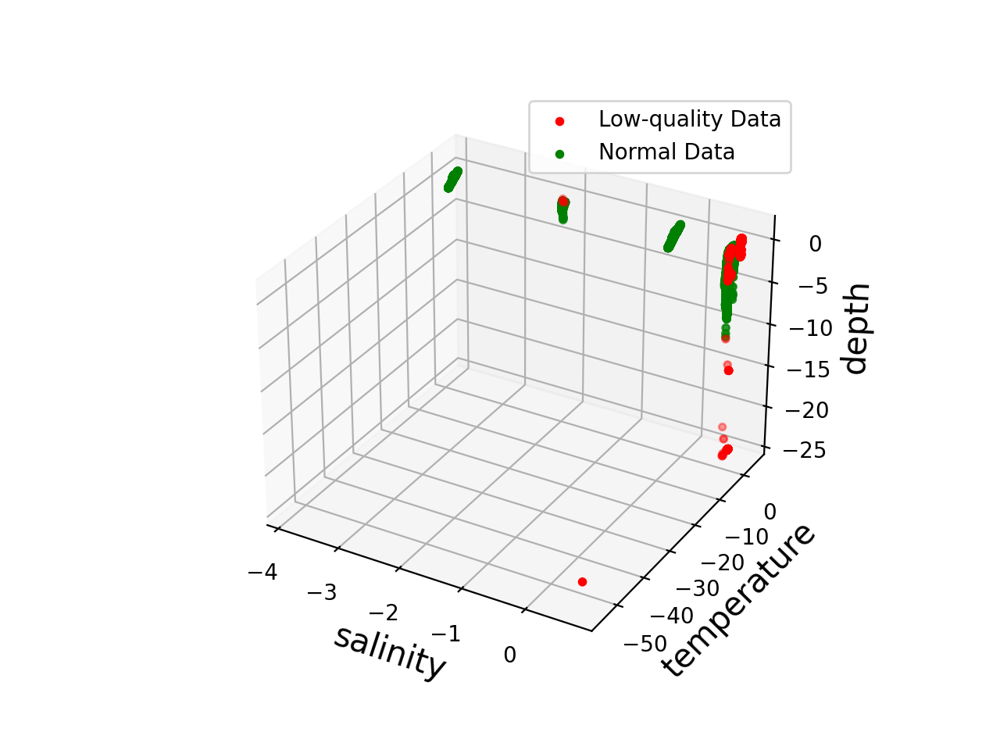

In [18]:
dataplot=data.copy()

plotCluster(dataplot,'depth', 'temperature',
       'salinity','qualityflag',0,data.shape[0])

# Splite Dataset

In [19]:
train_set=pd.read_csv('./randomtrain/seadatanet.csv')
test_set=pd.read_csv('./randomtest/seadatanet.csv')
len(train_set),len(test_set)

(154428, 66184)

In [20]:
#train_set2,test_set2=getLastSplit(data,0.3,dirty_ratio)

In [21]:
comp_ratio(train_set)
comp_ratio(test_set)

0.6941746315435025
0.6965429711108425


0.6965429711108425

In [22]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [23]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre)
    recall=recall_score(y_tru,y_pre)
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre)
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("balanced acc:",bac)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    # confusion matrix
#     cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
#     plt.subplots(figsize=(12,8))
#     cf_matrix = confusion_matrix(y_tru, y_pre)
#     sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return kappa

In [24]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [25]:
x,y=train_set.shape
#pool 
X_Pool = train_set.iloc[:,0:y-1].values
y_Pool = train_set.iloc[:,y-1].values

In [26]:
#test set
X_test=test_set.iloc[:,0:y-1]
y_tru=test_set.iloc[:,y-1]
print(len(X_test),len(y_tru))

66184 66184


In [27]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [28]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

#n_initial= 100
n_initial = 1000
N_QUERIES = 200

In [32]:
# X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
# df_X_i = pd.DataFrame(X_initial)
# df_y_i = pd.DataFrame(y_initial)
# df_X_r = pd.DataFrame(X_re)
# df_y_r = pd.DataFrame(y_re)


# df_X_i.to_csv('./randomtrain/seadatanet_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/seadatanet_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/seadatanet_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/seadatanet_y_re.csv', index=False)

X_initial=pd.read_csv('./randomtrain/seadatanet_X_initial_1.csv').values
y_initial=pd.read_csv('./randomtrain/seadatanet_y_initial_1.csv').values.ravel()
X_re=pd.read_csv('./randomtrain/seadatanet_X_re_1.csv').values
y_re=pd.read_csv('./randomtrain/seadatanet_y_re_1.csv').values.ravel()

print(X_re.shape,X_initial.shape)
print(y_re.shape,y_initial.shape)

(153428, 7) (1000, 7)
(153428,) (1000,)


# molAL

In [33]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [34]:
def al(clf,strategy,X_L,y_L):

#         learner = ActiveLearner(estimator=clf,
#                                 query_strategy=random_sampling,
#                                 X_training=X_L, y_training=y_L)
#     else:
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [35]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)
    y_pre=learner.predict(X_test)
    unqueried_kappa=cohen_kappa_score(y_tru, y_pre)
    unqueried_f1=f1_score(y_tru,y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]
    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        print(index+1,"query label --------------------->",y)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        y_pre=learner.predict(X_test)
        kappa=cohen_kappa_score(y_tru, y_pre)
        f1=f1_score(y_tru,y_pre)
        print(index+1,"-------------------->",kappa)
        print(index+1,"-------------------->",f1)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
    #print(len(X_U))
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    return df_scores


In [36]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,test_set,10)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_test)
computeMetric(y_tru,y_pre)

0.9487993300589753
acc: 0.9994107337120754
balanced acc: 0.9727785249226664
precision: 0.9688888888888889
recall: 0.9457700650759219
cm: [[65709    14]
 [   25   436]]
f1: 0.9571899012074642
MCC: 0.9569640037637102
Kappa: 0.9568932698031442


0.9568932698031442

In [37]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,test_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt', num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, 
                              objective=None, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_test)
computeMetric(y_tru,y_pre)

0.9153983671502535
acc: 0.999320077360087
balanced acc: 0.9544240316033541
precision: 0.9928909952606635
recall: 0.9088937093275488
cm: [[65720     3]
 [   42   419]]
f1: 0.9490373725934313
MCC: 0.9496349862016176
Kappa: 0.9486958003484774


0.9486958003484774

In [38]:
# clf3 gradientBoostingClassifier
clf3 = lgb.LGBMClassifier()

dic3 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para3=getPar(clf3,dic3,test_set,10)

    
clf3 = lgb.LGBMClassifier(boosting_type='gbdt', num_leaves=para3['num_leaves'], max_depth=-1, 
                              learning_rate=para3['learning_rate'], n_estimators=para3['n_estimators'], 
                              subsample_for_bin=200000, 
                              objective=None, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para3['min_child_weight'],
                              min_child_samples=para3['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para3['reg_alpha'], 
                              reg_lambda=para3['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_test)
computeMetric(y_tru,y_pre)

0.9143166501025718
acc: 0.9993805149280793
balanced acc: 0.9587624263972805
precision: 0.9929577464788732
recall: 0.9175704989154013
cm: [[65720     3]
 [   38   423]]
f1: 0.9537767756482526
MCC: 0.9542186301676013
Kappa: 0.9534654323136149


0.9534654323136149

In [39]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# #para3=getPar(clf4,dic4,test_set,10)

# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_test)
computeMetric(y_tru,y_pre)

Learning rate set to 0.088618
0:	learn: 0.4541428	total: 74.5ms	remaining: 1m 14s
1:	learn: 0.2782595	total: 86.2ms	remaining: 43s
2:	learn: 0.1725393	total: 97.7ms	remaining: 32.5s
3:	learn: 0.1159619	total: 107ms	remaining: 26.5s
4:	learn: 0.0790077	total: 118ms	remaining: 23.4s
5:	learn: 0.0550384	total: 131ms	remaining: 21.7s
6:	learn: 0.0393246	total: 147ms	remaining: 20.8s
7:	learn: 0.0303075	total: 163ms	remaining: 20.2s
8:	learn: 0.0243644	total: 176ms	remaining: 19.4s
9:	learn: 0.0206330	total: 193ms	remaining: 19.1s
10:	learn: 0.0180254	total: 208ms	remaining: 18.7s
11:	learn: 0.0162003	total: 221ms	remaining: 18.2s
12:	learn: 0.0149026	total: 235ms	remaining: 17.8s
13:	learn: 0.0138670	total: 248ms	remaining: 17.4s
14:	learn: 0.0131179	total: 260ms	remaining: 17.1s
15:	learn: 0.0124331	total: 272ms	remaining: 16.7s
16:	learn: 0.0118947	total: 285ms	remaining: 16.5s
17:	learn: 0.0114240	total: 296ms	remaining: 16.2s
18:	learn: 0.0108010	total: 308ms	remaining: 15.9s
19:	learn

170:	learn: 0.0029674	total: 2.18s	remaining: 10.6s
171:	learn: 0.0029391	total: 2.19s	remaining: 10.5s
172:	learn: 0.0029295	total: 2.2s	remaining: 10.5s
173:	learn: 0.0029278	total: 2.21s	remaining: 10.5s
174:	learn: 0.0029045	total: 2.22s	remaining: 10.5s
175:	learn: 0.0029039	total: 2.23s	remaining: 10.5s
176:	learn: 0.0028896	total: 2.25s	remaining: 10.5s
177:	learn: 0.0028891	total: 2.26s	remaining: 10.4s
178:	learn: 0.0028818	total: 2.27s	remaining: 10.4s
179:	learn: 0.0028520	total: 2.28s	remaining: 10.4s
180:	learn: 0.0028516	total: 2.29s	remaining: 10.4s
181:	learn: 0.0028502	total: 2.3s	remaining: 10.4s
182:	learn: 0.0028475	total: 2.31s	remaining: 10.3s
183:	learn: 0.0028071	total: 2.33s	remaining: 10.3s
184:	learn: 0.0027941	total: 2.34s	remaining: 10.3s
185:	learn: 0.0027601	total: 2.35s	remaining: 10.3s
186:	learn: 0.0027522	total: 2.36s	remaining: 10.3s
187:	learn: 0.0027345	total: 2.38s	remaining: 10.3s
188:	learn: 0.0027027	total: 2.39s	remaining: 10.3s
189:	learn: 0.

332:	learn: 0.0015611	total: 4.04s	remaining: 8.1s
333:	learn: 0.0015596	total: 4.06s	remaining: 8.09s
334:	learn: 0.0015581	total: 4.07s	remaining: 8.08s
335:	learn: 0.0015562	total: 4.08s	remaining: 8.07s
336:	learn: 0.0015424	total: 4.09s	remaining: 8.05s
337:	learn: 0.0015405	total: 4.1s	remaining: 8.04s
338:	learn: 0.0015392	total: 4.12s	remaining: 8.03s
339:	learn: 0.0015376	total: 4.13s	remaining: 8.01s
340:	learn: 0.0015336	total: 4.14s	remaining: 8s
341:	learn: 0.0015282	total: 4.15s	remaining: 7.98s
342:	learn: 0.0015259	total: 4.16s	remaining: 7.97s
343:	learn: 0.0015245	total: 4.17s	remaining: 7.95s
344:	learn: 0.0015209	total: 4.18s	remaining: 7.94s
345:	learn: 0.0015150	total: 4.2s	remaining: 7.93s
346:	learn: 0.0015138	total: 4.21s	remaining: 7.92s
347:	learn: 0.0015126	total: 4.22s	remaining: 7.9s
348:	learn: 0.0014980	total: 4.23s	remaining: 7.89s
349:	learn: 0.0014953	total: 4.24s	remaining: 7.88s
350:	learn: 0.0014932	total: 4.25s	remaining: 7.87s
351:	learn: 0.00149

499:	learn: 0.0010465	total: 6.05s	remaining: 6.05s
500:	learn: 0.0010461	total: 6.07s	remaining: 6.04s
501:	learn: 0.0010457	total: 6.08s	remaining: 6.03s
502:	learn: 0.0010454	total: 6.09s	remaining: 6.02s
503:	learn: 0.0010446	total: 6.11s	remaining: 6.01s
504:	learn: 0.0010415	total: 6.12s	remaining: 6s
505:	learn: 0.0010386	total: 6.13s	remaining: 5.99s
506:	learn: 0.0010383	total: 6.14s	remaining: 5.98s
507:	learn: 0.0010364	total: 6.16s	remaining: 5.96s
508:	learn: 0.0010306	total: 6.17s	remaining: 5.95s
509:	learn: 0.0010296	total: 6.18s	remaining: 5.94s
510:	learn: 0.0010293	total: 6.2s	remaining: 5.93s
511:	learn: 0.0010291	total: 6.21s	remaining: 5.92s
512:	learn: 0.0010288	total: 6.22s	remaining: 5.9s
513:	learn: 0.0010264	total: 6.23s	remaining: 5.89s
514:	learn: 0.0010262	total: 6.24s	remaining: 5.88s
515:	learn: 0.0010217	total: 6.26s	remaining: 5.87s
516:	learn: 0.0010212	total: 6.27s	remaining: 5.86s
517:	learn: 0.0010210	total: 6.28s	remaining: 5.84s
518:	learn: 0.001

670:	learn: 0.0007638	total: 8.09s	remaining: 3.96s
671:	learn: 0.0007609	total: 8.1s	remaining: 3.95s
672:	learn: 0.0007599	total: 8.11s	remaining: 3.94s
673:	learn: 0.0007552	total: 8.12s	remaining: 3.93s
674:	learn: 0.0007549	total: 8.13s	remaining: 3.92s
675:	learn: 0.0007497	total: 8.15s	remaining: 3.9s
676:	learn: 0.0007447	total: 8.16s	remaining: 3.89s
677:	learn: 0.0007443	total: 8.17s	remaining: 3.88s
678:	learn: 0.0007443	total: 8.18s	remaining: 3.87s
679:	learn: 0.0007416	total: 8.19s	remaining: 3.85s
680:	learn: 0.0007416	total: 8.2s	remaining: 3.84s
681:	learn: 0.0007414	total: 8.21s	remaining: 3.83s
682:	learn: 0.0007414	total: 8.22s	remaining: 3.81s
683:	learn: 0.0007414	total: 8.23s	remaining: 3.8s
684:	learn: 0.0007392	total: 8.24s	remaining: 3.79s
685:	learn: 0.0007389	total: 8.25s	remaining: 3.78s
686:	learn: 0.0007371	total: 8.26s	remaining: 3.76s
687:	learn: 0.0007354	total: 8.27s	remaining: 3.75s
688:	learn: 0.0007352	total: 8.29s	remaining: 3.74s
689:	learn: 0.00

830:	learn: 0.0005816	total: 9.94s	remaining: 2.02s
831:	learn: 0.0005804	total: 9.95s	remaining: 2.01s
832:	learn: 0.0005788	total: 9.96s	remaining: 2s
833:	learn: 0.0005781	total: 9.98s	remaining: 1.99s
834:	learn: 0.0005781	total: 9.99s	remaining: 1.97s
835:	learn: 0.0005781	total: 9.99s	remaining: 1.96s
836:	learn: 0.0005781	total: 10s	remaining: 1.95s
837:	learn: 0.0005765	total: 10s	remaining: 1.94s
838:	learn: 0.0005754	total: 10s	remaining: 1.92s
839:	learn: 0.0005749	total: 10s	remaining: 1.91s
840:	learn: 0.0005740	total: 10s	remaining: 1.9s
841:	learn: 0.0005740	total: 10.1s	remaining: 1.89s
842:	learn: 0.0005737	total: 10.1s	remaining: 1.87s
843:	learn: 0.0005732	total: 10.1s	remaining: 1.86s
844:	learn: 0.0005727	total: 10.1s	remaining: 1.85s
845:	learn: 0.0005723	total: 10.1s	remaining: 1.84s
846:	learn: 0.0005722	total: 10.1s	remaining: 1.82s
847:	learn: 0.0005721	total: 10.1s	remaining: 1.81s
848:	learn: 0.0005713	total: 10.1s	remaining: 1.8s
849:	learn: 0.0005713	total

989:	learn: 0.0005414	total: 11.4s	remaining: 115ms
990:	learn: 0.0005414	total: 11.4s	remaining: 103ms
991:	learn: 0.0005414	total: 11.4s	remaining: 91.8ms
992:	learn: 0.0005414	total: 11.4s	remaining: 80.3ms
993:	learn: 0.0005413	total: 11.4s	remaining: 68.9ms
994:	learn: 0.0005413	total: 11.4s	remaining: 57.4ms
995:	learn: 0.0005413	total: 11.4s	remaining: 45.9ms
996:	learn: 0.0005413	total: 11.4s	remaining: 34.4ms
997:	learn: 0.0005413	total: 11.4s	remaining: 22.9ms
998:	learn: 0.0005413	total: 11.4s	remaining: 11.5ms
999:	learn: 0.0005413	total: 11.5s	remaining: 0us
acc: 0.9993502961440832
balanced acc: 0.9576702200119921
precision: 0.9906103286384976
recall: 0.9154013015184381
cm: [[65719     4]
 [   39   422]]
f1: 0.95152198421646
MCC: 0.9519468580675742
Kappa: 0.9511954534020839


0.9511954534020839

## random sampling

In [40]:
sampling=random_sampling

In [41]:
metric01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [0]
1 --------------------> 0.6194895510060785
1 --------------------> 0.6219653179190752
2 query label ---------------------> [0]
2 --------------------> 0.6194895510060785
2 --------------------> 0.6219653179190752
3 query label ---------------------> [0]
3 --------------------> 0.6194895510060785
3 --------------------> 0.6219653179190752
4 query label ---------------------> [0]
4 --------------------> 0.6194895510060785
4 --------------------> 0.6219653179190752
5 query label ---------------------> [0]
5 --------------------> 0.6194895510060785
5 --------------------> 0.6219653179190752
6 query label ---------------------> [0]
6 --------------------> 0.6194895510060785
6 --------------------> 0.6219653179190752
7 query label ---------------------> [0]
7 --------------------> 0.6194895510060785
7 --------------------> 0.6219653179190752
8 query label ---------------------> [0]
8 --------------------> 0.6194895510060785
8 --------------------> 0.6

64 --------------------> 0.6194895510060785
64 --------------------> 0.6219653179190752
65 query label ---------------------> [0]
65 --------------------> 0.6194895510060785
65 --------------------> 0.6219653179190752
66 query label ---------------------> [0]
66 --------------------> 0.6194895510060785
66 --------------------> 0.6219653179190752
67 query label ---------------------> [0]
67 --------------------> 0.6194895510060785
67 --------------------> 0.6219653179190752
68 query label ---------------------> [0]
68 --------------------> 0.6194895510060785
68 --------------------> 0.6219653179190752
69 query label ---------------------> [0]
69 --------------------> 0.6194895510060785
69 --------------------> 0.6219653179190752
70 query label ---------------------> [0]
70 --------------------> 0.6194895510060785
70 --------------------> 0.6219653179190752
71 query label ---------------------> [1]
71 --------------------> 0.6194895510060785
71 --------------------> 0.6219653179190752
72

127 --------------------> 0.622411085674866
127 --------------------> 0.6248548199767712
128 query label ---------------------> [0]
128 --------------------> 0.622411085674866
128 --------------------> 0.6248548199767712
129 query label ---------------------> [0]
129 --------------------> 0.622411085674866
129 --------------------> 0.6248548199767712
130 query label ---------------------> [0]
130 --------------------> 0.622411085674866
130 --------------------> 0.6248548199767712
131 query label ---------------------> [0]
131 --------------------> 0.622411085674866
131 --------------------> 0.6248548199767712
132 query label ---------------------> [0]
132 --------------------> 0.622411085674866
132 --------------------> 0.6248548199767712
133 query label ---------------------> [0]
133 --------------------> 0.622411085674866
133 --------------------> 0.6248548199767712
134 query label ---------------------> [0]
134 --------------------> 0.622411085674866
134 --------------------> 0.6248

190 --------------------> 0.622411085674866
190 --------------------> 0.6248548199767712
191 query label ---------------------> [0]
191 --------------------> 0.622411085674866
191 --------------------> 0.6248548199767712
192 query label ---------------------> [0]
192 --------------------> 0.622411085674866
192 --------------------> 0.6248548199767712
193 query label ---------------------> [0]
193 --------------------> 0.622411085674866
193 --------------------> 0.6248548199767712
194 query label ---------------------> [0]
194 --------------------> 0.622411085674866
194 --------------------> 0.6248548199767712
195 query label ---------------------> [0]
195 --------------------> 0.622411085674866
195 --------------------> 0.6248548199767712
196 query label ---------------------> [0]
196 --------------------> 0.622411085674866
196 --------------------> 0.6248548199767712
197 query label ---------------------> [0]
197 --------------------> 0.622411085674866
197 --------------------> 0.6248

In [42]:
metric02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [0]
1 --------------------> 0.7144535904306561
1 --------------------> 0.7158774373259054
2 query label ---------------------> [0]
2 --------------------> 0.7144535904306561
2 --------------------> 0.7158774373259054
3 query label ---------------------> [0]
3 --------------------> 0.7144535904306561
3 --------------------> 0.7158774373259054
4 query label ---------------------> [0]
4 --------------------> 0.7144535904306561
4 --------------------> 0.7158774373259054
5 query label ---------------------> [0]
5 --------------------> 0.7144535904306561
5 --------------------> 0.7158774373259054
6 query label ---------------------> [0]
6 --------------------> 0.7144535904306561
6 --------------------> 0.7158774373259054
7 query label ---------------------> [0]
7 --------------------> 0.7144535904306561
7 --------------------> 0.7158774373259054
8 query label ---------------------> [0]
8 --------------------> 0.7144535904306561
8 --------------------> 0.7

64 --------------------> 0.7162449771291206
64 --------------------> 0.717663421418637
65 query label ---------------------> [0]
65 --------------------> 0.7144535904306561
65 --------------------> 0.7158774373259054
66 query label ---------------------> [0]
66 --------------------> 0.7144535904306561
66 --------------------> 0.7158774373259054
67 query label ---------------------> [0]
67 --------------------> 0.7144535904306561
67 --------------------> 0.7158774373259054
68 query label ---------------------> [1]
68 --------------------> 0.7144535904306561
68 --------------------> 0.7158774373259054
69 query label ---------------------> [0]
69 --------------------> 0.7144535904306561
69 --------------------> 0.7158774373259054
70 query label ---------------------> [0]
70 --------------------> 0.7144535904306561
70 --------------------> 0.7158774373259054
71 query label ---------------------> [0]
71 --------------------> 0.7144535904306561
71 --------------------> 0.7158774373259054
72 

127 --------------------> 0.7144535904306561
127 --------------------> 0.7158774373259054
128 query label ---------------------> [0]
128 --------------------> 0.7144535904306561
128 --------------------> 0.7158774373259054
129 query label ---------------------> [0]
129 --------------------> 0.7144535904306561
129 --------------------> 0.7158774373259054
130 query label ---------------------> [0]
130 --------------------> 0.7144535904306561
130 --------------------> 0.7158774373259054
131 query label ---------------------> [0]
131 --------------------> 0.7144535904306561
131 --------------------> 0.7158774373259054
132 query label ---------------------> [0]
132 --------------------> 0.7144535904306561
132 --------------------> 0.7158774373259054
133 query label ---------------------> [0]
133 --------------------> 0.7144535904306561
133 --------------------> 0.7158774373259054
134 query label ---------------------> [0]
134 --------------------> 0.7144535904306561
134 --------------------

189 --------------------> 0.7144535904306561
189 --------------------> 0.7158774373259054
190 query label ---------------------> [0]
190 --------------------> 0.7144535904306561
190 --------------------> 0.7158774373259054
191 query label ---------------------> [0]
191 --------------------> 0.7144535904306561
191 --------------------> 0.7158774373259054
192 query label ---------------------> [0]
192 --------------------> 0.7144535904306561
192 --------------------> 0.7158774373259054
193 query label ---------------------> [0]
193 --------------------> 0.7144535904306561
193 --------------------> 0.7158774373259054
194 query label ---------------------> [0]
194 --------------------> 0.7144535904306561
194 --------------------> 0.7158774373259054
195 query label ---------------------> [0]
195 --------------------> 0.7144535904306561
195 --------------------> 0.7158774373259054
196 query label ---------------------> [0]
196 --------------------> 0.7144535904306561
196 --------------------

In [43]:
metric03 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [0]
1 --------------------> 0.713449361140245
1 --------------------> 0.7148817802503477
2 query label ---------------------> [0]
2 --------------------> 0.7144535904306561
2 --------------------> 0.7158774373259054
3 query label ---------------------> [0]
3 --------------------> 0.7144535904306561
3 --------------------> 0.7158774373259054
4 query label ---------------------> [0]
4 --------------------> 0.7144535904306561
4 --------------------> 0.7158774373259054
5 query label ---------------------> [0]
5 --------------------> 0.7144535904306561
5 --------------------> 0.7158774373259054
6 query label ---------------------> [0]
6 --------------------> 0.7144535904306561
6 --------------------> 0.7158774373259054
7 query label ---------------------> [0]
7 --------------------> 0.7144535904306561
7 --------------------> 0.7158774373259054
8 query label ---------------------> [0]
8 --------------------> 0.7144535904306561
8 --------------------> 0.71

64 --------------------> 0.7144535904306561
64 --------------------> 0.7158774373259054
65 query label ---------------------> [0]
65 --------------------> 0.6445088024408413
65 --------------------> 0.6461086637298091
66 query label ---------------------> [0]
66 --------------------> 0.7144535904306561
66 --------------------> 0.7158774373259054
67 query label ---------------------> [0]
67 --------------------> 0.6445088024408413
67 --------------------> 0.6461086637298091
68 query label ---------------------> [0]
68 --------------------> 0.7144535904306561
68 --------------------> 0.7158774373259054
69 query label ---------------------> [0]
69 --------------------> 0.6445088024408413
69 --------------------> 0.6461086637298091
70 query label ---------------------> [0]
70 --------------------> 0.6445088024408413
70 --------------------> 0.6461086637298091
71 query label ---------------------> [0]
71 --------------------> 0.6435521950705801
71 --------------------> 0.6451612903225806
72

127 --------------------> 0.5324415476949398
127 --------------------> 0.534181240063593
128 query label ---------------------> [0]
128 --------------------> 0.5324415476949398
128 --------------------> 0.534181240063593
129 query label ---------------------> [0]
129 --------------------> 0.5324415476949398
129 --------------------> 0.534181240063593
130 query label ---------------------> [0]
130 --------------------> 0.5324415476949398
130 --------------------> 0.534181240063593
131 query label ---------------------> [0]
131 --------------------> 0.5324415476949398
131 --------------------> 0.534181240063593
132 query label ---------------------> [0]
132 --------------------> 0.5324415476949398
132 --------------------> 0.534181240063593
133 query label ---------------------> [0]
133 --------------------> 0.5324415476949398
133 --------------------> 0.534181240063593
134 query label ---------------------> [0]
134 --------------------> 0.5324415476949398
134 --------------------> 0.534

190 --------------------> 0.5324415476949398
190 --------------------> 0.534181240063593
191 query label ---------------------> [0]
191 --------------------> 0.5324415476949398
191 --------------------> 0.534181240063593
192 query label ---------------------> [0]
192 --------------------> 0.5324415476949398
192 --------------------> 0.534181240063593
193 query label ---------------------> [0]
193 --------------------> 0.5324415476949398
193 --------------------> 0.534181240063593
194 query label ---------------------> [0]
194 --------------------> 0.5324415476949398
194 --------------------> 0.534181240063593
195 query label ---------------------> [0]
195 --------------------> 0.5324415476949398
195 --------------------> 0.534181240063593
196 query label ---------------------> [0]
196 --------------------> 0.5324415476949398
196 --------------------> 0.534181240063593
197 query label ---------------------> [0]
197 --------------------> 0.5324415476949398
197 --------------------> 0.534

In [44]:
metric04 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)

Learning rate set to 0.010302
0:	learn: 0.6701279	total: 2.21ms	remaining: 2.2s
1:	learn: 0.6474646	total: 3.61ms	remaining: 1.8s
2:	learn: 0.6253499	total: 4.98ms	remaining: 1.65s
3:	learn: 0.6053488	total: 6.32ms	remaining: 1.57s
4:	learn: 0.5836256	total: 7.71ms	remaining: 1.53s
5:	learn: 0.5630242	total: 9.05ms	remaining: 1.5s
6:	learn: 0.5427242	total: 10.3ms	remaining: 1.46s
7:	learn: 0.5225925	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5027784	total: 13.1ms	remaining: 1.44s
9:	learn: 0.4857638	total: 14.4ms	remaining: 1.43s
10:	learn: 0.4684433	total: 16ms	remaining: 1.43s
11:	learn: 0.4525397	total: 17.4ms	remaining: 1.43s
12:	learn: 0.4371014	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4224262	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4082364	total: 21ms	remaining: 1.38s
15:	learn: 0.3936142	total: 22.3ms	remaining: 1.37s
16:	learn: 0.3810573	total: 23.5ms	remaining: 1.36s
17:	learn: 0.3679513	total: 24.9ms	remaining: 1.36s
18:	learn: 0.3555334	total: 26.1ms	remaining: 1.35s

230:	learn: 0.0165183	total: 355ms	remaining: 1.18s
231:	learn: 0.0164408	total: 356ms	remaining: 1.18s
232:	learn: 0.0163744	total: 358ms	remaining: 1.18s
233:	learn: 0.0162949	total: 359ms	remaining: 1.17s
234:	learn: 0.0162272	total: 360ms	remaining: 1.17s
235:	learn: 0.0161777	total: 362ms	remaining: 1.17s
236:	learn: 0.0160994	total: 363ms	remaining: 1.17s
237:	learn: 0.0160061	total: 364ms	remaining: 1.17s
238:	learn: 0.0159400	total: 366ms	remaining: 1.16s
239:	learn: 0.0158734	total: 367ms	remaining: 1.16s
240:	learn: 0.0158383	total: 369ms	remaining: 1.16s
241:	learn: 0.0158047	total: 370ms	remaining: 1.16s
242:	learn: 0.0157460	total: 373ms	remaining: 1.16s
243:	learn: 0.0157068	total: 375ms	remaining: 1.16s
244:	learn: 0.0156247	total: 376ms	remaining: 1.16s
245:	learn: 0.0155756	total: 378ms	remaining: 1.16s
246:	learn: 0.0155215	total: 379ms	remaining: 1.16s
247:	learn: 0.0154794	total: 380ms	remaining: 1.15s
248:	learn: 0.0153881	total: 382ms	remaining: 1.15s
249:	learn: 

511:	learn: 0.0065309	total: 731ms	remaining: 697ms
512:	learn: 0.0065117	total: 733ms	remaining: 696ms
513:	learn: 0.0064982	total: 734ms	remaining: 694ms
514:	learn: 0.0064914	total: 736ms	remaining: 693ms
515:	learn: 0.0064783	total: 737ms	remaining: 691ms
516:	learn: 0.0064589	total: 738ms	remaining: 690ms
517:	learn: 0.0064439	total: 739ms	remaining: 688ms
518:	learn: 0.0064232	total: 741ms	remaining: 687ms
519:	learn: 0.0064013	total: 742ms	remaining: 685ms
520:	learn: 0.0063816	total: 743ms	remaining: 683ms
521:	learn: 0.0063667	total: 745ms	remaining: 682ms
522:	learn: 0.0063502	total: 746ms	remaining: 680ms
523:	learn: 0.0063311	total: 747ms	remaining: 679ms
524:	learn: 0.0063122	total: 749ms	remaining: 678ms
525:	learn: 0.0062967	total: 751ms	remaining: 677ms
526:	learn: 0.0062751	total: 755ms	remaining: 678ms
527:	learn: 0.0062563	total: 758ms	remaining: 677ms
528:	learn: 0.0062396	total: 762ms	remaining: 679ms
529:	learn: 0.0062247	total: 764ms	remaining: 677ms
530:	learn: 

772:	learn: 0.0035384	total: 1.1s	remaining: 325ms
773:	learn: 0.0035377	total: 1.11s	remaining: 323ms
774:	learn: 0.0035283	total: 1.11s	remaining: 322ms
775:	learn: 0.0035251	total: 1.11s	remaining: 320ms
776:	learn: 0.0035184	total: 1.11s	remaining: 319ms
777:	learn: 0.0035128	total: 1.11s	remaining: 317ms
778:	learn: 0.0035034	total: 1.11s	remaining: 316ms
779:	learn: 0.0034942	total: 1.11s	remaining: 314ms
780:	learn: 0.0034875	total: 1.12s	remaining: 313ms
781:	learn: 0.0034800	total: 1.12s	remaining: 311ms
782:	learn: 0.0034734	total: 1.12s	remaining: 310ms
783:	learn: 0.0034660	total: 1.12s	remaining: 309ms
784:	learn: 0.0034579	total: 1.12s	remaining: 307ms
785:	learn: 0.0034518	total: 1.12s	remaining: 306ms
786:	learn: 0.0034474	total: 1.12s	remaining: 304ms
787:	learn: 0.0034416	total: 1.13s	remaining: 303ms
788:	learn: 0.0034356	total: 1.13s	remaining: 301ms
789:	learn: 0.0034264	total: 1.13s	remaining: 300ms
790:	learn: 0.0034169	total: 1.13s	remaining: 299ms
791:	learn: 0

1 query label ---------------------> [0]
Learning rate set to 0.010307
0:	learn: 0.6701361	total: 1.84ms	remaining: 1.84s
1:	learn: 0.6474521	total: 3.3ms	remaining: 1.65s
2:	learn: 0.6253274	total: 4.54ms	remaining: 1.51s
3:	learn: 0.6052955	total: 5.78ms	remaining: 1.44s
4:	learn: 0.5835102	total: 7.1ms	remaining: 1.41s
5:	learn: 0.5629503	total: 8.55ms	remaining: 1.42s
6:	learn: 0.5426346	total: 9.65ms	remaining: 1.37s
7:	learn: 0.5225085	total: 11ms	remaining: 1.37s
8:	learn: 0.5027320	total: 12.4ms	remaining: 1.37s
9:	learn: 0.4857147	total: 13.7ms	remaining: 1.35s
10:	learn: 0.4683753	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4524657	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4370190	total: 17.2ms	remaining: 1.31s
13:	learn: 0.4223502	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4081564	total: 20ms	remaining: 1.31s
15:	learn: 0.3930170	total: 21.3ms	remaining: 1.31s
16:	learn: 0.3805002	total: 22.7ms	remaining: 1.31s
17:	learn: 0.3669505	total: 24.1ms	remaining: 1.32s
18:	learn

250:	learn: 0.0151279	total: 375ms	remaining: 1.12s
251:	learn: 0.0150945	total: 376ms	remaining: 1.12s
252:	learn: 0.0150299	total: 377ms	remaining: 1.11s
253:	learn: 0.0149864	total: 379ms	remaining: 1.11s
254:	learn: 0.0149136	total: 380ms	remaining: 1.11s
255:	learn: 0.0148723	total: 382ms	remaining: 1.11s
256:	learn: 0.0148168	total: 384ms	remaining: 1.11s
257:	learn: 0.0147401	total: 385ms	remaining: 1.11s
258:	learn: 0.0146837	total: 386ms	remaining: 1.1s
259:	learn: 0.0146160	total: 388ms	remaining: 1.1s
260:	learn: 0.0145557	total: 389ms	remaining: 1.1s
261:	learn: 0.0144962	total: 391ms	remaining: 1.1s
262:	learn: 0.0144288	total: 392ms	remaining: 1.1s
263:	learn: 0.0144073	total: 393ms	remaining: 1.1s
264:	learn: 0.0143648	total: 395ms	remaining: 1.09s
265:	learn: 0.0143061	total: 396ms	remaining: 1.09s
266:	learn: 0.0142751	total: 398ms	remaining: 1.09s
267:	learn: 0.0142052	total: 399ms	remaining: 1.09s
268:	learn: 0.0141633	total: 401ms	remaining: 1.09s
269:	learn: 0.0140

476:	learn: 0.0071973	total: 747ms	remaining: 819ms
477:	learn: 0.0071757	total: 750ms	remaining: 819ms
478:	learn: 0.0071574	total: 751ms	remaining: 817ms
479:	learn: 0.0071318	total: 754ms	remaining: 817ms
480:	learn: 0.0071076	total: 757ms	remaining: 817ms
481:	learn: 0.0070915	total: 759ms	remaining: 815ms
482:	learn: 0.0070699	total: 760ms	remaining: 814ms
483:	learn: 0.0070649	total: 763ms	remaining: 813ms
484:	learn: 0.0070492	total: 765ms	remaining: 812ms
485:	learn: 0.0070222	total: 767ms	remaining: 811ms
486:	learn: 0.0070187	total: 769ms	remaining: 810ms
487:	learn: 0.0070006	total: 771ms	remaining: 809ms
488:	learn: 0.0069823	total: 773ms	remaining: 808ms
489:	learn: 0.0069779	total: 774ms	remaining: 806ms
490:	learn: 0.0069755	total: 775ms	remaining: 804ms
491:	learn: 0.0069610	total: 777ms	remaining: 803ms
492:	learn: 0.0069427	total: 779ms	remaining: 801ms
493:	learn: 0.0069149	total: 782ms	remaining: 801ms
494:	learn: 0.0068966	total: 783ms	remaining: 799ms
495:	learn: 

703:	learn: 0.0041937	total: 1.12s	remaining: 473ms
704:	learn: 0.0041912	total: 1.13s	remaining: 471ms
705:	learn: 0.0041817	total: 1.13s	remaining: 469ms
706:	learn: 0.0041754	total: 1.13s	remaining: 468ms
707:	learn: 0.0041656	total: 1.13s	remaining: 466ms
708:	learn: 0.0041577	total: 1.13s	remaining: 464ms
709:	learn: 0.0041447	total: 1.13s	remaining: 463ms
710:	learn: 0.0041347	total: 1.13s	remaining: 461ms
711:	learn: 0.0041253	total: 1.14s	remaining: 459ms
712:	learn: 0.0041154	total: 1.14s	remaining: 458ms
713:	learn: 0.0041063	total: 1.14s	remaining: 456ms
714:	learn: 0.0040891	total: 1.14s	remaining: 454ms
715:	learn: 0.0040812	total: 1.14s	remaining: 453ms
716:	learn: 0.0040706	total: 1.14s	remaining: 451ms
717:	learn: 0.0040655	total: 1.14s	remaining: 449ms
718:	learn: 0.0040544	total: 1.15s	remaining: 448ms
719:	learn: 0.0040482	total: 1.15s	remaining: 446ms
720:	learn: 0.0040407	total: 1.15s	remaining: 444ms
721:	learn: 0.0040278	total: 1.15s	remaining: 443ms
722:	learn: 

956:	learn: 0.0024852	total: 1.5s	remaining: 67.4ms
957:	learn: 0.0024794	total: 1.5s	remaining: 65.9ms
958:	learn: 0.0024763	total: 1.5s	remaining: 64.4ms
959:	learn: 0.0024735	total: 1.51s	remaining: 62.8ms
960:	learn: 0.0024705	total: 1.51s	remaining: 61.2ms
961:	learn: 0.0024676	total: 1.51s	remaining: 59.7ms
962:	learn: 0.0024650	total: 1.51s	remaining: 58.1ms
963:	learn: 0.0024624	total: 1.51s	remaining: 56.5ms
964:	learn: 0.0024596	total: 1.51s	remaining: 55ms
965:	learn: 0.0024567	total: 1.52s	remaining: 53.4ms
966:	learn: 0.0024511	total: 1.52s	remaining: 51.8ms
967:	learn: 0.0024485	total: 1.52s	remaining: 50.2ms
968:	learn: 0.0024437	total: 1.52s	remaining: 48.7ms
969:	learn: 0.0024410	total: 1.52s	remaining: 47.1ms
970:	learn: 0.0024386	total: 1.52s	remaining: 45.5ms
971:	learn: 0.0024358	total: 1.53s	remaining: 44ms
972:	learn: 0.0024333	total: 1.53s	remaining: 42.4ms
973:	learn: 0.0024272	total: 1.53s	remaining: 40.8ms
974:	learn: 0.0024228	total: 1.53s	remaining: 39.2ms


159:	learn: 0.0233162	total: 217ms	remaining: 1.14s
160:	learn: 0.0231819	total: 219ms	remaining: 1.14s
161:	learn: 0.0230533	total: 220ms	remaining: 1.14s
162:	learn: 0.0229012	total: 222ms	remaining: 1.14s
163:	learn: 0.0227617	total: 224ms	remaining: 1.14s
164:	learn: 0.0226344	total: 225ms	remaining: 1.14s
165:	learn: 0.0225005	total: 226ms	remaining: 1.14s
166:	learn: 0.0223180	total: 228ms	remaining: 1.14s
167:	learn: 0.0222096	total: 229ms	remaining: 1.13s
168:	learn: 0.0220715	total: 230ms	remaining: 1.13s
169:	learn: 0.0219555	total: 232ms	remaining: 1.13s
170:	learn: 0.0218609	total: 233ms	remaining: 1.13s
171:	learn: 0.0217534	total: 235ms	remaining: 1.13s
172:	learn: 0.0216216	total: 236ms	remaining: 1.13s
173:	learn: 0.0215103	total: 237ms	remaining: 1.12s
174:	learn: 0.0213357	total: 238ms	remaining: 1.12s
175:	learn: 0.0212049	total: 239ms	remaining: 1.12s
176:	learn: 0.0210965	total: 240ms	remaining: 1.12s
177:	learn: 0.0209473	total: 242ms	remaining: 1.12s
178:	learn: 

392:	learn: 0.0092861	total: 592ms	remaining: 914ms
393:	learn: 0.0092420	total: 594ms	remaining: 913ms
394:	learn: 0.0091960	total: 595ms	remaining: 912ms
395:	learn: 0.0091769	total: 597ms	remaining: 911ms
396:	learn: 0.0091490	total: 599ms	remaining: 910ms
397:	learn: 0.0091410	total: 600ms	remaining: 908ms
398:	learn: 0.0091026	total: 602ms	remaining: 906ms
399:	learn: 0.0090673	total: 603ms	remaining: 905ms
400:	learn: 0.0090431	total: 605ms	remaining: 904ms
401:	learn: 0.0090399	total: 607ms	remaining: 903ms
402:	learn: 0.0090155	total: 609ms	remaining: 902ms
403:	learn: 0.0089862	total: 610ms	remaining: 900ms
404:	learn: 0.0089468	total: 612ms	remaining: 899ms
405:	learn: 0.0089210	total: 613ms	remaining: 897ms
406:	learn: 0.0088875	total: 615ms	remaining: 896ms
407:	learn: 0.0088631	total: 617ms	remaining: 896ms
408:	learn: 0.0088371	total: 619ms	remaining: 894ms
409:	learn: 0.0088044	total: 621ms	remaining: 893ms
410:	learn: 0.0087797	total: 623ms	remaining: 892ms
411:	learn: 

640:	learn: 0.0048422	total: 967ms	remaining: 541ms
641:	learn: 0.0048237	total: 968ms	remaining: 540ms
642:	learn: 0.0048101	total: 969ms	remaining: 538ms
643:	learn: 0.0047961	total: 971ms	remaining: 537ms
644:	learn: 0.0047868	total: 973ms	remaining: 536ms
645:	learn: 0.0047744	total: 975ms	remaining: 534ms
646:	learn: 0.0047619	total: 976ms	remaining: 533ms
647:	learn: 0.0047522	total: 978ms	remaining: 531ms
648:	learn: 0.0047402	total: 979ms	remaining: 530ms
649:	learn: 0.0047239	total: 981ms	remaining: 528ms
650:	learn: 0.0047120	total: 982ms	remaining: 526ms
651:	learn: 0.0047025	total: 983ms	remaining: 525ms
652:	learn: 0.0046894	total: 985ms	remaining: 523ms
653:	learn: 0.0046787	total: 986ms	remaining: 522ms
654:	learn: 0.0046761	total: 988ms	remaining: 520ms
655:	learn: 0.0046649	total: 989ms	remaining: 519ms
656:	learn: 0.0046529	total: 990ms	remaining: 517ms
657:	learn: 0.0046498	total: 992ms	remaining: 516ms
658:	learn: 0.0046391	total: 994ms	remaining: 514ms
659:	learn: 

910:	learn: 0.0026840	total: 1.34s	remaining: 131ms
911:	learn: 0.0026797	total: 1.34s	remaining: 130ms
912:	learn: 0.0026755	total: 1.34s	remaining: 128ms
913:	learn: 0.0026650	total: 1.34s	remaining: 127ms
914:	learn: 0.0026611	total: 1.35s	remaining: 125ms
915:	learn: 0.0026555	total: 1.35s	remaining: 124ms
916:	learn: 0.0026513	total: 1.35s	remaining: 122ms
917:	learn: 0.0026448	total: 1.35s	remaining: 121ms
918:	learn: 0.0026379	total: 1.35s	remaining: 119ms
919:	learn: 0.0026327	total: 1.35s	remaining: 118ms
920:	learn: 0.0026270	total: 1.36s	remaining: 116ms
921:	learn: 0.0026235	total: 1.36s	remaining: 115ms
922:	learn: 0.0026194	total: 1.36s	remaining: 113ms
923:	learn: 0.0026131	total: 1.36s	remaining: 112ms
924:	learn: 0.0026040	total: 1.36s	remaining: 110ms
925:	learn: 0.0025988	total: 1.36s	remaining: 109ms
926:	learn: 0.0025931	total: 1.36s	remaining: 108ms
927:	learn: 0.0025897	total: 1.37s	remaining: 106ms
928:	learn: 0.0025859	total: 1.37s	remaining: 105ms
929:	learn: 

138:	learn: 0.0274805	total: 180ms	remaining: 1.12s
139:	learn: 0.0272486	total: 182ms	remaining: 1.12s
140:	learn: 0.0269685	total: 184ms	remaining: 1.12s
141:	learn: 0.0267696	total: 185ms	remaining: 1.12s
142:	learn: 0.0264324	total: 187ms	remaining: 1.12s
143:	learn: 0.0262553	total: 188ms	remaining: 1.12s
144:	learn: 0.0260273	total: 190ms	remaining: 1.12s
145:	learn: 0.0257465	total: 191ms	remaining: 1.12s
146:	learn: 0.0255728	total: 192ms	remaining: 1.11s
147:	learn: 0.0253396	total: 194ms	remaining: 1.11s
148:	learn: 0.0251831	total: 195ms	remaining: 1.11s
149:	learn: 0.0250134	total: 197ms	remaining: 1.11s
150:	learn: 0.0247995	total: 199ms	remaining: 1.12s
151:	learn: 0.0245599	total: 201ms	remaining: 1.12s
152:	learn: 0.0243100	total: 202ms	remaining: 1.12s
153:	learn: 0.0241316	total: 204ms	remaining: 1.12s
154:	learn: 0.0239662	total: 205ms	remaining: 1.12s
155:	learn: 0.0238192	total: 206ms	remaining: 1.12s
156:	learn: 0.0236471	total: 208ms	remaining: 1.11s
157:	learn: 

402:	learn: 0.0090175	total: 542ms	remaining: 803ms
403:	learn: 0.0089900	total: 543ms	remaining: 802ms
404:	learn: 0.0089530	total: 545ms	remaining: 800ms
405:	learn: 0.0089284	total: 547ms	remaining: 800ms
406:	learn: 0.0088994	total: 548ms	remaining: 799ms
407:	learn: 0.0088717	total: 549ms	remaining: 797ms
408:	learn: 0.0088438	total: 551ms	remaining: 796ms
409:	learn: 0.0088142	total: 552ms	remaining: 795ms
410:	learn: 0.0087882	total: 553ms	remaining: 793ms
411:	learn: 0.0087603	total: 555ms	remaining: 792ms
412:	learn: 0.0087288	total: 556ms	remaining: 790ms
413:	learn: 0.0087044	total: 558ms	remaining: 789ms
414:	learn: 0.0086716	total: 559ms	remaining: 788ms
415:	learn: 0.0086630	total: 560ms	remaining: 787ms
416:	learn: 0.0086236	total: 562ms	remaining: 785ms
417:	learn: 0.0085935	total: 563ms	remaining: 784ms
418:	learn: 0.0085644	total: 564ms	remaining: 782ms
419:	learn: 0.0085304	total: 565ms	remaining: 781ms
420:	learn: 0.0085097	total: 567ms	remaining: 780ms
421:	learn: 

689:	learn: 0.0043920	total: 918ms	remaining: 412ms
690:	learn: 0.0043843	total: 919ms	remaining: 411ms
691:	learn: 0.0043748	total: 921ms	remaining: 410ms
692:	learn: 0.0043668	total: 922ms	remaining: 408ms
693:	learn: 0.0043561	total: 923ms	remaining: 407ms
694:	learn: 0.0043426	total: 925ms	remaining: 406ms
695:	learn: 0.0043327	total: 927ms	remaining: 405ms
696:	learn: 0.0043211	total: 928ms	remaining: 403ms
697:	learn: 0.0043128	total: 929ms	remaining: 402ms
698:	learn: 0.0043013	total: 931ms	remaining: 401ms
699:	learn: 0.0042912	total: 932ms	remaining: 400ms
700:	learn: 0.0042818	total: 934ms	remaining: 398ms
701:	learn: 0.0042710	total: 935ms	remaining: 397ms
702:	learn: 0.0042662	total: 937ms	remaining: 396ms
703:	learn: 0.0042507	total: 938ms	remaining: 394ms
704:	learn: 0.0042415	total: 940ms	remaining: 393ms
705:	learn: 0.0042390	total: 941ms	remaining: 392ms
706:	learn: 0.0042296	total: 942ms	remaining: 390ms
707:	learn: 0.0042230	total: 943ms	remaining: 389ms
708:	learn: 

963:	learn: 0.0024934	total: 1.29s	remaining: 48.4ms
964:	learn: 0.0024907	total: 1.3s	remaining: 47ms
965:	learn: 0.0024878	total: 1.3s	remaining: 45.7ms
966:	learn: 0.0024848	total: 1.3s	remaining: 44.4ms
967:	learn: 0.0024819	total: 1.3s	remaining: 43ms
968:	learn: 0.0024776	total: 1.3s	remaining: 41.7ms
969:	learn: 0.0024744	total: 1.3s	remaining: 40.4ms
970:	learn: 0.0024716	total: 1.31s	remaining: 39ms
971:	learn: 0.0024690	total: 1.31s	remaining: 37.7ms
972:	learn: 0.0024661	total: 1.31s	remaining: 36.3ms
973:	learn: 0.0024636	total: 1.31s	remaining: 35ms
974:	learn: 0.0024609	total: 1.31s	remaining: 33.7ms
975:	learn: 0.0024521	total: 1.31s	remaining: 32.3ms
976:	learn: 0.0024493	total: 1.31s	remaining: 31ms
977:	learn: 0.0024447	total: 1.32s	remaining: 29.6ms
978:	learn: 0.0024421	total: 1.32s	remaining: 28.3ms
979:	learn: 0.0024396	total: 1.32s	remaining: 26.9ms
980:	learn: 0.0024353	total: 1.32s	remaining: 25.6ms
981:	learn: 0.0024328	total: 1.32s	remaining: 24.2ms
982:	lear

179:	learn: 0.0206346	total: 238ms	remaining: 1.08s
180:	learn: 0.0205609	total: 240ms	remaining: 1.08s
181:	learn: 0.0204436	total: 241ms	remaining: 1.08s
182:	learn: 0.0203187	total: 243ms	remaining: 1.08s
183:	learn: 0.0202127	total: 244ms	remaining: 1.08s
184:	learn: 0.0201328	total: 246ms	remaining: 1.08s
185:	learn: 0.0200362	total: 248ms	remaining: 1.08s
186:	learn: 0.0199697	total: 249ms	remaining: 1.08s
187:	learn: 0.0198937	total: 251ms	remaining: 1.08s
188:	learn: 0.0198034	total: 252ms	remaining: 1.08s
189:	learn: 0.0196900	total: 254ms	remaining: 1.08s
190:	learn: 0.0195753	total: 255ms	remaining: 1.08s
191:	learn: 0.0194873	total: 256ms	remaining: 1.08s
192:	learn: 0.0193774	total: 257ms	remaining: 1.08s
193:	learn: 0.0193209	total: 259ms	remaining: 1.07s
194:	learn: 0.0192470	total: 260ms	remaining: 1.07s
195:	learn: 0.0191841	total: 262ms	remaining: 1.07s
196:	learn: 0.0190667	total: 263ms	remaining: 1.07s
197:	learn: 0.0189543	total: 264ms	remaining: 1.07s
198:	learn: 

429:	learn: 0.0084783	total: 618ms	remaining: 819ms
430:	learn: 0.0084430	total: 619ms	remaining: 817ms
431:	learn: 0.0084174	total: 620ms	remaining: 816ms
432:	learn: 0.0083867	total: 622ms	remaining: 814ms
433:	learn: 0.0083631	total: 623ms	remaining: 813ms
434:	learn: 0.0083351	total: 625ms	remaining: 812ms
435:	learn: 0.0083283	total: 626ms	remaining: 810ms
436:	learn: 0.0082799	total: 628ms	remaining: 809ms
437:	learn: 0.0082602	total: 629ms	remaining: 808ms
438:	learn: 0.0082376	total: 631ms	remaining: 806ms
439:	learn: 0.0082115	total: 632ms	remaining: 805ms
440:	learn: 0.0081824	total: 633ms	remaining: 803ms
441:	learn: 0.0081572	total: 635ms	remaining: 801ms
442:	learn: 0.0081302	total: 636ms	remaining: 800ms
443:	learn: 0.0081049	total: 638ms	remaining: 799ms
444:	learn: 0.0080848	total: 640ms	remaining: 798ms
445:	learn: 0.0080637	total: 641ms	remaining: 797ms
446:	learn: 0.0080321	total: 643ms	remaining: 795ms
447:	learn: 0.0080244	total: 644ms	remaining: 793ms
448:	learn: 

715:	learn: 0.0041211	total: 994ms	remaining: 394ms
716:	learn: 0.0041099	total: 996ms	remaining: 393ms
717:	learn: 0.0041047	total: 997ms	remaining: 392ms
718:	learn: 0.0040954	total: 998ms	remaining: 390ms
719:	learn: 0.0040888	total: 1000ms	remaining: 389ms
720:	learn: 0.0040808	total: 1s	remaining: 387ms
721:	learn: 0.0040663	total: 1s	remaining: 386ms
722:	learn: 0.0040574	total: 1s	remaining: 385ms
723:	learn: 0.0040451	total: 1s	remaining: 383ms
724:	learn: 0.0040363	total: 1.01s	remaining: 382ms
725:	learn: 0.0040341	total: 1.01s	remaining: 380ms
726:	learn: 0.0040264	total: 1.01s	remaining: 379ms
727:	learn: 0.0040165	total: 1.01s	remaining: 378ms
728:	learn: 0.0040080	total: 1.01s	remaining: 377ms
729:	learn: 0.0039927	total: 1.01s	remaining: 375ms
730:	learn: 0.0039820	total: 1.01s	remaining: 374ms
731:	learn: 0.0039749	total: 1.02s	remaining: 372ms
732:	learn: 0.0039562	total: 1.02s	remaining: 371ms
733:	learn: 0.0039476	total: 1.02s	remaining: 370ms
734:	learn: 0.0039366	t

961:	learn: 0.0024867	total: 1.37s	remaining: 54.1ms
962:	learn: 0.0024824	total: 1.37s	remaining: 52.7ms
963:	learn: 0.0024795	total: 1.37s	remaining: 51.3ms
964:	learn: 0.0024750	total: 1.37s	remaining: 49.8ms
965:	learn: 0.0024636	total: 1.38s	remaining: 48.4ms
966:	learn: 0.0024578	total: 1.38s	remaining: 47ms
967:	learn: 0.0024550	total: 1.38s	remaining: 45.6ms
968:	learn: 0.0024509	total: 1.38s	remaining: 44.1ms
969:	learn: 0.0024478	total: 1.38s	remaining: 42.7ms
970:	learn: 0.0024450	total: 1.38s	remaining: 41.3ms
971:	learn: 0.0024410	total: 1.39s	remaining: 39.9ms
972:	learn: 0.0024382	total: 1.39s	remaining: 38.5ms
973:	learn: 0.0024351	total: 1.39s	remaining: 37.1ms
974:	learn: 0.0024290	total: 1.39s	remaining: 35.7ms
975:	learn: 0.0024247	total: 1.39s	remaining: 34.2ms
976:	learn: 0.0024206	total: 1.39s	remaining: 32.8ms
977:	learn: 0.0024168	total: 1.39s	remaining: 31.4ms
978:	learn: 0.0024138	total: 1.4s	remaining: 29.9ms
979:	learn: 0.0024098	total: 1.4s	remaining: 28.5

172:	learn: 0.0213376	total: 221ms	remaining: 1.06s
173:	learn: 0.0212281	total: 222ms	remaining: 1.05s
174:	learn: 0.0210580	total: 224ms	remaining: 1.05s
175:	learn: 0.0209314	total: 225ms	remaining: 1.05s
176:	learn: 0.0208263	total: 227ms	remaining: 1.05s
177:	learn: 0.0206803	total: 228ms	remaining: 1.05s
178:	learn: 0.0205409	total: 229ms	remaining: 1.05s
179:	learn: 0.0204262	total: 231ms	remaining: 1.05s
180:	learn: 0.0203535	total: 232ms	remaining: 1.05s
181:	learn: 0.0202126	total: 234ms	remaining: 1.05s
182:	learn: 0.0200760	total: 236ms	remaining: 1.05s
183:	learn: 0.0199722	total: 237ms	remaining: 1.05s
184:	learn: 0.0198934	total: 239ms	remaining: 1.05s
185:	learn: 0.0197966	total: 240ms	remaining: 1.05s
186:	learn: 0.0197310	total: 242ms	remaining: 1.05s
187:	learn: 0.0196569	total: 243ms	remaining: 1.05s
188:	learn: 0.0195657	total: 244ms	remaining: 1.05s
189:	learn: 0.0194576	total: 246ms	remaining: 1.05s
190:	learn: 0.0193442	total: 247ms	remaining: 1.05s
191:	learn: 

451:	learn: 0.0076848	total: 597ms	remaining: 724ms
452:	learn: 0.0076624	total: 599ms	remaining: 723ms
453:	learn: 0.0076275	total: 600ms	remaining: 722ms
454:	learn: 0.0076015	total: 602ms	remaining: 721ms
455:	learn: 0.0075832	total: 603ms	remaining: 719ms
456:	learn: 0.0075658	total: 604ms	remaining: 718ms
457:	learn: 0.0075428	total: 605ms	remaining: 716ms
458:	learn: 0.0075190	total: 607ms	remaining: 715ms
459:	learn: 0.0075087	total: 608ms	remaining: 714ms
460:	learn: 0.0074632	total: 609ms	remaining: 712ms
461:	learn: 0.0074294	total: 611ms	remaining: 711ms
462:	learn: 0.0074034	total: 612ms	remaining: 710ms
463:	learn: 0.0073609	total: 614ms	remaining: 709ms
464:	learn: 0.0073348	total: 616ms	remaining: 708ms
465:	learn: 0.0073083	total: 617ms	remaining: 707ms
466:	learn: 0.0073015	total: 618ms	remaining: 705ms
467:	learn: 0.0072810	total: 619ms	remaining: 704ms
468:	learn: 0.0072577	total: 620ms	remaining: 702ms
469:	learn: 0.0072374	total: 622ms	remaining: 701ms
470:	learn: 

728:	learn: 0.0039441	total: 976ms	remaining: 363ms
729:	learn: 0.0039288	total: 977ms	remaining: 362ms
730:	learn: 0.0039188	total: 979ms	remaining: 360ms
731:	learn: 0.0039101	total: 980ms	remaining: 359ms
732:	learn: 0.0038918	total: 981ms	remaining: 357ms
733:	learn: 0.0038813	total: 983ms	remaining: 356ms
734:	learn: 0.0038713	total: 984ms	remaining: 355ms
735:	learn: 0.0038642	total: 985ms	remaining: 353ms
736:	learn: 0.0038564	total: 987ms	remaining: 352ms
737:	learn: 0.0038460	total: 989ms	remaining: 351ms
738:	learn: 0.0038373	total: 990ms	remaining: 350ms
739:	learn: 0.0038288	total: 992ms	remaining: 348ms
740:	learn: 0.0038280	total: 993ms	remaining: 347ms
741:	learn: 0.0038164	total: 994ms	remaining: 346ms
742:	learn: 0.0038086	total: 995ms	remaining: 344ms
743:	learn: 0.0037986	total: 997ms	remaining: 343ms
744:	learn: 0.0037911	total: 998ms	remaining: 342ms
745:	learn: 0.0037896	total: 1000ms	remaining: 340ms
746:	learn: 0.0037801	total: 1s	remaining: 339ms
747:	learn: 0.

5 --------------------> 0.7180314323616546
5 --------------------> 0.7194444444444444
6 query label ---------------------> [0]
Learning rate set to 0.010329
0:	learn: 0.6700365	total: 1.33ms	remaining: 1.33s
1:	learn: 0.6472864	total: 2.63ms	remaining: 1.31s
2:	learn: 0.6250964	total: 3.95ms	remaining: 1.31s
3:	learn: 0.6050108	total: 5.34ms	remaining: 1.33s
4:	learn: 0.5832198	total: 6.74ms	remaining: 1.34s
5:	learn: 0.5625592	total: 7.94ms	remaining: 1.31s
6:	learn: 0.5421951	total: 9.03ms	remaining: 1.28s
7:	learn: 0.5220149	total: 10.2ms	remaining: 1.27s
8:	learn: 0.5021600	total: 11.5ms	remaining: 1.26s
9:	learn: 0.4851158	total: 12.9ms	remaining: 1.27s
10:	learn: 0.4677538	total: 14.2ms	remaining: 1.28s
11:	learn: 0.4518152	total: 15.6ms	remaining: 1.29s
12:	learn: 0.4363424	total: 16.4ms	remaining: 1.24s
13:	learn: 0.4216521	total: 17.6ms	remaining: 1.24s
14:	learn: 0.4074315	total: 18.8ms	remaining: 1.23s
15:	learn: 0.3927950	total: 19.9ms	remaining: 1.23s
16:	learn: 0.3802075	

281:	learn: 0.0134910	total: 373ms	remaining: 950ms
282:	learn: 0.0134749	total: 375ms	remaining: 949ms
283:	learn: 0.0134504	total: 376ms	remaining: 948ms
284:	learn: 0.0134193	total: 377ms	remaining: 946ms
285:	learn: 0.0133551	total: 378ms	remaining: 945ms
286:	learn: 0.0132869	total: 380ms	remaining: 944ms
287:	learn: 0.0132493	total: 381ms	remaining: 942ms
288:	learn: 0.0132077	total: 383ms	remaining: 941ms
289:	learn: 0.0131533	total: 384ms	remaining: 940ms
290:	learn: 0.0131182	total: 385ms	remaining: 939ms
291:	learn: 0.0130997	total: 387ms	remaining: 938ms
292:	learn: 0.0130418	total: 388ms	remaining: 936ms
293:	learn: 0.0129896	total: 389ms	remaining: 935ms
294:	learn: 0.0129363	total: 391ms	remaining: 934ms
295:	learn: 0.0128596	total: 392ms	remaining: 933ms
296:	learn: 0.0128272	total: 394ms	remaining: 932ms
297:	learn: 0.0127954	total: 395ms	remaining: 930ms
298:	learn: 0.0127437	total: 396ms	remaining: 929ms
299:	learn: 0.0126725	total: 398ms	remaining: 928ms
300:	learn: 

565:	learn: 0.0058126	total: 749ms	remaining: 575ms
566:	learn: 0.0058079	total: 751ms	remaining: 574ms
567:	learn: 0.0057893	total: 753ms	remaining: 572ms
568:	learn: 0.0057860	total: 754ms	remaining: 571ms
569:	learn: 0.0057811	total: 755ms	remaining: 570ms
570:	learn: 0.0057660	total: 757ms	remaining: 568ms
571:	learn: 0.0057524	total: 758ms	remaining: 567ms
572:	learn: 0.0057355	total: 759ms	remaining: 566ms
573:	learn: 0.0057201	total: 761ms	remaining: 565ms
574:	learn: 0.0057061	total: 762ms	remaining: 563ms
575:	learn: 0.0057030	total: 764ms	remaining: 562ms
576:	learn: 0.0056864	total: 765ms	remaining: 561ms
577:	learn: 0.0056735	total: 766ms	remaining: 559ms
578:	learn: 0.0056599	total: 768ms	remaining: 558ms
579:	learn: 0.0056450	total: 769ms	remaining: 557ms
580:	learn: 0.0056416	total: 771ms	remaining: 556ms
581:	learn: 0.0056385	total: 772ms	remaining: 554ms
582:	learn: 0.0056306	total: 773ms	remaining: 553ms
583:	learn: 0.0056214	total: 775ms	remaining: 552ms
584:	learn: 

821:	learn: 0.0032897	total: 1.13s	remaining: 244ms
822:	learn: 0.0032798	total: 1.13s	remaining: 243ms
823:	learn: 0.0032744	total: 1.13s	remaining: 241ms
824:	learn: 0.0032658	total: 1.13s	remaining: 240ms
825:	learn: 0.0032594	total: 1.13s	remaining: 239ms
826:	learn: 0.0032504	total: 1.13s	remaining: 237ms
827:	learn: 0.0032401	total: 1.13s	remaining: 236ms
828:	learn: 0.0032328	total: 1.14s	remaining: 234ms
829:	learn: 0.0032265	total: 1.14s	remaining: 233ms
830:	learn: 0.0032213	total: 1.14s	remaining: 232ms
831:	learn: 0.0032115	total: 1.14s	remaining: 230ms
832:	learn: 0.0032093	total: 1.14s	remaining: 229ms
833:	learn: 0.0032034	total: 1.14s	remaining: 228ms
834:	learn: 0.0031993	total: 1.15s	remaining: 226ms
835:	learn: 0.0031916	total: 1.15s	remaining: 225ms
836:	learn: 0.0031854	total: 1.15s	remaining: 224ms
837:	learn: 0.0031778	total: 1.15s	remaining: 222ms
838:	learn: 0.0031730	total: 1.15s	remaining: 221ms
839:	learn: 0.0031662	total: 1.15s	remaining: 219ms
840:	learn: 

28:	learn: 0.2538966	total: 39.2ms	remaining: 1.31s
29:	learn: 0.2466627	total: 41.1ms	remaining: 1.33s
30:	learn: 0.2391326	total: 42.6ms	remaining: 1.33s
31:	learn: 0.2321717	total: 43.9ms	remaining: 1.33s
32:	learn: 0.2245933	total: 45.2ms	remaining: 1.32s
33:	learn: 0.2185474	total: 46.5ms	remaining: 1.32s
34:	learn: 0.2116413	total: 47.9ms	remaining: 1.32s
35:	learn: 0.2048377	total: 49.5ms	remaining: 1.32s
36:	learn: 0.1982161	total: 50.8ms	remaining: 1.32s
37:	learn: 0.1921035	total: 52.3ms	remaining: 1.32s
38:	learn: 0.1864571	total: 53.7ms	remaining: 1.32s
39:	learn: 0.1802607	total: 55.3ms	remaining: 1.33s
40:	learn: 0.1756058	total: 57.1ms	remaining: 1.33s
41:	learn: 0.1706937	total: 58.5ms	remaining: 1.33s
42:	learn: 0.1657322	total: 59.8ms	remaining: 1.33s
43:	learn: 0.1607849	total: 61.2ms	remaining: 1.33s
44:	learn: 0.1565330	total: 62.7ms	remaining: 1.33s
45:	learn: 0.1522369	total: 64.2ms	remaining: 1.33s
46:	learn: 0.1482955	total: 65.6ms	remaining: 1.33s
47:	learn: 0

314:	learn: 0.0118572	total: 417ms	remaining: 906ms
315:	learn: 0.0118133	total: 418ms	remaining: 905ms
316:	learn: 0.0117684	total: 420ms	remaining: 904ms
317:	learn: 0.0117034	total: 421ms	remaining: 903ms
318:	learn: 0.0116429	total: 422ms	remaining: 901ms
319:	learn: 0.0115938	total: 423ms	remaining: 899ms
320:	learn: 0.0115218	total: 425ms	remaining: 899ms
321:	learn: 0.0114984	total: 426ms	remaining: 897ms
322:	learn: 0.0114767	total: 427ms	remaining: 896ms
323:	learn: 0.0114592	total: 429ms	remaining: 895ms
324:	learn: 0.0114328	total: 430ms	remaining: 893ms
325:	learn: 0.0113838	total: 431ms	remaining: 892ms
326:	learn: 0.0113442	total: 433ms	remaining: 891ms
327:	learn: 0.0113147	total: 435ms	remaining: 891ms
328:	learn: 0.0112743	total: 441ms	remaining: 900ms
329:	learn: 0.0112299	total: 445ms	remaining: 903ms
330:	learn: 0.0111956	total: 447ms	remaining: 904ms
331:	learn: 0.0111661	total: 449ms	remaining: 903ms
332:	learn: 0.0111527	total: 450ms	remaining: 902ms
333:	learn: 

599:	learn: 0.0052890	total: 793ms	remaining: 528ms
600:	learn: 0.0052756	total: 794ms	remaining: 527ms
601:	learn: 0.0052702	total: 795ms	remaining: 526ms
602:	learn: 0.0052575	total: 797ms	remaining: 525ms
603:	learn: 0.0052396	total: 798ms	remaining: 523ms
604:	learn: 0.0052234	total: 799ms	remaining: 522ms
605:	learn: 0.0052202	total: 801ms	remaining: 520ms
606:	learn: 0.0052078	total: 802ms	remaining: 519ms
607:	learn: 0.0051997	total: 803ms	remaining: 518ms
608:	learn: 0.0051894	total: 804ms	remaining: 517ms
609:	learn: 0.0051813	total: 806ms	remaining: 515ms
610:	learn: 0.0051615	total: 807ms	remaining: 514ms
611:	learn: 0.0051483	total: 809ms	remaining: 513ms
612:	learn: 0.0051373	total: 810ms	remaining: 511ms
613:	learn: 0.0051269	total: 812ms	remaining: 510ms
614:	learn: 0.0051244	total: 813ms	remaining: 509ms
615:	learn: 0.0051107	total: 814ms	remaining: 508ms
616:	learn: 0.0050984	total: 816ms	remaining: 506ms
617:	learn: 0.0050917	total: 817ms	remaining: 505ms
618:	learn: 

868:	learn: 0.0029060	total: 1.17s	remaining: 177ms
869:	learn: 0.0029016	total: 1.17s	remaining: 175ms
870:	learn: 0.0028969	total: 1.17s	remaining: 174ms
871:	learn: 0.0028897	total: 1.18s	remaining: 173ms
872:	learn: 0.0028845	total: 1.18s	remaining: 172ms
873:	learn: 0.0028761	total: 1.18s	remaining: 170ms
874:	learn: 0.0028719	total: 1.18s	remaining: 169ms
875:	learn: 0.0028661	total: 1.19s	remaining: 168ms
876:	learn: 0.0028593	total: 1.19s	remaining: 166ms
877:	learn: 0.0028534	total: 1.19s	remaining: 165ms
878:	learn: 0.0028475	total: 1.19s	remaining: 164ms
879:	learn: 0.0028409	total: 1.19s	remaining: 162ms
880:	learn: 0.0028360	total: 1.19s	remaining: 161ms
881:	learn: 0.0028318	total: 1.19s	remaining: 160ms
882:	learn: 0.0028267	total: 1.2s	remaining: 158ms
883:	learn: 0.0028219	total: 1.2s	remaining: 157ms
884:	learn: 0.0028180	total: 1.2s	remaining: 156ms
885:	learn: 0.0028121	total: 1.2s	remaining: 154ms
886:	learn: 0.0028005	total: 1.2s	remaining: 153ms
887:	learn: 0.002

126:	learn: 0.0306433	total: 180ms	remaining: 1.24s
127:	learn: 0.0303014	total: 182ms	remaining: 1.24s
128:	learn: 0.0299961	total: 185ms	remaining: 1.25s
129:	learn: 0.0297126	total: 186ms	remaining: 1.24s
130:	learn: 0.0294193	total: 187ms	remaining: 1.24s
131:	learn: 0.0291379	total: 189ms	remaining: 1.24s
132:	learn: 0.0287757	total: 190ms	remaining: 1.24s
133:	learn: 0.0285028	total: 192ms	remaining: 1.24s
134:	learn: 0.0282522	total: 193ms	remaining: 1.24s
135:	learn: 0.0279703	total: 194ms	remaining: 1.23s
136:	learn: 0.0276741	total: 195ms	remaining: 1.23s
137:	learn: 0.0274502	total: 197ms	remaining: 1.23s
138:	learn: 0.0272376	total: 199ms	remaining: 1.23s
139:	learn: 0.0270074	total: 200ms	remaining: 1.23s
140:	learn: 0.0267305	total: 201ms	remaining: 1.23s
141:	learn: 0.0265342	total: 203ms	remaining: 1.23s
142:	learn: 0.0263319	total: 205ms	remaining: 1.23s
143:	learn: 0.0261551	total: 206ms	remaining: 1.22s
144:	learn: 0.0259286	total: 207ms	remaining: 1.22s
145:	learn: 

379:	learn: 0.0096240	total: 555ms	remaining: 906ms
380:	learn: 0.0096138	total: 557ms	remaining: 905ms
381:	learn: 0.0095726	total: 559ms	remaining: 904ms
382:	learn: 0.0095456	total: 560ms	remaining: 902ms
383:	learn: 0.0095381	total: 562ms	remaining: 901ms
384:	learn: 0.0095093	total: 563ms	remaining: 899ms
385:	learn: 0.0094780	total: 565ms	remaining: 898ms
386:	learn: 0.0094480	total: 566ms	remaining: 897ms
387:	learn: 0.0094115	total: 568ms	remaining: 896ms
388:	learn: 0.0093954	total: 570ms	remaining: 895ms
389:	learn: 0.0093634	total: 572ms	remaining: 894ms
390:	learn: 0.0093324	total: 574ms	remaining: 893ms
391:	learn: 0.0093146	total: 575ms	remaining: 892ms
392:	learn: 0.0092856	total: 577ms	remaining: 891ms
393:	learn: 0.0092402	total: 579ms	remaining: 890ms
394:	learn: 0.0092194	total: 580ms	remaining: 888ms
395:	learn: 0.0092002	total: 582ms	remaining: 887ms
396:	learn: 0.0091506	total: 583ms	remaining: 886ms
397:	learn: 0.0091427	total: 584ms	remaining: 884ms
398:	learn: 

640:	learn: 0.0048205	total: 934ms	remaining: 523ms
641:	learn: 0.0048018	total: 936ms	remaining: 522ms
642:	learn: 0.0047880	total: 937ms	remaining: 521ms
643:	learn: 0.0047759	total: 939ms	remaining: 519ms
644:	learn: 0.0047667	total: 940ms	remaining: 517ms
645:	learn: 0.0047461	total: 941ms	remaining: 516ms
646:	learn: 0.0047331	total: 943ms	remaining: 514ms
647:	learn: 0.0047233	total: 945ms	remaining: 513ms
648:	learn: 0.0047114	total: 946ms	remaining: 512ms
649:	learn: 0.0046953	total: 947ms	remaining: 510ms
650:	learn: 0.0046761	total: 949ms	remaining: 509ms
651:	learn: 0.0046663	total: 950ms	remaining: 507ms
652:	learn: 0.0046534	total: 951ms	remaining: 506ms
653:	learn: 0.0046431	total: 953ms	remaining: 504ms
654:	learn: 0.0046405	total: 954ms	remaining: 503ms
655:	learn: 0.0046295	total: 955ms	remaining: 501ms
656:	learn: 0.0046171	total: 957ms	remaining: 500ms
657:	learn: 0.0046141	total: 958ms	remaining: 498ms
658:	learn: 0.0046035	total: 960ms	remaining: 497ms
659:	learn: 

940:	learn: 0.0025081	total: 1.31s	remaining: 82.3ms
941:	learn: 0.0025049	total: 1.31s	remaining: 80.9ms
942:	learn: 0.0024996	total: 1.31s	remaining: 79.5ms
943:	learn: 0.0024963	total: 1.32s	remaining: 78.1ms
944:	learn: 0.0024931	total: 1.32s	remaining: 76.7ms
945:	learn: 0.0024897	total: 1.32s	remaining: 75.3ms
946:	learn: 0.0024864	total: 1.32s	remaining: 73.9ms
947:	learn: 0.0024832	total: 1.32s	remaining: 72.5ms
948:	learn: 0.0024797	total: 1.32s	remaining: 71.1ms
949:	learn: 0.0024763	total: 1.32s	remaining: 69.7ms
950:	learn: 0.0024708	total: 1.32s	remaining: 68.3ms
951:	learn: 0.0024676	total: 1.33s	remaining: 66.9ms
952:	learn: 0.0024622	total: 1.33s	remaining: 65.5ms
953:	learn: 0.0024567	total: 1.33s	remaining: 64.1ms
954:	learn: 0.0024517	total: 1.33s	remaining: 62.7ms
955:	learn: 0.0024483	total: 1.33s	remaining: 61.3ms
956:	learn: 0.0024451	total: 1.33s	remaining: 59.9ms
957:	learn: 0.0024398	total: 1.33s	remaining: 58.5ms
958:	learn: 0.0024366	total: 1.34s	remaining: 

173:	learn: 0.0210922	total: 220ms	remaining: 1.05s
174:	learn: 0.0209433	total: 222ms	remaining: 1.04s
175:	learn: 0.0208173	total: 223ms	remaining: 1.04s
176:	learn: 0.0207124	total: 225ms	remaining: 1.04s
177:	learn: 0.0205672	total: 226ms	remaining: 1.04s
178:	learn: 0.0204282	total: 227ms	remaining: 1.04s
179:	learn: 0.0203142	total: 229ms	remaining: 1.04s
180:	learn: 0.0202419	total: 230ms	remaining: 1.04s
181:	learn: 0.0201018	total: 231ms	remaining: 1.04s
182:	learn: 0.0199662	total: 233ms	remaining: 1.04s
183:	learn: 0.0198636	total: 234ms	remaining: 1.04s
184:	learn: 0.0197854	total: 236ms	remaining: 1.04s
185:	learn: 0.0196483	total: 237ms	remaining: 1.04s
186:	learn: 0.0195833	total: 238ms	remaining: 1.03s
187:	learn: 0.0195099	total: 239ms	remaining: 1.03s
188:	learn: 0.0194191	total: 241ms	remaining: 1.03s
189:	learn: 0.0193115	total: 242ms	remaining: 1.03s
190:	learn: 0.0191982	total: 243ms	remaining: 1.03s
191:	learn: 0.0191149	total: 245ms	remaining: 1.03s
192:	learn: 

441:	learn: 0.0079015	total: 597ms	remaining: 754ms
442:	learn: 0.0078604	total: 600ms	remaining: 754ms
443:	learn: 0.0078365	total: 602ms	remaining: 754ms
444:	learn: 0.0078175	total: 604ms	remaining: 754ms
445:	learn: 0.0077985	total: 606ms	remaining: 753ms
446:	learn: 0.0077673	total: 608ms	remaining: 753ms
447:	learn: 0.0077597	total: 610ms	remaining: 752ms
448:	learn: 0.0077323	total: 613ms	remaining: 752ms
449:	learn: 0.0077230	total: 615ms	remaining: 751ms
450:	learn: 0.0077042	total: 616ms	remaining: 750ms
451:	learn: 0.0076812	total: 618ms	remaining: 749ms
452:	learn: 0.0076589	total: 620ms	remaining: 748ms
453:	learn: 0.0076236	total: 621ms	remaining: 747ms
454:	learn: 0.0075915	total: 622ms	remaining: 745ms
455:	learn: 0.0075679	total: 623ms	remaining: 744ms
456:	learn: 0.0075502	total: 625ms	remaining: 742ms
457:	learn: 0.0075158	total: 626ms	remaining: 741ms
458:	learn: 0.0074922	total: 628ms	remaining: 740ms
459:	learn: 0.0074820	total: 629ms	remaining: 738ms
460:	learn: 

723:	learn: 0.0039882	total: 975ms	remaining: 372ms
724:	learn: 0.0039785	total: 977ms	remaining: 371ms
725:	learn: 0.0039764	total: 978ms	remaining: 369ms
726:	learn: 0.0039690	total: 979ms	remaining: 368ms
727:	learn: 0.0039619	total: 981ms	remaining: 366ms
728:	learn: 0.0039545	total: 982ms	remaining: 365ms
729:	learn: 0.0039388	total: 984ms	remaining: 364ms
730:	learn: 0.0039284	total: 985ms	remaining: 362ms
731:	learn: 0.0039197	total: 986ms	remaining: 361ms
732:	learn: 0.0039081	total: 988ms	remaining: 360ms
733:	learn: 0.0038923	total: 989ms	remaining: 358ms
734:	learn: 0.0038850	total: 990ms	remaining: 357ms
735:	learn: 0.0038778	total: 992ms	remaining: 356ms
736:	learn: 0.0038698	total: 993ms	remaining: 354ms
737:	learn: 0.0038591	total: 995ms	remaining: 353ms
738:	learn: 0.0038501	total: 996ms	remaining: 352ms
739:	learn: 0.0038419	total: 997ms	remaining: 350ms
740:	learn: 0.0038410	total: 998ms	remaining: 349ms
741:	learn: 0.0038287	total: 999ms	remaining: 348ms
742:	learn: 

9 --------------------> 0.7162449771291206
9 --------------------> 0.717663421418637
10 query label ---------------------> [0]
Learning rate set to 0.010346
0:	learn: 0.6699319	total: 1.36ms	remaining: 1.36s
1:	learn: 0.6471187	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6249109	total: 4.1ms	remaining: 1.36s
3:	learn: 0.6047426	total: 5.51ms	remaining: 1.37s
4:	learn: 0.5828996	total: 6.83ms	remaining: 1.36s
5:	learn: 0.5622167	total: 8.1ms	remaining: 1.34s
6:	learn: 0.5418145	total: 9.08ms	remaining: 1.29s
7:	learn: 0.5216461	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5017502	total: 11.8ms	remaining: 1.3s
9:	learn: 0.4846827	total: 13.1ms	remaining: 1.3s
10:	learn: 0.4672985	total: 14.3ms	remaining: 1.29s
11:	learn: 0.4513328	total: 15.6ms	remaining: 1.29s
12:	learn: 0.4358371	total: 16.3ms	remaining: 1.24s
13:	learn: 0.4211441	total: 17.6ms	remaining: 1.24s
14:	learn: 0.4069046	total: 18.8ms	remaining: 1.23s
15:	learn: 0.3922603	total: 20ms	remaining: 1.23s
16:	learn: 0.3796613	total:

296:	learn: 0.0127336	total: 373ms	remaining: 884ms
297:	learn: 0.0127021	total: 375ms	remaining: 883ms
298:	learn: 0.0126505	total: 376ms	remaining: 883ms
299:	learn: 0.0125790	total: 378ms	remaining: 881ms
300:	learn: 0.0125220	total: 379ms	remaining: 880ms
301:	learn: 0.0124960	total: 381ms	remaining: 880ms
302:	learn: 0.0124710	total: 382ms	remaining: 879ms
303:	learn: 0.0124313	total: 383ms	remaining: 878ms
304:	learn: 0.0124035	total: 385ms	remaining: 877ms
305:	learn: 0.0123666	total: 386ms	remaining: 876ms
306:	learn: 0.0123268	total: 388ms	remaining: 875ms
307:	learn: 0.0122531	total: 389ms	remaining: 874ms
308:	learn: 0.0122128	total: 390ms	remaining: 873ms
309:	learn: 0.0121547	total: 392ms	remaining: 872ms
310:	learn: 0.0121094	total: 393ms	remaining: 871ms
311:	learn: 0.0120614	total: 394ms	remaining: 870ms
312:	learn: 0.0120206	total: 396ms	remaining: 869ms
313:	learn: 0.0119635	total: 398ms	remaining: 870ms
314:	learn: 0.0119320	total: 400ms	remaining: 870ms
315:	learn: 

531:	learn: 0.0060985	total: 736ms	remaining: 648ms
532:	learn: 0.0060839	total: 738ms	remaining: 646ms
533:	learn: 0.0060641	total: 739ms	remaining: 645ms
534:	learn: 0.0060496	total: 740ms	remaining: 643ms
535:	learn: 0.0060377	total: 742ms	remaining: 642ms
536:	learn: 0.0060178	total: 743ms	remaining: 641ms
537:	learn: 0.0060123	total: 744ms	remaining: 639ms
538:	learn: 0.0060079	total: 745ms	remaining: 638ms
539:	learn: 0.0059985	total: 747ms	remaining: 636ms
540:	learn: 0.0059820	total: 748ms	remaining: 635ms
541:	learn: 0.0059662	total: 749ms	remaining: 633ms
542:	learn: 0.0059460	total: 751ms	remaining: 632ms
543:	learn: 0.0059289	total: 752ms	remaining: 631ms
544:	learn: 0.0059181	total: 753ms	remaining: 629ms
545:	learn: 0.0059040	total: 755ms	remaining: 628ms
546:	learn: 0.0058803	total: 756ms	remaining: 626ms
547:	learn: 0.0058652	total: 757ms	remaining: 625ms
548:	learn: 0.0058373	total: 758ms	remaining: 623ms
549:	learn: 0.0058236	total: 760ms	remaining: 622ms
550:	learn: 

796:	learn: 0.0033258	total: 1.11s	remaining: 283ms
797:	learn: 0.0033137	total: 1.11s	remaining: 282ms
798:	learn: 0.0033074	total: 1.11s	remaining: 281ms
799:	learn: 0.0032976	total: 1.12s	remaining: 279ms
800:	learn: 0.0032906	total: 1.12s	remaining: 278ms
801:	learn: 0.0032832	total: 1.12s	remaining: 277ms
802:	learn: 0.0032765	total: 1.12s	remaining: 275ms
803:	learn: 0.0032704	total: 1.12s	remaining: 274ms
804:	learn: 0.0032635	total: 1.12s	remaining: 272ms
805:	learn: 0.0032603	total: 1.13s	remaining: 271ms
806:	learn: 0.0032552	total: 1.13s	remaining: 270ms
807:	learn: 0.0032499	total: 1.13s	remaining: 268ms
808:	learn: 0.0032444	total: 1.13s	remaining: 267ms
809:	learn: 0.0032344	total: 1.13s	remaining: 266ms
810:	learn: 0.0032283	total: 1.13s	remaining: 264ms
811:	learn: 0.0032203	total: 1.14s	remaining: 263ms
812:	learn: 0.0032138	total: 1.14s	remaining: 261ms
813:	learn: 0.0032082	total: 1.14s	remaining: 260ms
814:	learn: 0.0032018	total: 1.14s	remaining: 259ms
815:	learn: 

10 --------------------> 0.7162449771291206
10 --------------------> 0.717663421418637
11 query label ---------------------> [0]
Learning rate set to 0.010351
0:	learn: 0.6699246	total: 1.64ms	remaining: 1.64s
1:	learn: 0.6470977	total: 3.69ms	remaining: 1.84s
2:	learn: 0.6248738	total: 5.3ms	remaining: 1.76s
3:	learn: 0.6046926	total: 6.99ms	remaining: 1.74s
4:	learn: 0.5827979	total: 8.73ms	remaining: 1.74s
5:	learn: 0.5621446	total: 10.7ms	remaining: 1.77s
6:	learn: 0.5417307	total: 12.3ms	remaining: 1.74s
7:	learn: 0.5215461	total: 13.8ms	remaining: 1.71s
8:	learn: 0.5016860	total: 15.1ms	remaining: 1.66s
9:	learn: 0.4846077	total: 16.4ms	remaining: 1.63s
10:	learn: 0.4672078	total: 17.9ms	remaining: 1.61s
11:	learn: 0.4512320	total: 19.3ms	remaining: 1.59s
12:	learn: 0.4357288	total: 20.2ms	remaining: 1.54s
13:	learn: 0.4210360	total: 21.7ms	remaining: 1.53s
14:	learn: 0.4067962	total: 23.2ms	remaining: 1.52s
15:	learn: 0.3919763	total: 24.9ms	remaining: 1.53s
16:	learn: 0.3794056

229:	learn: 0.0162618	total: 328ms	remaining: 1.1s
230:	learn: 0.0161935	total: 330ms	remaining: 1.1s
231:	learn: 0.0161167	total: 332ms	remaining: 1.1s
232:	learn: 0.0160525	total: 334ms	remaining: 1.1s
233:	learn: 0.0159920	total: 335ms	remaining: 1.1s
234:	learn: 0.0159277	total: 336ms	remaining: 1.09s
235:	learn: 0.0158714	total: 338ms	remaining: 1.09s
236:	learn: 0.0158028	total: 339ms	remaining: 1.09s
237:	learn: 0.0157129	total: 341ms	remaining: 1.09s
238:	learn: 0.0156516	total: 342ms	remaining: 1.09s
239:	learn: 0.0155919	total: 343ms	remaining: 1.09s
240:	learn: 0.0155577	total: 345ms	remaining: 1.08s
241:	learn: 0.0155257	total: 346ms	remaining: 1.08s
242:	learn: 0.0154680	total: 348ms	remaining: 1.08s
243:	learn: 0.0154272	total: 350ms	remaining: 1.08s
244:	learn: 0.0153499	total: 351ms	remaining: 1.08s
245:	learn: 0.0153186	total: 353ms	remaining: 1.08s
246:	learn: 0.0152647	total: 354ms	remaining: 1.08s
247:	learn: 0.0152104	total: 356ms	remaining: 1.08s
248:	learn: 0.015

499:	learn: 0.0067181	total: 706ms	remaining: 706ms
500:	learn: 0.0067092	total: 708ms	remaining: 705ms
501:	learn: 0.0066899	total: 709ms	remaining: 703ms
502:	learn: 0.0066679	total: 710ms	remaining: 702ms
503:	learn: 0.0066421	total: 712ms	remaining: 700ms
504:	learn: 0.0066143	total: 713ms	remaining: 699ms
505:	learn: 0.0065948	total: 714ms	remaining: 697ms
506:	learn: 0.0065795	total: 716ms	remaining: 696ms
507:	learn: 0.0065764	total: 717ms	remaining: 694ms
508:	learn: 0.0065404	total: 718ms	remaining: 693ms
509:	learn: 0.0065280	total: 720ms	remaining: 691ms
510:	learn: 0.0065052	total: 721ms	remaining: 690ms
511:	learn: 0.0064836	total: 723ms	remaining: 689ms
512:	learn: 0.0064648	total: 725ms	remaining: 688ms
513:	learn: 0.0064519	total: 726ms	remaining: 686ms
514:	learn: 0.0064455	total: 728ms	remaining: 685ms
515:	learn: 0.0064399	total: 729ms	remaining: 684ms
516:	learn: 0.0064188	total: 730ms	remaining: 682ms
517:	learn: 0.0064049	total: 732ms	remaining: 681ms
518:	learn: 

775:	learn: 0.0035319	total: 1.08s	remaining: 312ms
776:	learn: 0.0035252	total: 1.08s	remaining: 311ms
777:	learn: 0.0035171	total: 1.08s	remaining: 310ms
778:	learn: 0.0035087	total: 1.09s	remaining: 308ms
779:	learn: 0.0034960	total: 1.09s	remaining: 307ms
780:	learn: 0.0034895	total: 1.09s	remaining: 306ms
781:	learn: 0.0034800	total: 1.09s	remaining: 304ms
782:	learn: 0.0034735	total: 1.09s	remaining: 303ms
783:	learn: 0.0034662	total: 1.09s	remaining: 301ms
784:	learn: 0.0034592	total: 1.09s	remaining: 300ms
785:	learn: 0.0034519	total: 1.1s	remaining: 299ms
786:	learn: 0.0034456	total: 1.1s	remaining: 297ms
787:	learn: 0.0034390	total: 1.1s	remaining: 296ms
788:	learn: 0.0034329	total: 1.1s	remaining: 295ms
789:	learn: 0.0034235	total: 1.1s	remaining: 293ms
790:	learn: 0.0034162	total: 1.1s	remaining: 292ms
791:	learn: 0.0034096	total: 1.11s	remaining: 291ms
792:	learn: 0.0034032	total: 1.11s	remaining: 289ms
793:	learn: 0.0033965	total: 1.11s	remaining: 288ms
794:	learn: 0.0033

11 --------------------> 0.7162449771291206
11 --------------------> 0.717663421418637
12 query label ---------------------> [0]
Learning rate set to 0.010355
0:	learn: 0.6698973	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6470741	total: 2.72ms	remaining: 1.35s
2:	learn: 0.6248343	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6046433	total: 5.32ms	remaining: 1.32s
4:	learn: 0.5827744	total: 6.61ms	remaining: 1.32s
5:	learn: 0.5620660	total: 7.92ms	remaining: 1.31s
6:	learn: 0.5416436	total: 9.01ms	remaining: 1.28s
7:	learn: 0.5214452	total: 10.3ms	remaining: 1.27s
8:	learn: 0.5015302	total: 11.5ms	remaining: 1.27s
9:	learn: 0.4844342	total: 12.8ms	remaining: 1.27s
10:	learn: 0.4670374	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4510606	total: 16ms	remaining: 1.31s
12:	learn: 0.4355544	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4208513	total: 18.1ms	remaining: 1.28s
14:	learn: 0.4065993	total: 19.6ms	remaining: 1.29s
15:	learn: 0.3919557	total: 21.3ms	remaining: 1.31s
16:	learn: 0.3793576	

272:	learn: 0.0137567	total: 373ms	remaining: 993ms
273:	learn: 0.0137049	total: 375ms	remaining: 992ms
274:	learn: 0.0136613	total: 376ms	remaining: 991ms
275:	learn: 0.0136089	total: 377ms	remaining: 990ms
276:	learn: 0.0135551	total: 379ms	remaining: 988ms
277:	learn: 0.0135288	total: 380ms	remaining: 986ms
278:	learn: 0.0134859	total: 381ms	remaining: 985ms
279:	learn: 0.0134190	total: 383ms	remaining: 984ms
280:	learn: 0.0133658	total: 384ms	remaining: 983ms
281:	learn: 0.0132655	total: 385ms	remaining: 981ms
282:	learn: 0.0132497	total: 387ms	remaining: 980ms
283:	learn: 0.0131929	total: 388ms	remaining: 979ms
284:	learn: 0.0131628	total: 390ms	remaining: 978ms
285:	learn: 0.0130987	total: 391ms	remaining: 976ms
286:	learn: 0.0130309	total: 392ms	remaining: 975ms
287:	learn: 0.0130003	total: 394ms	remaining: 974ms
288:	learn: 0.0129584	total: 395ms	remaining: 972ms
289:	learn: 0.0129045	total: 397ms	remaining: 972ms
290:	learn: 0.0128706	total: 399ms	remaining: 971ms
291:	learn: 

542:	learn: 0.0058958	total: 746ms	remaining: 628ms
543:	learn: 0.0058711	total: 748ms	remaining: 627ms
544:	learn: 0.0058604	total: 749ms	remaining: 625ms
545:	learn: 0.0058456	total: 750ms	remaining: 624ms
546:	learn: 0.0058223	total: 752ms	remaining: 623ms
547:	learn: 0.0058070	total: 753ms	remaining: 621ms
548:	learn: 0.0057793	total: 754ms	remaining: 620ms
549:	learn: 0.0057655	total: 756ms	remaining: 618ms
550:	learn: 0.0057600	total: 757ms	remaining: 617ms
551:	learn: 0.0057403	total: 758ms	remaining: 616ms
552:	learn: 0.0057303	total: 760ms	remaining: 614ms
553:	learn: 0.0057165	total: 761ms	remaining: 613ms
554:	learn: 0.0057110	total: 763ms	remaining: 612ms
555:	learn: 0.0056990	total: 764ms	remaining: 610ms
556:	learn: 0.0056821	total: 766ms	remaining: 609ms
557:	learn: 0.0056727	total: 767ms	remaining: 607ms
558:	learn: 0.0056580	total: 768ms	remaining: 606ms
559:	learn: 0.0056464	total: 769ms	remaining: 605ms
560:	learn: 0.0056291	total: 771ms	remaining: 603ms
561:	learn: 

818:	learn: 0.0031467	total: 1.1s	remaining: 244ms
819:	learn: 0.0031394	total: 1.1s	remaining: 243ms
820:	learn: 0.0031336	total: 1.11s	remaining: 241ms
821:	learn: 0.0031241	total: 1.11s	remaining: 240ms
822:	learn: 0.0031188	total: 1.11s	remaining: 239ms
823:	learn: 0.0031138	total: 1.11s	remaining: 237ms
824:	learn: 0.0031020	total: 1.11s	remaining: 236ms
825:	learn: 0.0030965	total: 1.11s	remaining: 235ms
826:	learn: 0.0030866	total: 1.11s	remaining: 233ms
827:	learn: 0.0030810	total: 1.12s	remaining: 232ms
828:	learn: 0.0030758	total: 1.12s	remaining: 231ms
829:	learn: 0.0030708	total: 1.12s	remaining: 229ms
830:	learn: 0.0030615	total: 1.12s	remaining: 228ms
831:	learn: 0.0030564	total: 1.12s	remaining: 227ms
832:	learn: 0.0030505	total: 1.12s	remaining: 225ms
833:	learn: 0.0030466	total: 1.12s	remaining: 224ms
834:	learn: 0.0030398	total: 1.13s	remaining: 222ms
835:	learn: 0.0030339	total: 1.13s	remaining: 221ms
836:	learn: 0.0030274	total: 1.13s	remaining: 220ms
837:	learn: 0.

48:	learn: 0.1392137	total: 60.6ms	remaining: 1.18s
49:	learn: 0.1350449	total: 62.5ms	remaining: 1.19s
50:	learn: 0.1314321	total: 63.7ms	remaining: 1.19s
51:	learn: 0.1273896	total: 64.9ms	remaining: 1.18s
52:	learn: 0.1239284	total: 66.2ms	remaining: 1.18s
53:	learn: 0.1199808	total: 66.9ms	remaining: 1.17s
54:	learn: 0.1166494	total: 68ms	remaining: 1.17s
55:	learn: 0.1134870	total: 69.2ms	remaining: 1.17s
56:	learn: 0.1102434	total: 70.6ms	remaining: 1.17s
57:	learn: 0.1069391	total: 71.8ms	remaining: 1.17s
58:	learn: 0.1040892	total: 73ms	remaining: 1.16s
59:	learn: 0.1013735	total: 74.3ms	remaining: 1.16s
60:	learn: 0.0987296	total: 75.8ms	remaining: 1.17s
61:	learn: 0.0961306	total: 77.5ms	remaining: 1.17s
62:	learn: 0.0936834	total: 79ms	remaining: 1.17s
63:	learn: 0.0910703	total: 80ms	remaining: 1.17s
64:	learn: 0.0887898	total: 81.3ms	remaining: 1.17s
65:	learn: 0.0863880	total: 82.7ms	remaining: 1.17s
66:	learn: 0.0844586	total: 84ms	remaining: 1.17s
67:	learn: 0.0824633	t

304:	learn: 0.0122622	total: 438ms	remaining: 997ms
305:	learn: 0.0122264	total: 439ms	remaining: 996ms
306:	learn: 0.0121861	total: 441ms	remaining: 995ms
307:	learn: 0.0121348	total: 442ms	remaining: 994ms
308:	learn: 0.0120863	total: 444ms	remaining: 992ms
309:	learn: 0.0120291	total: 445ms	remaining: 990ms
310:	learn: 0.0119932	total: 446ms	remaining: 988ms
311:	learn: 0.0119573	total: 448ms	remaining: 987ms
312:	learn: 0.0119246	total: 449ms	remaining: 986ms
313:	learn: 0.0118735	total: 450ms	remaining: 984ms
314:	learn: 0.0118468	total: 452ms	remaining: 982ms
315:	learn: 0.0118042	total: 453ms	remaining: 981ms
316:	learn: 0.0117602	total: 454ms	remaining: 979ms
317:	learn: 0.0116955	total: 456ms	remaining: 978ms
318:	learn: 0.0116351	total: 457ms	remaining: 976ms
319:	learn: 0.0115631	total: 459ms	remaining: 974ms
320:	learn: 0.0114918	total: 460ms	remaining: 973ms
321:	learn: 0.0114690	total: 461ms	remaining: 971ms
322:	learn: 0.0114477	total: 462ms	remaining: 969ms
323:	learn: 

585:	learn: 0.0055281	total: 806ms	remaining: 570ms
586:	learn: 0.0055145	total: 808ms	remaining: 569ms
587:	learn: 0.0054991	total: 810ms	remaining: 567ms
588:	learn: 0.0054796	total: 811ms	remaining: 566ms
589:	learn: 0.0054615	total: 812ms	remaining: 564ms
590:	learn: 0.0054529	total: 814ms	remaining: 563ms
591:	learn: 0.0054339	total: 815ms	remaining: 562ms
592:	learn: 0.0054199	total: 817ms	remaining: 560ms
593:	learn: 0.0054060	total: 818ms	remaining: 559ms
594:	learn: 0.0053903	total: 820ms	remaining: 558ms
595:	learn: 0.0053874	total: 821ms	remaining: 557ms
596:	learn: 0.0053858	total: 823ms	remaining: 555ms
597:	learn: 0.0053733	total: 824ms	remaining: 554ms
598:	learn: 0.0053661	total: 825ms	remaining: 552ms
599:	learn: 0.0053469	total: 826ms	remaining: 551ms
600:	learn: 0.0053331	total: 828ms	remaining: 550ms
601:	learn: 0.0053277	total: 829ms	remaining: 548ms
602:	learn: 0.0053146	total: 830ms	remaining: 547ms
603:	learn: 0.0053117	total: 831ms	remaining: 545ms
604:	learn: 

856:	learn: 0.0029958	total: 1.19s	remaining: 198ms
857:	learn: 0.0029885	total: 1.19s	remaining: 197ms
858:	learn: 0.0029785	total: 1.19s	remaining: 195ms
859:	learn: 0.0029733	total: 1.19s	remaining: 194ms
860:	learn: 0.0029688	total: 1.19s	remaining: 192ms
861:	learn: 0.0029608	total: 1.19s	remaining: 191ms
862:	learn: 0.0029533	total: 1.19s	remaining: 190ms
863:	learn: 0.0029474	total: 1.2s	remaining: 188ms
864:	learn: 0.0029418	total: 1.2s	remaining: 187ms
865:	learn: 0.0029372	total: 1.2s	remaining: 185ms
866:	learn: 0.0029309	total: 1.2s	remaining: 184ms
867:	learn: 0.0029259	total: 1.2s	remaining: 183ms
868:	learn: 0.0029206	total: 1.2s	remaining: 181ms
869:	learn: 0.0029163	total: 1.2s	remaining: 180ms
870:	learn: 0.0029116	total: 1.2s	remaining: 178ms
871:	learn: 0.0029042	total: 1.21s	remaining: 177ms
872:	learn: 0.0028991	total: 1.21s	remaining: 176ms
873:	learn: 0.0028907	total: 1.21s	remaining: 174ms
874:	learn: 0.0028865	total: 1.21s	remaining: 173ms
875:	learn: 0.002880

81:	learn: 0.0599417	total: 102ms	remaining: 1.15s
82:	learn: 0.0586228	total: 104ms	remaining: 1.15s
83:	learn: 0.0575089	total: 105ms	remaining: 1.15s
84:	learn: 0.0563948	total: 107ms	remaining: 1.15s
85:	learn: 0.0553570	total: 108ms	remaining: 1.15s
86:	learn: 0.0543221	total: 110ms	remaining: 1.15s
87:	learn: 0.0531747	total: 111ms	remaining: 1.15s
88:	learn: 0.0521877	total: 113ms	remaining: 1.15s
89:	learn: 0.0511692	total: 114ms	remaining: 1.15s
90:	learn: 0.0502086	total: 115ms	remaining: 1.15s
91:	learn: 0.0492952	total: 116ms	remaining: 1.15s
92:	learn: 0.0483068	total: 118ms	remaining: 1.15s
93:	learn: 0.0474528	total: 119ms	remaining: 1.15s
94:	learn: 0.0465920	total: 121ms	remaining: 1.15s
95:	learn: 0.0457345	total: 122ms	remaining: 1.15s
96:	learn: 0.0450446	total: 123ms	remaining: 1.15s
97:	learn: 0.0442994	total: 124ms	remaining: 1.14s
98:	learn: 0.0434893	total: 126ms	remaining: 1.14s
99:	learn: 0.0428032	total: 127ms	remaining: 1.14s
100:	learn: 0.0420907	total: 12

363:	learn: 0.0101955	total: 478ms	remaining: 836ms
364:	learn: 0.0101518	total: 480ms	remaining: 835ms
365:	learn: 0.0101448	total: 482ms	remaining: 834ms
366:	learn: 0.0101344	total: 483ms	remaining: 832ms
367:	learn: 0.0101043	total: 484ms	remaining: 831ms
368:	learn: 0.0100699	total: 485ms	remaining: 830ms
369:	learn: 0.0100341	total: 487ms	remaining: 829ms
370:	learn: 0.0100033	total: 488ms	remaining: 827ms
371:	learn: 0.0099667	total: 490ms	remaining: 827ms
372:	learn: 0.0099368	total: 491ms	remaining: 825ms
373:	learn: 0.0099005	total: 492ms	remaining: 824ms
374:	learn: 0.0098697	total: 494ms	remaining: 823ms
375:	learn: 0.0098411	total: 495ms	remaining: 822ms
376:	learn: 0.0098102	total: 497ms	remaining: 821ms
377:	learn: 0.0097777	total: 498ms	remaining: 820ms
378:	learn: 0.0097553	total: 499ms	remaining: 818ms
379:	learn: 0.0097362	total: 501ms	remaining: 817ms
380:	learn: 0.0097257	total: 502ms	remaining: 815ms
381:	learn: 0.0096864	total: 503ms	remaining: 814ms
382:	learn: 

643:	learn: 0.0047514	total: 856ms	remaining: 473ms
644:	learn: 0.0047419	total: 858ms	remaining: 472ms
645:	learn: 0.0047212	total: 861ms	remaining: 472ms
646:	learn: 0.0047095	total: 863ms	remaining: 471ms
647:	learn: 0.0047026	total: 865ms	remaining: 470ms
648:	learn: 0.0046906	total: 867ms	remaining: 469ms
649:	learn: 0.0046746	total: 869ms	remaining: 468ms
650:	learn: 0.0046628	total: 871ms	remaining: 467ms
651:	learn: 0.0046533	total: 873ms	remaining: 466ms
652:	learn: 0.0046406	total: 876ms	remaining: 466ms
653:	learn: 0.0046298	total: 878ms	remaining: 465ms
654:	learn: 0.0046273	total: 880ms	remaining: 464ms
655:	learn: 0.0046160	total: 882ms	remaining: 463ms
656:	learn: 0.0046070	total: 885ms	remaining: 462ms
657:	learn: 0.0046038	total: 887ms	remaining: 461ms
658:	learn: 0.0045930	total: 889ms	remaining: 460ms
659:	learn: 0.0045770	total: 891ms	remaining: 459ms
660:	learn: 0.0045687	total: 893ms	remaining: 458ms
661:	learn: 0.0045500	total: 895ms	remaining: 457ms
662:	learn: 

915:	learn: 0.0026347	total: 1.23s	remaining: 113ms
916:	learn: 0.0026303	total: 1.24s	remaining: 112ms
917:	learn: 0.0026241	total: 1.24s	remaining: 110ms
918:	learn: 0.0026205	total: 1.24s	remaining: 109ms
919:	learn: 0.0026168	total: 1.24s	remaining: 108ms
920:	learn: 0.0026104	total: 1.24s	remaining: 106ms
921:	learn: 0.0026049	total: 1.24s	remaining: 105ms
922:	learn: 0.0025959	total: 1.24s	remaining: 104ms
923:	learn: 0.0025906	total: 1.24s	remaining: 102ms
924:	learn: 0.0025855	total: 1.25s	remaining: 101ms
925:	learn: 0.0025791	total: 1.25s	remaining: 99.7ms
926:	learn: 0.0025728	total: 1.25s	remaining: 98.3ms
927:	learn: 0.0025692	total: 1.25s	remaining: 97ms
928:	learn: 0.0025654	total: 1.25s	remaining: 95.7ms
929:	learn: 0.0025617	total: 1.25s	remaining: 94.4ms
930:	learn: 0.0025558	total: 1.25s	remaining: 93ms
931:	learn: 0.0025494	total: 1.26s	remaining: 91.7ms
932:	learn: 0.0025453	total: 1.26s	remaining: 90.3ms
933:	learn: 0.0025403	total: 1.26s	remaining: 89ms
934:	lear

136:	learn: 0.0276342	total: 182ms	remaining: 1.15s
137:	learn: 0.0274164	total: 184ms	remaining: 1.15s
138:	learn: 0.0272037	total: 186ms	remaining: 1.15s
139:	learn: 0.0269301	total: 187ms	remaining: 1.15s
140:	learn: 0.0265599	total: 188ms	remaining: 1.15s
141:	learn: 0.0263674	total: 190ms	remaining: 1.15s
142:	learn: 0.0260454	total: 191ms	remaining: 1.15s
143:	learn: 0.0258722	total: 193ms	remaining: 1.14s
144:	learn: 0.0256494	total: 194ms	remaining: 1.14s
145:	learn: 0.0253744	total: 195ms	remaining: 1.14s
146:	learn: 0.0252042	total: 196ms	remaining: 1.14s
147:	learn: 0.0249732	total: 198ms	remaining: 1.14s
148:	learn: 0.0248212	total: 199ms	remaining: 1.14s
149:	learn: 0.0246532	total: 201ms	remaining: 1.14s
150:	learn: 0.0244423	total: 202ms	remaining: 1.14s
151:	learn: 0.0242113	total: 204ms	remaining: 1.14s
152:	learn: 0.0239688	total: 205ms	remaining: 1.13s
153:	learn: 0.0237931	total: 206ms	remaining: 1.13s
154:	learn: 0.0236330	total: 208ms	remaining: 1.13s
155:	learn: 

416:	learn: 0.0084291	total: 559ms	remaining: 782ms
417:	learn: 0.0083959	total: 561ms	remaining: 781ms
418:	learn: 0.0083677	total: 562ms	remaining: 780ms
419:	learn: 0.0083312	total: 564ms	remaining: 779ms
420:	learn: 0.0083104	total: 565ms	remaining: 777ms
421:	learn: 0.0082827	total: 566ms	remaining: 776ms
422:	learn: 0.0082591	total: 568ms	remaining: 774ms
423:	learn: 0.0082430	total: 569ms	remaining: 773ms
424:	learn: 0.0082328	total: 570ms	remaining: 772ms
425:	learn: 0.0082105	total: 572ms	remaining: 770ms
426:	learn: 0.0081747	total: 573ms	remaining: 769ms
427:	learn: 0.0081656	total: 575ms	remaining: 768ms
428:	learn: 0.0081424	total: 576ms	remaining: 767ms
429:	learn: 0.0081195	total: 577ms	remaining: 765ms
430:	learn: 0.0080780	total: 579ms	remaining: 764ms
431:	learn: 0.0080440	total: 580ms	remaining: 763ms
432:	learn: 0.0080149	total: 581ms	remaining: 761ms
433:	learn: 0.0079928	total: 583ms	remaining: 760ms
434:	learn: 0.0079667	total: 584ms	remaining: 759ms
435:	learn: 

693:	learn: 0.0042128	total: 938ms	remaining: 414ms
694:	learn: 0.0042004	total: 940ms	remaining: 413ms
695:	learn: 0.0041877	total: 942ms	remaining: 412ms
696:	learn: 0.0041791	total: 944ms	remaining: 410ms
697:	learn: 0.0041784	total: 946ms	remaining: 409ms
698:	learn: 0.0041730	total: 948ms	remaining: 408ms
699:	learn: 0.0041644	total: 950ms	remaining: 407ms
700:	learn: 0.0041503	total: 953ms	remaining: 406ms
701:	learn: 0.0041468	total: 955ms	remaining: 405ms
702:	learn: 0.0041378	total: 957ms	remaining: 404ms
703:	learn: 0.0041249	total: 960ms	remaining: 404ms
704:	learn: 0.0041166	total: 962ms	remaining: 403ms
705:	learn: 0.0041135	total: 965ms	remaining: 402ms
706:	learn: 0.0041049	total: 967ms	remaining: 401ms
707:	learn: 0.0040970	total: 969ms	remaining: 400ms
708:	learn: 0.0040882	total: 971ms	remaining: 399ms
709:	learn: 0.0040791	total: 974ms	remaining: 398ms
710:	learn: 0.0040652	total: 976ms	remaining: 397ms
711:	learn: 0.0040565	total: 978ms	remaining: 396ms
712:	learn: 

945:	learn: 0.0024851	total: 1.31s	remaining: 75.1ms
946:	learn: 0.0024815	total: 1.32s	remaining: 73.7ms
947:	learn: 0.0024768	total: 1.32s	remaining: 72.3ms
948:	learn: 0.0024711	total: 1.32s	remaining: 70.9ms
949:	learn: 0.0024668	total: 1.32s	remaining: 69.6ms
950:	learn: 0.0024617	total: 1.32s	remaining: 68.2ms
951:	learn: 0.0024568	total: 1.32s	remaining: 66.8ms
952:	learn: 0.0024523	total: 1.33s	remaining: 65.4ms
953:	learn: 0.0024469	total: 1.33s	remaining: 64ms
954:	learn: 0.0024437	total: 1.33s	remaining: 62.6ms
955:	learn: 0.0024382	total: 1.33s	remaining: 61.2ms
956:	learn: 0.0024347	total: 1.33s	remaining: 59.8ms
957:	learn: 0.0024306	total: 1.33s	remaining: 58.4ms
958:	learn: 0.0024270	total: 1.33s	remaining: 57.1ms
959:	learn: 0.0024238	total: 1.34s	remaining: 55.7ms
960:	learn: 0.0024207	total: 1.34s	remaining: 54.3ms
961:	learn: 0.0024177	total: 1.34s	remaining: 52.9ms
962:	learn: 0.0024145	total: 1.34s	remaining: 51.5ms
963:	learn: 0.0024115	total: 1.34s	remaining: 50

163:	learn: 0.0222445	total: 217ms	remaining: 1.11s
164:	learn: 0.0221205	total: 219ms	remaining: 1.11s
165:	learn: 0.0219906	total: 220ms	remaining: 1.1s
166:	learn: 0.0218116	total: 221ms	remaining: 1.1s
167:	learn: 0.0216618	total: 223ms	remaining: 1.1s
168:	learn: 0.0215284	total: 224ms	remaining: 1.1s
169:	learn: 0.0214070	total: 225ms	remaining: 1.1s
170:	learn: 0.0213149	total: 226ms	remaining: 1.1s
171:	learn: 0.0212118	total: 228ms	remaining: 1.1s
172:	learn: 0.0210849	total: 229ms	remaining: 1.09s
173:	learn: 0.0209770	total: 230ms	remaining: 1.09s
174:	learn: 0.0208090	total: 231ms	remaining: 1.09s
175:	learn: 0.0206842	total: 233ms	remaining: 1.09s
176:	learn: 0.0205800	total: 234ms	remaining: 1.09s
177:	learn: 0.0204353	total: 240ms	remaining: 1.11s
178:	learn: 0.0202973	total: 242ms	remaining: 1.11s
179:	learn: 0.0201840	total: 245ms	remaining: 1.12s
180:	learn: 0.0201125	total: 247ms	remaining: 1.12s
181:	learn: 0.0199744	total: 249ms	remaining: 1.12s
182:	learn: 0.01985

443:	learn: 0.0078235	total: 593ms	remaining: 743ms
444:	learn: 0.0078041	total: 595ms	remaining: 742ms
445:	learn: 0.0077837	total: 596ms	remaining: 740ms
446:	learn: 0.0077531	total: 598ms	remaining: 739ms
447:	learn: 0.0077455	total: 599ms	remaining: 738ms
448:	learn: 0.0077190	total: 600ms	remaining: 736ms
449:	learn: 0.0077101	total: 601ms	remaining: 735ms
450:	learn: 0.0076840	total: 603ms	remaining: 734ms
451:	learn: 0.0076471	total: 604ms	remaining: 732ms
452:	learn: 0.0076247	total: 605ms	remaining: 731ms
453:	learn: 0.0075897	total: 607ms	remaining: 729ms
454:	learn: 0.0075635	total: 608ms	remaining: 728ms
455:	learn: 0.0075454	total: 609ms	remaining: 727ms
456:	learn: 0.0075278	total: 611ms	remaining: 725ms
457:	learn: 0.0074768	total: 612ms	remaining: 724ms
458:	learn: 0.0074527	total: 613ms	remaining: 723ms
459:	learn: 0.0074426	total: 615ms	remaining: 722ms
460:	learn: 0.0073972	total: 616ms	remaining: 720ms
461:	learn: 0.0073636	total: 617ms	remaining: 719ms
462:	learn: 

733:	learn: 0.0038139	total: 974ms	remaining: 353ms
734:	learn: 0.0038042	total: 976ms	remaining: 352ms
735:	learn: 0.0037977	total: 977ms	remaining: 350ms
736:	learn: 0.0037904	total: 978ms	remaining: 349ms
737:	learn: 0.0037813	total: 980ms	remaining: 348ms
738:	learn: 0.0037723	total: 981ms	remaining: 347ms
739:	learn: 0.0037642	total: 982ms	remaining: 345ms
740:	learn: 0.0037633	total: 983ms	remaining: 344ms
741:	learn: 0.0037519	total: 984ms	remaining: 342ms
742:	learn: 0.0037370	total: 986ms	remaining: 341ms
743:	learn: 0.0037271	total: 987ms	remaining: 340ms
744:	learn: 0.0037178	total: 988ms	remaining: 338ms
745:	learn: 0.0037162	total: 990ms	remaining: 337ms
746:	learn: 0.0037074	total: 991ms	remaining: 336ms
747:	learn: 0.0036975	total: 992ms	remaining: 334ms
748:	learn: 0.0036908	total: 994ms	remaining: 333ms
749:	learn: 0.0036794	total: 995ms	remaining: 332ms
750:	learn: 0.0036703	total: 997ms	remaining: 330ms
751:	learn: 0.0036603	total: 998ms	remaining: 329ms
752:	learn: 

16 --------------------> 0.7180314323616546
16 --------------------> 0.7194444444444444
17 query label ---------------------> [1]
Learning rate set to 0.010377
0:	learn: 0.6702031	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6478273	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6256441	total: 4.04ms	remaining: 1.34s
3:	learn: 0.6055857	total: 5.31ms	remaining: 1.32s
4:	learn: 0.5842850	total: 6.57ms	remaining: 1.31s
5:	learn: 0.5643090	total: 7.88ms	remaining: 1.31s
6:	learn: 0.5443341	total: 8.94ms	remaining: 1.27s
7:	learn: 0.5241800	total: 10.3ms	remaining: 1.28s
8:	learn: 0.5051746	total: 11.6ms	remaining: 1.28s
9:	learn: 0.4883884	total: 12.9ms	remaining: 1.27s
10:	learn: 0.4711662	total: 14.1ms	remaining: 1.26s
11:	learn: 0.4556836	total: 15.3ms	remaining: 1.26s
12:	learn: 0.4404513	total: 16.1ms	remaining: 1.22s
13:	learn: 0.4258909	total: 17.5ms	remaining: 1.23s
14:	learn: 0.4119532	total: 18.9ms	remaining: 1.24s
15:	learn: 0.3971855	total: 20.3ms	remaining: 1.25s
16:	learn: 0.38474

282:	learn: 0.0150825	total: 371ms	remaining: 939ms
283:	learn: 0.0150267	total: 372ms	remaining: 939ms
284:	learn: 0.0149954	total: 374ms	remaining: 938ms
285:	learn: 0.0149060	total: 375ms	remaining: 937ms
286:	learn: 0.0148263	total: 376ms	remaining: 935ms
287:	learn: 0.0148041	total: 378ms	remaining: 934ms
288:	learn: 0.0147698	total: 379ms	remaining: 933ms
289:	learn: 0.0147171	total: 381ms	remaining: 932ms
290:	learn: 0.0146572	total: 382ms	remaining: 930ms
291:	learn: 0.0146397	total: 383ms	remaining: 929ms
292:	learn: 0.0145543	total: 384ms	remaining: 928ms
293:	learn: 0.0144922	total: 386ms	remaining: 927ms
294:	learn: 0.0144242	total: 388ms	remaining: 926ms
295:	learn: 0.0143951	total: 389ms	remaining: 925ms
296:	learn: 0.0143653	total: 390ms	remaining: 924ms
297:	learn: 0.0143427	total: 391ms	remaining: 922ms
298:	learn: 0.0143099	total: 393ms	remaining: 921ms
299:	learn: 0.0142252	total: 394ms	remaining: 920ms
300:	learn: 0.0141546	total: 395ms	remaining: 918ms
301:	learn: 

566:	learn: 0.0067770	total: 748ms	remaining: 572ms
567:	learn: 0.0067705	total: 750ms	remaining: 570ms
568:	learn: 0.0067467	total: 751ms	remaining: 569ms
569:	learn: 0.0067357	total: 752ms	remaining: 568ms
570:	learn: 0.0067335	total: 754ms	remaining: 566ms
571:	learn: 0.0067231	total: 755ms	remaining: 565ms
572:	learn: 0.0067102	total: 756ms	remaining: 563ms
573:	learn: 0.0066924	total: 757ms	remaining: 562ms
574:	learn: 0.0066732	total: 759ms	remaining: 561ms
575:	learn: 0.0066537	total: 760ms	remaining: 559ms
576:	learn: 0.0066499	total: 761ms	remaining: 558ms
577:	learn: 0.0066316	total: 762ms	remaining: 557ms
578:	learn: 0.0066163	total: 764ms	remaining: 555ms
579:	learn: 0.0065999	total: 765ms	remaining: 554ms
580:	learn: 0.0065839	total: 766ms	remaining: 553ms
581:	learn: 0.0065816	total: 768ms	remaining: 551ms
582:	learn: 0.0065776	total: 769ms	remaining: 550ms
583:	learn: 0.0065637	total: 771ms	remaining: 549ms
584:	learn: 0.0065478	total: 772ms	remaining: 548ms
585:	learn: 

855:	learn: 0.0036203	total: 1.13s	remaining: 189ms
856:	learn: 0.0036064	total: 1.13s	remaining: 188ms
857:	learn: 0.0035981	total: 1.13s	remaining: 187ms
858:	learn: 0.0035896	total: 1.13s	remaining: 186ms
859:	learn: 0.0035810	total: 1.13s	remaining: 184ms
860:	learn: 0.0035721	total: 1.13s	remaining: 183ms
861:	learn: 0.0035666	total: 1.13s	remaining: 182ms
862:	learn: 0.0035601	total: 1.14s	remaining: 180ms
863:	learn: 0.0035544	total: 1.14s	remaining: 179ms
864:	learn: 0.0035456	total: 1.14s	remaining: 178ms
865:	learn: 0.0035323	total: 1.14s	remaining: 176ms
866:	learn: 0.0035241	total: 1.14s	remaining: 175ms
867:	learn: 0.0035155	total: 1.14s	remaining: 174ms
868:	learn: 0.0035095	total: 1.14s	remaining: 173ms
869:	learn: 0.0035040	total: 1.15s	remaining: 171ms
870:	learn: 0.0034959	total: 1.15s	remaining: 170ms
871:	learn: 0.0034885	total: 1.15s	remaining: 169ms
872:	learn: 0.0034794	total: 1.15s	remaining: 167ms
873:	learn: 0.0034731	total: 1.15s	remaining: 166ms
874:	learn: 

41:	learn: 0.1767929	total: 59.1ms	remaining: 1.35s
42:	learn: 0.1717267	total: 60.6ms	remaining: 1.35s
43:	learn: 0.1665691	total: 62ms	remaining: 1.35s
44:	learn: 0.1621889	total: 63.3ms	remaining: 1.34s
45:	learn: 0.1578009	total: 64.8ms	remaining: 1.34s
46:	learn: 0.1537596	total: 66.2ms	remaining: 1.34s
47:	learn: 0.1492483	total: 67.5ms	remaining: 1.34s
48:	learn: 0.1450845	total: 68.8ms	remaining: 1.33s
49:	learn: 0.1409142	total: 70.2ms	remaining: 1.33s
50:	learn: 0.1372583	total: 71.6ms	remaining: 1.33s
51:	learn: 0.1334439	total: 72.9ms	remaining: 1.33s
52:	learn: 0.1300042	total: 74.3ms	remaining: 1.33s
53:	learn: 0.1261786	total: 75ms	remaining: 1.31s
54:	learn: 0.1238085	total: 76.4ms	remaining: 1.31s
55:	learn: 0.1205461	total: 77.8ms	remaining: 1.31s
56:	learn: 0.1171585	total: 79.2ms	remaining: 1.31s
57:	learn: 0.1137576	total: 80.5ms	remaining: 1.31s
58:	learn: 0.1108179	total: 81.7ms	remaining: 1.3s
59:	learn: 0.1080290	total: 83ms	remaining: 1.3s
60:	learn: 0.1053703

279:	learn: 0.0150122	total: 369ms	remaining: 950ms
280:	learn: 0.0149404	total: 371ms	remaining: 950ms
281:	learn: 0.0149209	total: 373ms	remaining: 949ms
282:	learn: 0.0148669	total: 374ms	remaining: 948ms
283:	learn: 0.0148361	total: 375ms	remaining: 947ms
284:	learn: 0.0147673	total: 377ms	remaining: 945ms
285:	learn: 0.0146894	total: 378ms	remaining: 944ms
286:	learn: 0.0146690	total: 380ms	remaining: 943ms
287:	learn: 0.0146383	total: 381ms	remaining: 942ms
288:	learn: 0.0145859	total: 382ms	remaining: 941ms
289:	learn: 0.0145281	total: 384ms	remaining: 939ms
290:	learn: 0.0145108	total: 385ms	remaining: 938ms
291:	learn: 0.0144279	total: 386ms	remaining: 937ms
292:	learn: 0.0143552	total: 388ms	remaining: 936ms
293:	learn: 0.0142843	total: 389ms	remaining: 935ms
294:	learn: 0.0142099	total: 391ms	remaining: 933ms
295:	learn: 0.0141809	total: 392ms	remaining: 932ms
296:	learn: 0.0141584	total: 393ms	remaining: 931ms
297:	learn: 0.0141272	total: 395ms	remaining: 930ms
298:	learn: 

549:	learn: 0.0070047	total: 745ms	remaining: 610ms
550:	learn: 0.0069951	total: 747ms	remaining: 609ms
551:	learn: 0.0069765	total: 748ms	remaining: 607ms
552:	learn: 0.0069537	total: 750ms	remaining: 606ms
553:	learn: 0.0069333	total: 751ms	remaining: 605ms
554:	learn: 0.0068923	total: 752ms	remaining: 603ms
555:	learn: 0.0068824	total: 754ms	remaining: 602ms
556:	learn: 0.0068611	total: 755ms	remaining: 601ms
557:	learn: 0.0068361	total: 757ms	remaining: 599ms
558:	learn: 0.0068184	total: 758ms	remaining: 598ms
559:	learn: 0.0067890	total: 759ms	remaining: 597ms
560:	learn: 0.0067639	total: 761ms	remaining: 595ms
561:	learn: 0.0067404	total: 762ms	remaining: 594ms
562:	learn: 0.0067287	total: 764ms	remaining: 593ms
563:	learn: 0.0067220	total: 765ms	remaining: 591ms
564:	learn: 0.0067181	total: 767ms	remaining: 590ms
565:	learn: 0.0067149	total: 768ms	remaining: 589ms
566:	learn: 0.0066828	total: 769ms	remaining: 588ms
567:	learn: 0.0066619	total: 771ms	remaining: 586ms
568:	learn: 

835:	learn: 0.0037025	total: 1.12s	remaining: 220ms
836:	learn: 0.0036935	total: 1.12s	remaining: 219ms
837:	learn: 0.0036869	total: 1.13s	remaining: 218ms
838:	learn: 0.0036833	total: 1.13s	remaining: 216ms
839:	learn: 0.0036769	total: 1.13s	remaining: 215ms
840:	learn: 0.0036685	total: 1.13s	remaining: 214ms
841:	learn: 0.0036618	total: 1.13s	remaining: 212ms
842:	learn: 0.0036531	total: 1.13s	remaining: 211ms
843:	learn: 0.0036463	total: 1.13s	remaining: 210ms
844:	learn: 0.0036387	total: 1.13s	remaining: 208ms
845:	learn: 0.0036319	total: 1.14s	remaining: 207ms
846:	learn: 0.0036237	total: 1.14s	remaining: 206ms
847:	learn: 0.0036162	total: 1.14s	remaining: 204ms
848:	learn: 0.0036081	total: 1.14s	remaining: 203ms
849:	learn: 0.0035993	total: 1.14s	remaining: 202ms
850:	learn: 0.0035902	total: 1.14s	remaining: 200ms
851:	learn: 0.0035843	total: 1.14s	remaining: 199ms
852:	learn: 0.0035755	total: 1.15s	remaining: 198ms
853:	learn: 0.0035671	total: 1.15s	remaining: 196ms
854:	learn: 

70:	learn: 0.0829486	total: 86.4ms	remaining: 1.13s
71:	learn: 0.0814351	total: 87.6ms	remaining: 1.13s
72:	learn: 0.0796316	total: 88.9ms	remaining: 1.13s
73:	learn: 0.0779582	total: 90.2ms	remaining: 1.13s
74:	learn: 0.0764222	total: 91.5ms	remaining: 1.13s
75:	learn: 0.0745584	total: 92.6ms	remaining: 1.13s
76:	learn: 0.0729760	total: 93.9ms	remaining: 1.13s
77:	learn: 0.0714723	total: 95.2ms	remaining: 1.13s
78:	learn: 0.0701607	total: 96.6ms	remaining: 1.13s
79:	learn: 0.0689011	total: 97.9ms	remaining: 1.13s
80:	learn: 0.0673967	total: 98.9ms	remaining: 1.12s
81:	learn: 0.0660373	total: 100ms	remaining: 1.12s
82:	learn: 0.0647032	total: 101ms	remaining: 1.12s
83:	learn: 0.0633450	total: 103ms	remaining: 1.12s
84:	learn: 0.0622112	total: 104ms	remaining: 1.12s
85:	learn: 0.0611625	total: 105ms	remaining: 1.12s
86:	learn: 0.0599574	total: 107ms	remaining: 1.12s
87:	learn: 0.0586770	total: 108ms	remaining: 1.12s
88:	learn: 0.0576205	total: 109ms	remaining: 1.12s
89:	learn: 0.0565527

340:	learn: 0.0124905	total: 466ms	remaining: 900ms
341:	learn: 0.0124565	total: 467ms	remaining: 899ms
342:	learn: 0.0124267	total: 469ms	remaining: 898ms
343:	learn: 0.0124174	total: 470ms	remaining: 896ms
344:	learn: 0.0123692	total: 471ms	remaining: 895ms
345:	learn: 0.0123397	total: 473ms	remaining: 894ms
346:	learn: 0.0122816	total: 474ms	remaining: 893ms
347:	learn: 0.0122524	total: 476ms	remaining: 891ms
348:	learn: 0.0121925	total: 477ms	remaining: 890ms
349:	learn: 0.0121304	total: 478ms	remaining: 888ms
350:	learn: 0.0121149	total: 480ms	remaining: 887ms
351:	learn: 0.0120697	total: 481ms	remaining: 886ms
352:	learn: 0.0120291	total: 483ms	remaining: 884ms
353:	learn: 0.0120180	total: 484ms	remaining: 883ms
354:	learn: 0.0119808	total: 485ms	remaining: 882ms
355:	learn: 0.0119588	total: 487ms	remaining: 881ms
356:	learn: 0.0119127	total: 488ms	remaining: 879ms
357:	learn: 0.0119081	total: 490ms	remaining: 878ms
358:	learn: 0.0118944	total: 491ms	remaining: 876ms
359:	learn: 

617:	learn: 0.0060513	total: 842ms	remaining: 520ms
618:	learn: 0.0060461	total: 843ms	remaining: 519ms
619:	learn: 0.0060241	total: 845ms	remaining: 518ms
620:	learn: 0.0060115	total: 846ms	remaining: 516ms
621:	learn: 0.0060033	total: 847ms	remaining: 515ms
622:	learn: 0.0059877	total: 849ms	remaining: 513ms
623:	learn: 0.0059750	total: 850ms	remaining: 512ms
624:	learn: 0.0059479	total: 851ms	remaining: 511ms
625:	learn: 0.0059317	total: 852ms	remaining: 509ms
626:	learn: 0.0059166	total: 854ms	remaining: 508ms
627:	learn: 0.0059148	total: 855ms	remaining: 506ms
628:	learn: 0.0059078	total: 856ms	remaining: 505ms
629:	learn: 0.0058923	total: 858ms	remaining: 504ms
630:	learn: 0.0058728	total: 859ms	remaining: 502ms
631:	learn: 0.0058562	total: 860ms	remaining: 501ms
632:	learn: 0.0058406	total: 861ms	remaining: 499ms
633:	learn: 0.0058243	total: 863ms	remaining: 498ms
634:	learn: 0.0058077	total: 864ms	remaining: 497ms
635:	learn: 0.0057978	total: 865ms	remaining: 495ms
636:	learn: 

911:	learn: 0.0031485	total: 1.22s	remaining: 118ms
912:	learn: 0.0031424	total: 1.22s	remaining: 116ms
913:	learn: 0.0031362	total: 1.22s	remaining: 115ms
914:	learn: 0.0031293	total: 1.22s	remaining: 114ms
915:	learn: 0.0031265	total: 1.22s	remaining: 112ms
916:	learn: 0.0031203	total: 1.22s	remaining: 111ms
917:	learn: 0.0031137	total: 1.23s	remaining: 110ms
918:	learn: 0.0031089	total: 1.23s	remaining: 108ms
919:	learn: 0.0031022	total: 1.23s	remaining: 107ms
920:	learn: 0.0030957	total: 1.23s	remaining: 106ms
921:	learn: 0.0030889	total: 1.23s	remaining: 104ms
922:	learn: 0.0030825	total: 1.23s	remaining: 103ms
923:	learn: 0.0030773	total: 1.23s	remaining: 102ms
924:	learn: 0.0030705	total: 1.24s	remaining: 100ms
925:	learn: 0.0030642	total: 1.24s	remaining: 98.8ms
926:	learn: 0.0030579	total: 1.24s	remaining: 97.5ms
927:	learn: 0.0030526	total: 1.24s	remaining: 96.2ms
928:	learn: 0.0030481	total: 1.24s	remaining: 94.8ms
929:	learn: 0.0030422	total: 1.24s	remaining: 93.5ms
930:	le

141:	learn: 0.0301504	total: 189ms	remaining: 1.14s
142:	learn: 0.0298962	total: 192ms	remaining: 1.15s
143:	learn: 0.0297137	total: 194ms	remaining: 1.15s
144:	learn: 0.0294759	total: 196ms	remaining: 1.15s
145:	learn: 0.0291398	total: 198ms	remaining: 1.16s
146:	learn: 0.0289782	total: 200ms	remaining: 1.16s
147:	learn: 0.0287289	total: 202ms	remaining: 1.16s
148:	learn: 0.0285094	total: 204ms	remaining: 1.17s
149:	learn: 0.0283442	total: 206ms	remaining: 1.17s
150:	learn: 0.0281724	total: 209ms	remaining: 1.17s
151:	learn: 0.0279794	total: 210ms	remaining: 1.17s
152:	learn: 0.0276869	total: 211ms	remaining: 1.17s
153:	learn: 0.0274694	total: 213ms	remaining: 1.17s
154:	learn: 0.0272895	total: 214ms	remaining: 1.17s
155:	learn: 0.0271283	total: 215ms	remaining: 1.17s
156:	learn: 0.0268908	total: 217ms	remaining: 1.16s
157:	learn: 0.0267590	total: 218ms	remaining: 1.16s
158:	learn: 0.0265849	total: 219ms	remaining: 1.16s
159:	learn: 0.0264271	total: 221ms	remaining: 1.16s
160:	learn: 

438:	learn: 0.0095157	total: 568ms	remaining: 726ms
439:	learn: 0.0094826	total: 570ms	remaining: 726ms
440:	learn: 0.0094564	total: 572ms	remaining: 725ms
441:	learn: 0.0094199	total: 573ms	remaining: 723ms
442:	learn: 0.0094030	total: 575ms	remaining: 723ms
443:	learn: 0.0093972	total: 576ms	remaining: 722ms
444:	learn: 0.0093929	total: 578ms	remaining: 721ms
445:	learn: 0.0093722	total: 580ms	remaining: 720ms
446:	learn: 0.0093526	total: 582ms	remaining: 719ms
447:	learn: 0.0093168	total: 583ms	remaining: 718ms
448:	learn: 0.0093082	total: 585ms	remaining: 718ms
449:	learn: 0.0093001	total: 587ms	remaining: 717ms
450:	learn: 0.0092727	total: 599ms	remaining: 729ms
451:	learn: 0.0092360	total: 601ms	remaining: 728ms
452:	learn: 0.0092019	total: 605ms	remaining: 730ms
453:	learn: 0.0091746	total: 606ms	remaining: 729ms
454:	learn: 0.0091566	total: 608ms	remaining: 728ms
455:	learn: 0.0091266	total: 610ms	remaining: 727ms
456:	learn: 0.0091001	total: 611ms	remaining: 726ms
457:	learn: 

699:	learn: 0.0050990	total: 946ms	remaining: 406ms
700:	learn: 0.0050876	total: 948ms	remaining: 404ms
701:	learn: 0.0050766	total: 950ms	remaining: 403ms
702:	learn: 0.0050583	total: 951ms	remaining: 402ms
703:	learn: 0.0050531	total: 952ms	remaining: 400ms
704:	learn: 0.0050350	total: 954ms	remaining: 399ms
705:	learn: 0.0050258	total: 955ms	remaining: 398ms
706:	learn: 0.0050178	total: 957ms	remaining: 396ms
707:	learn: 0.0049989	total: 958ms	remaining: 395ms
708:	learn: 0.0049940	total: 959ms	remaining: 394ms
709:	learn: 0.0049804	total: 961ms	remaining: 392ms
710:	learn: 0.0049682	total: 962ms	remaining: 391ms
711:	learn: 0.0049583	total: 964ms	remaining: 390ms
712:	learn: 0.0049483	total: 966ms	remaining: 389ms
713:	learn: 0.0049357	total: 967ms	remaining: 387ms
714:	learn: 0.0049251	total: 969ms	remaining: 386ms
715:	learn: 0.0049149	total: 970ms	remaining: 385ms
716:	learn: 0.0048950	total: 971ms	remaining: 383ms
717:	learn: 0.0048867	total: 973ms	remaining: 382ms
718:	learn: 

973:	learn: 0.0028461	total: 1.32s	remaining: 35.3ms
974:	learn: 0.0028412	total: 1.32s	remaining: 33.9ms
975:	learn: 0.0028364	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0028315	total: 1.33s	remaining: 31.2ms
977:	learn: 0.0028268	total: 1.33s	remaining: 29.9ms
978:	learn: 0.0028223	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0028175	total: 1.33s	remaining: 27.2ms
980:	learn: 0.0028130	total: 1.33s	remaining: 25.8ms
981:	learn: 0.0028084	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0028039	total: 1.33s	remaining: 23.1ms
983:	learn: 0.0027992	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0027953	total: 1.34s	remaining: 20.4ms
985:	learn: 0.0027910	total: 1.34s	remaining: 19ms
986:	learn: 0.0027845	total: 1.34s	remaining: 17.7ms
987:	learn: 0.0027796	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0027749	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0027705	total: 1.34s	remaining: 13.6ms
990:	learn: 0.0027662	total: 1.35s	remaining: 12.2ms
991:	learn: 0.0027617	total: 1.35s	remaining: 10

201:	learn: 0.0210208	total: 257ms	remaining: 1.01s
202:	learn: 0.0209212	total: 259ms	remaining: 1.02s
203:	learn: 0.0208194	total: 260ms	remaining: 1.01s
204:	learn: 0.0207488	total: 262ms	remaining: 1.01s
205:	learn: 0.0206088	total: 263ms	remaining: 1.01s
206:	learn: 0.0205465	total: 264ms	remaining: 1.01s
207:	learn: 0.0204576	total: 266ms	remaining: 1.01s
208:	learn: 0.0203237	total: 267ms	remaining: 1.01s
209:	learn: 0.0202229	total: 268ms	remaining: 1.01s
210:	learn: 0.0201730	total: 269ms	remaining: 1.01s
211:	learn: 0.0200957	total: 271ms	remaining: 1s
212:	learn: 0.0199984	total: 272ms	remaining: 1s
213:	learn: 0.0198625	total: 273ms	remaining: 1s
214:	learn: 0.0197441	total: 275ms	remaining: 1s
215:	learn: 0.0196460	total: 276ms	remaining: 1s
216:	learn: 0.0195181	total: 277ms	remaining: 1000ms
217:	learn: 0.0194562	total: 279ms	remaining: 999ms
218:	learn: 0.0193984	total: 280ms	remaining: 998ms
219:	learn: 0.0192728	total: 281ms	remaining: 996ms
220:	learn: 0.0192090	tota

479:	learn: 0.0085494	total: 636ms	remaining: 689ms
480:	learn: 0.0085237	total: 638ms	remaining: 688ms
481:	learn: 0.0084798	total: 639ms	remaining: 687ms
482:	learn: 0.0084555	total: 641ms	remaining: 686ms
483:	learn: 0.0084495	total: 642ms	remaining: 684ms
484:	learn: 0.0084428	total: 643ms	remaining: 683ms
485:	learn: 0.0084224	total: 645ms	remaining: 682ms
486:	learn: 0.0084196	total: 646ms	remaining: 680ms
487:	learn: 0.0083808	total: 647ms	remaining: 679ms
488:	learn: 0.0083634	total: 649ms	remaining: 678ms
489:	learn: 0.0083487	total: 650ms	remaining: 677ms
490:	learn: 0.0083216	total: 652ms	remaining: 675ms
491:	learn: 0.0083162	total: 653ms	remaining: 674ms
492:	learn: 0.0082872	total: 654ms	remaining: 673ms
493:	learn: 0.0082677	total: 656ms	remaining: 672ms
494:	learn: 0.0082600	total: 657ms	remaining: 670ms
495:	learn: 0.0082464	total: 659ms	remaining: 669ms
496:	learn: 0.0082067	total: 660ms	remaining: 668ms
497:	learn: 0.0081854	total: 661ms	remaining: 667ms
498:	learn: 

754:	learn: 0.0044887	total: 1.01s	remaining: 329ms
755:	learn: 0.0044765	total: 1.01s	remaining: 328ms
756:	learn: 0.0044748	total: 1.02s	remaining: 326ms
757:	learn: 0.0044740	total: 1.02s	remaining: 325ms
758:	learn: 0.0044605	total: 1.02s	remaining: 324ms
759:	learn: 0.0044545	total: 1.02s	remaining: 322ms
760:	learn: 0.0044446	total: 1.02s	remaining: 321ms
761:	learn: 0.0044362	total: 1.02s	remaining: 320ms
762:	learn: 0.0044266	total: 1.02s	remaining: 318ms
763:	learn: 0.0044173	total: 1.03s	remaining: 317ms
764:	learn: 0.0044005	total: 1.03s	remaining: 316ms
765:	learn: 0.0043929	total: 1.03s	remaining: 314ms
766:	learn: 0.0043823	total: 1.03s	remaining: 313ms
767:	learn: 0.0043816	total: 1.03s	remaining: 312ms
768:	learn: 0.0043765	total: 1.03s	remaining: 311ms
769:	learn: 0.0043691	total: 1.04s	remaining: 309ms
770:	learn: 0.0043627	total: 1.04s	remaining: 308ms
771:	learn: 0.0043501	total: 1.04s	remaining: 307ms
772:	learn: 0.0043394	total: 1.04s	remaining: 306ms
773:	learn: 

21 --------------------> 0.7165746030395828
21 --------------------> 0.7180192572214581
22 query label ---------------------> [0]
Learning rate set to 0.010398
0:	learn: 0.6700679	total: 1.62ms	remaining: 1.62s
1:	learn: 0.6476313	total: 3.44ms	remaining: 1.72s
2:	learn: 0.6254045	total: 5.46ms	remaining: 1.81s
3:	learn: 0.6052900	total: 7.09ms	remaining: 1.76s
4:	learn: 0.5839737	total: 8.52ms	remaining: 1.69s
5:	learn: 0.5639057	total: 9.95ms	remaining: 1.65s
6:	learn: 0.5438823	total: 11.2ms	remaining: 1.59s
7:	learn: 0.5236829	total: 12.6ms	remaining: 1.56s
8:	learn: 0.5046002	total: 13.9ms	remaining: 1.53s
9:	learn: 0.4877882	total: 15.2ms	remaining: 1.5s
10:	learn: 0.4705544	total: 16.5ms	remaining: 1.49s
11:	learn: 0.4550387	total: 18ms	remaining: 1.48s
12:	learn: 0.4397804	total: 18.9ms	remaining: 1.43s
13:	learn: 0.4252056	total: 20.2ms	remaining: 1.42s
14:	learn: 0.4112426	total: 21.6ms	remaining: 1.42s
15:	learn: 0.3965596	total: 23ms	remaining: 1.41s
16:	learn: 0.3840828	to

219:	learn: 0.0190162	total: 370ms	remaining: 1.31s
220:	learn: 0.0189563	total: 372ms	remaining: 1.31s
221:	learn: 0.0189001	total: 374ms	remaining: 1.31s
222:	learn: 0.0188437	total: 375ms	remaining: 1.31s
223:	learn: 0.0187237	total: 377ms	remaining: 1.3s
224:	learn: 0.0186891	total: 378ms	remaining: 1.3s
225:	learn: 0.0186305	total: 379ms	remaining: 1.3s
226:	learn: 0.0185686	total: 381ms	remaining: 1.3s
227:	learn: 0.0185014	total: 383ms	remaining: 1.29s
228:	learn: 0.0183931	total: 385ms	remaining: 1.29s
229:	learn: 0.0182625	total: 387ms	remaining: 1.29s
230:	learn: 0.0181614	total: 389ms	remaining: 1.29s
231:	learn: 0.0180833	total: 391ms	remaining: 1.29s
232:	learn: 0.0180323	total: 393ms	remaining: 1.29s
233:	learn: 0.0179086	total: 395ms	remaining: 1.29s
234:	learn: 0.0177924	total: 397ms	remaining: 1.29s
235:	learn: 0.0177269	total: 399ms	remaining: 1.29s
236:	learn: 0.0176082	total: 401ms	remaining: 1.29s
237:	learn: 0.0175591	total: 404ms	remaining: 1.29s
238:	learn: 0.01

446:	learn: 0.0090840	total: 746ms	remaining: 922ms
447:	learn: 0.0090676	total: 748ms	remaining: 921ms
448:	learn: 0.0090361	total: 749ms	remaining: 919ms
449:	learn: 0.0090199	total: 751ms	remaining: 917ms
450:	learn: 0.0089860	total: 752ms	remaining: 915ms
451:	learn: 0.0089540	total: 754ms	remaining: 914ms
452:	learn: 0.0089308	total: 755ms	remaining: 912ms
453:	learn: 0.0089053	total: 757ms	remaining: 911ms
454:	learn: 0.0088793	total: 759ms	remaining: 910ms
455:	learn: 0.0088572	total: 761ms	remaining: 908ms
456:	learn: 0.0088419	total: 763ms	remaining: 906ms
457:	learn: 0.0088177	total: 764ms	remaining: 904ms
458:	learn: 0.0087892	total: 766ms	remaining: 902ms
459:	learn: 0.0087588	total: 767ms	remaining: 901ms
460:	learn: 0.0087282	total: 769ms	remaining: 899ms
461:	learn: 0.0087028	total: 771ms	remaining: 897ms
462:	learn: 0.0086813	total: 772ms	remaining: 896ms
463:	learn: 0.0086682	total: 774ms	remaining: 894ms
464:	learn: 0.0086462	total: 776ms	remaining: 893ms
465:	learn: 

700:	learn: 0.0050019	total: 1.12s	remaining: 477ms
701:	learn: 0.0049828	total: 1.12s	remaining: 476ms
702:	learn: 0.0049774	total: 1.12s	remaining: 474ms
703:	learn: 0.0049594	total: 1.12s	remaining: 472ms
704:	learn: 0.0049503	total: 1.12s	remaining: 471ms
705:	learn: 0.0049466	total: 1.13s	remaining: 469ms
706:	learn: 0.0049380	total: 1.13s	remaining: 467ms
707:	learn: 0.0049294	total: 1.13s	remaining: 466ms
708:	learn: 0.0049153	total: 1.13s	remaining: 464ms
709:	learn: 0.0049021	total: 1.13s	remaining: 462ms
710:	learn: 0.0048874	total: 1.13s	remaining: 461ms
711:	learn: 0.0048759	total: 1.13s	remaining: 459ms
712:	learn: 0.0048629	total: 1.14s	remaining: 457ms
713:	learn: 0.0048485	total: 1.14s	remaining: 456ms
714:	learn: 0.0048390	total: 1.14s	remaining: 454ms
715:	learn: 0.0048214	total: 1.14s	remaining: 452ms
716:	learn: 0.0048129	total: 1.14s	remaining: 451ms
717:	learn: 0.0048010	total: 1.14s	remaining: 449ms
718:	learn: 0.0047962	total: 1.15s	remaining: 447ms
719:	learn: 

952:	learn: 0.0029564	total: 1.48s	remaining: 72.9ms
953:	learn: 0.0029455	total: 1.48s	remaining: 71.4ms
954:	learn: 0.0029394	total: 1.48s	remaining: 69.8ms
955:	learn: 0.0029332	total: 1.48s	remaining: 68.3ms
956:	learn: 0.0029290	total: 1.48s	remaining: 66.7ms
957:	learn: 0.0029250	total: 1.49s	remaining: 65.1ms
958:	learn: 0.0029196	total: 1.49s	remaining: 63.6ms
959:	learn: 0.0029155	total: 1.49s	remaining: 62ms
960:	learn: 0.0029114	total: 1.49s	remaining: 60.5ms
961:	learn: 0.0029055	total: 1.49s	remaining: 58.9ms
962:	learn: 0.0028994	total: 1.49s	remaining: 57.4ms
963:	learn: 0.0028937	total: 1.49s	remaining: 55.8ms
964:	learn: 0.0028902	total: 1.5s	remaining: 54.3ms
965:	learn: 0.0028844	total: 1.5s	remaining: 52.7ms
966:	learn: 0.0028759	total: 1.5s	remaining: 51.2ms
967:	learn: 0.0028702	total: 1.5s	remaining: 49.6ms
968:	learn: 0.0028666	total: 1.5s	remaining: 48ms
969:	learn: 0.0028612	total: 1.5s	remaining: 46.5ms
970:	learn: 0.0028574	total: 1.5s	remaining: 44.9ms
971:

169:	learn: 0.0270969	total: 224ms	remaining: 1.09s
170:	learn: 0.0269504	total: 225ms	remaining: 1.09s
171:	learn: 0.0268470	total: 227ms	remaining: 1.09s
172:	learn: 0.0267421	total: 228ms	remaining: 1.09s
173:	learn: 0.0266505	total: 229ms	remaining: 1.09s
174:	learn: 0.0264503	total: 231ms	remaining: 1.09s
175:	learn: 0.0263447	total: 232ms	remaining: 1.09s
176:	learn: 0.0262794	total: 234ms	remaining: 1.08s
177:	learn: 0.0260733	total: 235ms	remaining: 1.08s
178:	learn: 0.0259862	total: 236ms	remaining: 1.08s
179:	learn: 0.0258761	total: 238ms	remaining: 1.08s
180:	learn: 0.0257708	total: 239ms	remaining: 1.08s
181:	learn: 0.0256443	total: 240ms	remaining: 1.08s
182:	learn: 0.0254728	total: 242ms	remaining: 1.08s
183:	learn: 0.0253018	total: 243ms	remaining: 1.08s
184:	learn: 0.0252043	total: 245ms	remaining: 1.08s
185:	learn: 0.0250645	total: 246ms	remaining: 1.08s
186:	learn: 0.0249637	total: 247ms	remaining: 1.07s
187:	learn: 0.0248702	total: 249ms	remaining: 1.07s
188:	learn: 

392:	learn: 0.0131477	total: 601ms	remaining: 929ms
393:	learn: 0.0131263	total: 603ms	remaining: 927ms
394:	learn: 0.0130680	total: 604ms	remaining: 925ms
395:	learn: 0.0130171	total: 606ms	remaining: 924ms
396:	learn: 0.0129979	total: 607ms	remaining: 922ms
397:	learn: 0.0129828	total: 608ms	remaining: 920ms
398:	learn: 0.0129687	total: 610ms	remaining: 919ms
399:	learn: 0.0129240	total: 611ms	remaining: 917ms
400:	learn: 0.0128888	total: 613ms	remaining: 915ms
401:	learn: 0.0128736	total: 614ms	remaining: 914ms
402:	learn: 0.0128361	total: 616ms	remaining: 912ms
403:	learn: 0.0127799	total: 617ms	remaining: 910ms
404:	learn: 0.0127521	total: 618ms	remaining: 908ms
405:	learn: 0.0127277	total: 620ms	remaining: 907ms
406:	learn: 0.0126960	total: 621ms	remaining: 905ms
407:	learn: 0.0126588	total: 622ms	remaining: 903ms
408:	learn: 0.0126515	total: 624ms	remaining: 901ms
409:	learn: 0.0125957	total: 625ms	remaining: 899ms
410:	learn: 0.0125799	total: 626ms	remaining: 897ms
411:	learn: 

667:	learn: 0.0069145	total: 980ms	remaining: 487ms
668:	learn: 0.0068962	total: 982ms	remaining: 486ms
669:	learn: 0.0068757	total: 983ms	remaining: 484ms
670:	learn: 0.0068524	total: 985ms	remaining: 483ms
671:	learn: 0.0068372	total: 986ms	remaining: 481ms
672:	learn: 0.0068133	total: 987ms	remaining: 480ms
673:	learn: 0.0067996	total: 988ms	remaining: 478ms
674:	learn: 0.0067842	total: 990ms	remaining: 477ms
675:	learn: 0.0067653	total: 991ms	remaining: 475ms
676:	learn: 0.0067298	total: 993ms	remaining: 474ms
677:	learn: 0.0067278	total: 994ms	remaining: 472ms
678:	learn: 0.0067116	total: 996ms	remaining: 471ms
679:	learn: 0.0067028	total: 997ms	remaining: 469ms
680:	learn: 0.0066853	total: 998ms	remaining: 468ms
681:	learn: 0.0066693	total: 1s	remaining: 466ms
682:	learn: 0.0066679	total: 1s	remaining: 465ms
683:	learn: 0.0066495	total: 1s	remaining: 463ms
684:	learn: 0.0066443	total: 1s	remaining: 462ms
685:	learn: 0.0066297	total: 1s	remaining: 460ms
686:	learn: 0.0066014	total

968:	learn: 0.0042826	total: 1.36s	remaining: 43.5ms
969:	learn: 0.0042784	total: 1.36s	remaining: 42.1ms
970:	learn: 0.0042712	total: 1.36s	remaining: 40.7ms
971:	learn: 0.0042561	total: 1.36s	remaining: 39.3ms
972:	learn: 0.0042553	total: 1.36s	remaining: 37.9ms
973:	learn: 0.0042546	total: 1.36s	remaining: 36.5ms
974:	learn: 0.0042384	total: 1.37s	remaining: 35.1ms
975:	learn: 0.0042375	total: 1.37s	remaining: 33.6ms
976:	learn: 0.0042329	total: 1.37s	remaining: 32.2ms
977:	learn: 0.0042170	total: 1.37s	remaining: 30.8ms
978:	learn: 0.0042158	total: 1.37s	remaining: 29.4ms
979:	learn: 0.0041999	total: 1.37s	remaining: 28ms
980:	learn: 0.0041994	total: 1.37s	remaining: 26.6ms
981:	learn: 0.0041986	total: 1.38s	remaining: 25.2ms
982:	learn: 0.0041828	total: 1.38s	remaining: 23.8ms
983:	learn: 0.0041823	total: 1.38s	remaining: 22.4ms
984:	learn: 0.0041745	total: 1.38s	remaining: 21ms
985:	learn: 0.0041737	total: 1.38s	remaining: 19.6ms
986:	learn: 0.0041731	total: 1.38s	remaining: 18.2

190:	learn: 0.0242562	total: 245ms	remaining: 1.03s
191:	learn: 0.0241715	total: 246ms	remaining: 1.04s
192:	learn: 0.0240715	total: 248ms	remaining: 1.03s
193:	learn: 0.0239246	total: 249ms	remaining: 1.03s
194:	learn: 0.0237622	total: 250ms	remaining: 1.03s
195:	learn: 0.0235813	total: 251ms	remaining: 1.03s
196:	learn: 0.0234604	total: 253ms	remaining: 1.03s
197:	learn: 0.0233791	total: 254ms	remaining: 1.03s
198:	learn: 0.0232275	total: 255ms	remaining: 1.03s
199:	learn: 0.0231526	total: 257ms	remaining: 1.03s
200:	learn: 0.0230856	total: 258ms	remaining: 1.02s
201:	learn: 0.0230146	total: 260ms	remaining: 1.03s
202:	learn: 0.0229501	total: 262ms	remaining: 1.03s
203:	learn: 0.0228917	total: 264ms	remaining: 1.03s
204:	learn: 0.0228032	total: 266ms	remaining: 1.03s
205:	learn: 0.0227495	total: 268ms	remaining: 1.03s
206:	learn: 0.0226412	total: 269ms	remaining: 1.03s
207:	learn: 0.0225591	total: 271ms	remaining: 1.03s
208:	learn: 0.0225124	total: 273ms	remaining: 1.03s
209:	learn: 

449:	learn: 0.0114072	total: 608ms	remaining: 743ms
450:	learn: 0.0113602	total: 609ms	remaining: 742ms
451:	learn: 0.0113197	total: 611ms	remaining: 741ms
452:	learn: 0.0113013	total: 612ms	remaining: 739ms
453:	learn: 0.0112964	total: 613ms	remaining: 738ms
454:	learn: 0.0112499	total: 615ms	remaining: 736ms
455:	learn: 0.0112148	total: 616ms	remaining: 735ms
456:	learn: 0.0111716	total: 618ms	remaining: 734ms
457:	learn: 0.0111433	total: 619ms	remaining: 732ms
458:	learn: 0.0111298	total: 620ms	remaining: 731ms
459:	learn: 0.0110969	total: 621ms	remaining: 730ms
460:	learn: 0.0110617	total: 623ms	remaining: 728ms
461:	learn: 0.0110196	total: 624ms	remaining: 727ms
462:	learn: 0.0109752	total: 626ms	remaining: 726ms
463:	learn: 0.0109413	total: 627ms	remaining: 724ms
464:	learn: 0.0109259	total: 628ms	remaining: 723ms
465:	learn: 0.0108880	total: 629ms	remaining: 721ms
466:	learn: 0.0108526	total: 631ms	remaining: 720ms
467:	learn: 0.0108194	total: 632ms	remaining: 718ms
468:	learn: 

749:	learn: 0.0061925	total: 988ms	remaining: 329ms
750:	learn: 0.0061761	total: 990ms	remaining: 328ms
751:	learn: 0.0061589	total: 991ms	remaining: 327ms
752:	learn: 0.0061479	total: 992ms	remaining: 326ms
753:	learn: 0.0061378	total: 994ms	remaining: 324ms
754:	learn: 0.0061370	total: 995ms	remaining: 323ms
755:	learn: 0.0061199	total: 996ms	remaining: 322ms
756:	learn: 0.0061053	total: 998ms	remaining: 320ms
757:	learn: 0.0060921	total: 999ms	remaining: 319ms
758:	learn: 0.0060901	total: 1s	remaining: 318ms
759:	learn: 0.0060878	total: 1s	remaining: 316ms
760:	learn: 0.0060707	total: 1s	remaining: 315ms
761:	learn: 0.0060542	total: 1s	remaining: 314ms
762:	learn: 0.0060525	total: 1s	remaining: 312ms
763:	learn: 0.0060329	total: 1.01s	remaining: 311ms
764:	learn: 0.0060321	total: 1.01s	remaining: 310ms
765:	learn: 0.0060158	total: 1.01s	remaining: 308ms
766:	learn: 0.0060140	total: 1.01s	remaining: 307ms
767:	learn: 0.0060122	total: 1.01s	remaining: 306ms
768:	learn: 0.0060095	total

24 --------------------> 0.7772778259348258
24 --------------------> 0.7785058977719527
25 query label ---------------------> [0]
Learning rate set to 0.010411
0:	learn: 0.6701385	total: 1.57ms	remaining: 1.56s
1:	learn: 0.6478463	total: 2.87ms	remaining: 1.43s
2:	learn: 0.6264065	total: 4.32ms	remaining: 1.44s
3:	learn: 0.6067171	total: 5.62ms	remaining: 1.4s
4:	learn: 0.5854402	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5653461	total: 8.35ms	remaining: 1.38s
6:	learn: 0.5457067	total: 9.37ms	remaining: 1.33s
7:	learn: 0.5266333	total: 10.7ms	remaining: 1.33s
8:	learn: 0.5074890	total: 12.1ms	remaining: 1.33s
9:	learn: 0.4908894	total: 13.5ms	remaining: 1.34s
10:	learn: 0.4739274	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4587978	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4438169	total: 17.2ms	remaining: 1.3s
13:	learn: 0.4291456	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4154573	total: 20ms	remaining: 1.31s
15:	learn: 0.4007195	total: 21.2ms	remaining: 1.3s
16:	learn: 0.3882621	to

281:	learn: 0.0174084	total: 370ms	remaining: 943ms
282:	learn: 0.0173187	total: 372ms	remaining: 943ms
283:	learn: 0.0172742	total: 374ms	remaining: 942ms
284:	learn: 0.0171791	total: 375ms	remaining: 941ms
285:	learn: 0.0170792	total: 376ms	remaining: 939ms
286:	learn: 0.0169972	total: 378ms	remaining: 939ms
287:	learn: 0.0169524	total: 379ms	remaining: 937ms
288:	learn: 0.0168926	total: 381ms	remaining: 936ms
289:	learn: 0.0168644	total: 382ms	remaining: 935ms
290:	learn: 0.0168459	total: 383ms	remaining: 933ms
291:	learn: 0.0167528	total: 385ms	remaining: 933ms
292:	learn: 0.0167375	total: 386ms	remaining: 932ms
293:	learn: 0.0166832	total: 388ms	remaining: 931ms
294:	learn: 0.0165918	total: 389ms	remaining: 929ms
295:	learn: 0.0165496	total: 390ms	remaining: 928ms
296:	learn: 0.0165290	total: 392ms	remaining: 927ms
297:	learn: 0.0164474	total: 393ms	remaining: 926ms
298:	learn: 0.0163533	total: 395ms	remaining: 925ms
299:	learn: 0.0162721	total: 396ms	remaining: 924ms
300:	learn: 

534:	learn: 0.0084830	total: 744ms	remaining: 647ms
535:	learn: 0.0084736	total: 746ms	remaining: 646ms
536:	learn: 0.0084470	total: 747ms	remaining: 644ms
537:	learn: 0.0084420	total: 749ms	remaining: 643ms
538:	learn: 0.0084148	total: 750ms	remaining: 642ms
539:	learn: 0.0083926	total: 752ms	remaining: 640ms
540:	learn: 0.0083674	total: 753ms	remaining: 639ms
541:	learn: 0.0083467	total: 755ms	remaining: 638ms
542:	learn: 0.0083178	total: 756ms	remaining: 636ms
543:	learn: 0.0082961	total: 758ms	remaining: 635ms
544:	learn: 0.0082859	total: 759ms	remaining: 634ms
545:	learn: 0.0082601	total: 761ms	remaining: 632ms
546:	learn: 0.0082343	total: 762ms	remaining: 631ms
547:	learn: 0.0082134	total: 763ms	remaining: 630ms
548:	learn: 0.0081888	total: 765ms	remaining: 629ms
549:	learn: 0.0081642	total: 767ms	remaining: 628ms
550:	learn: 0.0081552	total: 769ms	remaining: 626ms
551:	learn: 0.0081381	total: 770ms	remaining: 625ms
552:	learn: 0.0081177	total: 772ms	remaining: 624ms
553:	learn: 

754:	learn: 0.0052934	total: 1.12s	remaining: 363ms
755:	learn: 0.0052763	total: 1.12s	remaining: 362ms
756:	learn: 0.0052609	total: 1.12s	remaining: 360ms
757:	learn: 0.0052472	total: 1.12s	remaining: 359ms
758:	learn: 0.0052450	total: 1.12s	remaining: 357ms
759:	learn: 0.0052255	total: 1.13s	remaining: 356ms
760:	learn: 0.0052078	total: 1.13s	remaining: 354ms
761:	learn: 0.0052055	total: 1.13s	remaining: 353ms
762:	learn: 0.0051923	total: 1.13s	remaining: 351ms
763:	learn: 0.0051784	total: 1.13s	remaining: 350ms
764:	learn: 0.0051683	total: 1.13s	remaining: 348ms
765:	learn: 0.0051672	total: 1.13s	remaining: 347ms
766:	learn: 0.0051534	total: 1.14s	remaining: 345ms
767:	learn: 0.0051512	total: 1.14s	remaining: 344ms
768:	learn: 0.0051358	total: 1.14s	remaining: 342ms
769:	learn: 0.0051343	total: 1.14s	remaining: 341ms
770:	learn: 0.0051320	total: 1.14s	remaining: 339ms
771:	learn: 0.0051236	total: 1.14s	remaining: 338ms
772:	learn: 0.0051210	total: 1.14s	remaining: 336ms
773:	learn: 

980:	learn: 0.0034774	total: 1.5s	remaining: 29ms
981:	learn: 0.0034722	total: 1.5s	remaining: 27.4ms
982:	learn: 0.0034667	total: 1.5s	remaining: 25.9ms
983:	learn: 0.0034608	total: 1.5s	remaining: 24.4ms
984:	learn: 0.0034543	total: 1.5s	remaining: 22.9ms
985:	learn: 0.0034484	total: 1.5s	remaining: 21.3ms
986:	learn: 0.0034431	total: 1.5s	remaining: 19.8ms
987:	learn: 0.0034368	total: 1.51s	remaining: 18.3ms
988:	learn: 0.0034307	total: 1.51s	remaining: 16.8ms
989:	learn: 0.0034244	total: 1.51s	remaining: 15.2ms
990:	learn: 0.0034185	total: 1.51s	remaining: 13.7ms
991:	learn: 0.0034132	total: 1.51s	remaining: 12.2ms
992:	learn: 0.0034055	total: 1.51s	remaining: 10.7ms
993:	learn: 0.0034000	total: 1.51s	remaining: 9.14ms
994:	learn: 0.0033996	total: 1.52s	remaining: 7.62ms
995:	learn: 0.0033942	total: 1.52s	remaining: 6.1ms
996:	learn: 0.0033884	total: 1.52s	remaining: 4.57ms
997:	learn: 0.0033826	total: 1.52s	remaining: 3.05ms
998:	learn: 0.0033768	total: 1.52s	remaining: 1.52ms
999

184:	learn: 0.0253602	total: 262ms	remaining: 1.16s
185:	learn: 0.0252564	total: 264ms	remaining: 1.16s
186:	learn: 0.0251633	total: 266ms	remaining: 1.16s
187:	learn: 0.0250437	total: 267ms	remaining: 1.15s
188:	learn: 0.0248760	total: 269ms	remaining: 1.15s
189:	learn: 0.0247712	total: 270ms	remaining: 1.15s
190:	learn: 0.0246834	total: 272ms	remaining: 1.15s
191:	learn: 0.0246045	total: 273ms	remaining: 1.15s
192:	learn: 0.0245144	total: 274ms	remaining: 1.15s
193:	learn: 0.0244029	total: 276ms	remaining: 1.15s
194:	learn: 0.0242473	total: 277ms	remaining: 1.14s
195:	learn: 0.0241397	total: 279ms	remaining: 1.14s
196:	learn: 0.0240833	total: 280ms	remaining: 1.14s
197:	learn: 0.0239778	total: 282ms	remaining: 1.14s
198:	learn: 0.0238581	total: 283ms	remaining: 1.14s
199:	learn: 0.0237786	total: 284ms	remaining: 1.14s
200:	learn: 0.0236358	total: 286ms	remaining: 1.14s
201:	learn: 0.0235373	total: 287ms	remaining: 1.13s
202:	learn: 0.0234451	total: 288ms	remaining: 1.13s
203:	learn: 

461:	learn: 0.0106151	total: 641ms	remaining: 746ms
462:	learn: 0.0106111	total: 642ms	remaining: 745ms
463:	learn: 0.0105734	total: 644ms	remaining: 744ms
464:	learn: 0.0105272	total: 645ms	remaining: 742ms
465:	learn: 0.0105090	total: 646ms	remaining: 741ms
466:	learn: 0.0104997	total: 647ms	remaining: 739ms
467:	learn: 0.0104851	total: 648ms	remaining: 737ms
468:	learn: 0.0104519	total: 650ms	remaining: 736ms
469:	learn: 0.0104218	total: 651ms	remaining: 734ms
470:	learn: 0.0104192	total: 652ms	remaining: 733ms
471:	learn: 0.0103831	total: 654ms	remaining: 731ms
472:	learn: 0.0103499	total: 655ms	remaining: 730ms
473:	learn: 0.0103081	total: 657ms	remaining: 729ms
474:	learn: 0.0102800	total: 658ms	remaining: 727ms
475:	learn: 0.0102661	total: 659ms	remaining: 726ms
476:	learn: 0.0102588	total: 661ms	remaining: 724ms
477:	learn: 0.0102493	total: 662ms	remaining: 723ms
478:	learn: 0.0102326	total: 664ms	remaining: 722ms
479:	learn: 0.0101972	total: 665ms	remaining: 720ms
480:	learn: 

767:	learn: 0.0055649	total: 1.02s	remaining: 308ms
768:	learn: 0.0055499	total: 1.02s	remaining: 307ms
769:	learn: 0.0055465	total: 1.02s	remaining: 306ms
770:	learn: 0.0055293	total: 1.02s	remaining: 305ms
771:	learn: 0.0055276	total: 1.03s	remaining: 303ms
772:	learn: 0.0055262	total: 1.03s	remaining: 302ms
773:	learn: 0.0055206	total: 1.03s	remaining: 301ms
774:	learn: 0.0055176	total: 1.03s	remaining: 299ms
775:	learn: 0.0055163	total: 1.03s	remaining: 298ms
776:	learn: 0.0054959	total: 1.03s	remaining: 297ms
777:	learn: 0.0054888	total: 1.03s	remaining: 295ms
778:	learn: 0.0054873	total: 1.03s	remaining: 294ms
779:	learn: 0.0054762	total: 1.04s	remaining: 293ms
780:	learn: 0.0054636	total: 1.04s	remaining: 291ms
781:	learn: 0.0054610	total: 1.04s	remaining: 290ms
782:	learn: 0.0054476	total: 1.04s	remaining: 288ms
783:	learn: 0.0054327	total: 1.04s	remaining: 287ms
784:	learn: 0.0054176	total: 1.04s	remaining: 286ms
785:	learn: 0.0054049	total: 1.04s	remaining: 284ms
786:	learn: 

Learning rate set to 0.01042
0:	learn: 0.6701160	total: 1.55ms	remaining: 1.55s
1:	learn: 0.6477964	total: 2.93ms	remaining: 1.46s
2:	learn: 0.6263392	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6066287	total: 5.89ms	remaining: 1.47s
4:	learn: 0.5852737	total: 7.38ms	remaining: 1.47s
5:	learn: 0.5651589	total: 9.06ms	remaining: 1.5s
6:	learn: 0.5454992	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5262939	total: 11.5ms	remaining: 1.43s
8:	learn: 0.5071332	total: 13.1ms	remaining: 1.44s
9:	learn: 0.4905272	total: 15ms	remaining: 1.49s
10:	learn: 0.4735643	total: 16.7ms	remaining: 1.5s
11:	learn: 0.4584292	total: 18.1ms	remaining: 1.49s
12:	learn: 0.4434409	total: 18.9ms	remaining: 1.44s
13:	learn: 0.4287757	total: 20.4ms	remaining: 1.44s
14:	learn: 0.4150914	total: 22.1ms	remaining: 1.45s
15:	learn: 0.4003281	total: 23.4ms	remaining: 1.44s
16:	learn: 0.3878885	total: 24.8ms	remaining: 1.43s
17:	learn: 0.3743872	total: 26.1ms	remaining: 1.43s
18:	learn: 0.3621616	total: 27.6ms	remaining: 1.4

262:	learn: 0.0188012	total: 365ms	remaining: 1.02s
263:	learn: 0.0187231	total: 367ms	remaining: 1.02s
264:	learn: 0.0186121	total: 369ms	remaining: 1.02s
265:	learn: 0.0185671	total: 370ms	remaining: 1.02s
266:	learn: 0.0184486	total: 371ms	remaining: 1.02s
267:	learn: 0.0184056	total: 373ms	remaining: 1.02s
268:	learn: 0.0183802	total: 374ms	remaining: 1.02s
269:	learn: 0.0183311	total: 376ms	remaining: 1.02s
270:	learn: 0.0182444	total: 377ms	remaining: 1.01s
271:	learn: 0.0181521	total: 379ms	remaining: 1.01s
272:	learn: 0.0181209	total: 380ms	remaining: 1.01s
273:	learn: 0.0180896	total: 382ms	remaining: 1.01s
274:	learn: 0.0180573	total: 383ms	remaining: 1.01s
275:	learn: 0.0180422	total: 384ms	remaining: 1.01s
276:	learn: 0.0179336	total: 386ms	remaining: 1.01s
277:	learn: 0.0178615	total: 387ms	remaining: 1s
278:	learn: 0.0178041	total: 389ms	remaining: 1s
279:	learn: 0.0177748	total: 390ms	remaining: 1s
280:	learn: 0.0176943	total: 391ms	remaining: 1s
281:	learn: 0.0176829	to

524:	learn: 0.0092106	total: 743ms	remaining: 672ms
525:	learn: 0.0091825	total: 744ms	remaining: 671ms
526:	learn: 0.0091726	total: 745ms	remaining: 669ms
527:	learn: 0.0091462	total: 746ms	remaining: 667ms
528:	learn: 0.0090926	total: 748ms	remaining: 666ms
529:	learn: 0.0090442	total: 749ms	remaining: 664ms
530:	learn: 0.0090179	total: 751ms	remaining: 663ms
531:	learn: 0.0089883	total: 752ms	remaining: 661ms
532:	learn: 0.0089628	total: 753ms	remaining: 660ms
533:	learn: 0.0089350	total: 755ms	remaining: 659ms
534:	learn: 0.0089114	total: 756ms	remaining: 657ms
535:	learn: 0.0089014	total: 758ms	remaining: 656ms
536:	learn: 0.0088730	total: 759ms	remaining: 654ms
537:	learn: 0.0088676	total: 760ms	remaining: 653ms
538:	learn: 0.0088377	total: 761ms	remaining: 651ms
539:	learn: 0.0088143	total: 763ms	remaining: 650ms
540:	learn: 0.0087794	total: 765ms	remaining: 649ms
541:	learn: 0.0087542	total: 766ms	remaining: 647ms
542:	learn: 0.0087252	total: 767ms	remaining: 646ms
543:	learn: 

798:	learn: 0.0051174	total: 1.1s	remaining: 277ms
799:	learn: 0.0051081	total: 1.1s	remaining: 276ms
800:	learn: 0.0051065	total: 1.1s	remaining: 275ms
801:	learn: 0.0050909	total: 1.11s	remaining: 273ms
802:	learn: 0.0050769	total: 1.11s	remaining: 272ms
803:	learn: 0.0050748	total: 1.11s	remaining: 270ms
804:	learn: 0.0050594	total: 1.11s	remaining: 269ms
805:	learn: 0.0050467	total: 1.11s	remaining: 268ms
806:	learn: 0.0050345	total: 1.11s	remaining: 266ms
807:	learn: 0.0050209	total: 1.11s	remaining: 265ms
808:	learn: 0.0050096	total: 1.11s	remaining: 263ms
809:	learn: 0.0049954	total: 1.12s	remaining: 262ms
810:	learn: 0.0049813	total: 1.12s	remaining: 261ms
811:	learn: 0.0049797	total: 1.12s	remaining: 259ms
812:	learn: 0.0049788	total: 1.12s	remaining: 258ms
813:	learn: 0.0049768	total: 1.12s	remaining: 256ms
814:	learn: 0.0049761	total: 1.12s	remaining: 255ms
815:	learn: 0.0049672	total: 1.12s	remaining: 254ms
816:	learn: 0.0049648	total: 1.13s	remaining: 252ms
817:	learn: 0.0

22:	learn: 0.3197742	total: 41.8ms	remaining: 1.78s
23:	learn: 0.3083465	total: 44.2ms	remaining: 1.79s
24:	learn: 0.2989177	total: 45.8ms	remaining: 1.78s
25:	learn: 0.2886428	total: 47.9ms	remaining: 1.8s
26:	learn: 0.2794148	total: 49.6ms	remaining: 1.79s
27:	learn: 0.2712051	total: 51.3ms	remaining: 1.78s
28:	learn: 0.2631151	total: 52.6ms	remaining: 1.76s
29:	learn: 0.2559749	total: 54ms	remaining: 1.74s
30:	learn: 0.2482748	total: 55.4ms	remaining: 1.73s
31:	learn: 0.2415033	total: 56.6ms	remaining: 1.71s
32:	learn: 0.2342982	total: 57.9ms	remaining: 1.7s
33:	learn: 0.2281303	total: 59.5ms	remaining: 1.69s
34:	learn: 0.2213813	total: 60.9ms	remaining: 1.68s
35:	learn: 0.2148340	total: 62.3ms	remaining: 1.67s
36:	learn: 0.2085621	total: 63.5ms	remaining: 1.65s
37:	learn: 0.2023811	total: 64.9ms	remaining: 1.64s
38:	learn: 0.1967908	total: 66.2ms	remaining: 1.63s
39:	learn: 0.1903038	total: 67.5ms	remaining: 1.62s
40:	learn: 0.1855838	total: 68.7ms	remaining: 1.61s
41:	learn: 0.180

323:	learn: 0.0155804	total: 420ms	remaining: 877ms
324:	learn: 0.0155155	total: 422ms	remaining: 876ms
325:	learn: 0.0154819	total: 423ms	remaining: 875ms
326:	learn: 0.0154579	total: 425ms	remaining: 874ms
327:	learn: 0.0154059	total: 426ms	remaining: 873ms
328:	learn: 0.0153276	total: 427ms	remaining: 871ms
329:	learn: 0.0153086	total: 428ms	remaining: 869ms
330:	learn: 0.0152962	total: 429ms	remaining: 868ms
331:	learn: 0.0152142	total: 431ms	remaining: 867ms
332:	learn: 0.0151464	total: 432ms	remaining: 866ms
333:	learn: 0.0151136	total: 434ms	remaining: 865ms
334:	learn: 0.0150775	total: 435ms	remaining: 864ms
335:	learn: 0.0149914	total: 437ms	remaining: 863ms
336:	learn: 0.0149695	total: 438ms	remaining: 861ms
337:	learn: 0.0149249	total: 439ms	remaining: 860ms
338:	learn: 0.0148325	total: 441ms	remaining: 859ms
339:	learn: 0.0147988	total: 442ms	remaining: 858ms
340:	learn: 0.0147547	total: 444ms	remaining: 857ms
341:	learn: 0.0147340	total: 445ms	remaining: 856ms
342:	learn: 

620:	learn: 0.0075174	total: 798ms	remaining: 487ms
621:	learn: 0.0074968	total: 799ms	remaining: 486ms
622:	learn: 0.0074756	total: 801ms	remaining: 485ms
623:	learn: 0.0074347	total: 802ms	remaining: 483ms
624:	learn: 0.0074310	total: 804ms	remaining: 482ms
625:	learn: 0.0074147	total: 805ms	remaining: 481ms
626:	learn: 0.0074047	total: 806ms	remaining: 480ms
627:	learn: 0.0074034	total: 808ms	remaining: 478ms
628:	learn: 0.0073951	total: 809ms	remaining: 477ms
629:	learn: 0.0073779	total: 810ms	remaining: 476ms
630:	learn: 0.0073702	total: 812ms	remaining: 475ms
631:	learn: 0.0073681	total: 813ms	remaining: 473ms
632:	learn: 0.0073479	total: 814ms	remaining: 472ms
633:	learn: 0.0073274	total: 816ms	remaining: 471ms
634:	learn: 0.0073220	total: 817ms	remaining: 470ms
635:	learn: 0.0073014	total: 818ms	remaining: 468ms
636:	learn: 0.0072755	total: 820ms	remaining: 467ms
637:	learn: 0.0072649	total: 821ms	remaining: 466ms
638:	learn: 0.0072596	total: 823ms	remaining: 465ms
639:	learn: 

903:	learn: 0.0046281	total: 1.18s	remaining: 125ms
904:	learn: 0.0046197	total: 1.18s	remaining: 124ms
905:	learn: 0.0046016	total: 1.18s	remaining: 122ms
906:	learn: 0.0046012	total: 1.18s	remaining: 121ms
907:	learn: 0.0046001	total: 1.18s	remaining: 120ms
908:	learn: 0.0045820	total: 1.18s	remaining: 118ms
909:	learn: 0.0045731	total: 1.19s	remaining: 117ms
910:	learn: 0.0045657	total: 1.19s	remaining: 116ms
911:	learn: 0.0045644	total: 1.19s	remaining: 115ms
912:	learn: 0.0045632	total: 1.19s	remaining: 113ms
913:	learn: 0.0045550	total: 1.19s	remaining: 112ms
914:	learn: 0.0045371	total: 1.19s	remaining: 111ms
915:	learn: 0.0045367	total: 1.19s	remaining: 109ms
916:	learn: 0.0045354	total: 1.2s	remaining: 108ms
917:	learn: 0.0045315	total: 1.2s	remaining: 107ms
918:	learn: 0.0045190	total: 1.2s	remaining: 106ms
919:	learn: 0.0045107	total: 1.2s	remaining: 104ms
920:	learn: 0.0044981	total: 1.2s	remaining: 103ms
921:	learn: 0.0044852	total: 1.2s	remaining: 102ms
922:	learn: 0.0044

113:	learn: 0.0440046	total: 180ms	remaining: 1.4s
114:	learn: 0.0434604	total: 182ms	remaining: 1.4s
115:	learn: 0.0429816	total: 184ms	remaining: 1.4s
116:	learn: 0.0424468	total: 185ms	remaining: 1.4s
117:	learn: 0.0419415	total: 186ms	remaining: 1.39s
118:	learn: 0.0415341	total: 188ms	remaining: 1.39s
119:	learn: 0.0411246	total: 189ms	remaining: 1.39s
120:	learn: 0.0407043	total: 191ms	remaining: 1.39s
121:	learn: 0.0402830	total: 192ms	remaining: 1.38s
122:	learn: 0.0398449	total: 194ms	remaining: 1.38s
123:	learn: 0.0394610	total: 195ms	remaining: 1.38s
124:	learn: 0.0390446	total: 196ms	remaining: 1.37s
125:	learn: 0.0385789	total: 197ms	remaining: 1.37s
126:	learn: 0.0381472	total: 199ms	remaining: 1.37s
127:	learn: 0.0377776	total: 200ms	remaining: 1.36s
128:	learn: 0.0373701	total: 202ms	remaining: 1.37s
129:	learn: 0.0370162	total: 203ms	remaining: 1.36s
130:	learn: 0.0366741	total: 205ms	remaining: 1.36s
131:	learn: 0.0363579	total: 206ms	remaining: 1.35s
132:	learn: 0.03

387:	learn: 0.0127019	total: 555ms	remaining: 876ms
388:	learn: 0.0126746	total: 557ms	remaining: 875ms
389:	learn: 0.0126636	total: 558ms	remaining: 873ms
390:	learn: 0.0126133	total: 560ms	remaining: 872ms
391:	learn: 0.0125731	total: 561ms	remaining: 870ms
392:	learn: 0.0125324	total: 562ms	remaining: 869ms
393:	learn: 0.0124924	total: 564ms	remaining: 867ms
394:	learn: 0.0124262	total: 565ms	remaining: 866ms
395:	learn: 0.0123963	total: 566ms	remaining: 864ms
396:	learn: 0.0123835	total: 568ms	remaining: 862ms
397:	learn: 0.0123463	total: 569ms	remaining: 861ms
398:	learn: 0.0122949	total: 570ms	remaining: 859ms
399:	learn: 0.0122546	total: 572ms	remaining: 857ms
400:	learn: 0.0122259	total: 573ms	remaining: 856ms
401:	learn: 0.0122122	total: 574ms	remaining: 854ms
402:	learn: 0.0121873	total: 576ms	remaining: 853ms
403:	learn: 0.0121524	total: 577ms	remaining: 851ms
404:	learn: 0.0121376	total: 579ms	remaining: 851ms
405:	learn: 0.0121230	total: 581ms	remaining: 850ms
406:	learn: 

673:	learn: 0.0063921	total: 931ms	remaining: 450ms
674:	learn: 0.0063794	total: 933ms	remaining: 449ms
675:	learn: 0.0063644	total: 934ms	remaining: 448ms
676:	learn: 0.0063507	total: 935ms	remaining: 446ms
677:	learn: 0.0063335	total: 937ms	remaining: 445ms
678:	learn: 0.0063206	total: 938ms	remaining: 443ms
679:	learn: 0.0063066	total: 939ms	remaining: 442ms
680:	learn: 0.0062845	total: 940ms	remaining: 441ms
681:	learn: 0.0062805	total: 942ms	remaining: 439ms
682:	learn: 0.0062621	total: 943ms	remaining: 438ms
683:	learn: 0.0062420	total: 945ms	remaining: 436ms
684:	learn: 0.0062347	total: 946ms	remaining: 435ms
685:	learn: 0.0062320	total: 947ms	remaining: 434ms
686:	learn: 0.0062139	total: 949ms	remaining: 432ms
687:	learn: 0.0061905	total: 950ms	remaining: 431ms
688:	learn: 0.0061721	total: 951ms	remaining: 429ms
689:	learn: 0.0061571	total: 953ms	remaining: 428ms
690:	learn: 0.0061556	total: 954ms	remaining: 427ms
691:	learn: 0.0061429	total: 956ms	remaining: 425ms
692:	learn: 

962:	learn: 0.0036287	total: 1.31s	remaining: 50.2ms
963:	learn: 0.0036213	total: 1.31s	remaining: 48.9ms
964:	learn: 0.0036139	total: 1.31s	remaining: 47.5ms
965:	learn: 0.0036067	total: 1.31s	remaining: 46.2ms
966:	learn: 0.0035994	total: 1.31s	remaining: 44.8ms
967:	learn: 0.0035962	total: 1.31s	remaining: 43.5ms
968:	learn: 0.0035905	total: 1.31s	remaining: 42.1ms
969:	learn: 0.0035834	total: 1.32s	remaining: 40.7ms
970:	learn: 0.0035748	total: 1.32s	remaining: 39.4ms
971:	learn: 0.0035679	total: 1.32s	remaining: 38ms
972:	learn: 0.0035559	total: 1.32s	remaining: 36.7ms
973:	learn: 0.0035441	total: 1.32s	remaining: 35.3ms
974:	learn: 0.0035371	total: 1.32s	remaining: 33.9ms
975:	learn: 0.0035305	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0035240	total: 1.33s	remaining: 31.2ms
977:	learn: 0.0035173	total: 1.33s	remaining: 29.9ms
978:	learn: 0.0035105	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0035047	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0034981	total: 1.33s	remaining: 25

170:	learn: 0.0269596	total: 220ms	remaining: 1.06s
171:	learn: 0.0268118	total: 221ms	remaining: 1.06s
172:	learn: 0.0266779	total: 223ms	remaining: 1.06s
173:	learn: 0.0265408	total: 224ms	remaining: 1.06s
174:	learn: 0.0263391	total: 225ms	remaining: 1.06s
175:	learn: 0.0262104	total: 227ms	remaining: 1.06s
176:	learn: 0.0260719	total: 229ms	remaining: 1.06s
177:	learn: 0.0259549	total: 230ms	remaining: 1.06s
178:	learn: 0.0258182	total: 231ms	remaining: 1.06s
179:	learn: 0.0257060	total: 233ms	remaining: 1.06s
180:	learn: 0.0255807	total: 234ms	remaining: 1.06s
181:	learn: 0.0254734	total: 235ms	remaining: 1.06s
182:	learn: 0.0253730	total: 237ms	remaining: 1.06s
183:	learn: 0.0252329	total: 238ms	remaining: 1.05s
184:	learn: 0.0251124	total: 240ms	remaining: 1.05s
185:	learn: 0.0250102	total: 241ms	remaining: 1.05s
186:	learn: 0.0249178	total: 242ms	remaining: 1.05s
187:	learn: 0.0247995	total: 244ms	remaining: 1.05s
188:	learn: 0.0245652	total: 245ms	remaining: 1.05s
189:	learn: 

452:	learn: 0.0110729	total: 597ms	remaining: 721ms
453:	learn: 0.0110449	total: 599ms	remaining: 720ms
454:	learn: 0.0110398	total: 600ms	remaining: 719ms
455:	learn: 0.0109993	total: 601ms	remaining: 717ms
456:	learn: 0.0109662	total: 603ms	remaining: 716ms
457:	learn: 0.0109215	total: 604ms	remaining: 715ms
458:	learn: 0.0108760	total: 606ms	remaining: 714ms
459:	learn: 0.0108657	total: 607ms	remaining: 713ms
460:	learn: 0.0108322	total: 609ms	remaining: 712ms
461:	learn: 0.0107949	total: 610ms	remaining: 710ms
462:	learn: 0.0107908	total: 612ms	remaining: 709ms
463:	learn: 0.0107559	total: 613ms	remaining: 708ms
464:	learn: 0.0107225	total: 615ms	remaining: 707ms
465:	learn: 0.0107040	total: 616ms	remaining: 706ms
466:	learn: 0.0106940	total: 617ms	remaining: 704ms
467:	learn: 0.0106792	total: 618ms	remaining: 702ms
468:	learn: 0.0106370	total: 619ms	remaining: 701ms
469:	learn: 0.0106062	total: 621ms	remaining: 700ms
470:	learn: 0.0106037	total: 623ms	remaining: 699ms
471:	learn: 

743:	learn: 0.0059022	total: 975ms	remaining: 335ms
744:	learn: 0.0058872	total: 976ms	remaining: 334ms
745:	learn: 0.0058838	total: 978ms	remaining: 333ms
746:	learn: 0.0058813	total: 979ms	remaining: 332ms
747:	learn: 0.0058741	total: 980ms	remaining: 330ms
748:	learn: 0.0058733	total: 982ms	remaining: 329ms
749:	learn: 0.0058712	total: 983ms	remaining: 328ms
750:	learn: 0.0058508	total: 984ms	remaining: 326ms
751:	learn: 0.0058276	total: 986ms	remaining: 325ms
752:	learn: 0.0058107	total: 987ms	remaining: 324ms
753:	learn: 0.0058072	total: 989ms	remaining: 323ms
754:	learn: 0.0057946	total: 990ms	remaining: 321ms
755:	learn: 0.0057935	total: 991ms	remaining: 320ms
756:	learn: 0.0057772	total: 992ms	remaining: 319ms
757:	learn: 0.0057697	total: 994ms	remaining: 317ms
758:	learn: 0.0057689	total: 995ms	remaining: 316ms
759:	learn: 0.0057545	total: 997ms	remaining: 315ms
760:	learn: 0.0057535	total: 998ms	remaining: 313ms
761:	learn: 0.0057283	total: 999ms	remaining: 312ms
762:	learn: 

994:	learn: 0.0038645	total: 1.35s	remaining: 6.79ms
995:	learn: 0.0038522	total: 1.35s	remaining: 5.43ms
996:	learn: 0.0038414	total: 1.35s	remaining: 4.08ms
997:	learn: 0.0038411	total: 1.36s	remaining: 2.72ms
998:	learn: 0.0038283	total: 1.36s	remaining: 1.36ms
999:	learn: 0.0038199	total: 1.36s	remaining: 0us
30 --------------------> 0.7665356853713494
30 --------------------> 0.7678100263852242
31 query label ---------------------> [0]
Learning rate set to 0.010437
0:	learn: 0.6701276	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6477438	total: 2.62ms	remaining: 1.31s
2:	learn: 0.6262226	total: 3.83ms	remaining: 1.27s
3:	learn: 0.6064749	total: 5.26ms	remaining: 1.31s
4:	learn: 0.5850901	total: 6.84ms	remaining: 1.36s
5:	learn: 0.5649328	total: 8.37ms	remaining: 1.39s
6:	learn: 0.5452424	total: 9.52ms	remaining: 1.35s
7:	learn: 0.5259807	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5067801	total: 12.3ms	remaining: 1.35s
9:	learn: 0.4901419	total: 14.1ms	remaining: 1.39s
10:	learn: 0.4731

178:	learn: 0.0262479	total: 278ms	remaining: 1.28s
179:	learn: 0.0261290	total: 280ms	remaining: 1.28s
180:	learn: 0.0260182	total: 283ms	remaining: 1.28s
181:	learn: 0.0258678	total: 285ms	remaining: 1.28s
182:	learn: 0.0257555	total: 287ms	remaining: 1.28s
183:	learn: 0.0256266	total: 289ms	remaining: 1.28s
184:	learn: 0.0255355	total: 291ms	remaining: 1.28s
185:	learn: 0.0254276	total: 293ms	remaining: 1.28s
186:	learn: 0.0253328	total: 295ms	remaining: 1.28s
187:	learn: 0.0252167	total: 297ms	remaining: 1.28s
188:	learn: 0.0250487	total: 299ms	remaining: 1.28s
189:	learn: 0.0249665	total: 300ms	remaining: 1.28s
190:	learn: 0.0248632	total: 302ms	remaining: 1.28s
191:	learn: 0.0247685	total: 304ms	remaining: 1.28s
192:	learn: 0.0246762	total: 306ms	remaining: 1.28s
193:	learn: 0.0245621	total: 308ms	remaining: 1.28s
194:	learn: 0.0245019	total: 309ms	remaining: 1.28s
195:	learn: 0.0243581	total: 311ms	remaining: 1.27s
196:	learn: 0.0242978	total: 313ms	remaining: 1.27s
197:	learn: 

408:	learn: 0.0120434	total: 655ms	remaining: 947ms
409:	learn: 0.0120097	total: 657ms	remaining: 945ms
410:	learn: 0.0119768	total: 658ms	remaining: 944ms
411:	learn: 0.0119622	total: 660ms	remaining: 942ms
412:	learn: 0.0119310	total: 661ms	remaining: 940ms
413:	learn: 0.0118838	total: 663ms	remaining: 938ms
414:	learn: 0.0118762	total: 665ms	remaining: 937ms
415:	learn: 0.0118696	total: 666ms	remaining: 934ms
416:	learn: 0.0118572	total: 667ms	remaining: 932ms
417:	learn: 0.0118172	total: 668ms	remaining: 930ms
418:	learn: 0.0117640	total: 670ms	remaining: 929ms
419:	learn: 0.0117237	total: 671ms	remaining: 927ms
420:	learn: 0.0116987	total: 673ms	remaining: 926ms
421:	learn: 0.0116689	total: 675ms	remaining: 924ms
422:	learn: 0.0116344	total: 676ms	remaining: 922ms
423:	learn: 0.0116229	total: 678ms	remaining: 921ms
424:	learn: 0.0115741	total: 679ms	remaining: 919ms
425:	learn: 0.0115227	total: 681ms	remaining: 917ms
426:	learn: 0.0115156	total: 683ms	remaining: 916ms
427:	learn: 

662:	learn: 0.0065435	total: 1.03s	remaining: 524ms
663:	learn: 0.0065257	total: 1.03s	remaining: 523ms
664:	learn: 0.0065077	total: 1.03s	remaining: 521ms
665:	learn: 0.0064930	total: 1.03s	remaining: 520ms
666:	learn: 0.0064910	total: 1.04s	remaining: 518ms
667:	learn: 0.0064752	total: 1.04s	remaining: 516ms
668:	learn: 0.0064550	total: 1.04s	remaining: 515ms
669:	learn: 0.0064298	total: 1.04s	remaining: 514ms
670:	learn: 0.0064125	total: 1.04s	remaining: 512ms
671:	learn: 0.0063895	total: 1.04s	remaining: 510ms
672:	learn: 0.0063626	total: 1.05s	remaining: 509ms
673:	learn: 0.0063482	total: 1.05s	remaining: 507ms
674:	learn: 0.0063314	total: 1.05s	remaining: 506ms
675:	learn: 0.0063158	total: 1.05s	remaining: 504ms
676:	learn: 0.0063056	total: 1.05s	remaining: 503ms
677:	learn: 0.0062948	total: 1.05s	remaining: 501ms
678:	learn: 0.0062895	total: 1.06s	remaining: 500ms
679:	learn: 0.0062740	total: 1.06s	remaining: 498ms
680:	learn: 0.0062574	total: 1.06s	remaining: 496ms
681:	learn: 

897:	learn: 0.0041350	total: 1.41s	remaining: 160ms
898:	learn: 0.0041225	total: 1.41s	remaining: 158ms
899:	learn: 0.0041076	total: 1.41s	remaining: 157ms
900:	learn: 0.0041001	total: 1.41s	remaining: 155ms
901:	learn: 0.0040856	total: 1.42s	remaining: 154ms
902:	learn: 0.0040756	total: 1.42s	remaining: 152ms
903:	learn: 0.0040749	total: 1.42s	remaining: 151ms
904:	learn: 0.0040648	total: 1.42s	remaining: 149ms
905:	learn: 0.0040637	total: 1.42s	remaining: 147ms
906:	learn: 0.0040569	total: 1.42s	remaining: 146ms
907:	learn: 0.0040469	total: 1.42s	remaining: 144ms
908:	learn: 0.0040396	total: 1.43s	remaining: 143ms
909:	learn: 0.0040387	total: 1.43s	remaining: 141ms
910:	learn: 0.0040268	total: 1.43s	remaining: 140ms
911:	learn: 0.0040182	total: 1.43s	remaining: 138ms
912:	learn: 0.0040113	total: 1.43s	remaining: 136ms
913:	learn: 0.0039973	total: 1.43s	remaining: 135ms
914:	learn: 0.0039904	total: 1.44s	remaining: 133ms
915:	learn: 0.0039836	total: 1.44s	remaining: 132ms
916:	learn: 

116:	learn: 0.0415221	total: 167ms	remaining: 1.26s
117:	learn: 0.0410158	total: 169ms	remaining: 1.26s
118:	learn: 0.0405872	total: 171ms	remaining: 1.26s
119:	learn: 0.0402223	total: 173ms	remaining: 1.27s
120:	learn: 0.0397081	total: 175ms	remaining: 1.27s
121:	learn: 0.0393122	total: 176ms	remaining: 1.27s
122:	learn: 0.0388196	total: 178ms	remaining: 1.26s
123:	learn: 0.0384882	total: 179ms	remaining: 1.26s
124:	learn: 0.0381019	total: 181ms	remaining: 1.27s
125:	learn: 0.0376378	total: 183ms	remaining: 1.27s
126:	learn: 0.0371988	total: 185ms	remaining: 1.27s
127:	learn: 0.0367958	total: 186ms	remaining: 1.27s
128:	learn: 0.0364517	total: 188ms	remaining: 1.27s
129:	learn: 0.0360476	total: 189ms	remaining: 1.26s
130:	learn: 0.0356778	total: 191ms	remaining: 1.26s
131:	learn: 0.0353080	total: 192ms	remaining: 1.26s
132:	learn: 0.0349776	total: 193ms	remaining: 1.26s
133:	learn: 0.0346640	total: 195ms	remaining: 1.26s
134:	learn: 0.0343936	total: 197ms	remaining: 1.26s
135:	learn: 

381:	learn: 0.0131527	total: 545ms	remaining: 882ms
382:	learn: 0.0131215	total: 547ms	remaining: 882ms
383:	learn: 0.0131168	total: 549ms	remaining: 880ms
384:	learn: 0.0130192	total: 550ms	remaining: 879ms
385:	learn: 0.0129854	total: 551ms	remaining: 877ms
386:	learn: 0.0129416	total: 553ms	remaining: 875ms
387:	learn: 0.0129261	total: 554ms	remaining: 874ms
388:	learn: 0.0129144	total: 556ms	remaining: 873ms
389:	learn: 0.0128569	total: 557ms	remaining: 871ms
390:	learn: 0.0128258	total: 558ms	remaining: 869ms
391:	learn: 0.0127660	total: 560ms	remaining: 868ms
392:	learn: 0.0127296	total: 561ms	remaining: 867ms
393:	learn: 0.0126989	total: 563ms	remaining: 866ms
394:	learn: 0.0126868	total: 565ms	remaining: 865ms
395:	learn: 0.0126283	total: 566ms	remaining: 864ms
396:	learn: 0.0125802	total: 568ms	remaining: 863ms
397:	learn: 0.0125441	total: 570ms	remaining: 862ms
398:	learn: 0.0125312	total: 572ms	remaining: 861ms
399:	learn: 0.0124965	total: 573ms	remaining: 859ms
400:	learn: 

643:	learn: 0.0072077	total: 923ms	remaining: 510ms
644:	learn: 0.0071974	total: 925ms	remaining: 509ms
645:	learn: 0.0071755	total: 926ms	remaining: 508ms
646:	learn: 0.0071550	total: 928ms	remaining: 506ms
647:	learn: 0.0071303	total: 929ms	remaining: 505ms
648:	learn: 0.0071225	total: 931ms	remaining: 503ms
649:	learn: 0.0071003	total: 932ms	remaining: 502ms
650:	learn: 0.0070978	total: 934ms	remaining: 500ms
651:	learn: 0.0070775	total: 935ms	remaining: 499ms
652:	learn: 0.0070496	total: 936ms	remaining: 497ms
653:	learn: 0.0070428	total: 938ms	remaining: 496ms
654:	learn: 0.0070385	total: 939ms	remaining: 495ms
655:	learn: 0.0070221	total: 941ms	remaining: 493ms
656:	learn: 0.0070064	total: 942ms	remaining: 492ms
657:	learn: 0.0069885	total: 944ms	remaining: 490ms
658:	learn: 0.0069862	total: 945ms	remaining: 489ms
659:	learn: 0.0069813	total: 946ms	remaining: 488ms
660:	learn: 0.0069800	total: 948ms	remaining: 486ms
661:	learn: 0.0069771	total: 949ms	remaining: 485ms
662:	learn: 

905:	learn: 0.0046425	total: 1.3s	remaining: 135ms
906:	learn: 0.0046420	total: 1.3s	remaining: 133ms
907:	learn: 0.0046416	total: 1.3s	remaining: 132ms
908:	learn: 0.0046231	total: 1.3s	remaining: 131ms
909:	learn: 0.0046143	total: 1.3s	remaining: 129ms
910:	learn: 0.0046067	total: 1.31s	remaining: 128ms
911:	learn: 0.0045892	total: 1.31s	remaining: 126ms
912:	learn: 0.0045879	total: 1.31s	remaining: 125ms
913:	learn: 0.0045866	total: 1.31s	remaining: 123ms
914:	learn: 0.0045693	total: 1.31s	remaining: 122ms
915:	learn: 0.0045689	total: 1.31s	remaining: 121ms
916:	learn: 0.0045678	total: 1.31s	remaining: 119ms
917:	learn: 0.0045673	total: 1.32s	remaining: 118ms
918:	learn: 0.0045503	total: 1.32s	remaining: 116ms
919:	learn: 0.0045336	total: 1.32s	remaining: 115ms
920:	learn: 0.0045217	total: 1.32s	remaining: 113ms
921:	learn: 0.0045213	total: 1.32s	remaining: 112ms
922:	learn: 0.0045208	total: 1.32s	remaining: 111ms
923:	learn: 0.0045097	total: 1.32s	remaining: 109ms
924:	learn: 0.004

128:	learn: 0.0371636	total: 183ms	remaining: 1.24s
129:	learn: 0.0368485	total: 185ms	remaining: 1.24s
130:	learn: 0.0365086	total: 187ms	remaining: 1.24s
131:	learn: 0.0361944	total: 188ms	remaining: 1.24s
132:	learn: 0.0359053	total: 190ms	remaining: 1.24s
133:	learn: 0.0356134	total: 192ms	remaining: 1.24s
134:	learn: 0.0352381	total: 194ms	remaining: 1.24s
135:	learn: 0.0349577	total: 196ms	remaining: 1.24s
136:	learn: 0.0346548	total: 198ms	remaining: 1.25s
137:	learn: 0.0343820	total: 200ms	remaining: 1.25s
138:	learn: 0.0341215	total: 201ms	remaining: 1.25s
139:	learn: 0.0338859	total: 203ms	remaining: 1.25s
140:	learn: 0.0336056	total: 204ms	remaining: 1.25s
141:	learn: 0.0332963	total: 206ms	remaining: 1.24s
142:	learn: 0.0329010	total: 207ms	remaining: 1.24s
143:	learn: 0.0326550	total: 209ms	remaining: 1.24s
144:	learn: 0.0324483	total: 210ms	remaining: 1.24s
145:	learn: 0.0321950	total: 212ms	remaining: 1.24s
146:	learn: 0.0320025	total: 213ms	remaining: 1.24s
147:	learn: 

390:	learn: 0.0124072	total: 559ms	remaining: 871ms
391:	learn: 0.0123540	total: 561ms	remaining: 871ms
392:	learn: 0.0123137	total: 563ms	remaining: 869ms
393:	learn: 0.0122673	total: 564ms	remaining: 868ms
394:	learn: 0.0121933	total: 566ms	remaining: 866ms
395:	learn: 0.0121467	total: 567ms	remaining: 865ms
396:	learn: 0.0121325	total: 569ms	remaining: 864ms
397:	learn: 0.0120962	total: 570ms	remaining: 863ms
398:	learn: 0.0120413	total: 572ms	remaining: 861ms
399:	learn: 0.0120010	total: 573ms	remaining: 860ms
400:	learn: 0.0119725	total: 574ms	remaining: 858ms
401:	learn: 0.0119377	total: 576ms	remaining: 857ms
402:	learn: 0.0119093	total: 577ms	remaining: 855ms
403:	learn: 0.0118732	total: 579ms	remaining: 853ms
404:	learn: 0.0118591	total: 580ms	remaining: 852ms
405:	learn: 0.0118446	total: 581ms	remaining: 850ms
406:	learn: 0.0118041	total: 583ms	remaining: 849ms
407:	learn: 0.0117627	total: 584ms	remaining: 848ms
408:	learn: 0.0117494	total: 586ms	remaining: 847ms
409:	learn: 

655:	learn: 0.0062520	total: 939ms	remaining: 492ms
656:	learn: 0.0062406	total: 941ms	remaining: 491ms
657:	learn: 0.0062384	total: 942ms	remaining: 490ms
658:	learn: 0.0062249	total: 943ms	remaining: 488ms
659:	learn: 0.0062089	total: 945ms	remaining: 487ms
660:	learn: 0.0062056	total: 946ms	remaining: 485ms
661:	learn: 0.0061953	total: 947ms	remaining: 484ms
662:	learn: 0.0061795	total: 949ms	remaining: 482ms
663:	learn: 0.0061658	total: 950ms	remaining: 481ms
664:	learn: 0.0061593	total: 952ms	remaining: 479ms
665:	learn: 0.0061347	total: 954ms	remaining: 478ms
666:	learn: 0.0061105	total: 955ms	remaining: 477ms
667:	learn: 0.0061002	total: 957ms	remaining: 476ms
668:	learn: 0.0060957	total: 958ms	remaining: 474ms
669:	learn: 0.0060811	total: 959ms	remaining: 473ms
670:	learn: 0.0060669	total: 961ms	remaining: 471ms
671:	learn: 0.0060527	total: 962ms	remaining: 470ms
672:	learn: 0.0060298	total: 964ms	remaining: 468ms
673:	learn: 0.0060134	total: 965ms	remaining: 467ms
674:	learn: 

924:	learn: 0.0036384	total: 1.32s	remaining: 107ms
925:	learn: 0.0036310	total: 1.32s	remaining: 105ms
926:	learn: 0.0036238	total: 1.32s	remaining: 104ms
927:	learn: 0.0036178	total: 1.32s	remaining: 103ms
928:	learn: 0.0036109	total: 1.32s	remaining: 101ms
929:	learn: 0.0035988	total: 1.32s	remaining: 99.8ms
930:	learn: 0.0035903	total: 1.33s	remaining: 98.3ms
931:	learn: 0.0035832	total: 1.33s	remaining: 96.9ms
932:	learn: 0.0035747	total: 1.33s	remaining: 95.5ms
933:	learn: 0.0035678	total: 1.33s	remaining: 94.1ms
934:	learn: 0.0035619	total: 1.33s	remaining: 92.6ms
935:	learn: 0.0035552	total: 1.33s	remaining: 91.2ms
936:	learn: 0.0035485	total: 1.33s	remaining: 89.8ms
937:	learn: 0.0035422	total: 1.34s	remaining: 88.4ms
938:	learn: 0.0035339	total: 1.34s	remaining: 86.9ms
939:	learn: 0.0035273	total: 1.34s	remaining: 85.5ms
940:	learn: 0.0035211	total: 1.34s	remaining: 84.1ms
941:	learn: 0.0035152	total: 1.34s	remaining: 82.7ms
942:	learn: 0.0035087	total: 1.34s	remaining: 81.2m

132:	learn: 0.0355237	total: 186ms	remaining: 1.21s
133:	learn: 0.0352336	total: 188ms	remaining: 1.21s
134:	learn: 0.0348642	total: 190ms	remaining: 1.22s
135:	learn: 0.0346300	total: 191ms	remaining: 1.22s
136:	learn: 0.0343135	total: 193ms	remaining: 1.22s
137:	learn: 0.0340455	total: 194ms	remaining: 1.21s
138:	learn: 0.0337902	total: 196ms	remaining: 1.21s
139:	learn: 0.0335605	total: 197ms	remaining: 1.21s
140:	learn: 0.0332867	total: 199ms	remaining: 1.21s
141:	learn: 0.0329834	total: 200ms	remaining: 1.21s
142:	learn: 0.0325899	total: 201ms	remaining: 1.21s
143:	learn: 0.0323482	total: 203ms	remaining: 1.21s
144:	learn: 0.0321455	total: 205ms	remaining: 1.21s
145:	learn: 0.0318970	total: 206ms	remaining: 1.2s
146:	learn: 0.0317094	total: 207ms	remaining: 1.2s
147:	learn: 0.0314233	total: 209ms	remaining: 1.2s
148:	learn: 0.0311822	total: 211ms	remaining: 1.2s
149:	learn: 0.0309987	total: 213ms	remaining: 1.2s
150:	learn: 0.0308010	total: 214ms	remaining: 1.2s
151:	learn: 0.0306

399:	learn: 0.0123420	total: 563ms	remaining: 844ms
400:	learn: 0.0123178	total: 565ms	remaining: 843ms
401:	learn: 0.0122569	total: 566ms	remaining: 842ms
402:	learn: 0.0122226	total: 568ms	remaining: 841ms
403:	learn: 0.0121885	total: 569ms	remaining: 839ms
404:	learn: 0.0121496	total: 570ms	remaining: 838ms
405:	learn: 0.0120921	total: 572ms	remaining: 837ms
406:	learn: 0.0120492	total: 574ms	remaining: 836ms
407:	learn: 0.0119897	total: 575ms	remaining: 834ms
408:	learn: 0.0119786	total: 576ms	remaining: 832ms
409:	learn: 0.0119384	total: 577ms	remaining: 831ms
410:	learn: 0.0119068	total: 579ms	remaining: 829ms
411:	learn: 0.0118826	total: 580ms	remaining: 828ms
412:	learn: 0.0118667	total: 582ms	remaining: 827ms
413:	learn: 0.0118544	total: 583ms	remaining: 825ms
414:	learn: 0.0118287	total: 584ms	remaining: 824ms
415:	learn: 0.0117931	total: 586ms	remaining: 822ms
416:	learn: 0.0117722	total: 587ms	remaining: 821ms
417:	learn: 0.0117449	total: 589ms	remaining: 820ms
418:	learn: 

642:	learn: 0.0068037	total: 942ms	remaining: 523ms
643:	learn: 0.0067967	total: 944ms	remaining: 522ms
644:	learn: 0.0067860	total: 945ms	remaining: 520ms
645:	learn: 0.0067667	total: 947ms	remaining: 519ms
646:	learn: 0.0067451	total: 948ms	remaining: 517ms
647:	learn: 0.0067364	total: 950ms	remaining: 516ms
648:	learn: 0.0067211	total: 951ms	remaining: 514ms
649:	learn: 0.0066968	total: 953ms	remaining: 513ms
650:	learn: 0.0066928	total: 954ms	remaining: 511ms
651:	learn: 0.0066735	total: 955ms	remaining: 510ms
652:	learn: 0.0066468	total: 957ms	remaining: 508ms
653:	learn: 0.0066236	total: 958ms	remaining: 507ms
654:	learn: 0.0066193	total: 960ms	remaining: 505ms
655:	learn: 0.0065876	total: 961ms	remaining: 504ms
656:	learn: 0.0065725	total: 962ms	remaining: 502ms
657:	learn: 0.0065551	total: 964ms	remaining: 501ms
658:	learn: 0.0065525	total: 967ms	remaining: 500ms
659:	learn: 0.0065475	total: 970ms	remaining: 500ms
660:	learn: 0.0065463	total: 974ms	remaining: 499ms
661:	learn: 

910:	learn: 0.0041526	total: 1.32s	remaining: 129ms
911:	learn: 0.0041454	total: 1.32s	remaining: 128ms
912:	learn: 0.0041441	total: 1.32s	remaining: 126ms
913:	learn: 0.0041366	total: 1.33s	remaining: 125ms
914:	learn: 0.0041252	total: 1.33s	remaining: 123ms
915:	learn: 0.0041131	total: 1.33s	remaining: 122ms
916:	learn: 0.0041034	total: 1.33s	remaining: 120ms
917:	learn: 0.0040958	total: 1.33s	remaining: 119ms
918:	learn: 0.0040864	total: 1.33s	remaining: 118ms
919:	learn: 0.0040771	total: 1.33s	remaining: 116ms
920:	learn: 0.0040677	total: 1.34s	remaining: 115ms
921:	learn: 0.0040582	total: 1.34s	remaining: 113ms
922:	learn: 0.0040576	total: 1.34s	remaining: 112ms
923:	learn: 0.0040487	total: 1.34s	remaining: 110ms
924:	learn: 0.0040393	total: 1.34s	remaining: 109ms
925:	learn: 0.0040380	total: 1.34s	remaining: 107ms
926:	learn: 0.0040232	total: 1.34s	remaining: 106ms
927:	learn: 0.0040144	total: 1.35s	remaining: 104ms
928:	learn: 0.0040057	total: 1.35s	remaining: 103ms
929:	learn: 

132:	learn: 0.0355508	total: 184ms	remaining: 1.2s
133:	learn: 0.0352600	total: 186ms	remaining: 1.2s
134:	learn: 0.0347864	total: 187ms	remaining: 1.2s
135:	learn: 0.0345503	total: 189ms	remaining: 1.2s
136:	learn: 0.0342490	total: 190ms	remaining: 1.2s
137:	learn: 0.0339689	total: 192ms	remaining: 1.2s
138:	learn: 0.0337106	total: 193ms	remaining: 1.2s
139:	learn: 0.0334777	total: 194ms	remaining: 1.19s
140:	learn: 0.0332012	total: 196ms	remaining: 1.19s
141:	learn: 0.0328931	total: 197ms	remaining: 1.19s
142:	learn: 0.0325489	total: 198ms	remaining: 1.19s
143:	learn: 0.0323045	total: 200ms	remaining: 1.19s
144:	learn: 0.0320991	total: 201ms	remaining: 1.19s
145:	learn: 0.0318447	total: 203ms	remaining: 1.18s
146:	learn: 0.0316525	total: 204ms	remaining: 1.19s
147:	learn: 0.0313658	total: 206ms	remaining: 1.18s
148:	learn: 0.0311700	total: 207ms	remaining: 1.18s
149:	learn: 0.0309825	total: 209ms	remaining: 1.18s
150:	learn: 0.0307809	total: 210ms	remaining: 1.18s
151:	learn: 0.03057

383:	learn: 0.0126166	total: 562ms	remaining: 901ms
384:	learn: 0.0125843	total: 564ms	remaining: 902ms
385:	learn: 0.0125458	total: 566ms	remaining: 901ms
386:	learn: 0.0125037	total: 568ms	remaining: 900ms
387:	learn: 0.0124871	total: 570ms	remaining: 899ms
388:	learn: 0.0124608	total: 572ms	remaining: 899ms
389:	learn: 0.0124500	total: 574ms	remaining: 898ms
390:	learn: 0.0123804	total: 576ms	remaining: 898ms
391:	learn: 0.0123310	total: 578ms	remaining: 897ms
392:	learn: 0.0122901	total: 580ms	remaining: 895ms
393:	learn: 0.0122726	total: 581ms	remaining: 894ms
394:	learn: 0.0122048	total: 582ms	remaining: 892ms
395:	learn: 0.0121764	total: 584ms	remaining: 890ms
396:	learn: 0.0121640	total: 586ms	remaining: 889ms
397:	learn: 0.0121265	total: 587ms	remaining: 888ms
398:	learn: 0.0120871	total: 588ms	remaining: 886ms
399:	learn: 0.0120452	total: 590ms	remaining: 885ms
400:	learn: 0.0120024	total: 591ms	remaining: 883ms
401:	learn: 0.0119671	total: 592ms	remaining: 881ms
402:	learn: 

649:	learn: 0.0063714	total: 940ms	remaining: 506ms
650:	learn: 0.0063544	total: 942ms	remaining: 505ms
651:	learn: 0.0063332	total: 943ms	remaining: 503ms
652:	learn: 0.0063198	total: 945ms	remaining: 502ms
653:	learn: 0.0063051	total: 946ms	remaining: 501ms
654:	learn: 0.0062859	total: 948ms	remaining: 499ms
655:	learn: 0.0062691	total: 949ms	remaining: 498ms
656:	learn: 0.0062575	total: 950ms	remaining: 496ms
657:	learn: 0.0062552	total: 952ms	remaining: 495ms
658:	learn: 0.0062400	total: 953ms	remaining: 493ms
659:	learn: 0.0062237	total: 954ms	remaining: 492ms
660:	learn: 0.0062204	total: 956ms	remaining: 490ms
661:	learn: 0.0062109	total: 957ms	remaining: 489ms
662:	learn: 0.0061949	total: 959ms	remaining: 487ms
663:	learn: 0.0061813	total: 960ms	remaining: 486ms
664:	learn: 0.0061780	total: 961ms	remaining: 484ms
665:	learn: 0.0061624	total: 963ms	remaining: 483ms
666:	learn: 0.0061384	total: 964ms	remaining: 481ms
667:	learn: 0.0061342	total: 966ms	remaining: 480ms
668:	learn: 

922:	learn: 0.0037208	total: 1.32s	remaining: 110ms
923:	learn: 0.0037115	total: 1.32s	remaining: 109ms
924:	learn: 0.0037043	total: 1.32s	remaining: 107ms
925:	learn: 0.0036967	total: 1.32s	remaining: 106ms
926:	learn: 0.0036864	total: 1.33s	remaining: 104ms
927:	learn: 0.0036805	total: 1.33s	remaining: 103ms
928:	learn: 0.0036704	total: 1.33s	remaining: 102ms
929:	learn: 0.0036692	total: 1.33s	remaining: 100ms
930:	learn: 0.0036621	total: 1.33s	remaining: 98.8ms
931:	learn: 0.0036590	total: 1.33s	remaining: 97.3ms
932:	learn: 0.0036498	total: 1.33s	remaining: 95.9ms
933:	learn: 0.0036406	total: 1.34s	remaining: 94.5ms
934:	learn: 0.0036285	total: 1.34s	remaining: 93ms
935:	learn: 0.0036214	total: 1.34s	remaining: 91.6ms
936:	learn: 0.0036145	total: 1.34s	remaining: 90.2ms
937:	learn: 0.0036079	total: 1.34s	remaining: 88.8ms
938:	learn: 0.0035981	total: 1.34s	remaining: 87.3ms
939:	learn: 0.0035890	total: 1.34s	remaining: 85.9ms
940:	learn: 0.0035832	total: 1.35s	remaining: 84.5ms
941

137:	learn: 0.0335501	total: 188ms	remaining: 1.18s
138:	learn: 0.0332271	total: 190ms	remaining: 1.18s
139:	learn: 0.0329817	total: 192ms	remaining: 1.18s
140:	learn: 0.0326374	total: 193ms	remaining: 1.18s
141:	learn: 0.0324004	total: 195ms	remaining: 1.18s
142:	learn: 0.0322476	total: 196ms	remaining: 1.18s
143:	learn: 0.0320890	total: 198ms	remaining: 1.18s
144:	learn: 0.0318534	total: 199ms	remaining: 1.17s
145:	learn: 0.0316470	total: 201ms	remaining: 1.17s
146:	learn: 0.0314037	total: 202ms	remaining: 1.17s
147:	learn: 0.0311737	total: 204ms	remaining: 1.17s
148:	learn: 0.0309725	total: 205ms	remaining: 1.17s
149:	learn: 0.0307607	total: 207ms	remaining: 1.17s
150:	learn: 0.0305784	total: 208ms	remaining: 1.17s
151:	learn: 0.0304300	total: 210ms	remaining: 1.17s
152:	learn: 0.0301462	total: 211ms	remaining: 1.17s
153:	learn: 0.0299360	total: 213ms	remaining: 1.17s
154:	learn: 0.0298092	total: 214ms	remaining: 1.17s
155:	learn: 0.0296154	total: 216ms	remaining: 1.17s
156:	learn: 

415:	learn: 0.0124400	total: 568ms	remaining: 797ms
416:	learn: 0.0124334	total: 569ms	remaining: 796ms
417:	learn: 0.0124217	total: 571ms	remaining: 794ms
418:	learn: 0.0124140	total: 572ms	remaining: 793ms
419:	learn: 0.0123596	total: 573ms	remaining: 792ms
420:	learn: 0.0123229	total: 574ms	remaining: 790ms
421:	learn: 0.0122967	total: 576ms	remaining: 789ms
422:	learn: 0.0122686	total: 577ms	remaining: 787ms
423:	learn: 0.0122638	total: 579ms	remaining: 786ms
424:	learn: 0.0122526	total: 580ms	remaining: 785ms
425:	learn: 0.0121975	total: 582ms	remaining: 784ms
426:	learn: 0.0121763	total: 583ms	remaining: 782ms
427:	learn: 0.0121678	total: 584ms	remaining: 781ms
428:	learn: 0.0121582	total: 586ms	remaining: 780ms
429:	learn: 0.0121367	total: 587ms	remaining: 778ms
430:	learn: 0.0120846	total: 589ms	remaining: 777ms
431:	learn: 0.0120749	total: 590ms	remaining: 776ms
432:	learn: 0.0120208	total: 591ms	remaining: 774ms
433:	learn: 0.0119822	total: 593ms	remaining: 773ms
434:	learn: 

664:	learn: 0.0071186	total: 947ms	remaining: 477ms
665:	learn: 0.0071031	total: 948ms	remaining: 476ms
666:	learn: 0.0070864	total: 950ms	remaining: 474ms
667:	learn: 0.0070662	total: 951ms	remaining: 473ms
668:	learn: 0.0070496	total: 953ms	remaining: 472ms
669:	learn: 0.0070340	total: 954ms	remaining: 470ms
670:	learn: 0.0070119	total: 956ms	remaining: 469ms
671:	learn: 0.0069974	total: 957ms	remaining: 467ms
672:	learn: 0.0069760	total: 959ms	remaining: 466ms
673:	learn: 0.0069593	total: 961ms	remaining: 465ms
674:	learn: 0.0069450	total: 962ms	remaining: 463ms
675:	learn: 0.0069233	total: 964ms	remaining: 462ms
676:	learn: 0.0069014	total: 965ms	remaining: 461ms
677:	learn: 0.0068912	total: 967ms	remaining: 459ms
678:	learn: 0.0068773	total: 968ms	remaining: 458ms
679:	learn: 0.0068495	total: 969ms	remaining: 456ms
680:	learn: 0.0068322	total: 971ms	remaining: 455ms
681:	learn: 0.0068186	total: 972ms	remaining: 453ms
682:	learn: 0.0068157	total: 974ms	remaining: 452ms
683:	learn: 

941:	learn: 0.0043600	total: 1.33s	remaining: 81.7ms
942:	learn: 0.0043596	total: 1.33s	remaining: 80.3ms
943:	learn: 0.0043591	total: 1.33s	remaining: 78.9ms
944:	learn: 0.0043484	total: 1.33s	remaining: 77.5ms
945:	learn: 0.0043343	total: 1.33s	remaining: 76.1ms
946:	learn: 0.0043217	total: 1.33s	remaining: 74.7ms
947:	learn: 0.0043211	total: 1.33s	remaining: 73.3ms
948:	learn: 0.0043207	total: 1.34s	remaining: 71.8ms
949:	learn: 0.0043131	total: 1.34s	remaining: 70.4ms
950:	learn: 0.0043123	total: 1.34s	remaining: 69ms
951:	learn: 0.0043111	total: 1.34s	remaining: 67.6ms
952:	learn: 0.0042976	total: 1.34s	remaining: 66.2ms
953:	learn: 0.0042841	total: 1.34s	remaining: 64.8ms
954:	learn: 0.0042709	total: 1.34s	remaining: 63.4ms
955:	learn: 0.0042638	total: 1.35s	remaining: 62ms
956:	learn: 0.0042506	total: 1.35s	remaining: 60.6ms
957:	learn: 0.0042501	total: 1.35s	remaining: 59.2ms
958:	learn: 0.0042425	total: 1.35s	remaining: 57.8ms
959:	learn: 0.0042415	total: 1.35s	remaining: 56.4

123:	learn: 0.0390664	total: 211ms	remaining: 1.49s
124:	learn: 0.0386616	total: 213ms	remaining: 1.49s
125:	learn: 0.0382127	total: 215ms	remaining: 1.49s
126:	learn: 0.0377861	total: 216ms	remaining: 1.49s
127:	learn: 0.0373245	total: 218ms	remaining: 1.48s
128:	learn: 0.0369452	total: 220ms	remaining: 1.48s
129:	learn: 0.0365990	total: 221ms	remaining: 1.48s
130:	learn: 0.0362237	total: 222ms	remaining: 1.47s
131:	learn: 0.0359132	total: 224ms	remaining: 1.47s
132:	learn: 0.0356261	total: 225ms	remaining: 1.47s
133:	learn: 0.0353369	total: 226ms	remaining: 1.46s
134:	learn: 0.0349088	total: 228ms	remaining: 1.46s
135:	learn: 0.0346717	total: 229ms	remaining: 1.45s
136:	learn: 0.0343726	total: 230ms	remaining: 1.45s
137:	learn: 0.0340937	total: 232ms	remaining: 1.45s
138:	learn: 0.0338343	total: 233ms	remaining: 1.45s
139:	learn: 0.0336008	total: 235ms	remaining: 1.44s
140:	learn: 0.0333244	total: 236ms	remaining: 1.44s
141:	learn: 0.0330151	total: 237ms	remaining: 1.43s
142:	learn: 

400:	learn: 0.0126318	total: 591ms	remaining: 883ms
401:	learn: 0.0126179	total: 593ms	remaining: 881ms
402:	learn: 0.0125642	total: 594ms	remaining: 880ms
403:	learn: 0.0125248	total: 595ms	remaining: 878ms
404:	learn: 0.0125062	total: 597ms	remaining: 877ms
405:	learn: 0.0124949	total: 598ms	remaining: 875ms
406:	learn: 0.0124555	total: 599ms	remaining: 873ms
407:	learn: 0.0124174	total: 601ms	remaining: 872ms
408:	learn: 0.0124041	total: 602ms	remaining: 870ms
409:	learn: 0.0123638	total: 604ms	remaining: 869ms
410:	learn: 0.0123381	total: 605ms	remaining: 867ms
411:	learn: 0.0123238	total: 606ms	remaining: 865ms
412:	learn: 0.0122941	total: 608ms	remaining: 864ms
413:	learn: 0.0122737	total: 609ms	remaining: 862ms
414:	learn: 0.0122662	total: 611ms	remaining: 861ms
415:	learn: 0.0122601	total: 612ms	remaining: 859ms
416:	learn: 0.0122486	total: 613ms	remaining: 857ms
417:	learn: 0.0122099	total: 615ms	remaining: 856ms
418:	learn: 0.0121655	total: 616ms	remaining: 854ms
419:	learn: 

672:	learn: 0.0067129	total: 970ms	remaining: 471ms
673:	learn: 0.0066979	total: 972ms	remaining: 470ms
674:	learn: 0.0066936	total: 974ms	remaining: 469ms
675:	learn: 0.0066775	total: 975ms	remaining: 467ms
676:	learn: 0.0066641	total: 977ms	remaining: 466ms
677:	learn: 0.0066471	total: 978ms	remaining: 464ms
678:	learn: 0.0066337	total: 979ms	remaining: 463ms
679:	learn: 0.0066293	total: 981ms	remaining: 462ms
680:	learn: 0.0066086	total: 982ms	remaining: 460ms
681:	learn: 0.0066048	total: 984ms	remaining: 459ms
682:	learn: 0.0065948	total: 986ms	remaining: 457ms
683:	learn: 0.0065873	total: 987ms	remaining: 456ms
684:	learn: 0.0065797	total: 988ms	remaining: 454ms
685:	learn: 0.0065771	total: 990ms	remaining: 453ms
686:	learn: 0.0065607	total: 991ms	remaining: 451ms
687:	learn: 0.0065400	total: 992ms	remaining: 450ms
688:	learn: 0.0065369	total: 994ms	remaining: 448ms
689:	learn: 0.0065266	total: 996ms	remaining: 447ms
690:	learn: 0.0065126	total: 998ms	remaining: 446ms
691:	learn: 

917:	learn: 0.0042910	total: 1.35s	remaining: 121ms
918:	learn: 0.0042828	total: 1.35s	remaining: 119ms
919:	learn: 0.0042757	total: 1.35s	remaining: 118ms
920:	learn: 0.0042629	total: 1.35s	remaining: 116ms
921:	learn: 0.0042557	total: 1.36s	remaining: 115ms
922:	learn: 0.0042421	total: 1.36s	remaining: 113ms
923:	learn: 0.0042354	total: 1.36s	remaining: 112ms
924:	learn: 0.0042254	total: 1.36s	remaining: 110ms
925:	learn: 0.0042122	total: 1.36s	remaining: 109ms
926:	learn: 0.0041999	total: 1.36s	remaining: 107ms
927:	learn: 0.0041918	total: 1.36s	remaining: 106ms
928:	learn: 0.0041853	total: 1.37s	remaining: 104ms
929:	learn: 0.0041773	total: 1.37s	remaining: 103ms
930:	learn: 0.0041645	total: 1.37s	remaining: 102ms
931:	learn: 0.0041572	total: 1.37s	remaining: 100ms
932:	learn: 0.0041445	total: 1.37s	remaining: 98.6ms
933:	learn: 0.0041435	total: 1.37s	remaining: 97.1ms
934:	learn: 0.0041356	total: 1.38s	remaining: 95.7ms
935:	learn: 0.0041291	total: 1.38s	remaining: 94.2ms
936:	lea

108:	learn: 0.0459060	total: 188ms	remaining: 1.53s
109:	learn: 0.0453232	total: 190ms	remaining: 1.53s
110:	learn: 0.0449481	total: 191ms	remaining: 1.53s
111:	learn: 0.0442532	total: 192ms	remaining: 1.52s
112:	learn: 0.0437595	total: 194ms	remaining: 1.52s
113:	learn: 0.0432834	total: 195ms	remaining: 1.52s
114:	learn: 0.0427176	total: 197ms	remaining: 1.51s
115:	learn: 0.0421854	total: 198ms	remaining: 1.51s
116:	learn: 0.0416850	total: 199ms	remaining: 1.5s
117:	learn: 0.0411944	total: 201ms	remaining: 1.5s
118:	learn: 0.0407502	total: 203ms	remaining: 1.5s
119:	learn: 0.0403714	total: 204ms	remaining: 1.5s
120:	learn: 0.0399859	total: 206ms	remaining: 1.49s
121:	learn: 0.0395365	total: 207ms	remaining: 1.49s
122:	learn: 0.0391180	total: 209ms	remaining: 1.49s
123:	learn: 0.0387363	total: 210ms	remaining: 1.48s
124:	learn: 0.0383366	total: 212ms	remaining: 1.48s
125:	learn: 0.0378964	total: 213ms	remaining: 1.48s
126:	learn: 0.0374799	total: 214ms	remaining: 1.47s
127:	learn: 0.03

378:	learn: 0.0132701	total: 564ms	remaining: 925ms
379:	learn: 0.0132561	total: 566ms	remaining: 924ms
380:	learn: 0.0132404	total: 568ms	remaining: 923ms
381:	learn: 0.0132022	total: 570ms	remaining: 921ms
382:	learn: 0.0131707	total: 571ms	remaining: 920ms
383:	learn: 0.0131660	total: 572ms	remaining: 918ms
384:	learn: 0.0131274	total: 574ms	remaining: 917ms
385:	learn: 0.0130932	total: 576ms	remaining: 916ms
386:	learn: 0.0130489	total: 577ms	remaining: 914ms
387:	learn: 0.0130319	total: 579ms	remaining: 913ms
388:	learn: 0.0130198	total: 580ms	remaining: 911ms
389:	learn: 0.0129581	total: 581ms	remaining: 909ms
390:	learn: 0.0129262	total: 583ms	remaining: 907ms
391:	learn: 0.0128605	total: 584ms	remaining: 906ms
392:	learn: 0.0128232	total: 585ms	remaining: 904ms
393:	learn: 0.0127913	total: 587ms	remaining: 903ms
394:	learn: 0.0127788	total: 589ms	remaining: 902ms
395:	learn: 0.0127128	total: 590ms	remaining: 900ms
396:	learn: 0.0126659	total: 592ms	remaining: 898ms
397:	learn: 

650:	learn: 0.0068972	total: 943ms	remaining: 506ms
651:	learn: 0.0068943	total: 944ms	remaining: 504ms
652:	learn: 0.0068931	total: 946ms	remaining: 503ms
653:	learn: 0.0068837	total: 947ms	remaining: 501ms
654:	learn: 0.0068725	total: 948ms	remaining: 500ms
655:	learn: 0.0068485	total: 950ms	remaining: 498ms
656:	learn: 0.0068292	total: 951ms	remaining: 497ms
657:	learn: 0.0068039	total: 952ms	remaining: 495ms
658:	learn: 0.0067888	total: 954ms	remaining: 494ms
659:	learn: 0.0067586	total: 956ms	remaining: 492ms
660:	learn: 0.0067470	total: 957ms	remaining: 491ms
661:	learn: 0.0067440	total: 959ms	remaining: 489ms
662:	learn: 0.0067247	total: 960ms	remaining: 488ms
663:	learn: 0.0067058	total: 962ms	remaining: 487ms
664:	learn: 0.0067021	total: 963ms	remaining: 485ms
665:	learn: 0.0066867	total: 965ms	remaining: 484ms
666:	learn: 0.0066676	total: 968ms	remaining: 483ms
667:	learn: 0.0066521	total: 970ms	remaining: 482ms
668:	learn: 0.0066311	total: 973ms	remaining: 481ms
669:	learn: 

894:	learn: 0.0044182	total: 1.32s	remaining: 155ms
895:	learn: 0.0044175	total: 1.32s	remaining: 154ms
896:	learn: 0.0044082	total: 1.32s	remaining: 152ms
897:	learn: 0.0043987	total: 1.33s	remaining: 151ms
898:	learn: 0.0043881	total: 1.33s	remaining: 149ms
899:	learn: 0.0043836	total: 1.33s	remaining: 148ms
900:	learn: 0.0043729	total: 1.33s	remaining: 146ms
901:	learn: 0.0043716	total: 1.33s	remaining: 145ms
902:	learn: 0.0043617	total: 1.33s	remaining: 143ms
903:	learn: 0.0043500	total: 1.34s	remaining: 142ms
904:	learn: 0.0043495	total: 1.34s	remaining: 140ms
905:	learn: 0.0043403	total: 1.34s	remaining: 139ms
906:	learn: 0.0043234	total: 1.34s	remaining: 137ms
907:	learn: 0.0043130	total: 1.34s	remaining: 136ms
908:	learn: 0.0043029	total: 1.34s	remaining: 134ms
909:	learn: 0.0042913	total: 1.34s	remaining: 133ms
910:	learn: 0.0042829	total: 1.35s	remaining: 132ms
911:	learn: 0.0042755	total: 1.35s	remaining: 130ms
912:	learn: 0.0042741	total: 1.35s	remaining: 129ms
913:	learn: 

134:	learn: 0.0349926	total: 183ms	remaining: 1.17s
135:	learn: 0.0347536	total: 185ms	remaining: 1.17s
136:	learn: 0.0344337	total: 187ms	remaining: 1.18s
137:	learn: 0.0341637	total: 188ms	remaining: 1.18s
138:	learn: 0.0339036	total: 190ms	remaining: 1.18s
139:	learn: 0.0336685	total: 191ms	remaining: 1.18s
140:	learn: 0.0333912	total: 193ms	remaining: 1.17s
141:	learn: 0.0330836	total: 194ms	remaining: 1.17s
142:	learn: 0.0327184	total: 196ms	remaining: 1.17s
143:	learn: 0.0324728	total: 197ms	remaining: 1.17s
144:	learn: 0.0322651	total: 198ms	remaining: 1.17s
145:	learn: 0.0320119	total: 200ms	remaining: 1.17s
146:	learn: 0.0318183	total: 201ms	remaining: 1.17s
147:	learn: 0.0315636	total: 202ms	remaining: 1.16s
148:	learn: 0.0313673	total: 204ms	remaining: 1.16s
149:	learn: 0.0311769	total: 205ms	remaining: 1.16s
150:	learn: 0.0309749	total: 207ms	remaining: 1.16s
151:	learn: 0.0307638	total: 208ms	remaining: 1.16s
152:	learn: 0.0305425	total: 210ms	remaining: 1.16s
153:	learn: 

402:	learn: 0.0119429	total: 563ms	remaining: 833ms
403:	learn: 0.0119070	total: 564ms	remaining: 833ms
404:	learn: 0.0118931	total: 566ms	remaining: 831ms
405:	learn: 0.0118790	total: 567ms	remaining: 830ms
406:	learn: 0.0118385	total: 569ms	remaining: 830ms
407:	learn: 0.0117996	total: 571ms	remaining: 828ms
408:	learn: 0.0117864	total: 572ms	remaining: 827ms
409:	learn: 0.0117521	total: 574ms	remaining: 826ms
410:	learn: 0.0116940	total: 576ms	remaining: 825ms
411:	learn: 0.0116798	total: 577ms	remaining: 823ms
412:	learn: 0.0116496	total: 578ms	remaining: 822ms
413:	learn: 0.0116305	total: 580ms	remaining: 821ms
414:	learn: 0.0116229	total: 581ms	remaining: 819ms
415:	learn: 0.0116164	total: 582ms	remaining: 817ms
416:	learn: 0.0116047	total: 584ms	remaining: 816ms
417:	learn: 0.0115524	total: 585ms	remaining: 815ms
418:	learn: 0.0114930	total: 587ms	remaining: 813ms
419:	learn: 0.0114545	total: 588ms	remaining: 812ms
420:	learn: 0.0114298	total: 590ms	remaining: 811ms
421:	learn: 

666:	learn: 0.0061015	total: 942ms	remaining: 470ms
667:	learn: 0.0060886	total: 943ms	remaining: 469ms
668:	learn: 0.0060751	total: 945ms	remaining: 467ms
669:	learn: 0.0060608	total: 946ms	remaining: 466ms
670:	learn: 0.0060468	total: 948ms	remaining: 465ms
671:	learn: 0.0060325	total: 950ms	remaining: 464ms
672:	learn: 0.0060088	total: 952ms	remaining: 463ms
673:	learn: 0.0059928	total: 954ms	remaining: 461ms
674:	learn: 0.0059801	total: 955ms	remaining: 460ms
675:	learn: 0.0059631	total: 957ms	remaining: 459ms
676:	learn: 0.0059494	total: 959ms	remaining: 457ms
677:	learn: 0.0059328	total: 960ms	remaining: 456ms
678:	learn: 0.0059207	total: 961ms	remaining: 454ms
679:	learn: 0.0059165	total: 963ms	remaining: 453ms
680:	learn: 0.0058971	total: 964ms	remaining: 452ms
681:	learn: 0.0058934	total: 966ms	remaining: 450ms
682:	learn: 0.0058752	total: 968ms	remaining: 449ms
683:	learn: 0.0058566	total: 969ms	remaining: 448ms
684:	learn: 0.0058493	total: 970ms	remaining: 446ms
685:	learn: 

903:	learn: 0.0037923	total: 1.32s	remaining: 140ms
904:	learn: 0.0037850	total: 1.32s	remaining: 139ms
905:	learn: 0.0037787	total: 1.32s	remaining: 137ms
906:	learn: 0.0037690	total: 1.32s	remaining: 136ms
907:	learn: 0.0037623	total: 1.32s	remaining: 134ms
908:	learn: 0.0037530	total: 1.33s	remaining: 133ms
909:	learn: 0.0037452	total: 1.33s	remaining: 131ms
910:	learn: 0.0037378	total: 1.33s	remaining: 130ms
911:	learn: 0.0037364	total: 1.33s	remaining: 128ms
912:	learn: 0.0037302	total: 1.33s	remaining: 127ms
913:	learn: 0.0037290	total: 1.33s	remaining: 126ms
914:	learn: 0.0037228	total: 1.33s	remaining: 124ms
915:	learn: 0.0037155	total: 1.34s	remaining: 123ms
916:	learn: 0.0037144	total: 1.34s	remaining: 121ms
917:	learn: 0.0037078	total: 1.34s	remaining: 120ms
918:	learn: 0.0037068	total: 1.34s	remaining: 118ms
919:	learn: 0.0036995	total: 1.34s	remaining: 117ms
920:	learn: 0.0036902	total: 1.34s	remaining: 115ms
921:	learn: 0.0036830	total: 1.35s	remaining: 114ms
922:	learn: 

128:	learn: 0.0364535	total: 182ms	remaining: 1.23s
129:	learn: 0.0361157	total: 183ms	remaining: 1.23s
130:	learn: 0.0357873	total: 185ms	remaining: 1.23s
131:	learn: 0.0354851	total: 186ms	remaining: 1.22s
132:	learn: 0.0352063	total: 188ms	remaining: 1.22s
133:	learn: 0.0349191	total: 189ms	remaining: 1.22s
134:	learn: 0.0345716	total: 191ms	remaining: 1.22s
135:	learn: 0.0343381	total: 192ms	remaining: 1.22s
136:	learn: 0.0340204	total: 194ms	remaining: 1.22s
137:	learn: 0.0336858	total: 195ms	remaining: 1.22s
138:	learn: 0.0333922	total: 197ms	remaining: 1.22s
139:	learn: 0.0331650	total: 198ms	remaining: 1.22s
140:	learn: 0.0328956	total: 200ms	remaining: 1.22s
141:	learn: 0.0325918	total: 201ms	remaining: 1.22s
142:	learn: 0.0323082	total: 203ms	remaining: 1.22s
143:	learn: 0.0320689	total: 204ms	remaining: 1.21s
144:	learn: 0.0318673	total: 206ms	remaining: 1.21s
145:	learn: 0.0316223	total: 208ms	remaining: 1.21s
146:	learn: 0.0314352	total: 209ms	remaining: 1.21s
147:	learn: 

421:	learn: 0.0115557	total: 560ms	remaining: 767ms
422:	learn: 0.0115511	total: 562ms	remaining: 766ms
423:	learn: 0.0115392	total: 563ms	remaining: 765ms
424:	learn: 0.0114911	total: 564ms	remaining: 764ms
425:	learn: 0.0114598	total: 566ms	remaining: 762ms
426:	learn: 0.0114518	total: 567ms	remaining: 761ms
427:	learn: 0.0114417	total: 569ms	remaining: 760ms
428:	learn: 0.0114202	total: 570ms	remaining: 759ms
429:	learn: 0.0113696	total: 571ms	remaining: 757ms
430:	learn: 0.0113593	total: 573ms	remaining: 756ms
431:	learn: 0.0113250	total: 574ms	remaining: 755ms
432:	learn: 0.0112856	total: 575ms	remaining: 753ms
433:	learn: 0.0112537	total: 577ms	remaining: 752ms
434:	learn: 0.0112020	total: 578ms	remaining: 750ms
435:	learn: 0.0111921	total: 579ms	remaining: 749ms
436:	learn: 0.0111847	total: 580ms	remaining: 748ms
437:	learn: 0.0111440	total: 582ms	remaining: 746ms
438:	learn: 0.0110983	total: 583ms	remaining: 745ms
439:	learn: 0.0110762	total: 584ms	remaining: 744ms
440:	learn: 

704:	learn: 0.0058666	total: 940ms	remaining: 393ms
705:	learn: 0.0058549	total: 942ms	remaining: 392ms
706:	learn: 0.0058386	total: 943ms	remaining: 391ms
707:	learn: 0.0058249	total: 945ms	remaining: 390ms
708:	learn: 0.0058121	total: 947ms	remaining: 389ms
709:	learn: 0.0057936	total: 948ms	remaining: 387ms
710:	learn: 0.0057811	total: 950ms	remaining: 386ms
711:	learn: 0.0057799	total: 951ms	remaining: 385ms
712:	learn: 0.0057785	total: 952ms	remaining: 383ms
713:	learn: 0.0057746	total: 954ms	remaining: 382ms
714:	learn: 0.0057569	total: 955ms	remaining: 381ms
715:	learn: 0.0057554	total: 956ms	remaining: 379ms
716:	learn: 0.0057393	total: 958ms	remaining: 378ms
717:	learn: 0.0057232	total: 959ms	remaining: 377ms
718:	learn: 0.0057159	total: 960ms	remaining: 375ms
719:	learn: 0.0057086	total: 962ms	remaining: 374ms
720:	learn: 0.0056957	total: 963ms	remaining: 373ms
721:	learn: 0.0056767	total: 965ms	remaining: 372ms
722:	learn: 0.0056617	total: 966ms	remaining: 370ms
723:	learn: 

972:	learn: 0.0035577	total: 1.32s	remaining: 36.6ms
973:	learn: 0.0035497	total: 1.32s	remaining: 35.2ms
974:	learn: 0.0035428	total: 1.32s	remaining: 33.9ms
975:	learn: 0.0035361	total: 1.32s	remaining: 32.5ms
976:	learn: 0.0035297	total: 1.32s	remaining: 31.2ms
977:	learn: 0.0035231	total: 1.32s	remaining: 29.8ms
978:	learn: 0.0035165	total: 1.33s	remaining: 28.4ms
979:	learn: 0.0035100	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0035040	total: 1.33s	remaining: 25.7ms
981:	learn: 0.0034977	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0034914	total: 1.33s	remaining: 23ms
983:	learn: 0.0034852	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0034766	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0034679	total: 1.34s	remaining: 19ms
986:	learn: 0.0034594	total: 1.34s	remaining: 17.6ms
987:	learn: 0.0034534	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0034451	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0034366	total: 1.34s	remaining: 13.6ms
990:	learn: 0.0034295	total: 1.34s	remaining: 12.2

192:	learn: 0.0242111	total: 249ms	remaining: 1.04s
193:	learn: 0.0241204	total: 251ms	remaining: 1.04s
194:	learn: 0.0240119	total: 254ms	remaining: 1.05s
195:	learn: 0.0239565	total: 256ms	remaining: 1.05s
196:	learn: 0.0237995	total: 258ms	remaining: 1.05s
197:	learn: 0.0237427	total: 260ms	remaining: 1.05s
198:	learn: 0.0236321	total: 262ms	remaining: 1.06s
199:	learn: 0.0235601	total: 264ms	remaining: 1.06s
200:	learn: 0.0234016	total: 267ms	remaining: 1.06s
201:	learn: 0.0233059	total: 269ms	remaining: 1.06s
202:	learn: 0.0232156	total: 271ms	remaining: 1.06s
203:	learn: 0.0231237	total: 273ms	remaining: 1.06s
204:	learn: 0.0230499	total: 274ms	remaining: 1.06s
205:	learn: 0.0229518	total: 276ms	remaining: 1.06s
206:	learn: 0.0228457	total: 278ms	remaining: 1.06s
207:	learn: 0.0227612	total: 280ms	remaining: 1.06s
208:	learn: 0.0226320	total: 281ms	remaining: 1.06s
209:	learn: 0.0225229	total: 283ms	remaining: 1.06s
210:	learn: 0.0224216	total: 285ms	remaining: 1.07s
211:	learn: 

457:	learn: 0.0104254	total: 629ms	remaining: 744ms
458:	learn: 0.0103934	total: 631ms	remaining: 744ms
459:	learn: 0.0103836	total: 632ms	remaining: 742ms
460:	learn: 0.0103400	total: 634ms	remaining: 741ms
461:	learn: 0.0102967	total: 635ms	remaining: 739ms
462:	learn: 0.0102873	total: 636ms	remaining: 738ms
463:	learn: 0.0102600	total: 638ms	remaining: 737ms
464:	learn: 0.0102159	total: 639ms	remaining: 736ms
465:	learn: 0.0101871	total: 641ms	remaining: 735ms
466:	learn: 0.0101777	total: 642ms	remaining: 733ms
467:	learn: 0.0101648	total: 644ms	remaining: 732ms
468:	learn: 0.0101280	total: 645ms	remaining: 730ms
469:	learn: 0.0100996	total: 647ms	remaining: 729ms
470:	learn: 0.0100816	total: 648ms	remaining: 728ms
471:	learn: 0.0100392	total: 650ms	remaining: 727ms
472:	learn: 0.0100160	total: 651ms	remaining: 725ms
473:	learn: 0.0099797	total: 652ms	remaining: 724ms
474:	learn: 0.0099508	total: 654ms	remaining: 723ms
475:	learn: 0.0099252	total: 655ms	remaining: 722ms
476:	learn: 

714:	learn: 0.0056456	total: 1s	remaining: 401ms
715:	learn: 0.0056189	total: 1.01s	remaining: 399ms
716:	learn: 0.0056101	total: 1.01s	remaining: 398ms
717:	learn: 0.0056072	total: 1.01s	remaining: 397ms
718:	learn: 0.0055941	total: 1.01s	remaining: 395ms
719:	learn: 0.0055913	total: 1.01s	remaining: 394ms
720:	learn: 0.0055890	total: 1.01s	remaining: 393ms
721:	learn: 0.0055767	total: 1.02s	remaining: 391ms
722:	learn: 0.0055565	total: 1.02s	remaining: 390ms
723:	learn: 0.0055541	total: 1.02s	remaining: 389ms
724:	learn: 0.0055388	total: 1.02s	remaining: 387ms
725:	learn: 0.0055265	total: 1.02s	remaining: 386ms
726:	learn: 0.0055203	total: 1.02s	remaining: 385ms
727:	learn: 0.0055176	total: 1.02s	remaining: 383ms
728:	learn: 0.0055161	total: 1.03s	remaining: 382ms
729:	learn: 0.0055031	total: 1.03s	remaining: 380ms
730:	learn: 0.0054845	total: 1.03s	remaining: 379ms
731:	learn: 0.0054729	total: 1.03s	remaining: 378ms
732:	learn: 0.0054581	total: 1.03s	remaining: 376ms
733:	learn: 0.0

970:	learn: 0.0033689	total: 1.38s	remaining: 41.3ms
971:	learn: 0.0033616	total: 1.38s	remaining: 39.9ms
972:	learn: 0.0033559	total: 1.39s	remaining: 38.5ms
973:	learn: 0.0033475	total: 1.39s	remaining: 37ms
974:	learn: 0.0033418	total: 1.39s	remaining: 35.6ms
975:	learn: 0.0033333	total: 1.39s	remaining: 34.2ms
976:	learn: 0.0033278	total: 1.39s	remaining: 32.8ms
977:	learn: 0.0033194	total: 1.39s	remaining: 31.3ms
978:	learn: 0.0033136	total: 1.39s	remaining: 29.9ms
979:	learn: 0.0033056	total: 1.4s	remaining: 28.5ms
980:	learn: 0.0033008	total: 1.4s	remaining: 27.1ms
981:	learn: 0.0032949	total: 1.4s	remaining: 25.6ms
982:	learn: 0.0032877	total: 1.4s	remaining: 24.2ms
983:	learn: 0.0032799	total: 1.4s	remaining: 22.8ms
984:	learn: 0.0032715	total: 1.4s	remaining: 21.4ms
985:	learn: 0.0032662	total: 1.4s	remaining: 19.9ms
986:	learn: 0.0032585	total: 1.41s	remaining: 18.5ms
987:	learn: 0.0032533	total: 1.41s	remaining: 17.1ms
988:	learn: 0.0032452	total: 1.41s	remaining: 15.7ms
98

170:	learn: 0.0266385	total: 244ms	remaining: 1.18s
171:	learn: 0.0265151	total: 246ms	remaining: 1.18s
172:	learn: 0.0263730	total: 248ms	remaining: 1.18s
173:	learn: 0.0262430	total: 249ms	remaining: 1.18s
174:	learn: 0.0261095	total: 251ms	remaining: 1.18s
175:	learn: 0.0259686	total: 252ms	remaining: 1.18s
176:	learn: 0.0258450	total: 253ms	remaining: 1.18s
177:	learn: 0.0257151	total: 255ms	remaining: 1.18s
178:	learn: 0.0256000	total: 256ms	remaining: 1.18s
179:	learn: 0.0254683	total: 258ms	remaining: 1.17s
180:	learn: 0.0253510	total: 259ms	remaining: 1.17s
181:	learn: 0.0252316	total: 261ms	remaining: 1.17s
182:	learn: 0.0250694	total: 262ms	remaining: 1.17s
183:	learn: 0.0249638	total: 264ms	remaining: 1.17s
184:	learn: 0.0248312	total: 265ms	remaining: 1.17s
185:	learn: 0.0247205	total: 267ms	remaining: 1.17s
186:	learn: 0.0246211	total: 269ms	remaining: 1.17s
187:	learn: 0.0245325	total: 270ms	remaining: 1.17s
188:	learn: 0.0244415	total: 272ms	remaining: 1.17s
189:	learn: 

427:	learn: 0.0113627	total: 618ms	remaining: 827ms
428:	learn: 0.0113535	total: 620ms	remaining: 826ms
429:	learn: 0.0113210	total: 622ms	remaining: 824ms
430:	learn: 0.0112867	total: 623ms	remaining: 823ms
431:	learn: 0.0112768	total: 625ms	remaining: 822ms
432:	learn: 0.0112602	total: 626ms	remaining: 820ms
433:	learn: 0.0112206	total: 628ms	remaining: 819ms
434:	learn: 0.0111839	total: 629ms	remaining: 818ms
435:	learn: 0.0111738	total: 631ms	remaining: 816ms
436:	learn: 0.0111276	total: 633ms	remaining: 815ms
437:	learn: 0.0111203	total: 634ms	remaining: 814ms
438:	learn: 0.0110793	total: 636ms	remaining: 812ms
439:	learn: 0.0110402	total: 637ms	remaining: 811ms
440:	learn: 0.0110174	total: 639ms	remaining: 810ms
441:	learn: 0.0110007	total: 640ms	remaining: 808ms
442:	learn: 0.0109786	total: 642ms	remaining: 807ms
443:	learn: 0.0109183	total: 643ms	remaining: 805ms
444:	learn: 0.0108901	total: 644ms	remaining: 804ms
445:	learn: 0.0108582	total: 646ms	remaining: 803ms
446:	learn: 

686:	learn: 0.0060815	total: 996ms	remaining: 454ms
687:	learn: 0.0060787	total: 998ms	remaining: 453ms
688:	learn: 0.0060641	total: 1000ms	remaining: 451ms
689:	learn: 0.0060457	total: 1s	remaining: 450ms
690:	learn: 0.0060285	total: 1s	remaining: 448ms
691:	learn: 0.0060159	total: 1s	remaining: 447ms
692:	learn: 0.0059986	total: 1.01s	remaining: 446ms
693:	learn: 0.0059884	total: 1.01s	remaining: 444ms
694:	learn: 0.0059712	total: 1.01s	remaining: 443ms
695:	learn: 0.0059553	total: 1.01s	remaining: 442ms
696:	learn: 0.0059360	total: 1.01s	remaining: 441ms
697:	learn: 0.0059213	total: 1.01s	remaining: 439ms
698:	learn: 0.0059065	total: 1.02s	remaining: 438ms
699:	learn: 0.0058885	total: 1.02s	remaining: 437ms
700:	learn: 0.0058716	total: 1.02s	remaining: 436ms
701:	learn: 0.0058546	total: 1.02s	remaining: 434ms
702:	learn: 0.0058509	total: 1.02s	remaining: 433ms
703:	learn: 0.0058364	total: 1.03s	remaining: 432ms
704:	learn: 0.0058216	total: 1.03s	remaining: 431ms
705:	learn: 0.005808

922:	learn: 0.0039464	total: 1.37s	remaining: 115ms
923:	learn: 0.0039384	total: 1.38s	remaining: 113ms
924:	learn: 0.0039333	total: 1.38s	remaining: 112ms
925:	learn: 0.0039247	total: 1.38s	remaining: 110ms
926:	learn: 0.0039155	total: 1.38s	remaining: 109ms
927:	learn: 0.0039078	total: 1.39s	remaining: 108ms
928:	learn: 0.0038936	total: 1.39s	remaining: 106ms
929:	learn: 0.0038862	total: 1.39s	remaining: 105ms
930:	learn: 0.0038771	total: 1.39s	remaining: 103ms
931:	learn: 0.0038628	total: 1.39s	remaining: 102ms
932:	learn: 0.0038523	total: 1.4s	remaining: 100ms
933:	learn: 0.0038440	total: 1.4s	remaining: 98.8ms
934:	learn: 0.0038341	total: 1.4s	remaining: 97.4ms
935:	learn: 0.0038250	total: 1.4s	remaining: 95.9ms
936:	learn: 0.0038180	total: 1.4s	remaining: 94.4ms
937:	learn: 0.0038145	total: 1.41s	remaining: 93ms
938:	learn: 0.0038060	total: 1.41s	remaining: 91.6ms
939:	learn: 0.0037990	total: 1.41s	remaining: 90.1ms
940:	learn: 0.0037910	total: 1.41s	remaining: 88.7ms
941:	learn:

127:	learn: 0.0365965	total: 181ms	remaining: 1.24s
128:	learn: 0.0362542	total: 183ms	remaining: 1.24s
129:	learn: 0.0358806	total: 185ms	remaining: 1.24s
130:	learn: 0.0355602	total: 186ms	remaining: 1.23s
131:	learn: 0.0352407	total: 188ms	remaining: 1.23s
132:	learn: 0.0349537	total: 189ms	remaining: 1.23s
133:	learn: 0.0346111	total: 191ms	remaining: 1.24s
134:	learn: 0.0342943	total: 193ms	remaining: 1.24s
135:	learn: 0.0340277	total: 194ms	remaining: 1.23s
136:	learn: 0.0336919	total: 196ms	remaining: 1.23s
137:	learn: 0.0334183	total: 197ms	remaining: 1.23s
138:	learn: 0.0331756	total: 199ms	remaining: 1.23s
139:	learn: 0.0328976	total: 201ms	remaining: 1.23s
140:	learn: 0.0326635	total: 202ms	remaining: 1.23s
141:	learn: 0.0323283	total: 203ms	remaining: 1.23s
142:	learn: 0.0320990	total: 205ms	remaining: 1.23s
143:	learn: 0.0318092	total: 206ms	remaining: 1.23s
144:	learn: 0.0316551	total: 208ms	remaining: 1.23s
145:	learn: 0.0314232	total: 209ms	remaining: 1.22s
146:	learn: 

354:	learn: 0.0138710	total: 559ms	remaining: 1.01s
355:	learn: 0.0138628	total: 561ms	remaining: 1.01s
356:	learn: 0.0138033	total: 563ms	remaining: 1.01s
357:	learn: 0.0137789	total: 564ms	remaining: 1.01s
358:	learn: 0.0137068	total: 565ms	remaining: 1.01s
359:	learn: 0.0136225	total: 567ms	remaining: 1.01s
360:	learn: 0.0136056	total: 568ms	remaining: 1s
361:	learn: 0.0135318	total: 570ms	remaining: 1s
362:	learn: 0.0134892	total: 572ms	remaining: 1s
363:	learn: 0.0134378	total: 573ms	remaining: 1s
364:	learn: 0.0134314	total: 575ms	remaining: 1s
365:	learn: 0.0133695	total: 576ms	remaining: 999ms
366:	learn: 0.0133060	total: 578ms	remaining: 997ms
367:	learn: 0.0132277	total: 579ms	remaining: 995ms
368:	learn: 0.0131795	total: 581ms	remaining: 994ms
369:	learn: 0.0131608	total: 583ms	remaining: 993ms
370:	learn: 0.0131000	total: 585ms	remaining: 992ms
371:	learn: 0.0130641	total: 586ms	remaining: 990ms
372:	learn: 0.0130022	total: 588ms	remaining: 988ms
373:	learn: 0.0129509	total

605:	learn: 0.0071813	total: 937ms	remaining: 609ms
606:	learn: 0.0071586	total: 938ms	remaining: 608ms
607:	learn: 0.0071493	total: 940ms	remaining: 606ms
608:	learn: 0.0071254	total: 941ms	remaining: 604ms
609:	learn: 0.0071198	total: 943ms	remaining: 603ms
610:	learn: 0.0070891	total: 944ms	remaining: 601ms
611:	learn: 0.0070581	total: 945ms	remaining: 599ms
612:	learn: 0.0070365	total: 947ms	remaining: 598ms
613:	learn: 0.0070314	total: 949ms	remaining: 596ms
614:	learn: 0.0070222	total: 950ms	remaining: 595ms
615:	learn: 0.0069981	total: 952ms	remaining: 594ms
616:	learn: 0.0069652	total: 954ms	remaining: 592ms
617:	learn: 0.0069601	total: 955ms	remaining: 590ms
618:	learn: 0.0069403	total: 957ms	remaining: 589ms
619:	learn: 0.0069206	total: 958ms	remaining: 587ms
620:	learn: 0.0069177	total: 960ms	remaining: 586ms
621:	learn: 0.0069074	total: 961ms	remaining: 584ms
622:	learn: 0.0068969	total: 962ms	remaining: 582ms
623:	learn: 0.0068688	total: 964ms	remaining: 581ms
624:	learn: 

869:	learn: 0.0041499	total: 1.31s	remaining: 196ms
870:	learn: 0.0041484	total: 1.32s	remaining: 195ms
871:	learn: 0.0041363	total: 1.32s	remaining: 193ms
872:	learn: 0.0041266	total: 1.32s	remaining: 192ms
873:	learn: 0.0041252	total: 1.32s	remaining: 190ms
874:	learn: 0.0041176	total: 1.32s	remaining: 189ms
875:	learn: 0.0041157	total: 1.32s	remaining: 187ms
876:	learn: 0.0041017	total: 1.32s	remaining: 186ms
877:	learn: 0.0040864	total: 1.33s	remaining: 184ms
878:	learn: 0.0040755	total: 1.33s	remaining: 183ms
879:	learn: 0.0040609	total: 1.33s	remaining: 181ms
880:	learn: 0.0040510	total: 1.33s	remaining: 180ms
881:	learn: 0.0040432	total: 1.33s	remaining: 178ms
882:	learn: 0.0040337	total: 1.33s	remaining: 177ms
883:	learn: 0.0040232	total: 1.33s	remaining: 175ms
884:	learn: 0.0040146	total: 1.34s	remaining: 174ms
885:	learn: 0.0040045	total: 1.34s	remaining: 172ms
886:	learn: 0.0039943	total: 1.34s	remaining: 171ms
887:	learn: 0.0039868	total: 1.34s	remaining: 169ms
888:	learn: 

73:	learn: 0.0801698	total: 100ms	remaining: 1.25s
74:	learn: 0.0783315	total: 102ms	remaining: 1.26s
75:	learn: 0.0768338	total: 104ms	remaining: 1.26s
76:	learn: 0.0750798	total: 105ms	remaining: 1.26s
77:	learn: 0.0736022	total: 106ms	remaining: 1.26s
78:	learn: 0.0722475	total: 108ms	remaining: 1.25s
79:	learn: 0.0709887	total: 109ms	remaining: 1.26s
80:	learn: 0.0695665	total: 111ms	remaining: 1.26s
81:	learn: 0.0682218	total: 112ms	remaining: 1.26s
82:	learn: 0.0669286	total: 114ms	remaining: 1.26s
83:	learn: 0.0656975	total: 116ms	remaining: 1.26s
84:	learn: 0.0645929	total: 117ms	remaining: 1.26s
85:	learn: 0.0635188	total: 119ms	remaining: 1.26s
86:	learn: 0.0623993	total: 120ms	remaining: 1.26s
87:	learn: 0.0613569	total: 122ms	remaining: 1.26s
88:	learn: 0.0601956	total: 124ms	remaining: 1.27s
89:	learn: 0.0592693	total: 125ms	remaining: 1.27s
90:	learn: 0.0583562	total: 127ms	remaining: 1.27s
91:	learn: 0.0573345	total: 129ms	remaining: 1.27s
92:	learn: 0.0564131	total: 130

286:	learn: 0.0177281	total: 411ms	remaining: 1.02s
287:	learn: 0.0176924	total: 413ms	remaining: 1.02s
288:	learn: 0.0175766	total: 415ms	remaining: 1.02s
289:	learn: 0.0175527	total: 417ms	remaining: 1.02s
290:	learn: 0.0175217	total: 418ms	remaining: 1.02s
291:	learn: 0.0174702	total: 420ms	remaining: 1.02s
292:	learn: 0.0174148	total: 421ms	remaining: 1.01s
293:	learn: 0.0173520	total: 422ms	remaining: 1.01s
294:	learn: 0.0173384	total: 424ms	remaining: 1.01s
295:	learn: 0.0173289	total: 425ms	remaining: 1.01s
296:	learn: 0.0172979	total: 427ms	remaining: 1.01s
297:	learn: 0.0172389	total: 428ms	remaining: 1.01s
298:	learn: 0.0171390	total: 430ms	remaining: 1.01s
299:	learn: 0.0171133	total: 431ms	remaining: 1s
300:	learn: 0.0170754	total: 433ms	remaining: 1s
301:	learn: 0.0170340	total: 434ms	remaining: 1s
302:	learn: 0.0170150	total: 436ms	remaining: 1s
303:	learn: 0.0169244	total: 437ms	remaining: 1s
304:	learn: 0.0168287	total: 439ms	remaining: 1000ms
305:	learn: 0.0167385	tota

529:	learn: 0.0090262	total: 789ms	remaining: 700ms
530:	learn: 0.0090232	total: 791ms	remaining: 699ms
531:	learn: 0.0089977	total: 793ms	remaining: 698ms
532:	learn: 0.0089668	total: 795ms	remaining: 696ms
533:	learn: 0.0089615	total: 796ms	remaining: 695ms
534:	learn: 0.0089322	total: 798ms	remaining: 693ms
535:	learn: 0.0088999	total: 799ms	remaining: 692ms
536:	learn: 0.0088753	total: 800ms	remaining: 690ms
537:	learn: 0.0088470	total: 802ms	remaining: 689ms
538:	learn: 0.0088425	total: 803ms	remaining: 687ms
539:	learn: 0.0088132	total: 804ms	remaining: 685ms
540:	learn: 0.0087889	total: 806ms	remaining: 684ms
541:	learn: 0.0087686	total: 807ms	remaining: 682ms
542:	learn: 0.0087463	total: 809ms	remaining: 680ms
543:	learn: 0.0087392	total: 810ms	remaining: 679ms
544:	learn: 0.0087120	total: 812ms	remaining: 678ms
545:	learn: 0.0086997	total: 813ms	remaining: 676ms
546:	learn: 0.0086775	total: 815ms	remaining: 675ms
547:	learn: 0.0086525	total: 816ms	remaining: 673ms
548:	learn: 

792:	learn: 0.0053357	total: 1.17s	remaining: 305ms
793:	learn: 0.0053291	total: 1.17s	remaining: 303ms
794:	learn: 0.0053270	total: 1.17s	remaining: 302ms
795:	learn: 0.0053258	total: 1.17s	remaining: 300ms
796:	learn: 0.0053135	total: 1.17s	remaining: 299ms
797:	learn: 0.0052984	total: 1.17s	remaining: 297ms
798:	learn: 0.0052800	total: 1.18s	remaining: 296ms
799:	learn: 0.0052781	total: 1.18s	remaining: 294ms
800:	learn: 0.0052672	total: 1.18s	remaining: 293ms
801:	learn: 0.0052617	total: 1.18s	remaining: 291ms
802:	learn: 0.0052397	total: 1.18s	remaining: 290ms
803:	learn: 0.0052242	total: 1.18s	remaining: 288ms
804:	learn: 0.0052084	total: 1.18s	remaining: 287ms
805:	learn: 0.0051967	total: 1.19s	remaining: 286ms
806:	learn: 0.0051961	total: 1.19s	remaining: 284ms
807:	learn: 0.0051825	total: 1.19s	remaining: 283ms
808:	learn: 0.0051685	total: 1.19s	remaining: 281ms
809:	learn: 0.0051559	total: 1.19s	remaining: 280ms
810:	learn: 0.0051539	total: 1.19s	remaining: 278ms
811:	learn: 

Learning rate set to 0.010498
0:	learn: 0.6699408	total: 1.53ms	remaining: 1.52s
1:	learn: 0.6473551	total: 2.86ms	remaining: 1.43s
2:	learn: 0.6256822	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6057788	total: 5.42ms	remaining: 1.35s
4:	learn: 0.5842584	total: 6.91ms	remaining: 1.37s
5:	learn: 0.5639090	total: 8.18ms	remaining: 1.35s
6:	learn: 0.5440667	total: 9.22ms	remaining: 1.31s
7:	learn: 0.5248145	total: 11ms	remaining: 1.37s
8:	learn: 0.5055144	total: 12.4ms	remaining: 1.37s
9:	learn: 0.4888195	total: 14.3ms	remaining: 1.41s
10:	learn: 0.4717534	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4565089	total: 17.3ms	remaining: 1.42s
12:	learn: 0.4414106	total: 18.1ms	remaining: 1.37s
13:	learn: 0.4266307	total: 19.4ms	remaining: 1.36s
14:	learn: 0.4128475	total: 21.1ms	remaining: 1.39s
15:	learn: 0.3980586	total: 22.5ms	remaining: 1.38s
16:	learn: 0.3855266	total: 23.8ms	remaining: 1.38s
17:	learn: 0.3719795	total: 25.1ms	remaining: 1.37s
18:	learn: 0.3596988	total: 26.1ms	remaining: 

265:	learn: 0.0182240	total: 375ms	remaining: 1.04s
266:	learn: 0.0181823	total: 377ms	remaining: 1.03s
267:	learn: 0.0180653	total: 379ms	remaining: 1.03s
268:	learn: 0.0180243	total: 380ms	remaining: 1.03s
269:	learn: 0.0179998	total: 382ms	remaining: 1.03s
270:	learn: 0.0179381	total: 383ms	remaining: 1.03s
271:	learn: 0.0178825	total: 385ms	remaining: 1.03s
272:	learn: 0.0177905	total: 386ms	remaining: 1.03s
273:	learn: 0.0177606	total: 388ms	remaining: 1.03s
274:	learn: 0.0177290	total: 389ms	remaining: 1.02s
275:	learn: 0.0176976	total: 390ms	remaining: 1.02s
276:	learn: 0.0176827	total: 392ms	remaining: 1.02s
277:	learn: 0.0175757	total: 393ms	remaining: 1.02s
278:	learn: 0.0175152	total: 395ms	remaining: 1.02s
279:	learn: 0.0174594	total: 396ms	remaining: 1.02s
280:	learn: 0.0174315	total: 398ms	remaining: 1.02s
281:	learn: 0.0174170	total: 399ms	remaining: 1.01s
282:	learn: 0.0173841	total: 400ms	remaining: 1.01s
283:	learn: 0.0173593	total: 403ms	remaining: 1.02s
284:	learn: 

490:	learn: 0.0096135	total: 754ms	remaining: 781ms
491:	learn: 0.0095697	total: 755ms	remaining: 780ms
492:	learn: 0.0095359	total: 757ms	remaining: 778ms
493:	learn: 0.0095264	total: 758ms	remaining: 777ms
494:	learn: 0.0094857	total: 760ms	remaining: 775ms
495:	learn: 0.0094825	total: 761ms	remaining: 773ms
496:	learn: 0.0094789	total: 762ms	remaining: 772ms
497:	learn: 0.0094690	total: 764ms	remaining: 770ms
498:	learn: 0.0094348	total: 765ms	remaining: 769ms
499:	learn: 0.0094020	total: 767ms	remaining: 767ms
500:	learn: 0.0093683	total: 769ms	remaining: 766ms
501:	learn: 0.0093637	total: 770ms	remaining: 764ms
502:	learn: 0.0093366	total: 772ms	remaining: 762ms
503:	learn: 0.0093289	total: 773ms	remaining: 761ms
504:	learn: 0.0093043	total: 775ms	remaining: 759ms
505:	learn: 0.0092887	total: 776ms	remaining: 758ms
506:	learn: 0.0092618	total: 777ms	remaining: 756ms
507:	learn: 0.0092209	total: 779ms	remaining: 754ms
508:	learn: 0.0092054	total: 780ms	remaining: 753ms
509:	learn: 

747:	learn: 0.0054006	total: 1.13s	remaining: 380ms
748:	learn: 0.0053943	total: 1.13s	remaining: 379ms
749:	learn: 0.0053924	total: 1.13s	remaining: 378ms
750:	learn: 0.0053900	total: 1.13s	remaining: 376ms
751:	learn: 0.0053743	total: 1.14s	remaining: 375ms
752:	learn: 0.0053599	total: 1.14s	remaining: 373ms
753:	learn: 0.0053486	total: 1.14s	remaining: 371ms
754:	learn: 0.0053339	total: 1.14s	remaining: 370ms
755:	learn: 0.0053230	total: 1.14s	remaining: 368ms
756:	learn: 0.0053076	total: 1.14s	remaining: 367ms
757:	learn: 0.0052898	total: 1.14s	remaining: 365ms
758:	learn: 0.0052731	total: 1.15s	remaining: 364ms
759:	learn: 0.0052595	total: 1.15s	remaining: 363ms
760:	learn: 0.0052432	total: 1.15s	remaining: 361ms
761:	learn: 0.0052213	total: 1.15s	remaining: 360ms
762:	learn: 0.0052054	total: 1.15s	remaining: 358ms
763:	learn: 0.0052032	total: 1.16s	remaining: 357ms
764:	learn: 0.0051903	total: 1.16s	remaining: 356ms
765:	learn: 0.0051758	total: 1.16s	remaining: 354ms
766:	learn: 

45 --------------------> 0.7583225789374808
45 --------------------> 0.7596281540504648
46 query label ---------------------> [0]
Learning rate set to 0.010502
0:	learn: 0.6699022	total: 1.76ms	remaining: 1.76s
1:	learn: 0.6473173	total: 3.31ms	remaining: 1.65s
2:	learn: 0.6256312	total: 5ms	remaining: 1.66s
3:	learn: 0.6057226	total: 6.76ms	remaining: 1.68s
4:	learn: 0.5841717	total: 8.42ms	remaining: 1.68s
5:	learn: 0.5638041	total: 9.9ms	remaining: 1.64s
6:	learn: 0.5439554	total: 11.2ms	remaining: 1.59s
7:	learn: 0.5246639	total: 12.4ms	remaining: 1.54s
8:	learn: 0.5053215	total: 14.1ms	remaining: 1.55s
9:	learn: 0.4886026	total: 15.5ms	remaining: 1.54s
10:	learn: 0.4715340	total: 17ms	remaining: 1.53s
11:	learn: 0.4562872	total: 18.4ms	remaining: 1.51s
12:	learn: 0.4411874	total: 19.1ms	remaining: 1.45s
13:	learn: 0.4263973	total: 20.6ms	remaining: 1.45s
14:	learn: 0.4126137	total: 22ms	remaining: 1.45s
15:	learn: 0.3978287	total: 23.4ms	remaining: 1.44s
16:	learn: 0.3852919	total

240:	learn: 0.0198822	total: 371ms	remaining: 1.17s
241:	learn: 0.0198242	total: 374ms	remaining: 1.17s
242:	learn: 0.0197965	total: 376ms	remaining: 1.17s
243:	learn: 0.0197494	total: 379ms	remaining: 1.17s
244:	learn: 0.0196518	total: 381ms	remaining: 1.17s
245:	learn: 0.0196241	total: 383ms	remaining: 1.17s
246:	learn: 0.0195921	total: 386ms	remaining: 1.18s
247:	learn: 0.0195446	total: 388ms	remaining: 1.18s
248:	learn: 0.0194797	total: 390ms	remaining: 1.18s
249:	learn: 0.0194396	total: 392ms	remaining: 1.17s
250:	learn: 0.0193421	total: 393ms	remaining: 1.17s
251:	learn: 0.0193022	total: 394ms	remaining: 1.17s
252:	learn: 0.0192537	total: 396ms	remaining: 1.17s
253:	learn: 0.0191563	total: 397ms	remaining: 1.17s
254:	learn: 0.0190523	total: 399ms	remaining: 1.17s
255:	learn: 0.0190142	total: 401ms	remaining: 1.16s
256:	learn: 0.0189820	total: 403ms	remaining: 1.16s
257:	learn: 0.0189448	total: 404ms	remaining: 1.16s
258:	learn: 0.0189079	total: 405ms	remaining: 1.16s
259:	learn: 

497:	learn: 0.0097120	total: 748ms	remaining: 754ms
498:	learn: 0.0096719	total: 750ms	remaining: 753ms
499:	learn: 0.0096380	total: 752ms	remaining: 752ms
500:	learn: 0.0096046	total: 753ms	remaining: 750ms
501:	learn: 0.0095997	total: 755ms	remaining: 749ms
502:	learn: 0.0095667	total: 756ms	remaining: 747ms
503:	learn: 0.0095591	total: 758ms	remaining: 746ms
504:	learn: 0.0095530	total: 759ms	remaining: 744ms
505:	learn: 0.0095359	total: 761ms	remaining: 743ms
506:	learn: 0.0095279	total: 762ms	remaining: 741ms
507:	learn: 0.0094839	total: 764ms	remaining: 739ms
508:	learn: 0.0094674	total: 765ms	remaining: 738ms
509:	learn: 0.0094399	total: 766ms	remaining: 736ms
510:	learn: 0.0094154	total: 768ms	remaining: 735ms
511:	learn: 0.0093847	total: 769ms	remaining: 733ms
512:	learn: 0.0093333	total: 770ms	remaining: 731ms
513:	learn: 0.0092979	total: 772ms	remaining: 730ms
514:	learn: 0.0092555	total: 773ms	remaining: 728ms
515:	learn: 0.0092508	total: 775ms	remaining: 727ms
516:	learn: 

761:	learn: 0.0055250	total: 1.13s	remaining: 352ms
762:	learn: 0.0055079	total: 1.13s	remaining: 350ms
763:	learn: 0.0055035	total: 1.13s	remaining: 349ms
764:	learn: 0.0054894	total: 1.13s	remaining: 347ms
765:	learn: 0.0054741	total: 1.13s	remaining: 346ms
766:	learn: 0.0054638	total: 1.13s	remaining: 345ms
767:	learn: 0.0054532	total: 1.14s	remaining: 343ms
768:	learn: 0.0054500	total: 1.14s	remaining: 342ms
769:	learn: 0.0054468	total: 1.14s	remaining: 340ms
770:	learn: 0.0054309	total: 1.14s	remaining: 339ms
771:	learn: 0.0054236	total: 1.14s	remaining: 337ms
772:	learn: 0.0054226	total: 1.14s	remaining: 336ms
773:	learn: 0.0054170	total: 1.15s	remaining: 334ms
774:	learn: 0.0054143	total: 1.15s	remaining: 333ms
775:	learn: 0.0054133	total: 1.15s	remaining: 331ms
776:	learn: 0.0053991	total: 1.15s	remaining: 330ms
777:	learn: 0.0053920	total: 1.15s	remaining: 328ms
778:	learn: 0.0053907	total: 1.15s	remaining: 327ms
779:	learn: 0.0053789	total: 1.15s	remaining: 325ms
780:	learn: 

46 --------------------> 0.7616207638108786
46 --------------------> 0.7629139072847683
47 query label ---------------------> [0]
Learning rate set to 0.010506
0:	learn: 0.6698937	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6473031	total: 2.86ms	remaining: 1.43s
2:	learn: 0.6256040	total: 4.25ms	remaining: 1.41s
3:	learn: 0.6056903	total: 5.64ms	remaining: 1.4s
4:	learn: 0.5841516	total: 7.21ms	remaining: 1.43s
5:	learn: 0.5638051	total: 8.65ms	remaining: 1.43s
6:	learn: 0.5439428	total: 10.2ms	remaining: 1.44s
7:	learn: 0.5246397	total: 11.7ms	remaining: 1.45s
8:	learn: 0.5053235	total: 13.1ms	remaining: 1.44s
9:	learn: 0.4885916	total: 14.3ms	remaining: 1.42s
10:	learn: 0.4715113	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4562550	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4411469	total: 18.1ms	remaining: 1.38s
13:	learn: 0.4263625	total: 19.5ms	remaining: 1.37s
14:	learn: 0.4125831	total: 21ms	remaining: 1.38s
15:	learn: 0.3977680	total: 22.4ms	remaining: 1.38s
16:	learn: 0.3852321	to

257:	learn: 0.0185028	total: 372ms	remaining: 1.07s
258:	learn: 0.0183994	total: 374ms	remaining: 1.07s
259:	learn: 0.0183722	total: 376ms	remaining: 1.07s
260:	learn: 0.0182337	total: 378ms	remaining: 1.07s
261:	learn: 0.0181805	total: 380ms	remaining: 1.07s
262:	learn: 0.0180646	total: 382ms	remaining: 1.07s
263:	learn: 0.0180386	total: 383ms	remaining: 1.07s
264:	learn: 0.0180081	total: 384ms	remaining: 1.07s
265:	learn: 0.0178979	total: 386ms	remaining: 1.06s
266:	learn: 0.0178549	total: 387ms	remaining: 1.06s
267:	learn: 0.0178248	total: 389ms	remaining: 1.06s
268:	learn: 0.0177834	total: 391ms	remaining: 1.06s
269:	learn: 0.0177591	total: 392ms	remaining: 1.06s
270:	learn: 0.0176978	total: 394ms	remaining: 1.06s
271:	learn: 0.0176412	total: 395ms	remaining: 1.06s
272:	learn: 0.0175502	total: 397ms	remaining: 1.06s
273:	learn: 0.0175197	total: 399ms	remaining: 1.06s
274:	learn: 0.0174848	total: 400ms	remaining: 1.05s
275:	learn: 0.0174534	total: 402ms	remaining: 1.05s
276:	learn: 

515:	learn: 0.0090868	total: 751ms	remaining: 704ms
516:	learn: 0.0090562	total: 753ms	remaining: 703ms
517:	learn: 0.0090425	total: 754ms	remaining: 702ms
518:	learn: 0.0090379	total: 756ms	remaining: 700ms
519:	learn: 0.0089807	total: 757ms	remaining: 699ms
520:	learn: 0.0089475	total: 759ms	remaining: 698ms
521:	learn: 0.0089333	total: 761ms	remaining: 696ms
522:	learn: 0.0089260	total: 762ms	remaining: 695ms
523:	learn: 0.0088914	total: 763ms	remaining: 693ms
524:	learn: 0.0088659	total: 765ms	remaining: 692ms
525:	learn: 0.0088443	total: 766ms	remaining: 690ms
526:	learn: 0.0088077	total: 768ms	remaining: 689ms
527:	learn: 0.0087986	total: 769ms	remaining: 687ms
528:	learn: 0.0087734	total: 771ms	remaining: 686ms
529:	learn: 0.0087219	total: 772ms	remaining: 685ms
530:	learn: 0.0086809	total: 774ms	remaining: 683ms
531:	learn: 0.0086571	total: 776ms	remaining: 682ms
532:	learn: 0.0086286	total: 778ms	remaining: 681ms
533:	learn: 0.0085925	total: 779ms	remaining: 680ms
534:	learn: 

778:	learn: 0.0050343	total: 1.13s	remaining: 320ms
779:	learn: 0.0050228	total: 1.13s	remaining: 319ms
780:	learn: 0.0050205	total: 1.13s	remaining: 317ms
781:	learn: 0.0050188	total: 1.13s	remaining: 316ms
782:	learn: 0.0050135	total: 1.13s	remaining: 314ms
783:	learn: 0.0050001	total: 1.14s	remaining: 313ms
784:	learn: 0.0049994	total: 1.14s	remaining: 311ms
785:	learn: 0.0049975	total: 1.14s	remaining: 310ms
786:	learn: 0.0049846	total: 1.14s	remaining: 308ms
787:	learn: 0.0049666	total: 1.14s	remaining: 307ms
788:	learn: 0.0049560	total: 1.14s	remaining: 306ms
789:	learn: 0.0049542	total: 1.14s	remaining: 304ms
790:	learn: 0.0049407	total: 1.15s	remaining: 303ms
791:	learn: 0.0049285	total: 1.15s	remaining: 302ms
792:	learn: 0.0049260	total: 1.15s	remaining: 300ms
793:	learn: 0.0049130	total: 1.15s	remaining: 299ms
794:	learn: 0.0049102	total: 1.15s	remaining: 298ms
795:	learn: 0.0048999	total: 1.16s	remaining: 296ms
796:	learn: 0.0048846	total: 1.16s	remaining: 295ms
797:	learn: 

47 --------------------> 0.7599738397693935
47 --------------------> 0.7612732095490716
48 query label ---------------------> [0]
Learning rate set to 0.010511
0:	learn: 0.6698889	total: 1.52ms	remaining: 1.52s
1:	learn: 0.6472784	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6255621	total: 4.17ms	remaining: 1.38s
3:	learn: 0.6056970	total: 5.51ms	remaining: 1.37s
4:	learn: 0.5841240	total: 6.95ms	remaining: 1.38s
5:	learn: 0.5637312	total: 8.28ms	remaining: 1.37s
6:	learn: 0.5438697	total: 9.33ms	remaining: 1.32s
7:	learn: 0.5245445	total: 10.6ms	remaining: 1.32s
8:	learn: 0.5051646	total: 11.9ms	remaining: 1.31s
9:	learn: 0.4884274	total: 13.3ms	remaining: 1.32s
10:	learn: 0.4713369	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4560745	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4409617	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4261734	total: 18ms	remaining: 1.27s
14:	learn: 0.4123886	total: 19.4ms	remaining: 1.27s
15:	learn: 0.3975806	total: 20.8ms	remaining: 1.28s
16:	learn: 0.3850457

245:	learn: 0.0192650	total: 351ms	remaining: 1.07s
246:	learn: 0.0192195	total: 353ms	remaining: 1.07s
247:	learn: 0.0191940	total: 355ms	remaining: 1.07s
248:	learn: 0.0191521	total: 356ms	remaining: 1.07s
249:	learn: 0.0191106	total: 358ms	remaining: 1.07s
250:	learn: 0.0189934	total: 360ms	remaining: 1.07s
251:	learn: 0.0189539	total: 362ms	remaining: 1.07s
252:	learn: 0.0188800	total: 363ms	remaining: 1.07s
253:	learn: 0.0187822	total: 364ms	remaining: 1.07s
254:	learn: 0.0186844	total: 366ms	remaining: 1.07s
255:	learn: 0.0186628	total: 367ms	remaining: 1.07s
256:	learn: 0.0186313	total: 369ms	remaining: 1.06s
257:	learn: 0.0185965	total: 370ms	remaining: 1.06s
258:	learn: 0.0185604	total: 371ms	remaining: 1.06s
259:	learn: 0.0185135	total: 372ms	remaining: 1.06s
260:	learn: 0.0184932	total: 373ms	remaining: 1.06s
261:	learn: 0.0184555	total: 375ms	remaining: 1.05s
262:	learn: 0.0184204	total: 377ms	remaining: 1.05s
263:	learn: 0.0183187	total: 378ms	remaining: 1.05s
264:	learn: 

500:	learn: 0.0094973	total: 727ms	remaining: 725ms
501:	learn: 0.0094910	total: 729ms	remaining: 723ms
502:	learn: 0.0094638	total: 730ms	remaining: 722ms
503:	learn: 0.0094562	total: 732ms	remaining: 720ms
504:	learn: 0.0094293	total: 734ms	remaining: 719ms
505:	learn: 0.0094120	total: 735ms	remaining: 718ms
506:	learn: 0.0094078	total: 737ms	remaining: 716ms
507:	learn: 0.0093656	total: 738ms	remaining: 715ms
508:	learn: 0.0093500	total: 740ms	remaining: 714ms
509:	learn: 0.0093220	total: 741ms	remaining: 712ms
510:	learn: 0.0092991	total: 743ms	remaining: 711ms
511:	learn: 0.0092702	total: 744ms	remaining: 709ms
512:	learn: 0.0092196	total: 746ms	remaining: 708ms
513:	learn: 0.0091872	total: 747ms	remaining: 706ms
514:	learn: 0.0091671	total: 748ms	remaining: 705ms
515:	learn: 0.0091623	total: 750ms	remaining: 703ms
516:	learn: 0.0091312	total: 751ms	remaining: 702ms
517:	learn: 0.0091161	total: 753ms	remaining: 700ms
518:	learn: 0.0090693	total: 754ms	remaining: 699ms
519:	learn: 

741:	learn: 0.0056423	total: 1.1s	remaining: 384ms
742:	learn: 0.0056371	total: 1.11s	remaining: 383ms
743:	learn: 0.0056220	total: 1.11s	remaining: 381ms
744:	learn: 0.0056047	total: 1.11s	remaining: 380ms
745:	learn: 0.0056022	total: 1.11s	remaining: 378ms
746:	learn: 0.0055998	total: 1.11s	remaining: 377ms
747:	learn: 0.0055930	total: 1.11s	remaining: 375ms
748:	learn: 0.0055923	total: 1.11s	remaining: 374ms
749:	learn: 0.0055906	total: 1.12s	remaining: 372ms
750:	learn: 0.0055727	total: 1.12s	remaining: 371ms
751:	learn: 0.0055496	total: 1.12s	remaining: 369ms
752:	learn: 0.0055285	total: 1.12s	remaining: 368ms
753:	learn: 0.0055254	total: 1.12s	remaining: 366ms
754:	learn: 0.0055098	total: 1.12s	remaining: 365ms
755:	learn: 0.0055088	total: 1.13s	remaining: 363ms
756:	learn: 0.0054795	total: 1.13s	remaining: 362ms
757:	learn: 0.0054648	total: 1.13s	remaining: 360ms
758:	learn: 0.0054641	total: 1.13s	remaining: 359ms
759:	learn: 0.0054523	total: 1.13s	remaining: 357ms
760:	learn: 0

48 --------------------> 0.7616207638108786
48 --------------------> 0.7629139072847683
49 query label ---------------------> [0]
Learning rate set to 0.010515
0:	learn: 0.6698860	total: 1.62ms	remaining: 1.62s
1:	learn: 0.6472659	total: 3.81ms	remaining: 1.9s
2:	learn: 0.6255392	total: 5.35ms	remaining: 1.78s
3:	learn: 0.6056730	total: 6.85ms	remaining: 1.71s
4:	learn: 0.5841380	total: 8.48ms	remaining: 1.69s
5:	learn: 0.5637720	total: 9.98ms	remaining: 1.65s
6:	learn: 0.5438950	total: 11.1ms	remaining: 1.58s
7:	learn: 0.5243657	total: 12.5ms	remaining: 1.55s
8:	learn: 0.5050211	total: 14.2ms	remaining: 1.56s
9:	learn: 0.4882623	total: 15.7ms	remaining: 1.56s
10:	learn: 0.4711750	total: 17.5ms	remaining: 1.57s
11:	learn: 0.4559110	total: 18.9ms	remaining: 1.55s
12:	learn: 0.4407940	total: 19.7ms	remaining: 1.49s
13:	learn: 0.4260130	total: 21.1ms	remaining: 1.48s
14:	learn: 0.4122330	total: 22.5ms	remaining: 1.48s
15:	learn: 0.3973185	total: 23.8ms	remaining: 1.46s
16:	learn: 0.384785

241:	learn: 0.0197051	total: 372ms	remaining: 1.17s
242:	learn: 0.0196755	total: 374ms	remaining: 1.17s
243:	learn: 0.0196478	total: 376ms	remaining: 1.16s
244:	learn: 0.0196003	total: 377ms	remaining: 1.16s
245:	learn: 0.0195675	total: 379ms	remaining: 1.16s
246:	learn: 0.0195378	total: 380ms	remaining: 1.16s
247:	learn: 0.0194888	total: 381ms	remaining: 1.16s
248:	learn: 0.0194474	total: 383ms	remaining: 1.16s
249:	learn: 0.0194040	total: 385ms	remaining: 1.15s
250:	learn: 0.0193408	total: 386ms	remaining: 1.15s
251:	learn: 0.0192998	total: 387ms	remaining: 1.15s
252:	learn: 0.0192499	total: 389ms	remaining: 1.15s
253:	learn: 0.0191844	total: 390ms	remaining: 1.15s
254:	learn: 0.0191048	total: 392ms	remaining: 1.14s
255:	learn: 0.0190663	total: 393ms	remaining: 1.14s
256:	learn: 0.0190335	total: 395ms	remaining: 1.14s
257:	learn: 0.0189185	total: 396ms	remaining: 1.14s
258:	learn: 0.0188127	total: 398ms	remaining: 1.14s
259:	learn: 0.0187856	total: 399ms	remaining: 1.14s
260:	learn: 

512:	learn: 0.0092769	total: 751ms	remaining: 713ms
513:	learn: 0.0092479	total: 753ms	remaining: 712ms
514:	learn: 0.0091951	total: 755ms	remaining: 711ms
515:	learn: 0.0091667	total: 756ms	remaining: 709ms
516:	learn: 0.0091426	total: 758ms	remaining: 708ms
517:	learn: 0.0091330	total: 759ms	remaining: 706ms
518:	learn: 0.0091282	total: 761ms	remaining: 705ms
519:	learn: 0.0091129	total: 762ms	remaining: 704ms
520:	learn: 0.0090808	total: 764ms	remaining: 702ms
521:	learn: 0.0090515	total: 766ms	remaining: 701ms
522:	learn: 0.0090409	total: 767ms	remaining: 700ms
523:	learn: 0.0090159	total: 769ms	remaining: 698ms
524:	learn: 0.0089891	total: 770ms	remaining: 697ms
525:	learn: 0.0089619	total: 772ms	remaining: 695ms
526:	learn: 0.0089243	total: 773ms	remaining: 694ms
527:	learn: 0.0089149	total: 774ms	remaining: 692ms
528:	learn: 0.0088887	total: 775ms	remaining: 690ms
529:	learn: 0.0088363	total: 777ms	remaining: 689ms
530:	learn: 0.0087917	total: 779ms	remaining: 688ms
531:	learn: 

744:	learn: 0.0054584	total: 1.13s	remaining: 386ms
745:	learn: 0.0054428	total: 1.13s	remaining: 385ms
746:	learn: 0.0054402	total: 1.13s	remaining: 383ms
747:	learn: 0.0054385	total: 1.13s	remaining: 382ms
748:	learn: 0.0054316	total: 1.13s	remaining: 380ms
749:	learn: 0.0054296	total: 1.14s	remaining: 378ms
750:	learn: 0.0054200	total: 1.14s	remaining: 377ms
751:	learn: 0.0054045	total: 1.14s	remaining: 375ms
752:	learn: 0.0053896	total: 1.14s	remaining: 374ms
753:	learn: 0.0053780	total: 1.14s	remaining: 372ms
754:	learn: 0.0053673	total: 1.14s	remaining: 371ms
755:	learn: 0.0053565	total: 1.14s	remaining: 369ms
756:	learn: 0.0053435	total: 1.15s	remaining: 368ms
757:	learn: 0.0053248	total: 1.15s	remaining: 366ms
758:	learn: 0.0053083	total: 1.15s	remaining: 365ms
759:	learn: 0.0052980	total: 1.15s	remaining: 363ms
760:	learn: 0.0052812	total: 1.15s	remaining: 362ms
761:	learn: 0.0052593	total: 1.15s	remaining: 360ms
762:	learn: 0.0052407	total: 1.16s	remaining: 359ms
763:	learn: 

49 --------------------> 0.7599738397693935
49 --------------------> 0.7612732095490716
50 query label ---------------------> [0]
Learning rate set to 0.010519
0:	learn: 0.6698450	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6472091	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6254907	total: 4.1ms	remaining: 1.36s
3:	learn: 0.6055723	total: 5.49ms	remaining: 1.37s
4:	learn: 0.5839782	total: 6.95ms	remaining: 1.38s
5:	learn: 0.5635935	total: 8.31ms	remaining: 1.38s
6:	learn: 0.5437126	total: 9.48ms	remaining: 1.34s
7:	learn: 0.5241507	total: 10.7ms	remaining: 1.33s
8:	learn: 0.5047644	total: 11.9ms	remaining: 1.31s
9:	learn: 0.4880057	total: 13.2ms	remaining: 1.3s
10:	learn: 0.4709122	total: 14.4ms	remaining: 1.29s
11:	learn: 0.4556493	total: 15.7ms	remaining: 1.29s
12:	learn: 0.4405324	total: 16.5ms	remaining: 1.25s
13:	learn: 0.4257429	total: 17.7ms	remaining: 1.25s
14:	learn: 0.4119630	total: 19.3ms	remaining: 1.26s
15:	learn: 0.3971574	total: 20.7ms	remaining: 1.27s
16:	learn: 0.3846109

260:	learn: 0.0188170	total: 370ms	remaining: 1.05s
261:	learn: 0.0187788	total: 372ms	remaining: 1.05s
262:	learn: 0.0187428	total: 373ms	remaining: 1.05s
263:	learn: 0.0186374	total: 375ms	remaining: 1.04s
264:	learn: 0.0186219	total: 377ms	remaining: 1.04s
265:	learn: 0.0184940	total: 378ms	remaining: 1.04s
266:	learn: 0.0183679	total: 380ms	remaining: 1.04s
267:	learn: 0.0183307	total: 382ms	remaining: 1.04s
268:	learn: 0.0182955	total: 384ms	remaining: 1.04s
269:	learn: 0.0182521	total: 385ms	remaining: 1.04s
270:	learn: 0.0182388	total: 387ms	remaining: 1.04s
271:	learn: 0.0182198	total: 388ms	remaining: 1.04s
272:	learn: 0.0181770	total: 390ms	remaining: 1.04s
273:	learn: 0.0181527	total: 391ms	remaining: 1.04s
274:	learn: 0.0181327	total: 393ms	remaining: 1.03s
275:	learn: 0.0181031	total: 394ms	remaining: 1.03s
276:	learn: 0.0180438	total: 396ms	remaining: 1.03s
277:	learn: 0.0180034	total: 397ms	remaining: 1.03s
278:	learn: 0.0179564	total: 399ms	remaining: 1.03s
279:	learn: 

526:	learn: 0.0089903	total: 749ms	remaining: 672ms
527:	learn: 0.0089809	total: 750ms	remaining: 670ms
528:	learn: 0.0089555	total: 751ms	remaining: 669ms
529:	learn: 0.0089036	total: 753ms	remaining: 668ms
530:	learn: 0.0089007	total: 755ms	remaining: 666ms
531:	learn: 0.0088762	total: 756ms	remaining: 665ms
532:	learn: 0.0088462	total: 757ms	remaining: 664ms
533:	learn: 0.0088394	total: 759ms	remaining: 662ms
534:	learn: 0.0088118	total: 760ms	remaining: 661ms
535:	learn: 0.0087804	total: 761ms	remaining: 659ms
536:	learn: 0.0087738	total: 763ms	remaining: 658ms
537:	learn: 0.0087463	total: 764ms	remaining: 656ms
538:	learn: 0.0087418	total: 766ms	remaining: 655ms
539:	learn: 0.0087003	total: 767ms	remaining: 653ms
540:	learn: 0.0086768	total: 768ms	remaining: 652ms
541:	learn: 0.0086395	total: 770ms	remaining: 651ms
542:	learn: 0.0086175	total: 771ms	remaining: 649ms
543:	learn: 0.0086102	total: 773ms	remaining: 648ms
544:	learn: 0.0085955	total: 774ms	remaining: 647ms
545:	learn: 

761:	learn: 0.0054657	total: 1.13s	remaining: 352ms
762:	learn: 0.0054467	total: 1.13s	remaining: 351ms
763:	learn: 0.0054418	total: 1.13s	remaining: 349ms
764:	learn: 0.0054271	total: 1.13s	remaining: 348ms
765:	learn: 0.0054118	total: 1.13s	remaining: 346ms
766:	learn: 0.0053958	total: 1.14s	remaining: 345ms
767:	learn: 0.0053950	total: 1.14s	remaining: 344ms
768:	learn: 0.0053900	total: 1.14s	remaining: 342ms
769:	learn: 0.0053665	total: 1.14s	remaining: 341ms
770:	learn: 0.0053508	total: 1.14s	remaining: 339ms
771:	learn: 0.0053440	total: 1.14s	remaining: 338ms
772:	learn: 0.0053430	total: 1.15s	remaining: 336ms
773:	learn: 0.0053370	total: 1.15s	remaining: 335ms
774:	learn: 0.0053342	total: 1.15s	remaining: 334ms
775:	learn: 0.0053331	total: 1.15s	remaining: 332ms
776:	learn: 0.0053196	total: 1.15s	remaining: 331ms
777:	learn: 0.0053125	total: 1.15s	remaining: 329ms
778:	learn: 0.0053111	total: 1.16s	remaining: 328ms
779:	learn: 0.0052992	total: 1.16s	remaining: 326ms
780:	learn: 

50 --------------------> 0.7632633681244305
50 --------------------> 0.7645502645502646
51 query label ---------------------> [0]
Learning rate set to 0.010523
0:	learn: 0.6698303	total: 1.82ms	remaining: 1.81s
1:	learn: 0.6471873	total: 3.14ms	remaining: 1.57s
2:	learn: 0.6254537	total: 4.38ms	remaining: 1.46s
3:	learn: 0.6055332	total: 5.72ms	remaining: 1.42s
4:	learn: 0.5839734	total: 7.01ms	remaining: 1.4s
5:	learn: 0.5635833	total: 8.41ms	remaining: 1.39s
6:	learn: 0.5436896	total: 9.31ms	remaining: 1.32s
7:	learn: 0.5241400	total: 10.5ms	remaining: 1.31s
8:	learn: 0.5047767	total: 11.8ms	remaining: 1.3s
9:	learn: 0.4880150	total: 13ms	remaining: 1.28s
10:	learn: 0.4709117	total: 14.4ms	remaining: 1.29s
11:	learn: 0.4556395	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4405138	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4257220	total: 18ms	remaining: 1.27s
14:	learn: 0.4119337	total: 19.3ms	remaining: 1.27s
15:	learn: 0.3970108	total: 20.6ms	remaining: 1.27s
16:	learn: 0.3844679	tot

289:	learn: 0.0166056	total: 373ms	remaining: 913ms
290:	learn: 0.0165796	total: 374ms	remaining: 912ms
291:	learn: 0.0165517	total: 376ms	remaining: 911ms
292:	learn: 0.0164594	total: 377ms	remaining: 911ms
293:	learn: 0.0164451	total: 379ms	remaining: 910ms
294:	learn: 0.0163935	total: 380ms	remaining: 908ms
295:	learn: 0.0163068	total: 381ms	remaining: 907ms
296:	learn: 0.0162669	total: 383ms	remaining: 906ms
297:	learn: 0.0162479	total: 384ms	remaining: 905ms
298:	learn: 0.0161688	total: 386ms	remaining: 904ms
299:	learn: 0.0160837	total: 387ms	remaining: 903ms
300:	learn: 0.0160024	total: 388ms	remaining: 902ms
301:	learn: 0.0159807	total: 390ms	remaining: 901ms
302:	learn: 0.0158890	total: 391ms	remaining: 900ms
303:	learn: 0.0158136	total: 392ms	remaining: 899ms
304:	learn: 0.0157916	total: 394ms	remaining: 898ms
305:	learn: 0.0157490	total: 395ms	remaining: 896ms
306:	learn: 0.0157045	total: 396ms	remaining: 895ms
307:	learn: 0.0156226	total: 398ms	remaining: 894ms
308:	learn: 

551:	learn: 0.0080386	total: 751ms	remaining: 610ms
552:	learn: 0.0080218	total: 753ms	remaining: 608ms
553:	learn: 0.0080016	total: 754ms	remaining: 607ms
554:	learn: 0.0079781	total: 755ms	remaining: 606ms
555:	learn: 0.0079718	total: 757ms	remaining: 604ms
556:	learn: 0.0079674	total: 758ms	remaining: 603ms
557:	learn: 0.0079619	total: 759ms	remaining: 602ms
558:	learn: 0.0079363	total: 761ms	remaining: 600ms
559:	learn: 0.0079305	total: 762ms	remaining: 599ms
560:	learn: 0.0079180	total: 764ms	remaining: 598ms
561:	learn: 0.0078929	total: 765ms	remaining: 596ms
562:	learn: 0.0078715	total: 766ms	remaining: 595ms
563:	learn: 0.0078643	total: 768ms	remaining: 593ms
564:	learn: 0.0078623	total: 769ms	remaining: 592ms
565:	learn: 0.0078564	total: 770ms	remaining: 591ms
566:	learn: 0.0078333	total: 772ms	remaining: 589ms
567:	learn: 0.0078250	total: 773ms	remaining: 588ms
568:	learn: 0.0078028	total: 774ms	remaining: 587ms
569:	learn: 0.0077815	total: 776ms	remaining: 585ms
570:	learn: 

845:	learn: 0.0043624	total: 1.13s	remaining: 206ms
846:	learn: 0.0043480	total: 1.13s	remaining: 204ms
847:	learn: 0.0043451	total: 1.13s	remaining: 203ms
848:	learn: 0.0043337	total: 1.13s	remaining: 202ms
849:	learn: 0.0043323	total: 1.13s	remaining: 200ms
850:	learn: 0.0043221	total: 1.14s	remaining: 199ms
851:	learn: 0.0043207	total: 1.14s	remaining: 197ms
852:	learn: 0.0043098	total: 1.14s	remaining: 196ms
853:	learn: 0.0042999	total: 1.14s	remaining: 195ms
854:	learn: 0.0042909	total: 1.14s	remaining: 193ms
855:	learn: 0.0042824	total: 1.14s	remaining: 192ms
856:	learn: 0.0042760	total: 1.14s	remaining: 191ms
857:	learn: 0.0042680	total: 1.14s	remaining: 189ms
858:	learn: 0.0042518	total: 1.15s	remaining: 188ms
859:	learn: 0.0042503	total: 1.15s	remaining: 187ms
860:	learn: 0.0042348	total: 1.15s	remaining: 185ms
861:	learn: 0.0042251	total: 1.15s	remaining: 184ms
862:	learn: 0.0042239	total: 1.15s	remaining: 183ms
863:	learn: 0.0042137	total: 1.15s	remaining: 181ms
864:	learn: 

80:	learn: 0.0701359	total: 101ms	remaining: 1.15s
81:	learn: 0.0689623	total: 103ms	remaining: 1.15s
82:	learn: 0.0676459	total: 104ms	remaining: 1.15s
83:	learn: 0.0665034	total: 105ms	remaining: 1.15s
84:	learn: 0.0654264	total: 107ms	remaining: 1.15s
85:	learn: 0.0641406	total: 108ms	remaining: 1.15s
86:	learn: 0.0630275	total: 110ms	remaining: 1.15s
87:	learn: 0.0616699	total: 111ms	remaining: 1.15s
88:	learn: 0.0606868	total: 112ms	remaining: 1.15s
89:	learn: 0.0597210	total: 114ms	remaining: 1.15s
90:	learn: 0.0586696	total: 115ms	remaining: 1.15s
91:	learn: 0.0576893	total: 116ms	remaining: 1.15s
92:	learn: 0.0565037	total: 118ms	remaining: 1.15s
93:	learn: 0.0555995	total: 119ms	remaining: 1.15s
94:	learn: 0.0545972	total: 120ms	remaining: 1.14s
95:	learn: 0.0537505	total: 121ms	remaining: 1.14s
96:	learn: 0.0531434	total: 123ms	remaining: 1.14s
97:	learn: 0.0522745	total: 124ms	remaining: 1.14s
98:	learn: 0.0514187	total: 126ms	remaining: 1.14s
99:	learn: 0.0507079	total: 127

358:	learn: 0.0140753	total: 480ms	remaining: 857ms
359:	learn: 0.0140093	total: 481ms	remaining: 856ms
360:	learn: 0.0139445	total: 483ms	remaining: 854ms
361:	learn: 0.0138899	total: 484ms	remaining: 853ms
362:	learn: 0.0138830	total: 485ms	remaining: 852ms
363:	learn: 0.0138285	total: 487ms	remaining: 850ms
364:	learn: 0.0137648	total: 488ms	remaining: 849ms
365:	learn: 0.0137085	total: 490ms	remaining: 848ms
366:	learn: 0.0136460	total: 491ms	remaining: 847ms
367:	learn: 0.0136268	total: 492ms	remaining: 845ms
368:	learn: 0.0135889	total: 494ms	remaining: 844ms
369:	learn: 0.0135455	total: 495ms	remaining: 843ms
370:	learn: 0.0134922	total: 496ms	remaining: 841ms
371:	learn: 0.0134417	total: 498ms	remaining: 840ms
372:	learn: 0.0134298	total: 499ms	remaining: 839ms
373:	learn: 0.0134129	total: 500ms	remaining: 837ms
374:	learn: 0.0133620	total: 502ms	remaining: 836ms
375:	learn: 0.0133301	total: 503ms	remaining: 835ms
376:	learn: 0.0133056	total: 504ms	remaining: 834ms
377:	learn: 

635:	learn: 0.0072225	total: 858ms	remaining: 491ms
636:	learn: 0.0072122	total: 860ms	remaining: 490ms
637:	learn: 0.0072087	total: 861ms	remaining: 489ms
638:	learn: 0.0071855	total: 863ms	remaining: 487ms
639:	learn: 0.0071631	total: 864ms	remaining: 486ms
640:	learn: 0.0071589	total: 865ms	remaining: 485ms
641:	learn: 0.0071504	total: 867ms	remaining: 483ms
642:	learn: 0.0071294	total: 868ms	remaining: 482ms
643:	learn: 0.0071218	total: 869ms	remaining: 481ms
644:	learn: 0.0071020	total: 871ms	remaining: 479ms
645:	learn: 0.0070853	total: 872ms	remaining: 478ms
646:	learn: 0.0070657	total: 874ms	remaining: 477ms
647:	learn: 0.0070403	total: 875ms	remaining: 475ms
648:	learn: 0.0070153	total: 876ms	remaining: 474ms
649:	learn: 0.0070124	total: 878ms	remaining: 473ms
650:	learn: 0.0069855	total: 879ms	remaining: 471ms
651:	learn: 0.0069810	total: 880ms	remaining: 470ms
652:	learn: 0.0069714	total: 882ms	remaining: 468ms
653:	learn: 0.0069538	total: 883ms	remaining: 467ms
654:	learn: 

913:	learn: 0.0044432	total: 1.24s	remaining: 116ms
914:	learn: 0.0044361	total: 1.24s	remaining: 115ms
915:	learn: 0.0044255	total: 1.24s	remaining: 114ms
916:	learn: 0.0044151	total: 1.24s	remaining: 112ms
917:	learn: 0.0044051	total: 1.24s	remaining: 111ms
918:	learn: 0.0043949	total: 1.24s	remaining: 110ms
919:	learn: 0.0043847	total: 1.25s	remaining: 108ms
920:	learn: 0.0043774	total: 1.25s	remaining: 107ms
921:	learn: 0.0043770	total: 1.25s	remaining: 106ms
922:	learn: 0.0043657	total: 1.25s	remaining: 104ms
923:	learn: 0.0043562	total: 1.25s	remaining: 103ms
924:	learn: 0.0043462	total: 1.25s	remaining: 102ms
925:	learn: 0.0043384	total: 1.25s	remaining: 100ms
926:	learn: 0.0043299	total: 1.25s	remaining: 98.8ms
927:	learn: 0.0043202	total: 1.26s	remaining: 97.5ms
928:	learn: 0.0043125	total: 1.26s	remaining: 96.1ms
929:	learn: 0.0043016	total: 1.26s	remaining: 94.8ms
930:	learn: 0.0042933	total: 1.26s	remaining: 93.5ms
931:	learn: 0.0042841	total: 1.26s	remaining: 92.1ms
932:	l

148:	learn: 0.0305506	total: 187ms	remaining: 1.07s
149:	learn: 0.0303689	total: 189ms	remaining: 1.07s
150:	learn: 0.0301639	total: 190ms	remaining: 1.07s
151:	learn: 0.0299594	total: 192ms	remaining: 1.07s
152:	learn: 0.0297449	total: 193ms	remaining: 1.07s
153:	learn: 0.0295836	total: 194ms	remaining: 1.07s
154:	learn: 0.0292942	total: 196ms	remaining: 1.07s
155:	learn: 0.0290681	total: 197ms	remaining: 1.06s
156:	learn: 0.0288391	total: 199ms	remaining: 1.07s
157:	learn: 0.0286809	total: 200ms	remaining: 1.06s
158:	learn: 0.0285225	total: 202ms	remaining: 1.06s
159:	learn: 0.0283151	total: 203ms	remaining: 1.06s
160:	learn: 0.0281323	total: 204ms	remaining: 1.06s
161:	learn: 0.0279232	total: 206ms	remaining: 1.06s
162:	learn: 0.0277517	total: 207ms	remaining: 1.06s
163:	learn: 0.0275286	total: 208ms	remaining: 1.06s
164:	learn: 0.0273279	total: 210ms	remaining: 1.06s
165:	learn: 0.0271365	total: 211ms	remaining: 1.06s
166:	learn: 0.0269432	total: 212ms	remaining: 1.06s
167:	learn: 

407:	learn: 0.0119619	total: 567ms	remaining: 823ms
408:	learn: 0.0119512	total: 569ms	remaining: 822ms
409:	learn: 0.0119152	total: 570ms	remaining: 821ms
410:	learn: 0.0118843	total: 572ms	remaining: 820ms
411:	learn: 0.0118703	total: 573ms	remaining: 818ms
412:	learn: 0.0118385	total: 574ms	remaining: 816ms
413:	learn: 0.0118192	total: 576ms	remaining: 815ms
414:	learn: 0.0118114	total: 577ms	remaining: 813ms
415:	learn: 0.0118052	total: 578ms	remaining: 811ms
416:	learn: 0.0117934	total: 579ms	remaining: 810ms
417:	learn: 0.0117518	total: 581ms	remaining: 808ms
418:	learn: 0.0116878	total: 582ms	remaining: 807ms
419:	learn: 0.0116512	total: 583ms	remaining: 806ms
420:	learn: 0.0116260	total: 585ms	remaining: 804ms
421:	learn: 0.0116139	total: 586ms	remaining: 802ms
422:	learn: 0.0115899	total: 587ms	remaining: 801ms
423:	learn: 0.0115579	total: 588ms	remaining: 799ms
424:	learn: 0.0114856	total: 590ms	remaining: 798ms
425:	learn: 0.0114349	total: 591ms	remaining: 797ms
426:	learn: 

699:	learn: 0.0059202	total: 943ms	remaining: 404ms
700:	learn: 0.0059106	total: 945ms	remaining: 403ms
701:	learn: 0.0058954	total: 947ms	remaining: 402ms
702:	learn: 0.0058786	total: 948ms	remaining: 401ms
703:	learn: 0.0058622	total: 950ms	remaining: 399ms
704:	learn: 0.0058501	total: 951ms	remaining: 398ms
705:	learn: 0.0058383	total: 952ms	remaining: 397ms
706:	learn: 0.0058265	total: 953ms	remaining: 395ms
707:	learn: 0.0058118	total: 955ms	remaining: 394ms
708:	learn: 0.0057992	total: 956ms	remaining: 393ms
709:	learn: 0.0057832	total: 958ms	remaining: 391ms
710:	learn: 0.0057804	total: 959ms	remaining: 390ms
711:	learn: 0.0057636	total: 961ms	remaining: 389ms
712:	learn: 0.0057624	total: 962ms	remaining: 387ms
713:	learn: 0.0057473	total: 963ms	remaining: 386ms
714:	learn: 0.0057298	total: 965ms	remaining: 384ms
715:	learn: 0.0057278	total: 966ms	remaining: 383ms
716:	learn: 0.0057243	total: 967ms	remaining: 382ms
717:	learn: 0.0057084	total: 969ms	remaining: 380ms
718:	learn: 

960:	learn: 0.0035377	total: 1.32s	remaining: 53.7ms
961:	learn: 0.0035301	total: 1.32s	remaining: 52.3ms
962:	learn: 0.0035187	total: 1.32s	remaining: 50.9ms
963:	learn: 0.0035075	total: 1.33s	remaining: 49.6ms
964:	learn: 0.0035001	total: 1.33s	remaining: 48.2ms
965:	learn: 0.0034928	total: 1.33s	remaining: 46.8ms
966:	learn: 0.0034858	total: 1.33s	remaining: 45.4ms
967:	learn: 0.0034798	total: 1.33s	remaining: 44ms
968:	learn: 0.0034726	total: 1.33s	remaining: 42.7ms
969:	learn: 0.0034656	total: 1.33s	remaining: 41.3ms
970:	learn: 0.0034581	total: 1.34s	remaining: 39.9ms
971:	learn: 0.0034506	total: 1.34s	remaining: 38.5ms
972:	learn: 0.0034437	total: 1.34s	remaining: 37.2ms
973:	learn: 0.0034366	total: 1.34s	remaining: 35.8ms
974:	learn: 0.0034302	total: 1.34s	remaining: 34.4ms
975:	learn: 0.0034194	total: 1.34s	remaining: 33ms
976:	learn: 0.0034128	total: 1.34s	remaining: 31.7ms
977:	learn: 0.0034063	total: 1.34s	remaining: 30.3ms
978:	learn: 0.0033995	total: 1.35s	remaining: 28.9

189:	learn: 0.0239427	total: 242ms	remaining: 1.03s
190:	learn: 0.0238581	total: 244ms	remaining: 1.03s
191:	learn: 0.0237830	total: 245ms	remaining: 1.03s
192:	learn: 0.0236983	total: 246ms	remaining: 1.03s
193:	learn: 0.0235894	total: 248ms	remaining: 1.03s
194:	learn: 0.0234920	total: 249ms	remaining: 1.03s
195:	learn: 0.0233660	total: 250ms	remaining: 1.03s
196:	learn: 0.0231676	total: 252ms	remaining: 1.02s
197:	learn: 0.0230482	total: 253ms	remaining: 1.02s
198:	learn: 0.0229790	total: 255ms	remaining: 1.02s
199:	learn: 0.0229027	total: 256ms	remaining: 1.02s
200:	learn: 0.0227646	total: 257ms	remaining: 1.02s
201:	learn: 0.0227086	total: 259ms	remaining: 1.02s
202:	learn: 0.0226187	total: 260ms	remaining: 1.02s
203:	learn: 0.0225452	total: 261ms	remaining: 1.02s
204:	learn: 0.0224656	total: 263ms	remaining: 1.02s
205:	learn: 0.0223664	total: 264ms	remaining: 1.02s
206:	learn: 0.0222244	total: 265ms	remaining: 1.02s
207:	learn: 0.0221512	total: 267ms	remaining: 1.01s
208:	learn: 

468:	learn: 0.0101663	total: 620ms	remaining: 702ms
469:	learn: 0.0101636	total: 622ms	remaining: 701ms
470:	learn: 0.0101298	total: 623ms	remaining: 700ms
471:	learn: 0.0100936	total: 624ms	remaining: 698ms
472:	learn: 0.0100676	total: 626ms	remaining: 697ms
473:	learn: 0.0100372	total: 627ms	remaining: 696ms
474:	learn: 0.0100224	total: 628ms	remaining: 694ms
475:	learn: 0.0100136	total: 630ms	remaining: 693ms
476:	learn: 0.0100031	total: 631ms	remaining: 692ms
477:	learn: 0.0099841	total: 633ms	remaining: 691ms
478:	learn: 0.0099395	total: 634ms	remaining: 690ms
479:	learn: 0.0098978	total: 635ms	remaining: 688ms
480:	learn: 0.0098609	total: 637ms	remaining: 687ms
481:	learn: 0.0098385	total: 638ms	remaining: 686ms
482:	learn: 0.0098282	total: 640ms	remaining: 685ms
483:	learn: 0.0098198	total: 641ms	remaining: 683ms
484:	learn: 0.0098102	total: 642ms	remaining: 682ms
485:	learn: 0.0097746	total: 644ms	remaining: 681ms
486:	learn: 0.0097405	total: 645ms	remaining: 680ms
487:	learn: 

759:	learn: 0.0054241	total: 998ms	remaining: 315ms
760:	learn: 0.0054007	total: 999ms	remaining: 314ms
761:	learn: 0.0053827	total: 1s	remaining: 313ms
762:	learn: 0.0053784	total: 1s	remaining: 311ms
763:	learn: 0.0053652	total: 1s	remaining: 310ms
764:	learn: 0.0053497	total: 1s	remaining: 309ms
765:	learn: 0.0053270	total: 1.01s	remaining: 307ms
766:	learn: 0.0053263	total: 1.01s	remaining: 306ms
767:	learn: 0.0053227	total: 1.01s	remaining: 305ms
768:	learn: 0.0053198	total: 1.01s	remaining: 304ms
769:	learn: 0.0053033	total: 1.01s	remaining: 302ms
770:	learn: 0.0052963	total: 1.01s	remaining: 301ms
771:	learn: 0.0052949	total: 1.01s	remaining: 300ms
772:	learn: 0.0052897	total: 1.02s	remaining: 298ms
773:	learn: 0.0052869	total: 1.02s	remaining: 297ms
774:	learn: 0.0052858	total: 1.02s	remaining: 296ms
775:	learn: 0.0052719	total: 1.02s	remaining: 294ms
776:	learn: 0.0052651	total: 1.02s	remaining: 293ms
777:	learn: 0.0052638	total: 1.02s	remaining: 292ms
778:	learn: 0.0052533	to

54 --------------------> 0.7746420605612734
54 --------------------> 0.7758846657929226
55 query label ---------------------> [0]
Learning rate set to 0.010541
0:	learn: 0.6698051	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6471004	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6253063	total: 4.14ms	remaining: 1.38s
3:	learn: 0.6053344	total: 5.42ms	remaining: 1.35s
4:	learn: 0.5836664	total: 6.67ms	remaining: 1.33s
5:	learn: 0.5632366	total: 7.92ms	remaining: 1.31s
6:	learn: 0.5433027	total: 8.99ms	remaining: 1.27s
7:	learn: 0.5239148	total: 10.3ms	remaining: 1.27s
8:	learn: 0.5045039	total: 11.5ms	remaining: 1.26s
9:	learn: 0.4877241	total: 12.7ms	remaining: 1.26s
10:	learn: 0.4705870	total: 14ms	remaining: 1.26s
11:	learn: 0.4552861	total: 15.3ms	remaining: 1.26s
12:	learn: 0.4401330	total: 16.2ms	remaining: 1.23s
13:	learn: 0.4253235	total: 17.4ms	remaining: 1.23s
14:	learn: 0.4115030	total: 18.6ms	remaining: 1.22s
15:	learn: 0.3965750	total: 19.8ms	remaining: 1.22s
16:	learn: 0.3840330

295:	learn: 0.0159250	total: 373ms	remaining: 886ms
296:	learn: 0.0159063	total: 374ms	remaining: 886ms
297:	learn: 0.0158699	total: 376ms	remaining: 885ms
298:	learn: 0.0158348	total: 377ms	remaining: 884ms
299:	learn: 0.0157536	total: 378ms	remaining: 883ms
300:	learn: 0.0157284	total: 380ms	remaining: 881ms
301:	learn: 0.0156942	total: 381ms	remaining: 880ms
302:	learn: 0.0156200	total: 382ms	remaining: 879ms
303:	learn: 0.0156006	total: 383ms	remaining: 878ms
304:	learn: 0.0155587	total: 385ms	remaining: 877ms
305:	learn: 0.0155140	total: 386ms	remaining: 876ms
306:	learn: 0.0154655	total: 388ms	remaining: 875ms
307:	learn: 0.0154178	total: 389ms	remaining: 874ms
308:	learn: 0.0153673	total: 390ms	remaining: 873ms
309:	learn: 0.0153271	total: 392ms	remaining: 872ms
310:	learn: 0.0152966	total: 393ms	remaining: 871ms
311:	learn: 0.0152673	total: 395ms	remaining: 870ms
312:	learn: 0.0152074	total: 396ms	remaining: 869ms
313:	learn: 0.0151753	total: 398ms	remaining: 868ms
314:	learn: 

567:	learn: 0.0076478	total: 752ms	remaining: 572ms
568:	learn: 0.0076402	total: 754ms	remaining: 571ms
569:	learn: 0.0076349	total: 755ms	remaining: 569ms
570:	learn: 0.0076250	total: 756ms	remaining: 568ms
571:	learn: 0.0075984	total: 757ms	remaining: 567ms
572:	learn: 0.0075830	total: 759ms	remaining: 565ms
573:	learn: 0.0075607	total: 760ms	remaining: 564ms
574:	learn: 0.0075532	total: 761ms	remaining: 563ms
575:	learn: 0.0075296	total: 762ms	remaining: 561ms
576:	learn: 0.0075089	total: 764ms	remaining: 560ms
577:	learn: 0.0075024	total: 765ms	remaining: 559ms
578:	learn: 0.0074583	total: 766ms	remaining: 557ms
579:	learn: 0.0074522	total: 768ms	remaining: 556ms
580:	learn: 0.0074341	total: 769ms	remaining: 555ms
581:	learn: 0.0074146	total: 771ms	remaining: 554ms
582:	learn: 0.0073993	total: 772ms	remaining: 552ms
583:	learn: 0.0073800	total: 774ms	remaining: 551ms
584:	learn: 0.0073605	total: 775ms	remaining: 550ms
585:	learn: 0.0073372	total: 776ms	remaining: 548ms
586:	learn: 

839:	learn: 0.0044331	total: 1.13s	remaining: 216ms
840:	learn: 0.0044223	total: 1.13s	remaining: 215ms
841:	learn: 0.0044087	total: 1.14s	remaining: 213ms
842:	learn: 0.0044007	total: 1.14s	remaining: 212ms
843:	learn: 0.0043994	total: 1.14s	remaining: 210ms
844:	learn: 0.0043918	total: 1.14s	remaining: 209ms
845:	learn: 0.0043769	total: 1.14s	remaining: 208ms
846:	learn: 0.0043740	total: 1.14s	remaining: 206ms
847:	learn: 0.0043623	total: 1.14s	remaining: 205ms
848:	learn: 0.0043504	total: 1.15s	remaining: 204ms
849:	learn: 0.0043400	total: 1.15s	remaining: 202ms
850:	learn: 0.0043342	total: 1.15s	remaining: 201ms
851:	learn: 0.0043234	total: 1.15s	remaining: 200ms
852:	learn: 0.0043121	total: 1.15s	remaining: 198ms
853:	learn: 0.0043013	total: 1.15s	remaining: 197ms
854:	learn: 0.0042938	total: 1.15s	remaining: 196ms
855:	learn: 0.0042876	total: 1.16s	remaining: 194ms
856:	learn: 0.0042788	total: 1.16s	remaining: 193ms
857:	learn: 0.0042626	total: 1.16s	remaining: 192ms
858:	learn: 

59:	learn: 0.1101862	total: 77.3ms	remaining: 1.21s
60:	learn: 0.1077604	total: 79.2ms	remaining: 1.22s
61:	learn: 0.1051132	total: 80.7ms	remaining: 1.22s
62:	learn: 0.1024742	total: 82.1ms	remaining: 1.22s
63:	learn: 0.0999369	total: 83ms	remaining: 1.21s
64:	learn: 0.0979392	total: 84.3ms	remaining: 1.21s
65:	learn: 0.0957603	total: 85.6ms	remaining: 1.21s
66:	learn: 0.0936904	total: 87ms	remaining: 1.21s
67:	learn: 0.0915667	total: 88.3ms	remaining: 1.21s
68:	learn: 0.0896505	total: 89.6ms	remaining: 1.21s
69:	learn: 0.0875974	total: 91ms	remaining: 1.21s
70:	learn: 0.0857784	total: 92.3ms	remaining: 1.21s
71:	learn: 0.0842691	total: 93.2ms	remaining: 1.2s
72:	learn: 0.0823891	total: 94.6ms	remaining: 1.2s
73:	learn: 0.0804432	total: 96ms	remaining: 1.2s
74:	learn: 0.0788513	total: 97.3ms	remaining: 1.2s
75:	learn: 0.0769899	total: 98.4ms	remaining: 1.2s
76:	learn: 0.0754256	total: 99.8ms	remaining: 1.2s
77:	learn: 0.0739931	total: 101ms	remaining: 1.2s
78:	learn: 0.0726591	total: 

355:	learn: 0.0141104	total: 457ms	remaining: 826ms
356:	learn: 0.0140708	total: 458ms	remaining: 825ms
357:	learn: 0.0140642	total: 460ms	remaining: 824ms
358:	learn: 0.0140533	total: 461ms	remaining: 824ms
359:	learn: 0.0139908	total: 463ms	remaining: 822ms
360:	learn: 0.0139337	total: 464ms	remaining: 821ms
361:	learn: 0.0138781	total: 465ms	remaining: 820ms
362:	learn: 0.0138709	total: 466ms	remaining: 818ms
363:	learn: 0.0138085	total: 468ms	remaining: 817ms
364:	learn: 0.0137440	total: 469ms	remaining: 816ms
365:	learn: 0.0136708	total: 470ms	remaining: 815ms
366:	learn: 0.0136066	total: 472ms	remaining: 813ms
367:	learn: 0.0135872	total: 473ms	remaining: 812ms
368:	learn: 0.0135469	total: 474ms	remaining: 811ms
369:	learn: 0.0135088	total: 476ms	remaining: 810ms
370:	learn: 0.0134435	total: 477ms	remaining: 809ms
371:	learn: 0.0133914	total: 479ms	remaining: 808ms
372:	learn: 0.0133799	total: 480ms	remaining: 807ms
373:	learn: 0.0133620	total: 481ms	remaining: 806ms
374:	learn: 

620:	learn: 0.0072519	total: 836ms	remaining: 510ms
621:	learn: 0.0072299	total: 838ms	remaining: 509ms
622:	learn: 0.0071972	total: 839ms	remaining: 508ms
623:	learn: 0.0071937	total: 840ms	remaining: 506ms
624:	learn: 0.0071760	total: 842ms	remaining: 505ms
625:	learn: 0.0071663	total: 843ms	remaining: 504ms
626:	learn: 0.0071501	total: 844ms	remaining: 502ms
627:	learn: 0.0071415	total: 846ms	remaining: 501ms
628:	learn: 0.0071237	total: 847ms	remaining: 500ms
629:	learn: 0.0071148	total: 849ms	remaining: 498ms
630:	learn: 0.0071125	total: 850ms	remaining: 497ms
631:	learn: 0.0070916	total: 852ms	remaining: 496ms
632:	learn: 0.0070877	total: 853ms	remaining: 495ms
633:	learn: 0.0070824	total: 855ms	remaining: 493ms
634:	learn: 0.0070615	total: 856ms	remaining: 492ms
635:	learn: 0.0070341	total: 857ms	remaining: 491ms
636:	learn: 0.0070231	total: 859ms	remaining: 489ms
637:	learn: 0.0070179	total: 860ms	remaining: 488ms
638:	learn: 0.0069985	total: 861ms	remaining: 487ms
639:	learn: 

909:	learn: 0.0043105	total: 1.21s	remaining: 120ms
910:	learn: 0.0043040	total: 1.22s	remaining: 119ms
911:	learn: 0.0043027	total: 1.22s	remaining: 117ms
912:	learn: 0.0042948	total: 1.22s	remaining: 116ms
913:	learn: 0.0042781	total: 1.22s	remaining: 115ms
914:	learn: 0.0042704	total: 1.22s	remaining: 113ms
915:	learn: 0.0042592	total: 1.22s	remaining: 112ms
916:	learn: 0.0042476	total: 1.22s	remaining: 111ms
917:	learn: 0.0042370	total: 1.22s	remaining: 109ms
918:	learn: 0.0042274	total: 1.23s	remaining: 108ms
919:	learn: 0.0042165	total: 1.23s	remaining: 107ms
920:	learn: 0.0042054	total: 1.23s	remaining: 105ms
921:	learn: 0.0042049	total: 1.23s	remaining: 104ms
922:	learn: 0.0041949	total: 1.23s	remaining: 103ms
923:	learn: 0.0041839	total: 1.23s	remaining: 101ms
924:	learn: 0.0041830	total: 1.23s	remaining: 100ms
925:	learn: 0.0041669	total: 1.24s	remaining: 98.8ms
926:	learn: 0.0041578	total: 1.24s	remaining: 97.4ms
927:	learn: 0.0041476	total: 1.24s	remaining: 96.1ms
928:	lear

145:	learn: 0.0308966	total: 186ms	remaining: 1.08s
146:	learn: 0.0307141	total: 187ms	remaining: 1.09s
147:	learn: 0.0304715	total: 189ms	remaining: 1.09s
148:	learn: 0.0302701	total: 190ms	remaining: 1.08s
149:	learn: 0.0300920	total: 191ms	remaining: 1.08s
150:	learn: 0.0298993	total: 193ms	remaining: 1.08s
151:	learn: 0.0297403	total: 194ms	remaining: 1.08s
152:	learn: 0.0295298	total: 195ms	remaining: 1.08s
153:	learn: 0.0293697	total: 197ms	remaining: 1.08s
154:	learn: 0.0290939	total: 198ms	remaining: 1.08s
155:	learn: 0.0288641	total: 200ms	remaining: 1.08s
156:	learn: 0.0286358	total: 201ms	remaining: 1.08s
157:	learn: 0.0284791	total: 202ms	remaining: 1.08s
158:	learn: 0.0283242	total: 204ms	remaining: 1.08s
159:	learn: 0.0281233	total: 205ms	remaining: 1.07s
160:	learn: 0.0279458	total: 206ms	remaining: 1.07s
161:	learn: 0.0277750	total: 208ms	remaining: 1.07s
162:	learn: 0.0276039	total: 209ms	remaining: 1.07s
163:	learn: 0.0274625	total: 210ms	remaining: 1.07s
164:	learn: 

434:	learn: 0.0108764	total: 564ms	remaining: 732ms
435:	learn: 0.0108660	total: 565ms	remaining: 731ms
436:	learn: 0.0108591	total: 567ms	remaining: 730ms
437:	learn: 0.0108196	total: 568ms	remaining: 729ms
438:	learn: 0.0107754	total: 570ms	remaining: 728ms
439:	learn: 0.0107283	total: 571ms	remaining: 727ms
440:	learn: 0.0107115	total: 572ms	remaining: 726ms
441:	learn: 0.0106991	total: 574ms	remaining: 724ms
442:	learn: 0.0106583	total: 575ms	remaining: 723ms
443:	learn: 0.0106284	total: 576ms	remaining: 722ms
444:	learn: 0.0106061	total: 578ms	remaining: 720ms
445:	learn: 0.0105536	total: 579ms	remaining: 719ms
446:	learn: 0.0105214	total: 581ms	remaining: 718ms
447:	learn: 0.0104867	total: 582ms	remaining: 717ms
448:	learn: 0.0104805	total: 583ms	remaining: 716ms
449:	learn: 0.0104466	total: 585ms	remaining: 714ms
450:	learn: 0.0104099	total: 586ms	remaining: 714ms
451:	learn: 0.0103864	total: 588ms	remaining: 713ms
452:	learn: 0.0103418	total: 589ms	remaining: 711ms
453:	learn: 

706:	learn: 0.0056437	total: 941ms	remaining: 390ms
707:	learn: 0.0056299	total: 943ms	remaining: 389ms
708:	learn: 0.0056181	total: 945ms	remaining: 388ms
709:	learn: 0.0055968	total: 946ms	remaining: 386ms
710:	learn: 0.0055943	total: 947ms	remaining: 385ms
711:	learn: 0.0055783	total: 949ms	remaining: 384ms
712:	learn: 0.0055769	total: 950ms	remaining: 382ms
713:	learn: 0.0055655	total: 952ms	remaining: 381ms
714:	learn: 0.0055639	total: 953ms	remaining: 380ms
715:	learn: 0.0055624	total: 954ms	remaining: 379ms
716:	learn: 0.0055495	total: 956ms	remaining: 377ms
717:	learn: 0.0055347	total: 957ms	remaining: 376ms
718:	learn: 0.0055211	total: 958ms	remaining: 375ms
719:	learn: 0.0055150	total: 960ms	remaining: 373ms
720:	learn: 0.0055028	total: 961ms	remaining: 372ms
721:	learn: 0.0054850	total: 962ms	remaining: 371ms
722:	learn: 0.0054693	total: 964ms	remaining: 369ms
723:	learn: 0.0054514	total: 965ms	remaining: 368ms
724:	learn: 0.0054374	total: 967ms	remaining: 367ms
725:	learn: 

57 --------------------> 0.7616207638108786
57 --------------------> 0.7629139072847683
58 query label ---------------------> [0]
Learning rate set to 0.010553
0:	learn: 0.6697996	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6470247	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6251957	total: 4ms	remaining: 1.33s
3:	learn: 0.6051477	total: 5.32ms	remaining: 1.32s
4:	learn: 0.5834769	total: 6.55ms	remaining: 1.3s
5:	learn: 0.5630063	total: 7.83ms	remaining: 1.3s
6:	learn: 0.5430450	total: 9.07ms	remaining: 1.29s
7:	learn: 0.5236771	total: 10.3ms	remaining: 1.28s
8:	learn: 0.5042339	total: 11.6ms	remaining: 1.28s
9:	learn: 0.4874407	total: 13ms	remaining: 1.28s
10:	learn: 0.4702891	total: 14.2ms	remaining: 1.28s
11:	learn: 0.4549677	total: 15.5ms	remaining: 1.27s
12:	learn: 0.4397977	total: 16.4ms	remaining: 1.24s
13:	learn: 0.4249605	total: 17.7ms	remaining: 1.25s
14:	learn: 0.4111148	total: 18.9ms	remaining: 1.24s
15:	learn: 0.3962964	total: 20.2ms	remaining: 1.24s
16:	learn: 0.3837189	tota

293:	learn: 0.0170431	total: 372ms	remaining: 893ms
294:	learn: 0.0170346	total: 373ms	remaining: 893ms
295:	learn: 0.0169985	total: 375ms	remaining: 892ms
296:	learn: 0.0169471	total: 376ms	remaining: 890ms
297:	learn: 0.0168474	total: 377ms	remaining: 889ms
298:	learn: 0.0168227	total: 379ms	remaining: 888ms
299:	learn: 0.0167841	total: 380ms	remaining: 887ms
300:	learn: 0.0167471	total: 382ms	remaining: 886ms
301:	learn: 0.0167277	total: 383ms	remaining: 886ms
302:	learn: 0.0166308	total: 385ms	remaining: 885ms
303:	learn: 0.0165513	total: 386ms	remaining: 884ms
304:	learn: 0.0164611	total: 388ms	remaining: 884ms
305:	learn: 0.0164221	total: 389ms	remaining: 883ms
306:	learn: 0.0163720	total: 391ms	remaining: 882ms
307:	learn: 0.0163443	total: 392ms	remaining: 880ms
308:	learn: 0.0163019	total: 393ms	remaining: 879ms
309:	learn: 0.0162021	total: 395ms	remaining: 878ms
310:	learn: 0.0161798	total: 396ms	remaining: 877ms
311:	learn: 0.0161165	total: 397ms	remaining: 876ms
312:	learn: 

556:	learn: 0.0083027	total: 751ms	remaining: 597ms
557:	learn: 0.0082821	total: 753ms	remaining: 596ms
558:	learn: 0.0082803	total: 754ms	remaining: 595ms
559:	learn: 0.0082676	total: 756ms	remaining: 594ms
560:	learn: 0.0082426	total: 757ms	remaining: 592ms
561:	learn: 0.0082177	total: 758ms	remaining: 591ms
562:	learn: 0.0082103	total: 760ms	remaining: 590ms
563:	learn: 0.0082088	total: 761ms	remaining: 588ms
564:	learn: 0.0082030	total: 763ms	remaining: 587ms
565:	learn: 0.0081715	total: 764ms	remaining: 586ms
566:	learn: 0.0081634	total: 765ms	remaining: 585ms
567:	learn: 0.0081327	total: 767ms	remaining: 583ms
568:	learn: 0.0081108	total: 768ms	remaining: 582ms
569:	learn: 0.0081038	total: 769ms	remaining: 580ms
570:	learn: 0.0080938	total: 771ms	remaining: 579ms
571:	learn: 0.0080856	total: 772ms	remaining: 578ms
572:	learn: 0.0080615	total: 773ms	remaining: 576ms
573:	learn: 0.0080531	total: 775ms	remaining: 575ms
574:	learn: 0.0080476	total: 776ms	remaining: 574ms
575:	learn: 

847:	learn: 0.0048250	total: 1.13s	remaining: 202ms
848:	learn: 0.0048129	total: 1.13s	remaining: 201ms
849:	learn: 0.0048037	total: 1.13s	remaining: 200ms
850:	learn: 0.0047895	total: 1.13s	remaining: 198ms
851:	learn: 0.0047889	total: 1.13s	remaining: 197ms
852:	learn: 0.0047759	total: 1.14s	remaining: 196ms
853:	learn: 0.0047624	total: 1.14s	remaining: 194ms
854:	learn: 0.0047448	total: 1.14s	remaining: 193ms
855:	learn: 0.0047431	total: 1.14s	remaining: 192ms
856:	learn: 0.0047312	total: 1.14s	remaining: 190ms
857:	learn: 0.0047211	total: 1.14s	remaining: 189ms
858:	learn: 0.0047090	total: 1.14s	remaining: 188ms
859:	learn: 0.0047074	total: 1.14s	remaining: 186ms
860:	learn: 0.0046951	total: 1.15s	remaining: 185ms
861:	learn: 0.0046759	total: 1.15s	remaining: 184ms
862:	learn: 0.0046571	total: 1.15s	remaining: 182ms
863:	learn: 0.0046564	total: 1.15s	remaining: 181ms
864:	learn: 0.0046556	total: 1.15s	remaining: 180ms
865:	learn: 0.0046552	total: 1.15s	remaining: 178ms
866:	learn: 

76:	learn: 0.0752214	total: 95.1ms	remaining: 1.14s
77:	learn: 0.0737893	total: 96.9ms	remaining: 1.15s
78:	learn: 0.0724575	total: 98.3ms	remaining: 1.15s
79:	learn: 0.0709593	total: 99.5ms	remaining: 1.14s
80:	learn: 0.0695397	total: 101ms	remaining: 1.14s
81:	learn: 0.0681522	total: 102ms	remaining: 1.15s
82:	learn: 0.0668592	total: 104ms	remaining: 1.15s
83:	learn: 0.0657300	total: 105ms	remaining: 1.15s
84:	learn: 0.0646680	total: 107ms	remaining: 1.15s
85:	learn: 0.0634052	total: 108ms	remaining: 1.15s
86:	learn: 0.0623058	total: 109ms	remaining: 1.15s
87:	learn: 0.0610874	total: 111ms	remaining: 1.15s
88:	learn: 0.0601136	total: 112ms	remaining: 1.15s
89:	learn: 0.0591533	total: 113ms	remaining: 1.15s
90:	learn: 0.0581089	total: 115ms	remaining: 1.14s
91:	learn: 0.0571383	total: 116ms	remaining: 1.14s
92:	learn: 0.0561242	total: 117ms	remaining: 1.14s
93:	learn: 0.0552302	total: 119ms	remaining: 1.14s
94:	learn: 0.0544245	total: 120ms	remaining: 1.14s
95:	learn: 0.0535785	total:

341:	learn: 0.0142391	total: 473ms	remaining: 910ms
342:	learn: 0.0141650	total: 475ms	remaining: 910ms
343:	learn: 0.0141269	total: 477ms	remaining: 909ms
344:	learn: 0.0140749	total: 478ms	remaining: 908ms
345:	learn: 0.0140473	total: 480ms	remaining: 906ms
346:	learn: 0.0139766	total: 481ms	remaining: 905ms
347:	learn: 0.0139326	total: 482ms	remaining: 903ms
348:	learn: 0.0138847	total: 484ms	remaining: 902ms
349:	learn: 0.0138152	total: 485ms	remaining: 901ms
350:	learn: 0.0137848	total: 486ms	remaining: 899ms
351:	learn: 0.0137713	total: 488ms	remaining: 898ms
352:	learn: 0.0137418	total: 489ms	remaining: 896ms
353:	learn: 0.0137331	total: 490ms	remaining: 895ms
354:	learn: 0.0136749	total: 492ms	remaining: 893ms
355:	learn: 0.0136369	total: 493ms	remaining: 892ms
356:	learn: 0.0135472	total: 495ms	remaining: 891ms
357:	learn: 0.0134680	total: 496ms	remaining: 890ms
358:	learn: 0.0134178	total: 497ms	remaining: 888ms
359:	learn: 0.0133885	total: 499ms	remaining: 887ms
360:	learn: 

636:	learn: 0.0067924	total: 851ms	remaining: 485ms
637:	learn: 0.0067760	total: 853ms	remaining: 484ms
638:	learn: 0.0067546	total: 854ms	remaining: 483ms
639:	learn: 0.0067364	total: 856ms	remaining: 481ms
640:	learn: 0.0067181	total: 857ms	remaining: 480ms
641:	learn: 0.0066969	total: 858ms	remaining: 479ms
642:	learn: 0.0066799	total: 860ms	remaining: 477ms
643:	learn: 0.0066539	total: 861ms	remaining: 476ms
644:	learn: 0.0066514	total: 862ms	remaining: 475ms
645:	learn: 0.0066455	total: 864ms	remaining: 473ms
646:	learn: 0.0066417	total: 865ms	remaining: 472ms
647:	learn: 0.0066243	total: 866ms	remaining: 471ms
648:	learn: 0.0066065	total: 868ms	remaining: 469ms
649:	learn: 0.0065972	total: 869ms	remaining: 468ms
650:	learn: 0.0065940	total: 870ms	remaining: 467ms
651:	learn: 0.0065775	total: 872ms	remaining: 465ms
652:	learn: 0.0065597	total: 873ms	remaining: 464ms
653:	learn: 0.0065441	total: 874ms	remaining: 463ms
654:	learn: 0.0065409	total: 876ms	remaining: 461ms
655:	learn: 

935:	learn: 0.0036704	total: 1.23s	remaining: 84.1ms
936:	learn: 0.0036637	total: 1.23s	remaining: 82.8ms
937:	learn: 0.0036545	total: 1.23s	remaining: 81.5ms
938:	learn: 0.0036463	total: 1.23s	remaining: 80.2ms
939:	learn: 0.0036370	total: 1.24s	remaining: 78.9ms
940:	learn: 0.0036311	total: 1.24s	remaining: 77.6ms
941:	learn: 0.0036198	total: 1.24s	remaining: 76.3ms
942:	learn: 0.0036137	total: 1.24s	remaining: 75ms
943:	learn: 0.0036059	total: 1.24s	remaining: 73.7ms
944:	learn: 0.0036002	total: 1.24s	remaining: 72.3ms
945:	learn: 0.0035922	total: 1.24s	remaining: 71ms
946:	learn: 0.0035846	total: 1.25s	remaining: 69.7ms
947:	learn: 0.0035768	total: 1.25s	remaining: 68.4ms
948:	learn: 0.0035688	total: 1.25s	remaining: 67.1ms
949:	learn: 0.0035608	total: 1.25s	remaining: 65.8ms
950:	learn: 0.0035532	total: 1.25s	remaining: 64.5ms
951:	learn: 0.0035412	total: 1.25s	remaining: 63.1ms
952:	learn: 0.0035337	total: 1.25s	remaining: 61.8ms
953:	learn: 0.0035233	total: 1.25s	remaining: 60.5

171:	learn: 0.0256749	total: 213ms	remaining: 1.03s
172:	learn: 0.0255537	total: 216ms	remaining: 1.03s
173:	learn: 0.0254099	total: 217ms	remaining: 1.03s
174:	learn: 0.0252450	total: 219ms	remaining: 1.03s
175:	learn: 0.0251540	total: 220ms	remaining: 1.03s
176:	learn: 0.0250756	total: 221ms	remaining: 1.03s
177:	learn: 0.0249562	total: 223ms	remaining: 1.03s
178:	learn: 0.0247820	total: 224ms	remaining: 1.03s
179:	learn: 0.0246446	total: 225ms	remaining: 1.03s
180:	learn: 0.0244704	total: 227ms	remaining: 1.03s
181:	learn: 0.0243669	total: 228ms	remaining: 1.02s
182:	learn: 0.0242672	total: 229ms	remaining: 1.02s
183:	learn: 0.0241711	total: 231ms	remaining: 1.02s
184:	learn: 0.0240016	total: 232ms	remaining: 1.02s
185:	learn: 0.0238995	total: 233ms	remaining: 1.02s
186:	learn: 0.0238057	total: 235ms	remaining: 1.02s
187:	learn: 0.0237041	total: 236ms	remaining: 1.02s
188:	learn: 0.0235333	total: 237ms	remaining: 1.02s
189:	learn: 0.0234307	total: 239ms	remaining: 1.02s
190:	learn: 

469:	learn: 0.0100448	total: 592ms	remaining: 668ms
470:	learn: 0.0100101	total: 594ms	remaining: 667ms
471:	learn: 0.0099758	total: 596ms	remaining: 666ms
472:	learn: 0.0099503	total: 597ms	remaining: 665ms
473:	learn: 0.0099236	total: 598ms	remaining: 664ms
474:	learn: 0.0099096	total: 600ms	remaining: 663ms
475:	learn: 0.0099012	total: 601ms	remaining: 661ms
476:	learn: 0.0098915	total: 602ms	remaining: 660ms
477:	learn: 0.0098747	total: 604ms	remaining: 659ms
478:	learn: 0.0098303	total: 605ms	remaining: 658ms
479:	learn: 0.0098170	total: 606ms	remaining: 657ms
480:	learn: 0.0097796	total: 607ms	remaining: 655ms
481:	learn: 0.0097601	total: 609ms	remaining: 654ms
482:	learn: 0.0097503	total: 610ms	remaining: 653ms
483:	learn: 0.0097420	total: 611ms	remaining: 652ms
484:	learn: 0.0097243	total: 613ms	remaining: 651ms
485:	learn: 0.0096868	total: 614ms	remaining: 650ms
486:	learn: 0.0096520	total: 615ms	remaining: 648ms
487:	learn: 0.0096307	total: 617ms	remaining: 647ms
488:	learn: 

748:	learn: 0.0055570	total: 972ms	remaining: 326ms
749:	learn: 0.0055541	total: 973ms	remaining: 324ms
750:	learn: 0.0055370	total: 974ms	remaining: 323ms
751:	learn: 0.0055208	total: 976ms	remaining: 322ms
752:	learn: 0.0055178	total: 977ms	remaining: 320ms
753:	learn: 0.0055071	total: 978ms	remaining: 319ms
754:	learn: 0.0055062	total: 980ms	remaining: 318ms
755:	learn: 0.0054753	total: 981ms	remaining: 317ms
756:	learn: 0.0054566	total: 982ms	remaining: 315ms
757:	learn: 0.0054559	total: 984ms	remaining: 314ms
758:	learn: 0.0054455	total: 985ms	remaining: 313ms
759:	learn: 0.0054446	total: 986ms	remaining: 311ms
760:	learn: 0.0054201	total: 988ms	remaining: 310ms
761:	learn: 0.0054020	total: 989ms	remaining: 309ms
762:	learn: 0.0053974	total: 990ms	remaining: 308ms
763:	learn: 0.0053844	total: 992ms	remaining: 306ms
764:	learn: 0.0053685	total: 993ms	remaining: 305ms
765:	learn: 0.0053451	total: 994ms	remaining: 304ms
766:	learn: 0.0053440	total: 996ms	remaining: 302ms
767:	learn: 

60 --------------------> 0.787395399365465
60 --------------------> 0.7885862516212709
61 query label ---------------------> [0]
Learning rate set to 0.010566
0:	learn: 0.6697420	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6469560	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6250935	total: 4.01ms	remaining: 1.33s
3:	learn: 0.6050604	total: 5.29ms	remaining: 1.32s
4:	learn: 0.5833934	total: 6.88ms	remaining: 1.37s
5:	learn: 0.5628704	total: 8.26ms	remaining: 1.37s
6:	learn: 0.5428746	total: 9.53ms	remaining: 1.35s
7:	learn: 0.5234211	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5039904	total: 12.3ms	remaining: 1.35s
9:	learn: 0.4871772	total: 13.6ms	remaining: 1.34s
10:	learn: 0.4700157	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4546707	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4394821	total: 16.9ms	remaining: 1.28s
13:	learn: 0.4246368	total: 18.1ms	remaining: 1.27s
14:	learn: 0.4107884	total: 19.3ms	remaining: 1.27s
15:	learn: 0.3958460	total: 20.7ms	remaining: 1.27s
16:	learn: 0.383269

290:	learn: 0.0163652	total: 375ms	remaining: 913ms
291:	learn: 0.0163094	total: 376ms	remaining: 912ms
292:	learn: 0.0162215	total: 378ms	remaining: 911ms
293:	learn: 0.0161917	total: 379ms	remaining: 909ms
294:	learn: 0.0161476	total: 380ms	remaining: 908ms
295:	learn: 0.0160649	total: 382ms	remaining: 907ms
296:	learn: 0.0160015	total: 383ms	remaining: 906ms
297:	learn: 0.0159194	total: 384ms	remaining: 905ms
298:	learn: 0.0158829	total: 385ms	remaining: 904ms
299:	learn: 0.0158566	total: 387ms	remaining: 903ms
300:	learn: 0.0158032	total: 388ms	remaining: 901ms
301:	learn: 0.0157630	total: 389ms	remaining: 900ms
302:	learn: 0.0156903	total: 391ms	remaining: 899ms
303:	learn: 0.0156702	total: 392ms	remaining: 898ms
304:	learn: 0.0155981	total: 394ms	remaining: 897ms
305:	learn: 0.0155877	total: 395ms	remaining: 895ms
306:	learn: 0.0155636	total: 396ms	remaining: 894ms
307:	learn: 0.0154543	total: 397ms	remaining: 893ms
308:	learn: 0.0154221	total: 399ms	remaining: 892ms
309:	learn: 

574:	learn: 0.0074607	total: 755ms	remaining: 558ms
575:	learn: 0.0074383	total: 756ms	remaining: 557ms
576:	learn: 0.0074301	total: 758ms	remaining: 555ms
577:	learn: 0.0074074	total: 759ms	remaining: 554ms
578:	learn: 0.0073868	total: 760ms	remaining: 553ms
579:	learn: 0.0073803	total: 762ms	remaining: 552ms
580:	learn: 0.0073371	total: 763ms	remaining: 550ms
581:	learn: 0.0073311	total: 764ms	remaining: 549ms
582:	learn: 0.0073131	total: 766ms	remaining: 548ms
583:	learn: 0.0072940	total: 767ms	remaining: 546ms
584:	learn: 0.0072785	total: 768ms	remaining: 545ms
585:	learn: 0.0072593	total: 769ms	remaining: 544ms
586:	learn: 0.0072297	total: 771ms	remaining: 542ms
587:	learn: 0.0071992	total: 772ms	remaining: 541ms
588:	learn: 0.0071819	total: 773ms	remaining: 540ms
589:	learn: 0.0071653	total: 775ms	remaining: 538ms
590:	learn: 0.0071488	total: 776ms	remaining: 537ms
591:	learn: 0.0071359	total: 777ms	remaining: 536ms
592:	learn: 0.0071205	total: 779ms	remaining: 534ms
593:	learn: 

876:	learn: 0.0039645	total: 1.13s	remaining: 159ms
877:	learn: 0.0039578	total: 1.14s	remaining: 158ms
878:	learn: 0.0039478	total: 1.14s	remaining: 156ms
879:	learn: 0.0039367	total: 1.14s	remaining: 155ms
880:	learn: 0.0039261	total: 1.14s	remaining: 154ms
881:	learn: 0.0039164	total: 1.14s	remaining: 153ms
882:	learn: 0.0039070	total: 1.14s	remaining: 151ms
883:	learn: 0.0039055	total: 1.14s	remaining: 150ms
884:	learn: 0.0039045	total: 1.15s	remaining: 149ms
885:	learn: 0.0038960	total: 1.15s	remaining: 148ms
886:	learn: 0.0038880	total: 1.15s	remaining: 146ms
887:	learn: 0.0038869	total: 1.15s	remaining: 145ms
888:	learn: 0.0038860	total: 1.15s	remaining: 144ms
889:	learn: 0.0038847	total: 1.15s	remaining: 142ms
890:	learn: 0.0038836	total: 1.15s	remaining: 141ms
891:	learn: 0.0038761	total: 1.16s	remaining: 140ms
892:	learn: 0.0038631	total: 1.16s	remaining: 139ms
893:	learn: 0.0038538	total: 1.16s	remaining: 137ms
894:	learn: 0.0038472	total: 1.16s	remaining: 136ms
895:	learn: 

152:	learn: 0.0291448	total: 185ms	remaining: 1.02s
153:	learn: 0.0289422	total: 186ms	remaining: 1.02s
154:	learn: 0.0288202	total: 188ms	remaining: 1.02s
155:	learn: 0.0286341	total: 189ms	remaining: 1.02s
156:	learn: 0.0283998	total: 190ms	remaining: 1.02s
157:	learn: 0.0282252	total: 191ms	remaining: 1.02s
158:	learn: 0.0280307	total: 193ms	remaining: 1.02s
159:	learn: 0.0278794	total: 194ms	remaining: 1.02s
160:	learn: 0.0277042	total: 195ms	remaining: 1.02s
161:	learn: 0.0274306	total: 197ms	remaining: 1.02s
162:	learn: 0.0272599	total: 198ms	remaining: 1.02s
163:	learn: 0.0269994	total: 200ms	remaining: 1.02s
164:	learn: 0.0268825	total: 201ms	remaining: 1.02s
165:	learn: 0.0267152	total: 202ms	remaining: 1.01s
166:	learn: 0.0265803	total: 204ms	remaining: 1.01s
167:	learn: 0.0264787	total: 205ms	remaining: 1.01s
168:	learn: 0.0263259	total: 206ms	remaining: 1.01s
169:	learn: 0.0261643	total: 208ms	remaining: 1.01s
170:	learn: 0.0260884	total: 209ms	remaining: 1.01s
171:	learn: 

433:	learn: 0.0110922	total: 564ms	remaining: 735ms
434:	learn: 0.0110805	total: 565ms	remaining: 734ms
435:	learn: 0.0110708	total: 567ms	remaining: 733ms
436:	learn: 0.0110639	total: 568ms	remaining: 732ms
437:	learn: 0.0110263	total: 569ms	remaining: 731ms
438:	learn: 0.0109786	total: 571ms	remaining: 729ms
439:	learn: 0.0109338	total: 572ms	remaining: 728ms
440:	learn: 0.0109092	total: 573ms	remaining: 727ms
441:	learn: 0.0108830	total: 575ms	remaining: 726ms
442:	learn: 0.0108223	total: 576ms	remaining: 725ms
443:	learn: 0.0107836	total: 578ms	remaining: 723ms
444:	learn: 0.0107587	total: 579ms	remaining: 722ms
445:	learn: 0.0107289	total: 580ms	remaining: 721ms
446:	learn: 0.0106983	total: 582ms	remaining: 720ms
447:	learn: 0.0106630	total: 583ms	remaining: 719ms
448:	learn: 0.0106388	total: 584ms	remaining: 717ms
449:	learn: 0.0106041	total: 586ms	remaining: 716ms
450:	learn: 0.0105434	total: 587ms	remaining: 715ms
451:	learn: 0.0104989	total: 588ms	remaining: 713ms
452:	learn: 

716:	learn: 0.0057121	total: 943ms	remaining: 372ms
717:	learn: 0.0056947	total: 945ms	remaining: 371ms
718:	learn: 0.0056778	total: 946ms	remaining: 370ms
719:	learn: 0.0056705	total: 947ms	remaining: 368ms
720:	learn: 0.0056576	total: 949ms	remaining: 367ms
721:	learn: 0.0056389	total: 950ms	remaining: 366ms
722:	learn: 0.0056265	total: 951ms	remaining: 364ms
723:	learn: 0.0056229	total: 953ms	remaining: 363ms
724:	learn: 0.0056218	total: 954ms	remaining: 362ms
725:	learn: 0.0056196	total: 955ms	remaining: 360ms
726:	learn: 0.0056034	total: 956ms	remaining: 359ms
727:	learn: 0.0056026	total: 957ms	remaining: 358ms
728:	learn: 0.0055911	total: 959ms	remaining: 356ms
729:	learn: 0.0055868	total: 960ms	remaining: 355ms
730:	learn: 0.0055739	total: 961ms	remaining: 354ms
731:	learn: 0.0055503	total: 963ms	remaining: 353ms
732:	learn: 0.0055327	total: 964ms	remaining: 351ms
733:	learn: 0.0055298	total: 966ms	remaining: 350ms
734:	learn: 0.0055158	total: 967ms	remaining: 349ms
735:	learn: 

62 --------------------> 0.7863658427392313
62 --------------------> 0.7875647668393783
63 query label ---------------------> [0]
Learning rate set to 0.010575
0:	learn: 0.6697183	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6469011	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6250122	total: 4.11ms	remaining: 1.36s
3:	learn: 0.6049243	total: 5.36ms	remaining: 1.33s
4:	learn: 0.5832340	total: 6.75ms	remaining: 1.34s
5:	learn: 0.5627142	total: 8.04ms	remaining: 1.33s
6:	learn: 0.5426974	total: 9.07ms	remaining: 1.29s
7:	learn: 0.5232555	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5038087	total: 11.7ms	remaining: 1.28s
9:	learn: 0.4869857	total: 13.1ms	remaining: 1.29s
10:	learn: 0.4698105	total: 14.4ms	remaining: 1.3s
11:	learn: 0.4544505	total: 15.7ms	remaining: 1.29s
12:	learn: 0.4392500	total: 16.4ms	remaining: 1.25s
13:	learn: 0.4243957	total: 17.8ms	remaining: 1.25s
14:	learn: 0.4105369	total: 19.1ms	remaining: 1.25s
15:	learn: 0.3955579	total: 20.4ms	remaining: 1.25s
16:	learn: 0.3829791

304:	learn: 0.0155712	total: 373ms	remaining: 851ms
305:	learn: 0.0155503	total: 375ms	remaining: 850ms
306:	learn: 0.0154892	total: 376ms	remaining: 849ms
307:	learn: 0.0154170	total: 377ms	remaining: 848ms
308:	learn: 0.0153763	total: 379ms	remaining: 847ms
309:	learn: 0.0152819	total: 380ms	remaining: 846ms
310:	learn: 0.0152345	total: 381ms	remaining: 845ms
311:	learn: 0.0151784	total: 383ms	remaining: 844ms
312:	learn: 0.0151471	total: 384ms	remaining: 842ms
313:	learn: 0.0150868	total: 385ms	remaining: 841ms
314:	learn: 0.0150552	total: 386ms	remaining: 840ms
315:	learn: 0.0150127	total: 388ms	remaining: 840ms
316:	learn: 0.0149859	total: 389ms	remaining: 839ms
317:	learn: 0.0149642	total: 391ms	remaining: 838ms
318:	learn: 0.0148675	total: 392ms	remaining: 837ms
319:	learn: 0.0148122	total: 393ms	remaining: 836ms
320:	learn: 0.0147114	total: 395ms	remaining: 835ms
321:	learn: 0.0146838	total: 396ms	remaining: 834ms
322:	learn: 0.0146645	total: 397ms	remaining: 833ms
323:	learn: 

593:	learn: 0.0070268	total: 754ms	remaining: 515ms
594:	learn: 0.0069963	total: 756ms	remaining: 514ms
595:	learn: 0.0069946	total: 757ms	remaining: 513ms
596:	learn: 0.0069916	total: 758ms	remaining: 512ms
597:	learn: 0.0069893	total: 760ms	remaining: 511ms
598:	learn: 0.0069854	total: 761ms	remaining: 509ms
599:	learn: 0.0069787	total: 762ms	remaining: 508ms
600:	learn: 0.0069574	total: 763ms	remaining: 507ms
601:	learn: 0.0069466	total: 765ms	remaining: 506ms
602:	learn: 0.0069110	total: 766ms	remaining: 504ms
603:	learn: 0.0068910	total: 767ms	remaining: 503ms
604:	learn: 0.0068701	total: 769ms	remaining: 502ms
605:	learn: 0.0068648	total: 770ms	remaining: 501ms
606:	learn: 0.0068479	total: 771ms	remaining: 499ms
607:	learn: 0.0068416	total: 773ms	remaining: 498ms
608:	learn: 0.0068367	total: 773ms	remaining: 496ms
609:	learn: 0.0068060	total: 775ms	remaining: 495ms
610:	learn: 0.0067860	total: 776ms	remaining: 494ms
611:	learn: 0.0067784	total: 777ms	remaining: 493ms
612:	learn: 

897:	learn: 0.0037674	total: 1.13s	remaining: 129ms
898:	learn: 0.0037582	total: 1.13s	remaining: 127ms
899:	learn: 0.0037501	total: 1.14s	remaining: 126ms
900:	learn: 0.0037420	total: 1.14s	remaining: 125ms
901:	learn: 0.0037342	total: 1.14s	remaining: 124ms
902:	learn: 0.0037263	total: 1.14s	remaining: 122ms
903:	learn: 0.0037174	total: 1.14s	remaining: 121ms
904:	learn: 0.0037102	total: 1.14s	remaining: 120ms
905:	learn: 0.0037023	total: 1.14s	remaining: 119ms
906:	learn: 0.0037013	total: 1.14s	remaining: 117ms
907:	learn: 0.0036952	total: 1.15s	remaining: 116ms
908:	learn: 0.0036875	total: 1.15s	remaining: 115ms
909:	learn: 0.0036812	total: 1.15s	remaining: 114ms
910:	learn: 0.0036721	total: 1.15s	remaining: 112ms
911:	learn: 0.0036632	total: 1.15s	remaining: 111ms
912:	learn: 0.0036625	total: 1.15s	remaining: 110ms
913:	learn: 0.0036611	total: 1.15s	remaining: 109ms
914:	learn: 0.0036521	total: 1.16s	remaining: 107ms
915:	learn: 0.0036507	total: 1.16s	remaining: 106ms
916:	learn: 

149:	learn: 0.0296897	total: 184ms	remaining: 1.04s
150:	learn: 0.0294519	total: 185ms	remaining: 1.04s
151:	learn: 0.0292947	total: 187ms	remaining: 1.04s
152:	learn: 0.0290211	total: 188ms	remaining: 1.04s
153:	learn: 0.0288300	total: 190ms	remaining: 1.04s
154:	learn: 0.0287086	total: 191ms	remaining: 1.04s
155:	learn: 0.0284955	total: 192ms	remaining: 1.04s
156:	learn: 0.0282641	total: 194ms	remaining: 1.04s
157:	learn: 0.0280911	total: 195ms	remaining: 1.04s
158:	learn: 0.0278976	total: 196ms	remaining: 1.04s
159:	learn: 0.0277468	total: 198ms	remaining: 1.04s
160:	learn: 0.0275735	total: 199ms	remaining: 1.04s
161:	learn: 0.0273028	total: 201ms	remaining: 1.04s
162:	learn: 0.0270945	total: 202ms	remaining: 1.04s
163:	learn: 0.0268358	total: 203ms	remaining: 1.04s
164:	learn: 0.0267199	total: 205ms	remaining: 1.04s
165:	learn: 0.0265542	total: 206ms	remaining: 1.04s
166:	learn: 0.0264112	total: 208ms	remaining: 1.03s
167:	learn: 0.0262705	total: 209ms	remaining: 1.03s
168:	learn: 

446:	learn: 0.0109207	total: 563ms	remaining: 696ms
447:	learn: 0.0108844	total: 564ms	remaining: 695ms
448:	learn: 0.0108589	total: 566ms	remaining: 694ms
449:	learn: 0.0108234	total: 567ms	remaining: 693ms
450:	learn: 0.0107603	total: 568ms	remaining: 692ms
451:	learn: 0.0107139	total: 570ms	remaining: 691ms
452:	learn: 0.0106696	total: 571ms	remaining: 690ms
453:	learn: 0.0106647	total: 572ms	remaining: 688ms
454:	learn: 0.0106217	total: 574ms	remaining: 687ms
455:	learn: 0.0105640	total: 575ms	remaining: 686ms
456:	learn: 0.0105280	total: 577ms	remaining: 685ms
457:	learn: 0.0104936	total: 578ms	remaining: 684ms
458:	learn: 0.0104840	total: 579ms	remaining: 683ms
459:	learn: 0.0104288	total: 581ms	remaining: 682ms
460:	learn: 0.0103965	total: 582ms	remaining: 680ms
461:	learn: 0.0103657	total: 583ms	remaining: 679ms
462:	learn: 0.0103312	total: 585ms	remaining: 678ms
463:	learn: 0.0102840	total: 586ms	remaining: 677ms
464:	learn: 0.0102677	total: 588ms	remaining: 676ms
465:	learn: 

728:	learn: 0.0056352	total: 943ms	remaining: 351ms
729:	learn: 0.0056309	total: 945ms	remaining: 349ms
730:	learn: 0.0056180	total: 946ms	remaining: 348ms
731:	learn: 0.0055946	total: 947ms	remaining: 347ms
732:	learn: 0.0055747	total: 949ms	remaining: 346ms
733:	learn: 0.0055718	total: 950ms	remaining: 344ms
734:	learn: 0.0055577	total: 951ms	remaining: 343ms
735:	learn: 0.0055549	total: 953ms	remaining: 342ms
736:	learn: 0.0055391	total: 954ms	remaining: 340ms
737:	learn: 0.0055241	total: 955ms	remaining: 339ms
738:	learn: 0.0055105	total: 957ms	remaining: 338ms
739:	learn: 0.0055085	total: 958ms	remaining: 337ms
740:	learn: 0.0054902	total: 959ms	remaining: 335ms
741:	learn: 0.0054849	total: 961ms	remaining: 334ms
742:	learn: 0.0054723	total: 962ms	remaining: 333ms
743:	learn: 0.0054575	total: 964ms	remaining: 332ms
744:	learn: 0.0054551	total: 965ms	remaining: 330ms
745:	learn: 0.0054522	total: 967ms	remaining: 329ms
746:	learn: 0.0054450	total: 968ms	remaining: 328ms
747:	learn: 

64 --------------------> 0.7863658427392313
64 --------------------> 0.7875647668393783
65 query label ---------------------> [0]
Learning rate set to 0.010583
0:	learn: 0.6696916	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6468523	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6249376	total: 4.14ms	remaining: 1.38s
3:	learn: 0.6048675	total: 5.37ms	remaining: 1.34s
4:	learn: 0.5831518	total: 6.65ms	remaining: 1.32s
5:	learn: 0.5626139	total: 7.97ms	remaining: 1.32s
6:	learn: 0.5425765	total: 9.12ms	remaining: 1.29s
7:	learn: 0.5230782	total: 10.3ms	remaining: 1.28s
8:	learn: 0.5036358	total: 11.7ms	remaining: 1.29s
9:	learn: 0.4867606	total: 12.9ms	remaining: 1.28s
10:	learn: 0.4695785	total: 14.1ms	remaining: 1.27s
11:	learn: 0.4542111	total: 15.4ms	remaining: 1.27s
12:	learn: 0.4390008	total: 16.1ms	remaining: 1.22s
13:	learn: 0.4241399	total: 17.3ms	remaining: 1.22s
14:	learn: 0.4102623	total: 18.6ms	remaining: 1.22s
15:	learn: 0.3952743	total: 19.8ms	remaining: 1.22s
16:	learn: 0.38268

303:	learn: 0.0161361	total: 374ms	remaining: 857ms
304:	learn: 0.0161051	total: 376ms	remaining: 856ms
305:	learn: 0.0160846	total: 377ms	remaining: 855ms
306:	learn: 0.0160203	total: 378ms	remaining: 854ms
307:	learn: 0.0158916	total: 380ms	remaining: 853ms
308:	learn: 0.0158508	total: 381ms	remaining: 852ms
309:	learn: 0.0157605	total: 382ms	remaining: 851ms
310:	learn: 0.0157223	total: 384ms	remaining: 850ms
311:	learn: 0.0156645	total: 385ms	remaining: 849ms
312:	learn: 0.0156348	total: 386ms	remaining: 848ms
313:	learn: 0.0155716	total: 388ms	remaining: 847ms
314:	learn: 0.0155328	total: 389ms	remaining: 846ms
315:	learn: 0.0154951	total: 390ms	remaining: 845ms
316:	learn: 0.0154696	total: 392ms	remaining: 844ms
317:	learn: 0.0154487	total: 393ms	remaining: 844ms
318:	learn: 0.0153482	total: 395ms	remaining: 843ms
319:	learn: 0.0152922	total: 396ms	remaining: 842ms
320:	learn: 0.0152046	total: 398ms	remaining: 841ms
321:	learn: 0.0151773	total: 399ms	remaining: 840ms
322:	learn: 

587:	learn: 0.0073748	total: 753ms	remaining: 528ms
588:	learn: 0.0073585	total: 755ms	remaining: 527ms
589:	learn: 0.0073245	total: 756ms	remaining: 525ms
590:	learn: 0.0073114	total: 757ms	remaining: 524ms
591:	learn: 0.0073037	total: 759ms	remaining: 523ms
592:	learn: 0.0072964	total: 760ms	remaining: 522ms
593:	learn: 0.0072726	total: 761ms	remaining: 520ms
594:	learn: 0.0072546	total: 763ms	remaining: 519ms
595:	learn: 0.0072260	total: 764ms	remaining: 518ms
596:	learn: 0.0072228	total: 765ms	remaining: 517ms
597:	learn: 0.0072202	total: 767ms	remaining: 515ms
598:	learn: 0.0072164	total: 768ms	remaining: 514ms
599:	learn: 0.0072092	total: 770ms	remaining: 513ms
600:	learn: 0.0071916	total: 771ms	remaining: 512ms
601:	learn: 0.0071804	total: 772ms	remaining: 511ms
602:	learn: 0.0071427	total: 774ms	remaining: 509ms
603:	learn: 0.0071124	total: 775ms	remaining: 508ms
604:	learn: 0.0070943	total: 776ms	remaining: 507ms
605:	learn: 0.0070907	total: 778ms	remaining: 506ms
606:	learn: 

876:	learn: 0.0039955	total: 1.13s	remaining: 159ms
877:	learn: 0.0039888	total: 1.13s	remaining: 157ms
878:	learn: 0.0039779	total: 1.13s	remaining: 156ms
879:	learn: 0.0039668	total: 1.13s	remaining: 155ms
880:	learn: 0.0039573	total: 1.14s	remaining: 153ms
881:	learn: 0.0039478	total: 1.14s	remaining: 152ms
882:	learn: 0.0039384	total: 1.14s	remaining: 151ms
883:	learn: 0.0039347	total: 1.14s	remaining: 150ms
884:	learn: 0.0039334	total: 1.14s	remaining: 148ms
885:	learn: 0.0039243	total: 1.14s	remaining: 147ms
886:	learn: 0.0039125	total: 1.14s	remaining: 146ms
887:	learn: 0.0039043	total: 1.15s	remaining: 144ms
888:	learn: 0.0038931	total: 1.15s	remaining: 143ms
889:	learn: 0.0038917	total: 1.15s	remaining: 142ms
890:	learn: 0.0038907	total: 1.15s	remaining: 141ms
891:	learn: 0.0038821	total: 1.15s	remaining: 139ms
892:	learn: 0.0038738	total: 1.15s	remaining: 138ms
893:	learn: 0.0038648	total: 1.15s	remaining: 137ms
894:	learn: 0.0038577	total: 1.15s	remaining: 135ms
895:	learn: 

151:	learn: 0.0291489	total: 184ms	remaining: 1.03s
152:	learn: 0.0288814	total: 186ms	remaining: 1.03s
153:	learn: 0.0286923	total: 187ms	remaining: 1.03s
154:	learn: 0.0285723	total: 189ms	remaining: 1.03s
155:	learn: 0.0283608	total: 190ms	remaining: 1.03s
156:	learn: 0.0281305	total: 191ms	remaining: 1.03s
157:	learn: 0.0279595	total: 193ms	remaining: 1.03s
158:	learn: 0.0277665	total: 194ms	remaining: 1.03s
159:	learn: 0.0276172	total: 195ms	remaining: 1.02s
160:	learn: 0.0274453	total: 197ms	remaining: 1.02s
161:	learn: 0.0271781	total: 198ms	remaining: 1.02s
162:	learn: 0.0269714	total: 199ms	remaining: 1.02s
163:	learn: 0.0267135	total: 201ms	remaining: 1.02s
164:	learn: 0.0264911	total: 202ms	remaining: 1.02s
165:	learn: 0.0263273	total: 203ms	remaining: 1.02s
166:	learn: 0.0261960	total: 205ms	remaining: 1.02s
167:	learn: 0.0260013	total: 206ms	remaining: 1.02s
168:	learn: 0.0258487	total: 207ms	remaining: 1.02s
169:	learn: 0.0256924	total: 209ms	remaining: 1.02s
170:	learn: 

452:	learn: 0.0101825	total: 564ms	remaining: 681ms
453:	learn: 0.0101776	total: 566ms	remaining: 680ms
454:	learn: 0.0101296	total: 567ms	remaining: 679ms
455:	learn: 0.0100743	total: 568ms	remaining: 678ms
456:	learn: 0.0100407	total: 570ms	remaining: 677ms
457:	learn: 0.0100090	total: 571ms	remaining: 676ms
458:	learn: 0.0099996	total: 572ms	remaining: 675ms
459:	learn: 0.0099510	total: 574ms	remaining: 674ms
460:	learn: 0.0099340	total: 575ms	remaining: 672ms
461:	learn: 0.0099006	total: 576ms	remaining: 671ms
462:	learn: 0.0098751	total: 578ms	remaining: 670ms
463:	learn: 0.0098313	total: 579ms	remaining: 669ms
464:	learn: 0.0098154	total: 581ms	remaining: 668ms
465:	learn: 0.0098067	total: 582ms	remaining: 667ms
466:	learn: 0.0097941	total: 584ms	remaining: 666ms
467:	learn: 0.0097394	total: 585ms	remaining: 665ms
468:	learn: 0.0097118	total: 587ms	remaining: 665ms
469:	learn: 0.0097095	total: 589ms	remaining: 664ms
470:	learn: 0.0096716	total: 591ms	remaining: 663ms
471:	learn: 

717:	learn: 0.0054708	total: 943ms	remaining: 370ms
718:	learn: 0.0054694	total: 945ms	remaining: 369ms
719:	learn: 0.0054626	total: 946ms	remaining: 368ms
720:	learn: 0.0054503	total: 947ms	remaining: 367ms
721:	learn: 0.0054327	total: 949ms	remaining: 365ms
722:	learn: 0.0054176	total: 950ms	remaining: 364ms
723:	learn: 0.0053930	total: 952ms	remaining: 363ms
724:	learn: 0.0053921	total: 953ms	remaining: 361ms
725:	learn: 0.0053898	total: 954ms	remaining: 360ms
726:	learn: 0.0053744	total: 955ms	remaining: 359ms
727:	learn: 0.0053735	total: 956ms	remaining: 357ms
728:	learn: 0.0053619	total: 958ms	remaining: 356ms
729:	learn: 0.0053578	total: 959ms	remaining: 355ms
730:	learn: 0.0053461	total: 961ms	remaining: 354ms
731:	learn: 0.0053259	total: 962ms	remaining: 352ms
732:	learn: 0.0053099	total: 963ms	remaining: 351ms
733:	learn: 0.0053071	total: 965ms	remaining: 350ms
734:	learn: 0.0052872	total: 966ms	remaining: 348ms
735:	learn: 0.0052721	total: 967ms	remaining: 347ms
736:	learn: 

987:	learn: 0.0033447	total: 1.32s	remaining: 16ms
988:	learn: 0.0033390	total: 1.32s	remaining: 14.7ms
989:	learn: 0.0033382	total: 1.32s	remaining: 13.4ms
990:	learn: 0.0033316	total: 1.32s	remaining: 12ms
991:	learn: 0.0033246	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0033191	total: 1.33s	remaining: 9.36ms
993:	learn: 0.0033130	total: 1.33s	remaining: 8.02ms
994:	learn: 0.0033046	total: 1.33s	remaining: 6.68ms
995:	learn: 0.0032964	total: 1.33s	remaining: 5.35ms
996:	learn: 0.0032961	total: 1.33s	remaining: 4.01ms
997:	learn: 0.0032895	total: 1.33s	remaining: 2.67ms
998:	learn: 0.0032846	total: 1.33s	remaining: 1.34ms
999:	learn: 0.0032790	total: 1.34s	remaining: 0us
66 --------------------> 0.7863658427392313
66 --------------------> 0.7875647668393783
67 query label ---------------------> [0]
Learning rate set to 0.010592
0:	learn: 0.6696464	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6467766	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6248460	total: 4.08ms	remaining: 1.36s
3:	le

218:	learn: 0.0209679	total: 277ms	remaining: 988ms
219:	learn: 0.0208713	total: 278ms	remaining: 987ms
220:	learn: 0.0207006	total: 280ms	remaining: 986ms
221:	learn: 0.0206031	total: 281ms	remaining: 985ms
222:	learn: 0.0205218	total: 283ms	remaining: 985ms
223:	learn: 0.0204781	total: 284ms	remaining: 984ms
224:	learn: 0.0204029	total: 285ms	remaining: 983ms
225:	learn: 0.0202923	total: 287ms	remaining: 982ms
226:	learn: 0.0202169	total: 288ms	remaining: 981ms
227:	learn: 0.0201637	total: 290ms	remaining: 981ms
228:	learn: 0.0201164	total: 291ms	remaining: 979ms
229:	learn: 0.0200537	total: 292ms	remaining: 978ms
230:	learn: 0.0199761	total: 294ms	remaining: 978ms
231:	learn: 0.0199280	total: 295ms	remaining: 976ms
232:	learn: 0.0197911	total: 296ms	remaining: 976ms
233:	learn: 0.0196599	total: 298ms	remaining: 975ms
234:	learn: 0.0195853	total: 299ms	remaining: 974ms
235:	learn: 0.0195501	total: 301ms	remaining: 973ms
236:	learn: 0.0194618	total: 302ms	remaining: 972ms
237:	learn: 

515:	learn: 0.0086909	total: 656ms	remaining: 615ms
516:	learn: 0.0086637	total: 657ms	remaining: 614ms
517:	learn: 0.0086490	total: 658ms	remaining: 613ms
518:	learn: 0.0086437	total: 660ms	remaining: 611ms
519:	learn: 0.0086011	total: 661ms	remaining: 610ms
520:	learn: 0.0085566	total: 662ms	remaining: 609ms
521:	learn: 0.0085298	total: 664ms	remaining: 608ms
522:	learn: 0.0085232	total: 665ms	remaining: 607ms
523:	learn: 0.0084894	total: 666ms	remaining: 605ms
524:	learn: 0.0084482	total: 668ms	remaining: 604ms
525:	learn: 0.0084284	total: 669ms	remaining: 603ms
526:	learn: 0.0083945	total: 670ms	remaining: 602ms
527:	learn: 0.0083878	total: 672ms	remaining: 600ms
528:	learn: 0.0083593	total: 673ms	remaining: 599ms
529:	learn: 0.0083347	total: 674ms	remaining: 598ms
530:	learn: 0.0083151	total: 676ms	remaining: 597ms
531:	learn: 0.0082996	total: 677ms	remaining: 595ms
532:	learn: 0.0082739	total: 678ms	remaining: 594ms
533:	learn: 0.0082641	total: 679ms	remaining: 593ms
534:	learn: 

787:	learn: 0.0046024	total: 1.03s	remaining: 278ms
788:	learn: 0.0045868	total: 1.04s	remaining: 277ms
789:	learn: 0.0045841	total: 1.04s	remaining: 276ms
790:	learn: 0.0045826	total: 1.04s	remaining: 275ms
791:	learn: 0.0045698	total: 1.04s	remaining: 273ms
792:	learn: 0.0045566	total: 1.04s	remaining: 272ms
793:	learn: 0.0045544	total: 1.04s	remaining: 271ms
794:	learn: 0.0045436	total: 1.04s	remaining: 270ms
795:	learn: 0.0045408	total: 1.05s	remaining: 268ms
796:	learn: 0.0045311	total: 1.05s	remaining: 267ms
797:	learn: 0.0045185	total: 1.05s	remaining: 266ms
798:	learn: 0.0045103	total: 1.05s	remaining: 264ms
799:	learn: 0.0045017	total: 1.05s	remaining: 263ms
800:	learn: 0.0044842	total: 1.05s	remaining: 262ms
801:	learn: 0.0044828	total: 1.05s	remaining: 260ms
802:	learn: 0.0044696	total: 1.05s	remaining: 259ms
803:	learn: 0.0044527	total: 1.06s	remaining: 258ms
804:	learn: 0.0044510	total: 1.06s	remaining: 256ms
805:	learn: 0.0044423	total: 1.06s	remaining: 255ms
806:	learn: 

6:	learn: 0.5421513	total: 9.4ms	remaining: 1.33s
7:	learn: 0.5226684	total: 10.8ms	remaining: 1.34s
8:	learn: 0.5031687	total: 12.1ms	remaining: 1.34s
9:	learn: 0.4863159	total: 13.5ms	remaining: 1.33s
10:	learn: 0.4691165	total: 15ms	remaining: 1.35s
11:	learn: 0.4537322	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4385096	total: 17.2ms	remaining: 1.3s
13:	learn: 0.4236126	total: 18.5ms	remaining: 1.3s
14:	learn: 0.4097241	total: 20ms	remaining: 1.31s
15:	learn: 0.3948626	total: 21.3ms	remaining: 1.31s
16:	learn: 0.3822537	total: 22.8ms	remaining: 1.32s
17:	learn: 0.3686479	total: 24.1ms	remaining: 1.31s
18:	learn: 0.3563108	total: 25.1ms	remaining: 1.29s
19:	learn: 0.3456084	total: 26.4ms	remaining: 1.29s
20:	learn: 0.3352550	total: 27.8ms	remaining: 1.3s
21:	learn: 0.3244072	total: 29.4ms	remaining: 1.3s
22:	learn: 0.3138702	total: 31ms	remaining: 1.31s
23:	learn: 0.3023909	total: 32.4ms	remaining: 1.32s
24:	learn: 0.2929290	total: 33.5ms	remaining: 1.3s
25:	learn: 0.2826313	total: 

310:	learn: 0.0161198	total: 389ms	remaining: 862ms
311:	learn: 0.0160562	total: 391ms	remaining: 861ms
312:	learn: 0.0160285	total: 392ms	remaining: 860ms
313:	learn: 0.0159090	total: 393ms	remaining: 859ms
314:	learn: 0.0158065	total: 395ms	remaining: 858ms
315:	learn: 0.0157811	total: 396ms	remaining: 857ms
316:	learn: 0.0156958	total: 397ms	remaining: 856ms
317:	learn: 0.0156472	total: 399ms	remaining: 856ms
318:	learn: 0.0156258	total: 400ms	remaining: 855ms
319:	learn: 0.0155814	total: 402ms	remaining: 854ms
320:	learn: 0.0155739	total: 403ms	remaining: 853ms
321:	learn: 0.0154904	total: 405ms	remaining: 852ms
322:	learn: 0.0153970	total: 406ms	remaining: 851ms
323:	learn: 0.0153529	total: 407ms	remaining: 850ms
324:	learn: 0.0153130	total: 409ms	remaining: 849ms
325:	learn: 0.0152731	total: 410ms	remaining: 847ms
326:	learn: 0.0152328	total: 411ms	remaining: 846ms
327:	learn: 0.0151877	total: 413ms	remaining: 846ms
328:	learn: 0.0151709	total: 414ms	remaining: 844ms
329:	learn: 

613:	learn: 0.0070614	total: 768ms	remaining: 483ms
614:	learn: 0.0070576	total: 769ms	remaining: 482ms
615:	learn: 0.0070338	total: 771ms	remaining: 480ms
616:	learn: 0.0070152	total: 772ms	remaining: 479ms
617:	learn: 0.0070113	total: 773ms	remaining: 478ms
618:	learn: 0.0069785	total: 774ms	remaining: 477ms
619:	learn: 0.0069738	total: 776ms	remaining: 475ms
620:	learn: 0.0069690	total: 777ms	remaining: 474ms
621:	learn: 0.0069525	total: 778ms	remaining: 473ms
622:	learn: 0.0069339	total: 780ms	remaining: 472ms
623:	learn: 0.0069244	total: 781ms	remaining: 471ms
624:	learn: 0.0069088	total: 782ms	remaining: 469ms
625:	learn: 0.0068848	total: 784ms	remaining: 468ms
626:	learn: 0.0068831	total: 785ms	remaining: 467ms
627:	learn: 0.0068747	total: 786ms	remaining: 466ms
628:	learn: 0.0068515	total: 788ms	remaining: 465ms
629:	learn: 0.0068298	total: 789ms	remaining: 464ms
630:	learn: 0.0068084	total: 791ms	remaining: 462ms
631:	learn: 0.0068016	total: 792ms	remaining: 461ms
632:	learn: 

914:	learn: 0.0040118	total: 1.15s	remaining: 107ms
915:	learn: 0.0040020	total: 1.15s	remaining: 105ms
916:	learn: 0.0039941	total: 1.15s	remaining: 104ms
917:	learn: 0.0039847	total: 1.15s	remaining: 103ms
918:	learn: 0.0039753	total: 1.15s	remaining: 102ms
919:	learn: 0.0039659	total: 1.15s	remaining: 100ms
920:	learn: 0.0039563	total: 1.15s	remaining: 99.1ms
921:	learn: 0.0039558	total: 1.16s	remaining: 97.8ms
922:	learn: 0.0039488	total: 1.16s	remaining: 96.6ms
923:	learn: 0.0039393	total: 1.16s	remaining: 95.3ms
924:	learn: 0.0039381	total: 1.16s	remaining: 94.1ms
925:	learn: 0.0039234	total: 1.16s	remaining: 92.8ms
926:	learn: 0.0039154	total: 1.16s	remaining: 91.6ms
927:	learn: 0.0039064	total: 1.16s	remaining: 90.3ms
928:	learn: 0.0038976	total: 1.17s	remaining: 89.1ms
929:	learn: 0.0038888	total: 1.17s	remaining: 87.9ms
930:	learn: 0.0038809	total: 1.17s	remaining: 86.7ms
931:	learn: 0.0038726	total: 1.17s	remaining: 85.5ms
932:	learn: 0.0038641	total: 1.17s	remaining: 84.3ms

151:	learn: 0.0290418	total: 184ms	remaining: 1.02s
152:	learn: 0.0287525	total: 185ms	remaining: 1.02s
153:	learn: 0.0285725	total: 187ms	remaining: 1.02s
154:	learn: 0.0284516	total: 188ms	remaining: 1.02s
155:	learn: 0.0282397	total: 189ms	remaining: 1.02s
156:	learn: 0.0280135	total: 190ms	remaining: 1.02s
157:	learn: 0.0278651	total: 192ms	remaining: 1.02s
158:	learn: 0.0276269	total: 193ms	remaining: 1.02s
159:	learn: 0.0274790	total: 194ms	remaining: 1.02s
160:	learn: 0.0273104	total: 196ms	remaining: 1.02s
161:	learn: 0.0270581	total: 197ms	remaining: 1.02s
162:	learn: 0.0268523	total: 198ms	remaining: 1.02s
163:	learn: 0.0265966	total: 200ms	remaining: 1.02s
164:	learn: 0.0264518	total: 201ms	remaining: 1.02s
165:	learn: 0.0262892	total: 202ms	remaining: 1.02s
166:	learn: 0.0261766	total: 204ms	remaining: 1.02s
167:	learn: 0.0260765	total: 205ms	remaining: 1.01s
168:	learn: 0.0259225	total: 206ms	remaining: 1.01s
169:	learn: 0.0257582	total: 208ms	remaining: 1.01s
170:	learn: 

439:	learn: 0.0102395	total: 562ms	remaining: 715ms
440:	learn: 0.0102185	total: 564ms	remaining: 715ms
441:	learn: 0.0102065	total: 565ms	remaining: 713ms
442:	learn: 0.0101494	total: 566ms	remaining: 712ms
443:	learn: 0.0101202	total: 568ms	remaining: 711ms
444:	learn: 0.0100956	total: 569ms	remaining: 710ms
445:	learn: 0.0100387	total: 570ms	remaining: 709ms
446:	learn: 0.0100312	total: 572ms	remaining: 707ms
447:	learn: 0.0099978	total: 573ms	remaining: 706ms
448:	learn: 0.0099915	total: 575ms	remaining: 705ms
449:	learn: 0.0099595	total: 576ms	remaining: 704ms
450:	learn: 0.0099049	total: 577ms	remaining: 703ms
451:	learn: 0.0098626	total: 579ms	remaining: 702ms
452:	learn: 0.0098345	total: 580ms	remaining: 700ms
453:	learn: 0.0098290	total: 581ms	remaining: 699ms
454:	learn: 0.0097806	total: 583ms	remaining: 698ms
455:	learn: 0.0097284	total: 584ms	remaining: 697ms
456:	learn: 0.0096951	total: 585ms	remaining: 695ms
457:	learn: 0.0096553	total: 587ms	remaining: 694ms
458:	learn: 

743:	learn: 0.0050162	total: 940ms	remaining: 324ms
744:	learn: 0.0050078	total: 942ms	remaining: 322ms
745:	learn: 0.0049967	total: 943ms	remaining: 321ms
746:	learn: 0.0049870	total: 945ms	remaining: 320ms
747:	learn: 0.0049770	total: 946ms	remaining: 319ms
748:	learn: 0.0049737	total: 947ms	remaining: 317ms
749:	learn: 0.0049707	total: 949ms	remaining: 316ms
750:	learn: 0.0049560	total: 950ms	remaining: 315ms
751:	learn: 0.0049435	total: 951ms	remaining: 314ms
752:	learn: 0.0049293	total: 953ms	remaining: 312ms
753:	learn: 0.0049173	total: 954ms	remaining: 311ms
754:	learn: 0.0049068	total: 955ms	remaining: 310ms
755:	learn: 0.0048941	total: 956ms	remaining: 309ms
756:	learn: 0.0048932	total: 958ms	remaining: 307ms
757:	learn: 0.0048883	total: 959ms	remaining: 306ms
758:	learn: 0.0048767	total: 961ms	remaining: 305ms
759:	learn: 0.0048621	total: 963ms	remaining: 304ms
760:	learn: 0.0048502	total: 964ms	remaining: 303ms
761:	learn: 0.0048479	total: 965ms	remaining: 302ms
762:	learn: 

992:	learn: 0.0030431	total: 1.32s	remaining: 9.31ms
993:	learn: 0.0030381	total: 1.32s	remaining: 7.98ms
994:	learn: 0.0030333	total: 1.32s	remaining: 6.65ms
995:	learn: 0.0030280	total: 1.32s	remaining: 5.32ms
996:	learn: 0.0030214	total: 1.33s	remaining: 3.99ms
997:	learn: 0.0030208	total: 1.33s	remaining: 2.66ms
998:	learn: 0.0030197	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0030147	total: 1.33s	remaining: 0us
69 --------------------> 0.7575672803044102
69 --------------------> 0.7588932806324111
70 query label ---------------------> [0]
Learning rate set to 0.010604
0:	learn: 0.6695957	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6466832	total: 2.62ms	remaining: 1.3s
2:	learn: 0.6247122	total: 4.01ms	remaining: 1.33s
3:	learn: 0.6045476	total: 5.37ms	remaining: 1.34s
4:	learn: 0.5827351	total: 6.67ms	remaining: 1.33s
5:	learn: 0.5621085	total: 8.06ms	remaining: 1.33s
6:	learn: 0.5420278	total: 9.2ms	remaining: 1.3s
7:	learn: 0.5225343	total: 10.5ms	remaining: 1.3s
8:	learn: 0.503

214:	learn: 0.0209733	total: 283ms	remaining: 1.03s
215:	learn: 0.0209136	total: 285ms	remaining: 1.03s
216:	learn: 0.0208576	total: 286ms	remaining: 1.03s
217:	learn: 0.0207953	total: 288ms	remaining: 1.03s
218:	learn: 0.0206827	total: 289ms	remaining: 1.03s
219:	learn: 0.0206551	total: 290ms	remaining: 1.03s
220:	learn: 0.0205836	total: 292ms	remaining: 1.03s
221:	learn: 0.0205135	total: 293ms	remaining: 1.03s
222:	learn: 0.0204404	total: 294ms	remaining: 1.03s
223:	learn: 0.0203913	total: 296ms	remaining: 1.02s
224:	learn: 0.0202576	total: 297ms	remaining: 1.02s
225:	learn: 0.0202036	total: 298ms	remaining: 1.02s
226:	learn: 0.0201025	total: 300ms	remaining: 1.02s
227:	learn: 0.0200690	total: 301ms	remaining: 1.02s
228:	learn: 0.0200135	total: 303ms	remaining: 1.02s
229:	learn: 0.0199551	total: 304ms	remaining: 1.02s
230:	learn: 0.0198206	total: 306ms	remaining: 1.02s
231:	learn: 0.0197340	total: 307ms	remaining: 1.02s
232:	learn: 0.0196818	total: 308ms	remaining: 1.01s
233:	learn: 

504:	learn: 0.0089729	total: 661ms	remaining: 648ms
505:	learn: 0.0089625	total: 662ms	remaining: 647ms
506:	learn: 0.0089494	total: 664ms	remaining: 645ms
507:	learn: 0.0089369	total: 665ms	remaining: 644ms
508:	learn: 0.0089112	total: 666ms	remaining: 643ms
509:	learn: 0.0088948	total: 668ms	remaining: 642ms
510:	learn: 0.0088620	total: 669ms	remaining: 640ms
511:	learn: 0.0088194	total: 671ms	remaining: 639ms
512:	learn: 0.0087733	total: 672ms	remaining: 638ms
513:	learn: 0.0087286	total: 673ms	remaining: 637ms
514:	learn: 0.0087242	total: 675ms	remaining: 635ms
515:	learn: 0.0087010	total: 676ms	remaining: 634ms
516:	learn: 0.0086870	total: 677ms	remaining: 632ms
517:	learn: 0.0086818	total: 678ms	remaining: 631ms
518:	learn: 0.0086426	total: 679ms	remaining: 630ms
519:	learn: 0.0085966	total: 681ms	remaining: 628ms
520:	learn: 0.0085653	total: 682ms	remaining: 627ms
521:	learn: 0.0085621	total: 683ms	remaining: 626ms
522:	learn: 0.0085243	total: 685ms	remaining: 624ms
523:	learn: 

778:	learn: 0.0049549	total: 1.04s	remaining: 294ms
779:	learn: 0.0049445	total: 1.04s	remaining: 293ms
780:	learn: 0.0049423	total: 1.04s	remaining: 292ms
781:	learn: 0.0049320	total: 1.04s	remaining: 291ms
782:	learn: 0.0049260	total: 1.04s	remaining: 289ms
783:	learn: 0.0049149	total: 1.04s	remaining: 288ms
784:	learn: 0.0048940	total: 1.05s	remaining: 287ms
785:	learn: 0.0048884	total: 1.05s	remaining: 285ms
786:	learn: 0.0048755	total: 1.05s	remaining: 284ms
787:	learn: 0.0048607	total: 1.05s	remaining: 283ms
788:	learn: 0.0048581	total: 1.05s	remaining: 281ms
789:	learn: 0.0048469	total: 1.05s	remaining: 280ms
790:	learn: 0.0048375	total: 1.05s	remaining: 279ms
791:	learn: 0.0048360	total: 1.05s	remaining: 277ms
792:	learn: 0.0048299	total: 1.06s	remaining: 276ms
793:	learn: 0.0048286	total: 1.06s	remaining: 275ms
794:	learn: 0.0048275	total: 1.06s	remaining: 274ms
795:	learn: 0.0048177	total: 1.06s	remaining: 272ms
796:	learn: 0.0048034	total: 1.06s	remaining: 271ms
797:	learn: 

10:	learn: 0.4688401	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4534345	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4381947	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4233015	total: 18.4ms	remaining: 1.3s
14:	learn: 0.4093992	total: 19.8ms	remaining: 1.3s
15:	learn: 0.3943903	total: 21ms	remaining: 1.29s
16:	learn: 0.3818034	total: 22.3ms	remaining: 1.29s
17:	learn: 0.3682363	total: 23.6ms	remaining: 1.29s
18:	learn: 0.3558938	total: 24.6ms	remaining: 1.27s
19:	learn: 0.3451817	total: 26ms	remaining: 1.27s
20:	learn: 0.3348198	total: 27.3ms	remaining: 1.27s
21:	learn: 0.3239601	total: 28.8ms	remaining: 1.28s
22:	learn: 0.3134413	total: 30.1ms	remaining: 1.28s
23:	learn: 0.3019534	total: 31.4ms	remaining: 1.28s
24:	learn: 0.2924829	total: 32.5ms	remaining: 1.27s
25:	learn: 0.2822094	total: 33.8ms	remaining: 1.27s
26:	learn: 0.2730033	total: 35.1ms	remaining: 1.26s
27:	learn: 0.2644986	total: 36.3ms	remaining: 1.26s
28:	learn: 0.2564250	total: 37.7ms	remaining: 1.26s
29:	learn: 0.249320

300:	learn: 0.0158388	total: 390ms	remaining: 906ms
301:	learn: 0.0157495	total: 392ms	remaining: 906ms
302:	learn: 0.0156701	total: 393ms	remaining: 905ms
303:	learn: 0.0156510	total: 395ms	remaining: 904ms
304:	learn: 0.0156211	total: 396ms	remaining: 903ms
305:	learn: 0.0156010	total: 398ms	remaining: 903ms
306:	learn: 0.0155704	total: 399ms	remaining: 902ms
307:	learn: 0.0154447	total: 401ms	remaining: 900ms
308:	learn: 0.0154043	total: 402ms	remaining: 899ms
309:	learn: 0.0153171	total: 404ms	remaining: 899ms
310:	learn: 0.0152703	total: 405ms	remaining: 897ms
311:	learn: 0.0152148	total: 407ms	remaining: 897ms
312:	learn: 0.0151856	total: 408ms	remaining: 895ms
313:	learn: 0.0151259	total: 409ms	remaining: 894ms
314:	learn: 0.0150954	total: 411ms	remaining: 893ms
315:	learn: 0.0150540	total: 412ms	remaining: 892ms
316:	learn: 0.0150278	total: 413ms	remaining: 890ms
317:	learn: 0.0150071	total: 415ms	remaining: 889ms
318:	learn: 0.0149110	total: 416ms	remaining: 888ms
319:	learn: 

586:	learn: 0.0071844	total: 770ms	remaining: 542ms
587:	learn: 0.0071676	total: 772ms	remaining: 541ms
588:	learn: 0.0071516	total: 773ms	remaining: 540ms
589:	learn: 0.0071344	total: 775ms	remaining: 538ms
590:	learn: 0.0071218	total: 776ms	remaining: 537ms
591:	learn: 0.0071099	total: 778ms	remaining: 536ms
592:	learn: 0.0071029	total: 779ms	remaining: 535ms
593:	learn: 0.0070731	total: 780ms	remaining: 533ms
594:	learn: 0.0070559	total: 782ms	remaining: 532ms
595:	learn: 0.0070281	total: 783ms	remaining: 531ms
596:	learn: 0.0070248	total: 784ms	remaining: 529ms
597:	learn: 0.0070223	total: 786ms	remaining: 528ms
598:	learn: 0.0070186	total: 787ms	remaining: 527ms
599:	learn: 0.0070121	total: 789ms	remaining: 526ms
600:	learn: 0.0069908	total: 790ms	remaining: 524ms
601:	learn: 0.0069801	total: 791ms	remaining: 523ms
602:	learn: 0.0069440	total: 792ms	remaining: 522ms
603:	learn: 0.0069147	total: 794ms	remaining: 520ms
604:	learn: 0.0068970	total: 795ms	remaining: 519ms
605:	learn: 

856:	learn: 0.0040408	total: 1.15s	remaining: 192ms
857:	learn: 0.0040293	total: 1.15s	remaining: 191ms
858:	learn: 0.0040221	total: 1.15s	remaining: 190ms
859:	learn: 0.0040118	total: 1.16s	remaining: 188ms
860:	learn: 0.0040106	total: 1.16s	remaining: 187ms
861:	learn: 0.0039994	total: 1.16s	remaining: 185ms
862:	learn: 0.0039839	total: 1.16s	remaining: 184ms
863:	learn: 0.0039697	total: 1.16s	remaining: 183ms
864:	learn: 0.0039612	total: 1.16s	remaining: 181ms
865:	learn: 0.0039497	total: 1.16s	remaining: 180ms
866:	learn: 0.0039489	total: 1.17s	remaining: 179ms
867:	learn: 0.0039401	total: 1.17s	remaining: 177ms
868:	learn: 0.0039315	total: 1.17s	remaining: 176ms
869:	learn: 0.0039229	total: 1.17s	remaining: 175ms
870:	learn: 0.0039211	total: 1.17s	remaining: 173ms
871:	learn: 0.0039100	total: 1.17s	remaining: 172ms
872:	learn: 0.0039006	total: 1.17s	remaining: 171ms
873:	learn: 0.0038992	total: 1.17s	remaining: 169ms
874:	learn: 0.0038925	total: 1.18s	remaining: 168ms
875:	learn: 

144:	learn: 0.0305410	total: 183ms	remaining: 1.08s
145:	learn: 0.0301772	total: 185ms	remaining: 1.08s
146:	learn: 0.0299291	total: 186ms	remaining: 1.08s
147:	learn: 0.0297146	total: 187ms	remaining: 1.08s
148:	learn: 0.0295101	total: 189ms	remaining: 1.08s
149:	learn: 0.0293111	total: 190ms	remaining: 1.08s
150:	learn: 0.0290111	total: 191ms	remaining: 1.07s
151:	learn: 0.0288582	total: 193ms	remaining: 1.07s
152:	learn: 0.0285936	total: 194ms	remaining: 1.07s
153:	learn: 0.0283990	total: 195ms	remaining: 1.07s
154:	learn: 0.0282820	total: 197ms	remaining: 1.07s
155:	learn: 0.0281022	total: 198ms	remaining: 1.07s
156:	learn: 0.0278757	total: 199ms	remaining: 1.07s
157:	learn: 0.0277076	total: 201ms	remaining: 1.07s
158:	learn: 0.0274724	total: 202ms	remaining: 1.07s
159:	learn: 0.0273258	total: 203ms	remaining: 1.07s
160:	learn: 0.0271571	total: 205ms	remaining: 1.07s
161:	learn: 0.0268899	total: 206ms	remaining: 1.06s
162:	learn: 0.0267273	total: 207ms	remaining: 1.06s
163:	learn: 

445:	learn: 0.0111165	total: 562ms	remaining: 698ms
446:	learn: 0.0110883	total: 564ms	remaining: 697ms
447:	learn: 0.0110543	total: 565ms	remaining: 696ms
448:	learn: 0.0110311	total: 567ms	remaining: 695ms
449:	learn: 0.0109975	total: 568ms	remaining: 694ms
450:	learn: 0.0109565	total: 569ms	remaining: 693ms
451:	learn: 0.0109304	total: 571ms	remaining: 692ms
452:	learn: 0.0109020	total: 572ms	remaining: 691ms
453:	learn: 0.0108973	total: 573ms	remaining: 690ms
454:	learn: 0.0108651	total: 575ms	remaining: 688ms
455:	learn: 0.0108189	total: 576ms	remaining: 687ms
456:	learn: 0.0107832	total: 577ms	remaining: 686ms
457:	learn: 0.0107389	total: 579ms	remaining: 685ms
458:	learn: 0.0107299	total: 581ms	remaining: 684ms
459:	learn: 0.0106858	total: 582ms	remaining: 683ms
460:	learn: 0.0106541	total: 583ms	remaining: 682ms
461:	learn: 0.0106455	total: 585ms	remaining: 681ms
462:	learn: 0.0105990	total: 586ms	remaining: 680ms
463:	learn: 0.0105670	total: 588ms	remaining: 679ms
464:	learn: 

748:	learn: 0.0058538	total: 941ms	remaining: 315ms
749:	learn: 0.0058351	total: 943ms	remaining: 314ms
750:	learn: 0.0058203	total: 944ms	remaining: 313ms
751:	learn: 0.0057985	total: 945ms	remaining: 312ms
752:	learn: 0.0057953	total: 947ms	remaining: 311ms
753:	learn: 0.0057813	total: 948ms	remaining: 309ms
754:	learn: 0.0057803	total: 949ms	remaining: 308ms
755:	learn: 0.0057650	total: 950ms	remaining: 307ms
756:	learn: 0.0057477	total: 952ms	remaining: 306ms
757:	learn: 0.0057298	total: 953ms	remaining: 304ms
758:	learn: 0.0057174	total: 954ms	remaining: 303ms
759:	learn: 0.0057165	total: 956ms	remaining: 302ms
760:	learn: 0.0056944	total: 957ms	remaining: 301ms
761:	learn: 0.0056772	total: 958ms	remaining: 299ms
762:	learn: 0.0056703	total: 960ms	remaining: 298ms
763:	learn: 0.0056578	total: 961ms	remaining: 297ms
764:	learn: 0.0056427	total: 962ms	remaining: 296ms
765:	learn: 0.0056219	total: 964ms	remaining: 294ms
766:	learn: 0.0056213	total: 965ms	remaining: 293ms
767:	learn: 

72 --------------------> 0.7894124335962801
72 --------------------> 0.7905759162303665
73 query label ---------------------> [0]
Learning rate set to 0.010617
0:	learn: 0.6695594	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6465880	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6245737	total: 4.02ms	remaining: 1.34s
3:	learn: 0.6043681	total: 5.17ms	remaining: 1.29s
4:	learn: 0.5824979	total: 6.47ms	remaining: 1.29s
5:	learn: 0.5618837	total: 7.82ms	remaining: 1.3s
6:	learn: 0.5417718	total: 9.06ms	remaining: 1.28s
7:	learn: 0.5223011	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5027957	total: 12ms	remaining: 1.32s
9:	learn: 0.4858941	total: 13.2ms	remaining: 1.31s
10:	learn: 0.4686530	total: 14.4ms	remaining: 1.29s
11:	learn: 0.4532421	total: 15.6ms	remaining: 1.28s
12:	learn: 0.4379905	total: 16.3ms	remaining: 1.24s
13:	learn: 0.4230753	total: 17.4ms	remaining: 1.23s
14:	learn: 0.4091627	total: 18.7ms	remaining: 1.23s
15:	learn: 0.3941620	total: 20ms	remaining: 1.23s
16:	learn: 0.3815763	to

300:	learn: 0.0158196	total: 371ms	remaining: 862ms
301:	learn: 0.0157808	total: 373ms	remaining: 862ms
302:	learn: 0.0157299	total: 374ms	remaining: 861ms
303:	learn: 0.0157102	total: 376ms	remaining: 860ms
304:	learn: 0.0156509	total: 377ms	remaining: 859ms
305:	learn: 0.0156409	total: 378ms	remaining: 858ms
306:	learn: 0.0155615	total: 380ms	remaining: 857ms
307:	learn: 0.0155196	total: 381ms	remaining: 856ms
308:	learn: 0.0154585	total: 382ms	remaining: 855ms
309:	learn: 0.0154198	total: 384ms	remaining: 854ms
310:	learn: 0.0153981	total: 385ms	remaining: 853ms
311:	learn: 0.0153792	total: 386ms	remaining: 852ms
312:	learn: 0.0153086	total: 388ms	remaining: 851ms
313:	learn: 0.0152919	total: 389ms	remaining: 850ms
314:	learn: 0.0152258	total: 391ms	remaining: 849ms
315:	learn: 0.0151738	total: 392ms	remaining: 849ms
316:	learn: 0.0151385	total: 394ms	remaining: 848ms
317:	learn: 0.0150676	total: 395ms	remaining: 847ms
318:	learn: 0.0150032	total: 396ms	remaining: 845ms
319:	learn: 

597:	learn: 0.0076506	total: 750ms	remaining: 504ms
598:	learn: 0.0076468	total: 751ms	remaining: 503ms
599:	learn: 0.0076399	total: 753ms	remaining: 502ms
600:	learn: 0.0076215	total: 754ms	remaining: 501ms
601:	learn: 0.0076086	total: 755ms	remaining: 499ms
602:	learn: 0.0075666	total: 757ms	remaining: 498ms
603:	learn: 0.0075434	total: 758ms	remaining: 497ms
604:	learn: 0.0075286	total: 759ms	remaining: 496ms
605:	learn: 0.0075230	total: 761ms	remaining: 495ms
606:	learn: 0.0075149	total: 762ms	remaining: 493ms
607:	learn: 0.0075083	total: 763ms	remaining: 492ms
608:	learn: 0.0075034	total: 764ms	remaining: 491ms
609:	learn: 0.0074829	total: 766ms	remaining: 489ms
610:	learn: 0.0074624	total: 767ms	remaining: 488ms
611:	learn: 0.0074515	total: 768ms	remaining: 487ms
612:	learn: 0.0074155	total: 770ms	remaining: 486ms
613:	learn: 0.0073934	total: 771ms	remaining: 485ms
614:	learn: 0.0073870	total: 772ms	remaining: 484ms
615:	learn: 0.0073684	total: 774ms	remaining: 483ms
616:	learn: 

900:	learn: 0.0041600	total: 1.13s	remaining: 124ms
901:	learn: 0.0041522	total: 1.13s	remaining: 123ms
902:	learn: 0.0041392	total: 1.13s	remaining: 122ms
903:	learn: 0.0041304	total: 1.13s	remaining: 120ms
904:	learn: 0.0041233	total: 1.13s	remaining: 119ms
905:	learn: 0.0041135	total: 1.14s	remaining: 118ms
906:	learn: 0.0041125	total: 1.14s	remaining: 117ms
907:	learn: 0.0041058	total: 1.14s	remaining: 115ms
908:	learn: 0.0041044	total: 1.14s	remaining: 114ms
909:	learn: 0.0040975	total: 1.14s	remaining: 113ms
910:	learn: 0.0040968	total: 1.14s	remaining: 112ms
911:	learn: 0.0040873	total: 1.14s	remaining: 110ms
912:	learn: 0.0040782	total: 1.14s	remaining: 109ms
913:	learn: 0.0040719	total: 1.15s	remaining: 108ms
914:	learn: 0.0040623	total: 1.15s	remaining: 107ms
915:	learn: 0.0040562	total: 1.15s	remaining: 105ms
916:	learn: 0.0040467	total: 1.15s	remaining: 104ms
917:	learn: 0.0040372	total: 1.15s	remaining: 103ms
918:	learn: 0.0040284	total: 1.15s	remaining: 102ms
919:	learn: 

151:	learn: 0.0288071	total: 187ms	remaining: 1.04s
152:	learn: 0.0285392	total: 188ms	remaining: 1.04s
153:	learn: 0.0283445	total: 190ms	remaining: 1.04s
154:	learn: 0.0282278	total: 191ms	remaining: 1.04s
155:	learn: 0.0280469	total: 192ms	remaining: 1.04s
156:	learn: 0.0278249	total: 194ms	remaining: 1.04s
157:	learn: 0.0276575	total: 195ms	remaining: 1.04s
158:	learn: 0.0274700	total: 197ms	remaining: 1.04s
159:	learn: 0.0273003	total: 198ms	remaining: 1.04s
160:	learn: 0.0271323	total: 200ms	remaining: 1.04s
161:	learn: 0.0268694	total: 201ms	remaining: 1.04s
162:	learn: 0.0267021	total: 202ms	remaining: 1.04s
163:	learn: 0.0264970	total: 204ms	remaining: 1.04s
164:	learn: 0.0263660	total: 205ms	remaining: 1.04s
165:	learn: 0.0262034	total: 206ms	remaining: 1.04s
166:	learn: 0.0260633	total: 208ms	remaining: 1.03s
167:	learn: 0.0258706	total: 209ms	remaining: 1.03s
168:	learn: 0.0257207	total: 210ms	remaining: 1.03s
169:	learn: 0.0255651	total: 212ms	remaining: 1.03s
170:	learn: 

451:	learn: 0.0109485	total: 565ms	remaining: 685ms
452:	learn: 0.0108952	total: 567ms	remaining: 684ms
453:	learn: 0.0108904	total: 568ms	remaining: 683ms
454:	learn: 0.0108379	total: 569ms	remaining: 682ms
455:	learn: 0.0107846	total: 570ms	remaining: 680ms
456:	learn: 0.0107500	total: 572ms	remaining: 679ms
457:	learn: 0.0107044	total: 573ms	remaining: 678ms
458:	learn: 0.0106948	total: 574ms	remaining: 677ms
459:	learn: 0.0106591	total: 576ms	remaining: 676ms
460:	learn: 0.0106170	total: 577ms	remaining: 675ms
461:	learn: 0.0106090	total: 578ms	remaining: 673ms
462:	learn: 0.0105534	total: 579ms	remaining: 672ms
463:	learn: 0.0105169	total: 581ms	remaining: 671ms
464:	learn: 0.0105004	total: 582ms	remaining: 670ms
465:	learn: 0.0104910	total: 583ms	remaining: 668ms
466:	learn: 0.0104780	total: 584ms	remaining: 667ms
467:	learn: 0.0104427	total: 585ms	remaining: 665ms
468:	learn: 0.0104115	total: 587ms	remaining: 664ms
469:	learn: 0.0104092	total: 588ms	remaining: 663ms
470:	learn: 

738:	learn: 0.0058353	total: 942ms	remaining: 333ms
739:	learn: 0.0058289	total: 944ms	remaining: 332ms
740:	learn: 0.0058038	total: 946ms	remaining: 331ms
741:	learn: 0.0057976	total: 947ms	remaining: 329ms
742:	learn: 0.0057832	total: 948ms	remaining: 328ms
743:	learn: 0.0057705	total: 949ms	remaining: 327ms
744:	learn: 0.0057683	total: 951ms	remaining: 325ms
745:	learn: 0.0057661	total: 952ms	remaining: 324ms
746:	learn: 0.0057576	total: 954ms	remaining: 323ms
747:	learn: 0.0057569	total: 956ms	remaining: 322ms
748:	learn: 0.0057551	total: 958ms	remaining: 321ms
749:	learn: 0.0057343	total: 959ms	remaining: 320ms
750:	learn: 0.0057238	total: 961ms	remaining: 319ms
751:	learn: 0.0057028	total: 963ms	remaining: 317ms
752:	learn: 0.0056996	total: 964ms	remaining: 316ms
753:	learn: 0.0056853	total: 966ms	remaining: 315ms
754:	learn: 0.0056844	total: 967ms	remaining: 314ms
755:	learn: 0.0056708	total: 969ms	remaining: 313ms
756:	learn: 0.0056535	total: 970ms	remaining: 311ms
757:	learn: 

74 --------------------> 0.7740548184383194
74 --------------------> 0.7752956636005257
75 query label ---------------------> [0]
Learning rate set to 0.010625
0:	learn: 0.6695735	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6465990	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6245558	total: 4.09ms	remaining: 1.36s
3:	learn: 0.6044246	total: 5.47ms	remaining: 1.36s
4:	learn: 0.5825189	total: 6.74ms	remaining: 1.34s
5:	learn: 0.5618732	total: 8.05ms	remaining: 1.33s
6:	learn: 0.5417404	total: 9.11ms	remaining: 1.29s
7:	learn: 0.5219568	total: 10.3ms	remaining: 1.28s
8:	learn: 0.5024066	total: 11.7ms	remaining: 1.29s
9:	learn: 0.4854338	total: 12.9ms	remaining: 1.28s
10:	learn: 0.4681842	total: 14.1ms	remaining: 1.27s
11:	learn: 0.4527683	total: 15.4ms	remaining: 1.27s
12:	learn: 0.4375144	total: 16.2ms	remaining: 1.23s
13:	learn: 0.4225949	total: 17.4ms	remaining: 1.23s
14:	learn: 0.4086821	total: 18.7ms	remaining: 1.23s
15:	learn: 0.3936594	total: 19.9ms	remaining: 1.23s
16:	learn: 0.381086

301:	learn: 0.0162862	total: 373ms	remaining: 861ms
302:	learn: 0.0162174	total: 375ms	remaining: 862ms
303:	learn: 0.0161971	total: 376ms	remaining: 861ms
304:	learn: 0.0161634	total: 377ms	remaining: 860ms
305:	learn: 0.0161428	total: 379ms	remaining: 858ms
306:	learn: 0.0161113	total: 380ms	remaining: 857ms
307:	learn: 0.0160966	total: 381ms	remaining: 856ms
308:	learn: 0.0160555	total: 382ms	remaining: 855ms
309:	learn: 0.0159800	total: 384ms	remaining: 854ms
310:	learn: 0.0159308	total: 385ms	remaining: 853ms
311:	learn: 0.0158711	total: 386ms	remaining: 852ms
312:	learn: 0.0158412	total: 387ms	remaining: 850ms
313:	learn: 0.0157789	total: 389ms	remaining: 849ms
314:	learn: 0.0157479	total: 390ms	remaining: 848ms
315:	learn: 0.0157094	total: 392ms	remaining: 847ms
316:	learn: 0.0156829	total: 393ms	remaining: 846ms
317:	learn: 0.0156617	total: 394ms	remaining: 845ms
318:	learn: 0.0156026	total: 396ms	remaining: 844ms
319:	learn: 0.0155661	total: 397ms	remaining: 843ms
320:	learn: 

573:	learn: 0.0083209	total: 752ms	remaining: 558ms
574:	learn: 0.0082968	total: 754ms	remaining: 557ms
575:	learn: 0.0082895	total: 755ms	remaining: 556ms
576:	learn: 0.0082649	total: 757ms	remaining: 555ms
577:	learn: 0.0082426	total: 758ms	remaining: 553ms
578:	learn: 0.0082364	total: 759ms	remaining: 552ms
579:	learn: 0.0082314	total: 761ms	remaining: 551ms
580:	learn: 0.0082127	total: 762ms	remaining: 550ms
581:	learn: 0.0081947	total: 763ms	remaining: 548ms
582:	learn: 0.0081740	total: 765ms	remaining: 547ms
583:	learn: 0.0081592	total: 766ms	remaining: 546ms
584:	learn: 0.0081394	total: 768ms	remaining: 545ms
585:	learn: 0.0081099	total: 769ms	remaining: 543ms
586:	learn: 0.0080913	total: 770ms	remaining: 542ms
587:	learn: 0.0080743	total: 772ms	remaining: 541ms
588:	learn: 0.0080577	total: 773ms	remaining: 539ms
589:	learn: 0.0080395	total: 774ms	remaining: 538ms
590:	learn: 0.0080263	total: 776ms	remaining: 537ms
591:	learn: 0.0080118	total: 777ms	remaining: 535ms
592:	learn: 

867:	learn: 0.0046676	total: 1.13s	remaining: 172ms
868:	learn: 0.0046670	total: 1.13s	remaining: 171ms
869:	learn: 0.0046575	total: 1.13s	remaining: 169ms
870:	learn: 0.0046425	total: 1.13s	remaining: 168ms
871:	learn: 0.0046314	total: 1.14s	remaining: 167ms
872:	learn: 0.0046210	total: 1.14s	remaining: 165ms
873:	learn: 0.0046107	total: 1.14s	remaining: 164ms
874:	learn: 0.0046000	total: 1.14s	remaining: 163ms
875:	learn: 0.0045878	total: 1.14s	remaining: 162ms
876:	learn: 0.0045795	total: 1.14s	remaining: 160ms
877:	learn: 0.0045676	total: 1.14s	remaining: 159ms
878:	learn: 0.0045567	total: 1.15s	remaining: 158ms
879:	learn: 0.0045460	total: 1.15s	remaining: 156ms
880:	learn: 0.0045336	total: 1.15s	remaining: 155ms
881:	learn: 0.0045203	total: 1.15s	remaining: 154ms
882:	learn: 0.0045123	total: 1.15s	remaining: 153ms
883:	learn: 0.0045110	total: 1.15s	remaining: 151ms
884:	learn: 0.0045005	total: 1.15s	remaining: 150ms
885:	learn: 0.0044929	total: 1.16s	remaining: 149ms
886:	learn: 

149:	learn: 0.0294797	total: 183ms	remaining: 1.03s
150:	learn: 0.0291811	total: 184ms	remaining: 1.03s
151:	learn: 0.0290272	total: 186ms	remaining: 1.03s
152:	learn: 0.0287613	total: 187ms	remaining: 1.03s
153:	learn: 0.0285666	total: 188ms	remaining: 1.03s
154:	learn: 0.0284491	total: 189ms	remaining: 1.03s
155:	learn: 0.0282425	total: 191ms	remaining: 1.03s
156:	learn: 0.0280123	total: 192ms	remaining: 1.03s
157:	learn: 0.0278454	total: 194ms	remaining: 1.03s
158:	learn: 0.0276170	total: 195ms	remaining: 1.03s
159:	learn: 0.0274471	total: 196ms	remaining: 1.03s
160:	learn: 0.0272797	total: 198ms	remaining: 1.03s
161:	learn: 0.0270150	total: 199ms	remaining: 1.03s
162:	learn: 0.0268206	total: 200ms	remaining: 1.03s
163:	learn: 0.0265686	total: 201ms	remaining: 1.03s
164:	learn: 0.0264562	total: 203ms	remaining: 1.03s
165:	learn: 0.0262950	total: 204ms	remaining: 1.02s
166:	learn: 0.0261560	total: 205ms	remaining: 1.02s
167:	learn: 0.0260534	total: 207ms	remaining: 1.02s
168:	learn: 

451:	learn: 0.0110503	total: 561ms	remaining: 681ms
452:	learn: 0.0110206	total: 563ms	remaining: 680ms
453:	learn: 0.0109782	total: 564ms	remaining: 679ms
454:	learn: 0.0109406	total: 566ms	remaining: 678ms
455:	learn: 0.0109360	total: 567ms	remaining: 677ms
456:	learn: 0.0108913	total: 569ms	remaining: 676ms
457:	learn: 0.0108603	total: 570ms	remaining: 674ms
458:	learn: 0.0108408	total: 571ms	remaining: 673ms
459:	learn: 0.0108360	total: 572ms	remaining: 672ms
460:	learn: 0.0108016	total: 574ms	remaining: 671ms
461:	learn: 0.0107942	total: 575ms	remaining: 670ms
462:	learn: 0.0107896	total: 576ms	remaining: 669ms
463:	learn: 0.0107837	total: 578ms	remaining: 667ms
464:	learn: 0.0107732	total: 579ms	remaining: 666ms
465:	learn: 0.0107698	total: 580ms	remaining: 665ms
466:	learn: 0.0107384	total: 582ms	remaining: 664ms
467:	learn: 0.0107303	total: 583ms	remaining: 663ms
468:	learn: 0.0107008	total: 585ms	remaining: 662ms
469:	learn: 0.0106826	total: 586ms	remaining: 661ms
470:	learn: 

735:	learn: 0.0060133	total: 941ms	remaining: 337ms
736:	learn: 0.0060105	total: 942ms	remaining: 336ms
737:	learn: 0.0059950	total: 944ms	remaining: 335ms
738:	learn: 0.0059808	total: 945ms	remaining: 334ms
739:	learn: 0.0059663	total: 947ms	remaining: 333ms
740:	learn: 0.0059587	total: 948ms	remaining: 331ms
741:	learn: 0.0059417	total: 949ms	remaining: 330ms
742:	learn: 0.0059353	total: 950ms	remaining: 329ms
743:	learn: 0.0059227	total: 952ms	remaining: 327ms
744:	learn: 0.0059072	total: 953ms	remaining: 326ms
745:	learn: 0.0059049	total: 955ms	remaining: 325ms
746:	learn: 0.0059029	total: 956ms	remaining: 324ms
747:	learn: 0.0058942	total: 957ms	remaining: 323ms
748:	learn: 0.0058935	total: 959ms	remaining: 321ms
749:	learn: 0.0058918	total: 960ms	remaining: 320ms
750:	learn: 0.0058736	total: 961ms	remaining: 319ms
751:	learn: 0.0058595	total: 963ms	remaining: 317ms
752:	learn: 0.0058387	total: 964ms	remaining: 316ms
753:	learn: 0.0058357	total: 965ms	remaining: 315ms
754:	learn: 

76 --------------------> 0.7883709213291983
76 --------------------> 0.7895424836601307
77 query label ---------------------> [0]
Learning rate set to 0.010634
0:	learn: 0.6695033	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6464972	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6244312	total: 4.29ms	remaining: 1.43s
3:	learn: 0.6041657	total: 5.57ms	remaining: 1.39s
4:	learn: 0.5822413	total: 6.84ms	remaining: 1.36s
5:	learn: 0.5615748	total: 8.25ms	remaining: 1.37s
6:	learn: 0.5414266	total: 9.28ms	remaining: 1.32s
7:	learn: 0.5219305	total: 10.6ms	remaining: 1.31s
8:	learn: 0.5023541	total: 12ms	remaining: 1.32s
9:	learn: 0.4854293	total: 13.4ms	remaining: 1.33s
10:	learn: 0.4681645	total: 15ms	remaining: 1.34s
11:	learn: 0.4527313	total: 16.2ms	remaining: 1.34s
12:	learn: 0.4374593	total: 17ms	remaining: 1.29s
13:	learn: 0.4225347	total: 18.3ms	remaining: 1.29s
14:	learn: 0.4086111	total: 19.7ms	remaining: 1.29s
15:	learn: 0.3936017	total: 21ms	remaining: 1.29s
16:	learn: 0.3810049	total

297:	learn: 0.0159981	total: 373ms	remaining: 878ms
298:	learn: 0.0159206	total: 374ms	remaining: 877ms
299:	learn: 0.0158483	total: 375ms	remaining: 876ms
300:	learn: 0.0158061	total: 377ms	remaining: 875ms
301:	learn: 0.0157720	total: 378ms	remaining: 874ms
302:	learn: 0.0156998	total: 379ms	remaining: 873ms
303:	learn: 0.0156813	total: 381ms	remaining: 872ms
304:	learn: 0.0156402	total: 382ms	remaining: 871ms
305:	learn: 0.0155832	total: 384ms	remaining: 870ms
306:	learn: 0.0155588	total: 385ms	remaining: 869ms
307:	learn: 0.0155150	total: 386ms	remaining: 868ms
308:	learn: 0.0154737	total: 388ms	remaining: 867ms
309:	learn: 0.0154347	total: 389ms	remaining: 865ms
310:	learn: 0.0153757	total: 390ms	remaining: 864ms
311:	learn: 0.0153512	total: 391ms	remaining: 863ms
312:	learn: 0.0152736	total: 393ms	remaining: 862ms
313:	learn: 0.0152430	total: 394ms	remaining: 861ms
314:	learn: 0.0152030	total: 395ms	remaining: 860ms
315:	learn: 0.0151760	total: 397ms	remaining: 859ms
316:	learn: 

601:	learn: 0.0075683	total: 751ms	remaining: 496ms
602:	learn: 0.0075305	total: 752ms	remaining: 495ms
603:	learn: 0.0075055	total: 754ms	remaining: 494ms
604:	learn: 0.0074844	total: 755ms	remaining: 493ms
605:	learn: 0.0074789	total: 756ms	remaining: 492ms
606:	learn: 0.0074643	total: 758ms	remaining: 491ms
607:	learn: 0.0074578	total: 759ms	remaining: 489ms
608:	learn: 0.0074524	total: 760ms	remaining: 488ms
609:	learn: 0.0074187	total: 761ms	remaining: 487ms
610:	learn: 0.0073979	total: 763ms	remaining: 485ms
611:	learn: 0.0073875	total: 764ms	remaining: 484ms
612:	learn: 0.0073723	total: 765ms	remaining: 483ms
613:	learn: 0.0073501	total: 767ms	remaining: 482ms
614:	learn: 0.0073437	total: 768ms	remaining: 481ms
615:	learn: 0.0073261	total: 769ms	remaining: 479ms
616:	learn: 0.0073102	total: 770ms	remaining: 478ms
617:	learn: 0.0072997	total: 772ms	remaining: 477ms
618:	learn: 0.0072661	total: 773ms	remaining: 476ms
619:	learn: 0.0072515	total: 774ms	remaining: 475ms
620:	learn: 

885:	learn: 0.0043419	total: 1.13s	remaining: 145ms
886:	learn: 0.0043332	total: 1.13s	remaining: 144ms
887:	learn: 0.0043264	total: 1.13s	remaining: 143ms
888:	learn: 0.0043251	total: 1.13s	remaining: 142ms
889:	learn: 0.0043241	total: 1.13s	remaining: 140ms
890:	learn: 0.0043146	total: 1.14s	remaining: 139ms
891:	learn: 0.0043070	total: 1.14s	remaining: 138ms
892:	learn: 0.0042981	total: 1.14s	remaining: 136ms
893:	learn: 0.0042909	total: 1.14s	remaining: 135ms
894:	learn: 0.0042837	total: 1.14s	remaining: 134ms
895:	learn: 0.0042825	total: 1.14s	remaining: 133ms
896:	learn: 0.0042708	total: 1.14s	remaining: 131ms
897:	learn: 0.0042591	total: 1.14s	remaining: 130ms
898:	learn: 0.0042476	total: 1.15s	remaining: 129ms
899:	learn: 0.0042394	total: 1.15s	remaining: 127ms
900:	learn: 0.0042291	total: 1.15s	remaining: 126ms
901:	learn: 0.0042178	total: 1.15s	remaining: 125ms
902:	learn: 0.0042039	total: 1.15s	remaining: 124ms
903:	learn: 0.0041936	total: 1.15s	remaining: 122ms
904:	learn: 

150:	learn: 0.0288178	total: 183ms	remaining: 1.03s
151:	learn: 0.0286663	total: 185ms	remaining: 1.03s
152:	learn: 0.0284047	total: 186ms	remaining: 1.03s
153:	learn: 0.0282121	total: 187ms	remaining: 1.03s
154:	learn: 0.0280963	total: 189ms	remaining: 1.03s
155:	learn: 0.0279171	total: 190ms	remaining: 1.03s
156:	learn: 0.0276925	total: 191ms	remaining: 1.03s
157:	learn: 0.0275259	total: 193ms	remaining: 1.03s
158:	learn: 0.0272925	total: 194ms	remaining: 1.03s
159:	learn: 0.0271613	total: 196ms	remaining: 1.03s
160:	learn: 0.0269932	total: 197ms	remaining: 1.02s
161:	learn: 0.0267268	total: 198ms	remaining: 1.02s
162:	learn: 0.0265333	total: 200ms	remaining: 1.02s
163:	learn: 0.0262822	total: 201ms	remaining: 1.02s
164:	learn: 0.0261690	total: 202ms	remaining: 1.02s
165:	learn: 0.0260093	total: 203ms	remaining: 1.02s
166:	learn: 0.0258818	total: 205ms	remaining: 1.02s
167:	learn: 0.0256911	total: 206ms	remaining: 1.02s
168:	learn: 0.0255412	total: 207ms	remaining: 1.02s
169:	learn: 

428:	learn: 0.0115248	total: 563ms	remaining: 749ms
429:	learn: 0.0114797	total: 564ms	remaining: 748ms
430:	learn: 0.0114702	total: 566ms	remaining: 747ms
431:	learn: 0.0114015	total: 567ms	remaining: 746ms
432:	learn: 0.0113643	total: 568ms	remaining: 744ms
433:	learn: 0.0113218	total: 570ms	remaining: 743ms
434:	learn: 0.0113123	total: 571ms	remaining: 742ms
435:	learn: 0.0112639	total: 572ms	remaining: 740ms
436:	learn: 0.0112563	total: 574ms	remaining: 739ms
437:	learn: 0.0112169	total: 575ms	remaining: 738ms
438:	learn: 0.0111758	total: 576ms	remaining: 736ms
439:	learn: 0.0111308	total: 578ms	remaining: 735ms
440:	learn: 0.0111145	total: 579ms	remaining: 734ms
441:	learn: 0.0110905	total: 580ms	remaining: 733ms
442:	learn: 0.0110398	total: 582ms	remaining: 731ms
443:	learn: 0.0110122	total: 583ms	remaining: 730ms
444:	learn: 0.0109684	total: 584ms	remaining: 729ms
445:	learn: 0.0109266	total: 586ms	remaining: 728ms
446:	learn: 0.0109181	total: 587ms	remaining: 726ms
447:	learn: 

714:	learn: 0.0061415	total: 942ms	remaining: 375ms
715:	learn: 0.0061242	total: 944ms	remaining: 374ms
716:	learn: 0.0061001	total: 945ms	remaining: 373ms
717:	learn: 0.0060873	total: 946ms	remaining: 372ms
718:	learn: 0.0060742	total: 947ms	remaining: 370ms
719:	learn: 0.0060711	total: 949ms	remaining: 369ms
720:	learn: 0.0060615	total: 950ms	remaining: 368ms
721:	learn: 0.0060599	total: 951ms	remaining: 366ms
722:	learn: 0.0060523	total: 953ms	remaining: 365ms
723:	learn: 0.0060500	total: 954ms	remaining: 364ms
724:	learn: 0.0060347	total: 955ms	remaining: 362ms
725:	learn: 0.0060208	total: 956ms	remaining: 361ms
726:	learn: 0.0060054	total: 958ms	remaining: 360ms
727:	learn: 0.0060044	total: 959ms	remaining: 358ms
728:	learn: 0.0059919	total: 960ms	remaining: 357ms
729:	learn: 0.0059879	total: 962ms	remaining: 356ms
730:	learn: 0.0059752	total: 963ms	remaining: 354ms
731:	learn: 0.0059505	total: 964ms	remaining: 353ms
732:	learn: 0.0059319	total: 966ms	remaining: 352ms
733:	learn: 

78 --------------------> 0.7761140457456028
78 --------------------> 0.7773386034255599
79 query label ---------------------> [0]
Learning rate set to 0.010642
0:	learn: 0.6694422	total: 1.49ms	remaining: 1.48s
1:	learn: 0.6464409	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6243387	total: 4.15ms	remaining: 1.38s
3:	learn: 0.6041090	total: 5.36ms	remaining: 1.33s
4:	learn: 0.5821565	total: 6.57ms	remaining: 1.31s
5:	learn: 0.5614662	total: 7.9ms	remaining: 1.31s
6:	learn: 0.5413014	total: 8.97ms	remaining: 1.27s
7:	learn: 0.5217590	total: 10.2ms	remaining: 1.26s
8:	learn: 0.5021681	total: 11.5ms	remaining: 1.27s
9:	learn: 0.4852131	total: 12.8ms	remaining: 1.26s
10:	learn: 0.4679524	total: 14.1ms	remaining: 1.26s
11:	learn: 0.4525089	total: 15.3ms	remaining: 1.26s
12:	learn: 0.4372260	total: 16ms	remaining: 1.21s
13:	learn: 0.4222863	total: 17.3ms	remaining: 1.22s
14:	learn: 0.4083584	total: 18.6ms	remaining: 1.22s
15:	learn: 0.3933381	total: 19.8ms	remaining: 1.22s
16:	learn: 0.3807336	

279:	learn: 0.0163612	total: 374ms	remaining: 962ms
280:	learn: 0.0163414	total: 376ms	remaining: 962ms
281:	learn: 0.0163308	total: 377ms	remaining: 960ms
282:	learn: 0.0162643	total: 378ms	remaining: 959ms
283:	learn: 0.0162239	total: 380ms	remaining: 958ms
284:	learn: 0.0161647	total: 381ms	remaining: 956ms
285:	learn: 0.0161184	total: 383ms	remaining: 955ms
286:	learn: 0.0160422	total: 384ms	remaining: 954ms
287:	learn: 0.0160202	total: 385ms	remaining: 953ms
288:	learn: 0.0159515	total: 387ms	remaining: 951ms
289:	learn: 0.0159266	total: 388ms	remaining: 950ms
290:	learn: 0.0159098	total: 389ms	remaining: 949ms
291:	learn: 0.0158201	total: 391ms	remaining: 948ms
292:	learn: 0.0158064	total: 392ms	remaining: 946ms
293:	learn: 0.0157562	total: 394ms	remaining: 945ms
294:	learn: 0.0156762	total: 395ms	remaining: 944ms
295:	learn: 0.0156071	total: 396ms	remaining: 942ms
296:	learn: 0.0155885	total: 398ms	remaining: 941ms
297:	learn: 0.0155533	total: 399ms	remaining: 939ms
298:	learn: 

580:	learn: 0.0075879	total: 751ms	remaining: 542ms
581:	learn: 0.0075696	total: 753ms	remaining: 541ms
582:	learn: 0.0075474	total: 755ms	remaining: 540ms
583:	learn: 0.0075322	total: 756ms	remaining: 538ms
584:	learn: 0.0075097	total: 757ms	remaining: 537ms
585:	learn: 0.0074871	total: 759ms	remaining: 536ms
586:	learn: 0.0074672	total: 760ms	remaining: 535ms
587:	learn: 0.0074500	total: 761ms	remaining: 533ms
588:	learn: 0.0074329	total: 763ms	remaining: 532ms
589:	learn: 0.0074144	total: 764ms	remaining: 531ms
590:	learn: 0.0074016	total: 765ms	remaining: 530ms
591:	learn: 0.0073906	total: 767ms	remaining: 528ms
592:	learn: 0.0073720	total: 768ms	remaining: 527ms
593:	learn: 0.0073408	total: 769ms	remaining: 526ms
594:	learn: 0.0073199	total: 770ms	remaining: 524ms
595:	learn: 0.0072985	total: 772ms	remaining: 523ms
596:	learn: 0.0072947	total: 773ms	remaining: 522ms
597:	learn: 0.0072918	total: 774ms	remaining: 520ms
598:	learn: 0.0072882	total: 775ms	remaining: 519ms
599:	learn: 

881:	learn: 0.0040416	total: 1.13s	remaining: 151ms
882:	learn: 0.0040353	total: 1.13s	remaining: 150ms
883:	learn: 0.0040194	total: 1.13s	remaining: 149ms
884:	learn: 0.0040110	total: 1.14s	remaining: 148ms
885:	learn: 0.0040044	total: 1.14s	remaining: 146ms
886:	learn: 0.0039957	total: 1.14s	remaining: 145ms
887:	learn: 0.0039892	total: 1.14s	remaining: 144ms
888:	learn: 0.0039879	total: 1.14s	remaining: 143ms
889:	learn: 0.0039868	total: 1.14s	remaining: 141ms
890:	learn: 0.0039773	total: 1.14s	remaining: 140ms
891:	learn: 0.0039701	total: 1.15s	remaining: 139ms
892:	learn: 0.0039632	total: 1.15s	remaining: 137ms
893:	learn: 0.0039566	total: 1.15s	remaining: 136ms
894:	learn: 0.0039503	total: 1.15s	remaining: 135ms
895:	learn: 0.0039491	total: 1.15s	remaining: 134ms
896:	learn: 0.0039410	total: 1.15s	remaining: 132ms
897:	learn: 0.0039289	total: 1.15s	remaining: 131ms
898:	learn: 0.0039153	total: 1.15s	remaining: 130ms
899:	learn: 0.0039069	total: 1.16s	remaining: 128ms
900:	learn: 

146:	learn: 0.0296656	total: 182ms	remaining: 1.06s
147:	learn: 0.0294541	total: 184ms	remaining: 1.06s
148:	learn: 0.0292660	total: 185ms	remaining: 1.06s
149:	learn: 0.0290687	total: 187ms	remaining: 1.06s
150:	learn: 0.0288397	total: 188ms	remaining: 1.06s
151:	learn: 0.0286889	total: 189ms	remaining: 1.05s
152:	learn: 0.0284352	total: 190ms	remaining: 1.05s
153:	learn: 0.0282424	total: 192ms	remaining: 1.05s
154:	learn: 0.0281269	total: 193ms	remaining: 1.05s
155:	learn: 0.0279210	total: 195ms	remaining: 1.05s
156:	learn: 0.0276938	total: 196ms	remaining: 1.05s
157:	learn: 0.0275295	total: 197ms	remaining: 1.05s
158:	learn: 0.0273113	total: 198ms	remaining: 1.05s
159:	learn: 0.0271799	total: 200ms	remaining: 1.05s
160:	learn: 0.0270131	total: 201ms	remaining: 1.05s
161:	learn: 0.0267525	total: 202ms	remaining: 1.05s
162:	learn: 0.0266034	total: 204ms	remaining: 1.05s
163:	learn: 0.0263506	total: 205ms	remaining: 1.04s
164:	learn: 0.0261319	total: 206ms	remaining: 1.04s
165:	learn: 

446:	learn: 0.0109060	total: 560ms	remaining: 693ms
447:	learn: 0.0108965	total: 562ms	remaining: 692ms
448:	learn: 0.0108905	total: 563ms	remaining: 691ms
449:	learn: 0.0108522	total: 565ms	remaining: 690ms
450:	learn: 0.0108166	total: 566ms	remaining: 689ms
451:	learn: 0.0107905	total: 567ms	remaining: 688ms
452:	learn: 0.0107447	total: 569ms	remaining: 687ms
453:	learn: 0.0107403	total: 570ms	remaining: 686ms
454:	learn: 0.0106894	total: 571ms	remaining: 684ms
455:	learn: 0.0106426	total: 573ms	remaining: 683ms
456:	learn: 0.0106077	total: 574ms	remaining: 682ms
457:	learn: 0.0105757	total: 576ms	remaining: 681ms
458:	learn: 0.0105665	total: 577ms	remaining: 680ms
459:	learn: 0.0105112	total: 578ms	remaining: 679ms
460:	learn: 0.0104780	total: 580ms	remaining: 678ms
461:	learn: 0.0104704	total: 581ms	remaining: 677ms
462:	learn: 0.0104273	total: 583ms	remaining: 676ms
463:	learn: 0.0103911	total: 584ms	remaining: 675ms
464:	learn: 0.0103754	total: 585ms	remaining: 673ms
465:	learn: 

746:	learn: 0.0057779	total: 940ms	remaining: 318ms
747:	learn: 0.0057773	total: 942ms	remaining: 317ms
748:	learn: 0.0057754	total: 943ms	remaining: 316ms
749:	learn: 0.0057576	total: 944ms	remaining: 315ms
750:	learn: 0.0057418	total: 946ms	remaining: 314ms
751:	learn: 0.0057214	total: 947ms	remaining: 312ms
752:	learn: 0.0057182	total: 948ms	remaining: 311ms
753:	learn: 0.0057071	total: 950ms	remaining: 310ms
754:	learn: 0.0057060	total: 951ms	remaining: 309ms
755:	learn: 0.0056906	total: 952ms	remaining: 307ms
756:	learn: 0.0056731	total: 954ms	remaining: 306ms
757:	learn: 0.0056723	total: 955ms	remaining: 305ms
758:	learn: 0.0056613	total: 956ms	remaining: 304ms
759:	learn: 0.0056602	total: 957ms	remaining: 302ms
760:	learn: 0.0056440	total: 959ms	remaining: 301ms
761:	learn: 0.0056263	total: 960ms	remaining: 300ms
762:	learn: 0.0056220	total: 961ms	remaining: 299ms
763:	learn: 0.0056108	total: 963ms	remaining: 297ms
764:	learn: 0.0055953	total: 964ms	remaining: 296ms
765:	learn: 

80 --------------------> 0.7894124335962801
80 --------------------> 0.7905759162303665
81 query label ---------------------> [0]
Learning rate set to 0.010651
0:	learn: 0.6693537	total: 1.33ms	remaining: 1.33s
1:	learn: 0.6462997	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6241880	total: 4.05ms	remaining: 1.34s
3:	learn: 0.6038825	total: 5.58ms	remaining: 1.39s
4:	learn: 0.5819258	total: 6.84ms	remaining: 1.36s
5:	learn: 0.5612277	total: 8.23ms	remaining: 1.36s
6:	learn: 0.5410455	total: 9.16ms	remaining: 1.3s
7:	learn: 0.5215198	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5019144	total: 11.8ms	remaining: 1.3s
9:	learn: 0.4849804	total: 13ms	remaining: 1.29s
10:	learn: 0.4677075	total: 14.4ms	remaining: 1.29s
11:	learn: 0.4522543	total: 15.7ms	remaining: 1.29s
12:	learn: 0.4369608	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4220112	total: 17.9ms	remaining: 1.26s
14:	learn: 0.4080760	total: 19.2ms	remaining: 1.26s
15:	learn: 0.3930512	total: 20.4ms	remaining: 1.25s
16:	learn: 0.3804453	t

282:	learn: 0.0169578	total: 374ms	remaining: 948ms
283:	learn: 0.0169307	total: 376ms	remaining: 947ms
284:	learn: 0.0168823	total: 377ms	remaining: 946ms
285:	learn: 0.0168424	total: 378ms	remaining: 945ms
286:	learn: 0.0168143	total: 380ms	remaining: 944ms
287:	learn: 0.0167882	total: 381ms	remaining: 943ms
288:	learn: 0.0167076	total: 383ms	remaining: 942ms
289:	learn: 0.0166041	total: 384ms	remaining: 941ms
290:	learn: 0.0165790	total: 386ms	remaining: 940ms
291:	learn: 0.0165275	total: 387ms	remaining: 939ms
292:	learn: 0.0164487	total: 389ms	remaining: 938ms
293:	learn: 0.0164208	total: 390ms	remaining: 936ms
294:	learn: 0.0163516	total: 391ms	remaining: 934ms
295:	learn: 0.0162662	total: 392ms	remaining: 933ms
296:	learn: 0.0161915	total: 394ms	remaining: 932ms
297:	learn: 0.0161152	total: 395ms	remaining: 930ms
298:	learn: 0.0160926	total: 396ms	remaining: 929ms
299:	learn: 0.0160676	total: 398ms	remaining: 928ms
300:	learn: 0.0160025	total: 399ms	remaining: 927ms
301:	learn: 

585:	learn: 0.0077075	total: 754ms	remaining: 533ms
586:	learn: 0.0076813	total: 756ms	remaining: 532ms
587:	learn: 0.0076616	total: 757ms	remaining: 530ms
588:	learn: 0.0076455	total: 758ms	remaining: 529ms
589:	learn: 0.0076293	total: 760ms	remaining: 528ms
590:	learn: 0.0076117	total: 761ms	remaining: 527ms
591:	learn: 0.0075993	total: 762ms	remaining: 525ms
592:	learn: 0.0075873	total: 763ms	remaining: 524ms
593:	learn: 0.0075696	total: 765ms	remaining: 523ms
594:	learn: 0.0075387	total: 766ms	remaining: 521ms
595:	learn: 0.0075110	total: 767ms	remaining: 520ms
596:	learn: 0.0074998	total: 769ms	remaining: 519ms
597:	learn: 0.0074964	total: 770ms	remaining: 518ms
598:	learn: 0.0074939	total: 771ms	remaining: 516ms
599:	learn: 0.0074901	total: 772ms	remaining: 515ms
600:	learn: 0.0074834	total: 774ms	remaining: 514ms
601:	learn: 0.0074617	total: 775ms	remaining: 512ms
602:	learn: 0.0074486	total: 776ms	remaining: 511ms
603:	learn: 0.0074109	total: 778ms	remaining: 510ms
604:	learn: 

882:	learn: 0.0042545	total: 1.13s	remaining: 150ms
883:	learn: 0.0042474	total: 1.13s	remaining: 149ms
884:	learn: 0.0042377	total: 1.14s	remaining: 147ms
885:	learn: 0.0042281	total: 1.14s	remaining: 146ms
886:	learn: 0.0042184	total: 1.14s	remaining: 145ms
887:	learn: 0.0042099	total: 1.14s	remaining: 144ms
888:	learn: 0.0041995	total: 1.14s	remaining: 142ms
889:	learn: 0.0041983	total: 1.14s	remaining: 141ms
890:	learn: 0.0041973	total: 1.14s	remaining: 140ms
891:	learn: 0.0041882	total: 1.14s	remaining: 139ms
892:	learn: 0.0041812	total: 1.15s	remaining: 137ms
893:	learn: 0.0041727	total: 1.15s	remaining: 136ms
894:	learn: 0.0041642	total: 1.15s	remaining: 135ms
895:	learn: 0.0041573	total: 1.15s	remaining: 133ms
896:	learn: 0.0041561	total: 1.15s	remaining: 132ms
897:	learn: 0.0041469	total: 1.15s	remaining: 131ms
898:	learn: 0.0041389	total: 1.15s	remaining: 130ms
899:	learn: 0.0041278	total: 1.15s	remaining: 128ms
900:	learn: 0.0041136	total: 1.16s	remaining: 127ms
901:	learn: 

151:	learn: 0.0287847	total: 185ms	remaining: 1.03s
152:	learn: 0.0285422	total: 186ms	remaining: 1.03s
153:	learn: 0.0283258	total: 188ms	remaining: 1.03s
154:	learn: 0.0282104	total: 189ms	remaining: 1.03s
155:	learn: 0.0280304	total: 190ms	remaining: 1.03s
156:	learn: 0.0278017	total: 192ms	remaining: 1.03s
157:	learn: 0.0276350	total: 193ms	remaining: 1.03s
158:	learn: 0.0274496	total: 195ms	remaining: 1.03s
159:	learn: 0.0273190	total: 196ms	remaining: 1.03s
160:	learn: 0.0271503	total: 197ms	remaining: 1.03s
161:	learn: 0.0268874	total: 198ms	remaining: 1.03s
162:	learn: 0.0267359	total: 200ms	remaining: 1.02s
163:	learn: 0.0265661	total: 201ms	remaining: 1.02s
164:	learn: 0.0264104	total: 202ms	remaining: 1.02s
165:	learn: 0.0262716	total: 203ms	remaining: 1.02s
166:	learn: 0.0261253	total: 205ms	remaining: 1.02s
167:	learn: 0.0259951	total: 206ms	remaining: 1.02s
168:	learn: 0.0258608	total: 207ms	remaining: 1.02s
169:	learn: 0.0257171	total: 209ms	remaining: 1.02s
170:	learn: 

452:	learn: 0.0109295	total: 563ms	remaining: 680ms
453:	learn: 0.0109251	total: 565ms	remaining: 679ms
454:	learn: 0.0108861	total: 566ms	remaining: 678ms
455:	learn: 0.0108248	total: 568ms	remaining: 677ms
456:	learn: 0.0107901	total: 569ms	remaining: 676ms
457:	learn: 0.0107579	total: 570ms	remaining: 675ms
458:	learn: 0.0107486	total: 572ms	remaining: 674ms
459:	learn: 0.0107146	total: 573ms	remaining: 673ms
460:	learn: 0.0106809	total: 574ms	remaining: 672ms
461:	learn: 0.0106732	total: 576ms	remaining: 670ms
462:	learn: 0.0106226	total: 577ms	remaining: 669ms
463:	learn: 0.0105704	total: 578ms	remaining: 668ms
464:	learn: 0.0105538	total: 580ms	remaining: 667ms
465:	learn: 0.0105452	total: 581ms	remaining: 665ms
466:	learn: 0.0105321	total: 582ms	remaining: 664ms
467:	learn: 0.0104753	total: 583ms	remaining: 663ms
468:	learn: 0.0104460	total: 585ms	remaining: 662ms
469:	learn: 0.0104437	total: 586ms	remaining: 661ms
470:	learn: 0.0104135	total: 588ms	remaining: 660ms
471:	learn: 

736:	learn: 0.0059366	total: 945ms	remaining: 337ms
737:	learn: 0.0059217	total: 947ms	remaining: 336ms
738:	learn: 0.0059076	total: 948ms	remaining: 335ms
739:	learn: 0.0059004	total: 949ms	remaining: 333ms
740:	learn: 0.0058845	total: 950ms	remaining: 332ms
741:	learn: 0.0058779	total: 952ms	remaining: 331ms
742:	learn: 0.0058655	total: 953ms	remaining: 330ms
743:	learn: 0.0058504	total: 954ms	remaining: 328ms
744:	learn: 0.0058480	total: 956ms	remaining: 327ms
745:	learn: 0.0058458	total: 957ms	remaining: 326ms
746:	learn: 0.0058374	total: 959ms	remaining: 325ms
747:	learn: 0.0058367	total: 960ms	remaining: 323ms
748:	learn: 0.0058349	total: 961ms	remaining: 322ms
749:	learn: 0.0058169	total: 963ms	remaining: 321ms
750:	learn: 0.0058065	total: 964ms	remaining: 320ms
751:	learn: 0.0057855	total: 965ms	remaining: 318ms
752:	learn: 0.0057823	total: 966ms	remaining: 317ms
753:	learn: 0.0057707	total: 968ms	remaining: 316ms
754:	learn: 0.0057698	total: 969ms	remaining: 314ms
755:	learn: 

82 --------------------> 0.775083088848145
82 --------------------> 0.7763157894736842
83 query label ---------------------> [0]
Learning rate set to 0.010659
0:	learn: 0.6694066	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6463227	total: 2.85ms	remaining: 1.42s
2:	learn: 0.6241731	total: 4.19ms	remaining: 1.39s
3:	learn: 0.6038415	total: 5.52ms	remaining: 1.37s
4:	learn: 0.5818588	total: 6.72ms	remaining: 1.34s
5:	learn: 0.5611333	total: 7.93ms	remaining: 1.31s
6:	learn: 0.5409307	total: 8.97ms	remaining: 1.27s
7:	learn: 0.5213881	total: 10.3ms	remaining: 1.27s
8:	learn: 0.5017674	total: 11.5ms	remaining: 1.26s
9:	learn: 0.4848096	total: 12.8ms	remaining: 1.26s
10:	learn: 0.4675240	total: 14.1ms	remaining: 1.26s
11:	learn: 0.4520592	total: 15.3ms	remaining: 1.26s
12:	learn: 0.4367542	total: 16ms	remaining: 1.22s
13:	learn: 0.4217975	total: 17.2ms	remaining: 1.21s
14:	learn: 0.4078591	total: 18.4ms	remaining: 1.21s
15:	learn: 0.3928129	total: 19.6ms	remaining: 1.21s
16:	learn: 0.3801938	

301:	learn: 0.0156749	total: 373ms	remaining: 863ms
302:	learn: 0.0156338	total: 375ms	remaining: 862ms
303:	learn: 0.0156142	total: 376ms	remaining: 861ms
304:	learn: 0.0155853	total: 378ms	remaining: 860ms
305:	learn: 0.0155651	total: 379ms	remaining: 859ms
306:	learn: 0.0155329	total: 380ms	remaining: 858ms
307:	learn: 0.0154961	total: 381ms	remaining: 857ms
308:	learn: 0.0154557	total: 383ms	remaining: 856ms
309:	learn: 0.0153591	total: 384ms	remaining: 855ms
310:	learn: 0.0153230	total: 385ms	remaining: 854ms
311:	learn: 0.0152919	total: 387ms	remaining: 853ms
312:	learn: 0.0152607	total: 388ms	remaining: 851ms
313:	learn: 0.0151999	total: 389ms	remaining: 851ms
314:	learn: 0.0151703	total: 391ms	remaining: 850ms
315:	learn: 0.0151277	total: 392ms	remaining: 849ms
316:	learn: 0.0151010	total: 393ms	remaining: 847ms
317:	learn: 0.0150794	total: 395ms	remaining: 846ms
318:	learn: 0.0150008	total: 396ms	remaining: 845ms
319:	learn: 0.0149455	total: 397ms	remaining: 844ms
320:	learn: 

583:	learn: 0.0075007	total: 752ms	remaining: 536ms
584:	learn: 0.0074801	total: 754ms	remaining: 535ms
585:	learn: 0.0074594	total: 755ms	remaining: 533ms
586:	learn: 0.0074399	total: 756ms	remaining: 532ms
587:	learn: 0.0074212	total: 758ms	remaining: 531ms
588:	learn: 0.0074033	total: 759ms	remaining: 530ms
589:	learn: 0.0073855	total: 760ms	remaining: 528ms
590:	learn: 0.0073725	total: 762ms	remaining: 527ms
591:	learn: 0.0073592	total: 763ms	remaining: 526ms
592:	learn: 0.0073376	total: 764ms	remaining: 525ms
593:	learn: 0.0073166	total: 766ms	remaining: 523ms
594:	learn: 0.0072961	total: 767ms	remaining: 522ms
595:	learn: 0.0072945	total: 768ms	remaining: 521ms
596:	learn: 0.0072912	total: 770ms	remaining: 520ms
597:	learn: 0.0072885	total: 771ms	remaining: 519ms
598:	learn: 0.0072846	total: 773ms	remaining: 517ms
599:	learn: 0.0072813	total: 774ms	remaining: 516ms
600:	learn: 0.0072578	total: 776ms	remaining: 515ms
601:	learn: 0.0072461	total: 777ms	remaining: 514ms
602:	learn: 

883:	learn: 0.0040556	total: 1.13s	remaining: 148ms
884:	learn: 0.0040459	total: 1.13s	remaining: 147ms
885:	learn: 0.0040384	total: 1.13s	remaining: 146ms
886:	learn: 0.0040372	total: 1.14s	remaining: 145ms
887:	learn: 0.0040258	total: 1.14s	remaining: 143ms
888:	learn: 0.0040245	total: 1.14s	remaining: 142ms
889:	learn: 0.0040235	total: 1.14s	remaining: 141ms
890:	learn: 0.0040128	total: 1.14s	remaining: 140ms
891:	learn: 0.0040053	total: 1.14s	remaining: 138ms
892:	learn: 0.0039948	total: 1.14s	remaining: 137ms
893:	learn: 0.0039857	total: 1.15s	remaining: 136ms
894:	learn: 0.0039720	total: 1.15s	remaining: 135ms
895:	learn: 0.0039708	total: 1.15s	remaining: 133ms
896:	learn: 0.0039623	total: 1.15s	remaining: 132ms
897:	learn: 0.0039524	total: 1.15s	remaining: 131ms
898:	learn: 0.0039428	total: 1.15s	remaining: 129ms
899:	learn: 0.0039306	total: 1.15s	remaining: 128ms
900:	learn: 0.0039205	total: 1.15s	remaining: 127ms
901:	learn: 0.0039112	total: 1.16s	remaining: 126ms
902:	learn: 

149:	learn: 0.0289179	total: 184ms	remaining: 1.04s
150:	learn: 0.0286883	total: 186ms	remaining: 1.04s
151:	learn: 0.0285378	total: 187ms	remaining: 1.04s
152:	learn: 0.0282846	total: 188ms	remaining: 1.04s
153:	learn: 0.0280931	total: 190ms	remaining: 1.04s
154:	learn: 0.0279779	total: 191ms	remaining: 1.04s
155:	learn: 0.0277734	total: 192ms	remaining: 1.04s
156:	learn: 0.0275477	total: 193ms	remaining: 1.04s
157:	learn: 0.0273831	total: 195ms	remaining: 1.04s
158:	learn: 0.0271985	total: 196ms	remaining: 1.04s
159:	learn: 0.0270317	total: 198ms	remaining: 1.04s
160:	learn: 0.0268667	total: 199ms	remaining: 1.04s
161:	learn: 0.0266077	total: 200ms	remaining: 1.03s
162:	learn: 0.0264598	total: 202ms	remaining: 1.03s
163:	learn: 0.0262091	total: 203ms	remaining: 1.03s
164:	learn: 0.0259928	total: 204ms	remaining: 1.03s
165:	learn: 0.0258270	total: 205ms	remaining: 1.03s
166:	learn: 0.0257020	total: 207ms	remaining: 1.03s
167:	learn: 0.0256022	total: 208ms	remaining: 1.03s
168:	learn: 

434:	learn: 0.0112036	total: 562ms	remaining: 730ms
435:	learn: 0.0111942	total: 564ms	remaining: 729ms
436:	learn: 0.0111869	total: 565ms	remaining: 728ms
437:	learn: 0.0111473	total: 566ms	remaining: 727ms
438:	learn: 0.0111060	total: 568ms	remaining: 726ms
439:	learn: 0.0110594	total: 569ms	remaining: 724ms
440:	learn: 0.0110433	total: 570ms	remaining: 723ms
441:	learn: 0.0110145	total: 572ms	remaining: 722ms
442:	learn: 0.0109756	total: 573ms	remaining: 721ms
443:	learn: 0.0109482	total: 574ms	remaining: 719ms
444:	learn: 0.0109220	total: 576ms	remaining: 718ms
445:	learn: 0.0108759	total: 577ms	remaining: 717ms
446:	learn: 0.0108668	total: 578ms	remaining: 715ms
447:	learn: 0.0108571	total: 580ms	remaining: 714ms
448:	learn: 0.0108513	total: 581ms	remaining: 713ms
449:	learn: 0.0108167	total: 582ms	remaining: 712ms
450:	learn: 0.0107807	total: 584ms	remaining: 711ms
451:	learn: 0.0107547	total: 585ms	remaining: 709ms
452:	learn: 0.0107094	total: 586ms	remaining: 708ms
453:	learn: 

740:	learn: 0.0058673	total: 942ms	remaining: 329ms
741:	learn: 0.0058606	total: 944ms	remaining: 328ms
742:	learn: 0.0058478	total: 945ms	remaining: 327ms
743:	learn: 0.0058334	total: 946ms	remaining: 326ms
744:	learn: 0.0058311	total: 948ms	remaining: 324ms
745:	learn: 0.0058289	total: 949ms	remaining: 323ms
746:	learn: 0.0058202	total: 950ms	remaining: 322ms
747:	learn: 0.0058195	total: 952ms	remaining: 321ms
748:	learn: 0.0058178	total: 953ms	remaining: 319ms
749:	learn: 0.0058154	total: 955ms	remaining: 318ms
750:	learn: 0.0057992	total: 956ms	remaining: 317ms
751:	learn: 0.0057776	total: 957ms	remaining: 316ms
752:	learn: 0.0057745	total: 958ms	remaining: 314ms
753:	learn: 0.0057635	total: 960ms	remaining: 313ms
754:	learn: 0.0057625	total: 961ms	remaining: 312ms
755:	learn: 0.0057489	total: 963ms	remaining: 311ms
756:	learn: 0.0057305	total: 964ms	remaining: 309ms
757:	learn: 0.0057298	total: 965ms	remaining: 308ms
758:	learn: 0.0057188	total: 967ms	remaining: 307ms
759:	learn: 

84 --------------------> 0.7862959756182306
84 --------------------> 0.7874837027379402
85 query label ---------------------> [0]
Learning rate set to 0.010667
0:	learn: 0.6693505	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6462679	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6241077	total: 4.07ms	remaining: 1.35s
3:	learn: 0.6037706	total: 5.36ms	remaining: 1.33s
4:	learn: 0.5817747	total: 6.62ms	remaining: 1.32s
5:	learn: 0.5610301	total: 7.89ms	remaining: 1.31s
6:	learn: 0.5408076	total: 8.87ms	remaining: 1.26s
7:	learn: 0.5209674	total: 10.3ms	remaining: 1.28s
8:	learn: 0.5013372	total: 11.6ms	remaining: 1.27s
9:	learn: 0.4843528	total: 13.1ms	remaining: 1.29s
10:	learn: 0.4670595	total: 14.4ms	remaining: 1.3s
11:	learn: 0.4515916	total: 15.7ms	remaining: 1.3s
12:	learn: 0.4362854	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4213220	total: 18ms	remaining: 1.27s
14:	learn: 0.4073832	total: 19.3ms	remaining: 1.27s
15:	learn: 0.3923433	total: 20.6ms	remaining: 1.27s
16:	learn: 0.3797268	t

298:	learn: 0.0159470	total: 373ms	remaining: 876ms
299:	learn: 0.0158752	total: 375ms	remaining: 875ms
300:	learn: 0.0158507	total: 376ms	remaining: 874ms
301:	learn: 0.0157644	total: 378ms	remaining: 873ms
302:	learn: 0.0156893	total: 379ms	remaining: 872ms
303:	learn: 0.0156702	total: 380ms	remaining: 871ms
304:	learn: 0.0156280	total: 382ms	remaining: 870ms
305:	learn: 0.0155840	total: 383ms	remaining: 869ms
306:	learn: 0.0155619	total: 385ms	remaining: 868ms
307:	learn: 0.0155184	total: 386ms	remaining: 867ms
308:	learn: 0.0154769	total: 387ms	remaining: 866ms
309:	learn: 0.0154380	total: 388ms	remaining: 865ms
310:	learn: 0.0154060	total: 390ms	remaining: 864ms
311:	learn: 0.0153769	total: 391ms	remaining: 863ms
312:	learn: 0.0153001	total: 393ms	remaining: 862ms
313:	learn: 0.0152704	total: 394ms	remaining: 861ms
314:	learn: 0.0152270	total: 395ms	remaining: 860ms
315:	learn: 0.0151998	total: 397ms	remaining: 859ms
316:	learn: 0.0151782	total: 398ms	remaining: 858ms
317:	learn: 

601:	learn: 0.0074324	total: 752ms	remaining: 497ms
602:	learn: 0.0074251	total: 754ms	remaining: 496ms
603:	learn: 0.0073999	total: 755ms	remaining: 495ms
604:	learn: 0.0073772	total: 757ms	remaining: 494ms
605:	learn: 0.0073535	total: 758ms	remaining: 493ms
606:	learn: 0.0073475	total: 759ms	remaining: 492ms
607:	learn: 0.0073422	total: 761ms	remaining: 490ms
608:	learn: 0.0073242	total: 762ms	remaining: 489ms
609:	learn: 0.0072952	total: 763ms	remaining: 488ms
610:	learn: 0.0072763	total: 765ms	remaining: 487ms
611:	learn: 0.0072710	total: 766ms	remaining: 486ms
612:	learn: 0.0072624	total: 767ms	remaining: 484ms
613:	learn: 0.0072420	total: 768ms	remaining: 483ms
614:	learn: 0.0072223	total: 770ms	remaining: 482ms
615:	learn: 0.0072176	total: 771ms	remaining: 481ms
616:	learn: 0.0071983	total: 772ms	remaining: 479ms
617:	learn: 0.0071848	total: 774ms	remaining: 478ms
618:	learn: 0.0071746	total: 775ms	remaining: 477ms
619:	learn: 0.0071623	total: 776ms	remaining: 476ms
620:	learn: 

890:	learn: 0.0042488	total: 1.13s	remaining: 139ms
891:	learn: 0.0042352	total: 1.13s	remaining: 137ms
892:	learn: 0.0042265	total: 1.14s	remaining: 136ms
893:	learn: 0.0042193	total: 1.14s	remaining: 135ms
894:	learn: 0.0042104	total: 1.14s	remaining: 134ms
895:	learn: 0.0042093	total: 1.14s	remaining: 132ms
896:	learn: 0.0041961	total: 1.14s	remaining: 131ms
897:	learn: 0.0041820	total: 1.14s	remaining: 130ms
898:	learn: 0.0041694	total: 1.14s	remaining: 129ms
899:	learn: 0.0041599	total: 1.15s	remaining: 127ms
900:	learn: 0.0041512	total: 1.15s	remaining: 126ms
901:	learn: 0.0041421	total: 1.15s	remaining: 125ms
902:	learn: 0.0041334	total: 1.15s	remaining: 123ms
903:	learn: 0.0041247	total: 1.15s	remaining: 122ms
904:	learn: 0.0041157	total: 1.15s	remaining: 121ms
905:	learn: 0.0041073	total: 1.15s	remaining: 120ms
906:	learn: 0.0040990	total: 1.15s	remaining: 118ms
907:	learn: 0.0040976	total: 1.16s	remaining: 117ms
908:	learn: 0.0040903	total: 1.16s	remaining: 116ms
909:	learn: 

150:	learn: 0.0287586	total: 182ms	remaining: 1.03s
151:	learn: 0.0286088	total: 184ms	remaining: 1.03s
152:	learn: 0.0283676	total: 186ms	remaining: 1.03s
153:	learn: 0.0281523	total: 187ms	remaining: 1.03s
154:	learn: 0.0280379	total: 188ms	remaining: 1.02s
155:	learn: 0.0278601	total: 190ms	remaining: 1.02s
156:	learn: 0.0276322	total: 191ms	remaining: 1.02s
157:	learn: 0.0274673	total: 192ms	remaining: 1.02s
158:	learn: 0.0272485	total: 193ms	remaining: 1.02s
159:	learn: 0.0271187	total: 195ms	remaining: 1.02s
160:	learn: 0.0269516	total: 196ms	remaining: 1.02s
161:	learn: 0.0266913	total: 197ms	remaining: 1.02s
162:	learn: 0.0265415	total: 199ms	remaining: 1.02s
163:	learn: 0.0263730	total: 199ms	remaining: 1.02s
164:	learn: 0.0262183	total: 201ms	remaining: 1.01s
165:	learn: 0.0260815	total: 202ms	remaining: 1.01s
166:	learn: 0.0259358	total: 203ms	remaining: 1.01s
167:	learn: 0.0258067	total: 205ms	remaining: 1.01s
168:	learn: 0.0256725	total: 206ms	remaining: 1.01s
169:	learn: 

452:	learn: 0.0102710	total: 562ms	remaining: 678ms
453:	learn: 0.0102665	total: 563ms	remaining: 678ms
454:	learn: 0.0102136	total: 565ms	remaining: 676ms
455:	learn: 0.0101580	total: 566ms	remaining: 675ms
456:	learn: 0.0101248	total: 567ms	remaining: 674ms
457:	learn: 0.0100948	total: 569ms	remaining: 673ms
458:	learn: 0.0100862	total: 570ms	remaining: 672ms
459:	learn: 0.0100447	total: 571ms	remaining: 670ms
460:	learn: 0.0100240	total: 572ms	remaining: 669ms
461:	learn: 0.0100167	total: 574ms	remaining: 668ms
462:	learn: 0.0099909	total: 575ms	remaining: 667ms
463:	learn: 0.0099479	total: 577ms	remaining: 666ms
464:	learn: 0.0099329	total: 578ms	remaining: 665ms
465:	learn: 0.0099248	total: 579ms	remaining: 663ms
466:	learn: 0.0099123	total: 580ms	remaining: 662ms
467:	learn: 0.0098628	total: 582ms	remaining: 661ms
468:	learn: 0.0098343	total: 583ms	remaining: 660ms
469:	learn: 0.0098320	total: 584ms	remaining: 659ms
470:	learn: 0.0097804	total: 586ms	remaining: 658ms
471:	learn: 

734:	learn: 0.0053473	total: 942ms	remaining: 340ms
735:	learn: 0.0053315	total: 944ms	remaining: 339ms
736:	learn: 0.0053165	total: 945ms	remaining: 337ms
737:	learn: 0.0053018	total: 947ms	remaining: 336ms
738:	learn: 0.0052891	total: 948ms	remaining: 335ms
739:	learn: 0.0052819	total: 949ms	remaining: 333ms
740:	learn: 0.0052654	total: 951ms	remaining: 332ms
741:	learn: 0.0052595	total: 952ms	remaining: 331ms
742:	learn: 0.0052470	total: 953ms	remaining: 330ms
743:	learn: 0.0052329	total: 954ms	remaining: 328ms
744:	learn: 0.0052308	total: 956ms	remaining: 327ms
745:	learn: 0.0052282	total: 957ms	remaining: 326ms
746:	learn: 0.0052210	total: 958ms	remaining: 325ms
747:	learn: 0.0052203	total: 960ms	remaining: 323ms
748:	learn: 0.0052185	total: 961ms	remaining: 322ms
749:	learn: 0.0052162	total: 962ms	remaining: 321ms
750:	learn: 0.0052055	total: 964ms	remaining: 320ms
751:	learn: 0.0051892	total: 965ms	remaining: 318ms
752:	learn: 0.0051862	total: 967ms	remaining: 317ms
753:	learn: 

86 --------------------> 0.7837605481384902
86 --------------------> 0.7849740932642486
87 query label ---------------------> [0]
Learning rate set to 0.010676
0:	learn: 0.6693129	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6461998	total: 2.61ms	remaining: 1.3s
2:	learn: 0.6240214	total: 3.88ms	remaining: 1.29s
3:	learn: 0.6036459	total: 5.49ms	remaining: 1.37s
4:	learn: 0.5816584	total: 6.82ms	remaining: 1.36s
5:	learn: 0.5608676	total: 8.29ms	remaining: 1.37s
6:	learn: 0.5406378	total: 9.38ms	remaining: 1.33s
7:	learn: 0.5208151	total: 10.8ms	remaining: 1.33s
8:	learn: 0.5011633	total: 12ms	remaining: 1.32s
9:	learn: 0.4841605	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4668449	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4513647	total: 16ms	remaining: 1.32s
12:	learn: 0.4360463	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4210651	total: 18ms	remaining: 1.27s
14:	learn: 0.4071187	total: 19.3ms	remaining: 1.26s
15:	learn: 0.3920389	total: 20.6ms	remaining: 1.26s
16:	learn: 0.3793947	total:

264:	learn: 0.0175799	total: 373ms	remaining: 1.03s
265:	learn: 0.0175407	total: 375ms	remaining: 1.03s
266:	learn: 0.0174878	total: 376ms	remaining: 1.03s
267:	learn: 0.0173924	total: 378ms	remaining: 1.03s
268:	learn: 0.0173674	total: 379ms	remaining: 1.03s
269:	learn: 0.0173336	total: 380ms	remaining: 1.03s
270:	learn: 0.0173153	total: 382ms	remaining: 1.03s
271:	learn: 0.0172651	total: 383ms	remaining: 1.02s
272:	learn: 0.0172469	total: 384ms	remaining: 1.02s
273:	learn: 0.0172186	total: 386ms	remaining: 1.02s
274:	learn: 0.0171800	total: 387ms	remaining: 1.02s
275:	learn: 0.0171491	total: 388ms	remaining: 1.02s
276:	learn: 0.0170906	total: 389ms	remaining: 1.02s
277:	learn: 0.0170261	total: 391ms	remaining: 1.01s
278:	learn: 0.0169961	total: 392ms	remaining: 1.01s
279:	learn: 0.0169371	total: 393ms	remaining: 1.01s
280:	learn: 0.0168386	total: 395ms	remaining: 1.01s
281:	learn: 0.0168254	total: 396ms	remaining: 1.01s
282:	learn: 0.0167787	total: 397ms	remaining: 1.01s
283:	learn: 

566:	learn: 0.0075344	total: 753ms	remaining: 575ms
567:	learn: 0.0075263	total: 754ms	remaining: 574ms
568:	learn: 0.0075037	total: 755ms	remaining: 572ms
569:	learn: 0.0074838	total: 757ms	remaining: 571ms
570:	learn: 0.0074783	total: 758ms	remaining: 570ms
571:	learn: 0.0074388	total: 759ms	remaining: 568ms
572:	learn: 0.0074331	total: 761ms	remaining: 567ms
573:	learn: 0.0073963	total: 762ms	remaining: 565ms
574:	learn: 0.0073627	total: 763ms	remaining: 564ms
575:	learn: 0.0073407	total: 765ms	remaining: 563ms
576:	learn: 0.0073173	total: 766ms	remaining: 561ms
577:	learn: 0.0072856	total: 767ms	remaining: 560ms
578:	learn: 0.0072827	total: 768ms	remaining: 559ms
579:	learn: 0.0072625	total: 770ms	remaining: 557ms
580:	learn: 0.0072463	total: 771ms	remaining: 556ms
581:	learn: 0.0072288	total: 772ms	remaining: 555ms
582:	learn: 0.0072223	total: 774ms	remaining: 553ms
583:	learn: 0.0072167	total: 775ms	remaining: 552ms
584:	learn: 0.0071956	total: 776ms	remaining: 551ms
585:	learn: 

866:	learn: 0.0039506	total: 1.13s	remaining: 174ms
867:	learn: 0.0039418	total: 1.13s	remaining: 172ms
868:	learn: 0.0039412	total: 1.14s	remaining: 171ms
869:	learn: 0.0039301	total: 1.14s	remaining: 170ms
870:	learn: 0.0039189	total: 1.14s	remaining: 169ms
871:	learn: 0.0039084	total: 1.14s	remaining: 167ms
872:	learn: 0.0039006	total: 1.14s	remaining: 166ms
873:	learn: 0.0038890	total: 1.14s	remaining: 165ms
874:	learn: 0.0038790	total: 1.14s	remaining: 163ms
875:	learn: 0.0038784	total: 1.14s	remaining: 162ms
876:	learn: 0.0038716	total: 1.15s	remaining: 161ms
877:	learn: 0.0038623	total: 1.15s	remaining: 159ms
878:	learn: 0.0038533	total: 1.15s	remaining: 158ms
879:	learn: 0.0038444	total: 1.15s	remaining: 157ms
880:	learn: 0.0038377	total: 1.15s	remaining: 156ms
881:	learn: 0.0038286	total: 1.15s	remaining: 154ms
882:	learn: 0.0038253	total: 1.15s	remaining: 153ms
883:	learn: 0.0038176	total: 1.16s	remaining: 152ms
884:	learn: 0.0038078	total: 1.16s	remaining: 150ms
885:	learn: 

71:	learn: 0.0806923	total: 86.9ms	remaining: 1.12s
72:	learn: 0.0788822	total: 88.4ms	remaining: 1.12s
73:	learn: 0.0770231	total: 90.1ms	remaining: 1.13s
74:	learn: 0.0754984	total: 91.4ms	remaining: 1.13s
75:	learn: 0.0737197	total: 92.5ms	remaining: 1.12s
76:	learn: 0.0722277	total: 93.8ms	remaining: 1.12s
77:	learn: 0.0708620	total: 95ms	remaining: 1.12s
78:	learn: 0.0695803	total: 96.4ms	remaining: 1.12s
79:	learn: 0.0681505	total: 97.7ms	remaining: 1.12s
80:	learn: 0.0667961	total: 98.8ms	remaining: 1.12s
81:	learn: 0.0654728	total: 100ms	remaining: 1.12s
82:	learn: 0.0642300	total: 102ms	remaining: 1.12s
83:	learn: 0.0631179	total: 103ms	remaining: 1.12s
84:	learn: 0.0620899	total: 105ms	remaining: 1.13s
85:	learn: 0.0609876	total: 106ms	remaining: 1.13s
86:	learn: 0.0599391	total: 107ms	remaining: 1.13s
87:	learn: 0.0587737	total: 109ms	remaining: 1.13s
88:	learn: 0.0578440	total: 110ms	remaining: 1.13s
89:	learn: 0.0569308	total: 111ms	remaining: 1.13s
90:	learn: 0.0559339	to

366:	learn: 0.0128377	total: 467ms	remaining: 805ms
367:	learn: 0.0127965	total: 468ms	remaining: 804ms
368:	learn: 0.0127813	total: 470ms	remaining: 803ms
369:	learn: 0.0127667	total: 471ms	remaining: 802ms
370:	learn: 0.0127039	total: 472ms	remaining: 801ms
371:	learn: 0.0126433	total: 474ms	remaining: 799ms
372:	learn: 0.0125770	total: 475ms	remaining: 798ms
373:	learn: 0.0125381	total: 476ms	remaining: 797ms
374:	learn: 0.0125060	total: 478ms	remaining: 797ms
375:	learn: 0.0124291	total: 479ms	remaining: 796ms
376:	learn: 0.0124069	total: 481ms	remaining: 794ms
377:	learn: 0.0123248	total: 482ms	remaining: 793ms
378:	learn: 0.0122984	total: 484ms	remaining: 792ms
379:	learn: 0.0122363	total: 485ms	remaining: 791ms
380:	learn: 0.0121760	total: 486ms	remaining: 790ms
381:	learn: 0.0121704	total: 488ms	remaining: 789ms
382:	learn: 0.0121092	total: 489ms	remaining: 788ms
383:	learn: 0.0120705	total: 491ms	remaining: 787ms
384:	learn: 0.0120398	total: 492ms	remaining: 786ms
385:	learn: 

642:	learn: 0.0063640	total: 822ms	remaining: 456ms
643:	learn: 0.0063541	total: 823ms	remaining: 455ms
644:	learn: 0.0063367	total: 825ms	remaining: 454ms
645:	learn: 0.0063084	total: 826ms	remaining: 453ms
646:	learn: 0.0062906	total: 828ms	remaining: 451ms
647:	learn: 0.0062831	total: 829ms	remaining: 450ms
648:	learn: 0.0062633	total: 830ms	remaining: 449ms
649:	learn: 0.0062598	total: 831ms	remaining: 448ms
650:	learn: 0.0062332	total: 833ms	remaining: 446ms
651:	learn: 0.0062087	total: 834ms	remaining: 445ms
652:	learn: 0.0061872	total: 836ms	remaining: 444ms
653:	learn: 0.0061713	total: 837ms	remaining: 443ms
654:	learn: 0.0061466	total: 838ms	remaining: 441ms
655:	learn: 0.0061311	total: 839ms	remaining: 440ms
656:	learn: 0.0061144	total: 841ms	remaining: 439ms
657:	learn: 0.0061103	total: 842ms	remaining: 438ms
658:	learn: 0.0061001	total: 843ms	remaining: 436ms
659:	learn: 0.0060775	total: 845ms	remaining: 435ms
660:	learn: 0.0060534	total: 846ms	remaining: 434ms
661:	learn: 

886:	learn: 0.0039961	total: 1.13s	remaining: 145ms
887:	learn: 0.0039956	total: 1.14s	remaining: 143ms
888:	learn: 0.0039948	total: 1.14s	remaining: 142ms
889:	learn: 0.0039850	total: 1.14s	remaining: 141ms
890:	learn: 0.0039814	total: 1.14s	remaining: 139ms
891:	learn: 0.0039732	total: 1.14s	remaining: 138ms
892:	learn: 0.0039627	total: 1.14s	remaining: 137ms
893:	learn: 0.0039622	total: 1.14s	remaining: 136ms
894:	learn: 0.0039528	total: 1.15s	remaining: 134ms
895:	learn: 0.0039442	total: 1.15s	remaining: 133ms
896:	learn: 0.0039348	total: 1.15s	remaining: 132ms
897:	learn: 0.0039305	total: 1.15s	remaining: 131ms
898:	learn: 0.0039212	total: 1.15s	remaining: 129ms
899:	learn: 0.0039199	total: 1.15s	remaining: 128ms
900:	learn: 0.0039111	total: 1.15s	remaining: 127ms
901:	learn: 0.0039020	total: 1.15s	remaining: 125ms
902:	learn: 0.0039015	total: 1.16s	remaining: 124ms
903:	learn: 0.0038940	total: 1.16s	remaining: 123ms
904:	learn: 0.0038860	total: 1.16s	remaining: 122ms
905:	learn: 

150:	learn: 0.0287055	total: 183ms	remaining: 1.03s
151:	learn: 0.0284610	total: 184ms	remaining: 1.03s
152:	learn: 0.0282076	total: 186ms	remaining: 1.03s
153:	learn: 0.0280310	total: 187ms	remaining: 1.03s
154:	learn: 0.0279134	total: 188ms	remaining: 1.03s
155:	learn: 0.0277077	total: 190ms	remaining: 1.03s
156:	learn: 0.0276029	total: 191ms	remaining: 1.03s
157:	learn: 0.0274570	total: 193ms	remaining: 1.03s
158:	learn: 0.0272320	total: 194ms	remaining: 1.02s
159:	learn: 0.0270869	total: 195ms	remaining: 1.02s
160:	learn: 0.0269200	total: 197ms	remaining: 1.02s
161:	learn: 0.0267151	total: 198ms	remaining: 1.02s
162:	learn: 0.0265629	total: 199ms	remaining: 1.02s
163:	learn: 0.0263680	total: 201ms	remaining: 1.02s
164:	learn: 0.0262383	total: 202ms	remaining: 1.02s
165:	learn: 0.0260664	total: 203ms	remaining: 1.02s
166:	learn: 0.0259267	total: 205ms	remaining: 1.02s
167:	learn: 0.0258282	total: 206ms	remaining: 1.02s
168:	learn: 0.0256750	total: 208ms	remaining: 1.02s
169:	learn: 

406:	learn: 0.0113098	total: 563ms	remaining: 821ms
407:	learn: 0.0112672	total: 565ms	remaining: 820ms
408:	learn: 0.0112556	total: 566ms	remaining: 818ms
409:	learn: 0.0112438	total: 567ms	remaining: 816ms
410:	learn: 0.0112115	total: 568ms	remaining: 815ms
411:	learn: 0.0111818	total: 570ms	remaining: 813ms
412:	learn: 0.0111532	total: 571ms	remaining: 812ms
413:	learn: 0.0111413	total: 573ms	remaining: 810ms
414:	learn: 0.0111139	total: 574ms	remaining: 809ms
415:	learn: 0.0110650	total: 575ms	remaining: 808ms
416:	learn: 0.0110456	total: 577ms	remaining: 806ms
417:	learn: 0.0110414	total: 578ms	remaining: 805ms
418:	learn: 0.0110008	total: 579ms	remaining: 803ms
419:	learn: 0.0109954	total: 581ms	remaining: 802ms
420:	learn: 0.0109881	total: 582ms	remaining: 800ms
421:	learn: 0.0109820	total: 583ms	remaining: 799ms
422:	learn: 0.0109521	total: 585ms	remaining: 798ms
423:	learn: 0.0109141	total: 586ms	remaining: 796ms
424:	learn: 0.0108797	total: 587ms	remaining: 795ms
425:	learn: 

708:	learn: 0.0052966	total: 942ms	remaining: 387ms
709:	learn: 0.0052826	total: 943ms	remaining: 385ms
710:	learn: 0.0052666	total: 945ms	remaining: 384ms
711:	learn: 0.0052641	total: 946ms	remaining: 383ms
712:	learn: 0.0052480	total: 948ms	remaining: 381ms
713:	learn: 0.0052470	total: 949ms	remaining: 380ms
714:	learn: 0.0052434	total: 950ms	remaining: 379ms
715:	learn: 0.0052272	total: 951ms	remaining: 377ms
716:	learn: 0.0052257	total: 953ms	remaining: 376ms
717:	learn: 0.0052143	total: 954ms	remaining: 375ms
718:	learn: 0.0051994	total: 955ms	remaining: 373ms
719:	learn: 0.0051788	total: 957ms	remaining: 372ms
720:	learn: 0.0051724	total: 958ms	remaining: 371ms
721:	learn: 0.0051605	total: 959ms	remaining: 369ms
722:	learn: 0.0051479	total: 961ms	remaining: 368ms
723:	learn: 0.0051341	total: 962ms	remaining: 367ms
724:	learn: 0.0051309	total: 963ms	remaining: 365ms
725:	learn: 0.0051098	total: 965ms	remaining: 364ms
726:	learn: 0.0051075	total: 966ms	remaining: 363ms
727:	learn: 

988:	learn: 0.0030799	total: 1.32s	remaining: 14.7ms
989:	learn: 0.0030720	total: 1.32s	remaining: 13.4ms
990:	learn: 0.0030645	total: 1.32s	remaining: 12ms
991:	learn: 0.0030596	total: 1.32s	remaining: 10.7ms
992:	learn: 0.0030530	total: 1.33s	remaining: 9.36ms
993:	learn: 0.0030481	total: 1.33s	remaining: 8.02ms
994:	learn: 0.0030432	total: 1.33s	remaining: 6.68ms
995:	learn: 0.0030360	total: 1.33s	remaining: 5.34ms
996:	learn: 0.0030353	total: 1.33s	remaining: 4.01ms
997:	learn: 0.0030305	total: 1.33s	remaining: 2.67ms
998:	learn: 0.0030250	total: 1.33s	remaining: 1.34ms
999:	learn: 0.0030202	total: 1.34s	remaining: 0us
89 --------------------> 0.7579434438126199
89 --------------------> 0.7592592592592593
90 query label ---------------------> [0]
Learning rate set to 0.010688
0:	learn: 0.6692691	total: 1.91ms	remaining: 1.91s
1:	learn: 0.6461028	total: 3.51ms	remaining: 1.75s
2:	learn: 0.6238832	total: 5.26ms	remaining: 1.75s
3:	learn: 0.6034903	total: 7.13ms	remaining: 1.77s
4:	le

180:	learn: 0.0237181	total: 281ms	remaining: 1.27s
181:	learn: 0.0236202	total: 283ms	remaining: 1.27s
182:	learn: 0.0235263	total: 284ms	remaining: 1.27s
183:	learn: 0.0234349	total: 286ms	remaining: 1.27s
184:	learn: 0.0232638	total: 287ms	remaining: 1.26s
185:	learn: 0.0231664	total: 289ms	remaining: 1.26s
186:	learn: 0.0230889	total: 290ms	remaining: 1.26s
187:	learn: 0.0229910	total: 291ms	remaining: 1.26s
188:	learn: 0.0228403	total: 293ms	remaining: 1.26s
189:	learn: 0.0227425	total: 294ms	remaining: 1.25s
190:	learn: 0.0226635	total: 295ms	remaining: 1.25s
191:	learn: 0.0225954	total: 296ms	remaining: 1.25s
192:	learn: 0.0225225	total: 298ms	remaining: 1.25s
193:	learn: 0.0224459	total: 299ms	remaining: 1.24s
194:	learn: 0.0223546	total: 301ms	remaining: 1.24s
195:	learn: 0.0222347	total: 302ms	remaining: 1.24s
196:	learn: 0.0220711	total: 304ms	remaining: 1.24s
197:	learn: 0.0219755	total: 305ms	remaining: 1.24s
198:	learn: 0.0218869	total: 306ms	remaining: 1.23s
199:	learn: 

480:	learn: 0.0094944	total: 661ms	remaining: 714ms
481:	learn: 0.0094759	total: 663ms	remaining: 712ms
482:	learn: 0.0094661	total: 664ms	remaining: 711ms
483:	learn: 0.0094596	total: 666ms	remaining: 710ms
484:	learn: 0.0094374	total: 667ms	remaining: 708ms
485:	learn: 0.0094016	total: 668ms	remaining: 707ms
486:	learn: 0.0093743	total: 670ms	remaining: 706ms
487:	learn: 0.0093532	total: 671ms	remaining: 704ms
488:	learn: 0.0093395	total: 672ms	remaining: 703ms
489:	learn: 0.0093290	total: 674ms	remaining: 701ms
490:	learn: 0.0093121	total: 675ms	remaining: 700ms
491:	learn: 0.0092742	total: 676ms	remaining: 698ms
492:	learn: 0.0092464	total: 678ms	remaining: 697ms
493:	learn: 0.0092117	total: 679ms	remaining: 695ms
494:	learn: 0.0092082	total: 681ms	remaining: 694ms
495:	learn: 0.0092050	total: 682ms	remaining: 693ms
496:	learn: 0.0091772	total: 683ms	remaining: 691ms
497:	learn: 0.0091298	total: 684ms	remaining: 690ms
498:	learn: 0.0091014	total: 686ms	remaining: 688ms
499:	learn: 

762:	learn: 0.0050593	total: 1.04s	remaining: 323ms
763:	learn: 0.0050467	total: 1.04s	remaining: 322ms
764:	learn: 0.0050278	total: 1.04s	remaining: 320ms
765:	learn: 0.0050142	total: 1.04s	remaining: 319ms
766:	learn: 0.0050134	total: 1.04s	remaining: 317ms
767:	learn: 0.0050086	total: 1.05s	remaining: 316ms
768:	learn: 0.0050064	total: 1.05s	remaining: 315ms
769:	learn: 0.0049957	total: 1.05s	remaining: 313ms
770:	learn: 0.0049836	total: 1.05s	remaining: 312ms
771:	learn: 0.0049825	total: 1.05s	remaining: 311ms
772:	learn: 0.0049775	total: 1.05s	remaining: 309ms
773:	learn: 0.0049749	total: 1.05s	remaining: 308ms
774:	learn: 0.0049738	total: 1.05s	remaining: 307ms
775:	learn: 0.0049588	total: 1.06s	remaining: 305ms
776:	learn: 0.0049459	total: 1.06s	remaining: 304ms
777:	learn: 0.0049447	total: 1.06s	remaining: 302ms
778:	learn: 0.0049419	total: 1.06s	remaining: 301ms
779:	learn: 0.0049317	total: 1.06s	remaining: 300ms
780:	learn: 0.0049295	total: 1.06s	remaining: 298ms
781:	learn: 

91 query label ---------------------> [0]
Learning rate set to 0.010693
0:	learn: 0.6692226	total: 1.73ms	remaining: 1.73s
1:	learn: 0.6460576	total: 3.01ms	remaining: 1.5s
2:	learn: 0.6238241	total: 4.26ms	remaining: 1.42s
3:	learn: 0.6034313	total: 5.57ms	remaining: 1.39s
4:	learn: 0.5814117	total: 6.85ms	remaining: 1.36s
5:	learn: 0.5605795	total: 8.08ms	remaining: 1.34s
6:	learn: 0.5403096	total: 9.3ms	remaining: 1.32s
7:	learn: 0.5204410	total: 10.6ms	remaining: 1.32s
8:	learn: 0.5008039	total: 11.9ms	remaining: 1.31s
9:	learn: 0.4837342	total: 13.3ms	remaining: 1.32s
10:	learn: 0.4663961	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4508903	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4355518	total: 16.7ms	remaining: 1.27s
13:	learn: 0.4205596	total: 18.3ms	remaining: 1.29s
14:	learn: 0.4066028	total: 19.7ms	remaining: 1.29s
15:	learn: 0.3915084	total: 21.1ms	remaining: 1.3s
16:	learn: 0.3788600	total: 22.4ms	remaining: 1.29s
17:	learn: 0.3652201	total: 23.8ms	remaining: 1.3s
18:	le

299:	learn: 0.0157718	total: 376ms	remaining: 878ms
300:	learn: 0.0157194	total: 378ms	remaining: 878ms
301:	learn: 0.0156856	total: 379ms	remaining: 877ms
302:	learn: 0.0156406	total: 381ms	remaining: 876ms
303:	learn: 0.0156205	total: 382ms	remaining: 874ms
304:	learn: 0.0155539	total: 383ms	remaining: 873ms
305:	learn: 0.0155441	total: 385ms	remaining: 872ms
306:	learn: 0.0154593	total: 386ms	remaining: 872ms
307:	learn: 0.0153746	total: 387ms	remaining: 871ms
308:	learn: 0.0152895	total: 389ms	remaining: 869ms
309:	learn: 0.0152352	total: 390ms	remaining: 868ms
310:	learn: 0.0152146	total: 391ms	remaining: 867ms
311:	learn: 0.0151964	total: 393ms	remaining: 866ms
312:	learn: 0.0151153	total: 394ms	remaining: 864ms
313:	learn: 0.0150987	total: 395ms	remaining: 863ms
314:	learn: 0.0150229	total: 396ms	remaining: 862ms
315:	learn: 0.0149955	total: 398ms	remaining: 861ms
316:	learn: 0.0149768	total: 399ms	remaining: 860ms
317:	learn: 0.0148946	total: 400ms	remaining: 859ms
318:	learn: 

599:	learn: 0.0069454	total: 754ms	remaining: 503ms
600:	learn: 0.0069192	total: 756ms	remaining: 502ms
601:	learn: 0.0069004	total: 757ms	remaining: 501ms
602:	learn: 0.0068970	total: 759ms	remaining: 499ms
603:	learn: 0.0068886	total: 760ms	remaining: 498ms
604:	learn: 0.0068563	total: 761ms	remaining: 497ms
605:	learn: 0.0068355	total: 762ms	remaining: 496ms
606:	learn: 0.0068328	total: 764ms	remaining: 495ms
607:	learn: 0.0068088	total: 765ms	remaining: 493ms
608:	learn: 0.0068033	total: 767ms	remaining: 492ms
609:	learn: 0.0067731	total: 768ms	remaining: 491ms
610:	learn: 0.0067458	total: 769ms	remaining: 490ms
611:	learn: 0.0067312	total: 771ms	remaining: 489ms
612:	learn: 0.0067260	total: 772ms	remaining: 487ms
613:	learn: 0.0067171	total: 773ms	remaining: 486ms
614:	learn: 0.0066919	total: 775ms	remaining: 485ms
615:	learn: 0.0066759	total: 776ms	remaining: 484ms
616:	learn: 0.0066711	total: 777ms	remaining: 483ms
617:	learn: 0.0066509	total: 779ms	remaining: 481ms
618:	learn: 

901:	learn: 0.0036498	total: 1.13s	remaining: 123ms
902:	learn: 0.0036421	total: 1.14s	remaining: 122ms
903:	learn: 0.0036349	total: 1.14s	remaining: 121ms
904:	learn: 0.0036278	total: 1.14s	remaining: 119ms
905:	learn: 0.0036201	total: 1.14s	remaining: 118ms
906:	learn: 0.0036128	total: 1.14s	remaining: 117ms
907:	learn: 0.0036066	total: 1.14s	remaining: 116ms
908:	learn: 0.0035974	total: 1.14s	remaining: 114ms
909:	learn: 0.0035911	total: 1.14s	remaining: 113ms
910:	learn: 0.0035838	total: 1.15s	remaining: 112ms
911:	learn: 0.0035744	total: 1.15s	remaining: 111ms
912:	learn: 0.0035737	total: 1.15s	remaining: 109ms
913:	learn: 0.0035724	total: 1.15s	remaining: 108ms
914:	learn: 0.0035638	total: 1.15s	remaining: 107ms
915:	learn: 0.0035565	total: 1.15s	remaining: 106ms
916:	learn: 0.0035555	total: 1.15s	remaining: 104ms
917:	learn: 0.0035484	total: 1.16s	remaining: 103ms
918:	learn: 0.0035421	total: 1.16s	remaining: 102ms
919:	learn: 0.0035361	total: 1.16s	remaining: 101ms
920:	learn: 

148:	learn: 0.0288330	total: 184ms	remaining: 1.05s
149:	learn: 0.0286397	total: 185ms	remaining: 1.05s
150:	learn: 0.0284134	total: 187ms	remaining: 1.05s
151:	learn: 0.0282665	total: 188ms	remaining: 1.05s
152:	learn: 0.0280239	total: 189ms	remaining: 1.05s
153:	learn: 0.0278372	total: 191ms	remaining: 1.05s
154:	learn: 0.0277246	total: 192ms	remaining: 1.04s
155:	learn: 0.0275240	total: 193ms	remaining: 1.04s
156:	learn: 0.0272992	total: 194ms	remaining: 1.04s
157:	learn: 0.0271540	total: 196ms	remaining: 1.04s
158:	learn: 0.0269369	total: 197ms	remaining: 1.04s
159:	learn: 0.0268086	total: 198ms	remaining: 1.04s
160:	learn: 0.0266452	total: 200ms	remaining: 1.04s
161:	learn: 0.0263884	total: 201ms	remaining: 1.04s
162:	learn: 0.0262418	total: 202ms	remaining: 1.04s
163:	learn: 0.0259936	total: 204ms	remaining: 1.04s
164:	learn: 0.0257802	total: 205ms	remaining: 1.04s
165:	learn: 0.0256165	total: 206ms	remaining: 1.03s
166:	learn: 0.0254816	total: 207ms	remaining: 1.03s
167:	learn: 

450:	learn: 0.0101047	total: 563ms	remaining: 685ms
451:	learn: 0.0100521	total: 565ms	remaining: 685ms
452:	learn: 0.0100093	total: 566ms	remaining: 684ms
453:	learn: 0.0100047	total: 568ms	remaining: 683ms
454:	learn: 0.0099664	total: 569ms	remaining: 681ms
455:	learn: 0.0099226	total: 570ms	remaining: 680ms
456:	learn: 0.0098905	total: 572ms	remaining: 679ms
457:	learn: 0.0098586	total: 573ms	remaining: 678ms
458:	learn: 0.0098495	total: 574ms	remaining: 677ms
459:	learn: 0.0098150	total: 576ms	remaining: 676ms
460:	learn: 0.0097984	total: 577ms	remaining: 675ms
461:	learn: 0.0097912	total: 578ms	remaining: 673ms
462:	learn: 0.0097660	total: 580ms	remaining: 672ms
463:	learn: 0.0097228	total: 581ms	remaining: 671ms
464:	learn: 0.0097078	total: 582ms	remaining: 670ms
465:	learn: 0.0096999	total: 583ms	remaining: 668ms
466:	learn: 0.0096876	total: 584ms	remaining: 667ms
467:	learn: 0.0096332	total: 586ms	remaining: 666ms
468:	learn: 0.0096062	total: 587ms	remaining: 665ms
469:	learn: 

731:	learn: 0.0053238	total: 942ms	remaining: 345ms
732:	learn: 0.0053084	total: 944ms	remaining: 344ms
733:	learn: 0.0052953	total: 945ms	remaining: 343ms
734:	learn: 0.0052798	total: 947ms	remaining: 341ms
735:	learn: 0.0052772	total: 948ms	remaining: 340ms
736:	learn: 0.0052664	total: 949ms	remaining: 339ms
737:	learn: 0.0052454	total: 951ms	remaining: 337ms
738:	learn: 0.0052326	total: 952ms	remaining: 336ms
739:	learn: 0.0052308	total: 953ms	remaining: 335ms
740:	learn: 0.0052186	total: 955ms	remaining: 334ms
741:	learn: 0.0052128	total: 956ms	remaining: 332ms
742:	learn: 0.0051936	total: 957ms	remaining: 331ms
743:	learn: 0.0051798	total: 959ms	remaining: 330ms
744:	learn: 0.0051776	total: 960ms	remaining: 329ms
745:	learn: 0.0051748	total: 961ms	remaining: 327ms
746:	learn: 0.0051680	total: 962ms	remaining: 326ms
747:	learn: 0.0051674	total: 964ms	remaining: 325ms
748:	learn: 0.0051656	total: 965ms	remaining: 323ms
749:	learn: 0.0051634	total: 967ms	remaining: 322ms
750:	learn: 

92 --------------------> 0.7889181108867187
92 --------------------> 0.7900912646675359
93 query label ---------------------> [0]
Learning rate set to 0.010701
0:	learn: 0.6692163	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6459921	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6237367	total: 4.05ms	remaining: 1.34s
3:	learn: 0.6032970	total: 5.4ms	remaining: 1.34s
4:	learn: 0.5812210	total: 6.77ms	remaining: 1.35s
5:	learn: 0.5603953	total: 8.18ms	remaining: 1.35s
6:	learn: 0.5401087	total: 9.28ms	remaining: 1.32s
7:	learn: 0.5204742	total: 10.5ms	remaining: 1.3s
8:	learn: 0.5008150	total: 11.7ms	remaining: 1.29s
9:	learn: 0.4837750	total: 13ms	remaining: 1.29s
10:	learn: 0.4664123	total: 14.3ms	remaining: 1.29s
11:	learn: 0.4508879	total: 15.6ms	remaining: 1.28s
12:	learn: 0.4355308	total: 16.3ms	remaining: 1.24s
13:	learn: 0.4205085	total: 17.5ms	remaining: 1.23s
14:	learn: 0.4065302	total: 18.9ms	remaining: 1.24s
15:	learn: 0.3912709	total: 20.3ms	remaining: 1.25s
16:	learn: 0.3786294	t

282:	learn: 0.0162181	total: 372ms	remaining: 942ms
283:	learn: 0.0161915	total: 375ms	remaining: 945ms
284:	learn: 0.0161439	total: 378ms	remaining: 947ms
285:	learn: 0.0160294	total: 381ms	remaining: 950ms
286:	learn: 0.0160019	total: 383ms	remaining: 952ms
287:	learn: 0.0159766	total: 385ms	remaining: 951ms
288:	learn: 0.0158875	total: 387ms	remaining: 953ms
289:	learn: 0.0157885	total: 390ms	remaining: 955ms
290:	learn: 0.0157642	total: 392ms	remaining: 956ms
291:	learn: 0.0157147	total: 394ms	remaining: 956ms
292:	learn: 0.0156215	total: 397ms	remaining: 957ms
293:	learn: 0.0155941	total: 399ms	remaining: 957ms
294:	learn: 0.0155554	total: 400ms	remaining: 956ms
295:	learn: 0.0154696	total: 401ms	remaining: 955ms
296:	learn: 0.0154076	total: 403ms	remaining: 953ms
297:	learn: 0.0153330	total: 404ms	remaining: 952ms
298:	learn: 0.0153112	total: 405ms	remaining: 950ms
299:	learn: 0.0152857	total: 407ms	remaining: 949ms
300:	learn: 0.0152248	total: 408ms	remaining: 947ms
301:	learn: 

571:	learn: 0.0069812	total: 752ms	remaining: 563ms
572:	learn: 0.0069564	total: 754ms	remaining: 562ms
573:	learn: 0.0069427	total: 755ms	remaining: 560ms
574:	learn: 0.0069222	total: 756ms	remaining: 559ms
575:	learn: 0.0069150	total: 758ms	remaining: 558ms
576:	learn: 0.0068917	total: 759ms	remaining: 556ms
577:	learn: 0.0068738	total: 760ms	remaining: 555ms
578:	learn: 0.0068683	total: 762ms	remaining: 554ms
579:	learn: 0.0068304	total: 763ms	remaining: 553ms
580:	learn: 0.0068248	total: 764ms	remaining: 551ms
581:	learn: 0.0068083	total: 766ms	remaining: 550ms
582:	learn: 0.0067792	total: 767ms	remaining: 549ms
583:	learn: 0.0067654	total: 769ms	remaining: 548ms
584:	learn: 0.0067350	total: 771ms	remaining: 547ms
585:	learn: 0.0067252	total: 772ms	remaining: 546ms
586:	learn: 0.0067038	total: 774ms	remaining: 544ms
587:	learn: 0.0066884	total: 775ms	remaining: 543ms
588:	learn: 0.0066731	total: 776ms	remaining: 542ms
589:	learn: 0.0066582	total: 778ms	remaining: 540ms
590:	learn: 

865:	learn: 0.0038150	total: 1.13s	remaining: 175ms
866:	learn: 0.0038076	total: 1.13s	remaining: 174ms
867:	learn: 0.0037996	total: 1.13s	remaining: 173ms
868:	learn: 0.0037901	total: 1.14s	remaining: 171ms
869:	learn: 0.0037821	total: 1.14s	remaining: 170ms
870:	learn: 0.0037731	total: 1.14s	remaining: 169ms
871:	learn: 0.0037718	total: 1.14s	remaining: 167ms
872:	learn: 0.0037630	total: 1.14s	remaining: 166ms
873:	learn: 0.0037563	total: 1.14s	remaining: 165ms
874:	learn: 0.0037475	total: 1.14s	remaining: 163ms
875:	learn: 0.0037468	total: 1.15s	remaining: 162ms
876:	learn: 0.0037388	total: 1.15s	remaining: 161ms
877:	learn: 0.0037298	total: 1.15s	remaining: 160ms
878:	learn: 0.0037199	total: 1.15s	remaining: 158ms
879:	learn: 0.0037103	total: 1.15s	remaining: 157ms
880:	learn: 0.0037017	total: 1.15s	remaining: 156ms
881:	learn: 0.0036913	total: 1.15s	remaining: 154ms
882:	learn: 0.0036851	total: 1.15s	remaining: 153ms
883:	learn: 0.0036840	total: 1.16s	remaining: 152ms
884:	learn: 

136:	learn: 0.0314539	total: 184ms	remaining: 1.16s
137:	learn: 0.0312258	total: 185ms	remaining: 1.16s
138:	learn: 0.0309385	total: 186ms	remaining: 1.15s
139:	learn: 0.0307156	total: 188ms	remaining: 1.15s
140:	learn: 0.0303979	total: 189ms	remaining: 1.15s
141:	learn: 0.0301800	total: 190ms	remaining: 1.15s
142:	learn: 0.0300410	total: 192ms	remaining: 1.15s
143:	learn: 0.0298966	total: 193ms	remaining: 1.15s
144:	learn: 0.0296942	total: 194ms	remaining: 1.15s
145:	learn: 0.0293493	total: 196ms	remaining: 1.14s
146:	learn: 0.0291068	total: 197ms	remaining: 1.14s
147:	learn: 0.0289000	total: 198ms	remaining: 1.14s
148:	learn: 0.0287188	total: 200ms	remaining: 1.14s
149:	learn: 0.0285261	total: 201ms	remaining: 1.14s
150:	learn: 0.0282997	total: 202ms	remaining: 1.14s
151:	learn: 0.0281540	total: 204ms	remaining: 1.14s
152:	learn: 0.0278925	total: 205ms	remaining: 1.14s
153:	learn: 0.0276818	total: 207ms	remaining: 1.14s
154:	learn: 0.0275689	total: 208ms	remaining: 1.14s
155:	learn: 

400:	learn: 0.0117328	total: 563ms	remaining: 841ms
401:	learn: 0.0117208	total: 564ms	remaining: 839ms
402:	learn: 0.0116962	total: 566ms	remaining: 838ms
403:	learn: 0.0116585	total: 567ms	remaining: 837ms
404:	learn: 0.0116415	total: 569ms	remaining: 835ms
405:	learn: 0.0116310	total: 570ms	remaining: 834ms
406:	learn: 0.0115745	total: 571ms	remaining: 832ms
407:	learn: 0.0115248	total: 573ms	remaining: 831ms
408:	learn: 0.0115078	total: 574ms	remaining: 829ms
409:	learn: 0.0114725	total: 575ms	remaining: 828ms
410:	learn: 0.0114472	total: 576ms	remaining: 826ms
411:	learn: 0.0114336	total: 578ms	remaining: 825ms
412:	learn: 0.0113952	total: 579ms	remaining: 823ms
413:	learn: 0.0113582	total: 580ms	remaining: 821ms
414:	learn: 0.0113514	total: 582ms	remaining: 820ms
415:	learn: 0.0113444	total: 583ms	remaining: 818ms
416:	learn: 0.0113332	total: 584ms	remaining: 816ms
417:	learn: 0.0113283	total: 585ms	remaining: 815ms
418:	learn: 0.0112692	total: 587ms	remaining: 813ms
419:	learn: 

672:	learn: 0.0061914	total: 941ms	remaining: 457ms
673:	learn: 0.0061772	total: 942ms	remaining: 456ms
674:	learn: 0.0061486	total: 944ms	remaining: 454ms
675:	learn: 0.0061209	total: 945ms	remaining: 453ms
676:	learn: 0.0061156	total: 946ms	remaining: 451ms
677:	learn: 0.0061055	total: 948ms	remaining: 450ms
678:	learn: 0.0060917	total: 949ms	remaining: 449ms
679:	learn: 0.0060693	total: 950ms	remaining: 447ms
680:	learn: 0.0060526	total: 951ms	remaining: 446ms
681:	learn: 0.0060501	total: 953ms	remaining: 444ms
682:	learn: 0.0060216	total: 954ms	remaining: 443ms
683:	learn: 0.0060168	total: 955ms	remaining: 441ms
684:	learn: 0.0060114	total: 957ms	remaining: 440ms
685:	learn: 0.0059917	total: 958ms	remaining: 438ms
686:	learn: 0.0059903	total: 959ms	remaining: 437ms
687:	learn: 0.0059754	total: 961ms	remaining: 436ms
688:	learn: 0.0059738	total: 962ms	remaining: 434ms
689:	learn: 0.0059436	total: 963ms	remaining: 433ms
690:	learn: 0.0059368	total: 964ms	remaining: 431ms
691:	learn: 

971:	learn: 0.0034863	total: 1.32s	remaining: 38ms
972:	learn: 0.0034798	total: 1.32s	remaining: 36.6ms
973:	learn: 0.0034740	total: 1.32s	remaining: 35.3ms
974:	learn: 0.0034656	total: 1.32s	remaining: 33.9ms
975:	learn: 0.0034566	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0034504	total: 1.32s	remaining: 31.2ms
977:	learn: 0.0034442	total: 1.33s	remaining: 29.8ms
978:	learn: 0.0034378	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0034314	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0034227	total: 1.33s	remaining: 25.8ms
981:	learn: 0.0034165	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0034106	total: 1.33s	remaining: 23.1ms
983:	learn: 0.0034046	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0033985	total: 1.34s	remaining: 20.3ms
985:	learn: 0.0033896	total: 1.34s	remaining: 19ms
986:	learn: 0.0033838	total: 1.34s	remaining: 17.6ms
987:	learn: 0.0033778	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0033705	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0033615	total: 1.34s	remaining: 13.6

194:	learn: 0.0225437	total: 243ms	remaining: 1s
195:	learn: 0.0224465	total: 244ms	remaining: 1s
196:	learn: 0.0222804	total: 245ms	remaining: 1s
197:	learn: 0.0221477	total: 247ms	remaining: 999ms
198:	learn: 0.0220576	total: 248ms	remaining: 998ms
199:	learn: 0.0219257	total: 249ms	remaining: 997ms
200:	learn: 0.0217948	total: 251ms	remaining: 996ms
201:	learn: 0.0217057	total: 252ms	remaining: 996ms
202:	learn: 0.0216219	total: 253ms	remaining: 995ms
203:	learn: 0.0215461	total: 255ms	remaining: 994ms
204:	learn: 0.0214544	total: 256ms	remaining: 993ms
205:	learn: 0.0213566	total: 257ms	remaining: 992ms
206:	learn: 0.0212915	total: 259ms	remaining: 991ms
207:	learn: 0.0212234	total: 260ms	remaining: 990ms
208:	learn: 0.0211287	total: 261ms	remaining: 990ms
209:	learn: 0.0210610	total: 263ms	remaining: 989ms
210:	learn: 0.0209972	total: 265ms	remaining: 989ms
211:	learn: 0.0208999	total: 267ms	remaining: 992ms
212:	learn: 0.0208590	total: 269ms	remaining: 994ms
213:	learn: 0.0207864

471:	learn: 0.0095331	total: 623ms	remaining: 697ms
472:	learn: 0.0095108	total: 624ms	remaining: 696ms
473:	learn: 0.0094775	total: 626ms	remaining: 694ms
474:	learn: 0.0094518	total: 627ms	remaining: 693ms
475:	learn: 0.0094404	total: 628ms	remaining: 692ms
476:	learn: 0.0094344	total: 630ms	remaining: 690ms
477:	learn: 0.0094041	total: 631ms	remaining: 689ms
478:	learn: 0.0093886	total: 632ms	remaining: 688ms
479:	learn: 0.0093559	total: 634ms	remaining: 687ms
480:	learn: 0.0093293	total: 635ms	remaining: 685ms
481:	learn: 0.0093023	total: 636ms	remaining: 684ms
482:	learn: 0.0092832	total: 638ms	remaining: 683ms
483:	learn: 0.0092612	total: 639ms	remaining: 681ms
484:	learn: 0.0092527	total: 641ms	remaining: 680ms
485:	learn: 0.0092296	total: 642ms	remaining: 679ms
486:	learn: 0.0092212	total: 643ms	remaining: 678ms
487:	learn: 0.0091860	total: 645ms	remaining: 676ms
488:	learn: 0.0091596	total: 646ms	remaining: 675ms
489:	learn: 0.0091257	total: 647ms	remaining: 674ms
490:	learn: 

767:	learn: 0.0047120	total: 1s	remaining: 303ms
768:	learn: 0.0047008	total: 1s	remaining: 302ms
769:	learn: 0.0046871	total: 1.01s	remaining: 301ms
770:	learn: 0.0046779	total: 1.01s	remaining: 300ms
771:	learn: 0.0046688	total: 1.01s	remaining: 299ms
772:	learn: 0.0046572	total: 1.01s	remaining: 298ms
773:	learn: 0.0046466	total: 1.02s	remaining: 297ms
774:	learn: 0.0046443	total: 1.02s	remaining: 296ms
775:	learn: 0.0046352	total: 1.02s	remaining: 295ms
776:	learn: 0.0046220	total: 1.02s	remaining: 294ms
777:	learn: 0.0046206	total: 1.02s	remaining: 292ms
778:	learn: 0.0046183	total: 1.03s	remaining: 291ms
779:	learn: 0.0046055	total: 1.03s	remaining: 290ms
780:	learn: 0.0045966	total: 1.03s	remaining: 289ms
781:	learn: 0.0045945	total: 1.03s	remaining: 288ms
782:	learn: 0.0045856	total: 1.03s	remaining: 287ms
783:	learn: 0.0045738	total: 1.04s	remaining: 286ms
784:	learn: 0.0045653	total: 1.04s	remaining: 285ms
785:	learn: 0.0045516	total: 1.04s	remaining: 283ms
786:	learn: 0.0045

96 query label ---------------------> [0]
Learning rate set to 0.010714
0:	learn: 0.6691738	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6459241	total: 2.92ms	remaining: 1.46s
2:	learn: 0.6236289	total: 4.29ms	remaining: 1.42s
3:	learn: 0.6031600	total: 5.85ms	remaining: 1.46s
4:	learn: 0.5810780	total: 7.43ms	remaining: 1.48s
5:	learn: 0.5602109	total: 8.78ms	remaining: 1.45s
6:	learn: 0.5398944	total: 10.1ms	remaining: 1.44s
7:	learn: 0.5199888	total: 11.5ms	remaining: 1.42s
8:	learn: 0.5002944	total: 12.8ms	remaining: 1.41s
9:	learn: 0.4832219	total: 14.2ms	remaining: 1.41s
10:	learn: 0.4658627	total: 16.2ms	remaining: 1.46s
11:	learn: 0.4503230	total: 17.8ms	remaining: 1.46s
12:	learn: 0.4349577	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4199395	total: 20ms	remaining: 1.41s
14:	learn: 0.4059548	total: 21.3ms	remaining: 1.4s
15:	learn: 0.3908808	total: 23ms	remaining: 1.42s
16:	learn: 0.3781915	total: 24.7ms	remaining: 1.43s
17:	learn: 0.3645209	total: 26.2ms	remaining: 1.43s
18:	lea

291:	learn: 0.0163208	total: 375ms	remaining: 909ms
292:	learn: 0.0162997	total: 377ms	remaining: 909ms
293:	learn: 0.0162875	total: 378ms	remaining: 908ms
294:	learn: 0.0162795	total: 380ms	remaining: 907ms
295:	learn: 0.0162492	total: 381ms	remaining: 906ms
296:	learn: 0.0161856	total: 382ms	remaining: 905ms
297:	learn: 0.0160959	total: 384ms	remaining: 903ms
298:	learn: 0.0160734	total: 385ms	remaining: 903ms
299:	learn: 0.0160372	total: 386ms	remaining: 902ms
300:	learn: 0.0159811	total: 388ms	remaining: 900ms
301:	learn: 0.0159643	total: 389ms	remaining: 899ms
302:	learn: 0.0158663	total: 390ms	remaining: 898ms
303:	learn: 0.0157734	total: 392ms	remaining: 897ms
304:	learn: 0.0156985	total: 393ms	remaining: 895ms
305:	learn: 0.0156615	total: 394ms	remaining: 894ms
306:	learn: 0.0156048	total: 396ms	remaining: 893ms
307:	learn: 0.0155780	total: 397ms	remaining: 892ms
308:	learn: 0.0155367	total: 399ms	remaining: 891ms
309:	learn: 0.0154484	total: 400ms	remaining: 891ms
310:	learn: 

590:	learn: 0.0071090	total: 753ms	remaining: 521ms
591:	learn: 0.0070889	total: 755ms	remaining: 520ms
592:	learn: 0.0070693	total: 756ms	remaining: 519ms
593:	learn: 0.0070520	total: 758ms	remaining: 518ms
594:	learn: 0.0070352	total: 759ms	remaining: 517ms
595:	learn: 0.0070303	total: 760ms	remaining: 515ms
596:	learn: 0.0070146	total: 762ms	remaining: 514ms
597:	learn: 0.0069973	total: 763ms	remaining: 513ms
598:	learn: 0.0069793	total: 764ms	remaining: 512ms
599:	learn: 0.0069722	total: 766ms	remaining: 511ms
600:	learn: 0.0069525	total: 767ms	remaining: 509ms
601:	learn: 0.0069471	total: 768ms	remaining: 508ms
602:	learn: 0.0069441	total: 770ms	remaining: 507ms
603:	learn: 0.0069290	total: 771ms	remaining: 506ms
604:	learn: 0.0069057	total: 772ms	remaining: 504ms
605:	learn: 0.0069009	total: 774ms	remaining: 503ms
606:	learn: 0.0068802	total: 775ms	remaining: 502ms
607:	learn: 0.0068748	total: 777ms	remaining: 501ms
608:	learn: 0.0068536	total: 778ms	remaining: 499ms
609:	learn: 

875:	learn: 0.0041031	total: 1.13s	remaining: 160ms
876:	learn: 0.0040911	total: 1.13s	remaining: 159ms
877:	learn: 0.0040904	total: 1.13s	remaining: 158ms
878:	learn: 0.0040800	total: 1.14s	remaining: 156ms
879:	learn: 0.0040699	total: 1.14s	remaining: 155ms
880:	learn: 0.0040692	total: 1.14s	remaining: 154ms
881:	learn: 0.0040588	total: 1.14s	remaining: 152ms
882:	learn: 0.0040576	total: 1.14s	remaining: 151ms
883:	learn: 0.0040564	total: 1.14s	remaining: 150ms
884:	learn: 0.0040455	total: 1.14s	remaining: 149ms
885:	learn: 0.0040449	total: 1.15s	remaining: 147ms
886:	learn: 0.0040316	total: 1.15s	remaining: 146ms
887:	learn: 0.0040312	total: 1.15s	remaining: 145ms
888:	learn: 0.0040303	total: 1.15s	remaining: 143ms
889:	learn: 0.0040206	total: 1.15s	remaining: 142ms
890:	learn: 0.0040171	total: 1.15s	remaining: 141ms
891:	learn: 0.0040090	total: 1.15s	remaining: 140ms
892:	learn: 0.0039992	total: 1.15s	remaining: 138ms
893:	learn: 0.0039986	total: 1.16s	remaining: 137ms
894:	learn: 

137:	learn: 0.0313451	total: 182ms	remaining: 1.14s
138:	learn: 0.0310928	total: 184ms	remaining: 1.14s
139:	learn: 0.0308368	total: 185ms	remaining: 1.14s
140:	learn: 0.0305477	total: 186ms	remaining: 1.14s
141:	learn: 0.0303595	total: 188ms	remaining: 1.13s
142:	learn: 0.0301439	total: 189ms	remaining: 1.13s
143:	learn: 0.0299597	total: 191ms	remaining: 1.13s
144:	learn: 0.0297213	total: 192ms	remaining: 1.13s
145:	learn: 0.0294748	total: 193ms	remaining: 1.13s
146:	learn: 0.0292419	total: 195ms	remaining: 1.13s
147:	learn: 0.0290045	total: 196ms	remaining: 1.13s
148:	learn: 0.0288136	total: 198ms	remaining: 1.13s
149:	learn: 0.0286064	total: 199ms	remaining: 1.13s
150:	learn: 0.0283431	total: 201ms	remaining: 1.13s
151:	learn: 0.0281863	total: 202ms	remaining: 1.13s
152:	learn: 0.0279716	total: 203ms	remaining: 1.13s
153:	learn: 0.0277955	total: 205ms	remaining: 1.13s
154:	learn: 0.0276274	total: 206ms	remaining: 1.12s
155:	learn: 0.0273854	total: 207ms	remaining: 1.12s
156:	learn: 

432:	learn: 0.0101551	total: 561ms	remaining: 735ms
433:	learn: 0.0101095	total: 563ms	remaining: 734ms
434:	learn: 0.0100837	total: 564ms	remaining: 733ms
435:	learn: 0.0100732	total: 566ms	remaining: 732ms
436:	learn: 0.0100496	total: 567ms	remaining: 730ms
437:	learn: 0.0100083	total: 568ms	remaining: 729ms
438:	learn: 0.0100037	total: 570ms	remaining: 728ms
439:	learn: 0.0099912	total: 571ms	remaining: 727ms
440:	learn: 0.0099621	total: 572ms	remaining: 726ms
441:	learn: 0.0099517	total: 574ms	remaining: 724ms
442:	learn: 0.0099371	total: 575ms	remaining: 723ms
443:	learn: 0.0099296	total: 576ms	remaining: 722ms
444:	learn: 0.0099073	total: 578ms	remaining: 721ms
445:	learn: 0.0098726	total: 579ms	remaining: 719ms
446:	learn: 0.0098434	total: 581ms	remaining: 718ms
447:	learn: 0.0098282	total: 582ms	remaining: 717ms
448:	learn: 0.0098016	total: 583ms	remaining: 716ms
449:	learn: 0.0097966	total: 585ms	remaining: 715ms
450:	learn: 0.0097674	total: 586ms	remaining: 714ms
451:	learn: 

711:	learn: 0.0050298	total: 941ms	remaining: 381ms
712:	learn: 0.0050287	total: 943ms	remaining: 380ms
713:	learn: 0.0050176	total: 944ms	remaining: 378ms
714:	learn: 0.0050028	total: 946ms	remaining: 377ms
715:	learn: 0.0050012	total: 947ms	remaining: 376ms
716:	learn: 0.0049885	total: 948ms	remaining: 374ms
717:	learn: 0.0049747	total: 949ms	remaining: 373ms
718:	learn: 0.0049522	total: 951ms	remaining: 372ms
719:	learn: 0.0049458	total: 952ms	remaining: 370ms
720:	learn: 0.0049338	total: 954ms	remaining: 369ms
721:	learn: 0.0049211	total: 955ms	remaining: 368ms
722:	learn: 0.0049073	total: 956ms	remaining: 366ms
723:	learn: 0.0049043	total: 958ms	remaining: 365ms
724:	learn: 0.0048899	total: 959ms	remaining: 364ms
725:	learn: 0.0048782	total: 961ms	remaining: 363ms
726:	learn: 0.0048689	total: 962ms	remaining: 361ms
727:	learn: 0.0048666	total: 963ms	remaining: 360ms
728:	learn: 0.0048642	total: 965ms	remaining: 359ms
729:	learn: 0.0048420	total: 966ms	remaining: 357ms
730:	learn: 

97 --------------------> 0.7599738397693935
97 --------------------> 0.7612732095490716
98 query label ---------------------> [0]
Learning rate set to 0.010722
0:	learn: 0.6691576	total: 1.36ms	remaining: 1.36s
1:	learn: 0.6458507	total: 2.57ms	remaining: 1.28s
2:	learn: 0.6235277	total: 3.9ms	remaining: 1.3s
3:	learn: 0.6030334	total: 5.2ms	remaining: 1.29s
4:	learn: 0.5809347	total: 6.44ms	remaining: 1.28s
5:	learn: 0.5600401	total: 7.8ms	remaining: 1.29s
6:	learn: 0.5397053	total: 8.92ms	remaining: 1.26s
7:	learn: 0.5200215	total: 10.1ms	remaining: 1.25s
8:	learn: 0.5002814	total: 11.3ms	remaining: 1.25s
9:	learn: 0.4831710	total: 12.5ms	remaining: 1.24s
10:	learn: 0.4657839	total: 13.8ms	remaining: 1.24s
11:	learn: 0.4502309	total: 15.1ms	remaining: 1.25s
12:	learn: 0.4348504	total: 15.9ms	remaining: 1.21s
13:	learn: 0.4197924	total: 17.3ms	remaining: 1.22s
14:	learn: 0.4057857	total: 18.5ms	remaining: 1.21s
15:	learn: 0.3907020	total: 19.7ms	remaining: 1.21s
16:	learn: 0.3780045	t

280:	learn: 0.0164045	total: 373ms	remaining: 953ms
281:	learn: 0.0163923	total: 374ms	remaining: 952ms
282:	learn: 0.0163700	total: 375ms	remaining: 951ms
283:	learn: 0.0163535	total: 377ms	remaining: 950ms
284:	learn: 0.0163442	total: 378ms	remaining: 949ms
285:	learn: 0.0162827	total: 380ms	remaining: 948ms
286:	learn: 0.0162473	total: 381ms	remaining: 946ms
287:	learn: 0.0161481	total: 382ms	remaining: 945ms
288:	learn: 0.0161276	total: 384ms	remaining: 944ms
289:	learn: 0.0160329	total: 385ms	remaining: 943ms
290:	learn: 0.0159940	total: 387ms	remaining: 942ms
291:	learn: 0.0159280	total: 388ms	remaining: 940ms
292:	learn: 0.0159074	total: 389ms	remaining: 939ms
293:	learn: 0.0158953	total: 391ms	remaining: 938ms
294:	learn: 0.0158875	total: 392ms	remaining: 937ms
295:	learn: 0.0158543	total: 393ms	remaining: 935ms
296:	learn: 0.0157930	total: 395ms	remaining: 934ms
297:	learn: 0.0156915	total: 396ms	remaining: 933ms
298:	learn: 0.0156689	total: 397ms	remaining: 931ms
299:	learn: 

582:	learn: 0.0071245	total: 751ms	remaining: 537ms
583:	learn: 0.0071188	total: 752ms	remaining: 536ms
584:	learn: 0.0070971	total: 754ms	remaining: 535ms
585:	learn: 0.0070783	total: 755ms	remaining: 534ms
586:	learn: 0.0070621	total: 757ms	remaining: 532ms
587:	learn: 0.0070454	total: 758ms	remaining: 531ms
588:	learn: 0.0070245	total: 759ms	remaining: 530ms
589:	learn: 0.0070039	total: 760ms	remaining: 528ms
590:	learn: 0.0069792	total: 762ms	remaining: 527ms
591:	learn: 0.0069712	total: 763ms	remaining: 526ms
592:	learn: 0.0069530	total: 765ms	remaining: 525ms
593:	learn: 0.0069366	total: 766ms	remaining: 524ms
594:	learn: 0.0069199	total: 767ms	remaining: 522ms
595:	learn: 0.0069148	total: 769ms	remaining: 521ms
596:	learn: 0.0068990	total: 770ms	remaining: 520ms
597:	learn: 0.0068818	total: 771ms	remaining: 518ms
598:	learn: 0.0068640	total: 773ms	remaining: 517ms
599:	learn: 0.0068571	total: 774ms	remaining: 516ms
600:	learn: 0.0068376	total: 775ms	remaining: 515ms
601:	learn: 

879:	learn: 0.0041255	total: 1.13s	remaining: 154ms
880:	learn: 0.0041248	total: 1.13s	remaining: 153ms
881:	learn: 0.0041139	total: 1.13s	remaining: 152ms
882:	learn: 0.0041095	total: 1.13s	remaining: 150ms
883:	learn: 0.0040992	total: 1.14s	remaining: 149ms
884:	learn: 0.0040884	total: 1.14s	remaining: 148ms
885:	learn: 0.0040878	total: 1.14s	remaining: 146ms
886:	learn: 0.0040768	total: 1.14s	remaining: 145ms
887:	learn: 0.0040764	total: 1.14s	remaining: 144ms
888:	learn: 0.0040755	total: 1.14s	remaining: 143ms
889:	learn: 0.0040655	total: 1.14s	remaining: 141ms
890:	learn: 0.0040562	total: 1.14s	remaining: 140ms
891:	learn: 0.0040478	total: 1.15s	remaining: 139ms
892:	learn: 0.0040377	total: 1.15s	remaining: 138ms
893:	learn: 0.0040371	total: 1.15s	remaining: 136ms
894:	learn: 0.0040275	total: 1.15s	remaining: 135ms
895:	learn: 0.0040188	total: 1.15s	remaining: 134ms
896:	learn: 0.0040093	total: 1.15s	remaining: 132ms
897:	learn: 0.0040049	total: 1.15s	remaining: 131ms
898:	learn: 

148:	learn: 0.0289388	total: 183ms	remaining: 1.05s
149:	learn: 0.0287282	total: 185ms	remaining: 1.05s
150:	learn: 0.0284605	total: 186ms	remaining: 1.05s
151:	learn: 0.0283025	total: 188ms	remaining: 1.05s
152:	learn: 0.0280859	total: 189ms	remaining: 1.04s
153:	learn: 0.0279092	total: 190ms	remaining: 1.04s
154:	learn: 0.0277404	total: 191ms	remaining: 1.04s
155:	learn: 0.0274964	total: 193ms	remaining: 1.04s
156:	learn: 0.0273131	total: 194ms	remaining: 1.04s
157:	learn: 0.0271230	total: 195ms	remaining: 1.04s
158:	learn: 0.0269629	total: 197ms	remaining: 1.04s
159:	learn: 0.0268255	total: 198ms	remaining: 1.04s
160:	learn: 0.0265880	total: 199ms	remaining: 1.04s
161:	learn: 0.0264343	total: 200ms	remaining: 1.04s
162:	learn: 0.0262185	total: 202ms	remaining: 1.03s
163:	learn: 0.0259936	total: 203ms	remaining: 1.03s
164:	learn: 0.0258174	total: 204ms	remaining: 1.03s
165:	learn: 0.0257051	total: 206ms	remaining: 1.03s
166:	learn: 0.0256052	total: 207ms	remaining: 1.03s
167:	learn: 

450:	learn: 0.0097503	total: 562ms	remaining: 684ms
451:	learn: 0.0097339	total: 563ms	remaining: 683ms
452:	learn: 0.0097283	total: 565ms	remaining: 682ms
453:	learn: 0.0097063	total: 566ms	remaining: 681ms
454:	learn: 0.0096747	total: 567ms	remaining: 679ms
455:	learn: 0.0096366	total: 569ms	remaining: 678ms
456:	learn: 0.0095950	total: 570ms	remaining: 677ms
457:	learn: 0.0095860	total: 571ms	remaining: 676ms
458:	learn: 0.0095385	total: 573ms	remaining: 675ms
459:	learn: 0.0094770	total: 574ms	remaining: 674ms
460:	learn: 0.0094690	total: 575ms	remaining: 673ms
461:	learn: 0.0094430	total: 577ms	remaining: 672ms
462:	learn: 0.0094044	total: 578ms	remaining: 670ms
463:	learn: 0.0093768	total: 579ms	remaining: 669ms
464:	learn: 0.0093684	total: 580ms	remaining: 667ms
465:	learn: 0.0093558	total: 581ms	remaining: 666ms
466:	learn: 0.0093110	total: 583ms	remaining: 665ms
467:	learn: 0.0092852	total: 584ms	remaining: 664ms
468:	learn: 0.0092595	total: 586ms	remaining: 663ms
469:	learn: 

733:	learn: 0.0049295	total: 939ms	remaining: 340ms
734:	learn: 0.0049190	total: 941ms	remaining: 339ms
735:	learn: 0.0049041	total: 943ms	remaining: 338ms
736:	learn: 0.0048935	total: 944ms	remaining: 337ms
737:	learn: 0.0048901	total: 945ms	remaining: 336ms
738:	learn: 0.0048828	total: 947ms	remaining: 334ms
739:	learn: 0.0048680	total: 948ms	remaining: 333ms
740:	learn: 0.0048632	total: 949ms	remaining: 332ms
741:	learn: 0.0048509	total: 950ms	remaining: 330ms
742:	learn: 0.0048394	total: 952ms	remaining: 329ms
743:	learn: 0.0048269	total: 953ms	remaining: 328ms
744:	learn: 0.0048244	total: 954ms	remaining: 327ms
745:	learn: 0.0048147	total: 956ms	remaining: 325ms
746:	learn: 0.0048089	total: 957ms	remaining: 324ms
747:	learn: 0.0048073	total: 958ms	remaining: 323ms
748:	learn: 0.0048043	total: 960ms	remaining: 322ms
749:	learn: 0.0047945	total: 961ms	remaining: 320ms
750:	learn: 0.0047832	total: 963ms	remaining: 319ms
751:	learn: 0.0047730	total: 964ms	remaining: 318ms
752:	learn: 

99 --------------------> 0.7598332486818878
99 --------------------> 0.7611548556430446
100 query label ---------------------> [0]
Learning rate set to 0.01073
0:	learn: 0.6691188	total: 1.36ms	remaining: 1.36s
1:	learn: 0.6457908	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6234459	total: 3.9ms	remaining: 1.3s
3:	learn: 0.6029496	total: 5.2ms	remaining: 1.29s
4:	learn: 0.5808226	total: 6.56ms	remaining: 1.3s
5:	learn: 0.5599108	total: 7.87ms	remaining: 1.3s
6:	learn: 0.5395581	total: 8.95ms	remaining: 1.27s
7:	learn: 0.5196733	total: 10.3ms	remaining: 1.27s
8:	learn: 0.4999527	total: 11.7ms	remaining: 1.28s
9:	learn: 0.4828304	total: 12.9ms	remaining: 1.27s
10:	learn: 0.4654484	total: 14.3ms	remaining: 1.28s
11:	learn: 0.4498861	total: 15.5ms	remaining: 1.28s
12:	learn: 0.4344997	total: 16.3ms	remaining: 1.24s
13:	learn: 0.4194634	total: 17.6ms	remaining: 1.24s
14:	learn: 0.4054623	total: 18.9ms	remaining: 1.24s
15:	learn: 0.3903787	total: 20.1ms	remaining: 1.24s
16:	learn: 0.3776781	to

276:	learn: 0.0168173	total: 372ms	remaining: 971ms
277:	learn: 0.0167736	total: 374ms	remaining: 970ms
278:	learn: 0.0167205	total: 375ms	remaining: 969ms
279:	learn: 0.0166889	total: 376ms	remaining: 968ms
280:	learn: 0.0166309	total: 378ms	remaining: 966ms
281:	learn: 0.0166183	total: 379ms	remaining: 965ms
282:	learn: 0.0166050	total: 381ms	remaining: 964ms
283:	learn: 0.0165883	total: 382ms	remaining: 963ms
284:	learn: 0.0165790	total: 383ms	remaining: 962ms
285:	learn: 0.0165280	total: 385ms	remaining: 960ms
286:	learn: 0.0164921	total: 386ms	remaining: 959ms
287:	learn: 0.0164820	total: 387ms	remaining: 958ms
288:	learn: 0.0164635	total: 389ms	remaining: 957ms
289:	learn: 0.0164334	total: 390ms	remaining: 956ms
290:	learn: 0.0164249	total: 392ms	remaining: 954ms
291:	learn: 0.0163565	total: 393ms	remaining: 953ms
292:	learn: 0.0163357	total: 395ms	remaining: 952ms
293:	learn: 0.0163235	total: 396ms	remaining: 951ms
294:	learn: 0.0163156	total: 397ms	remaining: 949ms
295:	learn: 

560:	learn: 0.0078776	total: 752ms	remaining: 589ms
561:	learn: 0.0078550	total: 754ms	remaining: 588ms
562:	learn: 0.0078481	total: 755ms	remaining: 586ms
563:	learn: 0.0078467	total: 757ms	remaining: 585ms
564:	learn: 0.0078413	total: 758ms	remaining: 583ms
565:	learn: 0.0078016	total: 759ms	remaining: 582ms
566:	learn: 0.0077812	total: 761ms	remaining: 581ms
567:	learn: 0.0077477	total: 762ms	remaining: 579ms
568:	learn: 0.0077293	total: 763ms	remaining: 578ms
569:	learn: 0.0077238	total: 765ms	remaining: 577ms
570:	learn: 0.0076831	total: 766ms	remaining: 575ms
571:	learn: 0.0076632	total: 767ms	remaining: 574ms
572:	learn: 0.0076250	total: 769ms	remaining: 573ms
573:	learn: 0.0076173	total: 770ms	remaining: 572ms
574:	learn: 0.0076104	total: 772ms	remaining: 570ms
575:	learn: 0.0075954	total: 773ms	remaining: 569ms
576:	learn: 0.0075612	total: 774ms	remaining: 568ms
577:	learn: 0.0075585	total: 776ms	remaining: 566ms
578:	learn: 0.0075376	total: 777ms	remaining: 565ms
579:	learn: 

859:	learn: 0.0043643	total: 1.13s	remaining: 184ms
860:	learn: 0.0043528	total: 1.13s	remaining: 183ms
861:	learn: 0.0043410	total: 1.13s	remaining: 182ms
862:	learn: 0.0043321	total: 1.14s	remaining: 180ms
863:	learn: 0.0043315	total: 1.14s	remaining: 179ms
864:	learn: 0.0043309	total: 1.14s	remaining: 178ms
865:	learn: 0.0043304	total: 1.14s	remaining: 176ms
866:	learn: 0.0043262	total: 1.14s	remaining: 175ms
867:	learn: 0.0043179	total: 1.14s	remaining: 174ms
868:	learn: 0.0043077	total: 1.14s	remaining: 172ms
869:	learn: 0.0043073	total: 1.15s	remaining: 171ms
870:	learn: 0.0042957	total: 1.15s	remaining: 170ms
871:	learn: 0.0042871	total: 1.15s	remaining: 169ms
872:	learn: 0.0042858	total: 1.15s	remaining: 167ms
873:	learn: 0.0042771	total: 1.15s	remaining: 166ms
874:	learn: 0.0042763	total: 1.15s	remaining: 165ms
875:	learn: 0.0042645	total: 1.15s	remaining: 163ms
876:	learn: 0.0042515	total: 1.16s	remaining: 162ms
877:	learn: 0.0042509	total: 1.16s	remaining: 161ms
878:	learn: 

151:	learn: 0.0277488	total: 184ms	remaining: 1.03s
152:	learn: 0.0275035	total: 185ms	remaining: 1.03s
153:	learn: 0.0273341	total: 187ms	remaining: 1.03s
154:	learn: 0.0272216	total: 188ms	remaining: 1.03s
155:	learn: 0.0270205	total: 196ms	remaining: 1.06s
156:	learn: 0.0269194	total: 198ms	remaining: 1.06s
157:	learn: 0.0267780	total: 199ms	remaining: 1.06s
158:	learn: 0.0266062	total: 201ms	remaining: 1.06s
159:	learn: 0.0264654	total: 202ms	remaining: 1.06s
160:	learn: 0.0263038	total: 204ms	remaining: 1.06s
161:	learn: 0.0261054	total: 205ms	remaining: 1.06s
162:	learn: 0.0259595	total: 206ms	remaining: 1.06s
163:	learn: 0.0257717	total: 208ms	remaining: 1.06s
164:	learn: 0.0256460	total: 209ms	remaining: 1.06s
165:	learn: 0.0254792	total: 211ms	remaining: 1.06s
166:	learn: 0.0253443	total: 213ms	remaining: 1.06s
167:	learn: 0.0252495	total: 214ms	remaining: 1.06s
168:	learn: 0.0251015	total: 216ms	remaining: 1.06s
169:	learn: 0.0249455	total: 217ms	remaining: 1.06s
170:	learn: 

440:	learn: 0.0101663	total: 562ms	remaining: 712ms
441:	learn: 0.0101256	total: 563ms	remaining: 711ms
442:	learn: 0.0100896	total: 565ms	remaining: 710ms
443:	learn: 0.0100835	total: 566ms	remaining: 709ms
444:	learn: 0.0100502	total: 567ms	remaining: 708ms
445:	learn: 0.0100184	total: 569ms	remaining: 706ms
446:	learn: 0.0100109	total: 570ms	remaining: 705ms
447:	learn: 0.0099696	total: 571ms	remaining: 704ms
448:	learn: 0.0099613	total: 573ms	remaining: 703ms
449:	learn: 0.0099381	total: 574ms	remaining: 702ms
450:	learn: 0.0099111	total: 575ms	remaining: 700ms
451:	learn: 0.0098799	total: 577ms	remaining: 699ms
452:	learn: 0.0098309	total: 578ms	remaining: 698ms
453:	learn: 0.0098059	total: 580ms	remaining: 697ms
454:	learn: 0.0097768	total: 581ms	remaining: 696ms
455:	learn: 0.0097470	total: 582ms	remaining: 695ms
456:	learn: 0.0097166	total: 584ms	remaining: 694ms
457:	learn: 0.0096940	total: 585ms	remaining: 692ms
458:	learn: 0.0096805	total: 586ms	remaining: 691ms
459:	learn: 

726:	learn: 0.0050189	total: 942ms	remaining: 354ms
727:	learn: 0.0049991	total: 944ms	remaining: 353ms
728:	learn: 0.0049968	total: 945ms	remaining: 351ms
729:	learn: 0.0049944	total: 946ms	remaining: 350ms
730:	learn: 0.0049820	total: 948ms	remaining: 349ms
731:	learn: 0.0049694	total: 949ms	remaining: 347ms
732:	learn: 0.0049529	total: 950ms	remaining: 346ms
733:	learn: 0.0049452	total: 952ms	remaining: 345ms
734:	learn: 0.0049232	total: 953ms	remaining: 344ms
735:	learn: 0.0049089	total: 954ms	remaining: 342ms
736:	learn: 0.0048988	total: 956ms	remaining: 341ms
737:	learn: 0.0048935	total: 957ms	remaining: 340ms
738:	learn: 0.0048845	total: 959ms	remaining: 339ms
739:	learn: 0.0048720	total: 960ms	remaining: 337ms
740:	learn: 0.0048590	total: 961ms	remaining: 336ms
741:	learn: 0.0048534	total: 963ms	remaining: 335ms
742:	learn: 0.0048486	total: 964ms	remaining: 333ms
743:	learn: 0.0048367	total: 965ms	remaining: 332ms
744:	learn: 0.0048253	total: 967ms	remaining: 331ms
745:	learn: 

101 --------------------> 0.7613857796866057
101 --------------------> 0.7626666666666666
102 query label ---------------------> [0]
Learning rate set to 0.010739
0:	learn: 0.6691121	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6457538	total: 2.7ms	remaining: 1.35s
2:	learn: 0.6233758	total: 3.96ms	remaining: 1.31s
3:	learn: 0.6028463	total: 5.34ms	remaining: 1.33s
4:	learn: 0.5806915	total: 6.74ms	remaining: 1.34s
5:	learn: 0.5597592	total: 8ms	remaining: 1.32s
6:	learn: 0.5393855	total: 8.99ms	remaining: 1.27s
7:	learn: 0.5194808	total: 10.2ms	remaining: 1.27s
8:	learn: 0.4997378	total: 11.6ms	remaining: 1.27s
9:	learn: 0.4826176	total: 12.9ms	remaining: 1.28s
10:	learn: 0.4652207	total: 14.2ms	remaining: 1.28s
11:	learn: 0.4496456	total: 15.6ms	remaining: 1.29s
12:	learn: 0.4342480	total: 16.4ms	remaining: 1.24s
13:	learn: 0.4191964	total: 17.8ms	remaining: 1.25s
14:	learn: 0.4051897	total: 19.1ms	remaining: 1.25s
15:	learn: 0.3900893	total: 20.3ms	remaining: 1.25s
16:	learn: 0.3773895	

299:	learn: 0.0159200	total: 371ms	remaining: 867ms
300:	learn: 0.0158653	total: 373ms	remaining: 867ms
301:	learn: 0.0158488	total: 375ms	remaining: 866ms
302:	learn: 0.0157505	total: 376ms	remaining: 865ms
303:	learn: 0.0156576	total: 377ms	remaining: 864ms
304:	learn: 0.0155831	total: 379ms	remaining: 863ms
305:	learn: 0.0155456	total: 380ms	remaining: 862ms
306:	learn: 0.0154894	total: 381ms	remaining: 861ms
307:	learn: 0.0154631	total: 383ms	remaining: 860ms
308:	learn: 0.0154232	total: 384ms	remaining: 859ms
309:	learn: 0.0153343	total: 385ms	remaining: 858ms
310:	learn: 0.0153143	total: 387ms	remaining: 857ms
311:	learn: 0.0152602	total: 388ms	remaining: 855ms
312:	learn: 0.0152337	total: 389ms	remaining: 854ms
313:	learn: 0.0151320	total: 391ms	remaining: 853ms
314:	learn: 0.0150390	total: 392ms	remaining: 852ms
315:	learn: 0.0150130	total: 393ms	remaining: 851ms
316:	learn: 0.0149499	total: 395ms	remaining: 850ms
317:	learn: 0.0149278	total: 396ms	remaining: 849ms
318:	learn: 

567:	learn: 0.0076019	total: 751ms	remaining: 572ms
568:	learn: 0.0075652	total: 753ms	remaining: 570ms
569:	learn: 0.0075598	total: 754ms	remaining: 569ms
570:	learn: 0.0075369	total: 756ms	remaining: 568ms
571:	learn: 0.0075182	total: 757ms	remaining: 566ms
572:	learn: 0.0074810	total: 758ms	remaining: 565ms
573:	learn: 0.0074733	total: 760ms	remaining: 564ms
574:	learn: 0.0074664	total: 761ms	remaining: 562ms
575:	learn: 0.0074516	total: 762ms	remaining: 561ms
576:	learn: 0.0074184	total: 764ms	remaining: 560ms
577:	learn: 0.0074156	total: 765ms	remaining: 559ms
578:	learn: 0.0073948	total: 766ms	remaining: 557ms
579:	learn: 0.0073778	total: 768ms	remaining: 556ms
580:	learn: 0.0073740	total: 769ms	remaining: 555ms
581:	learn: 0.0073716	total: 771ms	remaining: 553ms
582:	learn: 0.0073666	total: 772ms	remaining: 552ms
583:	learn: 0.0073610	total: 773ms	remaining: 551ms
584:	learn: 0.0073386	total: 774ms	remaining: 549ms
585:	learn: 0.0073199	total: 776ms	remaining: 548ms
586:	learn: 

860:	learn: 0.0042283	total: 1.13s	remaining: 182ms
861:	learn: 0.0042165	total: 1.13s	remaining: 181ms
862:	learn: 0.0041990	total: 1.13s	remaining: 180ms
863:	learn: 0.0041984	total: 1.13s	remaining: 179ms
864:	learn: 0.0041977	total: 1.14s	remaining: 177ms
865:	learn: 0.0041971	total: 1.14s	remaining: 176ms
866:	learn: 0.0041932	total: 1.14s	remaining: 175ms
867:	learn: 0.0041855	total: 1.14s	remaining: 173ms
868:	learn: 0.0041753	total: 1.14s	remaining: 172ms
869:	learn: 0.0041749	total: 1.14s	remaining: 171ms
870:	learn: 0.0041632	total: 1.14s	remaining: 169ms
871:	learn: 0.0041547	total: 1.15s	remaining: 168ms
872:	learn: 0.0041533	total: 1.15s	remaining: 167ms
873:	learn: 0.0041428	total: 1.15s	remaining: 165ms
874:	learn: 0.0041419	total: 1.15s	remaining: 164ms
875:	learn: 0.0041304	total: 1.15s	remaining: 163ms
876:	learn: 0.0041198	total: 1.15s	remaining: 162ms
877:	learn: 0.0041193	total: 1.15s	remaining: 160ms
878:	learn: 0.0041180	total: 1.15s	remaining: 159ms
879:	learn: 

73:	learn: 0.0756427	total: 90.3ms	remaining: 1.13s
74:	learn: 0.0740579	total: 91.9ms	remaining: 1.13s
75:	learn: 0.0721731	total: 93.3ms	remaining: 1.13s
76:	learn: 0.0704881	total: 94.6ms	remaining: 1.13s
77:	learn: 0.0692151	total: 96ms	remaining: 1.13s
78:	learn: 0.0678918	total: 97.3ms	remaining: 1.13s
79:	learn: 0.0665566	total: 98.6ms	remaining: 1.13s
80:	learn: 0.0653404	total: 99.9ms	remaining: 1.13s
81:	learn: 0.0642593	total: 101ms	remaining: 1.13s
82:	learn: 0.0629368	total: 103ms	remaining: 1.13s
83:	learn: 0.0618582	total: 104ms	remaining: 1.13s
84:	learn: 0.0605462	total: 105ms	remaining: 1.13s
85:	learn: 0.0594923	total: 106ms	remaining: 1.13s
86:	learn: 0.0583637	total: 108ms	remaining: 1.13s
87:	learn: 0.0572689	total: 109ms	remaining: 1.13s
88:	learn: 0.0563105	total: 110ms	remaining: 1.13s
89:	learn: 0.0552992	total: 111ms	remaining: 1.13s
90:	learn: 0.0544069	total: 113ms	remaining: 1.12s
91:	learn: 0.0535831	total: 114ms	remaining: 1.12s
92:	learn: 0.0527174	tota

360:	learn: 0.0124671	total: 468ms	remaining: 828ms
361:	learn: 0.0124199	total: 469ms	remaining: 827ms
362:	learn: 0.0123648	total: 471ms	remaining: 826ms
363:	learn: 0.0123228	total: 472ms	remaining: 825ms
364:	learn: 0.0122572	total: 473ms	remaining: 823ms
365:	learn: 0.0122006	total: 475ms	remaining: 822ms
366:	learn: 0.0121666	total: 476ms	remaining: 821ms
367:	learn: 0.0121547	total: 477ms	remaining: 819ms
368:	learn: 0.0121406	total: 478ms	remaining: 817ms
369:	learn: 0.0121327	total: 479ms	remaining: 816ms
370:	learn: 0.0121012	total: 481ms	remaining: 815ms
371:	learn: 0.0120378	total: 482ms	remaining: 814ms
372:	learn: 0.0119926	total: 484ms	remaining: 813ms
373:	learn: 0.0119500	total: 485ms	remaining: 812ms
374:	learn: 0.0119187	total: 486ms	remaining: 811ms
375:	learn: 0.0118852	total: 488ms	remaining: 810ms
376:	learn: 0.0118528	total: 489ms	remaining: 808ms
377:	learn: 0.0118165	total: 491ms	remaining: 807ms
378:	learn: 0.0117549	total: 492ms	remaining: 806ms
379:	learn: 

659:	learn: 0.0058583	total: 847ms	remaining: 436ms
660:	learn: 0.0058334	total: 848ms	remaining: 435ms
661:	learn: 0.0058318	total: 850ms	remaining: 434ms
662:	learn: 0.0058141	total: 851ms	remaining: 433ms
663:	learn: 0.0057984	total: 853ms	remaining: 431ms
664:	learn: 0.0057860	total: 854ms	remaining: 430ms
665:	learn: 0.0057772	total: 855ms	remaining: 429ms
666:	learn: 0.0057696	total: 856ms	remaining: 428ms
667:	learn: 0.0057494	total: 858ms	remaining: 426ms
668:	learn: 0.0057263	total: 859ms	remaining: 425ms
669:	learn: 0.0057074	total: 860ms	remaining: 424ms
670:	learn: 0.0056906	total: 862ms	remaining: 423ms
671:	learn: 0.0056762	total: 863ms	remaining: 421ms
672:	learn: 0.0056726	total: 864ms	remaining: 420ms
673:	learn: 0.0056693	total: 866ms	remaining: 419ms
674:	learn: 0.0056616	total: 867ms	remaining: 417ms
675:	learn: 0.0056473	total: 868ms	remaining: 416ms
676:	learn: 0.0056327	total: 870ms	remaining: 415ms
677:	learn: 0.0056311	total: 871ms	remaining: 414ms
678:	learn: 

957:	learn: 0.0031677	total: 1.23s	remaining: 53.8ms
958:	learn: 0.0031583	total: 1.23s	remaining: 52.5ms
959:	learn: 0.0031527	total: 1.23s	remaining: 51.2ms
960:	learn: 0.0031471	total: 1.23s	remaining: 49.9ms
961:	learn: 0.0031421	total: 1.23s	remaining: 48.7ms
962:	learn: 0.0031365	total: 1.23s	remaining: 47.4ms
963:	learn: 0.0031314	total: 1.23s	remaining: 46.1ms
964:	learn: 0.0031259	total: 1.24s	remaining: 44.8ms
965:	learn: 0.0031197	total: 1.24s	remaining: 43.5ms
966:	learn: 0.0031143	total: 1.24s	remaining: 42.3ms
967:	learn: 0.0031092	total: 1.24s	remaining: 41ms
968:	learn: 0.0031039	total: 1.24s	remaining: 39.7ms
969:	learn: 0.0030959	total: 1.24s	remaining: 38.4ms
970:	learn: 0.0030879	total: 1.24s	remaining: 37.1ms
971:	learn: 0.0030834	total: 1.25s	remaining: 35.9ms
972:	learn: 0.0030783	total: 1.25s	remaining: 34.6ms
973:	learn: 0.0030716	total: 1.25s	remaining: 33.3ms
974:	learn: 0.0030657	total: 1.25s	remaining: 32ms
975:	learn: 0.0030609	total: 1.25s	remaining: 30.7

183:	learn: 0.0231418	total: 237ms	remaining: 1.05s
184:	learn: 0.0230421	total: 239ms	remaining: 1.05s
185:	learn: 0.0229702	total: 240ms	remaining: 1.05s
186:	learn: 0.0228896	total: 242ms	remaining: 1.05s
187:	learn: 0.0227923	total: 243ms	remaining: 1.05s
188:	learn: 0.0226870	total: 244ms	remaining: 1.05s
189:	learn: 0.0225250	total: 246ms	remaining: 1.05s
190:	learn: 0.0224127	total: 247ms	remaining: 1.05s
191:	learn: 0.0223372	total: 248ms	remaining: 1.04s
192:	learn: 0.0221720	total: 250ms	remaining: 1.04s
193:	learn: 0.0220640	total: 251ms	remaining: 1.04s
194:	learn: 0.0219997	total: 252ms	remaining: 1.04s
195:	learn: 0.0219175	total: 254ms	remaining: 1.04s
196:	learn: 0.0218697	total: 255ms	remaining: 1.04s
197:	learn: 0.0217943	total: 256ms	remaining: 1.04s
198:	learn: 0.0217175	total: 258ms	remaining: 1.04s
199:	learn: 0.0216360	total: 260ms	remaining: 1.04s
200:	learn: 0.0214559	total: 262ms	remaining: 1.04s
201:	learn: 0.0213866	total: 264ms	remaining: 1.04s
202:	learn: 

458:	learn: 0.0101554	total: 619ms	remaining: 730ms
459:	learn: 0.0101154	total: 621ms	remaining: 729ms
460:	learn: 0.0100758	total: 622ms	remaining: 727ms
461:	learn: 0.0100686	total: 623ms	remaining: 726ms
462:	learn: 0.0100399	total: 625ms	remaining: 725ms
463:	learn: 0.0099878	total: 626ms	remaining: 723ms
464:	learn: 0.0099728	total: 628ms	remaining: 722ms
465:	learn: 0.0099648	total: 628ms	remaining: 720ms
466:	learn: 0.0099516	total: 630ms	remaining: 719ms
467:	learn: 0.0098955	total: 631ms	remaining: 717ms
468:	learn: 0.0098588	total: 633ms	remaining: 716ms
469:	learn: 0.0098565	total: 634ms	remaining: 715ms
470:	learn: 0.0098084	total: 635ms	remaining: 713ms
471:	learn: 0.0097856	total: 636ms	remaining: 712ms
472:	learn: 0.0097599	total: 638ms	remaining: 711ms
473:	learn: 0.0097333	total: 639ms	remaining: 709ms
474:	learn: 0.0097202	total: 640ms	remaining: 708ms
475:	learn: 0.0097114	total: 642ms	remaining: 706ms
476:	learn: 0.0096849	total: 643ms	remaining: 705ms
477:	learn: 

756:	learn: 0.0051131	total: 998ms	remaining: 320ms
757:	learn: 0.0050983	total: 1000ms	remaining: 319ms
758:	learn: 0.0050878	total: 1s	remaining: 318ms
759:	learn: 0.0050869	total: 1s	remaining: 317ms
760:	learn: 0.0050646	total: 1s	remaining: 315ms
761:	learn: 0.0050466	total: 1s	remaining: 314ms
762:	learn: 0.0050439	total: 1.01s	remaining: 313ms
763:	learn: 0.0050328	total: 1.01s	remaining: 311ms
764:	learn: 0.0050135	total: 1.01s	remaining: 310ms
765:	learn: 0.0050010	total: 1.01s	remaining: 309ms
766:	learn: 0.0050002	total: 1.01s	remaining: 307ms
767:	learn: 0.0049869	total: 1.01s	remaining: 306ms
768:	learn: 0.0049845	total: 1.01s	remaining: 305ms
769:	learn: 0.0049698	total: 1.01s	remaining: 303ms
770:	learn: 0.0049598	total: 1.02s	remaining: 302ms
771:	learn: 0.0049587	total: 1.02s	remaining: 301ms
772:	learn: 0.0049539	total: 1.02s	remaining: 300ms
773:	learn: 0.0049512	total: 1.02s	remaining: 298ms
774:	learn: 0.0049418	total: 1.02s	remaining: 297ms
775:	learn: 0.0049214	t

105 query label ---------------------> [0]
Learning rate set to 0.010751
0:	learn: 0.6691000	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6457276	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6233587	total: 4.07ms	remaining: 1.35s
3:	learn: 0.6028512	total: 5.37ms	remaining: 1.34s
4:	learn: 0.5806487	total: 6.67ms	remaining: 1.33s
5:	learn: 0.5597113	total: 7.94ms	remaining: 1.31s
6:	learn: 0.5393015	total: 9.03ms	remaining: 1.28s
7:	learn: 0.5192773	total: 10.5ms	remaining: 1.3s
8:	learn: 0.4995253	total: 11.9ms	remaining: 1.3s
9:	learn: 0.4823535	total: 13.2ms	remaining: 1.31s
10:	learn: 0.4649240	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4493338	total: 16ms	remaining: 1.32s
12:	learn: 0.4339203	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4188478	total: 18.2ms	remaining: 1.28s
14:	learn: 0.4048297	total: 19.5ms	remaining: 1.28s
15:	learn: 0.3895430	total: 20.9ms	remaining: 1.29s
16:	learn: 0.3768787	total: 22.3ms	remaining: 1.29s
17:	learn: 0.3631965	total: 23.7ms	remaining: 1.29s
18:	le

279:	learn: 0.0163969	total: 377ms	remaining: 969ms
280:	learn: 0.0162977	total: 378ms	remaining: 968ms
281:	learn: 0.0162850	total: 380ms	remaining: 967ms
282:	learn: 0.0162394	total: 381ms	remaining: 965ms
283:	learn: 0.0162139	total: 382ms	remaining: 963ms
284:	learn: 0.0161660	total: 384ms	remaining: 962ms
285:	learn: 0.0160554	total: 385ms	remaining: 961ms
286:	learn: 0.0160260	total: 386ms	remaining: 959ms
287:	learn: 0.0159993	total: 387ms	remaining: 958ms
288:	learn: 0.0159600	total: 389ms	remaining: 956ms
289:	learn: 0.0158628	total: 390ms	remaining: 955ms
290:	learn: 0.0158393	total: 391ms	remaining: 954ms
291:	learn: 0.0157963	total: 393ms	remaining: 952ms
292:	learn: 0.0157015	total: 394ms	remaining: 951ms
293:	learn: 0.0156752	total: 395ms	remaining: 949ms
294:	learn: 0.0156367	total: 397ms	remaining: 948ms
295:	learn: 0.0155511	total: 398ms	remaining: 947ms
296:	learn: 0.0154963	total: 400ms	remaining: 946ms
297:	learn: 0.0154219	total: 401ms	remaining: 945ms
298:	learn: 

559:	learn: 0.0075043	total: 756ms	remaining: 594ms
560:	learn: 0.0074789	total: 757ms	remaining: 592ms
561:	learn: 0.0074547	total: 758ms	remaining: 591ms
562:	learn: 0.0074234	total: 760ms	remaining: 590ms
563:	learn: 0.0074165	total: 761ms	remaining: 588ms
564:	learn: 0.0074147	total: 762ms	remaining: 587ms
565:	learn: 0.0074096	total: 764ms	remaining: 586ms
566:	learn: 0.0073726	total: 765ms	remaining: 584ms
567:	learn: 0.0073532	total: 767ms	remaining: 583ms
568:	learn: 0.0073253	total: 768ms	remaining: 582ms
569:	learn: 0.0073079	total: 769ms	remaining: 580ms
570:	learn: 0.0073024	total: 771ms	remaining: 579ms
571:	learn: 0.0072810	total: 772ms	remaining: 578ms
572:	learn: 0.0072782	total: 773ms	remaining: 576ms
573:	learn: 0.0072424	total: 774ms	remaining: 575ms
574:	learn: 0.0072095	total: 776ms	remaining: 573ms
575:	learn: 0.0071925	total: 777ms	remaining: 572ms
576:	learn: 0.0071809	total: 779ms	remaining: 571ms
577:	learn: 0.0071492	total: 780ms	remaining: 569ms
578:	learn: 

857:	learn: 0.0039515	total: 1.13s	remaining: 187ms
858:	learn: 0.0039407	total: 1.13s	remaining: 186ms
859:	learn: 0.0039395	total: 1.14s	remaining: 185ms
860:	learn: 0.0039292	total: 1.14s	remaining: 184ms
861:	learn: 0.0039207	total: 1.14s	remaining: 182ms
862:	learn: 0.0039109	total: 1.14s	remaining: 181ms
863:	learn: 0.0039017	total: 1.14s	remaining: 180ms
864:	learn: 0.0038936	total: 1.14s	remaining: 178ms
865:	learn: 0.0038891	total: 1.14s	remaining: 177ms
866:	learn: 0.0038809	total: 1.15s	remaining: 176ms
867:	learn: 0.0038730	total: 1.15s	remaining: 174ms
868:	learn: 0.0038628	total: 1.15s	remaining: 173ms
869:	learn: 0.0038621	total: 1.15s	remaining: 172ms
870:	learn: 0.0038531	total: 1.15s	remaining: 170ms
871:	learn: 0.0038518	total: 1.15s	remaining: 169ms
872:	learn: 0.0038391	total: 1.15s	remaining: 168ms
873:	learn: 0.0038321	total: 1.15s	remaining: 166ms
874:	learn: 0.0038240	total: 1.16s	remaining: 165ms
875:	learn: 0.0038094	total: 1.16s	remaining: 164ms
876:	learn: 

149:	learn: 0.0282766	total: 183ms	remaining: 1.04s
150:	learn: 0.0280543	total: 185ms	remaining: 1.04s
151:	learn: 0.0279085	total: 186ms	remaining: 1.04s
152:	learn: 0.0276549	total: 187ms	remaining: 1.04s
153:	learn: 0.0274696	total: 189ms	remaining: 1.04s
154:	learn: 0.0273585	total: 190ms	remaining: 1.03s
155:	learn: 0.0270855	total: 191ms	remaining: 1.03s
156:	learn: 0.0268678	total: 193ms	remaining: 1.03s
157:	learn: 0.0267238	total: 194ms	remaining: 1.03s
158:	learn: 0.0265237	total: 195ms	remaining: 1.03s
159:	learn: 0.0263960	total: 197ms	remaining: 1.03s
160:	learn: 0.0262336	total: 198ms	remaining: 1.03s
161:	learn: 0.0259828	total: 199ms	remaining: 1.03s
162:	learn: 0.0258375	total: 201ms	remaining: 1.03s
163:	learn: 0.0257075	total: 202ms	remaining: 1.03s
164:	learn: 0.0255818	total: 203ms	remaining: 1.03s
165:	learn: 0.0254163	total: 205ms	remaining: 1.03s
166:	learn: 0.0252910	total: 206ms	remaining: 1.03s
167:	learn: 0.0251042	total: 207ms	remaining: 1.03s
168:	learn: 

451:	learn: 0.0100995	total: 564ms	remaining: 684ms
452:	learn: 0.0100518	total: 565ms	remaining: 683ms
453:	learn: 0.0100472	total: 567ms	remaining: 682ms
454:	learn: 0.0100270	total: 568ms	remaining: 681ms
455:	learn: 0.0099778	total: 570ms	remaining: 679ms
456:	learn: 0.0099374	total: 571ms	remaining: 678ms
457:	learn: 0.0098937	total: 572ms	remaining: 677ms
458:	learn: 0.0098843	total: 574ms	remaining: 676ms
459:	learn: 0.0098343	total: 575ms	remaining: 675ms
460:	learn: 0.0098010	total: 576ms	remaining: 674ms
461:	learn: 0.0097937	total: 578ms	remaining: 673ms
462:	learn: 0.0097649	total: 579ms	remaining: 671ms
463:	learn: 0.0097239	total: 580ms	remaining: 670ms
464:	learn: 0.0097086	total: 582ms	remaining: 669ms
465:	learn: 0.0097008	total: 582ms	remaining: 667ms
466:	learn: 0.0096886	total: 584ms	remaining: 666ms
467:	learn: 0.0096356	total: 585ms	remaining: 665ms
468:	learn: 0.0095998	total: 586ms	remaining: 664ms
469:	learn: 0.0095976	total: 588ms	remaining: 663ms
470:	learn: 

750:	learn: 0.0050892	total: 943ms	remaining: 313ms
751:	learn: 0.0050725	total: 945ms	remaining: 312ms
752:	learn: 0.0050696	total: 946ms	remaining: 310ms
753:	learn: 0.0050587	total: 947ms	remaining: 309ms
754:	learn: 0.0050578	total: 949ms	remaining: 308ms
755:	learn: 0.0050351	total: 950ms	remaining: 307ms
756:	learn: 0.0050203	total: 951ms	remaining: 305ms
757:	learn: 0.0050196	total: 953ms	remaining: 304ms
758:	learn: 0.0050097	total: 954ms	remaining: 303ms
759:	learn: 0.0050088	total: 955ms	remaining: 302ms
760:	learn: 0.0049964	total: 957ms	remaining: 300ms
761:	learn: 0.0049810	total: 958ms	remaining: 299ms
762:	learn: 0.0049791	total: 959ms	remaining: 298ms
763:	learn: 0.0049684	total: 961ms	remaining: 297ms
764:	learn: 0.0049493	total: 962ms	remaining: 296ms
765:	learn: 0.0049357	total: 964ms	remaining: 294ms
766:	learn: 0.0049349	total: 965ms	remaining: 293ms
767:	learn: 0.0049219	total: 966ms	remaining: 292ms
768:	learn: 0.0049197	total: 967ms	remaining: 291ms
769:	learn: 

107 query label ---------------------> [0]
Learning rate set to 0.010759
0:	learn: 0.6690363	total: 1.71ms	remaining: 1.7s
1:	learn: 0.6456442	total: 3.15ms	remaining: 1.57s
2:	learn: 0.6232073	total: 4.58ms	remaining: 1.52s
3:	learn: 0.6026382	total: 5.97ms	remaining: 1.49s
4:	learn: 0.5804434	total: 7.37ms	remaining: 1.47s
5:	learn: 0.5594536	total: 8.77ms	remaining: 1.45s
6:	learn: 0.5390370	total: 9.88ms	remaining: 1.4s
7:	learn: 0.5190299	total: 11.3ms	remaining: 1.4s
8:	learn: 0.4992301	total: 12.7ms	remaining: 1.39s
9:	learn: 0.4820424	total: 14.1ms	remaining: 1.4s
10:	learn: 0.4646068	total: 15.4ms	remaining: 1.39s
11:	learn: 0.4490150	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4335944	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4185159	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4044919	total: 20.2ms	remaining: 1.32s
15:	learn: 0.3893631	total: 21.6ms	remaining: 1.33s
16:	learn: 0.3766580	total: 22.8ms	remaining: 1.32s
17:	learn: 0.3629498	total: 24.2ms	remaining: 1.32s
18:	l

299:	learn: 0.0156392	total: 377ms	remaining: 880ms
300:	learn: 0.0155776	total: 379ms	remaining: 879ms
301:	learn: 0.0155432	total: 380ms	remaining: 878ms
302:	learn: 0.0154602	total: 381ms	remaining: 878ms
303:	learn: 0.0154101	total: 383ms	remaining: 877ms
304:	learn: 0.0153427	total: 384ms	remaining: 875ms
305:	learn: 0.0153331	total: 385ms	remaining: 874ms
306:	learn: 0.0152391	total: 387ms	remaining: 873ms
307:	learn: 0.0151550	total: 388ms	remaining: 872ms
308:	learn: 0.0150707	total: 390ms	remaining: 871ms
309:	learn: 0.0150371	total: 391ms	remaining: 870ms
310:	learn: 0.0150169	total: 392ms	remaining: 869ms
311:	learn: 0.0149993	total: 394ms	remaining: 868ms
312:	learn: 0.0149183	total: 395ms	remaining: 867ms
313:	learn: 0.0149019	total: 397ms	remaining: 866ms
314:	learn: 0.0148263	total: 398ms	remaining: 865ms
315:	learn: 0.0147992	total: 399ms	remaining: 864ms
316:	learn: 0.0147811	total: 401ms	remaining: 863ms
317:	learn: 0.0147008	total: 402ms	remaining: 862ms
318:	learn: 

580:	learn: 0.0068956	total: 755ms	remaining: 544ms
581:	learn: 0.0068793	total: 757ms	remaining: 543ms
582:	learn: 0.0068487	total: 758ms	remaining: 542ms
583:	learn: 0.0068350	total: 759ms	remaining: 541ms
584:	learn: 0.0068070	total: 761ms	remaining: 540ms
585:	learn: 0.0067778	total: 762ms	remaining: 538ms
586:	learn: 0.0067584	total: 763ms	remaining: 537ms
587:	learn: 0.0067426	total: 765ms	remaining: 536ms
588:	learn: 0.0067274	total: 766ms	remaining: 535ms
589:	learn: 0.0067125	total: 767ms	remaining: 533ms
590:	learn: 0.0067005	total: 769ms	remaining: 532ms
591:	learn: 0.0066883	total: 770ms	remaining: 531ms
592:	learn: 0.0066713	total: 771ms	remaining: 529ms
593:	learn: 0.0066434	total: 773ms	remaining: 528ms
594:	learn: 0.0066143	total: 774ms	remaining: 527ms
595:	learn: 0.0066127	total: 776ms	remaining: 526ms
596:	learn: 0.0066097	total: 777ms	remaining: 524ms
597:	learn: 0.0066076	total: 778ms	remaining: 523ms
598:	learn: 0.0066041	total: 779ms	remaining: 522ms
599:	learn: 

875:	learn: 0.0037783	total: 1.13s	remaining: 160ms
876:	learn: 0.0037714	total: 1.14s	remaining: 159ms
877:	learn: 0.0037622	total: 1.14s	remaining: 158ms
878:	learn: 0.0037523	total: 1.14s	remaining: 157ms
879:	learn: 0.0037436	total: 1.14s	remaining: 155ms
880:	learn: 0.0037374	total: 1.14s	remaining: 154ms
881:	learn: 0.0037276	total: 1.14s	remaining: 153ms
882:	learn: 0.0037231	total: 1.14s	remaining: 152ms
883:	learn: 0.0037145	total: 1.15s	remaining: 150ms
884:	learn: 0.0037048	total: 1.15s	remaining: 149ms
885:	learn: 0.0036983	total: 1.15s	remaining: 148ms
886:	learn: 0.0036905	total: 1.15s	remaining: 146ms
887:	learn: 0.0036842	total: 1.15s	remaining: 145ms
888:	learn: 0.0036829	total: 1.15s	remaining: 144ms
889:	learn: 0.0036748	total: 1.15s	remaining: 143ms
890:	learn: 0.0036677	total: 1.15s	remaining: 141ms
891:	learn: 0.0036605	total: 1.16s	remaining: 140ms
892:	learn: 0.0036526	total: 1.16s	remaining: 139ms
893:	learn: 0.0036444	total: 1.16s	remaining: 137ms
894:	learn: 

145:	learn: 0.0289661	total: 183ms	remaining: 1.07s
146:	learn: 0.0287270	total: 185ms	remaining: 1.07s
147:	learn: 0.0285242	total: 186ms	remaining: 1.07s
148:	learn: 0.0283173	total: 187ms	remaining: 1.07s
149:	learn: 0.0281288	total: 189ms	remaining: 1.07s
150:	learn: 0.0279080	total: 190ms	remaining: 1.07s
151:	learn: 0.0277630	total: 191ms	remaining: 1.07s
152:	learn: 0.0275053	total: 193ms	remaining: 1.07s
153:	learn: 0.0273223	total: 194ms	remaining: 1.07s
154:	learn: 0.0272128	total: 196ms	remaining: 1.07s
155:	learn: 0.0270118	total: 197ms	remaining: 1.07s
156:	learn: 0.0267965	total: 198ms	remaining: 1.06s
157:	learn: 0.0266541	total: 200ms	remaining: 1.06s
158:	learn: 0.0264367	total: 201ms	remaining: 1.06s
159:	learn: 0.0263108	total: 203ms	remaining: 1.06s
160:	learn: 0.0261512	total: 204ms	remaining: 1.06s
161:	learn: 0.0259010	total: 206ms	remaining: 1.06s
162:	learn: 0.0257576	total: 207ms	remaining: 1.06s
163:	learn: 0.0255590	total: 208ms	remaining: 1.06s
164:	learn: 

419:	learn: 0.0108978	total: 562ms	remaining: 776ms
420:	learn: 0.0108742	total: 563ms	remaining: 775ms
421:	learn: 0.0108362	total: 565ms	remaining: 774ms
422:	learn: 0.0108322	total: 566ms	remaining: 772ms
423:	learn: 0.0108219	total: 567ms	remaining: 771ms
424:	learn: 0.0107625	total: 569ms	remaining: 770ms
425:	learn: 0.0107172	total: 570ms	remaining: 768ms
426:	learn: 0.0107093	total: 571ms	remaining: 767ms
427:	learn: 0.0107007	total: 573ms	remaining: 766ms
428:	learn: 0.0106811	total: 574ms	remaining: 764ms
429:	learn: 0.0106296	total: 576ms	remaining: 763ms
430:	learn: 0.0106205	total: 577ms	remaining: 762ms
431:	learn: 0.0105783	total: 578ms	remaining: 760ms
432:	learn: 0.0105401	total: 579ms	remaining: 759ms
433:	learn: 0.0105103	total: 581ms	remaining: 757ms
434:	learn: 0.0104993	total: 582ms	remaining: 756ms
435:	learn: 0.0104901	total: 584ms	remaining: 755ms
436:	learn: 0.0104835	total: 585ms	remaining: 754ms
437:	learn: 0.0104467	total: 586ms	remaining: 752ms
438:	learn: 

710:	learn: 0.0053631	total: 940ms	remaining: 382ms
711:	learn: 0.0053461	total: 942ms	remaining: 381ms
712:	learn: 0.0053452	total: 944ms	remaining: 380ms
713:	learn: 0.0053418	total: 945ms	remaining: 379ms
714:	learn: 0.0053257	total: 947ms	remaining: 377ms
715:	learn: 0.0053243	total: 948ms	remaining: 376ms
716:	learn: 0.0053081	total: 950ms	remaining: 375ms
717:	learn: 0.0052928	total: 952ms	remaining: 374ms
718:	learn: 0.0052800	total: 953ms	remaining: 372ms
719:	learn: 0.0052731	total: 954ms	remaining: 371ms
720:	learn: 0.0052604	total: 956ms	remaining: 370ms
721:	learn: 0.0052464	total: 958ms	remaining: 369ms
722:	learn: 0.0052306	total: 959ms	remaining: 368ms
723:	learn: 0.0052273	total: 961ms	remaining: 366ms
724:	learn: 0.0052253	total: 962ms	remaining: 365ms
725:	learn: 0.0052232	total: 963ms	remaining: 363ms
726:	learn: 0.0052084	total: 964ms	remaining: 362ms
727:	learn: 0.0052076	total: 966ms	remaining: 361ms
728:	learn: 0.0051956	total: 967ms	remaining: 359ms
729:	learn: 

988:	learn: 0.0032470	total: 1.3s	remaining: 14.5ms
989:	learn: 0.0032467	total: 1.3s	remaining: 13.2ms
990:	learn: 0.0032415	total: 1.3s	remaining: 11.8ms
991:	learn: 0.0032369	total: 1.3s	remaining: 10.5ms
992:	learn: 0.0032306	total: 1.31s	remaining: 9.21ms
993:	learn: 0.0032252	total: 1.31s	remaining: 7.89ms
994:	learn: 0.0032171	total: 1.31s	remaining: 6.58ms
995:	learn: 0.0032091	total: 1.31s	remaining: 5.26ms
996:	learn: 0.0032088	total: 1.31s	remaining: 3.95ms
997:	learn: 0.0032020	total: 1.31s	remaining: 2.63ms
998:	learn: 0.0031974	total: 1.31s	remaining: 1.31ms
999:	learn: 0.0031915	total: 1.31s	remaining: 0us
108 --------------------> 0.7889181108867187
108 --------------------> 0.7900912646675359
109 query label ---------------------> [0]
Learning rate set to 0.010768
0:	learn: 0.6689827	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6455595	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6230916	total: 4.05ms	remaining: 1.35s
3:	learn: 0.6024948	total: 5.31ms	remaining: 1.32s
4:	l

176:	learn: 0.0241669	total: 276ms	remaining: 1.28s
177:	learn: 0.0240525	total: 278ms	remaining: 1.28s
178:	learn: 0.0239210	total: 279ms	remaining: 1.28s
179:	learn: 0.0237211	total: 281ms	remaining: 1.28s
180:	learn: 0.0236251	total: 282ms	remaining: 1.28s
181:	learn: 0.0235258	total: 284ms	remaining: 1.27s
182:	learn: 0.0234316	total: 285ms	remaining: 1.27s
183:	learn: 0.0233529	total: 286ms	remaining: 1.27s
184:	learn: 0.0231667	total: 288ms	remaining: 1.27s
185:	learn: 0.0230967	total: 289ms	remaining: 1.26s
186:	learn: 0.0230190	total: 290ms	remaining: 1.26s
187:	learn: 0.0229210	total: 292ms	remaining: 1.26s
188:	learn: 0.0227695	total: 293ms	remaining: 1.26s
189:	learn: 0.0226717	total: 294ms	remaining: 1.25s
190:	learn: 0.0225791	total: 295ms	remaining: 1.25s
191:	learn: 0.0225118	total: 297ms	remaining: 1.25s
192:	learn: 0.0224368	total: 298ms	remaining: 1.25s
193:	learn: 0.0223334	total: 300ms	remaining: 1.24s
194:	learn: 0.0222636	total: 301ms	remaining: 1.24s
195:	learn: 

471:	learn: 0.0094181	total: 655ms	remaining: 733ms
472:	learn: 0.0093870	total: 657ms	remaining: 732ms
473:	learn: 0.0093795	total: 658ms	remaining: 730ms
474:	learn: 0.0093716	total: 660ms	remaining: 729ms
475:	learn: 0.0093447	total: 661ms	remaining: 727ms
476:	learn: 0.0093178	total: 662ms	remaining: 726ms
477:	learn: 0.0092935	total: 663ms	remaining: 725ms
478:	learn: 0.0092768	total: 665ms	remaining: 723ms
479:	learn: 0.0092714	total: 666ms	remaining: 722ms
480:	learn: 0.0092432	total: 667ms	remaining: 720ms
481:	learn: 0.0092298	total: 669ms	remaining: 719ms
482:	learn: 0.0091760	total: 670ms	remaining: 717ms
483:	learn: 0.0091458	total: 671ms	remaining: 716ms
484:	learn: 0.0091138	total: 672ms	remaining: 714ms
485:	learn: 0.0090794	total: 674ms	remaining: 713ms
486:	learn: 0.0090454	total: 675ms	remaining: 711ms
487:	learn: 0.0090381	total: 676ms	remaining: 709ms
488:	learn: 0.0090042	total: 677ms	remaining: 708ms
489:	learn: 0.0089890	total: 679ms	remaining: 706ms
490:	learn: 

758:	learn: 0.0046856	total: 1.03s	remaining: 328ms
759:	learn: 0.0046765	total: 1.03s	remaining: 327ms
760:	learn: 0.0046753	total: 1.03s	remaining: 325ms
761:	learn: 0.0046548	total: 1.04s	remaining: 324ms
762:	learn: 0.0046407	total: 1.04s	remaining: 323ms
763:	learn: 0.0046382	total: 1.04s	remaining: 321ms
764:	learn: 0.0046279	total: 1.04s	remaining: 320ms
765:	learn: 0.0046115	total: 1.04s	remaining: 318ms
766:	learn: 0.0046016	total: 1.04s	remaining: 317ms
767:	learn: 0.0046006	total: 1.04s	remaining: 316ms
768:	learn: 0.0045974	total: 1.05s	remaining: 314ms
769:	learn: 0.0045793	total: 1.05s	remaining: 313ms
770:	learn: 0.0045669	total: 1.05s	remaining: 312ms
771:	learn: 0.0045577	total: 1.05s	remaining: 310ms
772:	learn: 0.0045459	total: 1.05s	remaining: 309ms
773:	learn: 0.0045391	total: 1.05s	remaining: 308ms
774:	learn: 0.0045377	total: 1.05s	remaining: 306ms
775:	learn: 0.0045275	total: 1.06s	remaining: 305ms
776:	learn: 0.0045151	total: 1.06s	remaining: 304ms
777:	learn: 

109 --------------------> 0.7620149429722791
109 --------------------> 0.7632978723404256
110 query label ---------------------> [0]
Learning rate set to 0.010772
0:	learn: 0.6689585	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6454877	total: 2.91ms	remaining: 1.45s
2:	learn: 0.6230100	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6023897	total: 5.45ms	remaining: 1.36s
4:	learn: 0.5801104	total: 6.84ms	remaining: 1.36s
5:	learn: 0.5590877	total: 8.4ms	remaining: 1.39s
6:	learn: 0.5386482	total: 9.46ms	remaining: 1.34s
7:	learn: 0.5186883	total: 10.8ms	remaining: 1.34s
8:	learn: 0.4988314	total: 12ms	remaining: 1.32s
9:	learn: 0.4816242	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4641840	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4485798	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4331468	total: 16.7ms	remaining: 1.27s
13:	learn: 0.4180605	total: 18ms	remaining: 1.27s
14:	learn: 0.4040247	total: 19.3ms	remaining: 1.27s
15:	learn: 0.3889955	total: 20.6ms	remaining: 1.26s
16:	learn: 0.3762748	t

271:	learn: 0.0169187	total: 373ms	remaining: 998ms
272:	learn: 0.0168970	total: 375ms	remaining: 997ms
273:	learn: 0.0168789	total: 376ms	remaining: 996ms
274:	learn: 0.0168525	total: 377ms	remaining: 994ms
275:	learn: 0.0167955	total: 379ms	remaining: 993ms
276:	learn: 0.0167582	total: 380ms	remaining: 992ms
277:	learn: 0.0167053	total: 381ms	remaining: 990ms
278:	learn: 0.0166432	total: 382ms	remaining: 988ms
279:	learn: 0.0166137	total: 384ms	remaining: 987ms
280:	learn: 0.0165570	total: 385ms	remaining: 985ms
281:	learn: 0.0165445	total: 386ms	remaining: 984ms
282:	learn: 0.0165315	total: 388ms	remaining: 983ms
283:	learn: 0.0165153	total: 389ms	remaining: 981ms
284:	learn: 0.0165063	total: 391ms	remaining: 980ms
285:	learn: 0.0164551	total: 392ms	remaining: 978ms
286:	learn: 0.0164207	total: 393ms	remaining: 977ms
287:	learn: 0.0163210	total: 395ms	remaining: 976ms
288:	learn: 0.0162998	total: 396ms	remaining: 974ms
289:	learn: 0.0162714	total: 397ms	remaining: 973ms
290:	learn: 

565:	learn: 0.0075318	total: 754ms	remaining: 578ms
566:	learn: 0.0075244	total: 755ms	remaining: 577ms
567:	learn: 0.0075015	total: 756ms	remaining: 575ms
568:	learn: 0.0074805	total: 758ms	remaining: 574ms
569:	learn: 0.0074752	total: 759ms	remaining: 573ms
570:	learn: 0.0074361	total: 760ms	remaining: 571ms
571:	learn: 0.0074305	total: 762ms	remaining: 570ms
572:	learn: 0.0073940	total: 763ms	remaining: 569ms
573:	learn: 0.0073600	total: 764ms	remaining: 567ms
574:	learn: 0.0073551	total: 766ms	remaining: 566ms
575:	learn: 0.0073396	total: 767ms	remaining: 565ms
576:	learn: 0.0073075	total: 768ms	remaining: 563ms
577:	learn: 0.0073047	total: 770ms	remaining: 562ms
578:	learn: 0.0072845	total: 771ms	remaining: 561ms
579:	learn: 0.0072660	total: 772ms	remaining: 559ms
580:	learn: 0.0072621	total: 774ms	remaining: 558ms
581:	learn: 0.0072597	total: 775ms	remaining: 557ms
582:	learn: 0.0072548	total: 777ms	remaining: 555ms
583:	learn: 0.0072493	total: 778ms	remaining: 554ms
584:	learn: 

854:	learn: 0.0042346	total: 1.13s	remaining: 192ms
855:	learn: 0.0042332	total: 1.13s	remaining: 190ms
856:	learn: 0.0042229	total: 1.13s	remaining: 189ms
857:	learn: 0.0042143	total: 1.13s	remaining: 188ms
858:	learn: 0.0042024	total: 1.14s	remaining: 187ms
859:	learn: 0.0041903	total: 1.14s	remaining: 185ms
860:	learn: 0.0041807	total: 1.14s	remaining: 184ms
861:	learn: 0.0041694	total: 1.14s	remaining: 183ms
862:	learn: 0.0041577	total: 1.14s	remaining: 181ms
863:	learn: 0.0041570	total: 1.14s	remaining: 180ms
864:	learn: 0.0041564	total: 1.14s	remaining: 179ms
865:	learn: 0.0041558	total: 1.15s	remaining: 177ms
866:	learn: 0.0041518	total: 1.15s	remaining: 176ms
867:	learn: 0.0041425	total: 1.15s	remaining: 175ms
868:	learn: 0.0041327	total: 1.15s	remaining: 173ms
869:	learn: 0.0041322	total: 1.15s	remaining: 172ms
870:	learn: 0.0041209	total: 1.15s	remaining: 171ms
871:	learn: 0.0041124	total: 1.15s	remaining: 169ms
872:	learn: 0.0041111	total: 1.16s	remaining: 168ms
873:	learn: 

85:	learn: 0.0592816	total: 104ms	remaining: 1.11s
86:	learn: 0.0582575	total: 106ms	remaining: 1.11s
87:	learn: 0.0571165	total: 107ms	remaining: 1.11s
88:	learn: 0.0562141	total: 109ms	remaining: 1.11s
89:	learn: 0.0553266	total: 110ms	remaining: 1.11s
90:	learn: 0.0543652	total: 111ms	remaining: 1.11s
91:	learn: 0.0534738	total: 113ms	remaining: 1.11s
92:	learn: 0.0525406	total: 114ms	remaining: 1.11s
93:	learn: 0.0517659	total: 115ms	remaining: 1.11s
94:	learn: 0.0510203	total: 117ms	remaining: 1.11s
95:	learn: 0.0502393	total: 118ms	remaining: 1.11s
96:	learn: 0.0496719	total: 119ms	remaining: 1.11s
97:	learn: 0.0488693	total: 120ms	remaining: 1.11s
98:	learn: 0.0480765	total: 122ms	remaining: 1.11s
99:	learn: 0.0474231	total: 123ms	remaining: 1.11s
100:	learn: 0.0466782	total: 125ms	remaining: 1.11s
101:	learn: 0.0460911	total: 126ms	remaining: 1.11s
102:	learn: 0.0454608	total: 127ms	remaining: 1.11s
103:	learn: 0.0448129	total: 128ms	remaining: 1.11s
104:	learn: 0.0441413	total

381:	learn: 0.0116047	total: 484ms	remaining: 783ms
382:	learn: 0.0115650	total: 486ms	remaining: 782ms
383:	learn: 0.0115605	total: 487ms	remaining: 781ms
384:	learn: 0.0114926	total: 488ms	remaining: 780ms
385:	learn: 0.0114622	total: 490ms	remaining: 779ms
386:	learn: 0.0114555	total: 491ms	remaining: 778ms
387:	learn: 0.0114408	total: 492ms	remaining: 776ms
388:	learn: 0.0114215	total: 494ms	remaining: 775ms
389:	learn: 0.0113904	total: 495ms	remaining: 774ms
390:	learn: 0.0113610	total: 496ms	remaining: 773ms
391:	learn: 0.0113081	total: 498ms	remaining: 772ms
392:	learn: 0.0112600	total: 499ms	remaining: 771ms
393:	learn: 0.0112282	total: 500ms	remaining: 769ms
394:	learn: 0.0112167	total: 502ms	remaining: 769ms
395:	learn: 0.0111667	total: 503ms	remaining: 767ms
396:	learn: 0.0111211	total: 504ms	remaining: 766ms
397:	learn: 0.0110756	total: 506ms	remaining: 765ms
398:	learn: 0.0110592	total: 507ms	remaining: 764ms
399:	learn: 0.0110200	total: 508ms	remaining: 763ms
400:	learn: 

631:	learn: 0.0059738	total: 868ms	remaining: 505ms
632:	learn: 0.0059682	total: 870ms	remaining: 504ms
633:	learn: 0.0059530	total: 872ms	remaining: 503ms
634:	learn: 0.0059321	total: 874ms	remaining: 502ms
635:	learn: 0.0059082	total: 876ms	remaining: 501ms
636:	learn: 0.0058910	total: 878ms	remaining: 500ms
637:	learn: 0.0058885	total: 880ms	remaining: 499ms
638:	learn: 0.0058856	total: 882ms	remaining: 498ms
639:	learn: 0.0058688	total: 884ms	remaining: 497ms
640:	learn: 0.0058596	total: 885ms	remaining: 496ms
641:	learn: 0.0058457	total: 887ms	remaining: 495ms
642:	learn: 0.0058270	total: 888ms	remaining: 493ms
643:	learn: 0.0058090	total: 890ms	remaining: 492ms
644:	learn: 0.0057998	total: 892ms	remaining: 491ms
645:	learn: 0.0057847	total: 894ms	remaining: 490ms
646:	learn: 0.0057662	total: 897ms	remaining: 489ms
647:	learn: 0.0057510	total: 899ms	remaining: 488ms
648:	learn: 0.0057440	total: 900ms	remaining: 487ms
649:	learn: 0.0057284	total: 902ms	remaining: 486ms
650:	learn: 

921:	learn: 0.0033760	total: 1.25s	remaining: 106ms
922:	learn: 0.0033753	total: 1.25s	remaining: 104ms
923:	learn: 0.0033686	total: 1.25s	remaining: 103ms
924:	learn: 0.0033620	total: 1.25s	remaining: 102ms
925:	learn: 0.0033559	total: 1.25s	remaining: 100ms
926:	learn: 0.0033421	total: 1.25s	remaining: 98.8ms
927:	learn: 0.0033352	total: 1.26s	remaining: 97.5ms
928:	learn: 0.0033269	total: 1.26s	remaining: 96.1ms
929:	learn: 0.0033254	total: 1.26s	remaining: 94.8ms
930:	learn: 0.0033189	total: 1.26s	remaining: 93.4ms
931:	learn: 0.0033123	total: 1.26s	remaining: 92ms
932:	learn: 0.0033058	total: 1.26s	remaining: 90.7ms
933:	learn: 0.0033050	total: 1.26s	remaining: 89.3ms
934:	learn: 0.0032988	total: 1.26s	remaining: 88ms
935:	learn: 0.0032924	total: 1.27s	remaining: 86.6ms
936:	learn: 0.0032861	total: 1.27s	remaining: 85.3ms
937:	learn: 0.0032798	total: 1.27s	remaining: 83.9ms
938:	learn: 0.0032736	total: 1.27s	remaining: 82.6ms
939:	learn: 0.0032677	total: 1.27s	remaining: 81.2ms
94

156:	learn: 0.0265934	total: 196ms	remaining: 1.05s
157:	learn: 0.0264389	total: 198ms	remaining: 1.05s
158:	learn: 0.0262607	total: 199ms	remaining: 1.05s
159:	learn: 0.0261347	total: 200ms	remaining: 1.05s
160:	learn: 0.0259751	total: 202ms	remaining: 1.05s
161:	learn: 0.0257284	total: 203ms	remaining: 1.05s
162:	learn: 0.0255851	total: 204ms	remaining: 1.05s
163:	learn: 0.0254567	total: 206ms	remaining: 1.05s
164:	learn: 0.0253333	total: 207ms	remaining: 1.05s
165:	learn: 0.0251698	total: 208ms	remaining: 1.05s
166:	learn: 0.0250473	total: 210ms	remaining: 1.05s
167:	learn: 0.0248627	total: 211ms	remaining: 1.04s
168:	learn: 0.0247191	total: 213ms	remaining: 1.04s
169:	learn: 0.0245690	total: 214ms	remaining: 1.04s
170:	learn: 0.0243530	total: 215ms	remaining: 1.04s
171:	learn: 0.0242012	total: 217ms	remaining: 1.04s
172:	learn: 0.0240884	total: 218ms	remaining: 1.04s
173:	learn: 0.0239559	total: 219ms	remaining: 1.04s
174:	learn: 0.0238052	total: 221ms	remaining: 1.04s
175:	learn: 

440:	learn: 0.0103922	total: 576ms	remaining: 731ms
441:	learn: 0.0103650	total: 578ms	remaining: 730ms
442:	learn: 0.0103564	total: 580ms	remaining: 729ms
443:	learn: 0.0103295	total: 581ms	remaining: 728ms
444:	learn: 0.0103113	total: 582ms	remaining: 726ms
445:	learn: 0.0102670	total: 584ms	remaining: 726ms
446:	learn: 0.0102584	total: 585ms	remaining: 724ms
447:	learn: 0.0102495	total: 587ms	remaining: 723ms
448:	learn: 0.0102167	total: 588ms	remaining: 722ms
449:	learn: 0.0101861	total: 589ms	remaining: 720ms
450:	learn: 0.0101276	total: 591ms	remaining: 719ms
451:	learn: 0.0101004	total: 592ms	remaining: 718ms
452:	learn: 0.0100763	total: 593ms	remaining: 717ms
453:	learn: 0.0100718	total: 595ms	remaining: 715ms
454:	learn: 0.0100498	total: 596ms	remaining: 714ms
455:	learn: 0.0099999	total: 597ms	remaining: 713ms
456:	learn: 0.0099552	total: 599ms	remaining: 712ms
457:	learn: 0.0099084	total: 600ms	remaining: 710ms
458:	learn: 0.0098992	total: 602ms	remaining: 709ms
459:	learn: 

719:	learn: 0.0053361	total: 954ms	remaining: 371ms
720:	learn: 0.0053347	total: 957ms	remaining: 370ms
721:	learn: 0.0053268	total: 959ms	remaining: 369ms
722:	learn: 0.0053255	total: 961ms	remaining: 368ms
723:	learn: 0.0053076	total: 963ms	remaining: 367ms
724:	learn: 0.0052853	total: 965ms	remaining: 366ms
725:	learn: 0.0052704	total: 967ms	remaining: 365ms
726:	learn: 0.0052696	total: 969ms	remaining: 364ms
727:	learn: 0.0052575	total: 970ms	remaining: 363ms
728:	learn: 0.0052537	total: 972ms	remaining: 361ms
729:	learn: 0.0052412	total: 974ms	remaining: 360ms
730:	learn: 0.0052252	total: 976ms	remaining: 359ms
731:	learn: 0.0052074	total: 979ms	remaining: 358ms
732:	learn: 0.0051945	total: 982ms	remaining: 358ms
733:	learn: 0.0051791	total: 984ms	remaining: 357ms
734:	learn: 0.0051764	total: 987ms	remaining: 356ms
735:	learn: 0.0051628	total: 989ms	remaining: 355ms
736:	learn: 0.0051499	total: 992ms	remaining: 354ms
737:	learn: 0.0051370	total: 994ms	remaining: 353ms
738:	learn: 

112 --------------------> 0.787395399365465
112 --------------------> 0.7885862516212709
113 query label ---------------------> [0]
Learning rate set to 0.010784
0:	learn: 0.6689438	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6454661	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6229524	total: 4.17ms	remaining: 1.38s
3:	learn: 0.6023032	total: 5.52ms	remaining: 1.38s
4:	learn: 0.5800376	total: 6.91ms	remaining: 1.38s
5:	learn: 0.5589932	total: 8.28ms	remaining: 1.37s
6:	learn: 0.5385200	total: 9.25ms	remaining: 1.31s
7:	learn: 0.5185242	total: 10.5ms	remaining: 1.31s
8:	learn: 0.4986873	total: 11.8ms	remaining: 1.3s
9:	learn: 0.4814752	total: 13.1ms	remaining: 1.29s
10:	learn: 0.4639983	total: 14.2ms	remaining: 1.28s
11:	learn: 0.4483712	total: 15.6ms	remaining: 1.28s
12:	learn: 0.4329181	total: 16.5ms	remaining: 1.25s
13:	learn: 0.4178218	total: 17.7ms	remaining: 1.25s
14:	learn: 0.4037757	total: 19ms	remaining: 1.25s
15:	learn: 0.3886185	total: 20.2ms	remaining: 1.24s
16:	learn: 0.375886

273:	learn: 0.0164395	total: 374ms	remaining: 990ms
274:	learn: 0.0164026	total: 375ms	remaining: 988ms
275:	learn: 0.0163735	total: 376ms	remaining: 987ms
276:	learn: 0.0163172	total: 378ms	remaining: 986ms
277:	learn: 0.0162554	total: 379ms	remaining: 985ms
278:	learn: 0.0162371	total: 381ms	remaining: 983ms
279:	learn: 0.0161743	total: 382ms	remaining: 982ms
280:	learn: 0.0160783	total: 383ms	remaining: 981ms
281:	learn: 0.0160654	total: 385ms	remaining: 981ms
282:	learn: 0.0160209	total: 386ms	remaining: 978ms
283:	learn: 0.0159948	total: 388ms	remaining: 977ms
284:	learn: 0.0159467	total: 389ms	remaining: 976ms
285:	learn: 0.0158363	total: 390ms	remaining: 974ms
286:	learn: 0.0158077	total: 392ms	remaining: 973ms
287:	learn: 0.0157827	total: 393ms	remaining: 972ms
288:	learn: 0.0157638	total: 394ms	remaining: 970ms
289:	learn: 0.0156688	total: 396ms	remaining: 969ms
290:	learn: 0.0156455	total: 397ms	remaining: 968ms
291:	learn: 0.0156016	total: 398ms	remaining: 966ms
292:	learn: 

571:	learn: 0.0071907	total: 752ms	remaining: 563ms
572:	learn: 0.0071853	total: 754ms	remaining: 562ms
573:	learn: 0.0071485	total: 755ms	remaining: 560ms
574:	learn: 0.0071318	total: 756ms	remaining: 559ms
575:	learn: 0.0071148	total: 758ms	remaining: 558ms
576:	learn: 0.0070853	total: 759ms	remaining: 557ms
577:	learn: 0.0070547	total: 760ms	remaining: 555ms
578:	learn: 0.0070518	total: 762ms	remaining: 554ms
579:	learn: 0.0070317	total: 763ms	remaining: 553ms
580:	learn: 0.0070141	total: 764ms	remaining: 551ms
581:	learn: 0.0070103	total: 766ms	remaining: 550ms
582:	learn: 0.0070037	total: 767ms	remaining: 549ms
583:	learn: 0.0069895	total: 769ms	remaining: 547ms
584:	learn: 0.0069708	total: 770ms	remaining: 546ms
585:	learn: 0.0069457	total: 771ms	remaining: 545ms
586:	learn: 0.0069281	total: 773ms	remaining: 544ms
587:	learn: 0.0069179	total: 774ms	remaining: 542ms
588:	learn: 0.0068928	total: 775ms	remaining: 541ms
589:	learn: 0.0068718	total: 777ms	remaining: 540ms
590:	learn: 

851:	learn: 0.0039714	total: 1.13s	remaining: 197ms
852:	learn: 0.0039606	total: 1.13s	remaining: 195ms
853:	learn: 0.0039497	total: 1.13s	remaining: 194ms
854:	learn: 0.0039378	total: 1.14s	remaining: 193ms
855:	learn: 0.0039368	total: 1.14s	remaining: 191ms
856:	learn: 0.0039296	total: 1.14s	remaining: 190ms
857:	learn: 0.0039145	total: 1.14s	remaining: 189ms
858:	learn: 0.0039058	total: 1.14s	remaining: 187ms
859:	learn: 0.0038957	total: 1.14s	remaining: 186ms
860:	learn: 0.0038879	total: 1.14s	remaining: 185ms
861:	learn: 0.0038792	total: 1.15s	remaining: 183ms
862:	learn: 0.0038734	total: 1.15s	remaining: 182ms
863:	learn: 0.0038648	total: 1.15s	remaining: 181ms
864:	learn: 0.0038612	total: 1.15s	remaining: 179ms
865:	learn: 0.0038545	total: 1.15s	remaining: 178ms
866:	learn: 0.0038460	total: 1.15s	remaining: 177ms
867:	learn: 0.0038359	total: 1.15s	remaining: 175ms
868:	learn: 0.0038276	total: 1.15s	remaining: 174ms
869:	learn: 0.0038182	total: 1.16s	remaining: 173ms
870:	learn: 

86:	learn: 0.0580672	total: 104ms	remaining: 1.09s
87:	learn: 0.0569449	total: 106ms	remaining: 1.1s
88:	learn: 0.0560422	total: 107ms	remaining: 1.1s
89:	learn: 0.0551583	total: 109ms	remaining: 1.1s
90:	learn: 0.0541933	total: 110ms	remaining: 1.1s
91:	learn: 0.0533012	total: 112ms	remaining: 1.1s
92:	learn: 0.0523695	total: 113ms	remaining: 1.1s
93:	learn: 0.0515413	total: 114ms	remaining: 1.1s
94:	learn: 0.0506177	total: 116ms	remaining: 1.1s
95:	learn: 0.0498437	total: 117ms	remaining: 1.1s
96:	learn: 0.0492822	total: 118ms	remaining: 1.1s
97:	learn: 0.0484856	total: 120ms	remaining: 1.1s
98:	learn: 0.0477006	total: 121ms	remaining: 1.1s
99:	learn: 0.0470545	total: 123ms	remaining: 1.1s
100:	learn: 0.0463234	total: 124ms	remaining: 1.1s
101:	learn: 0.0456991	total: 125ms	remaining: 1.1s
102:	learn: 0.0450732	total: 127ms	remaining: 1.1s
103:	learn: 0.0444200	total: 128ms	remaining: 1.1s
104:	learn: 0.0437525	total: 130ms	remaining: 1.1s
105:	learn: 0.0431653	total: 131ms	remaining

363:	learn: 0.0130654	total: 482ms	remaining: 842ms
364:	learn: 0.0130017	total: 484ms	remaining: 841ms
365:	learn: 0.0129462	total: 485ms	remaining: 840ms
366:	learn: 0.0128863	total: 486ms	remaining: 839ms
367:	learn: 0.0128674	total: 488ms	remaining: 837ms
368:	learn: 0.0128149	total: 489ms	remaining: 836ms
369:	learn: 0.0127874	total: 490ms	remaining: 835ms
370:	learn: 0.0127253	total: 491ms	remaining: 833ms
371:	learn: 0.0126689	total: 493ms	remaining: 832ms
372:	learn: 0.0126584	total: 494ms	remaining: 830ms
373:	learn: 0.0125863	total: 495ms	remaining: 829ms
374:	learn: 0.0125256	total: 497ms	remaining: 828ms
375:	learn: 0.0125046	total: 498ms	remaining: 827ms
376:	learn: 0.0124630	total: 499ms	remaining: 825ms
377:	learn: 0.0124329	total: 501ms	remaining: 824ms
378:	learn: 0.0124061	total: 502ms	remaining: 823ms
379:	learn: 0.0123467	total: 504ms	remaining: 822ms
380:	learn: 0.0123335	total: 505ms	remaining: 820ms
381:	learn: 0.0123280	total: 506ms	remaining: 819ms
382:	learn: 

664:	learn: 0.0060767	total: 862ms	remaining: 434ms
665:	learn: 0.0060626	total: 863ms	remaining: 433ms
666:	learn: 0.0060505	total: 865ms	remaining: 432ms
667:	learn: 0.0060357	total: 866ms	remaining: 430ms
668:	learn: 0.0060169	total: 867ms	remaining: 429ms
669:	learn: 0.0059973	total: 869ms	remaining: 428ms
670:	learn: 0.0059827	total: 870ms	remaining: 427ms
671:	learn: 0.0059568	total: 871ms	remaining: 425ms
672:	learn: 0.0059541	total: 873ms	remaining: 424ms
673:	learn: 0.0059409	total: 874ms	remaining: 423ms
674:	learn: 0.0059137	total: 876ms	remaining: 422ms
675:	learn: 0.0058879	total: 877ms	remaining: 420ms
676:	learn: 0.0058828	total: 878ms	remaining: 419ms
677:	learn: 0.0058724	total: 880ms	remaining: 418ms
678:	learn: 0.0058595	total: 881ms	remaining: 416ms
679:	learn: 0.0058378	total: 882ms	remaining: 415ms
680:	learn: 0.0058221	total: 884ms	remaining: 414ms
681:	learn: 0.0058200	total: 885ms	remaining: 413ms
682:	learn: 0.0057932	total: 886ms	remaining: 411ms
683:	learn: 

959:	learn: 0.0034042	total: 1.24s	remaining: 51.8ms
960:	learn: 0.0033956	total: 1.24s	remaining: 50.5ms
961:	learn: 0.0033892	total: 1.25s	remaining: 49.2ms
962:	learn: 0.0033803	total: 1.25s	remaining: 47.9ms
963:	learn: 0.0033714	total: 1.25s	remaining: 46.6ms
964:	learn: 0.0033659	total: 1.25s	remaining: 45.3ms
965:	learn: 0.0033598	total: 1.25s	remaining: 44ms
966:	learn: 0.0033535	total: 1.25s	remaining: 42.7ms
967:	learn: 0.0033454	total: 1.25s	remaining: 41.4ms
968:	learn: 0.0033395	total: 1.25s	remaining: 40.1ms
969:	learn: 0.0033320	total: 1.26s	remaining: 38.9ms
970:	learn: 0.0033238	total: 1.26s	remaining: 37.6ms
971:	learn: 0.0033228	total: 1.26s	remaining: 36.3ms
972:	learn: 0.0033168	total: 1.26s	remaining: 35ms
973:	learn: 0.0033115	total: 1.26s	remaining: 33.7ms
974:	learn: 0.0033033	total: 1.26s	remaining: 32.4ms
975:	learn: 0.0032950	total: 1.26s	remaining: 31.1ms
976:	learn: 0.0032893	total: 1.26s	remaining: 29.8ms
977:	learn: 0.0032836	total: 1.27s	remaining: 28.5

184:	learn: 0.0230336	total: 239ms	remaining: 1.05s
185:	learn: 0.0229550	total: 240ms	remaining: 1.05s
186:	learn: 0.0228468	total: 242ms	remaining: 1.05s
187:	learn: 0.0226842	total: 243ms	remaining: 1.05s
188:	learn: 0.0225983	total: 245ms	remaining: 1.05s
189:	learn: 0.0225048	total: 246ms	remaining: 1.05s
190:	learn: 0.0224375	total: 247ms	remaining: 1.05s
191:	learn: 0.0223648	total: 249ms	remaining: 1.05s
192:	learn: 0.0222648	total: 250ms	remaining: 1.04s
193:	learn: 0.0221925	total: 251ms	remaining: 1.04s
194:	learn: 0.0220742	total: 253ms	remaining: 1.04s
195:	learn: 0.0220225	total: 254ms	remaining: 1.04s
196:	learn: 0.0219338	total: 256ms	remaining: 1.04s
197:	learn: 0.0218445	total: 257ms	remaining: 1.04s
198:	learn: 0.0217118	total: 258ms	remaining: 1.04s
199:	learn: 0.0215828	total: 260ms	remaining: 1.04s
200:	learn: 0.0214956	total: 261ms	remaining: 1.04s
201:	learn: 0.0214122	total: 262ms	remaining: 1.03s
202:	learn: 0.0212858	total: 264ms	remaining: 1.03s
203:	learn: 

479:	learn: 0.0089343	total: 619ms	remaining: 670ms
480:	learn: 0.0089042	total: 620ms	remaining: 669ms
481:	learn: 0.0088867	total: 622ms	remaining: 668ms
482:	learn: 0.0088748	total: 623ms	remaining: 667ms
483:	learn: 0.0088685	total: 625ms	remaining: 666ms
484:	learn: 0.0088462	total: 626ms	remaining: 665ms
485:	learn: 0.0088263	total: 627ms	remaining: 663ms
486:	learn: 0.0087953	total: 629ms	remaining: 662ms
487:	learn: 0.0087736	total: 630ms	remaining: 661ms
488:	learn: 0.0087508	total: 631ms	remaining: 660ms
489:	learn: 0.0087481	total: 633ms	remaining: 659ms
490:	learn: 0.0087269	total: 634ms	remaining: 657ms
491:	learn: 0.0086920	total: 636ms	remaining: 656ms
492:	learn: 0.0086811	total: 637ms	remaining: 655ms
493:	learn: 0.0086498	total: 638ms	remaining: 654ms
494:	learn: 0.0086265	total: 640ms	remaining: 653ms
495:	learn: 0.0086231	total: 641ms	remaining: 651ms
496:	learn: 0.0085912	total: 642ms	remaining: 650ms
497:	learn: 0.0085634	total: 644ms	remaining: 649ms
498:	learn: 

761:	learn: 0.0046009	total: 998ms	remaining: 312ms
762:	learn: 0.0045989	total: 999ms	remaining: 310ms
763:	learn: 0.0045888	total: 1s	remaining: 309ms
764:	learn: 0.0045706	total: 1s	remaining: 308ms
765:	learn: 0.0045583	total: 1s	remaining: 306ms
766:	learn: 0.0045574	total: 1s	remaining: 305ms
767:	learn: 0.0045543	total: 1s	remaining: 304ms
768:	learn: 0.0045428	total: 1.01s	remaining: 302ms
769:	learn: 0.0045284	total: 1.01s	remaining: 301ms
770:	learn: 0.0045193	total: 1.01s	remaining: 300ms
771:	learn: 0.0045085	total: 1.01s	remaining: 299ms
772:	learn: 0.0044998	total: 1.01s	remaining: 297ms
773:	learn: 0.0044976	total: 1.01s	remaining: 296ms
774:	learn: 0.0044880	total: 1.01s	remaining: 295ms
775:	learn: 0.0044789	total: 1.02s	remaining: 293ms
776:	learn: 0.0044734	total: 1.02s	remaining: 292ms
777:	learn: 0.0044711	total: 1.02s	remaining: 291ms
778:	learn: 0.0044596	total: 1.02s	remaining: 290ms
779:	learn: 0.0044445	total: 1.02s	remaining: 288ms
780:	learn: 0.0044426	total

116 query label ---------------------> [0]
Learning rate set to 0.010797
0:	learn: 0.6688965	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6453553	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6228070	total: 4.22ms	remaining: 1.4s
3:	learn: 0.6021176	total: 5.54ms	remaining: 1.38s
4:	learn: 0.5797839	total: 7ms	remaining: 1.39s
5:	learn: 0.5587043	total: 8.4ms	remaining: 1.39s
6:	learn: 0.5382062	total: 9.51ms	remaining: 1.35s
7:	learn: 0.5181406	total: 10.8ms	remaining: 1.33s
8:	learn: 0.4982471	total: 12.1ms	remaining: 1.33s
9:	learn: 0.4810199	total: 13.5ms	remaining: 1.33s
10:	learn: 0.4635392	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4478918	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4324280	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4173205	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4032599	total: 21.4ms	remaining: 1.4s
15:	learn: 0.3881844	total: 23.6ms	remaining: 1.45s
16:	learn: 0.3754390	total: 25.3ms	remaining: 1.46s
17:	learn: 0.3617014	total: 26.9ms	remaining: 1.47s
18:	lear

262:	learn: 0.0176397	total: 374ms	remaining: 1.05s
263:	learn: 0.0175936	total: 376ms	remaining: 1.05s
264:	learn: 0.0175809	total: 377ms	remaining: 1.04s
265:	learn: 0.0174656	total: 378ms	remaining: 1.04s
266:	learn: 0.0174286	total: 380ms	remaining: 1.04s
267:	learn: 0.0173675	total: 381ms	remaining: 1.04s
268:	learn: 0.0173458	total: 383ms	remaining: 1.04s
269:	learn: 0.0173240	total: 384ms	remaining: 1.04s
270:	learn: 0.0172529	total: 386ms	remaining: 1.04s
271:	learn: 0.0172107	total: 387ms	remaining: 1.04s
272:	learn: 0.0171828	total: 389ms	remaining: 1.03s
273:	learn: 0.0171596	total: 390ms	remaining: 1.03s
274:	learn: 0.0171272	total: 391ms	remaining: 1.03s
275:	learn: 0.0170184	total: 393ms	remaining: 1.03s
276:	learn: 0.0169223	total: 394ms	remaining: 1.03s
277:	learn: 0.0168937	total: 395ms	remaining: 1.03s
278:	learn: 0.0168818	total: 397ms	remaining: 1.02s
279:	learn: 0.0168553	total: 398ms	remaining: 1.02s
280:	learn: 0.0167981	total: 399ms	remaining: 1.02s
281:	learn: 

518:	learn: 0.0084653	total: 755ms	remaining: 700ms
519:	learn: 0.0084303	total: 757ms	remaining: 699ms
520:	learn: 0.0084027	total: 758ms	remaining: 697ms
521:	learn: 0.0083995	total: 760ms	remaining: 696ms
522:	learn: 0.0083753	total: 761ms	remaining: 694ms
523:	learn: 0.0083476	total: 762ms	remaining: 692ms
524:	learn: 0.0083264	total: 764ms	remaining: 691ms
525:	learn: 0.0082923	total: 765ms	remaining: 689ms
526:	learn: 0.0082865	total: 766ms	remaining: 687ms
527:	learn: 0.0082635	total: 767ms	remaining: 686ms
528:	learn: 0.0082365	total: 769ms	remaining: 684ms
529:	learn: 0.0082336	total: 770ms	remaining: 683ms
530:	learn: 0.0082109	total: 771ms	remaining: 681ms
531:	learn: 0.0081821	total: 773ms	remaining: 680ms
532:	learn: 0.0081788	total: 774ms	remaining: 678ms
533:	learn: 0.0081514	total: 775ms	remaining: 677ms
534:	learn: 0.0081224	total: 777ms	remaining: 675ms
535:	learn: 0.0080976	total: 778ms	remaining: 674ms
536:	learn: 0.0080719	total: 779ms	remaining: 672ms
537:	learn: 

800:	learn: 0.0046383	total: 1.13s	remaining: 282ms
801:	learn: 0.0046194	total: 1.14s	remaining: 280ms
802:	learn: 0.0046174	total: 1.14s	remaining: 279ms
803:	learn: 0.0045969	total: 1.14s	remaining: 278ms
804:	learn: 0.0045963	total: 1.14s	remaining: 276ms
805:	learn: 0.0045846	total: 1.14s	remaining: 275ms
806:	learn: 0.0045754	total: 1.14s	remaining: 273ms
807:	learn: 0.0045532	total: 1.14s	remaining: 272ms
808:	learn: 0.0045515	total: 1.15s	remaining: 271ms
809:	learn: 0.0045373	total: 1.15s	remaining: 269ms
810:	learn: 0.0045357	total: 1.15s	remaining: 268ms
811:	learn: 0.0045350	total: 1.15s	remaining: 267ms
812:	learn: 0.0045336	total: 1.15s	remaining: 265ms
813:	learn: 0.0045319	total: 1.15s	remaining: 264ms
814:	learn: 0.0045221	total: 1.16s	remaining: 262ms
815:	learn: 0.0045204	total: 1.16s	remaining: 261ms
816:	learn: 0.0045162	total: 1.16s	remaining: 260ms
817:	learn: 0.0045065	total: 1.16s	remaining: 258ms
818:	learn: 0.0044939	total: 1.16s	remaining: 257ms
819:	learn: 

2:	learn: 0.6227968	total: 4.6ms	remaining: 1.53s
3:	learn: 0.6021076	total: 6.28ms	remaining: 1.56s
4:	learn: 0.5797622	total: 7.62ms	remaining: 1.51s
5:	learn: 0.5587033	total: 9.09ms	remaining: 1.51s
6:	learn: 0.5381909	total: 10.2ms	remaining: 1.44s
7:	learn: 0.5181256	total: 11.5ms	remaining: 1.43s
8:	learn: 0.4982597	total: 12.9ms	remaining: 1.42s
9:	learn: 0.4810226	total: 14.3ms	remaining: 1.41s
10:	learn: 0.4635193	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4478711	total: 16.8ms	remaining: 1.39s
12:	learn: 0.4323985	total: 17.7ms	remaining: 1.34s
13:	learn: 0.4172775	total: 19.1ms	remaining: 1.34s
14:	learn: 0.4032101	total: 20.3ms	remaining: 1.34s
15:	learn: 0.3878885	total: 21.8ms	remaining: 1.34s
16:	learn: 0.3751760	total: 23.1ms	remaining: 1.33s
17:	learn: 0.3614655	total: 24.4ms	remaining: 1.33s
18:	learn: 0.3490062	total: 25.4ms	remaining: 1.31s
19:	learn: 0.3382604	total: 26.7ms	remaining: 1.31s
20:	learn: 0.3278488	total: 27.9ms	remaining: 1.3s
21:	learn: 0.3169441	to

290:	learn: 0.0159321	total: 384ms	remaining: 935ms
291:	learn: 0.0158890	total: 385ms	remaining: 934ms
292:	learn: 0.0157912	total: 387ms	remaining: 933ms
293:	learn: 0.0157660	total: 388ms	remaining: 931ms
294:	learn: 0.0157266	total: 389ms	remaining: 930ms
295:	learn: 0.0156381	total: 390ms	remaining: 929ms
296:	learn: 0.0155819	total: 392ms	remaining: 927ms
297:	learn: 0.0155035	total: 393ms	remaining: 926ms
298:	learn: 0.0154797	total: 395ms	remaining: 925ms
299:	learn: 0.0154550	total: 396ms	remaining: 924ms
300:	learn: 0.0153937	total: 397ms	remaining: 923ms
301:	learn: 0.0153580	total: 399ms	remaining: 922ms
302:	learn: 0.0152843	total: 400ms	remaining: 921ms
303:	learn: 0.0152639	total: 402ms	remaining: 919ms
304:	learn: 0.0151959	total: 403ms	remaining: 918ms
305:	learn: 0.0151862	total: 404ms	remaining: 917ms
306:	learn: 0.0150946	total: 406ms	remaining: 915ms
307:	learn: 0.0149924	total: 407ms	remaining: 914ms
308:	learn: 0.0149088	total: 408ms	remaining: 913ms
309:	learn: 

549:	learn: 0.0075566	total: 765ms	remaining: 626ms
550:	learn: 0.0075368	total: 766ms	remaining: 624ms
551:	learn: 0.0075285	total: 768ms	remaining: 623ms
552:	learn: 0.0075009	total: 769ms	remaining: 622ms
553:	learn: 0.0074811	total: 771ms	remaining: 620ms
554:	learn: 0.0074561	total: 772ms	remaining: 619ms
555:	learn: 0.0074512	total: 773ms	remaining: 617ms
556:	learn: 0.0074470	total: 775ms	remaining: 616ms
557:	learn: 0.0074414	total: 776ms	remaining: 615ms
558:	learn: 0.0074240	total: 777ms	remaining: 613ms
559:	learn: 0.0074009	total: 779ms	remaining: 612ms
560:	learn: 0.0073763	total: 780ms	remaining: 610ms
561:	learn: 0.0073517	total: 781ms	remaining: 609ms
562:	learn: 0.0073208	total: 783ms	remaining: 607ms
563:	learn: 0.0073141	total: 784ms	remaining: 606ms
564:	learn: 0.0073121	total: 785ms	remaining: 605ms
565:	learn: 0.0073070	total: 787ms	remaining: 603ms
566:	learn: 0.0072705	total: 788ms	remaining: 602ms
567:	learn: 0.0072505	total: 789ms	remaining: 600ms
568:	learn: 

829:	learn: 0.0040929	total: 1.14s	remaining: 234ms
830:	learn: 0.0040892	total: 1.14s	remaining: 233ms
831:	learn: 0.0040882	total: 1.15s	remaining: 231ms
832:	learn: 0.0040771	total: 1.15s	remaining: 230ms
833:	learn: 0.0040760	total: 1.15s	remaining: 228ms
834:	learn: 0.0040690	total: 1.15s	remaining: 227ms
835:	learn: 0.0040673	total: 1.15s	remaining: 226ms
836:	learn: 0.0040517	total: 1.15s	remaining: 224ms
837:	learn: 0.0040505	total: 1.15s	remaining: 223ms
838:	learn: 0.0040491	total: 1.15s	remaining: 222ms
839:	learn: 0.0040374	total: 1.16s	remaining: 220ms
840:	learn: 0.0040261	total: 1.16s	remaining: 219ms
841:	learn: 0.0040141	total: 1.16s	remaining: 217ms
842:	learn: 0.0040049	total: 1.16s	remaining: 216ms
843:	learn: 0.0040037	total: 1.16s	remaining: 215ms
844:	learn: 0.0039963	total: 1.16s	remaining: 213ms
845:	learn: 0.0039844	total: 1.16s	remaining: 212ms
846:	learn: 0.0039825	total: 1.17s	remaining: 211ms
847:	learn: 0.0039815	total: 1.17s	remaining: 209ms
848:	learn: 

57:	learn: 0.1079137	total: 72.3ms	remaining: 1.17s
58:	learn: 0.1056914	total: 73.9ms	remaining: 1.18s
59:	learn: 0.1030703	total: 75.3ms	remaining: 1.18s
60:	learn: 0.1007583	total: 76.7ms	remaining: 1.18s
61:	learn: 0.0982458	total: 78ms	remaining: 1.18s
62:	learn: 0.0957226	total: 79.3ms	remaining: 1.18s
63:	learn: 0.0933158	total: 80.2ms	remaining: 1.17s
64:	learn: 0.0914218	total: 81.5ms	remaining: 1.17s
65:	learn: 0.0892162	total: 82.9ms	remaining: 1.17s
66:	learn: 0.0870210	total: 84.2ms	remaining: 1.17s
67:	learn: 0.0850277	total: 85.6ms	remaining: 1.17s
68:	learn: 0.0830186	total: 86.8ms	remaining: 1.17s
69:	learn: 0.0811138	total: 88.2ms	remaining: 1.17s
70:	learn: 0.0794170	total: 89.5ms	remaining: 1.17s
71:	learn: 0.0780165	total: 90.4ms	remaining: 1.17s
72:	learn: 0.0762559	total: 91.7ms	remaining: 1.16s
73:	learn: 0.0744444	total: 93ms	remaining: 1.16s
74:	learn: 0.0728626	total: 94.4ms	remaining: 1.16s
75:	learn: 0.0711445	total: 95.5ms	remaining: 1.16s
76:	learn: 0.069

323:	learn: 0.0150292	total: 454ms	remaining: 947ms
324:	learn: 0.0149630	total: 456ms	remaining: 946ms
325:	learn: 0.0149214	total: 457ms	remaining: 945ms
326:	learn: 0.0148626	total: 458ms	remaining: 943ms
327:	learn: 0.0148223	total: 459ms	remaining: 941ms
328:	learn: 0.0148139	total: 461ms	remaining: 940ms
329:	learn: 0.0147566	total: 462ms	remaining: 939ms
330:	learn: 0.0147424	total: 464ms	remaining: 937ms
331:	learn: 0.0147106	total: 465ms	remaining: 936ms
332:	learn: 0.0146374	total: 466ms	remaining: 934ms
333:	learn: 0.0145587	total: 468ms	remaining: 933ms
334:	learn: 0.0145269	total: 469ms	remaining: 932ms
335:	learn: 0.0144560	total: 471ms	remaining: 930ms
336:	learn: 0.0144443	total: 472ms	remaining: 928ms
337:	learn: 0.0143886	total: 473ms	remaining: 927ms
338:	learn: 0.0143197	total: 475ms	remaining: 925ms
339:	learn: 0.0143039	total: 476ms	remaining: 924ms
340:	learn: 0.0142926	total: 477ms	remaining: 922ms
341:	learn: 0.0142851	total: 478ms	remaining: 920ms
342:	learn: 

623:	learn: 0.0071176	total: 833ms	remaining: 502ms
624:	learn: 0.0071063	total: 834ms	remaining: 501ms
625:	learn: 0.0071052	total: 836ms	remaining: 499ms
626:	learn: 0.0070928	total: 837ms	remaining: 498ms
627:	learn: 0.0070711	total: 838ms	remaining: 497ms
628:	learn: 0.0070486	total: 840ms	remaining: 495ms
629:	learn: 0.0070464	total: 841ms	remaining: 494ms
630:	learn: 0.0070241	total: 843ms	remaining: 493ms
631:	learn: 0.0070021	total: 844ms	remaining: 491ms
632:	learn: 0.0069971	total: 845ms	remaining: 490ms
633:	learn: 0.0069761	total: 846ms	remaining: 489ms
634:	learn: 0.0069650	total: 848ms	remaining: 487ms
635:	learn: 0.0069561	total: 849ms	remaining: 486ms
636:	learn: 0.0069509	total: 850ms	remaining: 485ms
637:	learn: 0.0069317	total: 852ms	remaining: 483ms
638:	learn: 0.0069162	total: 853ms	remaining: 482ms
639:	learn: 0.0069126	total: 855ms	remaining: 481ms
640:	learn: 0.0068931	total: 856ms	remaining: 479ms
641:	learn: 0.0068751	total: 857ms	remaining: 478ms
642:	learn: 

902:	learn: 0.0043629	total: 1.21s	remaining: 130ms
903:	learn: 0.0043620	total: 1.21s	remaining: 129ms
904:	learn: 0.0043504	total: 1.22s	remaining: 128ms
905:	learn: 0.0043422	total: 1.22s	remaining: 126ms
906:	learn: 0.0043282	total: 1.22s	remaining: 125ms
907:	learn: 0.0043179	total: 1.22s	remaining: 124ms
908:	learn: 0.0043113	total: 1.22s	remaining: 122ms
909:	learn: 0.0043002	total: 1.22s	remaining: 121ms
910:	learn: 0.0042996	total: 1.23s	remaining: 120ms
911:	learn: 0.0042894	total: 1.23s	remaining: 118ms
912:	learn: 0.0042796	total: 1.23s	remaining: 117ms
913:	learn: 0.0042723	total: 1.23s	remaining: 116ms
914:	learn: 0.0042621	total: 1.23s	remaining: 114ms
915:	learn: 0.0042525	total: 1.23s	remaining: 113ms
916:	learn: 0.0042429	total: 1.23s	remaining: 112ms
917:	learn: 0.0042331	total: 1.24s	remaining: 110ms
918:	learn: 0.0042202	total: 1.24s	remaining: 109ms
919:	learn: 0.0042103	total: 1.24s	remaining: 108ms
920:	learn: 0.0042033	total: 1.24s	remaining: 106ms
921:	learn: 

151:	learn: 0.0275642	total: 189ms	remaining: 1.05s
152:	learn: 0.0273517	total: 190ms	remaining: 1.05s
153:	learn: 0.0271831	total: 191ms	remaining: 1.05s
154:	learn: 0.0270219	total: 193ms	remaining: 1.05s
155:	learn: 0.0268566	total: 194ms	remaining: 1.05s
156:	learn: 0.0266815	total: 195ms	remaining: 1.05s
157:	learn: 0.0265009	total: 196ms	remaining: 1.05s
158:	learn: 0.0263500	total: 198ms	remaining: 1.04s
159:	learn: 0.0262196	total: 199ms	remaining: 1.04s
160:	learn: 0.0260106	total: 200ms	remaining: 1.04s
161:	learn: 0.0258642	total: 202ms	remaining: 1.04s
162:	learn: 0.0256751	total: 203ms	remaining: 1.04s
163:	learn: 0.0255002	total: 204ms	remaining: 1.04s
164:	learn: 0.0253360	total: 206ms	remaining: 1.04s
165:	learn: 0.0252206	total: 207ms	remaining: 1.04s
166:	learn: 0.0251260	total: 208ms	remaining: 1.04s
167:	learn: 0.0249794	total: 210ms	remaining: 1.04s
168:	learn: 0.0248453	total: 211ms	remaining: 1.04s
169:	learn: 0.0247752	total: 212ms	remaining: 1.03s
170:	learn: 

418:	learn: 0.0110619	total: 567ms	remaining: 787ms
419:	learn: 0.0110270	total: 569ms	remaining: 786ms
420:	learn: 0.0110119	total: 570ms	remaining: 784ms
421:	learn: 0.0110074	total: 572ms	remaining: 783ms
422:	learn: 0.0109961	total: 573ms	remaining: 782ms
423:	learn: 0.0109450	total: 574ms	remaining: 780ms
424:	learn: 0.0109249	total: 576ms	remaining: 779ms
425:	learn: 0.0109158	total: 577ms	remaining: 777ms
426:	learn: 0.0109094	total: 578ms	remaining: 776ms
427:	learn: 0.0108880	total: 580ms	remaining: 775ms
428:	learn: 0.0108464	total: 581ms	remaining: 773ms
429:	learn: 0.0108370	total: 582ms	remaining: 772ms
430:	learn: 0.0107916	total: 584ms	remaining: 770ms
431:	learn: 0.0107550	total: 585ms	remaining: 769ms
432:	learn: 0.0107173	total: 586ms	remaining: 768ms
433:	learn: 0.0106834	total: 588ms	remaining: 767ms
434:	learn: 0.0106741	total: 589ms	remaining: 765ms
435:	learn: 0.0106592	total: 590ms	remaining: 764ms
436:	learn: 0.0106238	total: 592ms	remaining: 762ms
437:	learn: 

688:	learn: 0.0059253	total: 947ms	remaining: 428ms
689:	learn: 0.0059225	total: 949ms	remaining: 426ms
690:	learn: 0.0059212	total: 950ms	remaining: 425ms
691:	learn: 0.0059040	total: 951ms	remaining: 423ms
692:	learn: 0.0058850	total: 953ms	remaining: 422ms
693:	learn: 0.0058695	total: 954ms	remaining: 421ms
694:	learn: 0.0058568	total: 955ms	remaining: 419ms
695:	learn: 0.0058446	total: 957ms	remaining: 418ms
696:	learn: 0.0058285	total: 958ms	remaining: 417ms
697:	learn: 0.0058202	total: 959ms	remaining: 415ms
698:	learn: 0.0058055	total: 961ms	remaining: 414ms
699:	learn: 0.0057909	total: 962ms	remaining: 412ms
700:	learn: 0.0057873	total: 963ms	remaining: 411ms
701:	learn: 0.0057728	total: 965ms	remaining: 409ms
702:	learn: 0.0057545	total: 966ms	remaining: 408ms
703:	learn: 0.0057442	total: 968ms	remaining: 407ms
704:	learn: 0.0057268	total: 969ms	remaining: 405ms
705:	learn: 0.0057121	total: 970ms	remaining: 404ms
706:	learn: 0.0057067	total: 972ms	remaining: 403ms
707:	learn: 

975:	learn: 0.0034529	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0034467	total: 1.33s	remaining: 31.2ms
977:	learn: 0.0034405	total: 1.33s	remaining: 29.9ms
978:	learn: 0.0034347	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0034286	total: 1.33s	remaining: 27.2ms
980:	learn: 0.0034207	total: 1.33s	remaining: 25.8ms
981:	learn: 0.0034129	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0034069	total: 1.33s	remaining: 23.1ms
983:	learn: 0.0034017	total: 1.34s	remaining: 21.7ms
984:	learn: 0.0033939	total: 1.34s	remaining: 20.4ms
985:	learn: 0.0033882	total: 1.34s	remaining: 19ms
986:	learn: 0.0033832	total: 1.34s	remaining: 17.7ms
987:	learn: 0.0033756	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0033679	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0033624	total: 1.34s	remaining: 13.6ms
990:	learn: 0.0033568	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0033516	total: 1.35s	remaining: 10.9ms
992:	learn: 0.0033440	total: 1.35s	remaining: 9.51ms
993:	learn: 0.0033364	total: 1.35s	remaining: 8.

207:	learn: 0.0205037	total: 260ms	remaining: 991ms
208:	learn: 0.0204154	total: 262ms	remaining: 991ms
209:	learn: 0.0203638	total: 263ms	remaining: 990ms
210:	learn: 0.0203030	total: 265ms	remaining: 989ms
211:	learn: 0.0202128	total: 266ms	remaining: 988ms
212:	learn: 0.0201437	total: 267ms	remaining: 988ms
213:	learn: 0.0200955	total: 269ms	remaining: 987ms
214:	learn: 0.0200380	total: 270ms	remaining: 986ms
215:	learn: 0.0199810	total: 271ms	remaining: 985ms
216:	learn: 0.0198923	total: 273ms	remaining: 984ms
217:	learn: 0.0197600	total: 274ms	remaining: 983ms
218:	learn: 0.0196536	total: 275ms	remaining: 982ms
219:	learn: 0.0196289	total: 277ms	remaining: 981ms
220:	learn: 0.0195620	total: 278ms	remaining: 980ms
221:	learn: 0.0194989	total: 280ms	remaining: 980ms
222:	learn: 0.0194626	total: 281ms	remaining: 979ms
223:	learn: 0.0194173	total: 282ms	remaining: 978ms
224:	learn: 0.0193831	total: 284ms	remaining: 977ms
225:	learn: 0.0193228	total: 285ms	remaining: 976ms
226:	learn: 

502:	learn: 0.0093968	total: 639ms	remaining: 632ms
503:	learn: 0.0093602	total: 641ms	remaining: 631ms
504:	learn: 0.0093544	total: 642ms	remaining: 630ms
505:	learn: 0.0093453	total: 644ms	remaining: 628ms
506:	learn: 0.0093130	total: 645ms	remaining: 628ms
507:	learn: 0.0092996	total: 647ms	remaining: 626ms
508:	learn: 0.0092537	total: 648ms	remaining: 625ms
509:	learn: 0.0092294	total: 650ms	remaining: 624ms
510:	learn: 0.0091809	total: 651ms	remaining: 623ms
511:	learn: 0.0091716	total: 652ms	remaining: 622ms
512:	learn: 0.0091479	total: 654ms	remaining: 621ms
513:	learn: 0.0091093	total: 655ms	remaining: 619ms
514:	learn: 0.0090837	total: 657ms	remaining: 618ms
515:	learn: 0.0090604	total: 658ms	remaining: 617ms
516:	learn: 0.0090450	total: 660ms	remaining: 616ms
517:	learn: 0.0090416	total: 661ms	remaining: 615ms
518:	learn: 0.0090075	total: 662ms	remaining: 614ms
519:	learn: 0.0089795	total: 664ms	remaining: 613ms
520:	learn: 0.0089537	total: 665ms	remaining: 612ms
521:	learn: 

796:	learn: 0.0051879	total: 1.02s	remaining: 260ms
797:	learn: 0.0051786	total: 1.02s	remaining: 258ms
798:	learn: 0.0051780	total: 1.02s	remaining: 257ms
799:	learn: 0.0051772	total: 1.02s	remaining: 256ms
800:	learn: 0.0051613	total: 1.02s	remaining: 255ms
801:	learn: 0.0051416	total: 1.03s	remaining: 253ms
802:	learn: 0.0051398	total: 1.03s	remaining: 252ms
803:	learn: 0.0051245	total: 1.03s	remaining: 251ms
804:	learn: 0.0051238	total: 1.03s	remaining: 250ms
805:	learn: 0.0051126	total: 1.03s	remaining: 248ms
806:	learn: 0.0050940	total: 1.03s	remaining: 247ms
807:	learn: 0.0050852	total: 1.03s	remaining: 246ms
808:	learn: 0.0050835	total: 1.03s	remaining: 244ms
809:	learn: 0.0050716	total: 1.04s	remaining: 243ms
810:	learn: 0.0050699	total: 1.04s	remaining: 242ms
811:	learn: 0.0050692	total: 1.04s	remaining: 241ms
812:	learn: 0.0050677	total: 1.04s	remaining: 239ms
813:	learn: 0.0050633	total: 1.04s	remaining: 238ms
814:	learn: 0.0050540	total: 1.04s	remaining: 237ms
815:	learn: 

15:	learn: 0.3874766	total: 20.8ms	remaining: 1.28s
16:	learn: 0.3747722	total: 22.4ms	remaining: 1.29s
17:	learn: 0.3610568	total: 23.8ms	remaining: 1.3s
18:	learn: 0.3486026	total: 24.9ms	remaining: 1.28s
19:	learn: 0.3378486	total: 26.3ms	remaining: 1.29s
20:	learn: 0.3274145	total: 27.5ms	remaining: 1.28s
21:	learn: 0.3165017	total: 28.7ms	remaining: 1.28s
22:	learn: 0.3059232	total: 30ms	remaining: 1.27s
23:	learn: 0.2944235	total: 31.4ms	remaining: 1.27s
24:	learn: 0.2849226	total: 32.4ms	remaining: 1.26s
25:	learn: 0.2746390	total: 33.7ms	remaining: 1.26s
26:	learn: 0.2654607	total: 35.1ms	remaining: 1.26s
27:	learn: 0.2569974	total: 36.4ms	remaining: 1.26s
28:	learn: 0.2489480	total: 37.7ms	remaining: 1.26s
29:	learn: 0.2411061	total: 39ms	remaining: 1.26s
30:	learn: 0.2327039	total: 40.4ms	remaining: 1.26s
31:	learn: 0.2260711	total: 41.7ms	remaining: 1.26s
32:	learn: 0.2186362	total: 43ms	remaining: 1.26s
33:	learn: 0.2126030	total: 44.4ms	remaining: 1.26s
34:	learn: 0.206046

313:	learn: 0.0145273	total: 400ms	remaining: 874ms
314:	learn: 0.0145150	total: 401ms	remaining: 873ms
315:	learn: 0.0144809	total: 403ms	remaining: 872ms
316:	learn: 0.0144402	total: 404ms	remaining: 871ms
317:	learn: 0.0144182	total: 405ms	remaining: 870ms
318:	learn: 0.0143691	total: 407ms	remaining: 869ms
319:	learn: 0.0143448	total: 408ms	remaining: 867ms
320:	learn: 0.0142761	total: 409ms	remaining: 866ms
321:	learn: 0.0142218	total: 411ms	remaining: 865ms
322:	learn: 0.0141978	total: 412ms	remaining: 864ms
323:	learn: 0.0141830	total: 414ms	remaining: 863ms
324:	learn: 0.0141227	total: 415ms	remaining: 862ms
325:	learn: 0.0140806	total: 416ms	remaining: 861ms
326:	learn: 0.0140719	total: 418ms	remaining: 859ms
327:	learn: 0.0140505	total: 419ms	remaining: 858ms
328:	learn: 0.0140426	total: 420ms	remaining: 857ms
329:	learn: 0.0139958	total: 422ms	remaining: 856ms
330:	learn: 0.0139821	total: 423ms	remaining: 855ms
331:	learn: 0.0139559	total: 424ms	remaining: 854ms
332:	learn: 

586:	learn: 0.0075252	total: 780ms	remaining: 549ms
587:	learn: 0.0075043	total: 782ms	remaining: 548ms
588:	learn: 0.0074918	total: 783ms	remaining: 547ms
589:	learn: 0.0074779	total: 785ms	remaining: 545ms
590:	learn: 0.0074707	total: 786ms	remaining: 544ms
591:	learn: 0.0074393	total: 787ms	remaining: 543ms
592:	learn: 0.0074142	total: 789ms	remaining: 541ms
593:	learn: 0.0073785	total: 790ms	remaining: 540ms
594:	learn: 0.0073754	total: 791ms	remaining: 539ms
595:	learn: 0.0073729	total: 792ms	remaining: 537ms
596:	learn: 0.0073692	total: 794ms	remaining: 536ms
597:	learn: 0.0073625	total: 795ms	remaining: 535ms
598:	learn: 0.0073409	total: 797ms	remaining: 533ms
599:	learn: 0.0073237	total: 798ms	remaining: 532ms
600:	learn: 0.0072820	total: 799ms	remaining: 531ms
601:	learn: 0.0072459	total: 801ms	remaining: 529ms
602:	learn: 0.0072245	total: 802ms	remaining: 528ms
603:	learn: 0.0072162	total: 804ms	remaining: 527ms
604:	learn: 0.0071910	total: 805ms	remaining: 526ms
605:	learn: 

883:	learn: 0.0041498	total: 1.16s	remaining: 152ms
884:	learn: 0.0041431	total: 1.16s	remaining: 151ms
885:	learn: 0.0041322	total: 1.16s	remaining: 150ms
886:	learn: 0.0041171	total: 1.16s	remaining: 148ms
887:	learn: 0.0041161	total: 1.17s	remaining: 147ms
888:	learn: 0.0041074	total: 1.17s	remaining: 146ms
889:	learn: 0.0040972	total: 1.17s	remaining: 144ms
890:	learn: 0.0040896	total: 1.17s	remaining: 143ms
891:	learn: 0.0040809	total: 1.17s	remaining: 142ms
892:	learn: 0.0040675	total: 1.17s	remaining: 140ms
893:	learn: 0.0040664	total: 1.17s	remaining: 139ms
894:	learn: 0.0040580	total: 1.18s	remaining: 138ms
895:	learn: 0.0040518	total: 1.18s	remaining: 137ms
896:	learn: 0.0040371	total: 1.18s	remaining: 135ms
897:	learn: 0.0040237	total: 1.18s	remaining: 134ms
898:	learn: 0.0040165	total: 1.18s	remaining: 133ms
899:	learn: 0.0040086	total: 1.18s	remaining: 131ms
900:	learn: 0.0039947	total: 1.18s	remaining: 130ms
901:	learn: 0.0039823	total: 1.18s	remaining: 129ms
902:	learn: 

147:	learn: 0.0282765	total: 184ms	remaining: 1.06s
148:	learn: 0.0280568	total: 186ms	remaining: 1.06s
149:	learn: 0.0278716	total: 187ms	remaining: 1.06s
150:	learn: 0.0276515	total: 189ms	remaining: 1.06s
151:	learn: 0.0275077	total: 191ms	remaining: 1.06s
152:	learn: 0.0272326	total: 192ms	remaining: 1.06s
153:	learn: 0.0271007	total: 193ms	remaining: 1.06s
154:	learn: 0.0269928	total: 195ms	remaining: 1.06s
155:	learn: 0.0267946	total: 196ms	remaining: 1.06s
156:	learn: 0.0265743	total: 197ms	remaining: 1.06s
157:	learn: 0.0264319	total: 199ms	remaining: 1.06s
158:	learn: 0.0262551	total: 200ms	remaining: 1.06s
159:	learn: 0.0261303	total: 202ms	remaining: 1.06s
160:	learn: 0.0259713	total: 203ms	remaining: 1.06s
161:	learn: 0.0257208	total: 204ms	remaining: 1.06s
162:	learn: 0.0255788	total: 206ms	remaining: 1.05s
163:	learn: 0.0254182	total: 206ms	remaining: 1.05s
164:	learn: 0.0252684	total: 208ms	remaining: 1.05s
165:	learn: 0.0251381	total: 209ms	remaining: 1.05s
166:	learn: 

419:	learn: 0.0114311	total: 563ms	remaining: 777ms
420:	learn: 0.0114009	total: 564ms	remaining: 776ms
421:	learn: 0.0113869	total: 566ms	remaining: 775ms
422:	learn: 0.0113829	total: 567ms	remaining: 773ms
423:	learn: 0.0113723	total: 568ms	remaining: 772ms
424:	learn: 0.0113364	total: 570ms	remaining: 771ms
425:	learn: 0.0113066	total: 571ms	remaining: 769ms
426:	learn: 0.0112979	total: 572ms	remaining: 768ms
427:	learn: 0.0112885	total: 574ms	remaining: 767ms
428:	learn: 0.0112675	total: 575ms	remaining: 766ms
429:	learn: 0.0112402	total: 577ms	remaining: 764ms
430:	learn: 0.0112307	total: 578ms	remaining: 763ms
431:	learn: 0.0111481	total: 580ms	remaining: 762ms
432:	learn: 0.0111090	total: 581ms	remaining: 761ms
433:	learn: 0.0110796	total: 583ms	remaining: 760ms
434:	learn: 0.0110263	total: 584ms	remaining: 758ms
435:	learn: 0.0110171	total: 585ms	remaining: 757ms
436:	learn: 0.0110010	total: 587ms	remaining: 756ms
437:	learn: 0.0109708	total: 588ms	remaining: 755ms
438:	learn: 

711:	learn: 0.0058368	total: 942ms	remaining: 381ms
712:	learn: 0.0058289	total: 943ms	remaining: 380ms
713:	learn: 0.0058170	total: 945ms	remaining: 378ms
714:	learn: 0.0058053	total: 946ms	remaining: 377ms
715:	learn: 0.0058038	total: 947ms	remaining: 376ms
716:	learn: 0.0057942	total: 949ms	remaining: 374ms
717:	learn: 0.0057815	total: 950ms	remaining: 373ms
718:	learn: 0.0057660	total: 951ms	remaining: 372ms
719:	learn: 0.0057596	total: 953ms	remaining: 370ms
720:	learn: 0.0057580	total: 954ms	remaining: 369ms
721:	learn: 0.0057497	total: 955ms	remaining: 368ms
722:	learn: 0.0057473	total: 957ms	remaining: 367ms
723:	learn: 0.0057350	total: 958ms	remaining: 365ms
724:	learn: 0.0057187	total: 959ms	remaining: 364ms
725:	learn: 0.0057029	total: 961ms	remaining: 363ms
726:	learn: 0.0057020	total: 962ms	remaining: 361ms
727:	learn: 0.0056928	total: 963ms	remaining: 360ms
728:	learn: 0.0056887	total: 965ms	remaining: 359ms
729:	learn: 0.0056760	total: 966ms	remaining: 357ms
730:	learn: 

983:	learn: 0.0037077	total: 1.32s	remaining: 21.5ms
984:	learn: 0.0036989	total: 1.32s	remaining: 20.1ms
985:	learn: 0.0036907	total: 1.32s	remaining: 18.8ms
986:	learn: 0.0036903	total: 1.32s	remaining: 17.4ms
987:	learn: 0.0036898	total: 1.32s	remaining: 16.1ms
988:	learn: 0.0036895	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0036818	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0036750	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0036686	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0036579	total: 1.33s	remaining: 9.4ms
993:	learn: 0.0036492	total: 1.33s	remaining: 8.06ms
994:	learn: 0.0036485	total: 1.34s	remaining: 6.71ms
995:	learn: 0.0036482	total: 1.34s	remaining: 5.37ms
996:	learn: 0.0036474	total: 1.34s	remaining: 4.03ms
997:	learn: 0.0036405	total: 1.34s	remaining: 2.68ms
998:	learn: 0.0036402	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0036336	total: 1.34s	remaining: 0us
122 --------------------> 0.7988756271067093
122 --------------------> 0.8
123 query label ------------

210:	learn: 0.0203890	total: 270ms	remaining: 1.01s
211:	learn: 0.0202968	total: 271ms	remaining: 1.01s
212:	learn: 0.0202591	total: 273ms	remaining: 1.01s
213:	learn: 0.0201690	total: 274ms	remaining: 1.01s
214:	learn: 0.0201067	total: 275ms	remaining: 1s
215:	learn: 0.0200495	total: 277ms	remaining: 1s
216:	learn: 0.0199993	total: 278ms	remaining: 1s
217:	learn: 0.0198612	total: 279ms	remaining: 1s
218:	learn: 0.0197553	total: 281ms	remaining: 1s
219:	learn: 0.0197297	total: 282ms	remaining: 1s
220:	learn: 0.0196616	total: 284ms	remaining: 1000ms
221:	learn: 0.0195945	total: 285ms	remaining: 999ms
222:	learn: 0.0194686	total: 286ms	remaining: 998ms
223:	learn: 0.0193709	total: 288ms	remaining: 997ms
224:	learn: 0.0193347	total: 289ms	remaining: 996ms
225:	learn: 0.0192853	total: 291ms	remaining: 995ms
226:	learn: 0.0191894	total: 292ms	remaining: 994ms
227:	learn: 0.0191375	total: 293ms	remaining: 993ms
228:	learn: 0.0190869	total: 295ms	remaining: 992ms
229:	learn: 0.0190311	total: 

510:	learn: 0.0087219	total: 649ms	remaining: 621ms
511:	learn: 0.0086914	total: 651ms	remaining: 620ms
512:	learn: 0.0086605	total: 653ms	remaining: 619ms
513:	learn: 0.0086305	total: 654ms	remaining: 618ms
514:	learn: 0.0086144	total: 655ms	remaining: 617ms
515:	learn: 0.0086084	total: 657ms	remaining: 616ms
516:	learn: 0.0086043	total: 658ms	remaining: 615ms
517:	learn: 0.0085912	total: 659ms	remaining: 613ms
518:	learn: 0.0085876	total: 661ms	remaining: 612ms
519:	learn: 0.0085620	total: 662ms	remaining: 611ms
520:	learn: 0.0085340	total: 663ms	remaining: 610ms
521:	learn: 0.0085182	total: 665ms	remaining: 609ms
522:	learn: 0.0085118	total: 666ms	remaining: 607ms
523:	learn: 0.0084895	total: 667ms	remaining: 606ms
524:	learn: 0.0084718	total: 669ms	remaining: 605ms
525:	learn: 0.0084473	total: 670ms	remaining: 604ms
526:	learn: 0.0084078	total: 671ms	remaining: 602ms
527:	learn: 0.0084014	total: 673ms	remaining: 601ms
528:	learn: 0.0083738	total: 674ms	remaining: 600ms
529:	learn: 

808:	learn: 0.0046931	total: 1.03s	remaining: 243ms
809:	learn: 0.0046758	total: 1.03s	remaining: 242ms
810:	learn: 0.0046674	total: 1.03s	remaining: 241ms
811:	learn: 0.0046529	total: 1.03s	remaining: 239ms
812:	learn: 0.0046515	total: 1.03s	remaining: 238ms
813:	learn: 0.0046504	total: 1.04s	remaining: 237ms
814:	learn: 0.0046484	total: 1.04s	remaining: 236ms
815:	learn: 0.0046469	total: 1.04s	remaining: 234ms
816:	learn: 0.0046387	total: 1.04s	remaining: 233ms
817:	learn: 0.0046369	total: 1.04s	remaining: 232ms
818:	learn: 0.0046267	total: 1.04s	remaining: 231ms
819:	learn: 0.0046186	total: 1.04s	remaining: 229ms
820:	learn: 0.0046169	total: 1.05s	remaining: 228ms
821:	learn: 0.0046071	total: 1.05s	remaining: 227ms
822:	learn: 0.0046045	total: 1.05s	remaining: 226ms
823:	learn: 0.0046028	total: 1.05s	remaining: 224ms
824:	learn: 0.0045909	total: 1.05s	remaining: 223ms
825:	learn: 0.0045751	total: 1.05s	remaining: 222ms
826:	learn: 0.0045736	total: 1.05s	remaining: 221ms
827:	learn: 

10:	learn: 0.4627156	total: 15ms	remaining: 1.35s
11:	learn: 0.4470321	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4315257	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4163682	total: 18.7ms	remaining: 1.31s
14:	learn: 0.4023124	total: 19.9ms	remaining: 1.31s
15:	learn: 0.3872294	total: 21.2ms	remaining: 1.3s
16:	learn: 0.3744633	total: 22.5ms	remaining: 1.3s
17:	learn: 0.3607316	total: 23.7ms	remaining: 1.29s
18:	learn: 0.3482650	total: 24.9ms	remaining: 1.28s
19:	learn: 0.3375000	total: 26.1ms	remaining: 1.28s
20:	learn: 0.3270565	total: 27.5ms	remaining: 1.28s
21:	learn: 0.3161367	total: 28.8ms	remaining: 1.28s
22:	learn: 0.3055424	total: 30.1ms	remaining: 1.28s
23:	learn: 0.2940278	total: 31.4ms	remaining: 1.28s
24:	learn: 0.2845393	total: 32.5ms	remaining: 1.27s
25:	learn: 0.2742159	total: 33.9ms	remaining: 1.27s
26:	learn: 0.2644882	total: 35.2ms	remaining: 1.27s
27:	learn: 0.2560327	total: 36.4ms	remaining: 1.26s
28:	learn: 0.2480097	total: 37.8ms	remaining: 1.27s
29:	learn: 0.240

303:	learn: 0.0153234	total: 392ms	remaining: 898ms
304:	learn: 0.0152944	total: 394ms	remaining: 897ms
305:	learn: 0.0152625	total: 395ms	remaining: 896ms
306:	learn: 0.0152160	total: 396ms	remaining: 895ms
307:	learn: 0.0151911	total: 398ms	remaining: 894ms
308:	learn: 0.0151512	total: 399ms	remaining: 893ms
309:	learn: 0.0150635	total: 401ms	remaining: 892ms
310:	learn: 0.0150442	total: 402ms	remaining: 890ms
311:	learn: 0.0149907	total: 403ms	remaining: 889ms
312:	learn: 0.0149467	total: 405ms	remaining: 888ms
313:	learn: 0.0148473	total: 406ms	remaining: 887ms
314:	learn: 0.0147873	total: 407ms	remaining: 886ms
315:	learn: 0.0147638	total: 409ms	remaining: 884ms
316:	learn: 0.0147011	total: 410ms	remaining: 883ms
317:	learn: 0.0146798	total: 411ms	remaining: 882ms
318:	learn: 0.0146599	total: 413ms	remaining: 881ms
319:	learn: 0.0145772	total: 414ms	remaining: 880ms
320:	learn: 0.0145716	total: 415ms	remaining: 878ms
321:	learn: 0.0144896	total: 416ms	remaining: 877ms
322:	learn: 

596:	learn: 0.0068828	total: 771ms	remaining: 520ms
597:	learn: 0.0068656	total: 772ms	remaining: 519ms
598:	learn: 0.0068477	total: 773ms	remaining: 518ms
599:	learn: 0.0068407	total: 775ms	remaining: 516ms
600:	learn: 0.0068211	total: 776ms	remaining: 515ms
601:	learn: 0.0068059	total: 777ms	remaining: 514ms
602:	learn: 0.0068026	total: 779ms	remaining: 513ms
603:	learn: 0.0067882	total: 780ms	remaining: 511ms
604:	learn: 0.0067680	total: 781ms	remaining: 510ms
605:	learn: 0.0067632	total: 783ms	remaining: 509ms
606:	learn: 0.0067374	total: 784ms	remaining: 508ms
607:	learn: 0.0067321	total: 786ms	remaining: 506ms
608:	learn: 0.0067019	total: 787ms	remaining: 505ms
609:	learn: 0.0066996	total: 788ms	remaining: 504ms
610:	learn: 0.0066862	total: 790ms	remaining: 503ms
611:	learn: 0.0066814	total: 791ms	remaining: 501ms
612:	learn: 0.0066798	total: 792ms	remaining: 500ms
613:	learn: 0.0066787	total: 793ms	remaining: 499ms
614:	learn: 0.0066757	total: 795ms	remaining: 497ms
615:	learn: 

890:	learn: 0.0039461	total: 1.15s	remaining: 141ms
891:	learn: 0.0039382	total: 1.15s	remaining: 139ms
892:	learn: 0.0039228	total: 1.15s	remaining: 138ms
893:	learn: 0.0039222	total: 1.15s	remaining: 137ms
894:	learn: 0.0039150	total: 1.16s	remaining: 136ms
895:	learn: 0.0039060	total: 1.16s	remaining: 134ms
896:	learn: 0.0039046	total: 1.16s	remaining: 133ms
897:	learn: 0.0038944	total: 1.16s	remaining: 132ms
898:	learn: 0.0038848	total: 1.16s	remaining: 130ms
899:	learn: 0.0038766	total: 1.16s	remaining: 129ms
900:	learn: 0.0038673	total: 1.16s	remaining: 128ms
901:	learn: 0.0038575	total: 1.17s	remaining: 127ms
902:	learn: 0.0038570	total: 1.17s	remaining: 125ms
903:	learn: 0.0038486	total: 1.17s	remaining: 124ms
904:	learn: 0.0038414	total: 1.17s	remaining: 123ms
905:	learn: 0.0038326	total: 1.17s	remaining: 121ms
906:	learn: 0.0038235	total: 1.17s	remaining: 120ms
907:	learn: 0.0038088	total: 1.17s	remaining: 119ms
908:	learn: 0.0037997	total: 1.17s	remaining: 118ms
909:	learn: 

144:	learn: 0.0285419	total: 182ms	remaining: 1.07s
145:	learn: 0.0283328	total: 183ms	remaining: 1.07s
146:	learn: 0.0281614	total: 185ms	remaining: 1.07s
147:	learn: 0.0279651	total: 186ms	remaining: 1.07s
148:	learn: 0.0277810	total: 187ms	remaining: 1.07s
149:	learn: 0.0275999	total: 189ms	remaining: 1.07s
150:	learn: 0.0274426	total: 190ms	remaining: 1.07s
151:	learn: 0.0272019	total: 192ms	remaining: 1.07s
152:	learn: 0.0269600	total: 193ms	remaining: 1.07s
153:	learn: 0.0267967	total: 194ms	remaining: 1.07s
154:	learn: 0.0266870	total: 196ms	remaining: 1.06s
155:	learn: 0.0264954	total: 197ms	remaining: 1.06s
156:	learn: 0.0263968	total: 198ms	remaining: 1.06s
157:	learn: 0.0262594	total: 199ms	remaining: 1.06s
158:	learn: 0.0260926	total: 201ms	remaining: 1.06s
159:	learn: 0.0259558	total: 202ms	remaining: 1.06s
160:	learn: 0.0258047	total: 204ms	remaining: 1.06s
161:	learn: 0.0255848	total: 205ms	remaining: 1.06s
162:	learn: 0.0254432	total: 206ms	remaining: 1.06s
163:	learn: 

439:	learn: 0.0097658	total: 559ms	remaining: 711ms
440:	learn: 0.0097437	total: 561ms	remaining: 711ms
441:	learn: 0.0096918	total: 562ms	remaining: 710ms
442:	learn: 0.0096614	total: 563ms	remaining: 708ms
443:	learn: 0.0096556	total: 565ms	remaining: 707ms
444:	learn: 0.0096258	total: 566ms	remaining: 706ms
445:	learn: 0.0095773	total: 567ms	remaining: 705ms
446:	learn: 0.0095703	total: 569ms	remaining: 703ms
447:	learn: 0.0095328	total: 570ms	remaining: 702ms
448:	learn: 0.0095242	total: 571ms	remaining: 701ms
449:	learn: 0.0095041	total: 573ms	remaining: 700ms
450:	learn: 0.0094769	total: 574ms	remaining: 699ms
451:	learn: 0.0094505	total: 575ms	remaining: 698ms
452:	learn: 0.0094036	total: 577ms	remaining: 697ms
453:	learn: 0.0093789	total: 578ms	remaining: 695ms
454:	learn: 0.0093282	total: 580ms	remaining: 694ms
455:	learn: 0.0093026	total: 581ms	remaining: 693ms
456:	learn: 0.0092586	total: 582ms	remaining: 692ms
457:	learn: 0.0092134	total: 584ms	remaining: 691ms
458:	learn: 

737:	learn: 0.0047448	total: 940ms	remaining: 334ms
738:	learn: 0.0047319	total: 942ms	remaining: 333ms
739:	learn: 0.0047286	total: 943ms	remaining: 331ms
740:	learn: 0.0047256	total: 945ms	remaining: 330ms
741:	learn: 0.0047208	total: 946ms	remaining: 329ms
742:	learn: 0.0047159	total: 947ms	remaining: 328ms
743:	learn: 0.0047057	total: 949ms	remaining: 326ms
744:	learn: 0.0046936	total: 950ms	remaining: 325ms
745:	learn: 0.0046921	total: 951ms	remaining: 324ms
746:	learn: 0.0046824	total: 953ms	remaining: 323ms
747:	learn: 0.0046732	total: 954ms	remaining: 321ms
748:	learn: 0.0046629	total: 955ms	remaining: 320ms
749:	learn: 0.0046612	total: 957ms	remaining: 319ms
750:	learn: 0.0046583	total: 958ms	remaining: 318ms
751:	learn: 0.0046487	total: 959ms	remaining: 316ms
752:	learn: 0.0046290	total: 961ms	remaining: 315ms
753:	learn: 0.0046194	total: 962ms	remaining: 314ms
754:	learn: 0.0046090	total: 963ms	remaining: 313ms
755:	learn: 0.0046027	total: 965ms	remaining: 311ms
756:	learn: 

125 --------------------> 0.7616207638108786
125 --------------------> 0.7629139072847683
126 query label ---------------------> [0]
Learning rate set to 0.010838
0:	learn: 0.6687829	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6451113	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6224556	total: 4.03ms	remaining: 1.34s
3:	learn: 0.6016607	total: 5.58ms	remaining: 1.39s
4:	learn: 0.5792166	total: 6.83ms	remaining: 1.36s
5:	learn: 0.5580263	total: 8.29ms	remaining: 1.37s
6:	learn: 0.5374323	total: 9.38ms	remaining: 1.33s
7:	learn: 0.5173009	total: 10.7ms	remaining: 1.32s
8:	learn: 0.4973303	total: 11.9ms	remaining: 1.31s
9:	learn: 0.4800238	total: 13.3ms	remaining: 1.32s
10:	learn: 0.4624760	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4467821	total: 16ms	remaining: 1.32s
12:	learn: 0.4312668	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4161023	total: 18.2ms	remaining: 1.28s
14:	learn: 0.4020288	total: 19.4ms	remaining: 1.28s
15:	learn: 0.3869412	total: 20.7ms	remaining: 1.27s
16:	learn: 0.3741

276:	learn: 0.0167889	total: 373ms	remaining: 973ms
277:	learn: 0.0167625	total: 374ms	remaining: 972ms
278:	learn: 0.0166964	total: 375ms	remaining: 970ms
279:	learn: 0.0166660	total: 377ms	remaining: 969ms
280:	learn: 0.0166074	total: 378ms	remaining: 967ms
281:	learn: 0.0165948	total: 379ms	remaining: 966ms
282:	learn: 0.0165815	total: 381ms	remaining: 965ms
283:	learn: 0.0165650	total: 382ms	remaining: 963ms
284:	learn: 0.0165559	total: 383ms	remaining: 962ms
285:	learn: 0.0165042	total: 385ms	remaining: 960ms
286:	learn: 0.0164691	total: 386ms	remaining: 959ms
287:	learn: 0.0163669	total: 387ms	remaining: 958ms
288:	learn: 0.0163490	total: 389ms	remaining: 956ms
289:	learn: 0.0163196	total: 390ms	remaining: 955ms
290:	learn: 0.0163112	total: 391ms	remaining: 954ms
291:	learn: 0.0162421	total: 393ms	remaining: 952ms
292:	learn: 0.0162218	total: 394ms	remaining: 951ms
293:	learn: 0.0162098	total: 396ms	remaining: 950ms
294:	learn: 0.0162021	total: 397ms	remaining: 949ms
295:	learn: 

573:	learn: 0.0073042	total: 753ms	remaining: 559ms
574:	learn: 0.0072968	total: 754ms	remaining: 557ms
575:	learn: 0.0072828	total: 756ms	remaining: 556ms
576:	learn: 0.0072498	total: 757ms	remaining: 555ms
577:	learn: 0.0072472	total: 758ms	remaining: 554ms
578:	learn: 0.0072268	total: 760ms	remaining: 552ms
579:	learn: 0.0072112	total: 761ms	remaining: 551ms
580:	learn: 0.0071926	total: 762ms	remaining: 550ms
581:	learn: 0.0071902	total: 764ms	remaining: 549ms
582:	learn: 0.0071761	total: 765ms	remaining: 547ms
583:	learn: 0.0071706	total: 766ms	remaining: 546ms
584:	learn: 0.0071478	total: 768ms	remaining: 545ms
585:	learn: 0.0071289	total: 769ms	remaining: 543ms
586:	learn: 0.0071175	total: 770ms	remaining: 542ms
587:	learn: 0.0070891	total: 772ms	remaining: 541ms
588:	learn: 0.0070613	total: 773ms	remaining: 539ms
589:	learn: 0.0070406	total: 774ms	remaining: 538ms
590:	learn: 0.0070143	total: 775ms	remaining: 537ms
591:	learn: 0.0069853	total: 777ms	remaining: 535ms
592:	learn: 

851:	learn: 0.0042387	total: 1.13s	remaining: 196ms
852:	learn: 0.0042266	total: 1.13s	remaining: 195ms
853:	learn: 0.0042243	total: 1.13s	remaining: 194ms
854:	learn: 0.0042160	total: 1.14s	remaining: 193ms
855:	learn: 0.0042147	total: 1.14s	remaining: 191ms
856:	learn: 0.0042043	total: 1.14s	remaining: 190ms
857:	learn: 0.0041965	total: 1.14s	remaining: 189ms
858:	learn: 0.0041844	total: 1.14s	remaining: 187ms
859:	learn: 0.0041738	total: 1.14s	remaining: 186ms
860:	learn: 0.0041644	total: 1.14s	remaining: 185ms
861:	learn: 0.0041528	total: 1.15s	remaining: 183ms
862:	learn: 0.0041411	total: 1.15s	remaining: 182ms
863:	learn: 0.0041404	total: 1.15s	remaining: 181ms
864:	learn: 0.0041398	total: 1.15s	remaining: 179ms
865:	learn: 0.0041393	total: 1.15s	remaining: 178ms
866:	learn: 0.0041354	total: 1.15s	remaining: 177ms
867:	learn: 0.0041275	total: 1.15s	remaining: 175ms
868:	learn: 0.0041176	total: 1.15s	remaining: 174ms
869:	learn: 0.0041169	total: 1.16s	remaining: 173ms
870:	learn: 

149:	learn: 0.0273857	total: 185ms	remaining: 1.05s
150:	learn: 0.0272280	total: 186ms	remaining: 1.05s
151:	learn: 0.0269898	total: 188ms	remaining: 1.05s
152:	learn: 0.0267487	total: 189ms	remaining: 1.05s
153:	learn: 0.0265848	total: 190ms	remaining: 1.04s
154:	learn: 0.0264751	total: 192ms	remaining: 1.04s
155:	learn: 0.0262784	total: 193ms	remaining: 1.04s
156:	learn: 0.0261811	total: 194ms	remaining: 1.04s
157:	learn: 0.0260447	total: 196ms	remaining: 1.04s
158:	learn: 0.0258777	total: 197ms	remaining: 1.04s
159:	learn: 0.0257415	total: 198ms	remaining: 1.04s
160:	learn: 0.0255905	total: 200ms	remaining: 1.04s
161:	learn: 0.0253966	total: 201ms	remaining: 1.04s
162:	learn: 0.0252562	total: 203ms	remaining: 1.04s
163:	learn: 0.0250123	total: 204ms	remaining: 1.04s
164:	learn: 0.0248074	total: 205ms	remaining: 1.04s
165:	learn: 0.0246471	total: 207ms	remaining: 1.04s
166:	learn: 0.0245441	total: 208ms	remaining: 1.04s
167:	learn: 0.0244522	total: 209ms	remaining: 1.03s
168:	learn: 

433:	learn: 0.0100688	total: 566ms	remaining: 738ms
434:	learn: 0.0100277	total: 568ms	remaining: 737ms
435:	learn: 0.0099993	total: 569ms	remaining: 736ms
436:	learn: 0.0099706	total: 570ms	remaining: 735ms
437:	learn: 0.0099351	total: 571ms	remaining: 733ms
438:	learn: 0.0099086	total: 573ms	remaining: 732ms
439:	learn: 0.0098810	total: 574ms	remaining: 731ms
440:	learn: 0.0098579	total: 576ms	remaining: 730ms
441:	learn: 0.0098160	total: 577ms	remaining: 728ms
442:	learn: 0.0097831	total: 578ms	remaining: 727ms
443:	learn: 0.0097772	total: 579ms	remaining: 726ms
444:	learn: 0.0097419	total: 581ms	remaining: 724ms
445:	learn: 0.0096906	total: 582ms	remaining: 723ms
446:	learn: 0.0096830	total: 584ms	remaining: 722ms
447:	learn: 0.0096478	total: 585ms	remaining: 721ms
448:	learn: 0.0096390	total: 586ms	remaining: 720ms
449:	learn: 0.0096133	total: 588ms	remaining: 718ms
450:	learn: 0.0095811	total: 589ms	remaining: 717ms
451:	learn: 0.0095547	total: 590ms	remaining: 716ms
452:	learn: 

725:	learn: 0.0050052	total: 944ms	remaining: 356ms
726:	learn: 0.0049941	total: 946ms	remaining: 355ms
727:	learn: 0.0049801	total: 947ms	remaining: 354ms
728:	learn: 0.0049779	total: 949ms	remaining: 353ms
729:	learn: 0.0049655	total: 950ms	remaining: 351ms
730:	learn: 0.0049504	total: 951ms	remaining: 350ms
731:	learn: 0.0049367	total: 953ms	remaining: 349ms
732:	learn: 0.0049210	total: 954ms	remaining: 348ms
733:	learn: 0.0048963	total: 956ms	remaining: 346ms
734:	learn: 0.0048843	total: 957ms	remaining: 345ms
735:	learn: 0.0048709	total: 958ms	remaining: 344ms
736:	learn: 0.0048609	total: 959ms	remaining: 342ms
737:	learn: 0.0048562	total: 961ms	remaining: 341ms
738:	learn: 0.0048430	total: 962ms	remaining: 340ms
739:	learn: 0.0048264	total: 964ms	remaining: 339ms
740:	learn: 0.0048151	total: 965ms	remaining: 337ms
741:	learn: 0.0048095	total: 966ms	remaining: 336ms
742:	learn: 0.0048052	total: 968ms	remaining: 335ms
743:	learn: 0.0047953	total: 969ms	remaining: 333ms
744:	learn: 

127 --------------------> 0.7616207638108786
127 --------------------> 0.7629139072847683
128 query label ---------------------> [0]
Learning rate set to 0.010846
0:	learn: 0.6687776	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6450754	total: 2.72ms	remaining: 1.36s
2:	learn: 0.6223923	total: 4.09ms	remaining: 1.36s
3:	learn: 0.6015759	total: 5.39ms	remaining: 1.34s
4:	learn: 0.5791375	total: 6.71ms	remaining: 1.33s
5:	learn: 0.5579400	total: 7.98ms	remaining: 1.32s
6:	learn: 0.5373253	total: 9.03ms	remaining: 1.28s
7:	learn: 0.5173887	total: 10.4ms	remaining: 1.29s
8:	learn: 0.4973920	total: 11.9ms	remaining: 1.3s
9:	learn: 0.4800610	total: 13.2ms	remaining: 1.3s
10:	learn: 0.4624898	total: 14.5ms	remaining: 1.3s
11:	learn: 0.4467716	total: 15.9ms	remaining: 1.3s
12:	learn: 0.4312384	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4160564	total: 18ms	remaining: 1.26s
14:	learn: 0.4019672	total: 19.3ms	remaining: 1.26s
15:	learn: 0.3868096	total: 20.5ms	remaining: 1.26s
16:	learn: 0.3740226	

283:	learn: 0.0162660	total: 373ms	remaining: 940ms
284:	learn: 0.0162573	total: 375ms	remaining: 940ms
285:	learn: 0.0162041	total: 376ms	remaining: 939ms
286:	learn: 0.0161695	total: 377ms	remaining: 938ms
287:	learn: 0.0160706	total: 379ms	remaining: 936ms
288:	learn: 0.0160534	total: 380ms	remaining: 935ms
289:	learn: 0.0159590	total: 381ms	remaining: 934ms
290:	learn: 0.0159185	total: 383ms	remaining: 933ms
291:	learn: 0.0158682	total: 384ms	remaining: 931ms
292:	learn: 0.0158478	total: 385ms	remaining: 930ms
293:	learn: 0.0158068	total: 387ms	remaining: 929ms
294:	learn: 0.0157994	total: 388ms	remaining: 927ms
295:	learn: 0.0157630	total: 389ms	remaining: 926ms
296:	learn: 0.0156989	total: 391ms	remaining: 925ms
297:	learn: 0.0155935	total: 392ms	remaining: 923ms
298:	learn: 0.0155723	total: 393ms	remaining: 922ms
299:	learn: 0.0155384	total: 395ms	remaining: 921ms
300:	learn: 0.0154618	total: 396ms	remaining: 920ms
301:	learn: 0.0154462	total: 397ms	remaining: 919ms
302:	learn: 

560:	learn: 0.0074757	total: 751ms	remaining: 587ms
561:	learn: 0.0074431	total: 754ms	remaining: 587ms
562:	learn: 0.0074364	total: 756ms	remaining: 587ms
563:	learn: 0.0074347	total: 759ms	remaining: 587ms
564:	learn: 0.0074295	total: 761ms	remaining: 586ms
565:	learn: 0.0073914	total: 763ms	remaining: 585ms
566:	learn: 0.0073718	total: 766ms	remaining: 585ms
567:	learn: 0.0073381	total: 768ms	remaining: 584ms
568:	learn: 0.0073327	total: 770ms	remaining: 583ms
569:	learn: 0.0073274	total: 773ms	remaining: 583ms
570:	learn: 0.0073066	total: 775ms	remaining: 583ms
571:	learn: 0.0073009	total: 778ms	remaining: 582ms
572:	learn: 0.0072641	total: 780ms	remaining: 581ms
573:	learn: 0.0072264	total: 783ms	remaining: 581ms
574:	learn: 0.0072190	total: 785ms	remaining: 581ms
575:	learn: 0.0072053	total: 788ms	remaining: 580ms
576:	learn: 0.0071683	total: 790ms	remaining: 579ms
577:	learn: 0.0071574	total: 793ms	remaining: 579ms
578:	learn: 0.0071366	total: 795ms	remaining: 578ms
579:	learn: 

812:	learn: 0.0045558	total: 1.1s	remaining: 254ms
813:	learn: 0.0045535	total: 1.1s	remaining: 252ms
814:	learn: 0.0045516	total: 1.1s	remaining: 251ms
815:	learn: 0.0045411	total: 1.11s	remaining: 250ms
816:	learn: 0.0045394	total: 1.11s	remaining: 248ms
817:	learn: 0.0045243	total: 1.11s	remaining: 247ms
818:	learn: 0.0045152	total: 1.11s	remaining: 245ms
819:	learn: 0.0045040	total: 1.11s	remaining: 244ms
820:	learn: 0.0044935	total: 1.11s	remaining: 243ms
821:	learn: 0.0044780	total: 1.11s	remaining: 241ms
822:	learn: 0.0044762	total: 1.12s	remaining: 240ms
823:	learn: 0.0044748	total: 1.12s	remaining: 239ms
824:	learn: 0.0044608	total: 1.12s	remaining: 237ms
825:	learn: 0.0044594	total: 1.12s	remaining: 236ms
826:	learn: 0.0044473	total: 1.12s	remaining: 235ms
827:	learn: 0.0044468	total: 1.12s	remaining: 233ms
828:	learn: 0.0044321	total: 1.12s	remaining: 232ms
829:	learn: 0.0044216	total: 1.13s	remaining: 231ms
830:	learn: 0.0044163	total: 1.13s	remaining: 229ms
831:	learn: 0.0

40:	learn: 0.1707799	total: 51.4ms	remaining: 1.2s
41:	learn: 0.1660620	total: 53.2ms	remaining: 1.21s
42:	learn: 0.1613584	total: 54.7ms	remaining: 1.22s
43:	learn: 0.1564133	total: 56.3ms	remaining: 1.22s
44:	learn: 0.1522198	total: 57.6ms	remaining: 1.22s
45:	learn: 0.1477660	total: 58.9ms	remaining: 1.22s
46:	learn: 0.1439914	total: 60.8ms	remaining: 1.23s
47:	learn: 0.1398434	total: 62.5ms	remaining: 1.24s
48:	learn: 0.1358665	total: 63.8ms	remaining: 1.24s
49:	learn: 0.1321978	total: 65ms	remaining: 1.24s
50:	learn: 0.1286918	total: 66.3ms	remaining: 1.23s
51:	learn: 0.1251632	total: 67.6ms	remaining: 1.23s
52:	learn: 0.1216604	total: 69.5ms	remaining: 1.24s
53:	learn: 0.1188944	total: 70.3ms	remaining: 1.23s
54:	learn: 0.1166176	total: 71.6ms	remaining: 1.23s
55:	learn: 0.1131999	total: 73ms	remaining: 1.23s
56:	learn: 0.1100948	total: 74.2ms	remaining: 1.23s
57:	learn: 0.1069370	total: 75.5ms	remaining: 1.23s
58:	learn: 0.1047230	total: 76.8ms	remaining: 1.23s
59:	learn: 0.1021

335:	learn: 0.0136665	total: 430ms	remaining: 850ms
336:	learn: 0.0135786	total: 432ms	remaining: 849ms
337:	learn: 0.0135419	total: 433ms	remaining: 848ms
338:	learn: 0.0135364	total: 435ms	remaining: 847ms
339:	learn: 0.0135188	total: 436ms	remaining: 846ms
340:	learn: 0.0134875	total: 437ms	remaining: 845ms
341:	learn: 0.0134497	total: 439ms	remaining: 844ms
342:	learn: 0.0134155	total: 440ms	remaining: 843ms
343:	learn: 0.0134053	total: 441ms	remaining: 841ms
344:	learn: 0.0133358	total: 443ms	remaining: 840ms
345:	learn: 0.0132737	total: 444ms	remaining: 839ms
346:	learn: 0.0132302	total: 445ms	remaining: 838ms
347:	learn: 0.0132057	total: 447ms	remaining: 837ms
348:	learn: 0.0131375	total: 448ms	remaining: 836ms
349:	learn: 0.0130756	total: 449ms	remaining: 834ms
350:	learn: 0.0130309	total: 451ms	remaining: 833ms
351:	learn: 0.0129614	total: 452ms	remaining: 832ms
352:	learn: 0.0129330	total: 454ms	remaining: 831ms
353:	learn: 0.0129047	total: 455ms	remaining: 830ms
354:	learn: 

615:	learn: 0.0066845	total: 809ms	remaining: 504ms
616:	learn: 0.0066662	total: 810ms	remaining: 503ms
617:	learn: 0.0066492	total: 812ms	remaining: 502ms
618:	learn: 0.0066264	total: 813ms	remaining: 500ms
619:	learn: 0.0066076	total: 814ms	remaining: 499ms
620:	learn: 0.0065883	total: 816ms	remaining: 498ms
621:	learn: 0.0065724	total: 817ms	remaining: 497ms
622:	learn: 0.0065649	total: 818ms	remaining: 495ms
623:	learn: 0.0065464	total: 820ms	remaining: 494ms
624:	learn: 0.0065256	total: 821ms	remaining: 493ms
625:	learn: 0.0065226	total: 822ms	remaining: 491ms
626:	learn: 0.0065057	total: 824ms	remaining: 490ms
627:	learn: 0.0065025	total: 825ms	remaining: 489ms
628:	learn: 0.0064853	total: 826ms	remaining: 487ms
629:	learn: 0.0064701	total: 828ms	remaining: 486ms
630:	learn: 0.0064613	total: 829ms	remaining: 485ms
631:	learn: 0.0064461	total: 830ms	remaining: 484ms
632:	learn: 0.0064291	total: 832ms	remaining: 482ms
633:	learn: 0.0064095	total: 833ms	remaining: 481ms
634:	learn: 

913:	learn: 0.0036558	total: 1.19s	remaining: 112ms
914:	learn: 0.0036427	total: 1.19s	remaining: 111ms
915:	learn: 0.0036297	total: 1.19s	remaining: 109ms
916:	learn: 0.0036224	total: 1.19s	remaining: 108ms
917:	learn: 0.0036157	total: 1.19s	remaining: 107ms
918:	learn: 0.0036068	total: 1.2s	remaining: 105ms
919:	learn: 0.0035984	total: 1.2s	remaining: 104ms
920:	learn: 0.0035897	total: 1.2s	remaining: 103ms
921:	learn: 0.0035813	total: 1.2s	remaining: 102ms
922:	learn: 0.0035748	total: 1.2s	remaining: 100ms
923:	learn: 0.0035742	total: 1.2s	remaining: 98.9ms
924:	learn: 0.0035671	total: 1.2s	remaining: 97.6ms
925:	learn: 0.0035585	total: 1.21s	remaining: 96.3ms
926:	learn: 0.0035502	total: 1.21s	remaining: 95ms
927:	learn: 0.0035439	total: 1.21s	remaining: 93.7ms
928:	learn: 0.0035355	total: 1.21s	remaining: 92.4ms
929:	learn: 0.0035273	total: 1.21s	remaining: 91.1ms
930:	learn: 0.0035237	total: 1.21s	remaining: 89.8ms
931:	learn: 0.0035155	total: 1.21s	remaining: 88.5ms
932:	learn: 

148:	learn: 0.0277568	total: 189ms	remaining: 1.08s
149:	learn: 0.0275579	total: 190ms	remaining: 1.08s
150:	learn: 0.0274017	total: 191ms	remaining: 1.07s
151:	learn: 0.0271552	total: 193ms	remaining: 1.07s
152:	learn: 0.0269828	total: 194ms	remaining: 1.07s
153:	learn: 0.0268732	total: 195ms	remaining: 1.07s
154:	learn: 0.0266768	total: 197ms	remaining: 1.07s
155:	learn: 0.0264627	total: 198ms	remaining: 1.07s
156:	learn: 0.0263062	total: 200ms	remaining: 1.07s
157:	learn: 0.0260846	total: 201ms	remaining: 1.07s
158:	learn: 0.0259481	total: 202ms	remaining: 1.07s
159:	learn: 0.0257909	total: 204ms	remaining: 1.07s
160:	learn: 0.0255417	total: 205ms	remaining: 1.07s
161:	learn: 0.0253991	total: 206ms	remaining: 1.07s
162:	learn: 0.0252030	total: 208ms	remaining: 1.07s
163:	learn: 0.0250321	total: 209ms	remaining: 1.06s
164:	learn: 0.0248715	total: 210ms	remaining: 1.06s
165:	learn: 0.0247433	total: 212ms	remaining: 1.06s
166:	learn: 0.0245626	total: 213ms	remaining: 1.06s
167:	learn: 

427:	learn: 0.0106468	total: 566ms	remaining: 757ms
428:	learn: 0.0106017	total: 568ms	remaining: 756ms
429:	learn: 0.0105762	total: 570ms	remaining: 755ms
430:	learn: 0.0105291	total: 571ms	remaining: 754ms
431:	learn: 0.0104915	total: 573ms	remaining: 753ms
432:	learn: 0.0104620	total: 574ms	remaining: 752ms
433:	learn: 0.0104513	total: 575ms	remaining: 750ms
434:	learn: 0.0104422	total: 577ms	remaining: 749ms
435:	learn: 0.0104193	total: 578ms	remaining: 748ms
436:	learn: 0.0103831	total: 579ms	remaining: 746ms
437:	learn: 0.0103360	total: 581ms	remaining: 745ms
438:	learn: 0.0103024	total: 582ms	remaining: 744ms
439:	learn: 0.0102710	total: 583ms	remaining: 742ms
440:	learn: 0.0102451	total: 585ms	remaining: 741ms
441:	learn: 0.0102377	total: 586ms	remaining: 740ms
442:	learn: 0.0102136	total: 587ms	remaining: 739ms
443:	learn: 0.0101798	total: 589ms	remaining: 737ms
444:	learn: 0.0101342	total: 590ms	remaining: 736ms
445:	learn: 0.0101028	total: 592ms	remaining: 735ms
446:	learn: 

706:	learn: 0.0055129	total: 946ms	remaining: 392ms
707:	learn: 0.0055009	total: 947ms	remaining: 391ms
708:	learn: 0.0054846	total: 949ms	remaining: 389ms
709:	learn: 0.0054788	total: 950ms	remaining: 388ms
710:	learn: 0.0054778	total: 952ms	remaining: 387ms
711:	learn: 0.0054769	total: 953ms	remaining: 385ms
712:	learn: 0.0054733	total: 954ms	remaining: 384ms
713:	learn: 0.0054469	total: 956ms	remaining: 383ms
714:	learn: 0.0054455	total: 957ms	remaining: 382ms
715:	learn: 0.0054296	total: 958ms	remaining: 380ms
716:	learn: 0.0054133	total: 960ms	remaining: 379ms
717:	learn: 0.0054002	total: 961ms	remaining: 377ms
718:	learn: 0.0053939	total: 962ms	remaining: 376ms
719:	learn: 0.0053793	total: 964ms	remaining: 375ms
720:	learn: 0.0053653	total: 965ms	remaining: 373ms
721:	learn: 0.0053497	total: 966ms	remaining: 372ms
722:	learn: 0.0053466	total: 968ms	remaining: 371ms
723:	learn: 0.0053449	total: 969ms	remaining: 369ms
724:	learn: 0.0053428	total: 970ms	remaining: 368ms
725:	learn: 

985:	learn: 0.0033665	total: 1.32s	remaining: 18.8ms
986:	learn: 0.0033600	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0033480	total: 1.33s	remaining: 16.1ms
988:	learn: 0.0033413	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0033345	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0033279	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0033214	total: 1.33s	remaining: 10.8ms
992:	learn: 0.0033146	total: 1.33s	remaining: 9.41ms
993:	learn: 0.0033082	total: 1.34s	remaining: 8.06ms
994:	learn: 0.0033003	total: 1.34s	remaining: 6.72ms
995:	learn: 0.0032943	total: 1.34s	remaining: 5.38ms
996:	learn: 0.0032885	total: 1.34s	remaining: 4.03ms
997:	learn: 0.0032821	total: 1.34s	remaining: 2.69ms
998:	learn: 0.0032766	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0032703	total: 1.34s	remaining: 0us
130 --------------------> 0.7884276077356294
130 --------------------> 0.7896103896103897
131 query label ---------------------> [0]
Learning rate set to 0.010858
0:	learn: 0.6687333	total: 1.38ms	remaining: 

218:	learn: 0.0197004	total: 274ms	remaining: 977ms
219:	learn: 0.0196080	total: 275ms	remaining: 976ms
220:	learn: 0.0195520	total: 277ms	remaining: 975ms
221:	learn: 0.0194851	total: 278ms	remaining: 974ms
222:	learn: 0.0193519	total: 279ms	remaining: 973ms
223:	learn: 0.0192523	total: 281ms	remaining: 972ms
224:	learn: 0.0192157	total: 282ms	remaining: 971ms
225:	learn: 0.0191662	total: 283ms	remaining: 971ms
226:	learn: 0.0190697	total: 285ms	remaining: 970ms
227:	learn: 0.0190206	total: 286ms	remaining: 969ms
228:	learn: 0.0189697	total: 287ms	remaining: 968ms
229:	learn: 0.0189146	total: 289ms	remaining: 967ms
230:	learn: 0.0188383	total: 290ms	remaining: 966ms
231:	learn: 0.0187605	total: 291ms	remaining: 964ms
232:	learn: 0.0186499	total: 293ms	remaining: 964ms
233:	learn: 0.0185110	total: 294ms	remaining: 963ms
234:	learn: 0.0184493	total: 296ms	remaining: 962ms
235:	learn: 0.0183375	total: 297ms	remaining: 961ms
236:	learn: 0.0182298	total: 298ms	remaining: 960ms
237:	learn: 

515:	learn: 0.0083078	total: 654ms	remaining: 613ms
516:	learn: 0.0083007	total: 655ms	remaining: 612ms
517:	learn: 0.0082896	total: 657ms	remaining: 611ms
518:	learn: 0.0082697	total: 658ms	remaining: 610ms
519:	learn: 0.0082448	total: 659ms	remaining: 609ms
520:	learn: 0.0082166	total: 661ms	remaining: 608ms
521:	learn: 0.0081773	total: 662ms	remaining: 606ms
522:	learn: 0.0081632	total: 663ms	remaining: 605ms
523:	learn: 0.0081344	total: 665ms	remaining: 604ms
524:	learn: 0.0081311	total: 666ms	remaining: 603ms
525:	learn: 0.0081076	total: 668ms	remaining: 602ms
526:	learn: 0.0080998	total: 669ms	remaining: 600ms
527:	learn: 0.0080738	total: 670ms	remaining: 599ms
528:	learn: 0.0080388	total: 672ms	remaining: 598ms
529:	learn: 0.0080160	total: 673ms	remaining: 597ms
530:	learn: 0.0079924	total: 674ms	remaining: 596ms
531:	learn: 0.0079677	total: 676ms	remaining: 594ms
532:	learn: 0.0079391	total: 677ms	remaining: 593ms
533:	learn: 0.0079063	total: 678ms	remaining: 592ms
534:	learn: 

809:	learn: 0.0043615	total: 1.03s	remaining: 242ms
810:	learn: 0.0043592	total: 1.03s	remaining: 241ms
811:	learn: 0.0043544	total: 1.03s	remaining: 240ms
812:	learn: 0.0043534	total: 1.04s	remaining: 238ms
813:	learn: 0.0043516	total: 1.04s	remaining: 237ms
814:	learn: 0.0043510	total: 1.04s	remaining: 236ms
815:	learn: 0.0043408	total: 1.04s	remaining: 235ms
816:	learn: 0.0043387	total: 1.04s	remaining: 233ms
817:	learn: 0.0043243	total: 1.04s	remaining: 232ms
818:	learn: 0.0043170	total: 1.04s	remaining: 231ms
819:	learn: 0.0043046	total: 1.04s	remaining: 229ms
820:	learn: 0.0042944	total: 1.05s	remaining: 228ms
821:	learn: 0.0042919	total: 1.05s	remaining: 227ms
822:	learn: 0.0042899	total: 1.05s	remaining: 226ms
823:	learn: 0.0042884	total: 1.05s	remaining: 224ms
824:	learn: 0.0042769	total: 1.05s	remaining: 223ms
825:	learn: 0.0042753	total: 1.05s	remaining: 222ms
826:	learn: 0.0042633	total: 1.05s	remaining: 221ms
827:	learn: 0.0042618	total: 1.06s	remaining: 219ms
828:	learn: 

35:	learn: 0.1983597	total: 45.1ms	remaining: 1.21s
36:	learn: 0.1922581	total: 46.6ms	remaining: 1.21s
37:	learn: 0.1862219	total: 47.9ms	remaining: 1.21s
38:	learn: 0.1808347	total: 49.2ms	remaining: 1.21s
39:	learn: 0.1746267	total: 50.5ms	remaining: 1.21s
40:	learn: 0.1700568	total: 51.8ms	remaining: 1.21s
41:	learn: 0.1653534	total: 53ms	remaining: 1.21s
42:	learn: 0.1606717	total: 54.6ms	remaining: 1.21s
43:	learn: 0.1557705	total: 56.1ms	remaining: 1.22s
44:	learn: 0.1515840	total: 57.7ms	remaining: 1.22s
45:	learn: 0.1472333	total: 59ms	remaining: 1.22s
46:	learn: 0.1434571	total: 60.5ms	remaining: 1.23s
47:	learn: 0.1393150	total: 61.8ms	remaining: 1.23s
48:	learn: 0.1353534	total: 63.2ms	remaining: 1.23s
49:	learn: 0.1317044	total: 64.5ms	remaining: 1.23s
50:	learn: 0.1282087	total: 65.9ms	remaining: 1.23s
51:	learn: 0.1246973	total: 67.3ms	remaining: 1.23s
52:	learn: 0.1214134	total: 68.6ms	remaining: 1.23s
53:	learn: 0.1186513	total: 69.5ms	remaining: 1.22s
54:	learn: 0.116

334:	learn: 0.0138660	total: 424ms	remaining: 841ms
335:	learn: 0.0138316	total: 425ms	remaining: 841ms
336:	learn: 0.0137589	total: 427ms	remaining: 840ms
337:	learn: 0.0137188	total: 428ms	remaining: 839ms
338:	learn: 0.0136806	total: 429ms	remaining: 837ms
339:	learn: 0.0136425	total: 431ms	remaining: 836ms
340:	learn: 0.0135872	total: 432ms	remaining: 835ms
341:	learn: 0.0135766	total: 433ms	remaining: 833ms
342:	learn: 0.0135688	total: 434ms	remaining: 832ms
343:	learn: 0.0135509	total: 436ms	remaining: 831ms
344:	learn: 0.0134984	total: 437ms	remaining: 830ms
345:	learn: 0.0134441	total: 439ms	remaining: 829ms
346:	learn: 0.0133547	total: 440ms	remaining: 828ms
347:	learn: 0.0132978	total: 442ms	remaining: 827ms
348:	learn: 0.0132568	total: 443ms	remaining: 826ms
349:	learn: 0.0131843	total: 444ms	remaining: 825ms
350:	learn: 0.0131647	total: 446ms	remaining: 824ms
351:	learn: 0.0131505	total: 447ms	remaining: 823ms
352:	learn: 0.0131187	total: 448ms	remaining: 822ms
353:	learn: 

616:	learn: 0.0065570	total: 803ms	remaining: 499ms
617:	learn: 0.0065343	total: 805ms	remaining: 498ms
618:	learn: 0.0065190	total: 806ms	remaining: 496ms
619:	learn: 0.0065119	total: 808ms	remaining: 495ms
620:	learn: 0.0064840	total: 809ms	remaining: 494ms
621:	learn: 0.0064646	total: 810ms	remaining: 492ms
622:	learn: 0.0064462	total: 812ms	remaining: 491ms
623:	learn: 0.0064403	total: 813ms	remaining: 490ms
624:	learn: 0.0064374	total: 814ms	remaining: 488ms
625:	learn: 0.0064286	total: 815ms	remaining: 487ms
626:	learn: 0.0064147	total: 816ms	remaining: 486ms
627:	learn: 0.0064058	total: 818ms	remaining: 484ms
628:	learn: 0.0064037	total: 819ms	remaining: 483ms
629:	learn: 0.0063815	total: 820ms	remaining: 482ms
630:	learn: 0.0063795	total: 822ms	remaining: 481ms
631:	learn: 0.0063604	total: 823ms	remaining: 479ms
632:	learn: 0.0063384	total: 824ms	remaining: 478ms
633:	learn: 0.0063279	total: 826ms	remaining: 477ms
634:	learn: 0.0062958	total: 827ms	remaining: 475ms
635:	learn: 

910:	learn: 0.0037654	total: 1.18s	remaining: 115ms
911:	learn: 0.0037646	total: 1.18s	remaining: 114ms
912:	learn: 0.0037559	total: 1.18s	remaining: 113ms
913:	learn: 0.0037415	total: 1.19s	remaining: 112ms
914:	learn: 0.0037341	total: 1.19s	remaining: 110ms
915:	learn: 0.0037255	total: 1.19s	remaining: 109ms
916:	learn: 0.0037171	total: 1.19s	remaining: 108ms
917:	learn: 0.0037088	total: 1.19s	remaining: 106ms
918:	learn: 0.0037005	total: 1.19s	remaining: 105ms
919:	learn: 0.0036922	total: 1.19s	remaining: 104ms
920:	learn: 0.0036835	total: 1.2s	remaining: 103ms
921:	learn: 0.0036767	total: 1.2s	remaining: 101ms
922:	learn: 0.0036686	total: 1.2s	remaining: 99.9ms
923:	learn: 0.0036606	total: 1.2s	remaining: 98.6ms
924:	learn: 0.0036529	total: 1.2s	remaining: 97.4ms
925:	learn: 0.0036462	total: 1.2s	remaining: 96ms
926:	learn: 0.0036383	total: 1.2s	remaining: 94.8ms
927:	learn: 0.0036307	total: 1.2s	remaining: 93.5ms
928:	learn: 0.0036216	total: 1.21s	remaining: 92.2ms
929:	learn: 0.0

146:	learn: 0.0277747	total: 188ms	remaining: 1.09s
147:	learn: 0.0275798	total: 189ms	remaining: 1.09s
148:	learn: 0.0273821	total: 191ms	remaining: 1.09s
149:	learn: 0.0272031	total: 192ms	remaining: 1.09s
150:	learn: 0.0269884	total: 193ms	remaining: 1.09s
151:	learn: 0.0267545	total: 195ms	remaining: 1.09s
152:	learn: 0.0265167	total: 196ms	remaining: 1.08s
153:	learn: 0.0263559	total: 197ms	remaining: 1.08s
154:	learn: 0.0262481	total: 199ms	remaining: 1.08s
155:	learn: 0.0260588	total: 200ms	remaining: 1.08s
156:	learn: 0.0259630	total: 202ms	remaining: 1.08s
157:	learn: 0.0258265	total: 203ms	remaining: 1.08s
158:	learn: 0.0256613	total: 204ms	remaining: 1.08s
159:	learn: 0.0255268	total: 206ms	remaining: 1.08s
160:	learn: 0.0253781	total: 207ms	remaining: 1.08s
161:	learn: 0.0251873	total: 208ms	remaining: 1.08s
162:	learn: 0.0250488	total: 210ms	remaining: 1.08s
163:	learn: 0.0248072	total: 211ms	remaining: 1.07s
164:	learn: 0.0246036	total: 212ms	remaining: 1.07s
165:	learn: 

442:	learn: 0.0098161	total: 567ms	remaining: 713ms
443:	learn: 0.0097830	total: 568ms	remaining: 712ms
444:	learn: 0.0097772	total: 570ms	remaining: 710ms
445:	learn: 0.0097420	total: 571ms	remaining: 709ms
446:	learn: 0.0097050	total: 572ms	remaining: 708ms
447:	learn: 0.0096978	total: 573ms	remaining: 707ms
448:	learn: 0.0096610	total: 575ms	remaining: 705ms
449:	learn: 0.0096516	total: 576ms	remaining: 704ms
450:	learn: 0.0096292	total: 577ms	remaining: 703ms
451:	learn: 0.0095973	total: 579ms	remaining: 702ms
452:	learn: 0.0095677	total: 580ms	remaining: 700ms
453:	learn: 0.0095224	total: 581ms	remaining: 699ms
454:	learn: 0.0094981	total: 582ms	remaining: 698ms
455:	learn: 0.0094611	total: 584ms	remaining: 696ms
456:	learn: 0.0094214	total: 585ms	remaining: 695ms
457:	learn: 0.0093759	total: 586ms	remaining: 694ms
458:	learn: 0.0093306	total: 588ms	remaining: 693ms
459:	learn: 0.0093167	total: 589ms	remaining: 692ms
460:	learn: 0.0093121	total: 591ms	remaining: 690ms
461:	learn: 

697:	learn: 0.0053442	total: 948ms	remaining: 410ms
698:	learn: 0.0053282	total: 949ms	remaining: 409ms
699:	learn: 0.0053139	total: 951ms	remaining: 407ms
700:	learn: 0.0053084	total: 952ms	remaining: 406ms
701:	learn: 0.0052921	total: 953ms	remaining: 405ms
702:	learn: 0.0052775	total: 955ms	remaining: 403ms
703:	learn: 0.0052646	total: 956ms	remaining: 402ms
704:	learn: 0.0052498	total: 957ms	remaining: 401ms
705:	learn: 0.0052389	total: 959ms	remaining: 399ms
706:	learn: 0.0052372	total: 960ms	remaining: 398ms
707:	learn: 0.0052221	total: 961ms	remaining: 396ms
708:	learn: 0.0052072	total: 963ms	remaining: 395ms
709:	learn: 0.0052024	total: 964ms	remaining: 394ms
710:	learn: 0.0052001	total: 965ms	remaining: 392ms
711:	learn: 0.0051940	total: 966ms	remaining: 391ms
712:	learn: 0.0051808	total: 968ms	remaining: 390ms
713:	learn: 0.0051780	total: 969ms	remaining: 388ms
714:	learn: 0.0051597	total: 971ms	remaining: 387ms
715:	learn: 0.0051471	total: 972ms	remaining: 386ms
716:	learn: 

991:	learn: 0.0030641	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0030570	total: 1.33s	remaining: 9.38ms
993:	learn: 0.0030512	total: 1.33s	remaining: 8.04ms
994:	learn: 0.0030460	total: 1.33s	remaining: 6.7ms
995:	learn: 0.0030382	total: 1.33s	remaining: 5.36ms
996:	learn: 0.0030313	total: 1.34s	remaining: 4.02ms
997:	learn: 0.0030257	total: 1.34s	remaining: 2.68ms
998:	learn: 0.0030205	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0030154	total: 1.34s	remaining: 0us
133 --------------------> 0.7649016696831541
133 --------------------> 0.7661822985468956
134 query label ---------------------> [0]
Learning rate set to 0.010871
0:	learn: 0.6687120	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6449287	total: 3.26ms	remaining: 1.63s
2:	learn: 0.6221658	total: 4.74ms	remaining: 1.57s
3:	learn: 0.6013417	total: 5.92ms	remaining: 1.47s
4:	learn: 0.5788118	total: 7.28ms	remaining: 1.45s
5:	learn: 0.5575393	total: 8.63ms	remaining: 1.43s
6:	learn: 0.5368731	total: 9.77ms	remaining: 1.39s
7:	learn:

216:	learn: 0.0198342	total: 279ms	remaining: 1.01s
217:	learn: 0.0197694	total: 280ms	remaining: 1.01s
218:	learn: 0.0197254	total: 282ms	remaining: 1s
219:	learn: 0.0195607	total: 283ms	remaining: 1s
220:	learn: 0.0195058	total: 284ms	remaining: 1s
221:	learn: 0.0194763	total: 286ms	remaining: 1s
222:	learn: 0.0193829	total: 287ms	remaining: 1s
223:	learn: 0.0193570	total: 288ms	remaining: 999ms
224:	learn: 0.0193179	total: 290ms	remaining: 998ms
225:	learn: 0.0192503	total: 291ms	remaining: 997ms
226:	learn: 0.0191089	total: 292ms	remaining: 996ms
227:	learn: 0.0189896	total: 294ms	remaining: 994ms
228:	learn: 0.0189444	total: 295ms	remaining: 993ms
229:	learn: 0.0189046	total: 296ms	remaining: 992ms
230:	learn: 0.0188616	total: 298ms	remaining: 991ms
231:	learn: 0.0187885	total: 299ms	remaining: 990ms
232:	learn: 0.0187415	total: 300ms	remaining: 989ms
233:	learn: 0.0186133	total: 302ms	remaining: 988ms
234:	learn: 0.0185586	total: 303ms	remaining: 987ms
235:	learn: 0.0185008	total

502:	learn: 0.0088449	total: 659ms	remaining: 651ms
503:	learn: 0.0088184	total: 660ms	remaining: 650ms
504:	learn: 0.0088113	total: 662ms	remaining: 649ms
505:	learn: 0.0087852	total: 663ms	remaining: 647ms
506:	learn: 0.0087796	total: 664ms	remaining: 646ms
507:	learn: 0.0087754	total: 666ms	remaining: 645ms
508:	learn: 0.0087324	total: 667ms	remaining: 644ms
509:	learn: 0.0087197	total: 668ms	remaining: 642ms
510:	learn: 0.0087169	total: 670ms	remaining: 641ms
511:	learn: 0.0086923	total: 671ms	remaining: 640ms
512:	learn: 0.0086613	total: 673ms	remaining: 639ms
513:	learn: 0.0086197	total: 674ms	remaining: 638ms
514:	learn: 0.0085966	total: 676ms	remaining: 636ms
515:	learn: 0.0085502	total: 677ms	remaining: 635ms
516:	learn: 0.0085478	total: 679ms	remaining: 634ms
517:	learn: 0.0085240	total: 680ms	remaining: 633ms
518:	learn: 0.0084966	total: 681ms	remaining: 632ms
519:	learn: 0.0084912	total: 683ms	remaining: 630ms
520:	learn: 0.0084353	total: 684ms	remaining: 629ms
521:	learn: 

795:	learn: 0.0047496	total: 1.04s	remaining: 266ms
796:	learn: 0.0047438	total: 1.04s	remaining: 265ms
797:	learn: 0.0047307	total: 1.04s	remaining: 264ms
798:	learn: 0.0047145	total: 1.04s	remaining: 262ms
799:	learn: 0.0047128	total: 1.04s	remaining: 261ms
800:	learn: 0.0047114	total: 1.04s	remaining: 260ms
801:	learn: 0.0047108	total: 1.05s	remaining: 259ms
802:	learn: 0.0047093	total: 1.05s	remaining: 257ms
803:	learn: 0.0046933	total: 1.05s	remaining: 256ms
804:	learn: 0.0046725	total: 1.05s	remaining: 255ms
805:	learn: 0.0046706	total: 1.05s	remaining: 253ms
806:	learn: 0.0046559	total: 1.05s	remaining: 252ms
807:	learn: 0.0046553	total: 1.05s	remaining: 251ms
808:	learn: 0.0046427	total: 1.06s	remaining: 249ms
809:	learn: 0.0046301	total: 1.06s	remaining: 248ms
810:	learn: 0.0046156	total: 1.06s	remaining: 247ms
811:	learn: 0.0046140	total: 1.06s	remaining: 246ms
812:	learn: 0.0045991	total: 1.06s	remaining: 244ms
813:	learn: 0.0045944	total: 1.06s	remaining: 243ms
814:	learn: 

7:	learn: 0.5167623	total: 10.6ms	remaining: 1.31s
8:	learn: 0.4967497	total: 12.3ms	remaining: 1.36s
9:	learn: 0.4793769	total: 13.8ms	remaining: 1.36s
10:	learn: 0.4617454	total: 15.1ms	remaining: 1.36s
11:	learn: 0.4459913	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4304221	total: 17.2ms	remaining: 1.3s
13:	learn: 0.4152024	total: 18.4ms	remaining: 1.3s
14:	learn: 0.4010843	total: 19.7ms	remaining: 1.29s
15:	learn: 0.3857033	total: 21.1ms	remaining: 1.29s
16:	learn: 0.3729412	total: 22.4ms	remaining: 1.3s
17:	learn: 0.3591963	total: 23.8ms	remaining: 1.3s
18:	learn: 0.3466908	total: 24.9ms	remaining: 1.28s
19:	learn: 0.3359090	total: 26.3ms	remaining: 1.29s
20:	learn: 0.3254479	total: 27.6ms	remaining: 1.29s
21:	learn: 0.3145114	total: 29ms	remaining: 1.29s
22:	learn: 0.3039262	total: 30.3ms	remaining: 1.29s
23:	learn: 0.2924218	total: 31.7ms	remaining: 1.29s
24:	learn: 0.2829274	total: 32.7ms	remaining: 1.28s
25:	learn: 0.2726771	total: 34.1ms	remaining: 1.28s
26:	learn: 0.2634949	

303:	learn: 0.0150045	total: 388ms	remaining: 888ms
304:	learn: 0.0149852	total: 390ms	remaining: 888ms
305:	learn: 0.0149376	total: 391ms	remaining: 887ms
306:	learn: 0.0149283	total: 392ms	remaining: 886ms
307:	learn: 0.0148341	total: 394ms	remaining: 885ms
308:	learn: 0.0147275	total: 395ms	remaining: 884ms
309:	learn: 0.0146987	total: 396ms	remaining: 882ms
310:	learn: 0.0146607	total: 398ms	remaining: 881ms
311:	learn: 0.0146439	total: 399ms	remaining: 880ms
312:	learn: 0.0146263	total: 400ms	remaining: 879ms
313:	learn: 0.0145411	total: 402ms	remaining: 877ms
314:	learn: 0.0144971	total: 403ms	remaining: 876ms
315:	learn: 0.0144259	total: 404ms	remaining: 875ms
316:	learn: 0.0143153	total: 406ms	remaining: 874ms
317:	learn: 0.0142975	total: 407ms	remaining: 873ms
318:	learn: 0.0142085	total: 408ms	remaining: 871ms
319:	learn: 0.0141216	total: 410ms	remaining: 870ms
320:	learn: 0.0141010	total: 411ms	remaining: 869ms
321:	learn: 0.0140250	total: 412ms	remaining: 868ms
322:	learn: 

582:	learn: 0.0068864	total: 765ms	remaining: 547ms
583:	learn: 0.0068682	total: 767ms	remaining: 546ms
584:	learn: 0.0068536	total: 768ms	remaining: 545ms
585:	learn: 0.0068353	total: 770ms	remaining: 544ms
586:	learn: 0.0068072	total: 771ms	remaining: 542ms
587:	learn: 0.0068019	total: 772ms	remaining: 541ms
588:	learn: 0.0067849	total: 774ms	remaining: 540ms
589:	learn: 0.0067682	total: 775ms	remaining: 539ms
590:	learn: 0.0067508	total: 776ms	remaining: 537ms
591:	learn: 0.0067386	total: 778ms	remaining: 536ms
592:	learn: 0.0067173	total: 779ms	remaining: 535ms
593:	learn: 0.0066976	total: 780ms	remaining: 533ms
594:	learn: 0.0066598	total: 782ms	remaining: 532ms
595:	learn: 0.0066345	total: 783ms	remaining: 531ms
596:	learn: 0.0066331	total: 785ms	remaining: 530ms
597:	learn: 0.0066299	total: 786ms	remaining: 528ms
598:	learn: 0.0066274	total: 787ms	remaining: 527ms
599:	learn: 0.0066250	total: 788ms	remaining: 526ms
600:	learn: 0.0066214	total: 790ms	remaining: 524ms
601:	learn: 

861:	learn: 0.0039456	total: 1.15s	remaining: 184ms
862:	learn: 0.0039362	total: 1.15s	remaining: 182ms
863:	learn: 0.0039257	total: 1.15s	remaining: 181ms
864:	learn: 0.0039158	total: 1.15s	remaining: 180ms
865:	learn: 0.0039083	total: 1.15s	remaining: 178ms
866:	learn: 0.0038937	total: 1.15s	remaining: 177ms
867:	learn: 0.0038931	total: 1.15s	remaining: 176ms
868:	learn: 0.0038918	total: 1.16s	remaining: 174ms
869:	learn: 0.0038844	total: 1.16s	remaining: 173ms
870:	learn: 0.0038834	total: 1.16s	remaining: 172ms
871:	learn: 0.0038817	total: 1.16s	remaining: 170ms
872:	learn: 0.0038724	total: 1.16s	remaining: 169ms
873:	learn: 0.0038678	total: 1.16s	remaining: 168ms
874:	learn: 0.0038666	total: 1.16s	remaining: 166ms
875:	learn: 0.0038595	total: 1.17s	remaining: 165ms
876:	learn: 0.0038585	total: 1.17s	remaining: 164ms
877:	learn: 0.0038505	total: 1.17s	remaining: 162ms
878:	learn: 0.0038432	total: 1.17s	remaining: 161ms
879:	learn: 0.0038423	total: 1.17s	remaining: 160ms
880:	learn: 

66:	learn: 0.0855161	total: 80.9ms	remaining: 1.13s
67:	learn: 0.0835469	total: 82.6ms	remaining: 1.13s
68:	learn: 0.0815556	total: 83.9ms	remaining: 1.13s
69:	learn: 0.0797884	total: 85.1ms	remaining: 1.13s
70:	learn: 0.0781076	total: 86.4ms	remaining: 1.13s
71:	learn: 0.0767185	total: 87.3ms	remaining: 1.13s
72:	learn: 0.0749756	total: 88.7ms	remaining: 1.13s
73:	learn: 0.0731809	total: 90ms	remaining: 1.13s
74:	learn: 0.0716197	total: 91.7ms	remaining: 1.13s
75:	learn: 0.0699161	total: 92.7ms	remaining: 1.13s
76:	learn: 0.0684817	total: 94.1ms	remaining: 1.13s
77:	learn: 0.0671735	total: 95.5ms	remaining: 1.13s
78:	learn: 0.0659480	total: 96.9ms	remaining: 1.13s
79:	learn: 0.0646043	total: 98.2ms	remaining: 1.13s
80:	learn: 0.0633111	total: 99.3ms	remaining: 1.13s
81:	learn: 0.0620476	total: 101ms	remaining: 1.13s
82:	learn: 0.0608590	total: 102ms	remaining: 1.12s
83:	learn: 0.0598280	total: 103ms	remaining: 1.13s
84:	learn: 0.0588471	total: 105ms	remaining: 1.13s
85:	learn: 0.05779

341:	learn: 0.0135122	total: 461ms	remaining: 886ms
342:	learn: 0.0134488	total: 462ms	remaining: 885ms
343:	learn: 0.0134025	total: 464ms	remaining: 884ms
344:	learn: 0.0133774	total: 465ms	remaining: 883ms
345:	learn: 0.0133137	total: 466ms	remaining: 881ms
346:	learn: 0.0132799	total: 468ms	remaining: 880ms
347:	learn: 0.0132187	total: 469ms	remaining: 879ms
348:	learn: 0.0131488	total: 470ms	remaining: 877ms
349:	learn: 0.0130860	total: 472ms	remaining: 876ms
350:	learn: 0.0130568	total: 473ms	remaining: 874ms
351:	learn: 0.0130350	total: 474ms	remaining: 873ms
352:	learn: 0.0130272	total: 475ms	remaining: 871ms
353:	learn: 0.0129761	total: 477ms	remaining: 870ms
354:	learn: 0.0129595	total: 478ms	remaining: 868ms
355:	learn: 0.0129438	total: 479ms	remaining: 867ms
356:	learn: 0.0129387	total: 481ms	remaining: 866ms
357:	learn: 0.0128917	total: 482ms	remaining: 865ms
358:	learn: 0.0128631	total: 483ms	remaining: 863ms
359:	learn: 0.0128172	total: 485ms	remaining: 862ms
360:	learn: 

637:	learn: 0.0063710	total: 838ms	remaining: 475ms
638:	learn: 0.0063467	total: 839ms	remaining: 474ms
639:	learn: 0.0063432	total: 841ms	remaining: 473ms
640:	learn: 0.0063257	total: 842ms	remaining: 472ms
641:	learn: 0.0063087	total: 843ms	remaining: 470ms
642:	learn: 0.0063019	total: 845ms	remaining: 469ms
643:	learn: 0.0062843	total: 846ms	remaining: 468ms
644:	learn: 0.0062812	total: 847ms	remaining: 466ms
645:	learn: 0.0062641	total: 849ms	remaining: 465ms
646:	learn: 0.0062569	total: 850ms	remaining: 464ms
647:	learn: 0.0062399	total: 851ms	remaining: 463ms
648:	learn: 0.0062382	total: 853ms	remaining: 461ms
649:	learn: 0.0062365	total: 854ms	remaining: 460ms
650:	learn: 0.0062320	total: 856ms	remaining: 459ms
651:	learn: 0.0062166	total: 857ms	remaining: 457ms
652:	learn: 0.0061988	total: 858ms	remaining: 456ms
653:	learn: 0.0061823	total: 860ms	remaining: 455ms
654:	learn: 0.0061656	total: 861ms	remaining: 454ms
655:	learn: 0.0061511	total: 862ms	remaining: 452ms
656:	learn: 

932:	learn: 0.0036841	total: 1.22s	remaining: 87.4ms
933:	learn: 0.0036749	total: 1.22s	remaining: 86.1ms
934:	learn: 0.0036653	total: 1.22s	remaining: 84.8ms
935:	learn: 0.0036649	total: 1.22s	remaining: 83.5ms
936:	learn: 0.0036514	total: 1.22s	remaining: 82.2ms
937:	learn: 0.0036450	total: 1.22s	remaining: 80.9ms
938:	learn: 0.0036360	total: 1.23s	remaining: 79.6ms
939:	learn: 0.0036278	total: 1.23s	remaining: 78.3ms
940:	learn: 0.0036136	total: 1.23s	remaining: 77ms
941:	learn: 0.0036133	total: 1.23s	remaining: 75.7ms
942:	learn: 0.0036084	total: 1.23s	remaining: 74.4ms
943:	learn: 0.0035992	total: 1.23s	remaining: 73.1ms
944:	learn: 0.0035901	total: 1.23s	remaining: 71.8ms
945:	learn: 0.0035896	total: 1.23s	remaining: 70.5ms
946:	learn: 0.0035817	total: 1.24s	remaining: 69.2ms
947:	learn: 0.0035725	total: 1.24s	remaining: 67.9ms
948:	learn: 0.0035639	total: 1.24s	remaining: 66.6ms
949:	learn: 0.0035577	total: 1.24s	remaining: 65.3ms
950:	learn: 0.0035443	total: 1.24s	remaining: 64

144:	learn: 0.0283154	total: 192ms	remaining: 1.13s
145:	learn: 0.0280907	total: 193ms	remaining: 1.13s
146:	learn: 0.0279406	total: 195ms	remaining: 1.13s
147:	learn: 0.0277002	total: 196ms	remaining: 1.13s
148:	learn: 0.0274395	total: 197ms	remaining: 1.13s
149:	learn: 0.0272474	total: 199ms	remaining: 1.13s
150:	learn: 0.0269973	total: 200ms	remaining: 1.13s
151:	learn: 0.0268554	total: 201ms	remaining: 1.12s
152:	learn: 0.0266478	total: 203ms	remaining: 1.12s
153:	learn: 0.0264846	total: 204ms	remaining: 1.12s
154:	learn: 0.0263291	total: 205ms	remaining: 1.12s
155:	learn: 0.0261680	total: 207ms	remaining: 1.12s
156:	learn: 0.0260185	total: 208ms	remaining: 1.12s
157:	learn: 0.0258418	total: 210ms	remaining: 1.12s
158:	learn: 0.0256938	total: 211ms	remaining: 1.11s
159:	learn: 0.0255674	total: 212ms	remaining: 1.11s
160:	learn: 0.0253614	total: 214ms	remaining: 1.11s
161:	learn: 0.0252200	total: 215ms	remaining: 1.11s
162:	learn: 0.0249778	total: 216ms	remaining: 1.11s
163:	learn: 

437:	learn: 0.0100376	total: 569ms	remaining: 731ms
438:	learn: 0.0100091	total: 571ms	remaining: 730ms
439:	learn: 0.0099797	total: 572ms	remaining: 729ms
440:	learn: 0.0099544	total: 574ms	remaining: 727ms
441:	learn: 0.0099090	total: 575ms	remaining: 726ms
442:	learn: 0.0098739	total: 577ms	remaining: 725ms
443:	learn: 0.0098680	total: 578ms	remaining: 724ms
444:	learn: 0.0098321	total: 579ms	remaining: 722ms
445:	learn: 0.0097777	total: 581ms	remaining: 721ms
446:	learn: 0.0097702	total: 582ms	remaining: 720ms
447:	learn: 0.0097320	total: 583ms	remaining: 719ms
448:	learn: 0.0097227	total: 585ms	remaining: 717ms
449:	learn: 0.0096995	total: 586ms	remaining: 716ms
450:	learn: 0.0096650	total: 587ms	remaining: 715ms
451:	learn: 0.0096368	total: 589ms	remaining: 714ms
452:	learn: 0.0095849	total: 590ms	remaining: 713ms
453:	learn: 0.0095603	total: 591ms	remaining: 711ms
454:	learn: 0.0095217	total: 593ms	remaining: 710ms
455:	learn: 0.0094957	total: 594ms	remaining: 709ms
456:	learn: 

705:	learn: 0.0052258	total: 949ms	remaining: 395ms
706:	learn: 0.0052106	total: 951ms	remaining: 394ms
707:	learn: 0.0051975	total: 953ms	remaining: 393ms
708:	learn: 0.0051925	total: 955ms	remaining: 392ms
709:	learn: 0.0051903	total: 956ms	remaining: 391ms
710:	learn: 0.0051840	total: 958ms	remaining: 389ms
711:	learn: 0.0051709	total: 960ms	remaining: 388ms
712:	learn: 0.0051681	total: 962ms	remaining: 387ms
713:	learn: 0.0051509	total: 963ms	remaining: 386ms
714:	learn: 0.0051407	total: 965ms	remaining: 385ms
715:	learn: 0.0051282	total: 967ms	remaining: 383ms
716:	learn: 0.0051142	total: 968ms	remaining: 382ms
717:	learn: 0.0050994	total: 970ms	remaining: 381ms
718:	learn: 0.0050875	total: 971ms	remaining: 380ms
719:	learn: 0.0050742	total: 973ms	remaining: 378ms
720:	learn: 0.0050592	total: 974ms	remaining: 377ms
721:	learn: 0.0050561	total: 976ms	remaining: 376ms
722:	learn: 0.0050427	total: 978ms	remaining: 375ms
723:	learn: 0.0050303	total: 980ms	remaining: 374ms
724:	learn: 

931:	learn: 0.0033641	total: 1.33s	remaining: 96.8ms
932:	learn: 0.0033549	total: 1.33s	remaining: 95.5ms
933:	learn: 0.0033475	total: 1.33s	remaining: 94ms
934:	learn: 0.0033403	total: 1.33s	remaining: 92.6ms
935:	learn: 0.0033325	total: 1.33s	remaining: 91.2ms
936:	learn: 0.0033269	total: 1.34s	remaining: 89.8ms
937:	learn: 0.0033204	total: 1.34s	remaining: 88.4ms
938:	learn: 0.0033127	total: 1.34s	remaining: 87ms
939:	learn: 0.0033072	total: 1.34s	remaining: 85.6ms
940:	learn: 0.0033004	total: 1.34s	remaining: 84.2ms
941:	learn: 0.0032992	total: 1.34s	remaining: 82.8ms
942:	learn: 0.0032922	total: 1.35s	remaining: 81.4ms
943:	learn: 0.0032854	total: 1.35s	remaining: 80ms
944:	learn: 0.0032786	total: 1.35s	remaining: 78.5ms
945:	learn: 0.0032717	total: 1.35s	remaining: 77.1ms
946:	learn: 0.0032646	total: 1.35s	remaining: 75.7ms
947:	learn: 0.0032578	total: 1.35s	remaining: 74.3ms
948:	learn: 0.0032517	total: 1.36s	remaining: 72.9ms
949:	learn: 0.0032451	total: 1.36s	remaining: 71.5ms

113:	learn: 0.0380876	total: 182ms	remaining: 1.42s
114:	learn: 0.0376199	total: 185ms	remaining: 1.42s
115:	learn: 0.0370110	total: 187ms	remaining: 1.42s
116:	learn: 0.0365297	total: 189ms	remaining: 1.43s
117:	learn: 0.0360973	total: 190ms	remaining: 1.42s
118:	learn: 0.0357251	total: 193ms	remaining: 1.43s
119:	learn: 0.0353804	total: 195ms	remaining: 1.43s
120:	learn: 0.0349906	total: 197ms	remaining: 1.43s
121:	learn: 0.0346445	total: 199ms	remaining: 1.43s
122:	learn: 0.0342043	total: 201ms	remaining: 1.43s
123:	learn: 0.0339220	total: 203ms	remaining: 1.44s
124:	learn: 0.0335832	total: 205ms	remaining: 1.44s
125:	learn: 0.0332022	total: 207ms	remaining: 1.44s
126:	learn: 0.0328016	total: 209ms	remaining: 1.44s
127:	learn: 0.0324787	total: 211ms	remaining: 1.44s
128:	learn: 0.0321607	total: 213ms	remaining: 1.44s
129:	learn: 0.0318842	total: 215ms	remaining: 1.44s
130:	learn: 0.0314901	total: 217ms	remaining: 1.44s
131:	learn: 0.0311782	total: 220ms	remaining: 1.44s
132:	learn: 

343:	learn: 0.0135611	total: 558ms	remaining: 1.06s
344:	learn: 0.0135365	total: 560ms	remaining: 1.06s
345:	learn: 0.0134628	total: 563ms	remaining: 1.06s
346:	learn: 0.0133848	total: 564ms	remaining: 1.06s
347:	learn: 0.0133433	total: 566ms	remaining: 1.06s
348:	learn: 0.0132666	total: 568ms	remaining: 1.06s
349:	learn: 0.0132465	total: 569ms	remaining: 1.06s
350:	learn: 0.0132322	total: 571ms	remaining: 1.06s
351:	learn: 0.0132019	total: 573ms	remaining: 1.05s
352:	learn: 0.0131604	total: 575ms	remaining: 1.05s
353:	learn: 0.0130945	total: 577ms	remaining: 1.05s
354:	learn: 0.0130773	total: 579ms	remaining: 1.05s
355:	learn: 0.0130612	total: 580ms	remaining: 1.05s
356:	learn: 0.0130560	total: 582ms	remaining: 1.05s
357:	learn: 0.0130066	total: 584ms	remaining: 1.05s
358:	learn: 0.0129768	total: 586ms	remaining: 1.05s
359:	learn: 0.0129258	total: 588ms	remaining: 1.04s
360:	learn: 0.0128591	total: 590ms	remaining: 1.04s
361:	learn: 0.0128144	total: 591ms	remaining: 1.04s
362:	learn: 

565:	learn: 0.0073648	total: 935ms	remaining: 717ms
566:	learn: 0.0073435	total: 937ms	remaining: 715ms
567:	learn: 0.0073360	total: 938ms	remaining: 714ms
568:	learn: 0.0073312	total: 939ms	remaining: 711ms
569:	learn: 0.0073181	total: 941ms	remaining: 710ms
570:	learn: 0.0072922	total: 943ms	remaining: 708ms
571:	learn: 0.0072855	total: 945ms	remaining: 707ms
572:	learn: 0.0072641	total: 947ms	remaining: 706ms
573:	learn: 0.0072554	total: 948ms	remaining: 704ms
574:	learn: 0.0072285	total: 950ms	remaining: 702ms
575:	learn: 0.0072079	total: 952ms	remaining: 701ms
576:	learn: 0.0072021	total: 954ms	remaining: 699ms
577:	learn: 0.0071778	total: 955ms	remaining: 697ms
578:	learn: 0.0071718	total: 957ms	remaining: 696ms
579:	learn: 0.0071528	total: 959ms	remaining: 694ms
580:	learn: 0.0071517	total: 961ms	remaining: 693ms
581:	learn: 0.0071379	total: 962ms	remaining: 691ms
582:	learn: 0.0071146	total: 964ms	remaining: 690ms
583:	learn: 0.0071097	total: 966ms	remaining: 688ms
584:	learn: 

800:	learn: 0.0047119	total: 1.31s	remaining: 326ms
801:	learn: 0.0046897	total: 1.31s	remaining: 324ms
802:	learn: 0.0046877	total: 1.31s	remaining: 323ms
803:	learn: 0.0046871	total: 1.32s	remaining: 321ms
804:	learn: 0.0046867	total: 1.32s	remaining: 319ms
805:	learn: 0.0046758	total: 1.32s	remaining: 318ms
806:	learn: 0.0046739	total: 1.32s	remaining: 316ms
807:	learn: 0.0046581	total: 1.32s	remaining: 315ms
808:	learn: 0.0046565	total: 1.32s	remaining: 313ms
809:	learn: 0.0046399	total: 1.33s	remaining: 311ms
810:	learn: 0.0046386	total: 1.33s	remaining: 310ms
811:	learn: 0.0046379	total: 1.33s	remaining: 308ms
812:	learn: 0.0046285	total: 1.33s	remaining: 306ms
813:	learn: 0.0046281	total: 1.33s	remaining: 305ms
814:	learn: 0.0046180	total: 1.33s	remaining: 303ms
815:	learn: 0.0046165	total: 1.34s	remaining: 301ms
816:	learn: 0.0046033	total: 1.34s	remaining: 300ms
817:	learn: 0.0045939	total: 1.34s	remaining: 298ms
818:	learn: 0.0045788	total: 1.34s	remaining: 296ms
819:	learn: 

138 --------------------> 0.7947091189396958
138 --------------------> 0.7958656330749354
139 query label ---------------------> [0]
Learning rate set to 0.010891
0:	learn: 0.6686335	total: 2.08ms	remaining: 2.08s
1:	learn: 0.6448007	total: 3.8ms	remaining: 1.9s
2:	learn: 0.6219841	total: 5.41ms	remaining: 1.8s
3:	learn: 0.6010649	total: 6.86ms	remaining: 1.71s
4:	learn: 0.5784725	total: 8.87ms	remaining: 1.76s
5:	learn: 0.5571853	total: 10.8ms	remaining: 1.79s
6:	learn: 0.5364720	total: 12.3ms	remaining: 1.74s
7:	learn: 0.5162480	total: 14.4ms	remaining: 1.79s
8:	learn: 0.4962098	total: 16.7ms	remaining: 1.84s
9:	learn: 0.4788189	total: 18.6ms	remaining: 1.84s
10:	learn: 0.4611793	total: 20.1ms	remaining: 1.8s
11:	learn: 0.4454136	total: 21.6ms	remaining: 1.78s
12:	learn: 0.4298293	total: 22.5ms	remaining: 1.71s
13:	learn: 0.4146125	total: 24.1ms	remaining: 1.7s
14:	learn: 0.4004944	total: 25.8ms	remaining: 1.7s
15:	learn: 0.3851070	total: 27.4ms	remaining: 1.69s
16:	learn: 0.3723341	

223:	learn: 0.0193099	total: 370ms	remaining: 1.28s
224:	learn: 0.0192742	total: 372ms	remaining: 1.28s
225:	learn: 0.0192248	total: 374ms	remaining: 1.28s
226:	learn: 0.0191279	total: 376ms	remaining: 1.28s
227:	learn: 0.0190773	total: 379ms	remaining: 1.28s
228:	learn: 0.0190266	total: 381ms	remaining: 1.28s
229:	learn: 0.0189720	total: 383ms	remaining: 1.28s
230:	learn: 0.0188953	total: 385ms	remaining: 1.28s
231:	learn: 0.0188177	total: 387ms	remaining: 1.28s
232:	learn: 0.0187067	total: 388ms	remaining: 1.28s
233:	learn: 0.0185608	total: 390ms	remaining: 1.28s
234:	learn: 0.0184977	total: 392ms	remaining: 1.27s
235:	learn: 0.0183953	total: 393ms	remaining: 1.27s
236:	learn: 0.0183438	total: 395ms	remaining: 1.27s
237:	learn: 0.0183157	total: 397ms	remaining: 1.27s
238:	learn: 0.0182819	total: 399ms	remaining: 1.27s
239:	learn: 0.0182323	total: 401ms	remaining: 1.27s
240:	learn: 0.0181808	total: 403ms	remaining: 1.27s
241:	learn: 0.0181548	total: 404ms	remaining: 1.27s
242:	learn: 

432:	learn: 0.0099362	total: 747ms	remaining: 978ms
433:	learn: 0.0099199	total: 749ms	remaining: 977ms
434:	learn: 0.0098747	total: 751ms	remaining: 975ms
435:	learn: 0.0098321	total: 752ms	remaining: 973ms
436:	learn: 0.0098218	total: 754ms	remaining: 971ms
437:	learn: 0.0097810	total: 755ms	remaining: 969ms
438:	learn: 0.0097379	total: 757ms	remaining: 967ms
439:	learn: 0.0097338	total: 758ms	remaining: 965ms
440:	learn: 0.0097261	total: 760ms	remaining: 963ms
441:	learn: 0.0096932	total: 761ms	remaining: 961ms
442:	learn: 0.0096809	total: 763ms	remaining: 959ms
443:	learn: 0.0096563	total: 764ms	remaining: 957ms
444:	learn: 0.0096032	total: 766ms	remaining: 955ms
445:	learn: 0.0095776	total: 768ms	remaining: 954ms
446:	learn: 0.0095505	total: 769ms	remaining: 952ms
447:	learn: 0.0095047	total: 771ms	remaining: 950ms
448:	learn: 0.0094976	total: 773ms	remaining: 948ms
449:	learn: 0.0094651	total: 775ms	remaining: 947ms
450:	learn: 0.0094359	total: 776ms	remaining: 945ms
451:	learn: 

666:	learn: 0.0054268	total: 1.12s	remaining: 561ms
667:	learn: 0.0054173	total: 1.13s	remaining: 560ms
668:	learn: 0.0054027	total: 1.13s	remaining: 558ms
669:	learn: 0.0053896	total: 1.13s	remaining: 556ms
670:	learn: 0.0053754	total: 1.13s	remaining: 555ms
671:	learn: 0.0053716	total: 1.13s	remaining: 553ms
672:	learn: 0.0053684	total: 1.13s	remaining: 551ms
673:	learn: 0.0053541	total: 1.14s	remaining: 549ms
674:	learn: 0.0053390	total: 1.14s	remaining: 548ms
675:	learn: 0.0053172	total: 1.14s	remaining: 546ms
676:	learn: 0.0053159	total: 1.14s	remaining: 544ms
677:	learn: 0.0053026	total: 1.14s	remaining: 542ms
678:	learn: 0.0052894	total: 1.14s	remaining: 540ms
679:	learn: 0.0052769	total: 1.14s	remaining: 538ms
680:	learn: 0.0052756	total: 1.15s	remaining: 537ms
681:	learn: 0.0052626	total: 1.15s	remaining: 535ms
682:	learn: 0.0052414	total: 1.15s	remaining: 533ms
683:	learn: 0.0052258	total: 1.15s	remaining: 532ms
684:	learn: 0.0052224	total: 1.15s	remaining: 530ms
685:	learn: 

905:	learn: 0.0033040	total: 1.5s	remaining: 156ms
906:	learn: 0.0032972	total: 1.5s	remaining: 154ms
907:	learn: 0.0032906	total: 1.51s	remaining: 153ms
908:	learn: 0.0032842	total: 1.51s	remaining: 151ms
909:	learn: 0.0032760	total: 1.51s	remaining: 149ms
910:	learn: 0.0032706	total: 1.51s	remaining: 148ms
911:	learn: 0.0032636	total: 1.51s	remaining: 146ms
912:	learn: 0.0032556	total: 1.51s	remaining: 144ms
913:	learn: 0.0032550	total: 1.51s	remaining: 143ms
914:	learn: 0.0032484	total: 1.52s	remaining: 141ms
915:	learn: 0.0032406	total: 1.52s	remaining: 139ms
916:	learn: 0.0032341	total: 1.52s	remaining: 138ms
917:	learn: 0.0032336	total: 1.52s	remaining: 136ms
918:	learn: 0.0032278	total: 1.52s	remaining: 134ms
919:	learn: 0.0032221	total: 1.53s	remaining: 133ms
920:	learn: 0.0032160	total: 1.53s	remaining: 131ms
921:	learn: 0.0032149	total: 1.53s	remaining: 129ms
922:	learn: 0.0032067	total: 1.53s	remaining: 128ms
923:	learn: 0.0032006	total: 1.53s	remaining: 126ms
924:	learn: 0.

111:	learn: 0.0387018	total: 182ms	remaining: 1.45s
112:	learn: 0.0382591	total: 185ms	remaining: 1.45s
113:	learn: 0.0378532	total: 186ms	remaining: 1.45s
114:	learn: 0.0373904	total: 188ms	remaining: 1.45s
115:	learn: 0.0367866	total: 190ms	remaining: 1.45s
116:	learn: 0.0363098	total: 192ms	remaining: 1.45s
117:	learn: 0.0358815	total: 194ms	remaining: 1.45s
118:	learn: 0.0355134	total: 196ms	remaining: 1.45s
119:	learn: 0.0352341	total: 197ms	remaining: 1.45s
120:	learn: 0.0348467	total: 199ms	remaining: 1.44s
121:	learn: 0.0345041	total: 200ms	remaining: 1.44s
122:	learn: 0.0340674	total: 202ms	remaining: 1.44s
123:	learn: 0.0337873	total: 204ms	remaining: 1.44s
124:	learn: 0.0334503	total: 206ms	remaining: 1.44s
125:	learn: 0.0330698	total: 207ms	remaining: 1.44s
126:	learn: 0.0326724	total: 209ms	remaining: 1.44s
127:	learn: 0.0323511	total: 211ms	remaining: 1.44s
128:	learn: 0.0320359	total: 214ms	remaining: 1.44s
129:	learn: 0.0317602	total: 215ms	remaining: 1.44s
130:	learn: 

336:	learn: 0.0135177	total: 560ms	remaining: 1.1s
337:	learn: 0.0135064	total: 562ms	remaining: 1.1s
338:	learn: 0.0134725	total: 564ms	remaining: 1.1s
339:	learn: 0.0134356	total: 566ms	remaining: 1.1s
340:	learn: 0.0134290	total: 568ms	remaining: 1.1s
341:	learn: 0.0134182	total: 570ms	remaining: 1.09s
342:	learn: 0.0134099	total: 571ms	remaining: 1.09s
343:	learn: 0.0133913	total: 573ms	remaining: 1.09s
344:	learn: 0.0133351	total: 575ms	remaining: 1.09s
345:	learn: 0.0132816	total: 577ms	remaining: 1.09s
346:	learn: 0.0131934	total: 578ms	remaining: 1.09s
347:	learn: 0.0131239	total: 580ms	remaining: 1.09s
348:	learn: 0.0130843	total: 582ms	remaining: 1.08s
349:	learn: 0.0130128	total: 584ms	remaining: 1.08s
350:	learn: 0.0129924	total: 586ms	remaining: 1.08s
351:	learn: 0.0129782	total: 588ms	remaining: 1.08s
352:	learn: 0.0129494	total: 589ms	remaining: 1.08s
353:	learn: 0.0129220	total: 591ms	remaining: 1.08s
354:	learn: 0.0128528	total: 593ms	remaining: 1.08s
355:	learn: 0.012

567:	learn: 0.0070492	total: 935ms	remaining: 711ms
568:	learn: 0.0070436	total: 937ms	remaining: 710ms
569:	learn: 0.0070391	total: 938ms	remaining: 707ms
570:	learn: 0.0070051	total: 939ms	remaining: 706ms
571:	learn: 0.0069798	total: 941ms	remaining: 704ms
572:	learn: 0.0069664	total: 943ms	remaining: 703ms
573:	learn: 0.0069275	total: 945ms	remaining: 701ms
574:	learn: 0.0069191	total: 946ms	remaining: 699ms
575:	learn: 0.0068944	total: 948ms	remaining: 698ms
576:	learn: 0.0068745	total: 949ms	remaining: 696ms
577:	learn: 0.0068692	total: 951ms	remaining: 694ms
578:	learn: 0.0068446	total: 953ms	remaining: 693ms
579:	learn: 0.0068389	total: 955ms	remaining: 691ms
580:	learn: 0.0068203	total: 956ms	remaining: 689ms
581:	learn: 0.0067892	total: 958ms	remaining: 688ms
582:	learn: 0.0067752	total: 959ms	remaining: 686ms
583:	learn: 0.0067428	total: 961ms	remaining: 684ms
584:	learn: 0.0067388	total: 962ms	remaining: 683ms
585:	learn: 0.0067198	total: 964ms	remaining: 681ms
586:	learn: 

815:	learn: 0.0042791	total: 1.31s	remaining: 296ms
816:	learn: 0.0042775	total: 1.31s	remaining: 294ms
817:	learn: 0.0042699	total: 1.31s	remaining: 293ms
818:	learn: 0.0042608	total: 1.32s	remaining: 291ms
819:	learn: 0.0042483	total: 1.32s	remaining: 289ms
820:	learn: 0.0042389	total: 1.32s	remaining: 288ms
821:	learn: 0.0042365	total: 1.32s	remaining: 286ms
822:	learn: 0.0042262	total: 1.32s	remaining: 285ms
823:	learn: 0.0042248	total: 1.32s	remaining: 283ms
824:	learn: 0.0042070	total: 1.32s	remaining: 281ms
825:	learn: 0.0042056	total: 1.33s	remaining: 280ms
826:	learn: 0.0041942	total: 1.33s	remaining: 278ms
827:	learn: 0.0041937	total: 1.33s	remaining: 276ms
828:	learn: 0.0041827	total: 1.33s	remaining: 275ms
829:	learn: 0.0041729	total: 1.33s	remaining: 273ms
830:	learn: 0.0041685	total: 1.33s	remaining: 271ms
831:	learn: 0.0041570	total: 1.33s	remaining: 270ms
832:	learn: 0.0041402	total: 1.34s	remaining: 268ms
833:	learn: 0.0041354	total: 1.34s	remaining: 266ms
834:	learn: 

24:	learn: 0.2820530	total: 34.9ms	remaining: 1.36s
25:	learn: 0.2717859	total: 36.6ms	remaining: 1.37s
26:	learn: 0.2625839	total: 38ms	remaining: 1.37s
27:	learn: 0.2541177	total: 39.4ms	remaining: 1.37s
28:	learn: 0.2460814	total: 40.9ms	remaining: 1.37s
29:	learn: 0.2389539	total: 42.3ms	remaining: 1.37s
30:	learn: 0.2305190	total: 43.7ms	remaining: 1.37s
31:	learn: 0.2238740	total: 45.1ms	remaining: 1.36s
32:	learn: 0.2164439	total: 46.8ms	remaining: 1.37s
33:	learn: 0.2104595	total: 48.2ms	remaining: 1.37s
34:	learn: 0.2038956	total: 49.8ms	remaining: 1.37s
35:	learn: 0.1975067	total: 51.2ms	remaining: 1.37s
36:	learn: 0.1914277	total: 52.6ms	remaining: 1.37s
37:	learn: 0.1853029	total: 54.2ms	remaining: 1.37s
38:	learn: 0.1799194	total: 55.6ms	remaining: 1.37s
39:	learn: 0.1737965	total: 56.9ms	remaining: 1.37s
40:	learn: 0.1692374	total: 58.3ms	remaining: 1.36s
41:	learn: 0.1645162	total: 59.7ms	remaining: 1.36s
42:	learn: 0.1598397	total: 60.9ms	remaining: 1.35s
43:	learn: 0.1

232:	learn: 0.0186611	total: 343ms	remaining: 1.13s
233:	learn: 0.0185162	total: 345ms	remaining: 1.13s
234:	learn: 0.0184536	total: 347ms	remaining: 1.13s
235:	learn: 0.0183517	total: 349ms	remaining: 1.13s
236:	learn: 0.0183005	total: 351ms	remaining: 1.13s
237:	learn: 0.0182727	total: 352ms	remaining: 1.13s
238:	learn: 0.0182392	total: 353ms	remaining: 1.13s
239:	learn: 0.0181899	total: 355ms	remaining: 1.12s
240:	learn: 0.0181385	total: 356ms	remaining: 1.12s
241:	learn: 0.0181129	total: 358ms	remaining: 1.12s
242:	learn: 0.0180693	total: 359ms	remaining: 1.12s
243:	learn: 0.0180252	total: 361ms	remaining: 1.12s
244:	learn: 0.0179964	total: 362ms	remaining: 1.11s
245:	learn: 0.0179703	total: 363ms	remaining: 1.11s
246:	learn: 0.0179430	total: 365ms	remaining: 1.11s
247:	learn: 0.0179079	total: 366ms	remaining: 1.11s
248:	learn: 0.0177935	total: 368ms	remaining: 1.11s
249:	learn: 0.0176704	total: 370ms	remaining: 1.11s
250:	learn: 0.0176341	total: 372ms	remaining: 1.11s
251:	learn: 

493:	learn: 0.0083418	total: 721ms	remaining: 738ms
494:	learn: 0.0083309	total: 723ms	remaining: 737ms
495:	learn: 0.0082882	total: 724ms	remaining: 736ms
496:	learn: 0.0082657	total: 725ms	remaining: 734ms
497:	learn: 0.0082625	total: 726ms	remaining: 732ms
498:	learn: 0.0082314	total: 728ms	remaining: 731ms
499:	learn: 0.0081911	total: 729ms	remaining: 729ms
500:	learn: 0.0081688	total: 730ms	remaining: 727ms
501:	learn: 0.0081387	total: 732ms	remaining: 726ms
502:	learn: 0.0081355	total: 734ms	remaining: 725ms
503:	learn: 0.0081063	total: 735ms	remaining: 724ms
504:	learn: 0.0081000	total: 737ms	remaining: 722ms
505:	learn: 0.0080738	total: 738ms	remaining: 721ms
506:	learn: 0.0080387	total: 740ms	remaining: 719ms
507:	learn: 0.0080311	total: 741ms	remaining: 718ms
508:	learn: 0.0080007	total: 743ms	remaining: 716ms
509:	learn: 0.0079929	total: 744ms	remaining: 715ms
510:	learn: 0.0079675	total: 746ms	remaining: 714ms
511:	learn: 0.0079363	total: 747ms	remaining: 712ms
512:	learn: 

748:	learn: 0.0044366	total: 1.1s	remaining: 368ms
749:	learn: 0.0044318	total: 1.1s	remaining: 367ms
750:	learn: 0.0044302	total: 1.1s	remaining: 366ms
751:	learn: 0.0044285	total: 1.1s	remaining: 365ms
752:	learn: 0.0044199	total: 1.11s	remaining: 363ms
753:	learn: 0.0044051	total: 1.11s	remaining: 362ms
754:	learn: 0.0043963	total: 1.11s	remaining: 361ms
755:	learn: 0.0043849	total: 1.11s	remaining: 360ms
756:	learn: 0.0043795	total: 1.12s	remaining: 358ms
757:	learn: 0.0043634	total: 1.12s	remaining: 357ms
758:	learn: 0.0043506	total: 1.12s	remaining: 356ms
759:	learn: 0.0043390	total: 1.12s	remaining: 354ms
760:	learn: 0.0043310	total: 1.12s	remaining: 353ms
761:	learn: 0.0043299	total: 1.13s	remaining: 352ms
762:	learn: 0.0043105	total: 1.13s	remaining: 351ms
763:	learn: 0.0042987	total: 1.13s	remaining: 349ms
764:	learn: 0.0042971	total: 1.13s	remaining: 348ms
765:	learn: 0.0042857	total: 1.13s	remaining: 347ms
766:	learn: 0.0042702	total: 1.14s	remaining: 345ms
767:	learn: 0.00

987:	learn: 0.0027604	total: 1.48s	remaining: 17.9ms
988:	learn: 0.0027560	total: 1.48s	remaining: 16.4ms
989:	learn: 0.0027506	total: 1.48s	remaining: 15ms
990:	learn: 0.0027462	total: 1.48s	remaining: 13.5ms
991:	learn: 0.0027396	total: 1.48s	remaining: 12ms
992:	learn: 0.0027351	total: 1.49s	remaining: 10.5ms
993:	learn: 0.0027308	total: 1.49s	remaining: 8.98ms
994:	learn: 0.0027247	total: 1.49s	remaining: 7.49ms
995:	learn: 0.0027206	total: 1.49s	remaining: 5.99ms
996:	learn: 0.0027143	total: 1.49s	remaining: 4.49ms
997:	learn: 0.0027138	total: 1.49s	remaining: 3ms
998:	learn: 0.0027094	total: 1.5s	remaining: 1.5ms
999:	learn: 0.0027053	total: 1.5s	remaining: 0us
141 --------------------> 0.7632633681244305
141 --------------------> 0.7645502645502646
142 query label ---------------------> [0]
Learning rate set to 0.010903
0:	learn: 0.6685760	total: 1.36ms	remaining: 1.36s
1:	learn: 0.6446969	total: 2.69ms	remaining: 1.34s
2:	learn: 0.6218428	total: 4.16ms	remaining: 1.38s
3:	learn

173:	learn: 0.0234185	total: 266ms	remaining: 1.26s
174:	learn: 0.0232319	total: 268ms	remaining: 1.26s
175:	learn: 0.0231156	total: 270ms	remaining: 1.26s
176:	learn: 0.0230056	total: 271ms	remaining: 1.26s
177:	learn: 0.0229217	total: 273ms	remaining: 1.26s
178:	learn: 0.0228423	total: 275ms	remaining: 1.26s
179:	learn: 0.0227444	total: 277ms	remaining: 1.26s
180:	learn: 0.0226210	total: 278ms	remaining: 1.26s
181:	learn: 0.0225286	total: 280ms	remaining: 1.26s
182:	learn: 0.0224278	total: 282ms	remaining: 1.26s
183:	learn: 0.0223742	total: 283ms	remaining: 1.26s
184:	learn: 0.0222937	total: 285ms	remaining: 1.25s
185:	learn: 0.0222329	total: 286ms	remaining: 1.25s
186:	learn: 0.0221640	total: 288ms	remaining: 1.25s
187:	learn: 0.0220766	total: 290ms	remaining: 1.25s
188:	learn: 0.0219740	total: 291ms	remaining: 1.25s
189:	learn: 0.0218610	total: 293ms	remaining: 1.25s
190:	learn: 0.0217842	total: 295ms	remaining: 1.25s
191:	learn: 0.0216928	total: 296ms	remaining: 1.25s
192:	learn: 

441:	learn: 0.0100727	total: 644ms	remaining: 813ms
442:	learn: 0.0100463	total: 645ms	remaining: 811ms
443:	learn: 0.0100195	total: 647ms	remaining: 810ms
444:	learn: 0.0099863	total: 648ms	remaining: 808ms
445:	learn: 0.0099423	total: 650ms	remaining: 807ms
446:	learn: 0.0099344	total: 651ms	remaining: 805ms
447:	learn: 0.0098905	total: 652ms	remaining: 804ms
448:	learn: 0.0098677	total: 654ms	remaining: 802ms
449:	learn: 0.0098342	total: 655ms	remaining: 801ms
450:	learn: 0.0097921	total: 657ms	remaining: 799ms
451:	learn: 0.0097670	total: 658ms	remaining: 798ms
452:	learn: 0.0097244	total: 659ms	remaining: 796ms
453:	learn: 0.0097201	total: 661ms	remaining: 795ms
454:	learn: 0.0096713	total: 662ms	remaining: 793ms
455:	learn: 0.0096280	total: 664ms	remaining: 792ms
456:	learn: 0.0095961	total: 665ms	remaining: 791ms
457:	learn: 0.0095648	total: 667ms	remaining: 789ms
458:	learn: 0.0095558	total: 668ms	remaining: 788ms
459:	learn: 0.0095155	total: 670ms	remaining: 786ms
460:	learn: 

710:	learn: 0.0052125	total: 1.02s	remaining: 415ms
711:	learn: 0.0052023	total: 1.02s	remaining: 414ms
712:	learn: 0.0052015	total: 1.02s	remaining: 412ms
713:	learn: 0.0051979	total: 1.02s	remaining: 411ms
714:	learn: 0.0051824	total: 1.03s	remaining: 409ms
715:	learn: 0.0051810	total: 1.03s	remaining: 408ms
716:	learn: 0.0051659	total: 1.03s	remaining: 406ms
717:	learn: 0.0051507	total: 1.03s	remaining: 405ms
718:	learn: 0.0051320	total: 1.03s	remaining: 403ms
719:	learn: 0.0051255	total: 1.03s	remaining: 402ms
720:	learn: 0.0051136	total: 1.03s	remaining: 401ms
721:	learn: 0.0051037	total: 1.04s	remaining: 399ms
722:	learn: 0.0050896	total: 1.04s	remaining: 398ms
723:	learn: 0.0050662	total: 1.04s	remaining: 396ms
724:	learn: 0.0050646	total: 1.04s	remaining: 395ms
725:	learn: 0.0050626	total: 1.04s	remaining: 393ms
726:	learn: 0.0050481	total: 1.04s	remaining: 392ms
727:	learn: 0.0050473	total: 1.04s	remaining: 390ms
728:	learn: 0.0050358	total: 1.04s	remaining: 389ms
729:	learn: 

976:	learn: 0.0031476	total: 1.4s	remaining: 32.9ms
977:	learn: 0.0031411	total: 1.4s	remaining: 31.5ms
978:	learn: 0.0031357	total: 1.4s	remaining: 30.1ms
979:	learn: 0.0031305	total: 1.4s	remaining: 28.7ms
980:	learn: 0.0031257	total: 1.41s	remaining: 27.2ms
981:	learn: 0.0031193	total: 1.41s	remaining: 25.8ms
982:	learn: 0.0031134	total: 1.41s	remaining: 24.4ms
983:	learn: 0.0031082	total: 1.41s	remaining: 22.9ms
984:	learn: 0.0031028	total: 1.41s	remaining: 21.5ms
985:	learn: 0.0030977	total: 1.41s	remaining: 20.1ms
986:	learn: 0.0030896	total: 1.41s	remaining: 18.6ms
987:	learn: 0.0030828	total: 1.42s	remaining: 17.2ms
988:	learn: 0.0030777	total: 1.42s	remaining: 15.8ms
989:	learn: 0.0030769	total: 1.42s	remaining: 14.3ms
990:	learn: 0.0030705	total: 1.42s	remaining: 12.9ms
991:	learn: 0.0030660	total: 1.42s	remaining: 11.5ms
992:	learn: 0.0030607	total: 1.42s	remaining: 10ms
993:	learn: 0.0030548	total: 1.43s	remaining: 8.61ms
994:	learn: 0.0030484	total: 1.43s	remaining: 7.17ms

182:	learn: 0.0227071	total: 254ms	remaining: 1.13s
183:	learn: 0.0226033	total: 256ms	remaining: 1.13s
184:	learn: 0.0224907	total: 258ms	remaining: 1.13s
185:	learn: 0.0224095	total: 259ms	remaining: 1.14s
186:	learn: 0.0223600	total: 261ms	remaining: 1.13s
187:	learn: 0.0222631	total: 262ms	remaining: 1.13s
188:	learn: 0.0221117	total: 264ms	remaining: 1.13s
189:	learn: 0.0220333	total: 266ms	remaining: 1.13s
190:	learn: 0.0219510	total: 267ms	remaining: 1.13s
191:	learn: 0.0218724	total: 269ms	remaining: 1.13s
192:	learn: 0.0218034	total: 270ms	remaining: 1.13s
193:	learn: 0.0217119	total: 271ms	remaining: 1.13s
194:	learn: 0.0216437	total: 273ms	remaining: 1.13s
195:	learn: 0.0215301	total: 274ms	remaining: 1.12s
196:	learn: 0.0214804	total: 276ms	remaining: 1.12s
197:	learn: 0.0213791	total: 277ms	remaining: 1.12s
198:	learn: 0.0212937	total: 279ms	remaining: 1.12s
199:	learn: 0.0211576	total: 280ms	remaining: 1.12s
200:	learn: 0.0210364	total: 282ms	remaining: 1.12s
201:	learn: 

437:	learn: 0.0096587	total: 632ms	remaining: 811ms
438:	learn: 0.0096329	total: 634ms	remaining: 810ms
439:	learn: 0.0096059	total: 635ms	remaining: 808ms
440:	learn: 0.0095844	total: 637ms	remaining: 807ms
441:	learn: 0.0095321	total: 638ms	remaining: 805ms
442:	learn: 0.0095006	total: 639ms	remaining: 804ms
443:	learn: 0.0094948	total: 641ms	remaining: 802ms
444:	learn: 0.0094651	total: 642ms	remaining: 801ms
445:	learn: 0.0094162	total: 644ms	remaining: 800ms
446:	learn: 0.0094093	total: 645ms	remaining: 798ms
447:	learn: 0.0093715	total: 646ms	remaining: 796ms
448:	learn: 0.0093627	total: 648ms	remaining: 795ms
449:	learn: 0.0093371	total: 649ms	remaining: 794ms
450:	learn: 0.0093051	total: 651ms	remaining: 792ms
451:	learn: 0.0092773	total: 652ms	remaining: 791ms
452:	learn: 0.0092306	total: 654ms	remaining: 789ms
453:	learn: 0.0092062	total: 655ms	remaining: 788ms
454:	learn: 0.0091530	total: 656ms	remaining: 786ms
455:	learn: 0.0091277	total: 658ms	remaining: 785ms
456:	learn: 

699:	learn: 0.0050077	total: 1.01s	remaining: 432ms
700:	learn: 0.0049942	total: 1.01s	remaining: 431ms
701:	learn: 0.0049873	total: 1.01s	remaining: 430ms
702:	learn: 0.0049840	total: 1.01s	remaining: 428ms
703:	learn: 0.0049694	total: 1.01s	remaining: 427ms
704:	learn: 0.0049552	total: 1.02s	remaining: 426ms
705:	learn: 0.0049428	total: 1.02s	remaining: 424ms
706:	learn: 0.0049313	total: 1.02s	remaining: 423ms
707:	learn: 0.0049187	total: 1.02s	remaining: 421ms
708:	learn: 0.0049076	total: 1.02s	remaining: 420ms
709:	learn: 0.0048935	total: 1.02s	remaining: 419ms
710:	learn: 0.0048785	total: 1.03s	remaining: 417ms
711:	learn: 0.0048741	total: 1.03s	remaining: 416ms
712:	learn: 0.0048714	total: 1.03s	remaining: 414ms
713:	learn: 0.0048704	total: 1.03s	remaining: 413ms
714:	learn: 0.0048602	total: 1.03s	remaining: 411ms
715:	learn: 0.0048462	total: 1.03s	remaining: 410ms
716:	learn: 0.0048448	total: 1.03s	remaining: 409ms
717:	learn: 0.0048344	total: 1.04s	remaining: 407ms
718:	learn: 

961:	learn: 0.0029741	total: 1.39s	remaining: 54.8ms
962:	learn: 0.0029667	total: 1.39s	remaining: 53.4ms
963:	learn: 0.0029595	total: 1.39s	remaining: 51.9ms
964:	learn: 0.0029517	total: 1.39s	remaining: 50.5ms
965:	learn: 0.0029474	total: 1.39s	remaining: 49.1ms
966:	learn: 0.0029400	total: 1.4s	remaining: 47.6ms
967:	learn: 0.0029367	total: 1.4s	remaining: 46.2ms
968:	learn: 0.0029314	total: 1.4s	remaining: 44.7ms
969:	learn: 0.0029261	total: 1.4s	remaining: 43.3ms
970:	learn: 0.0029188	total: 1.4s	remaining: 41.9ms
971:	learn: 0.0029117	total: 1.4s	remaining: 40.4ms
972:	learn: 0.0029111	total: 1.4s	remaining: 39ms
973:	learn: 0.0029060	total: 1.41s	remaining: 37.5ms
974:	learn: 0.0028989	total: 1.41s	remaining: 36.1ms
975:	learn: 0.0028939	total: 1.41s	remaining: 34.6ms
976:	learn: 0.0028868	total: 1.41s	remaining: 33.2ms
977:	learn: 0.0028818	total: 1.41s	remaining: 31.8ms
978:	learn: 0.0028752	total: 1.41s	remaining: 30.3ms
979:	learn: 0.0028702	total: 1.41s	remaining: 28.9ms
98

171:	learn: 0.0234767	total: 237ms	remaining: 1.14s
172:	learn: 0.0233506	total: 239ms	remaining: 1.14s
173:	learn: 0.0232361	total: 240ms	remaining: 1.14s
174:	learn: 0.0231596	total: 241ms	remaining: 1.14s
175:	learn: 0.0230445	total: 243ms	remaining: 1.14s
176:	learn: 0.0229051	total: 244ms	remaining: 1.13s
177:	learn: 0.0227029	total: 245ms	remaining: 1.13s
178:	learn: 0.0226103	total: 247ms	remaining: 1.13s
179:	learn: 0.0225143	total: 248ms	remaining: 1.13s
180:	learn: 0.0224201	total: 249ms	remaining: 1.13s
181:	learn: 0.0223481	total: 251ms	remaining: 1.13s
182:	learn: 0.0222433	total: 252ms	remaining: 1.13s
183:	learn: 0.0221291	total: 254ms	remaining: 1.13s
184:	learn: 0.0220355	total: 255ms	remaining: 1.12s
185:	learn: 0.0219688	total: 257ms	remaining: 1.12s
186:	learn: 0.0218654	total: 258ms	remaining: 1.12s
187:	learn: 0.0217767	total: 259ms	remaining: 1.12s
188:	learn: 0.0216588	total: 261ms	remaining: 1.12s
189:	learn: 0.0215100	total: 262ms	remaining: 1.12s
190:	learn: 

444:	learn: 0.0099304	total: 615ms	remaining: 767ms
445:	learn: 0.0098873	total: 617ms	remaining: 766ms
446:	learn: 0.0098793	total: 619ms	remaining: 766ms
447:	learn: 0.0098455	total: 621ms	remaining: 765ms
448:	learn: 0.0098224	total: 622ms	remaining: 763ms
449:	learn: 0.0097870	total: 624ms	remaining: 762ms
450:	learn: 0.0097452	total: 625ms	remaining: 761ms
451:	learn: 0.0097181	total: 626ms	remaining: 759ms
452:	learn: 0.0096760	total: 628ms	remaining: 758ms
453:	learn: 0.0096719	total: 629ms	remaining: 757ms
454:	learn: 0.0096232	total: 630ms	remaining: 755ms
455:	learn: 0.0095922	total: 632ms	remaining: 754ms
456:	learn: 0.0095605	total: 634ms	remaining: 753ms
457:	learn: 0.0095296	total: 635ms	remaining: 752ms
458:	learn: 0.0095208	total: 637ms	remaining: 750ms
459:	learn: 0.0094806	total: 638ms	remaining: 749ms
460:	learn: 0.0094490	total: 640ms	remaining: 748ms
461:	learn: 0.0094421	total: 641ms	remaining: 746ms
462:	learn: 0.0094092	total: 642ms	remaining: 745ms
463:	learn: 

709:	learn: 0.0051774	total: 991ms	remaining: 405ms
710:	learn: 0.0051715	total: 993ms	remaining: 403ms
711:	learn: 0.0051613	total: 994ms	remaining: 402ms
712:	learn: 0.0051604	total: 996ms	remaining: 401ms
713:	learn: 0.0051569	total: 997ms	remaining: 399ms
714:	learn: 0.0051406	total: 999ms	remaining: 398ms
715:	learn: 0.0051394	total: 1000ms	remaining: 397ms
716:	learn: 0.0051246	total: 1s	remaining: 395ms
717:	learn: 0.0051089	total: 1s	remaining: 394ms
718:	learn: 0.0051072	total: 1s	remaining: 393ms
719:	learn: 0.0051011	total: 1.01s	remaining: 391ms
720:	learn: 0.0050892	total: 1.01s	remaining: 390ms
721:	learn: 0.0050788	total: 1.01s	remaining: 389ms
722:	learn: 0.0050653	total: 1.01s	remaining: 387ms
723:	learn: 0.0050417	total: 1.01s	remaining: 386ms
724:	learn: 0.0050404	total: 1.01s	remaining: 385ms
725:	learn: 0.0050385	total: 1.01s	remaining: 383ms
726:	learn: 0.0050236	total: 1.02s	remaining: 382ms
727:	learn: 0.0050228	total: 1.02s	remaining: 380ms
728:	learn: 0.005011

979:	learn: 0.0031506	total: 1.37s	remaining: 28ms
980:	learn: 0.0031458	total: 1.37s	remaining: 26.6ms
981:	learn: 0.0031393	total: 1.37s	remaining: 25.2ms
982:	learn: 0.0031339	total: 1.38s	remaining: 23.8ms
983:	learn: 0.0031286	total: 1.38s	remaining: 22.4ms
984:	learn: 0.0031204	total: 1.38s	remaining: 21ms
985:	learn: 0.0031149	total: 1.38s	remaining: 19.6ms
986:	learn: 0.0031067	total: 1.38s	remaining: 18.2ms
987:	learn: 0.0030999	total: 1.38s	remaining: 16.8ms
988:	learn: 0.0030920	total: 1.38s	remaining: 15.4ms
989:	learn: 0.0030845	total: 1.39s	remaining: 14ms
990:	learn: 0.0030783	total: 1.39s	remaining: 12.6ms
991:	learn: 0.0030732	total: 1.39s	remaining: 11.2ms
992:	learn: 0.0030678	total: 1.39s	remaining: 9.8ms
993:	learn: 0.0030598	total: 1.39s	remaining: 8.4ms
994:	learn: 0.0030534	total: 1.39s	remaining: 7ms
995:	learn: 0.0030500	total: 1.4s	remaining: 5.6ms
996:	learn: 0.0030496	total: 1.4s	remaining: 4.2ms
997:	learn: 0.0030436	total: 1.4s	remaining: 2.8ms
998:	learn

191:	learn: 0.0218620	total: 258ms	remaining: 1.09s
192:	learn: 0.0217841	total: 260ms	remaining: 1.09s
193:	learn: 0.0217139	total: 261ms	remaining: 1.08s
194:	learn: 0.0216240	total: 263ms	remaining: 1.08s
195:	learn: 0.0215556	total: 264ms	remaining: 1.08s
196:	learn: 0.0214421	total: 266ms	remaining: 1.08s
197:	learn: 0.0212682	total: 267ms	remaining: 1.08s
198:	learn: 0.0211664	total: 268ms	remaining: 1.08s
199:	learn: 0.0210820	total: 270ms	remaining: 1.08s
200:	learn: 0.0209491	total: 271ms	remaining: 1.08s
201:	learn: 0.0208275	total: 272ms	remaining: 1.08s
202:	learn: 0.0207729	total: 274ms	remaining: 1.07s
203:	learn: 0.0206948	total: 275ms	remaining: 1.07s
204:	learn: 0.0206260	total: 277ms	remaining: 1.07s
205:	learn: 0.0205579	total: 278ms	remaining: 1.07s
206:	learn: 0.0204668	total: 279ms	remaining: 1.07s
207:	learn: 0.0204184	total: 281ms	remaining: 1.07s
208:	learn: 0.0203834	total: 282ms	remaining: 1.07s
209:	learn: 0.0202960	total: 284ms	remaining: 1.07s
210:	learn: 

462:	learn: 0.0090982	total: 636ms	remaining: 738ms
463:	learn: 0.0090938	total: 638ms	remaining: 737ms
464:	learn: 0.0090789	total: 639ms	remaining: 735ms
465:	learn: 0.0090699	total: 640ms	remaining: 734ms
466:	learn: 0.0090665	total: 642ms	remaining: 732ms
467:	learn: 0.0090550	total: 643ms	remaining: 731ms
468:	learn: 0.0090480	total: 644ms	remaining: 730ms
469:	learn: 0.0090248	total: 646ms	remaining: 728ms
470:	learn: 0.0090091	total: 647ms	remaining: 727ms
471:	learn: 0.0089839	total: 649ms	remaining: 725ms
472:	learn: 0.0089472	total: 650ms	remaining: 724ms
473:	learn: 0.0088979	total: 651ms	remaining: 723ms
474:	learn: 0.0088757	total: 653ms	remaining: 721ms
475:	learn: 0.0088431	total: 654ms	remaining: 720ms
476:	learn: 0.0088173	total: 656ms	remaining: 719ms
477:	learn: 0.0088084	total: 657ms	remaining: 718ms
478:	learn: 0.0087805	total: 658ms	remaining: 716ms
479:	learn: 0.0087338	total: 660ms	remaining: 715ms
480:	learn: 0.0087099	total: 661ms	remaining: 714ms
481:	learn: 

695:	learn: 0.0051004	total: 1.01s	remaining: 441ms
696:	learn: 0.0050891	total: 1.01s	remaining: 440ms
697:	learn: 0.0050707	total: 1.01s	remaining: 439ms
698:	learn: 0.0050684	total: 1.02s	remaining: 438ms
699:	learn: 0.0050629	total: 1.02s	remaining: 436ms
700:	learn: 0.0050497	total: 1.02s	remaining: 435ms
701:	learn: 0.0050476	total: 1.02s	remaining: 434ms
702:	learn: 0.0050405	total: 1.02s	remaining: 432ms
703:	learn: 0.0050372	total: 1.02s	remaining: 431ms
704:	learn: 0.0050223	total: 1.03s	remaining: 430ms
705:	learn: 0.0050079	total: 1.03s	remaining: 429ms
706:	learn: 0.0049986	total: 1.03s	remaining: 427ms
707:	learn: 0.0049859	total: 1.03s	remaining: 426ms
708:	learn: 0.0049732	total: 1.03s	remaining: 425ms
709:	learn: 0.0049620	total: 1.04s	remaining: 424ms
710:	learn: 0.0049476	total: 1.04s	remaining: 422ms
711:	learn: 0.0049303	total: 1.04s	remaining: 421ms
712:	learn: 0.0049259	total: 1.04s	remaining: 419ms
713:	learn: 0.0049232	total: 1.04s	remaining: 418ms
714:	learn: 

933:	learn: 0.0032060	total: 1.39s	remaining: 98.1ms
934:	learn: 0.0031972	total: 1.39s	remaining: 96.6ms
935:	learn: 0.0031910	total: 1.39s	remaining: 95.1ms
936:	learn: 0.0031847	total: 1.39s	remaining: 93.7ms
937:	learn: 0.0031760	total: 1.39s	remaining: 92.2ms
938:	learn: 0.0031707	total: 1.4s	remaining: 90.7ms
939:	learn: 0.0031646	total: 1.4s	remaining: 89.2ms
940:	learn: 0.0031588	total: 1.4s	remaining: 87.7ms
941:	learn: 0.0031528	total: 1.4s	remaining: 86.2ms
942:	learn: 0.0031471	total: 1.4s	remaining: 84.7ms
943:	learn: 0.0031408	total: 1.4s	remaining: 83.2ms
944:	learn: 0.0031351	total: 1.4s	remaining: 81.8ms
945:	learn: 0.0031293	total: 1.41s	remaining: 80.3ms
946:	learn: 0.0031208	total: 1.41s	remaining: 78.8ms
947:	learn: 0.0031150	total: 1.41s	remaining: 77.3ms
948:	learn: 0.0031092	total: 1.41s	remaining: 75.8ms
949:	learn: 0.0031034	total: 1.41s	remaining: 74.3ms
950:	learn: 0.0030974	total: 1.41s	remaining: 72.9ms
951:	learn: 0.0030893	total: 1.42s	remaining: 71.4ms


131:	learn: 0.0308141	total: 194ms	remaining: 1.27s
132:	learn: 0.0305352	total: 196ms	remaining: 1.27s
133:	learn: 0.0302632	total: 197ms	remaining: 1.27s
134:	learn: 0.0300317	total: 199ms	remaining: 1.27s
135:	learn: 0.0297921	total: 201ms	remaining: 1.28s
136:	learn: 0.0295597	total: 204ms	remaining: 1.28s
137:	learn: 0.0293498	total: 205ms	remaining: 1.28s
138:	learn: 0.0290871	total: 207ms	remaining: 1.28s
139:	learn: 0.0288832	total: 209ms	remaining: 1.28s
140:	learn: 0.0285808	total: 211ms	remaining: 1.28s
141:	learn: 0.0283870	total: 212ms	remaining: 1.28s
142:	learn: 0.0282487	total: 214ms	remaining: 1.28s
143:	learn: 0.0281161	total: 216ms	remaining: 1.28s
144:	learn: 0.0279106	total: 218ms	remaining: 1.29s
145:	learn: 0.0275939	total: 222ms	remaining: 1.3s
146:	learn: 0.0273746	total: 225ms	remaining: 1.31s
147:	learn: 0.0271849	total: 227ms	remaining: 1.31s
148:	learn: 0.0269756	total: 229ms	remaining: 1.31s
149:	learn: 0.0268019	total: 231ms	remaining: 1.31s
150:	learn: 0

346:	learn: 0.0130925	total: 567ms	remaining: 1.07s
347:	learn: 0.0130366	total: 569ms	remaining: 1.06s
348:	learn: 0.0129971	total: 570ms	remaining: 1.06s
349:	learn: 0.0129408	total: 573ms	remaining: 1.06s
350:	learn: 0.0129205	total: 575ms	remaining: 1.06s
351:	learn: 0.0129065	total: 576ms	remaining: 1.06s
352:	learn: 0.0128786	total: 577ms	remaining: 1.06s
353:	learn: 0.0128385	total: 579ms	remaining: 1.06s
354:	learn: 0.0127852	total: 581ms	remaining: 1.05s
355:	learn: 0.0127415	total: 583ms	remaining: 1.05s
356:	learn: 0.0126575	total: 584ms	remaining: 1.05s
357:	learn: 0.0125714	total: 586ms	remaining: 1.05s
358:	learn: 0.0125248	total: 588ms	remaining: 1.05s
359:	learn: 0.0124972	total: 589ms	remaining: 1.05s
360:	learn: 0.0124493	total: 591ms	remaining: 1.04s
361:	learn: 0.0123847	total: 592ms	remaining: 1.04s
362:	learn: 0.0123302	total: 594ms	remaining: 1.04s
363:	learn: 0.0122780	total: 596ms	remaining: 1.04s
364:	learn: 0.0122474	total: 598ms	remaining: 1.04s
365:	learn: 

539:	learn: 0.0073637	total: 943ms	remaining: 803ms
540:	learn: 0.0073446	total: 946ms	remaining: 802ms
541:	learn: 0.0073122	total: 948ms	remaining: 801ms
542:	learn: 0.0072883	total: 950ms	remaining: 800ms
543:	learn: 0.0072682	total: 951ms	remaining: 798ms
544:	learn: 0.0072448	total: 953ms	remaining: 796ms
545:	learn: 0.0072364	total: 955ms	remaining: 794ms
546:	learn: 0.0072179	total: 957ms	remaining: 792ms
547:	learn: 0.0072019	total: 959ms	remaining: 791ms
548:	learn: 0.0071716	total: 961ms	remaining: 789ms
549:	learn: 0.0071579	total: 962ms	remaining: 787ms
550:	learn: 0.0071366	total: 964ms	remaining: 785ms
551:	learn: 0.0071152	total: 965ms	remaining: 784ms
552:	learn: 0.0070939	total: 967ms	remaining: 782ms
553:	learn: 0.0070759	total: 969ms	remaining: 780ms
554:	learn: 0.0070545	total: 971ms	remaining: 778ms
555:	learn: 0.0070408	total: 972ms	remaining: 776ms
556:	learn: 0.0070323	total: 973ms	remaining: 774ms
557:	learn: 0.0070050	total: 975ms	remaining: 772ms
558:	learn: 

777:	learn: 0.0044865	total: 1.32s	remaining: 377ms
778:	learn: 0.0044840	total: 1.32s	remaining: 375ms
779:	learn: 0.0044830	total: 1.32s	remaining: 374ms
780:	learn: 0.0044812	total: 1.32s	remaining: 372ms
781:	learn: 0.0044724	total: 1.33s	remaining: 370ms
782:	learn: 0.0044624	total: 1.33s	remaining: 368ms
783:	learn: 0.0044532	total: 1.33s	remaining: 367ms
784:	learn: 0.0044346	total: 1.33s	remaining: 365ms
785:	learn: 0.0044303	total: 1.33s	remaining: 363ms
786:	learn: 0.0044182	total: 1.33s	remaining: 361ms
787:	learn: 0.0044041	total: 1.34s	remaining: 360ms
788:	learn: 0.0044021	total: 1.34s	remaining: 358ms
789:	learn: 0.0043920	total: 1.34s	remaining: 356ms
790:	learn: 0.0043837	total: 1.34s	remaining: 355ms
791:	learn: 0.0043823	total: 1.34s	remaining: 353ms
792:	learn: 0.0043767	total: 1.34s	remaining: 351ms
793:	learn: 0.0043755	total: 1.35s	remaining: 349ms
794:	learn: 0.0043740	total: 1.35s	remaining: 348ms
795:	learn: 0.0043600	total: 1.35s	remaining: 346ms
796:	learn: 

146 --------------------> 0.7952338154466463
146 --------------------> 0.7963917525773195
147 query label ---------------------> [0]
Learning rate set to 0.010924
0:	learn: 0.6685161	total: 1.67ms	remaining: 1.67s
1:	learn: 0.6445584	total: 3.31ms	remaining: 1.65s
2:	learn: 0.6216391	total: 4.79ms	remaining: 1.59s
3:	learn: 0.6006131	total: 6.06ms	remaining: 1.51s
4:	learn: 0.5779469	total: 7.48ms	remaining: 1.49s
5:	learn: 0.5565858	total: 9.06ms	remaining: 1.5s
6:	learn: 0.5358009	total: 10.2ms	remaining: 1.45s
7:	learn: 0.5157626	total: 12ms	remaining: 1.48s
8:	learn: 0.4956463	total: 13.2ms	remaining: 1.46s
9:	learn: 0.4782143	total: 14.6ms	remaining: 1.44s
10:	learn: 0.4605129	total: 16ms	remaining: 1.44s
11:	learn: 0.4447035	total: 17.7ms	remaining: 1.45s
12:	learn: 0.4290723	total: 18.4ms	remaining: 1.39s
13:	learn: 0.4138036	total: 19.6ms	remaining: 1.38s
14:	learn: 0.3996424	total: 20.9ms	remaining: 1.37s
15:	learn: 0.3842404	total: 22.3ms	remaining: 1.37s
16:	learn: 0.3714472

241:	learn: 0.0177271	total: 358ms	remaining: 1.12s
242:	learn: 0.0176581	total: 360ms	remaining: 1.12s
243:	learn: 0.0176111	total: 361ms	remaining: 1.12s
244:	learn: 0.0174977	total: 362ms	remaining: 1.12s
245:	learn: 0.0174476	total: 364ms	remaining: 1.11s
246:	learn: 0.0173568	total: 365ms	remaining: 1.11s
247:	learn: 0.0173285	total: 367ms	remaining: 1.11s
248:	learn: 0.0172930	total: 368ms	remaining: 1.11s
249:	learn: 0.0172558	total: 370ms	remaining: 1.11s
250:	learn: 0.0172325	total: 372ms	remaining: 1.11s
251:	learn: 0.0171727	total: 373ms	remaining: 1.11s
252:	learn: 0.0171545	total: 375ms	remaining: 1.11s
253:	learn: 0.0170895	total: 376ms	remaining: 1.1s
254:	learn: 0.0170334	total: 378ms	remaining: 1.1s
255:	learn: 0.0170025	total: 380ms	remaining: 1.1s
256:	learn: 0.0169539	total: 381ms	remaining: 1.1s
257:	learn: 0.0169352	total: 383ms	remaining: 1.1s
258:	learn: 0.0169206	total: 384ms	remaining: 1.1s
259:	learn: 0.0169016	total: 386ms	remaining: 1.1s
260:	learn: 0.01681

490:	learn: 0.0087028	total: 732ms	remaining: 759ms
491:	learn: 0.0087002	total: 734ms	remaining: 758ms
492:	learn: 0.0086779	total: 736ms	remaining: 757ms
493:	learn: 0.0086341	total: 737ms	remaining: 755ms
494:	learn: 0.0086065	total: 739ms	remaining: 754ms
495:	learn: 0.0085758	total: 740ms	remaining: 752ms
496:	learn: 0.0085525	total: 742ms	remaining: 751ms
497:	learn: 0.0085493	total: 743ms	remaining: 749ms
498:	learn: 0.0085244	total: 745ms	remaining: 748ms
499:	learn: 0.0084934	total: 747ms	remaining: 747ms
500:	learn: 0.0084702	total: 748ms	remaining: 745ms
501:	learn: 0.0084357	total: 750ms	remaining: 744ms
502:	learn: 0.0084326	total: 752ms	remaining: 743ms
503:	learn: 0.0084036	total: 753ms	remaining: 741ms
504:	learn: 0.0083972	total: 755ms	remaining: 740ms
505:	learn: 0.0083701	total: 756ms	remaining: 738ms
506:	learn: 0.0083556	total: 758ms	remaining: 737ms
507:	learn: 0.0083484	total: 760ms	remaining: 736ms
508:	learn: 0.0083126	total: 761ms	remaining: 734ms
509:	learn: 

731:	learn: 0.0048519	total: 1.09s	remaining: 398ms
732:	learn: 0.0048387	total: 1.09s	remaining: 397ms
733:	learn: 0.0048369	total: 1.09s	remaining: 395ms
734:	learn: 0.0048216	total: 1.09s	remaining: 394ms
735:	learn: 0.0048011	total: 1.09s	remaining: 392ms
736:	learn: 0.0047886	total: 1.09s	remaining: 391ms
737:	learn: 0.0047753	total: 1.1s	remaining: 389ms
738:	learn: 0.0047630	total: 1.1s	remaining: 388ms
739:	learn: 0.0047594	total: 1.1s	remaining: 386ms
740:	learn: 0.0047477	total: 1.1s	remaining: 385ms
741:	learn: 0.0047356	total: 1.1s	remaining: 383ms
742:	learn: 0.0047247	total: 1.1s	remaining: 382ms
743:	learn: 0.0047194	total: 1.1s	remaining: 380ms
744:	learn: 0.0047147	total: 1.11s	remaining: 379ms
745:	learn: 0.0047112	total: 1.11s	remaining: 377ms
746:	learn: 0.0046992	total: 1.11s	remaining: 376ms
747:	learn: 0.0046876	total: 1.11s	remaining: 375ms
748:	learn: 0.0046773	total: 1.11s	remaining: 373ms
749:	learn: 0.0046542	total: 1.11s	remaining: 372ms
750:	learn: 0.00464

981:	learn: 0.0029147	total: 1.45s	remaining: 26.5ms
982:	learn: 0.0029072	total: 1.45s	remaining: 25.1ms
983:	learn: 0.0029032	total: 1.45s	remaining: 23.6ms
984:	learn: 0.0028986	total: 1.45s	remaining: 22.1ms
985:	learn: 0.0028916	total: 1.45s	remaining: 20.6ms
986:	learn: 0.0028845	total: 1.46s	remaining: 19.2ms
987:	learn: 0.0028787	total: 1.46s	remaining: 17.7ms
988:	learn: 0.0028742	total: 1.46s	remaining: 16.2ms
989:	learn: 0.0028670	total: 1.46s	remaining: 14.7ms
990:	learn: 0.0028610	total: 1.46s	remaining: 13.3ms
991:	learn: 0.0028567	total: 1.46s	remaining: 11.8ms
992:	learn: 0.0028495	total: 1.46s	remaining: 10.3ms
993:	learn: 0.0028445	total: 1.47s	remaining: 8.84ms
994:	learn: 0.0028402	total: 1.47s	remaining: 7.37ms
995:	learn: 0.0028350	total: 1.47s	remaining: 5.9ms
996:	learn: 0.0028308	total: 1.47s	remaining: 4.42ms
997:	learn: 0.0028209	total: 1.47s	remaining: 2.95ms
998:	learn: 0.0028203	total: 1.47s	remaining: 1.47ms
999:	learn: 0.0028163	total: 1.47s	remaining: 0

178:	learn: 0.0227303	total: 263ms	remaining: 1.2s
179:	learn: 0.0226062	total: 265ms	remaining: 1.21s
180:	learn: 0.0225068	total: 266ms	remaining: 1.2s
181:	learn: 0.0224024	total: 268ms	remaining: 1.2s
182:	learn: 0.0223471	total: 269ms	remaining: 1.2s
183:	learn: 0.0222640	total: 271ms	remaining: 1.2s
184:	learn: 0.0221908	total: 272ms	remaining: 1.2s
185:	learn: 0.0221005	total: 273ms	remaining: 1.2s
186:	learn: 0.0220135	total: 275ms	remaining: 1.2s
187:	learn: 0.0218954	total: 276ms	remaining: 1.19s
188:	learn: 0.0217798	total: 278ms	remaining: 1.19s
189:	learn: 0.0217017	total: 279ms	remaining: 1.19s
190:	learn: 0.0216080	total: 280ms	remaining: 1.19s
191:	learn: 0.0215160	total: 282ms	remaining: 1.19s
192:	learn: 0.0214125	total: 283ms	remaining: 1.18s
193:	learn: 0.0212554	total: 284ms	remaining: 1.18s
194:	learn: 0.0210625	total: 286ms	remaining: 1.18s
195:	learn: 0.0209464	total: 287ms	remaining: 1.18s
196:	learn: 0.0208673	total: 289ms	remaining: 1.18s
197:	learn: 0.020797

415:	learn: 0.0105742	total: 639ms	remaining: 898ms
416:	learn: 0.0105696	total: 641ms	remaining: 896ms
417:	learn: 0.0105287	total: 642ms	remaining: 895ms
418:	learn: 0.0104929	total: 644ms	remaining: 893ms
419:	learn: 0.0104733	total: 645ms	remaining: 891ms
420:	learn: 0.0104599	total: 646ms	remaining: 889ms
421:	learn: 0.0104559	total: 648ms	remaining: 887ms
422:	learn: 0.0104458	total: 649ms	remaining: 886ms
423:	learn: 0.0103846	total: 651ms	remaining: 884ms
424:	learn: 0.0103312	total: 652ms	remaining: 883ms
425:	learn: 0.0103234	total: 654ms	remaining: 881ms
426:	learn: 0.0103175	total: 655ms	remaining: 879ms
427:	learn: 0.0102882	total: 657ms	remaining: 878ms
428:	learn: 0.0102492	total: 658ms	remaining: 876ms
429:	learn: 0.0102243	total: 660ms	remaining: 875ms
430:	learn: 0.0101837	total: 661ms	remaining: 873ms
431:	learn: 0.0101457	total: 663ms	remaining: 871ms
432:	learn: 0.0101176	total: 664ms	remaining: 870ms
433:	learn: 0.0101069	total: 666ms	remaining: 868ms
434:	learn: 

666:	learn: 0.0055698	total: 1.02s	remaining: 509ms
667:	learn: 0.0055515	total: 1.02s	remaining: 507ms
668:	learn: 0.0055408	total: 1.02s	remaining: 506ms
669:	learn: 0.0055258	total: 1.02s	remaining: 504ms
670:	learn: 0.0055011	total: 1.02s	remaining: 503ms
671:	learn: 0.0054788	total: 1.03s	remaining: 501ms
672:	learn: 0.0054573	total: 1.03s	remaining: 500ms
673:	learn: 0.0054405	total: 1.03s	remaining: 498ms
674:	learn: 0.0054228	total: 1.03s	remaining: 497ms
675:	learn: 0.0054206	total: 1.03s	remaining: 495ms
676:	learn: 0.0054080	total: 1.03s	remaining: 494ms
677:	learn: 0.0054065	total: 1.04s	remaining: 492ms
678:	learn: 0.0053826	total: 1.04s	remaining: 491ms
679:	learn: 0.0053810	total: 1.04s	remaining: 489ms
680:	learn: 0.0053656	total: 1.04s	remaining: 489ms
681:	learn: 0.0053486	total: 1.05s	remaining: 490ms
682:	learn: 0.0053416	total: 1.05s	remaining: 488ms
683:	learn: 0.0053180	total: 1.05s	remaining: 488ms
684:	learn: 0.0053076	total: 1.06s	remaining: 487ms
685:	learn: 

874:	learn: 0.0037663	total: 1.4s	remaining: 199ms
875:	learn: 0.0037568	total: 1.4s	remaining: 198ms
876:	learn: 0.0037562	total: 1.4s	remaining: 196ms
877:	learn: 0.0037465	total: 1.4s	remaining: 195ms
878:	learn: 0.0037376	total: 1.4s	remaining: 193ms
879:	learn: 0.0037371	total: 1.4s	remaining: 192ms
880:	learn: 0.0037273	total: 1.41s	remaining: 190ms
881:	learn: 0.0037231	total: 1.41s	remaining: 188ms
882:	learn: 0.0037139	total: 1.41s	remaining: 187ms
883:	learn: 0.0037042	total: 1.41s	remaining: 185ms
884:	learn: 0.0037000	total: 1.41s	remaining: 184ms
885:	learn: 0.0036903	total: 1.41s	remaining: 182ms
886:	learn: 0.0036898	total: 1.42s	remaining: 180ms
887:	learn: 0.0036890	total: 1.42s	remaining: 179ms
888:	learn: 0.0036798	total: 1.42s	remaining: 177ms
889:	learn: 0.0036721	total: 1.42s	remaining: 176ms
890:	learn: 0.0036645	total: 1.42s	remaining: 174ms
891:	learn: 0.0036554	total: 1.42s	remaining: 172ms
892:	learn: 0.0036550	total: 1.43s	remaining: 171ms
893:	learn: 0.0036

72:	learn: 0.0737250	total: 100ms	remaining: 1.27s
73:	learn: 0.0719653	total: 102ms	remaining: 1.28s
74:	learn: 0.0704335	total: 103ms	remaining: 1.27s
75:	learn: 0.0687649	total: 104ms	remaining: 1.27s
76:	learn: 0.0673554	total: 106ms	remaining: 1.27s
77:	learn: 0.0660681	total: 107ms	remaining: 1.27s
78:	learn: 0.0648682	total: 109ms	remaining: 1.27s
79:	learn: 0.0635686	total: 110ms	remaining: 1.27s
80:	learn: 0.0622970	total: 111ms	remaining: 1.26s
81:	learn: 0.0610583	total: 113ms	remaining: 1.26s
82:	learn: 0.0598868	total: 114ms	remaining: 1.26s
83:	learn: 0.0588418	total: 116ms	remaining: 1.26s
84:	learn: 0.0577836	total: 117ms	remaining: 1.26s
85:	learn: 0.0567529	total: 119ms	remaining: 1.26s
86:	learn: 0.0557339	total: 120ms	remaining: 1.26s
87:	learn: 0.0546394	total: 121ms	remaining: 1.26s
88:	learn: 0.0537689	total: 123ms	remaining: 1.26s
89:	learn: 0.0529179	total: 124ms	remaining: 1.26s
90:	learn: 0.0519933	total: 126ms	remaining: 1.26s
91:	learn: 0.0511392	total: 127

318:	learn: 0.0137566	total: 477ms	remaining: 1.02s
319:	learn: 0.0136750	total: 478ms	remaining: 1.02s
320:	learn: 0.0135958	total: 480ms	remaining: 1.01s
321:	learn: 0.0135755	total: 482ms	remaining: 1.01s
322:	learn: 0.0134951	total: 483ms	remaining: 1.01s
323:	learn: 0.0134935	total: 484ms	remaining: 1.01s
324:	learn: 0.0134507	total: 485ms	remaining: 1.01s
325:	learn: 0.0134284	total: 487ms	remaining: 1.01s
326:	learn: 0.0133718	total: 489ms	remaining: 1s
327:	learn: 0.0133433	total: 490ms	remaining: 1s
328:	learn: 0.0133225	total: 492ms	remaining: 1s
329:	learn: 0.0132723	total: 493ms	remaining: 1s
330:	learn: 0.0132048	total: 494ms	remaining: 999ms
331:	learn: 0.0131899	total: 495ms	remaining: 997ms
332:	learn: 0.0131784	total: 497ms	remaining: 995ms
333:	learn: 0.0131062	total: 498ms	remaining: 993ms
334:	learn: 0.0130346	total: 500ms	remaining: 992ms
335:	learn: 0.0129992	total: 501ms	remaining: 990ms
336:	learn: 0.0129625	total: 502ms	remaining: 988ms
337:	learn: 0.0129405	to

575:	learn: 0.0066593	total: 854ms	remaining: 629ms
576:	learn: 0.0066444	total: 856ms	remaining: 628ms
577:	learn: 0.0066261	total: 858ms	remaining: 626ms
578:	learn: 0.0066047	total: 859ms	remaining: 625ms
579:	learn: 0.0065733	total: 861ms	remaining: 623ms
580:	learn: 0.0065638	total: 862ms	remaining: 622ms
581:	learn: 0.0065396	total: 863ms	remaining: 620ms
582:	learn: 0.0065219	total: 865ms	remaining: 618ms
583:	learn: 0.0065183	total: 866ms	remaining: 617ms
584:	learn: 0.0065120	total: 867ms	remaining: 615ms
585:	learn: 0.0064991	total: 869ms	remaining: 614ms
586:	learn: 0.0064834	total: 871ms	remaining: 612ms
587:	learn: 0.0064631	total: 872ms	remaining: 611ms
588:	learn: 0.0064470	total: 874ms	remaining: 610ms
589:	learn: 0.0064308	total: 876ms	remaining: 609ms
590:	learn: 0.0064147	total: 877ms	remaining: 607ms
591:	learn: 0.0063952	total: 878ms	remaining: 605ms
592:	learn: 0.0063741	total: 880ms	remaining: 604ms
593:	learn: 0.0063537	total: 881ms	remaining: 602ms
594:	learn: 

832:	learn: 0.0037971	total: 1.23s	remaining: 247ms
833:	learn: 0.0037860	total: 1.23s	remaining: 246ms
834:	learn: 0.0037850	total: 1.23s	remaining: 244ms
835:	learn: 0.0037748	total: 1.24s	remaining: 243ms
836:	learn: 0.0037604	total: 1.24s	remaining: 241ms
837:	learn: 0.0037541	total: 1.24s	remaining: 240ms
838:	learn: 0.0037527	total: 1.24s	remaining: 238ms
839:	learn: 0.0037428	total: 1.24s	remaining: 237ms
840:	learn: 0.0037418	total: 1.24s	remaining: 235ms
841:	learn: 0.0037320	total: 1.25s	remaining: 234ms
842:	learn: 0.0037212	total: 1.25s	remaining: 232ms
843:	learn: 0.0037109	total: 1.25s	remaining: 231ms
844:	learn: 0.0036995	total: 1.25s	remaining: 229ms
845:	learn: 0.0036921	total: 1.25s	remaining: 228ms
846:	learn: 0.0036910	total: 1.25s	remaining: 227ms
847:	learn: 0.0036848	total: 1.26s	remaining: 225ms
848:	learn: 0.0036732	total: 1.26s	remaining: 224ms
849:	learn: 0.0036692	total: 1.26s	remaining: 222ms
850:	learn: 0.0036683	total: 1.26s	remaining: 221ms
851:	learn: 

30:	learn: 0.2292871	total: 47.1ms	remaining: 1.47s
31:	learn: 0.2226295	total: 48.8ms	remaining: 1.48s
32:	learn: 0.2151718	total: 50.1ms	remaining: 1.47s
33:	learn: 0.2091725	total: 51.7ms	remaining: 1.47s
34:	learn: 0.2026180	total: 53.5ms	remaining: 1.47s
35:	learn: 0.1962438	total: 55.2ms	remaining: 1.48s
36:	learn: 0.1903332	total: 56.7ms	remaining: 1.48s
37:	learn: 0.1842327	total: 58.7ms	remaining: 1.48s
38:	learn: 0.1788560	total: 60.2ms	remaining: 1.48s
39:	learn: 0.1726928	total: 61.8ms	remaining: 1.48s
40:	learn: 0.1671319	total: 63.3ms	remaining: 1.48s
41:	learn: 0.1624784	total: 65.2ms	remaining: 1.49s
42:	learn: 0.1578383	total: 66.9ms	remaining: 1.49s
43:	learn: 0.1530546	total: 68.3ms	remaining: 1.48s
44:	learn: 0.1489071	total: 70ms	remaining: 1.48s
45:	learn: 0.1445239	total: 71.4ms	remaining: 1.48s
46:	learn: 0.1407835	total: 72.8ms	remaining: 1.48s
47:	learn: 0.1367109	total: 74.2ms	remaining: 1.47s
48:	learn: 0.1327931	total: 75.5ms	remaining: 1.47s
49:	learn: 0.1

271:	learn: 0.0164200	total: 425ms	remaining: 1.14s
272:	learn: 0.0164019	total: 427ms	remaining: 1.14s
273:	learn: 0.0163759	total: 430ms	remaining: 1.14s
274:	learn: 0.0163258	total: 431ms	remaining: 1.14s
275:	learn: 0.0162809	total: 433ms	remaining: 1.14s
276:	learn: 0.0162548	total: 435ms	remaining: 1.13s
277:	learn: 0.0161810	total: 436ms	remaining: 1.13s
278:	learn: 0.0161514	total: 438ms	remaining: 1.13s
279:	learn: 0.0160862	total: 440ms	remaining: 1.13s
280:	learn: 0.0160743	total: 442ms	remaining: 1.13s
281:	learn: 0.0160465	total: 443ms	remaining: 1.13s
282:	learn: 0.0160305	total: 444ms	remaining: 1.13s
283:	learn: 0.0160218	total: 446ms	remaining: 1.12s
284:	learn: 0.0159538	total: 448ms	remaining: 1.12s
285:	learn: 0.0159205	total: 450ms	remaining: 1.12s
286:	learn: 0.0158246	total: 451ms	remaining: 1.12s
287:	learn: 0.0158073	total: 453ms	remaining: 1.12s
288:	learn: 0.0157789	total: 455ms	remaining: 1.12s
289:	learn: 0.0157712	total: 457ms	remaining: 1.12s
290:	learn: 

506:	learn: 0.0087505	total: 801ms	remaining: 779ms
507:	learn: 0.0087254	total: 803ms	remaining: 778ms
508:	learn: 0.0087023	total: 805ms	remaining: 776ms
509:	learn: 0.0086712	total: 807ms	remaining: 775ms
510:	learn: 0.0086373	total: 808ms	remaining: 774ms
511:	learn: 0.0086157	total: 810ms	remaining: 772ms
512:	learn: 0.0085975	total: 811ms	remaining: 770ms
513:	learn: 0.0085743	total: 813ms	remaining: 769ms
514:	learn: 0.0085524	total: 815ms	remaining: 767ms
515:	learn: 0.0085387	total: 816ms	remaining: 765ms
516:	learn: 0.0085339	total: 817ms	remaining: 763ms
517:	learn: 0.0085106	total: 819ms	remaining: 762ms
518:	learn: 0.0084761	total: 820ms	remaining: 760ms
519:	learn: 0.0084477	total: 822ms	remaining: 759ms
520:	learn: 0.0084446	total: 824ms	remaining: 757ms
521:	learn: 0.0084096	total: 825ms	remaining: 756ms
522:	learn: 0.0083851	total: 826ms	remaining: 754ms
523:	learn: 0.0083656	total: 828ms	remaining: 752ms
524:	learn: 0.0083411	total: 829ms	remaining: 750ms
525:	learn: 

757:	learn: 0.0051319	total: 1.18s	remaining: 376ms
758:	learn: 0.0051217	total: 1.18s	remaining: 375ms
759:	learn: 0.0051208	total: 1.18s	remaining: 373ms
760:	learn: 0.0051014	total: 1.18s	remaining: 372ms
761:	learn: 0.0051008	total: 1.19s	remaining: 370ms
762:	learn: 0.0050984	total: 1.19s	remaining: 369ms
763:	learn: 0.0050825	total: 1.19s	remaining: 367ms
764:	learn: 0.0050683	total: 1.19s	remaining: 366ms
765:	learn: 0.0050581	total: 1.19s	remaining: 364ms
766:	learn: 0.0050575	total: 1.19s	remaining: 363ms
767:	learn: 0.0050506	total: 1.2s	remaining: 361ms
768:	learn: 0.0050484	total: 1.2s	remaining: 360ms
769:	learn: 0.0050362	total: 1.2s	remaining: 358ms
770:	learn: 0.0050340	total: 1.2s	remaining: 357ms
771:	learn: 0.0050229	total: 1.2s	remaining: 355ms
772:	learn: 0.0050183	total: 1.2s	remaining: 353ms
773:	learn: 0.0050156	total: 1.21s	remaining: 352ms
774:	learn: 0.0050067	total: 1.21s	remaining: 350ms
775:	learn: 0.0049889	total: 1.21s	remaining: 349ms
776:	learn: 0.0049

150 --------------------> 0.7936516174211693
150 --------------------> 0.7948051948051947
151 query label ---------------------> [0]
Learning rate set to 0.01094
0:	learn: 0.6684450	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6444518	total: 3.01ms	remaining: 1.5s
2:	learn: 0.6214991	total: 4.94ms	remaining: 1.64s
3:	learn: 0.6004410	total: 6.6ms	remaining: 1.64s
4:	learn: 0.5777236	total: 7.89ms	remaining: 1.57s
5:	learn: 0.5563338	total: 9.65ms	remaining: 1.6s
6:	learn: 0.5355140	total: 10.8ms	remaining: 1.53s
7:	learn: 0.5153988	total: 12.4ms	remaining: 1.54s
8:	learn: 0.4952488	total: 13.9ms	remaining: 1.53s
9:	learn: 0.4777537	total: 15.4ms	remaining: 1.53s
10:	learn: 0.4600216	total: 16.9ms	remaining: 1.52s
11:	learn: 0.4441927	total: 19.1ms	remaining: 1.57s
12:	learn: 0.4285446	total: 20.1ms	remaining: 1.53s
13:	learn: 0.4132484	total: 22.1ms	remaining: 1.55s
14:	learn: 0.3990778	total: 23.9ms	remaining: 1.57s
15:	learn: 0.3836863	total: 25.7ms	remaining: 1.58s
16:	learn: 0.370880

233:	learn: 0.0181389	total: 353ms	remaining: 1.16s
234:	learn: 0.0180351	total: 355ms	remaining: 1.16s
235:	learn: 0.0179807	total: 357ms	remaining: 1.16s
236:	learn: 0.0179492	total: 359ms	remaining: 1.15s
237:	learn: 0.0178602	total: 360ms	remaining: 1.15s
238:	learn: 0.0177527	total: 361ms	remaining: 1.15s
239:	learn: 0.0177115	total: 363ms	remaining: 1.15s
240:	learn: 0.0176068	total: 365ms	remaining: 1.15s
241:	learn: 0.0175596	total: 366ms	remaining: 1.15s
242:	learn: 0.0174906	total: 368ms	remaining: 1.15s
243:	learn: 0.0174442	total: 369ms	remaining: 1.14s
244:	learn: 0.0174051	total: 371ms	remaining: 1.14s
245:	learn: 0.0173560	total: 372ms	remaining: 1.14s
246:	learn: 0.0173176	total: 374ms	remaining: 1.14s
247:	learn: 0.0172895	total: 376ms	remaining: 1.14s
248:	learn: 0.0172543	total: 377ms	remaining: 1.14s
249:	learn: 0.0172325	total: 379ms	remaining: 1.14s
250:	learn: 0.0172094	total: 381ms	remaining: 1.14s
251:	learn: 0.0171505	total: 382ms	remaining: 1.14s
252:	learn: 

484:	learn: 0.0092320	total: 730ms	remaining: 775ms
485:	learn: 0.0092102	total: 731ms	remaining: 773ms
486:	learn: 0.0092029	total: 733ms	remaining: 772ms
487:	learn: 0.0091783	total: 734ms	remaining: 770ms
488:	learn: 0.0091592	total: 736ms	remaining: 769ms
489:	learn: 0.0091315	total: 738ms	remaining: 768ms
490:	learn: 0.0091181	total: 739ms	remaining: 767ms
491:	learn: 0.0091110	total: 741ms	remaining: 765ms
492:	learn: 0.0090879	total: 743ms	remaining: 764ms
493:	learn: 0.0090665	total: 745ms	remaining: 763ms
494:	learn: 0.0090265	total: 746ms	remaining: 761ms
495:	learn: 0.0090050	total: 748ms	remaining: 760ms
496:	learn: 0.0089968	total: 749ms	remaining: 758ms
497:	learn: 0.0089731	total: 751ms	remaining: 757ms
498:	learn: 0.0089472	total: 753ms	remaining: 756ms
499:	learn: 0.0089080	total: 754ms	remaining: 754ms
500:	learn: 0.0088717	total: 755ms	remaining: 752ms
501:	learn: 0.0088391	total: 757ms	remaining: 751ms
502:	learn: 0.0088152	total: 758ms	remaining: 749ms
503:	learn: 

750:	learn: 0.0050821	total: 1.11s	remaining: 368ms
751:	learn: 0.0050721	total: 1.11s	remaining: 366ms
752:	learn: 0.0050653	total: 1.11s	remaining: 365ms
753:	learn: 0.0050527	total: 1.11s	remaining: 363ms
754:	learn: 0.0050444	total: 1.11s	remaining: 362ms
755:	learn: 0.0050323	total: 1.12s	remaining: 360ms
756:	learn: 0.0050316	total: 1.12s	remaining: 359ms
757:	learn: 0.0050266	total: 1.12s	remaining: 357ms
758:	learn: 0.0050082	total: 1.12s	remaining: 356ms
759:	learn: 0.0049947	total: 1.12s	remaining: 354ms
760:	learn: 0.0049830	total: 1.12s	remaining: 353ms
761:	learn: 0.0049806	total: 1.13s	remaining: 351ms
762:	learn: 0.0049653	total: 1.13s	remaining: 350ms
763:	learn: 0.0049634	total: 1.13s	remaining: 349ms
764:	learn: 0.0049613	total: 1.13s	remaining: 347ms
765:	learn: 0.0049441	total: 1.13s	remaining: 346ms
766:	learn: 0.0049397	total: 1.13s	remaining: 344ms
767:	learn: 0.0049323	total: 1.13s	remaining: 343ms
768:	learn: 0.0049305	total: 1.14s	remaining: 341ms
769:	learn: 

986:	learn: 0.0031247	total: 1.49s	remaining: 19.6ms
987:	learn: 0.0031168	total: 1.49s	remaining: 18.1ms
988:	learn: 0.0031091	total: 1.49s	remaining: 16.6ms
989:	learn: 0.0031032	total: 1.49s	remaining: 15.1ms
990:	learn: 0.0030956	total: 1.49s	remaining: 13.6ms
991:	learn: 0.0030880	total: 1.49s	remaining: 12ms
992:	learn: 0.0030831	total: 1.49s	remaining: 10.5ms
993:	learn: 0.0030777	total: 1.5s	remaining: 9.03ms
994:	learn: 0.0030724	total: 1.5s	remaining: 7.53ms
995:	learn: 0.0030674	total: 1.5s	remaining: 6.02ms
996:	learn: 0.0030622	total: 1.5s	remaining: 4.51ms
997:	learn: 0.0030547	total: 1.5s	remaining: 3.01ms
998:	learn: 0.0030473	total: 1.5s	remaining: 1.5ms
999:	learn: 0.0030424	total: 1.5s	remaining: 0us
151 --------------------> 0.7616207638108786
151 --------------------> 0.7629139072847683
152 query label ---------------------> [0]
Learning rate set to 0.010944
0:	learn: 0.6684193	total: 1.41ms	remaining: 1.4s
1:	learn: 0.6444058	total: 2.84ms	remaining: 1.42s
2:	lear

194:	learn: 0.0209318	total: 273ms	remaining: 1.13s
195:	learn: 0.0207616	total: 274ms	remaining: 1.12s
196:	learn: 0.0206776	total: 276ms	remaining: 1.12s
197:	learn: 0.0205962	total: 277ms	remaining: 1.12s
198:	learn: 0.0204565	total: 279ms	remaining: 1.12s
199:	learn: 0.0203410	total: 280ms	remaining: 1.12s
200:	learn: 0.0202942	total: 282ms	remaining: 1.12s
201:	learn: 0.0202197	total: 283ms	remaining: 1.12s
202:	learn: 0.0201193	total: 284ms	remaining: 1.12s
203:	learn: 0.0200545	total: 286ms	remaining: 1.11s
204:	learn: 0.0199661	total: 287ms	remaining: 1.11s
205:	learn: 0.0199184	total: 289ms	remaining: 1.11s
206:	learn: 0.0198656	total: 290ms	remaining: 1.11s
207:	learn: 0.0197778	total: 292ms	remaining: 1.11s
208:	learn: 0.0197178	total: 293ms	remaining: 1.11s
209:	learn: 0.0196604	total: 295ms	remaining: 1.11s
210:	learn: 0.0195707	total: 296ms	remaining: 1.11s
211:	learn: 0.0195056	total: 297ms	remaining: 1.1s
212:	learn: 0.0194406	total: 298ms	remaining: 1.1s
213:	learn: 0.

463:	learn: 0.0096494	total: 650ms	remaining: 751ms
464:	learn: 0.0096418	total: 651ms	remaining: 749ms
465:	learn: 0.0096292	total: 653ms	remaining: 748ms
466:	learn: 0.0096005	total: 654ms	remaining: 747ms
467:	learn: 0.0095745	total: 656ms	remaining: 746ms
468:	learn: 0.0095724	total: 658ms	remaining: 745ms
469:	learn: 0.0095448	total: 659ms	remaining: 744ms
470:	learn: 0.0095231	total: 661ms	remaining: 742ms
471:	learn: 0.0094995	total: 663ms	remaining: 741ms
472:	learn: 0.0094695	total: 664ms	remaining: 740ms
473:	learn: 0.0094567	total: 666ms	remaining: 739ms
474:	learn: 0.0094504	total: 667ms	remaining: 737ms
475:	learn: 0.0094416	total: 669ms	remaining: 736ms
476:	learn: 0.0093986	total: 671ms	remaining: 736ms
477:	learn: 0.0093784	total: 673ms	remaining: 735ms
478:	learn: 0.0093661	total: 674ms	remaining: 733ms
479:	learn: 0.0093174	total: 676ms	remaining: 732ms
480:	learn: 0.0092955	total: 677ms	remaining: 731ms
481:	learn: 0.0092725	total: 679ms	remaining: 729ms
482:	learn: 

704:	learn: 0.0057709	total: 1.03s	remaining: 431ms
705:	learn: 0.0057570	total: 1.03s	remaining: 429ms
706:	learn: 0.0057512	total: 1.03s	remaining: 428ms
707:	learn: 0.0057428	total: 1.03s	remaining: 426ms
708:	learn: 0.0057360	total: 1.03s	remaining: 425ms
709:	learn: 0.0057220	total: 1.04s	remaining: 424ms
710:	learn: 0.0057013	total: 1.04s	remaining: 422ms
711:	learn: 0.0056830	total: 1.04s	remaining: 421ms
712:	learn: 0.0056803	total: 1.04s	remaining: 419ms
713:	learn: 0.0056752	total: 1.04s	remaining: 418ms
714:	learn: 0.0056628	total: 1.04s	remaining: 416ms
715:	learn: 0.0056429	total: 1.04s	remaining: 415ms
716:	learn: 0.0056313	total: 1.05s	remaining: 413ms
717:	learn: 0.0056177	total: 1.05s	remaining: 412ms
718:	learn: 0.0055941	total: 1.05s	remaining: 411ms
719:	learn: 0.0055905	total: 1.05s	remaining: 409ms
720:	learn: 0.0055891	total: 1.05s	remaining: 408ms
721:	learn: 0.0055822	total: 1.05s	remaining: 406ms
722:	learn: 0.0055799	total: 1.06s	remaining: 405ms
723:	learn: 

953:	learn: 0.0037275	total: 1.41s	remaining: 67.8ms
954:	learn: 0.0037213	total: 1.41s	remaining: 66.4ms
955:	learn: 0.0037209	total: 1.41s	remaining: 64.9ms
956:	learn: 0.0037094	total: 1.41s	remaining: 63.4ms
957:	learn: 0.0037086	total: 1.41s	remaining: 62ms
958:	learn: 0.0036975	total: 1.42s	remaining: 60.5ms
959:	learn: 0.0036903	total: 1.42s	remaining: 59ms
960:	learn: 0.0036832	total: 1.42s	remaining: 57.6ms
961:	learn: 0.0036730	total: 1.42s	remaining: 56.1ms
962:	learn: 0.0036657	total: 1.42s	remaining: 54.6ms
963:	learn: 0.0036545	total: 1.42s	remaining: 53.2ms
964:	learn: 0.0036434	total: 1.43s	remaining: 51.7ms
965:	learn: 0.0036427	total: 1.43s	remaining: 50.2ms
966:	learn: 0.0036358	total: 1.43s	remaining: 48.7ms
967:	learn: 0.0036250	total: 1.43s	remaining: 47.3ms
968:	learn: 0.0036169	total: 1.43s	remaining: 45.8ms
969:	learn: 0.0036061	total: 1.43s	remaining: 44.3ms
970:	learn: 0.0036057	total: 1.43s	remaining: 42.8ms
971:	learn: 0.0035990	total: 1.44s	remaining: 41.4

143:	learn: 0.0277471	total: 216ms	remaining: 1.28s
144:	learn: 0.0275230	total: 217ms	remaining: 1.28s
145:	learn: 0.0273213	total: 219ms	remaining: 1.28s
146:	learn: 0.0271554	total: 220ms	remaining: 1.28s
147:	learn: 0.0269661	total: 222ms	remaining: 1.28s
148:	learn: 0.0267537	total: 223ms	remaining: 1.28s
149:	learn: 0.0265936	total: 225ms	remaining: 1.27s
150:	learn: 0.0264418	total: 226ms	remaining: 1.27s
151:	learn: 0.0262091	total: 228ms	remaining: 1.27s
152:	learn: 0.0259485	total: 229ms	remaining: 1.27s
153:	learn: 0.0257920	total: 231ms	remaining: 1.27s
154:	learn: 0.0256874	total: 232ms	remaining: 1.26s
155:	learn: 0.0255032	total: 234ms	remaining: 1.26s
156:	learn: 0.0254100	total: 235ms	remaining: 1.26s
157:	learn: 0.0252786	total: 237ms	remaining: 1.26s
158:	learn: 0.0251157	total: 238ms	remaining: 1.26s
159:	learn: 0.0249838	total: 240ms	remaining: 1.26s
160:	learn: 0.0248384	total: 241ms	remaining: 1.26s
161:	learn: 0.0246493	total: 243ms	remaining: 1.25s
162:	learn: 

391:	learn: 0.0113772	total: 594ms	remaining: 921ms
392:	learn: 0.0113406	total: 597ms	remaining: 921ms
393:	learn: 0.0113032	total: 599ms	remaining: 921ms
394:	learn: 0.0112868	total: 617ms	remaining: 945ms
395:	learn: 0.0112364	total: 619ms	remaining: 944ms
396:	learn: 0.0112076	total: 620ms	remaining: 942ms
397:	learn: 0.0111965	total: 622ms	remaining: 940ms
398:	learn: 0.0111605	total: 623ms	remaining: 939ms
399:	learn: 0.0111212	total: 625ms	remaining: 938ms
400:	learn: 0.0110838	total: 627ms	remaining: 936ms
401:	learn: 0.0110437	total: 628ms	remaining: 935ms
402:	learn: 0.0110164	total: 630ms	remaining: 933ms
403:	learn: 0.0109843	total: 631ms	remaining: 931ms
404:	learn: 0.0109511	total: 633ms	remaining: 930ms
405:	learn: 0.0109383	total: 635ms	remaining: 928ms
406:	learn: 0.0109167	total: 636ms	remaining: 927ms
407:	learn: 0.0108838	total: 638ms	remaining: 926ms
408:	learn: 0.0108507	total: 640ms	remaining: 924ms
409:	learn: 0.0108408	total: 641ms	remaining: 923ms
410:	learn: 

616:	learn: 0.0066457	total: 971ms	remaining: 603ms
617:	learn: 0.0066228	total: 973ms	remaining: 601ms
618:	learn: 0.0066088	total: 975ms	remaining: 600ms
619:	learn: 0.0065950	total: 977ms	remaining: 599ms
620:	learn: 0.0065757	total: 978ms	remaining: 597ms
621:	learn: 0.0065620	total: 979ms	remaining: 595ms
622:	learn: 0.0065419	total: 981ms	remaining: 594ms
623:	learn: 0.0065388	total: 983ms	remaining: 592ms
624:	learn: 0.0065250	total: 985ms	remaining: 591ms
625:	learn: 0.0065015	total: 986ms	remaining: 589ms
626:	learn: 0.0064897	total: 987ms	remaining: 587ms
627:	learn: 0.0064705	total: 989ms	remaining: 586ms
628:	learn: 0.0064683	total: 991ms	remaining: 584ms
629:	learn: 0.0064581	total: 992ms	remaining: 583ms
630:	learn: 0.0064282	total: 994ms	remaining: 581ms
631:	learn: 0.0064109	total: 995ms	remaining: 579ms
632:	learn: 0.0064074	total: 997ms	remaining: 578ms
633:	learn: 0.0064029	total: 999ms	remaining: 577ms
634:	learn: 0.0063834	total: 1s	remaining: 575ms
635:	learn: 0.0

848:	learn: 0.0041885	total: 1.35s	remaining: 240ms
849:	learn: 0.0041799	total: 1.35s	remaining: 238ms
850:	learn: 0.0041692	total: 1.35s	remaining: 237ms
851:	learn: 0.0041567	total: 1.35s	remaining: 235ms
852:	learn: 0.0041419	total: 1.35s	remaining: 233ms
853:	learn: 0.0041311	total: 1.36s	remaining: 232ms
854:	learn: 0.0041273	total: 1.36s	remaining: 230ms
855:	learn: 0.0041164	total: 1.36s	remaining: 229ms
856:	learn: 0.0041087	total: 1.36s	remaining: 227ms
857:	learn: 0.0040985	total: 1.36s	remaining: 226ms
858:	learn: 0.0040895	total: 1.36s	remaining: 224ms
859:	learn: 0.0040783	total: 1.37s	remaining: 222ms
860:	learn: 0.0040685	total: 1.37s	remaining: 221ms
861:	learn: 0.0040566	total: 1.37s	remaining: 219ms
862:	learn: 0.0040443	total: 1.37s	remaining: 218ms
863:	learn: 0.0040316	total: 1.37s	remaining: 216ms
864:	learn: 0.0040246	total: 1.37s	remaining: 214ms
865:	learn: 0.0040152	total: 1.38s	remaining: 213ms
866:	learn: 0.0040072	total: 1.38s	remaining: 211ms
867:	learn: 

53:	learn: 0.1160791	total: 75.4ms	remaining: 1.32s
54:	learn: 0.1138341	total: 77.2ms	remaining: 1.33s
55:	learn: 0.1104634	total: 79.2ms	remaining: 1.33s
56:	learn: 0.1074010	total: 80.8ms	remaining: 1.34s
57:	learn: 0.1042757	total: 82.3ms	remaining: 1.34s
58:	learn: 0.1020949	total: 84.1ms	remaining: 1.34s
59:	learn: 0.0995274	total: 85.7ms	remaining: 1.34s
60:	learn: 0.0972615	total: 87.5ms	remaining: 1.35s
61:	learn: 0.0948038	total: 89.1ms	remaining: 1.35s
62:	learn: 0.0923481	total: 91ms	remaining: 1.35s
63:	learn: 0.0899967	total: 92.2ms	remaining: 1.35s
64:	learn: 0.0881428	total: 93.9ms	remaining: 1.35s
65:	learn: 0.0859867	total: 95.7ms	remaining: 1.35s
66:	learn: 0.0838460	total: 97.3ms	remaining: 1.35s
67:	learn: 0.0819074	total: 98.6ms	remaining: 1.35s
68:	learn: 0.0799464	total: 100ms	remaining: 1.35s
69:	learn: 0.0781718	total: 101ms	remaining: 1.35s
70:	learn: 0.0765153	total: 103ms	remaining: 1.34s
71:	learn: 0.0751459	total: 104ms	remaining: 1.34s
72:	learn: 0.07343

297:	learn: 0.0154317	total: 454ms	remaining: 1.07s
298:	learn: 0.0154107	total: 456ms	remaining: 1.07s
299:	learn: 0.0153770	total: 457ms	remaining: 1.07s
300:	learn: 0.0152927	total: 459ms	remaining: 1.06s
301:	learn: 0.0152772	total: 460ms	remaining: 1.06s
302:	learn: 0.0151999	total: 462ms	remaining: 1.06s
303:	learn: 0.0151228	total: 463ms	remaining: 1.06s
304:	learn: 0.0150646	total: 464ms	remaining: 1.06s
305:	learn: 0.0150266	total: 466ms	remaining: 1.06s
306:	learn: 0.0149826	total: 467ms	remaining: 1.05s
307:	learn: 0.0149587	total: 469ms	remaining: 1.05s
308:	learn: 0.0149345	total: 470ms	remaining: 1.05s
309:	learn: 0.0148831	total: 472ms	remaining: 1.05s
310:	learn: 0.0148637	total: 473ms	remaining: 1.05s
311:	learn: 0.0148070	total: 475ms	remaining: 1.05s
312:	learn: 0.0147815	total: 476ms	remaining: 1.04s
313:	learn: 0.0147140	total: 478ms	remaining: 1.04s
314:	learn: 0.0146555	total: 479ms	remaining: 1.04s
315:	learn: 0.0146331	total: 481ms	remaining: 1.04s
316:	learn: 

545:	learn: 0.0079750	total: 830ms	remaining: 690ms
546:	learn: 0.0079474	total: 832ms	remaining: 689ms
547:	learn: 0.0079259	total: 833ms	remaining: 687ms
548:	learn: 0.0079054	total: 835ms	remaining: 686ms
549:	learn: 0.0078855	total: 836ms	remaining: 684ms
550:	learn: 0.0078775	total: 837ms	remaining: 682ms
551:	learn: 0.0078647	total: 839ms	remaining: 681ms
552:	learn: 0.0078455	total: 840ms	remaining: 679ms
553:	learn: 0.0078190	total: 842ms	remaining: 678ms
554:	learn: 0.0078134	total: 843ms	remaining: 676ms
555:	learn: 0.0078096	total: 845ms	remaining: 675ms
556:	learn: 0.0077891	total: 846ms	remaining: 673ms
557:	learn: 0.0077695	total: 847ms	remaining: 671ms
558:	learn: 0.0077678	total: 849ms	remaining: 670ms
559:	learn: 0.0077432	total: 850ms	remaining: 668ms
560:	learn: 0.0077218	total: 852ms	remaining: 666ms
561:	learn: 0.0076896	total: 853ms	remaining: 665ms
562:	learn: 0.0076830	total: 854ms	remaining: 663ms
563:	learn: 0.0076816	total: 856ms	remaining: 662ms
564:	learn: 

810:	learn: 0.0048012	total: 1.21s	remaining: 281ms
811:	learn: 0.0047995	total: 1.21s	remaining: 280ms
812:	learn: 0.0047989	total: 1.21s	remaining: 279ms
813:	learn: 0.0047974	total: 1.21s	remaining: 277ms
814:	learn: 0.0047956	total: 1.21s	remaining: 276ms
815:	learn: 0.0047854	total: 1.22s	remaining: 274ms
816:	learn: 0.0047838	total: 1.22s	remaining: 273ms
817:	learn: 0.0047803	total: 1.22s	remaining: 271ms
818:	learn: 0.0047714	total: 1.22s	remaining: 270ms
819:	learn: 0.0047589	total: 1.22s	remaining: 268ms
820:	learn: 0.0047498	total: 1.22s	remaining: 267ms
821:	learn: 0.0047310	total: 1.23s	remaining: 265ms
822:	learn: 0.0047109	total: 1.23s	remaining: 264ms
823:	learn: 0.0046953	total: 1.23s	remaining: 263ms
824:	learn: 0.0046797	total: 1.23s	remaining: 261ms
825:	learn: 0.0046782	total: 1.23s	remaining: 260ms
826:	learn: 0.0046665	total: 1.23s	remaining: 258ms
827:	learn: 0.0046661	total: 1.24s	remaining: 257ms
828:	learn: 0.0046563	total: 1.24s	remaining: 255ms
829:	learn: 

Learning rate set to 0.010956
0:	learn: 0.6683545	total: 1.79ms	remaining: 1.79s
1:	learn: 0.6443090	total: 3.36ms	remaining: 1.68s
2:	learn: 0.6213182	total: 4.94ms	remaining: 1.64s
3:	learn: 0.6002214	total: 6.27ms	remaining: 1.56s
4:	learn: 0.5774426	total: 7.69ms	remaining: 1.53s
5:	learn: 0.5559940	total: 9.16ms	remaining: 1.52s
6:	learn: 0.5351586	total: 10.5ms	remaining: 1.48s
7:	learn: 0.5150115	total: 11.9ms	remaining: 1.48s
8:	learn: 0.4948648	total: 13.2ms	remaining: 1.45s
9:	learn: 0.4773630	total: 14.8ms	remaining: 1.46s
10:	learn: 0.4596110	total: 16.5ms	remaining: 1.48s
11:	learn: 0.4437626	total: 18ms	remaining: 1.48s
12:	learn: 0.4280946	total: 18.9ms	remaining: 1.43s
13:	learn: 0.4127821	total: 20.3ms	remaining: 1.43s
14:	learn: 0.3986004	total: 21.7ms	remaining: 1.42s
15:	learn: 0.3831898	total: 23.1ms	remaining: 1.42s
16:	learn: 0.3703624	total: 25ms	remaining: 1.45s
17:	learn: 0.3565848	total: 26.8ms	remaining: 1.46s
18:	learn: 0.3440576	total: 27.9ms	remaining: 1.

244:	learn: 0.0175003	total: 376ms	remaining: 1.16s
245:	learn: 0.0174756	total: 378ms	remaining: 1.16s
246:	learn: 0.0174500	total: 379ms	remaining: 1.16s
247:	learn: 0.0174168	total: 381ms	remaining: 1.16s
248:	learn: 0.0173044	total: 383ms	remaining: 1.15s
249:	learn: 0.0172618	total: 384ms	remaining: 1.15s
250:	learn: 0.0172259	total: 386ms	remaining: 1.15s
251:	learn: 0.0171827	total: 387ms	remaining: 1.15s
252:	learn: 0.0171260	total: 389ms	remaining: 1.15s
253:	learn: 0.0170518	total: 390ms	remaining: 1.15s
254:	learn: 0.0170292	total: 392ms	remaining: 1.14s
255:	learn: 0.0169807	total: 393ms	remaining: 1.14s
256:	learn: 0.0168620	total: 394ms	remaining: 1.14s
257:	learn: 0.0167860	total: 396ms	remaining: 1.14s
258:	learn: 0.0167655	total: 397ms	remaining: 1.14s
259:	learn: 0.0166457	total: 398ms	remaining: 1.13s
260:	learn: 0.0165417	total: 400ms	remaining: 1.13s
261:	learn: 0.0164316	total: 401ms	remaining: 1.13s
262:	learn: 0.0164118	total: 402ms	remaining: 1.13s
263:	learn: 

499:	learn: 0.0078396	total: 753ms	remaining: 753ms
500:	learn: 0.0078263	total: 754ms	remaining: 751ms
501:	learn: 0.0078018	total: 756ms	remaining: 750ms
502:	learn: 0.0077639	total: 758ms	remaining: 749ms
503:	learn: 0.0077364	total: 759ms	remaining: 747ms
504:	learn: 0.0077116	total: 761ms	remaining: 746ms
505:	learn: 0.0076717	total: 762ms	remaining: 744ms
506:	learn: 0.0076341	total: 764ms	remaining: 742ms
507:	learn: 0.0076174	total: 765ms	remaining: 741ms
508:	learn: 0.0075968	total: 766ms	remaining: 739ms
509:	learn: 0.0075770	total: 768ms	remaining: 738ms
510:	learn: 0.0075669	total: 769ms	remaining: 736ms
511:	learn: 0.0075449	total: 771ms	remaining: 734ms
512:	learn: 0.0075268	total: 772ms	remaining: 733ms
513:	learn: 0.0074931	total: 774ms	remaining: 732ms
514:	learn: 0.0074864	total: 775ms	remaining: 730ms
515:	learn: 0.0074604	total: 777ms	remaining: 728ms
516:	learn: 0.0074265	total: 778ms	remaining: 727ms
517:	learn: 0.0074220	total: 779ms	remaining: 725ms
518:	learn: 

718:	learn: 0.0044896	total: 1.32s	remaining: 517ms
719:	learn: 0.0044789	total: 1.32s	remaining: 516ms
720:	learn: 0.0044673	total: 1.33s	remaining: 514ms
721:	learn: 0.0044552	total: 1.33s	remaining: 512ms
722:	learn: 0.0044523	total: 1.33s	remaining: 510ms
723:	learn: 0.0044502	total: 1.33s	remaining: 508ms
724:	learn: 0.0044403	total: 1.33s	remaining: 506ms
725:	learn: 0.0044271	total: 1.33s	remaining: 504ms
726:	learn: 0.0044175	total: 1.34s	remaining: 502ms
727:	learn: 0.0044158	total: 1.34s	remaining: 500ms
728:	learn: 0.0044058	total: 1.34s	remaining: 498ms
729:	learn: 0.0044040	total: 1.34s	remaining: 496ms
730:	learn: 0.0044023	total: 1.34s	remaining: 494ms
731:	learn: 0.0043937	total: 1.34s	remaining: 492ms
732:	learn: 0.0043833	total: 1.35s	remaining: 491ms
733:	learn: 0.0043732	total: 1.35s	remaining: 489ms
734:	learn: 0.0043640	total: 1.35s	remaining: 487ms
735:	learn: 0.0043595	total: 1.35s	remaining: 485ms
736:	learn: 0.0043496	total: 1.35s	remaining: 483ms
737:	learn: 

958:	learn: 0.0028210	total: 1.7s	remaining: 72.7ms
959:	learn: 0.0028166	total: 1.7s	remaining: 70.9ms
960:	learn: 0.0028116	total: 1.7s	remaining: 69.1ms
961:	learn: 0.0028050	total: 1.71s	remaining: 67.4ms
962:	learn: 0.0027978	total: 1.71s	remaining: 65.6ms
963:	learn: 0.0027933	total: 1.71s	remaining: 63.8ms
964:	learn: 0.0027885	total: 1.71s	remaining: 62ms
965:	learn: 0.0027843	total: 1.71s	remaining: 60.2ms
966:	learn: 0.0027795	total: 1.71s	remaining: 58.5ms
967:	learn: 0.0027749	total: 1.71s	remaining: 56.7ms
968:	learn: 0.0027682	total: 1.72s	remaining: 54.9ms
969:	learn: 0.0027617	total: 1.72s	remaining: 53.1ms
970:	learn: 0.0027567	total: 1.72s	remaining: 51.3ms
971:	learn: 0.0027521	total: 1.72s	remaining: 49.6ms
972:	learn: 0.0027455	total: 1.72s	remaining: 47.8ms
973:	learn: 0.0027408	total: 1.72s	remaining: 46ms
974:	learn: 0.0027345	total: 1.73s	remaining: 44.2ms
975:	learn: 0.0027299	total: 1.73s	remaining: 42.5ms
976:	learn: 0.0027233	total: 1.73s	remaining: 40.7ms


129:	learn: 0.0310044	total: 183ms	remaining: 1.22s
130:	learn: 0.0306204	total: 184ms	remaining: 1.22s
131:	learn: 0.0303181	total: 186ms	remaining: 1.22s
132:	learn: 0.0300931	total: 187ms	remaining: 1.22s
133:	learn: 0.0298345	total: 189ms	remaining: 1.22s
134:	learn: 0.0296212	total: 190ms	remaining: 1.22s
135:	learn: 0.0293501	total: 192ms	remaining: 1.22s
136:	learn: 0.0290426	total: 193ms	remaining: 1.22s
137:	learn: 0.0287755	total: 194ms	remaining: 1.21s
138:	learn: 0.0285457	total: 196ms	remaining: 1.21s
139:	learn: 0.0283627	total: 197ms	remaining: 1.21s
140:	learn: 0.0280715	total: 199ms	remaining: 1.21s
141:	learn: 0.0278373	total: 200ms	remaining: 1.21s
142:	learn: 0.0276470	total: 202ms	remaining: 1.21s
143:	learn: 0.0274649	total: 203ms	remaining: 1.21s
144:	learn: 0.0272760	total: 204ms	remaining: 1.21s
145:	learn: 0.0270739	total: 206ms	remaining: 1.2s
146:	learn: 0.0268732	total: 207ms	remaining: 1.2s
147:	learn: 0.0267182	total: 209ms	remaining: 1.2s
148:	learn: 0.0

403:	learn: 0.0109572	total: 561ms	remaining: 828ms
404:	learn: 0.0109444	total: 563ms	remaining: 827ms
405:	learn: 0.0109150	total: 565ms	remaining: 826ms
406:	learn: 0.0108830	total: 566ms	remaining: 825ms
407:	learn: 0.0108696	total: 568ms	remaining: 824ms
408:	learn: 0.0108366	total: 569ms	remaining: 822ms
409:	learn: 0.0108057	total: 571ms	remaining: 821ms
410:	learn: 0.0107944	total: 572ms	remaining: 820ms
411:	learn: 0.0107588	total: 574ms	remaining: 819ms
412:	learn: 0.0107196	total: 575ms	remaining: 817ms
413:	learn: 0.0107130	total: 577ms	remaining: 816ms
414:	learn: 0.0107068	total: 578ms	remaining: 815ms
415:	learn: 0.0106962	total: 579ms	remaining: 813ms
416:	learn: 0.0106916	total: 580ms	remaining: 812ms
417:	learn: 0.0106303	total: 582ms	remaining: 810ms
418:	learn: 0.0105761	total: 583ms	remaining: 809ms
419:	learn: 0.0105468	total: 585ms	remaining: 808ms
420:	learn: 0.0105334	total: 586ms	remaining: 806ms
421:	learn: 0.0104913	total: 588ms	remaining: 805ms
422:	learn: 

676:	learn: 0.0056601	total: 935ms	remaining: 446ms
677:	learn: 0.0056456	total: 936ms	remaining: 445ms
678:	learn: 0.0056233	total: 938ms	remaining: 443ms
679:	learn: 0.0056085	total: 939ms	remaining: 442ms
680:	learn: 0.0056062	total: 940ms	remaining: 441ms
681:	learn: 0.0055881	total: 942ms	remaining: 439ms
682:	learn: 0.0055834	total: 943ms	remaining: 438ms
683:	learn: 0.0055788	total: 944ms	remaining: 436ms
684:	learn: 0.0055573	total: 946ms	remaining: 435ms
685:	learn: 0.0055562	total: 947ms	remaining: 434ms
686:	learn: 0.0055425	total: 949ms	remaining: 432ms
687:	learn: 0.0055412	total: 950ms	remaining: 431ms
688:	learn: 0.0055108	total: 951ms	remaining: 429ms
689:	learn: 0.0055051	total: 953ms	remaining: 428ms
690:	learn: 0.0055019	total: 954ms	remaining: 427ms
691:	learn: 0.0054984	total: 955ms	remaining: 425ms
692:	learn: 0.0054974	total: 957ms	remaining: 424ms
693:	learn: 0.0054804	total: 958ms	remaining: 422ms
694:	learn: 0.0054593	total: 959ms	remaining: 421ms
695:	learn: 

960:	learn: 0.0033684	total: 1.31s	remaining: 53.2ms
961:	learn: 0.0033597	total: 1.31s	remaining: 51.9ms
962:	learn: 0.0033513	total: 1.31s	remaining: 50.5ms
963:	learn: 0.0033446	total: 1.32s	remaining: 49.2ms
964:	learn: 0.0033363	total: 1.32s	remaining: 47.8ms
965:	learn: 0.0033360	total: 1.32s	remaining: 46.4ms
966:	learn: 0.0033287	total: 1.32s	remaining: 45.1ms
967:	learn: 0.0033218	total: 1.32s	remaining: 43.7ms
968:	learn: 0.0033213	total: 1.32s	remaining: 42.4ms
969:	learn: 0.0033137	total: 1.33s	remaining: 41ms
970:	learn: 0.0033134	total: 1.33s	remaining: 39.7ms
971:	learn: 0.0033063	total: 1.33s	remaining: 38.3ms
972:	learn: 0.0032983	total: 1.33s	remaining: 36.9ms
973:	learn: 0.0032911	total: 1.33s	remaining: 35.6ms
974:	learn: 0.0032831	total: 1.33s	remaining: 34.2ms
975:	learn: 0.0032761	total: 1.34s	remaining: 32.9ms
976:	learn: 0.0032683	total: 1.34s	remaining: 31.5ms
977:	learn: 0.0032612	total: 1.34s	remaining: 30.1ms
978:	learn: 0.0032525	total: 1.34s	remaining: 28

154:	learn: 0.0256740	total: 221ms	remaining: 1.21s
155:	learn: 0.0254598	total: 223ms	remaining: 1.21s
156:	learn: 0.0253285	total: 224ms	remaining: 1.21s
157:	learn: 0.0251176	total: 226ms	remaining: 1.2s
158:	learn: 0.0249874	total: 227ms	remaining: 1.2s
159:	learn: 0.0248401	total: 229ms	remaining: 1.2s
160:	learn: 0.0246008	total: 230ms	remaining: 1.2s
161:	learn: 0.0244692	total: 231ms	remaining: 1.2s
162:	learn: 0.0242351	total: 233ms	remaining: 1.2s
163:	learn: 0.0241366	total: 234ms	remaining: 1.19s
164:	learn: 0.0239852	total: 235ms	remaining: 1.19s
165:	learn: 0.0238616	total: 237ms	remaining: 1.19s
166:	learn: 0.0237737	total: 238ms	remaining: 1.19s
167:	learn: 0.0236490	total: 239ms	remaining: 1.18s
168:	learn: 0.0234954	total: 241ms	remaining: 1.18s
169:	learn: 0.0233949	total: 242ms	remaining: 1.18s
170:	learn: 0.0233148	total: 243ms	remaining: 1.18s
171:	learn: 0.0232044	total: 245ms	remaining: 1.18s
172:	learn: 0.0230839	total: 246ms	remaining: 1.18s
173:	learn: 0.0230

445:	learn: 0.0101198	total: 601ms	remaining: 746ms
446:	learn: 0.0101129	total: 602ms	remaining: 745ms
447:	learn: 0.0101082	total: 604ms	remaining: 744ms
448:	learn: 0.0101002	total: 605ms	remaining: 743ms
449:	learn: 0.0100561	total: 607ms	remaining: 741ms
450:	learn: 0.0100185	total: 608ms	remaining: 740ms
451:	learn: 0.0099914	total: 609ms	remaining: 739ms
452:	learn: 0.0099832	total: 611ms	remaining: 737ms
453:	learn: 0.0099697	total: 612ms	remaining: 736ms
454:	learn: 0.0099668	total: 613ms	remaining: 734ms
455:	learn: 0.0099435	total: 614ms	remaining: 733ms
456:	learn: 0.0099004	total: 615ms	remaining: 731ms
457:	learn: 0.0098712	total: 617ms	remaining: 730ms
458:	learn: 0.0098475	total: 618ms	remaining: 728ms
459:	learn: 0.0098276	total: 619ms	remaining: 727ms
460:	learn: 0.0097931	total: 621ms	remaining: 726ms
461:	learn: 0.0097866	total: 622ms	remaining: 724ms
462:	learn: 0.0097550	total: 623ms	remaining: 723ms
463:	learn: 0.0097276	total: 625ms	remaining: 722ms
464:	learn: 

721:	learn: 0.0053104	total: 978ms	remaining: 376ms
722:	learn: 0.0053084	total: 979ms	remaining: 375ms
723:	learn: 0.0052939	total: 981ms	remaining: 374ms
724:	learn: 0.0052749	total: 982ms	remaining: 373ms
725:	learn: 0.0052734	total: 984ms	remaining: 371ms
726:	learn: 0.0052602	total: 985ms	remaining: 370ms
727:	learn: 0.0052581	total: 987ms	remaining: 369ms
728:	learn: 0.0052569	total: 988ms	remaining: 367ms
729:	learn: 0.0052343	total: 989ms	remaining: 366ms
730:	learn: 0.0052187	total: 991ms	remaining: 365ms
731:	learn: 0.0052160	total: 993ms	remaining: 363ms
732:	learn: 0.0052011	total: 994ms	remaining: 362ms
733:	learn: 0.0051865	total: 995ms	remaining: 361ms
734:	learn: 0.0051701	total: 997ms	remaining: 359ms
735:	learn: 0.0051517	total: 998ms	remaining: 358ms
736:	learn: 0.0051387	total: 1000ms	remaining: 357ms
737:	learn: 0.0051349	total: 1s	remaining: 355ms
738:	learn: 0.0051249	total: 1s	remaining: 354ms
739:	learn: 0.0051242	total: 1s	remaining: 353ms
740:	learn: 0.005103

986:	learn: 0.0032470	total: 1.35s	remaining: 17.9ms
987:	learn: 0.0032467	total: 1.36s	remaining: 16.5ms
988:	learn: 0.0032464	total: 1.36s	remaining: 15.1ms
989:	learn: 0.0032396	total: 1.36s	remaining: 13.7ms
990:	learn: 0.0032329	total: 1.36s	remaining: 12.4ms
991:	learn: 0.0032327	total: 1.36s	remaining: 11ms
992:	learn: 0.0032214	total: 1.36s	remaining: 9.62ms
993:	learn: 0.0032210	total: 1.37s	remaining: 8.24ms
994:	learn: 0.0032205	total: 1.37s	remaining: 6.87ms
995:	learn: 0.0032201	total: 1.37s	remaining: 5.5ms
996:	learn: 0.0032129	total: 1.37s	remaining: 4.12ms
997:	learn: 0.0032020	total: 1.37s	remaining: 2.75ms
998:	learn: 0.0032017	total: 1.37s	remaining: 1.37ms
999:	learn: 0.0031952	total: 1.37s	remaining: 0us
157 --------------------> 0.7858156028928593
157 --------------------> 0.787012987012987
158 query label ---------------------> [0]
Learning rate set to 0.010968
0:	learn: 0.6683100	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6442236	total: 2.74ms	remaining: 1.37s


207:	learn: 0.0193723	total: 269ms	remaining: 1.02s
208:	learn: 0.0192863	total: 271ms	remaining: 1.03s
209:	learn: 0.0192284	total: 273ms	remaining: 1.02s
210:	learn: 0.0191732	total: 274ms	remaining: 1.02s
211:	learn: 0.0190852	total: 275ms	remaining: 1.02s
212:	learn: 0.0189347	total: 277ms	remaining: 1.02s
213:	learn: 0.0188706	total: 278ms	remaining: 1.02s
214:	learn: 0.0188179	total: 279ms	remaining: 1.02s
215:	learn: 0.0187658	total: 281ms	remaining: 1.02s
216:	learn: 0.0187206	total: 282ms	remaining: 1.02s
217:	learn: 0.0185952	total: 284ms	remaining: 1.02s
218:	learn: 0.0185067	total: 285ms	remaining: 1.01s
219:	learn: 0.0184840	total: 286ms	remaining: 1.01s
220:	learn: 0.0184321	total: 288ms	remaining: 1.01s
221:	learn: 0.0183727	total: 289ms	remaining: 1.01s
222:	learn: 0.0182585	total: 290ms	remaining: 1.01s
223:	learn: 0.0182294	total: 292ms	remaining: 1.01s
224:	learn: 0.0181972	total: 293ms	remaining: 1.01s
225:	learn: 0.0181514	total: 295ms	remaining: 1.01s
226:	learn: 

473:	learn: 0.0089592	total: 649ms	remaining: 720ms
474:	learn: 0.0089465	total: 651ms	remaining: 720ms
475:	learn: 0.0089405	total: 653ms	remaining: 719ms
476:	learn: 0.0089310	total: 654ms	remaining: 717ms
477:	learn: 0.0088793	total: 656ms	remaining: 716ms
478:	learn: 0.0088537	total: 657ms	remaining: 715ms
479:	learn: 0.0088410	total: 658ms	remaining: 713ms
480:	learn: 0.0088062	total: 660ms	remaining: 712ms
481:	learn: 0.0087867	total: 661ms	remaining: 711ms
482:	learn: 0.0087754	total: 663ms	remaining: 709ms
483:	learn: 0.0087693	total: 664ms	remaining: 708ms
484:	learn: 0.0087386	total: 665ms	remaining: 706ms
485:	learn: 0.0087047	total: 667ms	remaining: 705ms
486:	learn: 0.0086732	total: 668ms	remaining: 704ms
487:	learn: 0.0086513	total: 670ms	remaining: 703ms
488:	learn: 0.0086186	total: 671ms	remaining: 701ms
489:	learn: 0.0086088	total: 672ms	remaining: 700ms
490:	learn: 0.0085871	total: 673ms	remaining: 698ms
491:	learn: 0.0085525	total: 675ms	remaining: 697ms
492:	learn: 

741:	learn: 0.0049672	total: 1.03s	remaining: 357ms
742:	learn: 0.0049524	total: 1.03s	remaining: 356ms
743:	learn: 0.0049396	total: 1.03s	remaining: 354ms
744:	learn: 0.0049376	total: 1.03s	remaining: 353ms
745:	learn: 0.0049345	total: 1.03s	remaining: 352ms
746:	learn: 0.0049323	total: 1.03s	remaining: 350ms
747:	learn: 0.0049317	total: 1.03s	remaining: 349ms
748:	learn: 0.0049135	total: 1.04s	remaining: 348ms
749:	learn: 0.0048958	total: 1.04s	remaining: 346ms
750:	learn: 0.0048858	total: 1.04s	remaining: 345ms
751:	learn: 0.0048710	total: 1.04s	remaining: 343ms
752:	learn: 0.0048607	total: 1.04s	remaining: 342ms
753:	learn: 0.0048483	total: 1.04s	remaining: 341ms
754:	learn: 0.0048474	total: 1.04s	remaining: 339ms
755:	learn: 0.0048376	total: 1.05s	remaining: 338ms
756:	learn: 0.0048232	total: 1.05s	remaining: 337ms
757:	learn: 0.0048225	total: 1.05s	remaining: 335ms
758:	learn: 0.0048126	total: 1.05s	remaining: 334ms
759:	learn: 0.0048117	total: 1.05s	remaining: 332ms
760:	learn: 

993:	learn: 0.0031336	total: 1.4s	remaining: 8.47ms
994:	learn: 0.0031229	total: 1.4s	remaining: 7.06ms
995:	learn: 0.0031163	total: 1.41s	remaining: 5.65ms
996:	learn: 0.0031160	total: 1.41s	remaining: 4.23ms
997:	learn: 0.0031096	total: 1.41s	remaining: 2.82ms
998:	learn: 0.0030991	total: 1.41s	remaining: 1.41ms
999:	learn: 0.0030988	total: 1.41s	remaining: 0us
158 --------------------> 0.787395399365465
158 --------------------> 0.7885862516212709
159 query label ---------------------> [0]
Learning rate set to 0.010972
0:	learn: 0.6683151	total: 1.23ms	remaining: 1.23s
1:	learn: 0.6442229	total: 2.43ms	remaining: 1.21s
2:	learn: 0.6211881	total: 3.68ms	remaining: 1.22s
3:	learn: 0.6000447	total: 5.26ms	remaining: 1.31s
4:	learn: 0.5772642	total: 6.52ms	remaining: 1.3s
5:	learn: 0.5558048	total: 8.13ms	remaining: 1.35s
6:	learn: 0.5349273	total: 9.29ms	remaining: 1.32s
7:	learn: 0.5147347	total: 10.6ms	remaining: 1.31s
8:	learn: 0.4945675	total: 11.9ms	remaining: 1.31s
9:	learn: 0.47

217:	learn: 0.0189594	total: 283ms	remaining: 1.01s
218:	learn: 0.0189049	total: 285ms	remaining: 1.01s
219:	learn: 0.0188416	total: 286ms	remaining: 1.01s
220:	learn: 0.0187796	total: 287ms	remaining: 1.01s
221:	learn: 0.0186608	total: 288ms	remaining: 1.01s
222:	learn: 0.0185645	total: 290ms	remaining: 1.01s
223:	learn: 0.0185314	total: 291ms	remaining: 1.01s
224:	learn: 0.0184847	total: 292ms	remaining: 1.01s
225:	learn: 0.0183803	total: 294ms	remaining: 1.01s
226:	learn: 0.0182930	total: 295ms	remaining: 1s
227:	learn: 0.0182446	total: 297ms	remaining: 1s
228:	learn: 0.0181919	total: 298ms	remaining: 1s
229:	learn: 0.0181197	total: 299ms	remaining: 1s
230:	learn: 0.0180423	total: 301ms	remaining: 1s
231:	learn: 0.0179718	total: 302ms	remaining: 1000ms
232:	learn: 0.0178532	total: 303ms	remaining: 999ms
233:	learn: 0.0177881	total: 305ms	remaining: 998ms
234:	learn: 0.0176799	total: 306ms	remaining: 997ms
235:	learn: 0.0175719	total: 308ms	remaining: 996ms
236:	learn: 0.0175449	tota

500:	learn: 0.0082953	total: 662ms	remaining: 660ms
501:	learn: 0.0082889	total: 664ms	remaining: 659ms
502:	learn: 0.0082613	total: 666ms	remaining: 658ms
503:	learn: 0.0082255	total: 667ms	remaining: 656ms
504:	learn: 0.0082056	total: 668ms	remaining: 655ms
505:	learn: 0.0081654	total: 670ms	remaining: 654ms
506:	learn: 0.0081612	total: 671ms	remaining: 652ms
507:	learn: 0.0081479	total: 672ms	remaining: 651ms
508:	learn: 0.0081242	total: 674ms	remaining: 650ms
509:	learn: 0.0080993	total: 675ms	remaining: 649ms
510:	learn: 0.0080686	total: 677ms	remaining: 647ms
511:	learn: 0.0080424	total: 678ms	remaining: 646ms
512:	learn: 0.0080344	total: 679ms	remaining: 645ms
513:	learn: 0.0080299	total: 681ms	remaining: 643ms
514:	learn: 0.0080258	total: 682ms	remaining: 642ms
515:	learn: 0.0080123	total: 684ms	remaining: 641ms
516:	learn: 0.0080080	total: 685ms	remaining: 640ms
517:	learn: 0.0079940	total: 686ms	remaining: 639ms
518:	learn: 0.0079674	total: 688ms	remaining: 637ms
519:	learn: 

788:	learn: 0.0043331	total: 1.04s	remaining: 279ms
789:	learn: 0.0043208	total: 1.04s	remaining: 278ms
790:	learn: 0.0043125	total: 1.04s	remaining: 276ms
791:	learn: 0.0043105	total: 1.05s	remaining: 275ms
792:	learn: 0.0043088	total: 1.05s	remaining: 274ms
793:	learn: 0.0042972	total: 1.05s	remaining: 272ms
794:	learn: 0.0042875	total: 1.05s	remaining: 271ms
795:	learn: 0.0042753	total: 1.05s	remaining: 270ms
796:	learn: 0.0042655	total: 1.05s	remaining: 268ms
797:	learn: 0.0042638	total: 1.05s	remaining: 267ms
798:	learn: 0.0042609	total: 1.06s	remaining: 266ms
799:	learn: 0.0042598	total: 1.06s	remaining: 265ms
800:	learn: 0.0042473	total: 1.06s	remaining: 263ms
801:	learn: 0.0042352	total: 1.06s	remaining: 262ms
802:	learn: 0.0042334	total: 1.06s	remaining: 261ms
803:	learn: 0.0042203	total: 1.06s	remaining: 259ms
804:	learn: 0.0042196	total: 1.06s	remaining: 258ms
805:	learn: 0.0042093	total: 1.07s	remaining: 257ms
806:	learn: 0.0041980	total: 1.07s	remaining: 256ms
807:	learn: 

160 query label ---------------------> [0]
Learning rate set to 0.010976
0:	learn: 0.6682914	total: 1.35ms	remaining: 1.35s
1:	learn: 0.6441755	total: 2.66ms	remaining: 1.33s
2:	learn: 0.6211295	total: 4.07ms	remaining: 1.35s
3:	learn: 0.5999779	total: 5.45ms	remaining: 1.35s
4:	learn: 0.5770979	total: 6.88ms	remaining: 1.37s
5:	learn: 0.5555822	total: 8.22ms	remaining: 1.36s
6:	learn: 0.5347029	total: 9.37ms	remaining: 1.33s
7:	learn: 0.5145052	total: 10.8ms	remaining: 1.34s
8:	learn: 0.4943042	total: 12.2ms	remaining: 1.35s
9:	learn: 0.4767749	total: 13.6ms	remaining: 1.34s
10:	learn: 0.4589866	total: 15ms	remaining: 1.34s
11:	learn: 0.4431177	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4274292	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4120908	total: 18.4ms	remaining: 1.29s
14:	learn: 0.3978917	total: 19.8ms	remaining: 1.3s
15:	learn: 0.3823918	total: 21.1ms	remaining: 1.3s
16:	learn: 0.3695494	total: 22.4ms	remaining: 1.3s
17:	learn: 0.3557430	total: 23.8ms	remaining: 1.3s
18:	lear

261:	learn: 0.0164825	total: 379ms	remaining: 1.07s
262:	learn: 0.0164317	total: 380ms	remaining: 1.07s
263:	learn: 0.0164187	total: 382ms	remaining: 1.06s
264:	learn: 0.0163638	total: 383ms	remaining: 1.06s
265:	learn: 0.0163063	total: 385ms	remaining: 1.06s
266:	learn: 0.0162812	total: 386ms	remaining: 1.06s
267:	learn: 0.0162507	total: 387ms	remaining: 1.06s
268:	learn: 0.0162147	total: 388ms	remaining: 1.05s
269:	learn: 0.0162040	total: 390ms	remaining: 1.05s
270:	learn: 0.0161864	total: 391ms	remaining: 1.05s
271:	learn: 0.0161430	total: 392ms	remaining: 1.05s
272:	learn: 0.0161222	total: 394ms	remaining: 1.05s
273:	learn: 0.0161053	total: 395ms	remaining: 1.05s
274:	learn: 0.0160805	total: 397ms	remaining: 1.04s
275:	learn: 0.0160296	total: 398ms	remaining: 1.04s
276:	learn: 0.0159862	total: 400ms	remaining: 1.04s
277:	learn: 0.0159611	total: 401ms	remaining: 1.04s
278:	learn: 0.0158755	total: 402ms	remaining: 1.04s
279:	learn: 0.0158461	total: 404ms	remaining: 1.04s
280:	learn: 

525:	learn: 0.0080932	total: 756ms	remaining: 682ms
526:	learn: 0.0080717	total: 758ms	remaining: 680ms
527:	learn: 0.0080514	total: 760ms	remaining: 679ms
528:	learn: 0.0080480	total: 761ms	remaining: 678ms
529:	learn: 0.0080160	total: 762ms	remaining: 676ms
530:	learn: 0.0079983	total: 764ms	remaining: 674ms
531:	learn: 0.0079712	total: 765ms	remaining: 673ms
532:	learn: 0.0079482	total: 766ms	remaining: 671ms
533:	learn: 0.0079181	total: 768ms	remaining: 670ms
534:	learn: 0.0079158	total: 769ms	remaining: 668ms
535:	learn: 0.0078866	total: 770ms	remaining: 667ms
536:	learn: 0.0078611	total: 772ms	remaining: 666ms
537:	learn: 0.0078592	total: 773ms	remaining: 664ms
538:	learn: 0.0078130	total: 775ms	remaining: 662ms
539:	learn: 0.0078070	total: 776ms	remaining: 661ms
540:	learn: 0.0077833	total: 778ms	remaining: 660ms
541:	learn: 0.0077698	total: 779ms	remaining: 658ms
542:	learn: 0.0077328	total: 780ms	remaining: 657ms
543:	learn: 0.0077125	total: 781ms	remaining: 655ms
544:	learn: 

810:	learn: 0.0045172	total: 1.14s	remaining: 265ms
811:	learn: 0.0045159	total: 1.14s	remaining: 263ms
812:	learn: 0.0045153	total: 1.14s	remaining: 262ms
813:	learn: 0.0045051	total: 1.14s	remaining: 260ms
814:	learn: 0.0045046	total: 1.14s	remaining: 259ms
815:	learn: 0.0044916	total: 1.14s	remaining: 258ms
816:	learn: 0.0044900	total: 1.14s	remaining: 256ms
817:	learn: 0.0044895	total: 1.15s	remaining: 255ms
818:	learn: 0.0044792	total: 1.15s	remaining: 253ms
819:	learn: 0.0044663	total: 1.15s	remaining: 252ms
820:	learn: 0.0044573	total: 1.15s	remaining: 251ms
821:	learn: 0.0044377	total: 1.15s	remaining: 249ms
822:	learn: 0.0044269	total: 1.15s	remaining: 248ms
823:	learn: 0.0044141	total: 1.15s	remaining: 246ms
824:	learn: 0.0044013	total: 1.15s	remaining: 245ms
825:	learn: 0.0043999	total: 1.16s	remaining: 244ms
826:	learn: 0.0043876	total: 1.16s	remaining: 242ms
827:	learn: 0.0043871	total: 1.16s	remaining: 241ms
828:	learn: 0.0043768	total: 1.16s	remaining: 239ms
829:	learn: 

17:	learn: 0.3558099	total: 23.8ms	remaining: 1.3s
18:	learn: 0.3432709	total: 25.2ms	remaining: 1.3s
19:	learn: 0.3324440	total: 26.7ms	remaining: 1.31s
20:	learn: 0.3219315	total: 28.1ms	remaining: 1.31s
21:	learn: 0.3109695	total: 29.3ms	remaining: 1.3s
22:	learn: 0.3003598	total: 30.8ms	remaining: 1.31s
23:	learn: 0.2888287	total: 32.5ms	remaining: 1.32s
24:	learn: 0.2793389	total: 33.7ms	remaining: 1.31s
25:	learn: 0.2690684	total: 35.4ms	remaining: 1.33s
26:	learn: 0.2598615	total: 36.7ms	remaining: 1.32s
27:	learn: 0.2514150	total: 38ms	remaining: 1.32s
28:	learn: 0.2433816	total: 39.3ms	remaining: 1.31s
29:	learn: 0.2362950	total: 40.8ms	remaining: 1.32s
30:	learn: 0.2278626	total: 42.2ms	remaining: 1.32s
31:	learn: 0.2212188	total: 43.5ms	remaining: 1.32s
32:	learn: 0.2138144	total: 45.2ms	remaining: 1.32s
33:	learn: 0.2078030	total: 46.6ms	remaining: 1.32s
34:	learn: 0.2012678	total: 48.1ms	remaining: 1.32s
35:	learn: 0.1948989	total: 49.4ms	remaining: 1.32s
36:	learn: 0.1889

301:	learn: 0.0146894	total: 402ms	remaining: 929ms
302:	learn: 0.0146512	total: 403ms	remaining: 928ms
303:	learn: 0.0146035	total: 405ms	remaining: 927ms
304:	learn: 0.0145849	total: 406ms	remaining: 925ms
305:	learn: 0.0145231	total: 407ms	remaining: 924ms
306:	learn: 0.0145138	total: 409ms	remaining: 923ms
307:	learn: 0.0144260	total: 410ms	remaining: 921ms
308:	learn: 0.0143620	total: 411ms	remaining: 920ms
309:	learn: 0.0142841	total: 413ms	remaining: 919ms
310:	learn: 0.0142513	total: 414ms	remaining: 917ms
311:	learn: 0.0142347	total: 415ms	remaining: 916ms
312:	learn: 0.0142170	total: 417ms	remaining: 914ms
313:	learn: 0.0141361	total: 418ms	remaining: 913ms
314:	learn: 0.0140916	total: 419ms	remaining: 912ms
315:	learn: 0.0140219	total: 421ms	remaining: 911ms
316:	learn: 0.0139511	total: 422ms	remaining: 910ms
317:	learn: 0.0139237	total: 423ms	remaining: 908ms
318:	learn: 0.0138385	total: 425ms	remaining: 907ms
319:	learn: 0.0137695	total: 426ms	remaining: 905ms
320:	learn: 

579:	learn: 0.0068623	total: 780ms	remaining: 565ms
580:	learn: 0.0068327	total: 783ms	remaining: 564ms
581:	learn: 0.0068265	total: 784ms	remaining: 563ms
582:	learn: 0.0068033	total: 786ms	remaining: 562ms
583:	learn: 0.0067845	total: 788ms	remaining: 561ms
584:	learn: 0.0067706	total: 790ms	remaining: 560ms
585:	learn: 0.0067523	total: 792ms	remaining: 559ms
586:	learn: 0.0067232	total: 793ms	remaining: 558ms
587:	learn: 0.0067047	total: 795ms	remaining: 557ms
588:	learn: 0.0066860	total: 796ms	remaining: 556ms
589:	learn: 0.0066806	total: 798ms	remaining: 555ms
590:	learn: 0.0066617	total: 800ms	remaining: 554ms
591:	learn: 0.0066496	total: 802ms	remaining: 553ms
592:	learn: 0.0066396	total: 804ms	remaining: 552ms
593:	learn: 0.0066211	total: 806ms	remaining: 551ms
594:	learn: 0.0065927	total: 808ms	remaining: 550ms
595:	learn: 0.0065735	total: 810ms	remaining: 549ms
596:	learn: 0.0065721	total: 812ms	remaining: 548ms
597:	learn: 0.0065689	total: 813ms	remaining: 547ms
598:	learn: 

847:	learn: 0.0038840	total: 1.16s	remaining: 207ms
848:	learn: 0.0038770	total: 1.16s	remaining: 206ms
849:	learn: 0.0038729	total: 1.16s	remaining: 205ms
850:	learn: 0.0038666	total: 1.16s	remaining: 203ms
851:	learn: 0.0038604	total: 1.16s	remaining: 202ms
852:	learn: 0.0038480	total: 1.16s	remaining: 201ms
853:	learn: 0.0038467	total: 1.17s	remaining: 199ms
854:	learn: 0.0038362	total: 1.17s	remaining: 198ms
855:	learn: 0.0038206	total: 1.17s	remaining: 197ms
856:	learn: 0.0038090	total: 1.17s	remaining: 195ms
857:	learn: 0.0037955	total: 1.17s	remaining: 194ms
858:	learn: 0.0037946	total: 1.17s	remaining: 193ms
859:	learn: 0.0037870	total: 1.17s	remaining: 191ms
860:	learn: 0.0037714	total: 1.18s	remaining: 190ms
861:	learn: 0.0037702	total: 1.18s	remaining: 188ms
862:	learn: 0.0037592	total: 1.18s	remaining: 187ms
863:	learn: 0.0037485	total: 1.18s	remaining: 186ms
864:	learn: 0.0037360	total: 1.18s	remaining: 184ms
865:	learn: 0.0037261	total: 1.18s	remaining: 183ms
866:	learn: 

63:	learn: 0.0892868	total: 79.8ms	remaining: 1.17s
64:	learn: 0.0874438	total: 81.5ms	remaining: 1.17s
65:	learn: 0.0853020	total: 82.9ms	remaining: 1.17s
66:	learn: 0.0831729	total: 84.3ms	remaining: 1.17s
67:	learn: 0.0812436	total: 85.9ms	remaining: 1.18s
68:	learn: 0.0792921	total: 87.4ms	remaining: 1.18s
69:	learn: 0.0774503	total: 88.8ms	remaining: 1.18s
70:	learn: 0.0758081	total: 90.2ms	remaining: 1.18s
71:	learn: 0.0744516	total: 91.1ms	remaining: 1.17s
72:	learn: 0.0727580	total: 92.5ms	remaining: 1.17s
73:	learn: 0.0710022	total: 93.8ms	remaining: 1.17s
74:	learn: 0.0694798	total: 95.3ms	remaining: 1.18s
75:	learn: 0.0678203	total: 96.4ms	remaining: 1.17s
76:	learn: 0.0664208	total: 97.7ms	remaining: 1.17s
77:	learn: 0.0651474	total: 99.1ms	remaining: 1.17s
78:	learn: 0.0639561	total: 100ms	remaining: 1.17s
79:	learn: 0.0626510	total: 102ms	remaining: 1.17s
80:	learn: 0.0613917	total: 103ms	remaining: 1.17s
81:	learn: 0.0601684	total: 104ms	remaining: 1.17s
82:	learn: 0.059

310:	learn: 0.0143298	total: 458ms	remaining: 1.01s
311:	learn: 0.0142731	total: 460ms	remaining: 1.01s
312:	learn: 0.0142474	total: 462ms	remaining: 1.01s
313:	learn: 0.0141542	total: 463ms	remaining: 1.01s
314:	learn: 0.0140958	total: 464ms	remaining: 1.01s
315:	learn: 0.0140735	total: 466ms	remaining: 1.01s
316:	learn: 0.0139918	total: 467ms	remaining: 1s
317:	learn: 0.0139235	total: 468ms	remaining: 1s
318:	learn: 0.0139134	total: 470ms	remaining: 1s
319:	learn: 0.0139036	total: 471ms	remaining: 1s
320:	learn: 0.0138985	total: 472ms	remaining: 998ms
321:	learn: 0.0138525	total: 473ms	remaining: 996ms
322:	learn: 0.0137792	total: 475ms	remaining: 995ms
323:	learn: 0.0137380	total: 476ms	remaining: 993ms
324:	learn: 0.0136993	total: 477ms	remaining: 991ms
325:	learn: 0.0136316	total: 479ms	remaining: 990ms
326:	learn: 0.0135877	total: 480ms	remaining: 988ms
327:	learn: 0.0135803	total: 481ms	remaining: 986ms
328:	learn: 0.0135477	total: 483ms	remaining: 985ms
329:	learn: 0.0135384	to

583:	learn: 0.0068483	total: 836ms	remaining: 595ms
584:	learn: 0.0068389	total: 837ms	remaining: 594ms
585:	learn: 0.0068318	total: 839ms	remaining: 593ms
586:	learn: 0.0068160	total: 840ms	remaining: 591ms
587:	learn: 0.0068110	total: 842ms	remaining: 590ms
588:	learn: 0.0067944	total: 843ms	remaining: 588ms
589:	learn: 0.0067779	total: 844ms	remaining: 587ms
590:	learn: 0.0067686	total: 846ms	remaining: 585ms
591:	learn: 0.0067505	total: 847ms	remaining: 584ms
592:	learn: 0.0067283	total: 849ms	remaining: 582ms
593:	learn: 0.0067006	total: 850ms	remaining: 581ms
594:	learn: 0.0066993	total: 851ms	remaining: 579ms
595:	learn: 0.0066960	total: 853ms	remaining: 578ms
596:	learn: 0.0066936	total: 854ms	remaining: 577ms
597:	learn: 0.0066904	total: 856ms	remaining: 575ms
598:	learn: 0.0066856	total: 857ms	remaining: 574ms
599:	learn: 0.0066668	total: 858ms	remaining: 572ms
600:	learn: 0.0066642	total: 860ms	remaining: 571ms
601:	learn: 0.0066267	total: 861ms	remaining: 569ms
602:	learn: 

833:	learn: 0.0043203	total: 1.21s	remaining: 242ms
834:	learn: 0.0043054	total: 1.22s	remaining: 240ms
835:	learn: 0.0043034	total: 1.22s	remaining: 239ms
836:	learn: 0.0042916	total: 1.22s	remaining: 238ms
837:	learn: 0.0042908	total: 1.22s	remaining: 236ms
838:	learn: 0.0042774	total: 1.22s	remaining: 235ms
839:	learn: 0.0042761	total: 1.23s	remaining: 233ms
840:	learn: 0.0042637	total: 1.23s	remaining: 232ms
841:	learn: 0.0042573	total: 1.23s	remaining: 230ms
842:	learn: 0.0042559	total: 1.23s	remaining: 229ms
843:	learn: 0.0042523	total: 1.23s	remaining: 228ms
844:	learn: 0.0042516	total: 1.23s	remaining: 226ms
845:	learn: 0.0042363	total: 1.23s	remaining: 225ms
846:	learn: 0.0042348	total: 1.24s	remaining: 223ms
847:	learn: 0.0042340	total: 1.24s	remaining: 222ms
848:	learn: 0.0042210	total: 1.24s	remaining: 221ms
849:	learn: 0.0042205	total: 1.24s	remaining: 219ms
850:	learn: 0.0042089	total: 1.24s	remaining: 218ms
851:	learn: 0.0042084	total: 1.24s	remaining: 216ms
852:	learn: 

Learning rate set to 0.010988
0:	learn: 0.6682469	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6441064	total: 2.93ms	remaining: 1.46s
2:	learn: 0.6210171	total: 4.25ms	remaining: 1.41s
3:	learn: 0.5998595	total: 5.64ms	remaining: 1.4s
4:	learn: 0.5770352	total: 6.97ms	remaining: 1.39s
5:	learn: 0.5555236	total: 8.35ms	remaining: 1.38s
6:	learn: 0.5346098	total: 9.52ms	remaining: 1.35s
7:	learn: 0.5143762	total: 10.9ms	remaining: 1.35s
8:	learn: 0.4941844	total: 12.3ms	remaining: 1.35s
9:	learn: 0.4766389	total: 13.7ms	remaining: 1.35s
10:	learn: 0.4588458	total: 15.3ms	remaining: 1.37s
11:	learn: 0.4429547	total: 16.7ms	remaining: 1.37s
12:	learn: 0.4272453	total: 17.6ms	remaining: 1.33s
13:	learn: 0.4119200	total: 19ms	remaining: 1.34s
14:	learn: 0.3977082	total: 20.3ms	remaining: 1.33s
15:	learn: 0.3822696	total: 21.8ms	remaining: 1.34s
16:	learn: 0.3694339	total: 23.2ms	remaining: 1.34s
17:	learn: 0.3555898	total: 24.5ms	remaining: 1.34s
18:	learn: 0.3430472	total: 25.6ms	remaining: 1

275:	learn: 0.0158132	total: 375ms	remaining: 984ms
276:	learn: 0.0157639	total: 377ms	remaining: 983ms
277:	learn: 0.0157203	total: 378ms	remaining: 981ms
278:	learn: 0.0156552	total: 379ms	remaining: 980ms
279:	learn: 0.0155808	total: 381ms	remaining: 979ms
280:	learn: 0.0155513	total: 382ms	remaining: 977ms
281:	learn: 0.0154806	total: 384ms	remaining: 977ms
282:	learn: 0.0154682	total: 385ms	remaining: 975ms
283:	learn: 0.0154281	total: 386ms	remaining: 973ms
284:	learn: 0.0154033	total: 387ms	remaining: 972ms
285:	learn: 0.0153575	total: 389ms	remaining: 971ms
286:	learn: 0.0152506	total: 390ms	remaining: 970ms
287:	learn: 0.0152221	total: 392ms	remaining: 969ms
288:	learn: 0.0151986	total: 393ms	remaining: 968ms
289:	learn: 0.0151805	total: 395ms	remaining: 967ms
290:	learn: 0.0150847	total: 396ms	remaining: 965ms
291:	learn: 0.0150620	total: 398ms	remaining: 964ms
292:	learn: 0.0150080	total: 399ms	remaining: 963ms
293:	learn: 0.0149154	total: 400ms	remaining: 962ms
294:	learn: 

551:	learn: 0.0069106	total: 754ms	remaining: 612ms
552:	learn: 0.0068902	total: 756ms	remaining: 611ms
553:	learn: 0.0068661	total: 757ms	remaining: 610ms
554:	learn: 0.0068444	total: 759ms	remaining: 608ms
555:	learn: 0.0068222	total: 760ms	remaining: 607ms
556:	learn: 0.0067907	total: 762ms	remaining: 606ms
557:	learn: 0.0067763	total: 763ms	remaining: 604ms
558:	learn: 0.0067526	total: 764ms	remaining: 603ms
559:	learn: 0.0067274	total: 766ms	remaining: 602ms
560:	learn: 0.0067227	total: 767ms	remaining: 600ms
561:	learn: 0.0067083	total: 769ms	remaining: 599ms
562:	learn: 0.0066914	total: 770ms	remaining: 598ms
563:	learn: 0.0066740	total: 771ms	remaining: 596ms
564:	learn: 0.0066376	total: 772ms	remaining: 595ms
565:	learn: 0.0066307	total: 774ms	remaining: 593ms
566:	learn: 0.0066134	total: 775ms	remaining: 592ms
567:	learn: 0.0065843	total: 776ms	remaining: 590ms
568:	learn: 0.0065796	total: 778ms	remaining: 589ms
569:	learn: 0.0065770	total: 779ms	remaining: 588ms
570:	learn: 

840:	learn: 0.0036456	total: 1.13s	remaining: 214ms
841:	learn: 0.0036379	total: 1.14s	remaining: 213ms
842:	learn: 0.0036277	total: 1.14s	remaining: 212ms
843:	learn: 0.0036180	total: 1.14s	remaining: 210ms
844:	learn: 0.0036165	total: 1.14s	remaining: 209ms
845:	learn: 0.0036153	total: 1.14s	remaining: 208ms
846:	learn: 0.0036090	total: 1.14s	remaining: 206ms
847:	learn: 0.0035981	total: 1.14s	remaining: 205ms
848:	learn: 0.0035941	total: 1.15s	remaining: 204ms
849:	learn: 0.0035856	total: 1.15s	remaining: 202ms
850:	learn: 0.0035769	total: 1.15s	remaining: 201ms
851:	learn: 0.0035756	total: 1.15s	remaining: 200ms
852:	learn: 0.0035661	total: 1.15s	remaining: 198ms
853:	learn: 0.0035567	total: 1.15s	remaining: 197ms
854:	learn: 0.0035492	total: 1.15s	remaining: 196ms
855:	learn: 0.0035428	total: 1.15s	remaining: 194ms
856:	learn: 0.0035335	total: 1.16s	remaining: 193ms
857:	learn: 0.0035300	total: 1.16s	remaining: 192ms
858:	learn: 0.0035225	total: 1.16s	remaining: 190ms
859:	learn: 

52:	learn: 0.1177328	total: 73.7ms	remaining: 1.32s
53:	learn: 0.1150219	total: 74.9ms	remaining: 1.31s
54:	learn: 0.1127877	total: 76.2ms	remaining: 1.31s
55:	learn: 0.1094379	total: 77.5ms	remaining: 1.31s
56:	learn: 0.1063992	total: 79.1ms	remaining: 1.31s
57:	learn: 0.1033047	total: 80.5ms	remaining: 1.31s
58:	learn: 0.1011406	total: 81.8ms	remaining: 1.3s
59:	learn: 0.0985894	total: 83.1ms	remaining: 1.3s
60:	learn: 0.0963367	total: 84.4ms	remaining: 1.3s
61:	learn: 0.0938831	total: 85.7ms	remaining: 1.3s
62:	learn: 0.0914489	total: 87.4ms	remaining: 1.3s
63:	learn: 0.0891113	total: 88.5ms	remaining: 1.29s
64:	learn: 0.0872707	total: 89.8ms	remaining: 1.29s
65:	learn: 0.0851332	total: 91.1ms	remaining: 1.29s
66:	learn: 0.0830075	total: 92.3ms	remaining: 1.28s
67:	learn: 0.0810830	total: 93.9ms	remaining: 1.29s
68:	learn: 0.0791342	total: 95.4ms	remaining: 1.29s
69:	learn: 0.0772942	total: 97ms	remaining: 1.29s
70:	learn: 0.0756561	total: 98.5ms	remaining: 1.29s
71:	learn: 0.074303

296:	learn: 0.0150244	total: 451ms	remaining: 1.07s
297:	learn: 0.0149380	total: 453ms	remaining: 1.07s
298:	learn: 0.0149172	total: 454ms	remaining: 1.06s
299:	learn: 0.0148841	total: 456ms	remaining: 1.06s
300:	learn: 0.0148143	total: 457ms	remaining: 1.06s
301:	learn: 0.0147991	total: 458ms	remaining: 1.06s
302:	learn: 0.0147158	total: 460ms	remaining: 1.06s
303:	learn: 0.0146403	total: 461ms	remaining: 1.05s
304:	learn: 0.0145555	total: 463ms	remaining: 1.05s
305:	learn: 0.0145203	total: 464ms	remaining: 1.05s
306:	learn: 0.0144778	total: 465ms	remaining: 1.05s
307:	learn: 0.0144541	total: 467ms	remaining: 1.05s
308:	learn: 0.0144302	total: 468ms	remaining: 1.05s
309:	learn: 0.0143513	total: 470ms	remaining: 1.04s
310:	learn: 0.0143327	total: 471ms	remaining: 1.04s
311:	learn: 0.0142763	total: 473ms	remaining: 1.04s
312:	learn: 0.0142508	total: 474ms	remaining: 1.04s
313:	learn: 0.0141579	total: 475ms	remaining: 1.04s
314:	learn: 0.0141002	total: 477ms	remaining: 1.04s
315:	learn: 

512:	learn: 0.0082634	total: 759ms	remaining: 720ms
513:	learn: 0.0082172	total: 760ms	remaining: 719ms
514:	learn: 0.0082149	total: 762ms	remaining: 717ms
515:	learn: 0.0081925	total: 763ms	remaining: 716ms
516:	learn: 0.0081790	total: 765ms	remaining: 714ms
517:	learn: 0.0081739	total: 766ms	remaining: 713ms
518:	learn: 0.0081185	total: 767ms	remaining: 711ms
519:	learn: 0.0080873	total: 769ms	remaining: 709ms
520:	learn: 0.0080598	total: 770ms	remaining: 708ms
521:	learn: 0.0080569	total: 771ms	remaining: 706ms
522:	learn: 0.0080198	total: 773ms	remaining: 705ms
523:	learn: 0.0079921	total: 774ms	remaining: 703ms
524:	learn: 0.0079723	total: 775ms	remaining: 701ms
525:	learn: 0.0079317	total: 777ms	remaining: 700ms
526:	learn: 0.0079049	total: 778ms	remaining: 698ms
527:	learn: 0.0078762	total: 779ms	remaining: 697ms
528:	learn: 0.0078544	total: 781ms	remaining: 695ms
529:	learn: 0.0078438	total: 782ms	remaining: 693ms
530:	learn: 0.0078284	total: 783ms	remaining: 692ms
531:	learn: 

803:	learn: 0.0046582	total: 1.14s	remaining: 277ms
804:	learn: 0.0046576	total: 1.14s	remaining: 276ms
805:	learn: 0.0046571	total: 1.14s	remaining: 274ms
806:	learn: 0.0046454	total: 1.14s	remaining: 273ms
807:	learn: 0.0046314	total: 1.14s	remaining: 271ms
808:	learn: 0.0046163	total: 1.14s	remaining: 270ms
809:	learn: 0.0046147	total: 1.14s	remaining: 269ms
810:	learn: 0.0045991	total: 1.15s	remaining: 267ms
811:	learn: 0.0045978	total: 1.15s	remaining: 266ms
812:	learn: 0.0045972	total: 1.15s	remaining: 264ms
813:	learn: 0.0045869	total: 1.15s	remaining: 263ms
814:	learn: 0.0045848	total: 1.15s	remaining: 261ms
815:	learn: 0.0045748	total: 1.15s	remaining: 260ms
816:	learn: 0.0045731	total: 1.15s	remaining: 259ms
817:	learn: 0.0045727	total: 1.16s	remaining: 257ms
818:	learn: 0.0045624	total: 1.16s	remaining: 256ms
819:	learn: 0.0045476	total: 1.16s	remaining: 254ms
820:	learn: 0.0045367	total: 1.16s	remaining: 253ms
821:	learn: 0.0045343	total: 1.16s	remaining: 251ms
822:	learn: 

164 --------------------> 0.7884276077356294
164 --------------------> 0.7896103896103897
165 query label ---------------------> [0]
Learning rate set to 0.010997
0:	learn: 0.6682487	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6440722	total: 2.85ms	remaining: 1.42s
2:	learn: 0.6209550	total: 4.34ms	remaining: 1.44s
3:	learn: 0.5997745	total: 5.84ms	remaining: 1.46s
4:	learn: 0.5769232	total: 7.54ms	remaining: 1.5s
5:	learn: 0.5553877	total: 8.91ms	remaining: 1.48s
6:	learn: 0.5344534	total: 9.97ms	remaining: 1.41s
7:	learn: 0.5142090	total: 11.2ms	remaining: 1.39s
8:	learn: 0.4939973	total: 12.6ms	remaining: 1.38s
9:	learn: 0.4764270	total: 14.2ms	remaining: 1.4s
10:	learn: 0.4586039	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4427014	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4269820	total: 17.9ms	remaining: 1.36s
13:	learn: 0.4116321	total: 19.3ms	remaining: 1.36s
14:	learn: 0.3974162	total: 20.6ms	remaining: 1.35s
15:	learn: 0.3819813	total: 22.2ms	remaining: 1.36s
16:	learn: 0.3691

250:	learn: 0.0170457	total: 370ms	remaining: 1.1s
251:	learn: 0.0170099	total: 371ms	remaining: 1.1s
252:	learn: 0.0169681	total: 373ms	remaining: 1.1s
253:	learn: 0.0169105	total: 374ms	remaining: 1.1s
254:	learn: 0.0168337	total: 376ms	remaining: 1.1s
255:	learn: 0.0168100	total: 377ms	remaining: 1.09s
256:	learn: 0.0167604	total: 378ms	remaining: 1.09s
257:	learn: 0.0167046	total: 379ms	remaining: 1.09s
258:	learn: 0.0166541	total: 381ms	remaining: 1.09s
259:	learn: 0.0165802	total: 382ms	remaining: 1.09s
260:	learn: 0.0164783	total: 384ms	remaining: 1.09s
261:	learn: 0.0164589	total: 385ms	remaining: 1.08s
262:	learn: 0.0164165	total: 386ms	remaining: 1.08s
263:	learn: 0.0163835	total: 387ms	remaining: 1.08s
264:	learn: 0.0163154	total: 389ms	remaining: 1.08s
265:	learn: 0.0162904	total: 390ms	remaining: 1.08s
266:	learn: 0.0161881	total: 392ms	remaining: 1.07s
267:	learn: 0.0161377	total: 393ms	remaining: 1.07s
268:	learn: 0.0160388	total: 394ms	remaining: 1.07s
269:	learn: 0.016

518:	learn: 0.0076932	total: 749ms	remaining: 694ms
519:	learn: 0.0076882	total: 750ms	remaining: 693ms
520:	learn: 0.0076625	total: 752ms	remaining: 691ms
521:	learn: 0.0076423	total: 753ms	remaining: 690ms
522:	learn: 0.0076132	total: 755ms	remaining: 689ms
523:	learn: 0.0075922	total: 756ms	remaining: 687ms
524:	learn: 0.0075645	total: 758ms	remaining: 685ms
525:	learn: 0.0075368	total: 759ms	remaining: 684ms
526:	learn: 0.0075283	total: 761ms	remaining: 683ms
527:	learn: 0.0075179	total: 762ms	remaining: 681ms
528:	learn: 0.0074937	total: 764ms	remaining: 680ms
529:	learn: 0.0074706	total: 765ms	remaining: 678ms
530:	learn: 0.0074452	total: 767ms	remaining: 677ms
531:	learn: 0.0074138	total: 769ms	remaining: 676ms
532:	learn: 0.0074102	total: 770ms	remaining: 675ms
533:	learn: 0.0073890	total: 771ms	remaining: 673ms
534:	learn: 0.0073829	total: 773ms	remaining: 672ms
535:	learn: 0.0073621	total: 775ms	remaining: 671ms
536:	learn: 0.0073391	total: 777ms	remaining: 669ms
537:	learn: 

775:	learn: 0.0043607	total: 1.12s	remaining: 325ms
776:	learn: 0.0043492	total: 1.13s	remaining: 323ms
777:	learn: 0.0043475	total: 1.13s	remaining: 322ms
778:	learn: 0.0043370	total: 1.13s	remaining: 321ms
779:	learn: 0.0043257	total: 1.13s	remaining: 319ms
780:	learn: 0.0043163	total: 1.13s	remaining: 318ms
781:	learn: 0.0043143	total: 1.13s	remaining: 316ms
782:	learn: 0.0043126	total: 1.14s	remaining: 315ms
783:	learn: 0.0043001	total: 1.14s	remaining: 313ms
784:	learn: 0.0042907	total: 1.14s	remaining: 312ms
785:	learn: 0.0042789	total: 1.14s	remaining: 310ms
786:	learn: 0.0042689	total: 1.14s	remaining: 309ms
787:	learn: 0.0042570	total: 1.14s	remaining: 307ms
788:	learn: 0.0042424	total: 1.14s	remaining: 306ms
789:	learn: 0.0042339	total: 1.15s	remaining: 305ms
790:	learn: 0.0042324	total: 1.15s	remaining: 303ms
791:	learn: 0.0042205	total: 1.15s	remaining: 302ms
792:	learn: 0.0042185	total: 1.15s	remaining: 300ms
793:	learn: 0.0042165	total: 1.15s	remaining: 299ms
794:	learn: 

165 --------------------> 0.7616207638108786
165 --------------------> 0.7629139072847683
166 query label ---------------------> [0]
Learning rate set to 0.011001
0:	learn: 0.6682012	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6440165	total: 2.92ms	remaining: 1.46s
2:	learn: 0.6208816	total: 4.4ms	remaining: 1.46s
3:	learn: 0.5996912	total: 5.77ms	remaining: 1.44s
4:	learn: 0.5767530	total: 7.11ms	remaining: 1.41s
5:	learn: 0.5551750	total: 8.49ms	remaining: 1.41s
6:	learn: 0.5342393	total: 9.54ms	remaining: 1.35s
7:	learn: 0.5139897	total: 11.1ms	remaining: 1.37s
8:	learn: 0.4937416	total: 12.6ms	remaining: 1.39s
9:	learn: 0.4761760	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4583685	total: 15.3ms	remaining: 1.37s
11:	learn: 0.4424652	total: 16.5ms	remaining: 1.36s
12:	learn: 0.4267465	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4113991	total: 18.6ms	remaining: 1.31s
14:	learn: 0.3971838	total: 20.2ms	remaining: 1.32s
15:	learn: 0.3816595	total: 21.8ms	remaining: 1.34s
16:	learn: 0.368

243:	learn: 0.0169222	total: 369ms	remaining: 1.14s
244:	learn: 0.0168220	total: 372ms	remaining: 1.15s
245:	learn: 0.0167960	total: 374ms	remaining: 1.15s
246:	learn: 0.0167568	total: 376ms	remaining: 1.15s
247:	learn: 0.0167184	total: 378ms	remaining: 1.15s
248:	learn: 0.0166957	total: 379ms	remaining: 1.14s
249:	learn: 0.0166395	total: 381ms	remaining: 1.14s
250:	learn: 0.0166237	total: 382ms	remaining: 1.14s
251:	learn: 0.0165812	total: 384ms	remaining: 1.14s
252:	learn: 0.0165235	total: 385ms	remaining: 1.14s
253:	learn: 0.0164852	total: 387ms	remaining: 1.14s
254:	learn: 0.0164378	total: 389ms	remaining: 1.14s
255:	learn: 0.0164217	total: 390ms	remaining: 1.13s
256:	learn: 0.0164089	total: 392ms	remaining: 1.13s
257:	learn: 0.0163906	total: 394ms	remaining: 1.13s
258:	learn: 0.0163620	total: 396ms	remaining: 1.13s
259:	learn: 0.0163245	total: 397ms	remaining: 1.13s
260:	learn: 0.0162768	total: 399ms	remaining: 1.13s
261:	learn: 0.0161984	total: 400ms	remaining: 1.13s
262:	learn: 

485:	learn: 0.0089930	total: 745ms	remaining: 788ms
486:	learn: 0.0089712	total: 747ms	remaining: 787ms
487:	learn: 0.0089402	total: 749ms	remaining: 786ms
488:	learn: 0.0089299	total: 751ms	remaining: 784ms
489:	learn: 0.0089084	total: 752ms	remaining: 783ms
490:	learn: 0.0088747	total: 753ms	remaining: 781ms
491:	learn: 0.0088497	total: 755ms	remaining: 779ms
492:	learn: 0.0088234	total: 756ms	remaining: 778ms
493:	learn: 0.0088000	total: 757ms	remaining: 776ms
494:	learn: 0.0087969	total: 759ms	remaining: 774ms
495:	learn: 0.0087691	total: 760ms	remaining: 772ms
496:	learn: 0.0087341	total: 762ms	remaining: 771ms
497:	learn: 0.0087007	total: 764ms	remaining: 770ms
498:	learn: 0.0086697	total: 765ms	remaining: 768ms
499:	learn: 0.0086667	total: 766ms	remaining: 766ms
500:	learn: 0.0086429	total: 768ms	remaining: 765ms
501:	learn: 0.0086364	total: 769ms	remaining: 763ms
502:	learn: 0.0086117	total: 771ms	remaining: 762ms
503:	learn: 0.0086062	total: 772ms	remaining: 760ms
504:	learn: 

760:	learn: 0.0051412	total: 1.12s	remaining: 353ms
761:	learn: 0.0051245	total: 1.12s	remaining: 351ms
762:	learn: 0.0051100	total: 1.13s	remaining: 350ms
763:	learn: 0.0050885	total: 1.13s	remaining: 348ms
764:	learn: 0.0050879	total: 1.13s	remaining: 347ms
765:	learn: 0.0050803	total: 1.13s	remaining: 345ms
766:	learn: 0.0050780	total: 1.13s	remaining: 344ms
767:	learn: 0.0050652	total: 1.13s	remaining: 342ms
768:	learn: 0.0050639	total: 1.13s	remaining: 341ms
769:	learn: 0.0050525	total: 1.14s	remaining: 339ms
770:	learn: 0.0050478	total: 1.14s	remaining: 338ms
771:	learn: 0.0050452	total: 1.14s	remaining: 336ms
772:	learn: 0.0050446	total: 1.14s	remaining: 335ms
773:	learn: 0.0050263	total: 1.14s	remaining: 333ms
774:	learn: 0.0050206	total: 1.14s	remaining: 332ms
775:	learn: 0.0050194	total: 1.14s	remaining: 330ms
776:	learn: 0.0050166	total: 1.15s	remaining: 329ms
777:	learn: 0.0050155	total: 1.15s	remaining: 327ms
778:	learn: 0.0050048	total: 1.15s	remaining: 326ms
779:	learn: 

166 --------------------> 0.7931447848278467
166 --------------------> 0.7943078913324709
167 query label ---------------------> [0]
Learning rate set to 0.011005
0:	learn: 0.6681930	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6439876	total: 2.84ms	remaining: 1.42s
2:	learn: 0.6208549	total: 4.2ms	remaining: 1.4s
3:	learn: 0.5996656	total: 5.57ms	remaining: 1.39s
4:	learn: 0.5767583	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5551583	total: 8.46ms	remaining: 1.4s
6:	learn: 0.5342127	total: 9.71ms	remaining: 1.38s
7:	learn: 0.5140012	total: 11.1ms	remaining: 1.37s
8:	learn: 0.4937707	total: 12.4ms	remaining: 1.36s
9:	learn: 0.4761855	total: 14.1ms	remaining: 1.4s
10:	learn: 0.4583534	total: 15.5ms	remaining: 1.4s
11:	learn: 0.4424531	total: 17ms	remaining: 1.4s
12:	learn: 0.4267251	total: 18ms	remaining: 1.36s
13:	learn: 0.4113631	total: 19.4ms	remaining: 1.37s
14:	learn: 0.3971462	total: 20.8ms	remaining: 1.36s
15:	learn: 0.3816470	total: 22.2ms	remaining: 1.36s
16:	learn: 0.3687849	tota

267:	learn: 0.0158152	total: 372ms	remaining: 1.02s
268:	learn: 0.0157692	total: 374ms	remaining: 1.01s
269:	learn: 0.0157581	total: 375ms	remaining: 1.01s
270:	learn: 0.0156643	total: 376ms	remaining: 1.01s
271:	learn: 0.0156284	total: 378ms	remaining: 1.01s
272:	learn: 0.0156073	total: 380ms	remaining: 1.01s
273:	learn: 0.0155836	total: 381ms	remaining: 1.01s
274:	learn: 0.0155587	total: 382ms	remaining: 1.01s
275:	learn: 0.0155100	total: 384ms	remaining: 1.01s
276:	learn: 0.0154682	total: 387ms	remaining: 1.01s
277:	learn: 0.0154038	total: 389ms	remaining: 1.01s
278:	learn: 0.0153506	total: 391ms	remaining: 1.01s
279:	learn: 0.0153213	total: 393ms	remaining: 1.01s
280:	learn: 0.0152582	total: 395ms	remaining: 1.01s
281:	learn: 0.0152467	total: 397ms	remaining: 1.01s
282:	learn: 0.0151704	total: 400ms	remaining: 1.01s
283:	learn: 0.0151538	total: 402ms	remaining: 1.01s
284:	learn: 0.0151348	total: 404ms	remaining: 1.01s
285:	learn: 0.0150721	total: 406ms	remaining: 1.01s
286:	learn: 

516:	learn: 0.0082604	total: 753ms	remaining: 703ms
517:	learn: 0.0082572	total: 754ms	remaining: 702ms
518:	learn: 0.0082418	total: 756ms	remaining: 700ms
519:	learn: 0.0082099	total: 757ms	remaining: 699ms
520:	learn: 0.0081819	total: 759ms	remaining: 697ms
521:	learn: 0.0081759	total: 760ms	remaining: 696ms
522:	learn: 0.0081435	total: 761ms	remaining: 694ms
523:	learn: 0.0081150	total: 762ms	remaining: 693ms
524:	learn: 0.0080930	total: 764ms	remaining: 691ms
525:	learn: 0.0080692	total: 765ms	remaining: 690ms
526:	learn: 0.0080632	total: 766ms	remaining: 688ms
527:	learn: 0.0080353	total: 768ms	remaining: 686ms
528:	learn: 0.0080145	total: 769ms	remaining: 685ms
529:	learn: 0.0079888	total: 771ms	remaining: 684ms
530:	learn: 0.0079730	total: 772ms	remaining: 682ms
531:	learn: 0.0079418	total: 774ms	remaining: 680ms
532:	learn: 0.0079362	total: 775ms	remaining: 679ms
533:	learn: 0.0079267	total: 776ms	remaining: 678ms
534:	learn: 0.0079015	total: 778ms	remaining: 676ms
535:	learn: 

789:	learn: 0.0045091	total: 1.13s	remaining: 300ms
790:	learn: 0.0044976	total: 1.13s	remaining: 299ms
791:	learn: 0.0044835	total: 1.13s	remaining: 298ms
792:	learn: 0.0044815	total: 1.13s	remaining: 296ms
793:	learn: 0.0044721	total: 1.14s	remaining: 295ms
794:	learn: 0.0044694	total: 1.14s	remaining: 293ms
795:	learn: 0.0044600	total: 1.14s	remaining: 292ms
796:	learn: 0.0044453	total: 1.14s	remaining: 290ms
797:	learn: 0.0044355	total: 1.14s	remaining: 289ms
798:	learn: 0.0044275	total: 1.14s	remaining: 287ms
799:	learn: 0.0044245	total: 1.14s	remaining: 286ms
800:	learn: 0.0044235	total: 1.14s	remaining: 284ms
801:	learn: 0.0044105	total: 1.15s	remaining: 283ms
802:	learn: 0.0043966	total: 1.15s	remaining: 281ms
803:	learn: 0.0043948	total: 1.15s	remaining: 280ms
804:	learn: 0.0043789	total: 1.15s	remaining: 279ms
805:	learn: 0.0043651	total: 1.15s	remaining: 277ms
806:	learn: 0.0043551	total: 1.15s	remaining: 276ms
807:	learn: 0.0043446	total: 1.15s	remaining: 274ms
808:	learn: 

19:	learn: 0.3313355	total: 26ms	remaining: 1.27s
20:	learn: 0.3208119	total: 27.6ms	remaining: 1.28s
21:	learn: 0.3098437	total: 28.9ms	remaining: 1.28s
22:	learn: 0.2992095	total: 30.2ms	remaining: 1.28s
23:	learn: 0.2876727	total: 31.6ms	remaining: 1.28s
24:	learn: 0.2781693	total: 32.7ms	remaining: 1.27s
25:	learn: 0.2678787	total: 34.3ms	remaining: 1.28s
26:	learn: 0.2586945	total: 35.6ms	remaining: 1.28s
27:	learn: 0.2502396	total: 37ms	remaining: 1.28s
28:	learn: 0.2422029	total: 38.4ms	remaining: 1.28s
29:	learn: 0.2351214	total: 40ms	remaining: 1.29s
30:	learn: 0.2266952	total: 41.3ms	remaining: 1.29s
31:	learn: 0.2200561	total: 42.6ms	remaining: 1.29s
32:	learn: 0.2126464	total: 43.8ms	remaining: 1.28s
33:	learn: 0.2066395	total: 45.1ms	remaining: 1.28s
34:	learn: 0.2001177	total: 46.5ms	remaining: 1.28s
35:	learn: 0.1937707	total: 48ms	remaining: 1.28s
36:	learn: 0.1877489	total: 49.4ms	remaining: 1.29s
37:	learn: 0.1816745	total: 50.7ms	remaining: 1.28s
38:	learn: 0.1763332

273:	learn: 0.0160110	total: 403ms	remaining: 1.07s
274:	learn: 0.0159604	total: 404ms	remaining: 1.07s
275:	learn: 0.0159169	total: 406ms	remaining: 1.06s
276:	learn: 0.0158746	total: 407ms	remaining: 1.06s
277:	learn: 0.0157882	total: 409ms	remaining: 1.06s
278:	learn: 0.0157587	total: 410ms	remaining: 1.06s
279:	learn: 0.0156955	total: 412ms	remaining: 1.06s
280:	learn: 0.0156845	total: 413ms	remaining: 1.06s
281:	learn: 0.0156724	total: 414ms	remaining: 1.05s
282:	learn: 0.0156565	total: 416ms	remaining: 1.05s
283:	learn: 0.0156481	total: 417ms	remaining: 1.05s
284:	learn: 0.0155812	total: 419ms	remaining: 1.05s
285:	learn: 0.0155478	total: 420ms	remaining: 1.05s
286:	learn: 0.0154402	total: 422ms	remaining: 1.05s
287:	learn: 0.0154234	total: 423ms	remaining: 1.04s
288:	learn: 0.0153962	total: 424ms	remaining: 1.04s
289:	learn: 0.0153597	total: 426ms	remaining: 1.04s
290:	learn: 0.0152960	total: 428ms	remaining: 1.04s
291:	learn: 0.0152767	total: 429ms	remaining: 1.04s
292:	learn: 

541:	learn: 0.0076692	total: 764ms	remaining: 645ms
542:	learn: 0.0076509	total: 766ms	remaining: 644ms
543:	learn: 0.0076262	total: 767ms	remaining: 643ms
544:	learn: 0.0076047	total: 768ms	remaining: 641ms
545:	learn: 0.0075673	total: 770ms	remaining: 640ms
546:	learn: 0.0075624	total: 771ms	remaining: 639ms
547:	learn: 0.0075377	total: 772ms	remaining: 637ms
548:	learn: 0.0075344	total: 774ms	remaining: 636ms
549:	learn: 0.0075242	total: 775ms	remaining: 634ms
550:	learn: 0.0074996	total: 777ms	remaining: 633ms
551:	learn: 0.0074814	total: 778ms	remaining: 631ms
552:	learn: 0.0074542	total: 779ms	remaining: 630ms
553:	learn: 0.0074341	total: 781ms	remaining: 628ms
554:	learn: 0.0074063	total: 782ms	remaining: 627ms
555:	learn: 0.0073996	total: 783ms	remaining: 626ms
556:	learn: 0.0073983	total: 785ms	remaining: 624ms
557:	learn: 0.0073968	total: 786ms	remaining: 623ms
558:	learn: 0.0073740	total: 787ms	remaining: 621ms
559:	learn: 0.0073522	total: 789ms	remaining: 620ms
560:	learn: 

806:	learn: 0.0046114	total: 1.14s	remaining: 273ms
807:	learn: 0.0045994	total: 1.14s	remaining: 272ms
808:	learn: 0.0045978	total: 1.15s	remaining: 270ms
809:	learn: 0.0045839	total: 1.15s	remaining: 269ms
810:	learn: 0.0045827	total: 1.15s	remaining: 267ms
811:	learn: 0.0045820	total: 1.15s	remaining: 266ms
812:	learn: 0.0045711	total: 1.15s	remaining: 265ms
813:	learn: 0.0045694	total: 1.15s	remaining: 263ms
814:	learn: 0.0045589	total: 1.15s	remaining: 262ms
815:	learn: 0.0045572	total: 1.15s	remaining: 260ms
816:	learn: 0.0045478	total: 1.16s	remaining: 259ms
817:	learn: 0.0045381	total: 1.16s	remaining: 257ms
818:	learn: 0.0045247	total: 1.16s	remaining: 256ms
819:	learn: 0.0045150	total: 1.16s	remaining: 255ms
820:	learn: 0.0044957	total: 1.16s	remaining: 253ms
821:	learn: 0.0044832	total: 1.16s	remaining: 252ms
822:	learn: 0.0044707	total: 1.16s	remaining: 250ms
823:	learn: 0.0044580	total: 1.17s	remaining: 249ms
824:	learn: 0.0044566	total: 1.17s	remaining: 247ms
825:	learn: 

22:	learn: 0.2998228	total: 30.7ms	remaining: 1.3s
23:	learn: 0.2882532	total: 32.2ms	remaining: 1.31s
24:	learn: 0.2787253	total: 33.5ms	remaining: 1.3s
25:	learn: 0.2684354	total: 35ms	remaining: 1.31s
26:	learn: 0.2592280	total: 36.6ms	remaining: 1.32s
27:	learn: 0.2507664	total: 38ms	remaining: 1.32s
28:	learn: 0.2427051	total: 39.3ms	remaining: 1.31s
29:	learn: 0.2356064	total: 40.6ms	remaining: 1.31s
30:	learn: 0.2271603	total: 42ms	remaining: 1.31s
31:	learn: 0.2205051	total: 43.4ms	remaining: 1.31s
32:	learn: 0.2130928	total: 44.9ms	remaining: 1.31s
33:	learn: 0.2070649	total: 46.2ms	remaining: 1.31s
34:	learn: 0.2005286	total: 47.6ms	remaining: 1.31s
35:	learn: 0.1941575	total: 49ms	remaining: 1.31s
36:	learn: 0.1881148	total: 50.8ms	remaining: 1.32s
37:	learn: 0.1821093	total: 52.6ms	remaining: 1.33s
38:	learn: 0.1767585	total: 54.1ms	remaining: 1.33s
39:	learn: 0.1706482	total: 55.6ms	remaining: 1.33s
40:	learn: 0.1651032	total: 57ms	remaining: 1.33s
41:	learn: 0.1604625	tot

306:	learn: 0.0144107	total: 409ms	remaining: 923ms
307:	learn: 0.0143858	total: 411ms	remaining: 923ms
308:	learn: 0.0143623	total: 413ms	remaining: 922ms
309:	learn: 0.0143390	total: 414ms	remaining: 921ms
310:	learn: 0.0142729	total: 415ms	remaining: 920ms
311:	learn: 0.0142491	total: 417ms	remaining: 919ms
312:	learn: 0.0141951	total: 418ms	remaining: 917ms
313:	learn: 0.0141703	total: 419ms	remaining: 916ms
314:	learn: 0.0141056	total: 421ms	remaining: 915ms
315:	learn: 0.0140448	total: 422ms	remaining: 913ms
316:	learn: 0.0140223	total: 423ms	remaining: 912ms
317:	learn: 0.0139569	total: 425ms	remaining: 911ms
318:	learn: 0.0139010	total: 426ms	remaining: 910ms
319:	learn: 0.0138550	total: 427ms	remaining: 908ms
320:	learn: 0.0137973	total: 429ms	remaining: 907ms
321:	learn: 0.0137906	total: 430ms	remaining: 905ms
322:	learn: 0.0137442	total: 431ms	remaining: 904ms
323:	learn: 0.0136778	total: 433ms	remaining: 903ms
324:	learn: 0.0136370	total: 434ms	remaining: 901ms
325:	learn: 

577:	learn: 0.0071387	total: 788ms	remaining: 576ms
578:	learn: 0.0071329	total: 790ms	remaining: 574ms
579:	learn: 0.0071139	total: 792ms	remaining: 573ms
580:	learn: 0.0071080	total: 793ms	remaining: 572ms
581:	learn: 0.0070711	total: 794ms	remaining: 571ms
582:	learn: 0.0070386	total: 796ms	remaining: 569ms
583:	learn: 0.0070251	total: 797ms	remaining: 568ms
584:	learn: 0.0070073	total: 799ms	remaining: 567ms
585:	learn: 0.0069841	total: 800ms	remaining: 565ms
586:	learn: 0.0069783	total: 801ms	remaining: 564ms
587:	learn: 0.0069620	total: 802ms	remaining: 562ms
588:	learn: 0.0069462	total: 804ms	remaining: 561ms
589:	learn: 0.0069275	total: 805ms	remaining: 560ms
590:	learn: 0.0069114	total: 807ms	remaining: 558ms
591:	learn: 0.0069005	total: 808ms	remaining: 557ms
592:	learn: 0.0068823	total: 810ms	remaining: 556ms
593:	learn: 0.0068610	total: 811ms	remaining: 554ms
594:	learn: 0.0068336	total: 813ms	remaining: 553ms
595:	learn: 0.0068227	total: 814ms	remaining: 552ms
596:	learn: 

836:	learn: 0.0041311	total: 1.17s	remaining: 227ms
837:	learn: 0.0041299	total: 1.17s	remaining: 226ms
838:	learn: 0.0041218	total: 1.17s	remaining: 225ms
839:	learn: 0.0041205	total: 1.17s	remaining: 223ms
840:	learn: 0.0041192	total: 1.17s	remaining: 222ms
841:	learn: 0.0041102	total: 1.18s	remaining: 221ms
842:	learn: 0.0040973	total: 1.18s	remaining: 219ms
843:	learn: 0.0040872	total: 1.18s	remaining: 218ms
844:	learn: 0.0040797	total: 1.18s	remaining: 216ms
845:	learn: 0.0040694	total: 1.18s	remaining: 215ms
846:	learn: 0.0040623	total: 1.18s	remaining: 214ms
847:	learn: 0.0040499	total: 1.18s	remaining: 212ms
848:	learn: 0.0040479	total: 1.19s	remaining: 211ms
849:	learn: 0.0040402	total: 1.19s	remaining: 209ms
850:	learn: 0.0040301	total: 1.19s	remaining: 208ms
851:	learn: 0.0040218	total: 1.19s	remaining: 207ms
852:	learn: 0.0040119	total: 1.19s	remaining: 205ms
853:	learn: 0.0039998	total: 1.19s	remaining: 204ms
854:	learn: 0.0039881	total: 1.19s	remaining: 203ms
855:	learn: 

45:	learn: 0.1420896	total: 64.9ms	remaining: 1.34s
46:	learn: 0.1383806	total: 66.7ms	remaining: 1.35s
47:	learn: 0.1342954	total: 68.2ms	remaining: 1.35s
48:	learn: 0.1308438	total: 69.4ms	remaining: 1.35s
49:	learn: 0.1271885	total: 70.9ms	remaining: 1.35s
50:	learn: 0.1237639	total: 72.3ms	remaining: 1.34s
51:	learn: 0.1203288	total: 73.8ms	remaining: 1.35s
52:	learn: 0.1171236	total: 75.1ms	remaining: 1.34s
53:	learn: 0.1144206	total: 75.9ms	remaining: 1.33s
54:	learn: 0.1121911	total: 77.2ms	remaining: 1.32s
55:	learn: 0.1088547	total: 78.8ms	remaining: 1.33s
56:	learn: 0.1058272	total: 80.3ms	remaining: 1.33s
57:	learn: 0.1027325	total: 81.7ms	remaining: 1.33s
58:	learn: 0.1005818	total: 83.1ms	remaining: 1.33s
59:	learn: 0.0980422	total: 84.5ms	remaining: 1.32s
60:	learn: 0.0957995	total: 85.9ms	remaining: 1.32s
61:	learn: 0.0933727	total: 87.5ms	remaining: 1.32s
62:	learn: 0.0909458	total: 88.9ms	remaining: 1.32s
63:	learn: 0.0886213	total: 89.9ms	remaining: 1.31s
64:	learn: 0

310:	learn: 0.0144882	total: 441ms	remaining: 978ms
311:	learn: 0.0144643	total: 443ms	remaining: 977ms
312:	learn: 0.0143965	total: 444ms	remaining: 975ms
313:	learn: 0.0143321	total: 446ms	remaining: 974ms
314:	learn: 0.0143084	total: 447ms	remaining: 973ms
315:	learn: 0.0142404	total: 449ms	remaining: 972ms
316:	learn: 0.0141808	total: 450ms	remaining: 970ms
317:	learn: 0.0141610	total: 452ms	remaining: 969ms
318:	learn: 0.0140731	total: 453ms	remaining: 967ms
319:	learn: 0.0140671	total: 454ms	remaining: 965ms
320:	learn: 0.0139975	total: 455ms	remaining: 963ms
321:	learn: 0.0139281	total: 457ms	remaining: 962ms
322:	learn: 0.0138818	total: 458ms	remaining: 960ms
323:	learn: 0.0138039	total: 460ms	remaining: 959ms
324:	learn: 0.0137369	total: 461ms	remaining: 957ms
325:	learn: 0.0136938	total: 462ms	remaining: 956ms
326:	learn: 0.0136867	total: 464ms	remaining: 954ms
327:	learn: 0.0136544	total: 465ms	remaining: 953ms
328:	learn: 0.0136456	total: 466ms	remaining: 951ms
329:	learn: 

577:	learn: 0.0072162	total: 817ms	remaining: 596ms
578:	learn: 0.0072108	total: 819ms	remaining: 595ms
579:	learn: 0.0071941	total: 820ms	remaining: 594ms
580:	learn: 0.0071712	total: 822ms	remaining: 593ms
581:	learn: 0.0071579	total: 823ms	remaining: 591ms
582:	learn: 0.0071392	total: 825ms	remaining: 590ms
583:	learn: 0.0071300	total: 826ms	remaining: 589ms
584:	learn: 0.0071117	total: 828ms	remaining: 587ms
585:	learn: 0.0070957	total: 829ms	remaining: 586ms
586:	learn: 0.0070904	total: 831ms	remaining: 585ms
587:	learn: 0.0070743	total: 833ms	remaining: 583ms
588:	learn: 0.0070583	total: 834ms	remaining: 582ms
589:	learn: 0.0070474	total: 835ms	remaining: 581ms
590:	learn: 0.0070251	total: 837ms	remaining: 579ms
591:	learn: 0.0070065	total: 839ms	remaining: 578ms
592:	learn: 0.0069776	total: 840ms	remaining: 577ms
593:	learn: 0.0069764	total: 842ms	remaining: 575ms
594:	learn: 0.0069731	total: 843ms	remaining: 574ms
595:	learn: 0.0069712	total: 845ms	remaining: 573ms
596:	learn: 

797:	learn: 0.0047790	total: 1.19s	remaining: 302ms
798:	learn: 0.0047785	total: 1.2s	remaining: 301ms
799:	learn: 0.0047775	total: 1.2s	remaining: 299ms
800:	learn: 0.0047633	total: 1.2s	remaining: 298ms
801:	learn: 0.0047481	total: 1.2s	remaining: 296ms
802:	learn: 0.0047465	total: 1.2s	remaining: 295ms
803:	learn: 0.0047317	total: 1.2s	remaining: 293ms
804:	learn: 0.0047310	total: 1.2s	remaining: 292ms
805:	learn: 0.0047197	total: 1.21s	remaining: 290ms
806:	learn: 0.0047070	total: 1.21s	remaining: 289ms
807:	learn: 0.0046967	total: 1.21s	remaining: 287ms
808:	learn: 0.0046953	total: 1.21s	remaining: 286ms
809:	learn: 0.0046811	total: 1.21s	remaining: 284ms
810:	learn: 0.0046795	total: 1.21s	remaining: 283ms
811:	learn: 0.0046787	total: 1.21s	remaining: 281ms
812:	learn: 0.0046773	total: 1.22s	remaining: 280ms
813:	learn: 0.0046755	total: 1.22s	remaining: 278ms
814:	learn: 0.0046659	total: 1.22s	remaining: 277ms
815:	learn: 0.0046645	total: 1.22s	remaining: 275ms
816:	learn: 0.00465

170 --------------------> 0.7910396125783993
170 --------------------> 0.7922077922077922
171 query label ---------------------> [0]
Learning rate set to 0.011021
0:	learn: 0.6681655	total: 1.65ms	remaining: 1.65s
1:	learn: 0.6439183	total: 3.43ms	remaining: 1.71s
2:	learn: 0.6207423	total: 4.91ms	remaining: 1.63s
3:	learn: 0.5995079	total: 6.33ms	remaining: 1.58s
4:	learn: 0.5764465	total: 7.79ms	remaining: 1.55s
5:	learn: 0.5548490	total: 9.25ms	remaining: 1.53s
6:	learn: 0.5338677	total: 10.3ms	remaining: 1.46s
7:	learn: 0.5136553	total: 11.7ms	remaining: 1.45s
8:	learn: 0.4933986	total: 13ms	remaining: 1.43s
9:	learn: 0.4757721	total: 14.5ms	remaining: 1.43s
10:	learn: 0.4579207	total: 15.9ms	remaining: 1.43s
11:	learn: 0.4420046	total: 17.4ms	remaining: 1.43s
12:	learn: 0.4262580	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4108756	total: 19.9ms	remaining: 1.4s
14:	learn: 0.3966436	total: 21.6ms	remaining: 1.42s
15:	learn: 0.3811998	total: 23ms	remaining: 1.41s
16:	learn: 0.3683593	

276:	learn: 0.0155438	total: 370ms	remaining: 966ms
277:	learn: 0.0154863	total: 372ms	remaining: 965ms
278:	learn: 0.0154285	total: 373ms	remaining: 964ms
279:	learn: 0.0154007	total: 374ms	remaining: 962ms
280:	learn: 0.0153719	total: 376ms	remaining: 961ms
281:	learn: 0.0153038	total: 377ms	remaining: 959ms
282:	learn: 0.0152925	total: 378ms	remaining: 958ms
283:	learn: 0.0152158	total: 379ms	remaining: 956ms
284:	learn: 0.0151996	total: 381ms	remaining: 955ms
285:	learn: 0.0151803	total: 382ms	remaining: 953ms
286:	learn: 0.0151365	total: 383ms	remaining: 952ms
287:	learn: 0.0151035	total: 385ms	remaining: 951ms
288:	learn: 0.0150705	total: 386ms	remaining: 949ms
289:	learn: 0.0150543	total: 387ms	remaining: 948ms
290:	learn: 0.0150276	total: 389ms	remaining: 947ms
291:	learn: 0.0149909	total: 390ms	remaining: 946ms
292:	learn: 0.0149279	total: 391ms	remaining: 944ms
293:	learn: 0.0148942	total: 393ms	remaining: 943ms
294:	learn: 0.0148826	total: 394ms	remaining: 941ms
295:	learn: 

541:	learn: 0.0076159	total: 748ms	remaining: 632ms
542:	learn: 0.0075947	total: 750ms	remaining: 631ms
543:	learn: 0.0075767	total: 751ms	remaining: 630ms
544:	learn: 0.0075566	total: 753ms	remaining: 628ms
545:	learn: 0.0075348	total: 754ms	remaining: 627ms
546:	learn: 0.0075009	total: 756ms	remaining: 626ms
547:	learn: 0.0074965	total: 757ms	remaining: 625ms
548:	learn: 0.0074793	total: 759ms	remaining: 623ms
549:	learn: 0.0074765	total: 760ms	remaining: 622ms
550:	learn: 0.0074575	total: 762ms	remaining: 621ms
551:	learn: 0.0074315	total: 763ms	remaining: 619ms
552:	learn: 0.0074066	total: 764ms	remaining: 618ms
553:	learn: 0.0073807	total: 766ms	remaining: 616ms
554:	learn: 0.0073618	total: 767ms	remaining: 615ms
555:	learn: 0.0073355	total: 768ms	remaining: 614ms
556:	learn: 0.0073053	total: 770ms	remaining: 612ms
557:	learn: 0.0072863	total: 771ms	remaining: 611ms
558:	learn: 0.0072660	total: 773ms	remaining: 610ms
559:	learn: 0.0072469	total: 774ms	remaining: 608ms
560:	learn: 

808:	learn: 0.0042778	total: 1.13s	remaining: 266ms
809:	learn: 0.0042698	total: 1.13s	remaining: 264ms
810:	learn: 0.0042577	total: 1.13s	remaining: 263ms
811:	learn: 0.0042540	total: 1.13s	remaining: 262ms
812:	learn: 0.0042532	total: 1.13s	remaining: 260ms
813:	learn: 0.0042515	total: 1.13s	remaining: 259ms
814:	learn: 0.0042501	total: 1.13s	remaining: 257ms
815:	learn: 0.0042416	total: 1.14s	remaining: 256ms
816:	learn: 0.0042401	total: 1.14s	remaining: 255ms
817:	learn: 0.0042299	total: 1.14s	remaining: 253ms
818:	learn: 0.0042222	total: 1.14s	remaining: 252ms
819:	learn: 0.0042208	total: 1.14s	remaining: 251ms
820:	learn: 0.0042136	total: 1.14s	remaining: 249ms
821:	learn: 0.0041992	total: 1.14s	remaining: 248ms
822:	learn: 0.0041897	total: 1.15s	remaining: 247ms
823:	learn: 0.0041769	total: 1.15s	remaining: 245ms
824:	learn: 0.0041641	total: 1.15s	remaining: 244ms
825:	learn: 0.0041627	total: 1.15s	remaining: 242ms
826:	learn: 0.0041612	total: 1.15s	remaining: 241ms
827:	learn: 

8:	learn: 0.4932912	total: 13.4ms	remaining: 1.48s
9:	learn: 0.4757009	total: 15.1ms	remaining: 1.49s
10:	learn: 0.4578571	total: 16.6ms	remaining: 1.49s
11:	learn: 0.4419331	total: 18.2ms	remaining: 1.49s
12:	learn: 0.4261800	total: 19ms	remaining: 1.44s
13:	learn: 0.4107841	total: 20.4ms	remaining: 1.44s
14:	learn: 0.3965447	total: 21.8ms	remaining: 1.43s
15:	learn: 0.3810148	total: 23.1ms	remaining: 1.42s
16:	learn: 0.3681271	total: 24.5ms	remaining: 1.41s
17:	learn: 0.3542705	total: 26ms	remaining: 1.42s
18:	learn: 0.3417102	total: 27.1ms	remaining: 1.4s
19:	learn: 0.3308703	total: 28.6ms	remaining: 1.4s
20:	learn: 0.3203341	total: 30ms	remaining: 1.4s
21:	learn: 0.3093736	total: 31.4ms	remaining: 1.39s
22:	learn: 0.2987340	total: 32.8ms	remaining: 1.39s
23:	learn: 0.2871913	total: 34.4ms	remaining: 1.4s
24:	learn: 0.2776857	total: 35.6ms	remaining: 1.39s
25:	learn: 0.2673902	total: 37ms	remaining: 1.39s
26:	learn: 0.2581744	total: 38.4ms	remaining: 1.39s
27:	learn: 0.2497170	total

269:	learn: 0.0158413	total: 390ms	remaining: 1.05s
270:	learn: 0.0158073	total: 391ms	remaining: 1.05s
271:	learn: 0.0157879	total: 393ms	remaining: 1.05s
272:	learn: 0.0157640	total: 394ms	remaining: 1.05s
273:	learn: 0.0157397	total: 396ms	remaining: 1.05s
274:	learn: 0.0156891	total: 397ms	remaining: 1.05s
275:	learn: 0.0156465	total: 399ms	remaining: 1.04s
276:	learn: 0.0156045	total: 400ms	remaining: 1.04s
277:	learn: 0.0155299	total: 402ms	remaining: 1.04s
278:	learn: 0.0155011	total: 403ms	remaining: 1.04s
279:	learn: 0.0154328	total: 404ms	remaining: 1.04s
280:	learn: 0.0154219	total: 406ms	remaining: 1.04s
281:	learn: 0.0154104	total: 407ms	remaining: 1.04s
282:	learn: 0.0153952	total: 409ms	remaining: 1.03s
283:	learn: 0.0153870	total: 410ms	remaining: 1.03s
284:	learn: 0.0153281	total: 412ms	remaining: 1.03s
285:	learn: 0.0152956	total: 413ms	remaining: 1.03s
286:	learn: 0.0152098	total: 415ms	remaining: 1.03s
287:	learn: 0.0151932	total: 416ms	remaining: 1.03s
288:	learn: 

535:	learn: 0.0079457	total: 767ms	remaining: 664ms
536:	learn: 0.0079421	total: 769ms	remaining: 663ms
537:	learn: 0.0079209	total: 771ms	remaining: 662ms
538:	learn: 0.0079061	total: 772ms	remaining: 660ms
539:	learn: 0.0078801	total: 774ms	remaining: 659ms
540:	learn: 0.0078587	total: 775ms	remaining: 658ms
541:	learn: 0.0078527	total: 776ms	remaining: 656ms
542:	learn: 0.0078163	total: 778ms	remaining: 655ms
543:	learn: 0.0078084	total: 779ms	remaining: 653ms
544:	learn: 0.0077834	total: 781ms	remaining: 652ms
545:	learn: 0.0077599	total: 782ms	remaining: 650ms
546:	learn: 0.0077397	total: 783ms	remaining: 649ms
547:	learn: 0.0077176	total: 785ms	remaining: 647ms
548:	learn: 0.0077025	total: 786ms	remaining: 646ms
549:	learn: 0.0076949	total: 788ms	remaining: 644ms
550:	learn: 0.0076792	total: 789ms	remaining: 643ms
551:	learn: 0.0076610	total: 790ms	remaining: 641ms
552:	learn: 0.0076345	total: 791ms	remaining: 640ms
553:	learn: 0.0076293	total: 793ms	remaining: 638ms
554:	learn: 

798:	learn: 0.0048047	total: 1.13s	remaining: 284ms
799:	learn: 0.0048037	total: 1.13s	remaining: 282ms
800:	learn: 0.0047895	total: 1.13s	remaining: 281ms
801:	learn: 0.0047728	total: 1.13s	remaining: 279ms
802:	learn: 0.0047712	total: 1.13s	remaining: 278ms
803:	learn: 0.0047561	total: 1.13s	remaining: 277ms
804:	learn: 0.0047552	total: 1.14s	remaining: 275ms
805:	learn: 0.0047446	total: 1.14s	remaining: 274ms
806:	learn: 0.0047428	total: 1.14s	remaining: 272ms
807:	learn: 0.0047281	total: 1.14s	remaining: 271ms
808:	learn: 0.0047267	total: 1.14s	remaining: 269ms
809:	learn: 0.0047172	total: 1.14s	remaining: 268ms
810:	learn: 0.0047156	total: 1.14s	remaining: 267ms
811:	learn: 0.0047149	total: 1.15s	remaining: 265ms
812:	learn: 0.0047135	total: 1.15s	remaining: 264ms
813:	learn: 0.0047118	total: 1.15s	remaining: 262ms
814:	learn: 0.0047029	total: 1.15s	remaining: 261ms
815:	learn: 0.0047014	total: 1.15s	remaining: 260ms
816:	learn: 0.0046886	total: 1.15s	remaining: 258ms
817:	learn: 

Learning rate set to 0.011029
0:	learn: 0.6680674	total: 1.41ms	remaining: 1.4s
1:	learn: 0.6437892	total: 2.85ms	remaining: 1.42s
2:	learn: 0.6205942	total: 4.38ms	remaining: 1.46s
3:	learn: 0.5993238	total: 5.82ms	remaining: 1.45s
4:	learn: 0.5762424	total: 7.32ms	remaining: 1.46s
5:	learn: 0.5546331	total: 8.78ms	remaining: 1.45s
6:	learn: 0.5336368	total: 9.93ms	remaining: 1.41s
7:	learn: 0.5134224	total: 11.3ms	remaining: 1.4s
8:	learn: 0.4931501	total: 12.6ms	remaining: 1.39s
9:	learn: 0.4755476	total: 13.9ms	remaining: 1.37s
10:	learn: 0.4576857	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4417592	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4260040	total: 17.2ms	remaining: 1.31s
13:	learn: 0.4106129	total: 18.7ms	remaining: 1.32s
14:	learn: 0.3963753	total: 20.1ms	remaining: 1.32s
15:	learn: 0.3809250	total: 21.5ms	remaining: 1.32s
16:	learn: 0.3680701	total: 22.9ms	remaining: 1.33s
17:	learn: 0.3549130	total: 24.3ms	remaining: 1.32s
18:	learn: 0.3423031	total: 25.4ms	remaining: 

289:	learn: 0.0149404	total: 379ms	remaining: 928ms
290:	learn: 0.0149139	total: 381ms	remaining: 927ms
291:	learn: 0.0148775	total: 382ms	remaining: 926ms
292:	learn: 0.0148152	total: 383ms	remaining: 925ms
293:	learn: 0.0147817	total: 385ms	remaining: 923ms
294:	learn: 0.0147422	total: 386ms	remaining: 922ms
295:	learn: 0.0146815	total: 387ms	remaining: 921ms
296:	learn: 0.0146515	total: 389ms	remaining: 920ms
297:	learn: 0.0145910	total: 390ms	remaining: 918ms
298:	learn: 0.0145030	total: 391ms	remaining: 917ms
299:	learn: 0.0144821	total: 393ms	remaining: 916ms
300:	learn: 0.0144504	total: 394ms	remaining: 915ms
301:	learn: 0.0143797	total: 395ms	remaining: 914ms
302:	learn: 0.0143113	total: 397ms	remaining: 913ms
303:	learn: 0.0142400	total: 398ms	remaining: 911ms
304:	learn: 0.0141703	total: 399ms	remaining: 910ms
305:	learn: 0.0141432	total: 401ms	remaining: 909ms
306:	learn: 0.0140975	total: 402ms	remaining: 907ms
307:	learn: 0.0140734	total: 403ms	remaining: 906ms
308:	learn: 

548:	learn: 0.0074211	total: 758ms	remaining: 622ms
549:	learn: 0.0074183	total: 759ms	remaining: 621ms
550:	learn: 0.0073994	total: 761ms	remaining: 620ms
551:	learn: 0.0073741	total: 762ms	remaining: 619ms
552:	learn: 0.0073493	total: 764ms	remaining: 617ms
553:	learn: 0.0073238	total: 765ms	remaining: 616ms
554:	learn: 0.0073049	total: 767ms	remaining: 615ms
555:	learn: 0.0072788	total: 768ms	remaining: 613ms
556:	learn: 0.0072492	total: 769ms	remaining: 612ms
557:	learn: 0.0072301	total: 771ms	remaining: 611ms
558:	learn: 0.0072099	total: 772ms	remaining: 609ms
559:	learn: 0.0071919	total: 774ms	remaining: 608ms
560:	learn: 0.0071700	total: 775ms	remaining: 607ms
561:	learn: 0.0071401	total: 777ms	remaining: 606ms
562:	learn: 0.0071336	total: 778ms	remaining: 604ms
563:	learn: 0.0071316	total: 780ms	remaining: 603ms
564:	learn: 0.0071266	total: 781ms	remaining: 601ms
565:	learn: 0.0071185	total: 783ms	remaining: 600ms
566:	learn: 0.0071035	total: 784ms	remaining: 599ms
567:	learn: 

820:	learn: 0.0042395	total: 1.14s	remaining: 248ms
821:	learn: 0.0042249	total: 1.14s	remaining: 247ms
822:	learn: 0.0042155	total: 1.14s	remaining: 245ms
823:	learn: 0.0042024	total: 1.14s	remaining: 244ms
824:	learn: 0.0041894	total: 1.14s	remaining: 242ms
825:	learn: 0.0041881	total: 1.14s	remaining: 241ms
826:	learn: 0.0041865	total: 1.15s	remaining: 240ms
827:	learn: 0.0041851	total: 1.15s	remaining: 238ms
828:	learn: 0.0041768	total: 1.15s	remaining: 237ms
829:	learn: 0.0041678	total: 1.15s	remaining: 236ms
830:	learn: 0.0041571	total: 1.15s	remaining: 234ms
831:	learn: 0.0041561	total: 1.15s	remaining: 233ms
832:	learn: 0.0041427	total: 1.15s	remaining: 232ms
833:	learn: 0.0041321	total: 1.16s	remaining: 230ms
834:	learn: 0.0041252	total: 1.16s	remaining: 229ms
835:	learn: 0.0041239	total: 1.16s	remaining: 227ms
836:	learn: 0.0041160	total: 1.16s	remaining: 226ms
837:	learn: 0.0041147	total: 1.16s	remaining: 225ms
838:	learn: 0.0041134	total: 1.16s	remaining: 223ms
839:	learn: 

33:	learn: 0.2058160	total: 42.6ms	remaining: 1.21s
34:	learn: 0.1993019	total: 44.2ms	remaining: 1.22s
35:	learn: 0.1929572	total: 45.5ms	remaining: 1.22s
36:	learn: 0.1870869	total: 46.9ms	remaining: 1.22s
37:	learn: 0.1810300	total: 48.1ms	remaining: 1.22s
38:	learn: 0.1756934	total: 49.4ms	remaining: 1.22s
39:	learn: 0.1695848	total: 50.7ms	remaining: 1.22s
40:	learn: 0.1640697	total: 52ms	remaining: 1.22s
41:	learn: 0.1594505	total: 53.6ms	remaining: 1.22s
42:	learn: 0.1546963	total: 54.9ms	remaining: 1.22s
43:	learn: 0.1499636	total: 56.2ms	remaining: 1.22s
44:	learn: 0.1458585	total: 57.4ms	remaining: 1.22s
45:	learn: 0.1415370	total: 58.8ms	remaining: 1.22s
46:	learn: 0.1378445	total: 60.2ms	remaining: 1.22s
47:	learn: 0.1337726	total: 61.8ms	remaining: 1.23s
48:	learn: 0.1303344	total: 63.2ms	remaining: 1.23s
49:	learn: 0.1266834	total: 64.8ms	remaining: 1.23s
50:	learn: 0.1232621	total: 66.2ms	remaining: 1.23s
51:	learn: 0.1198369	total: 67.5ms	remaining: 1.23s
52:	learn: 0.1

282:	learn: 0.0151611	total: 421ms	remaining: 1.07s
283:	learn: 0.0150925	total: 423ms	remaining: 1.06s
284:	learn: 0.0150788	total: 424ms	remaining: 1.06s
285:	learn: 0.0150100	total: 426ms	remaining: 1.06s
286:	learn: 0.0149369	total: 427ms	remaining: 1.06s
287:	learn: 0.0148613	total: 429ms	remaining: 1.06s
288:	learn: 0.0148188	total: 430ms	remaining: 1.06s
289:	learn: 0.0147475	total: 431ms	remaining: 1.05s
290:	learn: 0.0147242	total: 433ms	remaining: 1.05s
291:	learn: 0.0147086	total: 434ms	remaining: 1.05s
292:	learn: 0.0146381	total: 436ms	remaining: 1.05s
293:	learn: 0.0145752	total: 437ms	remaining: 1.05s
294:	learn: 0.0145546	total: 438ms	remaining: 1.05s
295:	learn: 0.0144726	total: 440ms	remaining: 1.05s
296:	learn: 0.0144556	total: 441ms	remaining: 1.04s
297:	learn: 0.0144390	total: 443ms	remaining: 1.04s
298:	learn: 0.0143996	total: 444ms	remaining: 1.04s
299:	learn: 0.0143277	total: 445ms	remaining: 1.04s
300:	learn: 0.0142626	total: 447ms	remaining: 1.04s
301:	learn: 

538:	learn: 0.0078639	total: 798ms	remaining: 683ms
539:	learn: 0.0078422	total: 800ms	remaining: 681ms
540:	learn: 0.0078266	total: 801ms	remaining: 680ms
541:	learn: 0.0078203	total: 803ms	remaining: 679ms
542:	learn: 0.0077984	total: 805ms	remaining: 677ms
543:	learn: 0.0077928	total: 806ms	remaining: 676ms
544:	learn: 0.0077722	total: 807ms	remaining: 674ms
545:	learn: 0.0077641	total: 809ms	remaining: 672ms
546:	learn: 0.0077450	total: 810ms	remaining: 671ms
547:	learn: 0.0077208	total: 811ms	remaining: 669ms
548:	learn: 0.0077002	total: 813ms	remaining: 668ms
549:	learn: 0.0076792	total: 814ms	remaining: 666ms
550:	learn: 0.0076647	total: 816ms	remaining: 665ms
551:	learn: 0.0076572	total: 817ms	remaining: 663ms
552:	learn: 0.0076425	total: 819ms	remaining: 662ms
553:	learn: 0.0076239	total: 820ms	remaining: 660ms
554:	learn: 0.0075984	total: 822ms	remaining: 659ms
555:	learn: 0.0075931	total: 823ms	remaining: 657ms
556:	learn: 0.0075901	total: 825ms	remaining: 656ms
557:	learn: 

794:	learn: 0.0048659	total: 1.18s	remaining: 303ms
795:	learn: 0.0048638	total: 1.18s	remaining: 302ms
796:	learn: 0.0048619	total: 1.18s	remaining: 301ms
797:	learn: 0.0048451	total: 1.18s	remaining: 299ms
798:	learn: 0.0048435	total: 1.18s	remaining: 298ms
799:	learn: 0.0048344	total: 1.18s	remaining: 296ms
800:	learn: 0.0048339	total: 1.19s	remaining: 295ms
801:	learn: 0.0048330	total: 1.19s	remaining: 293ms
802:	learn: 0.0048194	total: 1.19s	remaining: 292ms
803:	learn: 0.0048031	total: 1.19s	remaining: 290ms
804:	learn: 0.0048014	total: 1.19s	remaining: 289ms
805:	learn: 0.0047872	total: 1.19s	remaining: 287ms
806:	learn: 0.0047862	total: 1.19s	remaining: 286ms
807:	learn: 0.0047745	total: 1.2s	remaining: 284ms
808:	learn: 0.0047619	total: 1.2s	remaining: 283ms
809:	learn: 0.0047523	total: 1.2s	remaining: 281ms
810:	learn: 0.0047508	total: 1.2s	remaining: 280ms
811:	learn: 0.0047380	total: 1.2s	remaining: 278ms
812:	learn: 0.0047364	total: 1.2s	remaining: 277ms
813:	learn: 0.0047

174 --------------------> 0.8030097465056344
174 --------------------> 0.8041237113402061
175 query label ---------------------> [0]
Learning rate set to 0.011037
0:	learn: 0.6680380	total: 1.7ms	remaining: 1.7s
1:	learn: 0.6437291	total: 3.25ms	remaining: 1.62s
2:	learn: 0.6205094	total: 4.63ms	remaining: 1.54s
3:	learn: 0.5992194	total: 6.18ms	remaining: 1.54s
4:	learn: 0.5762592	total: 7.99ms	remaining: 1.59s
5:	learn: 0.5546257	total: 9.56ms	remaining: 1.58s
6:	learn: 0.5336059	total: 10.6ms	remaining: 1.51s
7:	learn: 0.5133761	total: 12.2ms	remaining: 1.51s
8:	learn: 0.4930866	total: 14ms	remaining: 1.54s
9:	learn: 0.4754532	total: 15.7ms	remaining: 1.55s
10:	learn: 0.4575643	total: 18.1ms	remaining: 1.62s
11:	learn: 0.4416199	total: 19.9ms	remaining: 1.64s
12:	learn: 0.4258525	total: 20.7ms	remaining: 1.57s
13:	learn: 0.4104447	total: 22.3ms	remaining: 1.57s
14:	learn: 0.3961981	total: 23.6ms	remaining: 1.55s
15:	learn: 0.3807415	total: 25.1ms	remaining: 1.54s
16:	learn: 0.367874

250:	learn: 0.0167905	total: 369ms	remaining: 1.1s
251:	learn: 0.0167496	total: 371ms	remaining: 1.1s
252:	learn: 0.0166941	total: 372ms	remaining: 1.1s
253:	learn: 0.0166231	total: 374ms	remaining: 1.1s
254:	learn: 0.0166011	total: 376ms	remaining: 1.1s
255:	learn: 0.0165541	total: 377ms	remaining: 1.09s
256:	learn: 0.0164704	total: 378ms	remaining: 1.09s
257:	learn: 0.0164063	total: 380ms	remaining: 1.09s
258:	learn: 0.0163276	total: 381ms	remaining: 1.09s
259:	learn: 0.0162526	total: 382ms	remaining: 1.09s
260:	learn: 0.0162047	total: 384ms	remaining: 1.09s
261:	learn: 0.0161125	total: 386ms	remaining: 1.09s
262:	learn: 0.0160935	total: 387ms	remaining: 1.08s
263:	learn: 0.0160598	total: 389ms	remaining: 1.08s
264:	learn: 0.0159659	total: 390ms	remaining: 1.08s
265:	learn: 0.0158891	total: 392ms	remaining: 1.08s
266:	learn: 0.0158629	total: 393ms	remaining: 1.08s
267:	learn: 0.0158306	total: 395ms	remaining: 1.08s
268:	learn: 0.0158102	total: 396ms	remaining: 1.08s
269:	learn: 0.015

482:	learn: 0.0086980	total: 746ms	remaining: 799ms
483:	learn: 0.0086836	total: 748ms	remaining: 797ms
484:	learn: 0.0086544	total: 750ms	remaining: 796ms
485:	learn: 0.0086271	total: 751ms	remaining: 794ms
486:	learn: 0.0085908	total: 752ms	remaining: 792ms
487:	learn: 0.0085751	total: 753ms	remaining: 791ms
488:	learn: 0.0085282	total: 755ms	remaining: 789ms
489:	learn: 0.0085210	total: 756ms	remaining: 787ms
490:	learn: 0.0085108	total: 758ms	remaining: 785ms
491:	learn: 0.0084787	total: 759ms	remaining: 784ms
492:	learn: 0.0084573	total: 760ms	remaining: 782ms
493:	learn: 0.0084490	total: 762ms	remaining: 780ms
494:	learn: 0.0084320	total: 763ms	remaining: 779ms
495:	learn: 0.0084187	total: 765ms	remaining: 777ms
496:	learn: 0.0083928	total: 766ms	remaining: 776ms
497:	learn: 0.0083596	total: 768ms	remaining: 774ms
498:	learn: 0.0083538	total: 769ms	remaining: 772ms
499:	learn: 0.0083221	total: 770ms	remaining: 770ms
500:	learn: 0.0083106	total: 772ms	remaining: 769ms
501:	learn: 

769:	learn: 0.0046185	total: 1.13s	remaining: 336ms
770:	learn: 0.0046157	total: 1.13s	remaining: 335ms
771:	learn: 0.0046117	total: 1.13s	remaining: 333ms
772:	learn: 0.0046096	total: 1.13s	remaining: 332ms
773:	learn: 0.0046030	total: 1.13s	remaining: 330ms
774:	learn: 0.0045873	total: 1.13s	remaining: 329ms
775:	learn: 0.0045857	total: 1.13s	remaining: 327ms
776:	learn: 0.0045835	total: 1.14s	remaining: 326ms
777:	learn: 0.0045706	total: 1.14s	remaining: 324ms
778:	learn: 0.0045583	total: 1.14s	remaining: 323ms
779:	learn: 0.0045564	total: 1.14s	remaining: 321ms
780:	learn: 0.0045472	total: 1.14s	remaining: 320ms
781:	learn: 0.0045413	total: 1.14s	remaining: 318ms
782:	learn: 0.0045319	total: 1.14s	remaining: 317ms
783:	learn: 0.0045138	total: 1.14s	remaining: 315ms
784:	learn: 0.0045033	total: 1.15s	remaining: 314ms
785:	learn: 0.0044922	total: 1.15s	remaining: 312ms
786:	learn: 0.0044783	total: 1.15s	remaining: 311ms
787:	learn: 0.0044697	total: 1.15s	remaining: 310ms
788:	learn: 

Learning rate set to 0.011041
0:	learn: 0.6680983	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6437676	total: 2.9ms	remaining: 1.45s
2:	learn: 0.6205269	total: 4.33ms	remaining: 1.44s
3:	learn: 0.5992243	total: 5.63ms	remaining: 1.4s
4:	learn: 0.5761793	total: 6.92ms	remaining: 1.38s
5:	learn: 0.5545124	total: 8.21ms	remaining: 1.36s
6:	learn: 0.5334868	total: 9.39ms	remaining: 1.33s
7:	learn: 0.5132299	total: 10.8ms	remaining: 1.34s
8:	learn: 0.4929015	total: 12.1ms	remaining: 1.33s
9:	learn: 0.4752995	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4574216	total: 15ms	remaining: 1.35s
11:	learn: 0.4414728	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4257024	total: 17ms	remaining: 1.29s
13:	learn: 0.4102822	total: 18.6ms	remaining: 1.31s
14:	learn: 0.3960335	total: 19.9ms	remaining: 1.3s
15:	learn: 0.3804940	total: 21.1ms	remaining: 1.3s
16:	learn: 0.3675870	total: 22.7ms	remaining: 1.31s
17:	learn: 0.3537199	total: 24.3ms	remaining: 1.32s
18:	learn: 0.3411514	total: 25.3ms	remaining: 1.3s
1

270:	learn: 0.0158162	total: 376ms	remaining: 1.01s
271:	learn: 0.0157966	total: 378ms	remaining: 1.01s
272:	learn: 0.0157734	total: 379ms	remaining: 1.01s
273:	learn: 0.0157496	total: 381ms	remaining: 1.01s
274:	learn: 0.0157003	total: 382ms	remaining: 1.01s
275:	learn: 0.0156578	total: 384ms	remaining: 1.01s
276:	learn: 0.0156169	total: 385ms	remaining: 1s
277:	learn: 0.0155455	total: 387ms	remaining: 1s
278:	learn: 0.0155171	total: 388ms	remaining: 1s
279:	learn: 0.0154555	total: 390ms	remaining: 1s
280:	learn: 0.0154446	total: 391ms	remaining: 1s
281:	learn: 0.0154330	total: 393ms	remaining: 1000ms
282:	learn: 0.0154177	total: 394ms	remaining: 999ms
283:	learn: 0.0154095	total: 396ms	remaining: 998ms
284:	learn: 0.0153449	total: 397ms	remaining: 997ms
285:	learn: 0.0153126	total: 399ms	remaining: 995ms
286:	learn: 0.0152210	total: 400ms	remaining: 994ms
287:	learn: 0.0152049	total: 401ms	remaining: 992ms
288:	learn: 0.0151787	total: 403ms	remaining: 992ms
289:	learn: 0.0151427	tota

506:	learn: 0.0084027	total: 754ms	remaining: 733ms
507:	learn: 0.0083868	total: 756ms	remaining: 732ms
508:	learn: 0.0083592	total: 758ms	remaining: 731ms
509:	learn: 0.0083410	total: 759ms	remaining: 729ms
510:	learn: 0.0083086	total: 760ms	remaining: 728ms
511:	learn: 0.0082765	total: 762ms	remaining: 726ms
512:	learn: 0.0082601	total: 763ms	remaining: 725ms
513:	learn: 0.0082163	total: 765ms	remaining: 723ms
514:	learn: 0.0082125	total: 766ms	remaining: 722ms
515:	learn: 0.0081995	total: 768ms	remaining: 720ms
516:	learn: 0.0081778	total: 769ms	remaining: 719ms
517:	learn: 0.0081616	total: 771ms	remaining: 717ms
518:	learn: 0.0081290	total: 772ms	remaining: 716ms
519:	learn: 0.0081015	total: 774ms	remaining: 714ms
520:	learn: 0.0080988	total: 775ms	remaining: 712ms
521:	learn: 0.0080655	total: 776ms	remaining: 711ms
522:	learn: 0.0080422	total: 778ms	remaining: 709ms
523:	learn: 0.0080234	total: 779ms	remaining: 708ms
524:	learn: 0.0079991	total: 781ms	remaining: 706ms
525:	learn: 

748:	learn: 0.0051500	total: 1.13s	remaining: 379ms
749:	learn: 0.0051398	total: 1.13s	remaining: 378ms
750:	learn: 0.0051210	total: 1.14s	remaining: 376ms
751:	learn: 0.0051119	total: 1.14s	remaining: 375ms
752:	learn: 0.0051018	total: 1.14s	remaining: 374ms
753:	learn: 0.0051009	total: 1.14s	remaining: 372ms
754:	learn: 0.0050908	total: 1.14s	remaining: 371ms
755:	learn: 0.0050770	total: 1.14s	remaining: 369ms
756:	learn: 0.0050762	total: 1.15s	remaining: 368ms
757:	learn: 0.0050660	total: 1.15s	remaining: 366ms
758:	learn: 0.0050644	total: 1.15s	remaining: 365ms
759:	learn: 0.0050452	total: 1.15s	remaining: 363ms
760:	learn: 0.0050445	total: 1.15s	remaining: 362ms
761:	learn: 0.0050422	total: 1.15s	remaining: 360ms
762:	learn: 0.0050245	total: 1.15s	remaining: 359ms
763:	learn: 0.0050105	total: 1.16s	remaining: 357ms
764:	learn: 0.0049920	total: 1.16s	remaining: 356ms
765:	learn: 0.0049915	total: 1.16s	remaining: 354ms
766:	learn: 0.0049840	total: 1.16s	remaining: 353ms
767:	learn: 

176 --------------------> 0.7910396125783993
176 --------------------> 0.7922077922077922
177 query label ---------------------> [0]
Learning rate set to 0.011045
0:	learn: 0.6680241	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6436903	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6204403	total: 4.05ms	remaining: 1.34s
3:	learn: 0.5991376	total: 5.38ms	remaining: 1.34s
4:	learn: 0.5760131	total: 6.68ms	remaining: 1.33s
5:	learn: 0.5543646	total: 7.98ms	remaining: 1.32s
6:	learn: 0.5333304	total: 9.15ms	remaining: 1.3s
7:	learn: 0.5130880	total: 10.5ms	remaining: 1.3s
8:	learn: 0.4927858	total: 11.8ms	remaining: 1.3s
9:	learn: 0.4751453	total: 13.2ms	remaining: 1.3s
10:	learn: 0.4572597	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4413082	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4255354	total: 16.7ms	remaining: 1.26s
13:	learn: 0.4101211	total: 18ms	remaining: 1.27s
14:	learn: 0.3958706	total: 19.3ms	remaining: 1.27s
15:	learn: 0.3804205	total: 20.6ms	remaining: 1.27s
16:	learn: 0.3675557	

285:	learn: 0.0150144	total: 374ms	remaining: 933ms
286:	learn: 0.0149534	total: 375ms	remaining: 932ms
287:	learn: 0.0149341	total: 377ms	remaining: 931ms
288:	learn: 0.0148808	total: 378ms	remaining: 930ms
289:	learn: 0.0148582	total: 379ms	remaining: 928ms
290:	learn: 0.0148223	total: 381ms	remaining: 927ms
291:	learn: 0.0147480	total: 382ms	remaining: 926ms
292:	learn: 0.0146874	total: 383ms	remaining: 925ms
293:	learn: 0.0146415	total: 384ms	remaining: 923ms
294:	learn: 0.0146084	total: 386ms	remaining: 922ms
295:	learn: 0.0145901	total: 387ms	remaining: 921ms
296:	learn: 0.0145737	total: 389ms	remaining: 920ms
297:	learn: 0.0145448	total: 390ms	remaining: 919ms
298:	learn: 0.0144940	total: 391ms	remaining: 917ms
299:	learn: 0.0144268	total: 393ms	remaining: 916ms
300:	learn: 0.0143782	total: 394ms	remaining: 915ms
301:	learn: 0.0143472	total: 395ms	remaining: 914ms
302:	learn: 0.0142878	total: 397ms	remaining: 912ms
303:	learn: 0.0142707	total: 398ms	remaining: 911ms
304:	learn: 

573:	learn: 0.0069781	total: 750ms	remaining: 557ms
574:	learn: 0.0069547	total: 752ms	remaining: 556ms
575:	learn: 0.0069312	total: 754ms	remaining: 555ms
576:	learn: 0.0069212	total: 755ms	remaining: 553ms
577:	learn: 0.0069032	total: 756ms	remaining: 552ms
578:	learn: 0.0068888	total: 758ms	remaining: 551ms
579:	learn: 0.0068720	total: 759ms	remaining: 550ms
580:	learn: 0.0068678	total: 761ms	remaining: 549ms
581:	learn: 0.0068546	total: 762ms	remaining: 547ms
582:	learn: 0.0068377	total: 763ms	remaining: 546ms
583:	learn: 0.0068147	total: 765ms	remaining: 545ms
584:	learn: 0.0067976	total: 766ms	remaining: 544ms
585:	learn: 0.0067801	total: 768ms	remaining: 542ms
586:	learn: 0.0067576	total: 769ms	remaining: 541ms
587:	learn: 0.0067378	total: 770ms	remaining: 540ms
588:	learn: 0.0067192	total: 772ms	remaining: 539ms
589:	learn: 0.0067005	total: 773ms	remaining: 538ms
590:	learn: 0.0066942	total: 775ms	remaining: 536ms
591:	learn: 0.0066739	total: 776ms	remaining: 535ms
592:	learn: 

836:	learn: 0.0041079	total: 1.13s	remaining: 219ms
837:	learn: 0.0041066	total: 1.13s	remaining: 218ms
838:	learn: 0.0041055	total: 1.13s	remaining: 217ms
839:	learn: 0.0040967	total: 1.13s	remaining: 216ms
840:	learn: 0.0040840	total: 1.13s	remaining: 214ms
841:	learn: 0.0040728	total: 1.13s	remaining: 213ms
842:	learn: 0.0040655	total: 1.14s	remaining: 212ms
843:	learn: 0.0040553	total: 1.14s	remaining: 210ms
844:	learn: 0.0040541	total: 1.14s	remaining: 209ms
845:	learn: 0.0040416	total: 1.14s	remaining: 208ms
846:	learn: 0.0040396	total: 1.14s	remaining: 206ms
847:	learn: 0.0040319	total: 1.14s	remaining: 205ms
848:	learn: 0.0040219	total: 1.15s	remaining: 204ms
849:	learn: 0.0040138	total: 1.15s	remaining: 202ms
850:	learn: 0.0040039	total: 1.15s	remaining: 201ms
851:	learn: 0.0039918	total: 1.15s	remaining: 200ms
852:	learn: 0.0039786	total: 1.15s	remaining: 198ms
853:	learn: 0.0039686	total: 1.15s	remaining: 197ms
854:	learn: 0.0039572	total: 1.15s	remaining: 196ms
855:	learn: 

35:	learn: 0.1924473	total: 47.6ms	remaining: 1.27s
36:	learn: 0.1865915	total: 49.4ms	remaining: 1.28s
37:	learn: 0.1805385	total: 50.8ms	remaining: 1.28s
38:	learn: 0.1752059	total: 52.4ms	remaining: 1.29s
39:	learn: 0.1690998	total: 53.7ms	remaining: 1.29s
40:	learn: 0.1635908	total: 55.1ms	remaining: 1.29s
41:	learn: 0.1589834	total: 56.4ms	remaining: 1.29s
42:	learn: 0.1542374	total: 57.7ms	remaining: 1.28s
43:	learn: 0.1495115	total: 59.5ms	remaining: 1.29s
44:	learn: 0.1454148	total: 61.1ms	remaining: 1.3s
45:	learn: 0.1411010	total: 62.5ms	remaining: 1.29s
46:	learn: 0.1374135	total: 63.8ms	remaining: 1.29s
47:	learn: 0.1333548	total: 65.3ms	remaining: 1.29s
48:	learn: 0.1299267	total: 67ms	remaining: 1.3s
49:	learn: 0.1262838	total: 68.6ms	remaining: 1.3s
50:	learn: 0.1228677	total: 70.3ms	remaining: 1.31s
51:	learn: 0.1194489	total: 71.9ms	remaining: 1.31s
52:	learn: 0.1162568	total: 73.2ms	remaining: 1.31s
53:	learn: 0.1135657	total: 74.2ms	remaining: 1.3s
54:	learn: 0.11134

301:	learn: 0.0147389	total: 427ms	remaining: 986ms
302:	learn: 0.0147244	total: 428ms	remaining: 986ms
303:	learn: 0.0146489	total: 430ms	remaining: 984ms
304:	learn: 0.0145732	total: 431ms	remaining: 983ms
305:	learn: 0.0145468	total: 433ms	remaining: 981ms
306:	learn: 0.0145109	total: 434ms	remaining: 980ms
307:	learn: 0.0144682	total: 436ms	remaining: 979ms
308:	learn: 0.0144458	total: 437ms	remaining: 977ms
309:	learn: 0.0144234	total: 439ms	remaining: 976ms
310:	learn: 0.0143720	total: 440ms	remaining: 975ms
311:	learn: 0.0143545	total: 442ms	remaining: 974ms
312:	learn: 0.0142989	total: 443ms	remaining: 972ms
313:	learn: 0.0142698	total: 445ms	remaining: 973ms
314:	learn: 0.0142032	total: 447ms	remaining: 972ms
315:	learn: 0.0141400	total: 449ms	remaining: 971ms
316:	learn: 0.0141167	total: 450ms	remaining: 970ms
317:	learn: 0.0140502	total: 452ms	remaining: 968ms
318:	learn: 0.0139879	total: 453ms	remaining: 967ms
319:	learn: 0.0139695	total: 454ms	remaining: 965ms
320:	learn: 

582:	learn: 0.0070509	total: 806ms	remaining: 577ms
583:	learn: 0.0070378	total: 808ms	remaining: 575ms
584:	learn: 0.0070193	total: 809ms	remaining: 574ms
585:	learn: 0.0070105	total: 810ms	remaining: 573ms
586:	learn: 0.0070037	total: 812ms	remaining: 571ms
587:	learn: 0.0069879	total: 813ms	remaining: 570ms
588:	learn: 0.0069825	total: 815ms	remaining: 569ms
589:	learn: 0.0069663	total: 816ms	remaining: 567ms
590:	learn: 0.0069627	total: 818ms	remaining: 566ms
591:	learn: 0.0069520	total: 819ms	remaining: 564ms
592:	learn: 0.0069295	total: 821ms	remaining: 563ms
593:	learn: 0.0069108	total: 822ms	remaining: 562ms
594:	learn: 0.0068942	total: 823ms	remaining: 561ms
595:	learn: 0.0068930	total: 825ms	remaining: 559ms
596:	learn: 0.0068896	total: 826ms	remaining: 558ms
597:	learn: 0.0068877	total: 828ms	remaining: 556ms
598:	learn: 0.0068842	total: 829ms	remaining: 555ms
599:	learn: 0.0068732	total: 831ms	remaining: 554ms
600:	learn: 0.0068540	total: 832ms	remaining: 552ms
601:	learn: 

849:	learn: 0.0043595	total: 1.18s	remaining: 209ms
850:	learn: 0.0043581	total: 1.19s	remaining: 208ms
851:	learn: 0.0043465	total: 1.19s	remaining: 206ms
852:	learn: 0.0043460	total: 1.19s	remaining: 205ms
853:	learn: 0.0043373	total: 1.19s	remaining: 203ms
854:	learn: 0.0043353	total: 1.19s	remaining: 202ms
855:	learn: 0.0043274	total: 1.19s	remaining: 201ms
856:	learn: 0.0043163	total: 1.19s	remaining: 199ms
857:	learn: 0.0043063	total: 1.2s	remaining: 198ms
858:	learn: 0.0042983	total: 1.2s	remaining: 196ms
859:	learn: 0.0042872	total: 1.2s	remaining: 195ms
860:	learn: 0.0042749	total: 1.2s	remaining: 194ms
861:	learn: 0.0042650	total: 1.2s	remaining: 192ms
862:	learn: 0.0042556	total: 1.2s	remaining: 191ms
863:	learn: 0.0042449	total: 1.2s	remaining: 190ms
864:	learn: 0.0042443	total: 1.21s	remaining: 188ms
865:	learn: 0.0042436	total: 1.21s	remaining: 187ms
866:	learn: 0.0042432	total: 1.21s	remaining: 185ms
867:	learn: 0.0042395	total: 1.21s	remaining: 184ms
868:	learn: 0.00423

48:	learn: 0.1302107	total: 68.5ms	remaining: 1.33s
49:	learn: 0.1265630	total: 70.2ms	remaining: 1.33s
50:	learn: 0.1231378	total: 71.8ms	remaining: 1.34s
51:	learn: 0.1197054	total: 73.3ms	remaining: 1.34s
52:	learn: 0.1165111	total: 74.7ms	remaining: 1.33s
53:	learn: 0.1138120	total: 75.5ms	remaining: 1.32s
54:	learn: 0.1115865	total: 77ms	remaining: 1.32s
55:	learn: 0.1080848	total: 77.9ms	remaining: 1.31s
56:	learn: 0.1049497	total: 79.5ms	remaining: 1.31s
57:	learn: 0.1020565	total: 80.9ms	remaining: 1.31s
58:	learn: 0.0994960	total: 82.2ms	remaining: 1.31s
59:	learn: 0.0968974	total: 83.7ms	remaining: 1.31s
60:	learn: 0.0943420	total: 85.1ms	remaining: 1.31s
61:	learn: 0.0914077	total: 85.9ms	remaining: 1.3s
62:	learn: 0.0891328	total: 87.6ms	remaining: 1.3s
63:	learn: 0.0870448	total: 89ms	remaining: 1.3s
64:	learn: 0.0848928	total: 90.4ms	remaining: 1.3s
65:	learn: 0.0826299	total: 91.8ms	remaining: 1.3s
66:	learn: 0.0806496	total: 93.3ms	remaining: 1.3s
67:	learn: 0.0786684	t

311:	learn: 0.0139688	total: 447ms	remaining: 986ms
312:	learn: 0.0139168	total: 449ms	remaining: 985ms
313:	learn: 0.0138945	total: 450ms	remaining: 983ms
314:	learn: 0.0138322	total: 451ms	remaining: 982ms
315:	learn: 0.0137739	total: 453ms	remaining: 980ms
316:	learn: 0.0137524	total: 454ms	remaining: 978ms
317:	learn: 0.0136893	total: 455ms	remaining: 977ms
318:	learn: 0.0136290	total: 457ms	remaining: 975ms
319:	learn: 0.0136102	total: 458ms	remaining: 974ms
320:	learn: 0.0135292	total: 460ms	remaining: 973ms
321:	learn: 0.0135227	total: 461ms	remaining: 970ms
322:	learn: 0.0134591	total: 462ms	remaining: 969ms
323:	learn: 0.0133923	total: 464ms	remaining: 967ms
324:	learn: 0.0133460	total: 465ms	remaining: 966ms
325:	learn: 0.0132882	total: 466ms	remaining: 964ms
326:	learn: 0.0132341	total: 468ms	remaining: 963ms
327:	learn: 0.0131932	total: 469ms	remaining: 961ms
328:	learn: 0.0131859	total: 471ms	remaining: 960ms
329:	learn: 0.0131653	total: 472ms	remaining: 958ms
330:	learn: 

600:	learn: 0.0067676	total: 826ms	remaining: 548ms
601:	learn: 0.0067501	total: 827ms	remaining: 547ms
602:	learn: 0.0067122	total: 828ms	remaining: 545ms
603:	learn: 0.0066912	total: 830ms	remaining: 544ms
604:	learn: 0.0066690	total: 831ms	remaining: 543ms
605:	learn: 0.0066657	total: 833ms	remaining: 541ms
606:	learn: 0.0066514	total: 834ms	remaining: 540ms
607:	learn: 0.0066460	total: 835ms	remaining: 538ms
608:	learn: 0.0066419	total: 836ms	remaining: 537ms
609:	learn: 0.0066157	total: 838ms	remaining: 536ms
610:	learn: 0.0065992	total: 839ms	remaining: 534ms
611:	learn: 0.0065903	total: 841ms	remaining: 533ms
612:	learn: 0.0065707	total: 842ms	remaining: 532ms
613:	learn: 0.0065486	total: 844ms	remaining: 530ms
614:	learn: 0.0065431	total: 845ms	remaining: 529ms
615:	learn: 0.0065261	total: 846ms	remaining: 528ms
616:	learn: 0.0065102	total: 848ms	remaining: 526ms
617:	learn: 0.0064946	total: 849ms	remaining: 525ms
618:	learn: 0.0064738	total: 851ms	remaining: 524ms
619:	learn: 

862:	learn: 0.0039514	total: 1.2s	remaining: 191ms
863:	learn: 0.0039399	total: 1.21s	remaining: 190ms
864:	learn: 0.0039286	total: 1.21s	remaining: 188ms
865:	learn: 0.0039162	total: 1.21s	remaining: 187ms
866:	learn: 0.0039087	total: 1.21s	remaining: 186ms
867:	learn: 0.0038995	total: 1.21s	remaining: 184ms
868:	learn: 0.0038912	total: 1.21s	remaining: 183ms
869:	learn: 0.0038906	total: 1.21s	remaining: 181ms
870:	learn: 0.0038894	total: 1.22s	remaining: 180ms
871:	learn: 0.0038783	total: 1.22s	remaining: 179ms
872:	learn: 0.0038691	total: 1.22s	remaining: 177ms
873:	learn: 0.0038604	total: 1.22s	remaining: 176ms
874:	learn: 0.0038524	total: 1.22s	remaining: 174ms
875:	learn: 0.0038412	total: 1.22s	remaining: 173ms
876:	learn: 0.0038345	total: 1.22s	remaining: 172ms
877:	learn: 0.0038277	total: 1.22s	remaining: 170ms
878:	learn: 0.0038155	total: 1.23s	remaining: 169ms
879:	learn: 0.0038066	total: 1.23s	remaining: 167ms
880:	learn: 0.0037946	total: 1.23s	remaining: 166ms
881:	learn: 0

143:	learn: 0.0263949	total: 182ms	remaining: 1.08s
144:	learn: 0.0262270	total: 184ms	remaining: 1.08s
145:	learn: 0.0260516	total: 185ms	remaining: 1.08s
146:	learn: 0.0258675	total: 187ms	remaining: 1.08s
147:	learn: 0.0256021	total: 188ms	remaining: 1.08s
148:	learn: 0.0254488	total: 189ms	remaining: 1.08s
149:	learn: 0.0253093	total: 191ms	remaining: 1.08s
150:	learn: 0.0252148	total: 192ms	remaining: 1.08s
151:	learn: 0.0250651	total: 194ms	remaining: 1.08s
152:	learn: 0.0248032	total: 195ms	remaining: 1.08s
153:	learn: 0.0246125	total: 196ms	remaining: 1.08s
154:	learn: 0.0244958	total: 198ms	remaining: 1.08s
155:	learn: 0.0243672	total: 199ms	remaining: 1.08s
156:	learn: 0.0241863	total: 200ms	remaining: 1.08s
157:	learn: 0.0240976	total: 202ms	remaining: 1.07s
158:	learn: 0.0240017	total: 203ms	remaining: 1.07s
159:	learn: 0.0238775	total: 204ms	remaining: 1.07s
160:	learn: 0.0237091	total: 206ms	remaining: 1.07s
161:	learn: 0.0235806	total: 207ms	remaining: 1.07s
162:	learn: 

429:	learn: 0.0095923	total: 559ms	remaining: 741ms
430:	learn: 0.0095837	total: 561ms	remaining: 741ms
431:	learn: 0.0095494	total: 563ms	remaining: 740ms
432:	learn: 0.0095146	total: 564ms	remaining: 738ms
433:	learn: 0.0094778	total: 565ms	remaining: 737ms
434:	learn: 0.0094676	total: 567ms	remaining: 736ms
435:	learn: 0.0094597	total: 568ms	remaining: 735ms
436:	learn: 0.0094450	total: 569ms	remaining: 734ms
437:	learn: 0.0094087	total: 571ms	remaining: 732ms
438:	learn: 0.0093535	total: 572ms	remaining: 731ms
439:	learn: 0.0093157	total: 574ms	remaining: 730ms
440:	learn: 0.0093021	total: 575ms	remaining: 729ms
441:	learn: 0.0092785	total: 576ms	remaining: 728ms
442:	learn: 0.0092248	total: 578ms	remaining: 726ms
443:	learn: 0.0092021	total: 579ms	remaining: 725ms
444:	learn: 0.0091686	total: 581ms	remaining: 724ms
445:	learn: 0.0091412	total: 582ms	remaining: 723ms
446:	learn: 0.0091341	total: 583ms	remaining: 721ms
447:	learn: 0.0091287	total: 585ms	remaining: 720ms
448:	learn: 

702:	learn: 0.0048458	total: 939ms	remaining: 397ms
703:	learn: 0.0048448	total: 941ms	remaining: 396ms
704:	learn: 0.0048418	total: 942ms	remaining: 394ms
705:	learn: 0.0048393	total: 944ms	remaining: 393ms
706:	learn: 0.0048284	total: 945ms	remaining: 392ms
707:	learn: 0.0048207	total: 947ms	remaining: 390ms
708:	learn: 0.0048151	total: 948ms	remaining: 389ms
709:	learn: 0.0048031	total: 949ms	remaining: 388ms
710:	learn: 0.0048018	total: 951ms	remaining: 386ms
711:	learn: 0.0047837	total: 952ms	remaining: 385ms
712:	learn: 0.0047811	total: 953ms	remaining: 384ms
713:	learn: 0.0047766	total: 955ms	remaining: 382ms
714:	learn: 0.0047656	total: 956ms	remaining: 381ms
715:	learn: 0.0047643	total: 957ms	remaining: 380ms
716:	learn: 0.0047538	total: 959ms	remaining: 378ms
717:	learn: 0.0047527	total: 960ms	remaining: 377ms
718:	learn: 0.0047310	total: 962ms	remaining: 376ms
719:	learn: 0.0047280	total: 963ms	remaining: 375ms
720:	learn: 0.0047268	total: 964ms	remaining: 373ms
721:	learn: 

990:	learn: 0.0028761	total: 1.32s	remaining: 12ms
991:	learn: 0.0028752	total: 1.32s	remaining: 10.6ms
992:	learn: 0.0028703	total: 1.32s	remaining: 9.31ms
993:	learn: 0.0028636	total: 1.32s	remaining: 7.98ms
994:	learn: 0.0028572	total: 1.32s	remaining: 6.65ms
995:	learn: 0.0028568	total: 1.32s	remaining: 5.32ms
996:	learn: 0.0028563	total: 1.32s	remaining: 3.99ms
997:	learn: 0.0028512	total: 1.33s	remaining: 2.66ms
998:	learn: 0.0028459	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0028410	total: 1.33s	remaining: 0us
180 --------------------> 0.7942008247568488
180 --------------------> 0.7953667953667953
181 query label ---------------------> [0]
Learning rate set to 0.011061
0:	learn: 0.6679812	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6435978	total: 2.64ms	remaining: 1.32s
2:	learn: 0.6203090	total: 3.94ms	remaining: 1.31s
3:	learn: 0.5989587	total: 5.24ms	remaining: 1.3s
4:	learn: 0.5757908	total: 6.6ms	remaining: 1.31s
5:	learn: 0.5540994	total: 7.88ms	remaining: 1.3s
6:	learn:

214:	learn: 0.0188323	total: 276ms	remaining: 1.01s
215:	learn: 0.0187778	total: 277ms	remaining: 1.01s
216:	learn: 0.0187250	total: 279ms	remaining: 1.01s
217:	learn: 0.0186795	total: 281ms	remaining: 1.01s
218:	learn: 0.0185492	total: 282ms	remaining: 1s
219:	learn: 0.0184546	total: 284ms	remaining: 1s
220:	learn: 0.0183703	total: 285ms	remaining: 1s
221:	learn: 0.0183197	total: 286ms	remaining: 1s
222:	learn: 0.0182595	total: 288ms	remaining: 1s
223:	learn: 0.0181437	total: 289ms	remaining: 1s
224:	learn: 0.0180371	total: 291ms	remaining: 1s
225:	learn: 0.0180048	total: 292ms	remaining: 999ms
226:	learn: 0.0179590	total: 293ms	remaining: 999ms
227:	learn: 0.0178761	total: 295ms	remaining: 998ms
228:	learn: 0.0177916	total: 296ms	remaining: 998ms
229:	learn: 0.0177487	total: 298ms	remaining: 996ms
230:	learn: 0.0176990	total: 299ms	remaining: 996ms
231:	learn: 0.0176287	total: 301ms	remaining: 995ms
232:	learn: 0.0175540	total: 302ms	remaining: 994ms
233:	learn: 0.0175140	total: 303m

503:	learn: 0.0082605	total: 655ms	remaining: 645ms
504:	learn: 0.0082385	total: 657ms	remaining: 644ms
505:	learn: 0.0082189	total: 658ms	remaining: 643ms
506:	learn: 0.0081971	total: 660ms	remaining: 641ms
507:	learn: 0.0081752	total: 661ms	remaining: 640ms
508:	learn: 0.0081678	total: 662ms	remaining: 639ms
509:	learn: 0.0081540	total: 664ms	remaining: 638ms
510:	learn: 0.0081386	total: 665ms	remaining: 636ms
511:	learn: 0.0081111	total: 666ms	remaining: 635ms
512:	learn: 0.0080928	total: 668ms	remaining: 634ms
513:	learn: 0.0080621	total: 669ms	remaining: 632ms
514:	learn: 0.0080537	total: 670ms	remaining: 631ms
515:	learn: 0.0080115	total: 672ms	remaining: 630ms
516:	learn: 0.0079883	total: 673ms	remaining: 629ms
517:	learn: 0.0079669	total: 674ms	remaining: 627ms
518:	learn: 0.0079469	total: 676ms	remaining: 626ms
519:	learn: 0.0079324	total: 677ms	remaining: 625ms
520:	learn: 0.0079023	total: 678ms	remaining: 624ms
521:	learn: 0.0078888	total: 680ms	remaining: 622ms
522:	learn: 

783:	learn: 0.0045103	total: 1.03s	remaining: 285ms
784:	learn: 0.0045043	total: 1.03s	remaining: 283ms
785:	learn: 0.0044953	total: 1.03s	remaining: 282ms
786:	learn: 0.0044823	total: 1.04s	remaining: 281ms
787:	learn: 0.0044806	total: 1.04s	remaining: 279ms
788:	learn: 0.0044688	total: 1.04s	remaining: 278ms
789:	learn: 0.0044548	total: 1.04s	remaining: 277ms
790:	learn: 0.0044466	total: 1.04s	remaining: 276ms
791:	learn: 0.0044450	total: 1.04s	remaining: 274ms
792:	learn: 0.0044337	total: 1.05s	remaining: 273ms
793:	learn: 0.0044260	total: 1.05s	remaining: 272ms
794:	learn: 0.0044242	total: 1.05s	remaining: 271ms
795:	learn: 0.0044151	total: 1.05s	remaining: 269ms
796:	learn: 0.0044009	total: 1.05s	remaining: 268ms
797:	learn: 0.0043918	total: 1.05s	remaining: 267ms
798:	learn: 0.0043794	total: 1.05s	remaining: 265ms
799:	learn: 0.0043699	total: 1.06s	remaining: 264ms
800:	learn: 0.0043623	total: 1.06s	remaining: 263ms
801:	learn: 0.0043596	total: 1.06s	remaining: 262ms
802:	learn: 

181 --------------------> 0.7599738397693935
181 --------------------> 0.7612732095490716
182 query label ---------------------> [0]
Learning rate set to 0.011065
0:	learn: 0.6679862	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6435767	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6202703	total: 4.28ms	remaining: 1.42s
3:	learn: 0.5989074	total: 5.92ms	remaining: 1.47s
4:	learn: 0.5757999	total: 7.37ms	remaining: 1.47s
5:	learn: 0.5540737	total: 8.84ms	remaining: 1.47s
6:	learn: 0.5329934	total: 9.92ms	remaining: 1.41s
7:	learn: 0.5127157	total: 11.3ms	remaining: 1.4s
8:	learn: 0.4923387	total: 12.8ms	remaining: 1.41s
9:	learn: 0.4746775	total: 14.1ms	remaining: 1.4s
10:	learn: 0.4567701	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4407898	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4249922	total: 17.6ms	remaining: 1.33s
13:	learn: 0.4095388	total: 19ms	remaining: 1.34s
14:	learn: 0.3952642	total: 20.4ms	remaining: 1.34s
15:	learn: 0.3797331	total: 22.1ms	remaining: 1.36s
16:	learn: 0.366819

262:	learn: 0.0158955	total: 370ms	remaining: 1.04s
263:	learn: 0.0158832	total: 372ms	remaining: 1.04s
264:	learn: 0.0157813	total: 374ms	remaining: 1.04s
265:	learn: 0.0156966	total: 376ms	remaining: 1.04s
266:	learn: 0.0156720	total: 377ms	remaining: 1.03s
267:	learn: 0.0156455	total: 378ms	remaining: 1.03s
268:	learn: 0.0156123	total: 380ms	remaining: 1.03s
269:	learn: 0.0156023	total: 381ms	remaining: 1.03s
270:	learn: 0.0155851	total: 383ms	remaining: 1.03s
271:	learn: 0.0155500	total: 384ms	remaining: 1.03s
272:	learn: 0.0155290	total: 385ms	remaining: 1.03s
273:	learn: 0.0155122	total: 387ms	remaining: 1.02s
274:	learn: 0.0154871	total: 388ms	remaining: 1.02s
275:	learn: 0.0154383	total: 390ms	remaining: 1.02s
276:	learn: 0.0153966	total: 391ms	remaining: 1.02s
277:	learn: 0.0153406	total: 393ms	remaining: 1.02s
278:	learn: 0.0152722	total: 394ms	remaining: 1.02s
279:	learn: 0.0152431	total: 395ms	remaining: 1.02s
280:	learn: 0.0151788	total: 397ms	remaining: 1.01s
281:	learn: 

525:	learn: 0.0078893	total: 747ms	remaining: 673ms
526:	learn: 0.0078836	total: 749ms	remaining: 672ms
527:	learn: 0.0078614	total: 750ms	remaining: 671ms
528:	learn: 0.0078377	total: 752ms	remaining: 670ms
529:	learn: 0.0077956	total: 754ms	remaining: 668ms
530:	learn: 0.0077758	total: 755ms	remaining: 667ms
531:	learn: 0.0077500	total: 756ms	remaining: 665ms
532:	learn: 0.0077470	total: 758ms	remaining: 664ms
533:	learn: 0.0077214	total: 759ms	remaining: 662ms
534:	learn: 0.0076949	total: 760ms	remaining: 661ms
535:	learn: 0.0076830	total: 762ms	remaining: 660ms
536:	learn: 0.0076600	total: 763ms	remaining: 658ms
537:	learn: 0.0076562	total: 765ms	remaining: 657ms
538:	learn: 0.0076353	total: 766ms	remaining: 655ms
539:	learn: 0.0076199	total: 768ms	remaining: 654ms
540:	learn: 0.0075958	total: 769ms	remaining: 653ms
541:	learn: 0.0075778	total: 771ms	remaining: 651ms
542:	learn: 0.0075724	total: 772ms	remaining: 650ms
543:	learn: 0.0075609	total: 774ms	remaining: 648ms
544:	learn: 

789:	learn: 0.0048328	total: 1.12s	remaining: 299ms
790:	learn: 0.0048253	total: 1.13s	remaining: 298ms
791:	learn: 0.0048231	total: 1.13s	remaining: 296ms
792:	learn: 0.0048220	total: 1.13s	remaining: 295ms
793:	learn: 0.0048198	total: 1.13s	remaining: 293ms
794:	learn: 0.0048088	total: 1.13s	remaining: 292ms
795:	learn: 0.0047922	total: 1.13s	remaining: 291ms
796:	learn: 0.0047804	total: 1.14s	remaining: 289ms
797:	learn: 0.0047714	total: 1.14s	remaining: 288ms
798:	learn: 0.0047708	total: 1.14s	remaining: 286ms
799:	learn: 0.0047700	total: 1.14s	remaining: 285ms
800:	learn: 0.0047562	total: 1.14s	remaining: 284ms
801:	learn: 0.0047402	total: 1.14s	remaining: 282ms
802:	learn: 0.0047386	total: 1.14s	remaining: 281ms
803:	learn: 0.0047242	total: 1.15s	remaining: 279ms
804:	learn: 0.0047233	total: 1.15s	remaining: 278ms
805:	learn: 0.0047118	total: 1.15s	remaining: 277ms
806:	learn: 0.0046990	total: 1.15s	remaining: 275ms
807:	learn: 0.0046866	total: 1.15s	remaining: 274ms
808:	learn: 

183 query label ---------------------> [0]
Learning rate set to 0.011069
0:	learn: 0.6679766	total: 1.81ms	remaining: 1.81s
1:	learn: 0.6435664	total: 3.34ms	remaining: 1.67s
2:	learn: 0.6202463	total: 4.68ms	remaining: 1.55s
3:	learn: 0.5988671	total: 6.12ms	remaining: 1.52s
4:	learn: 0.5756744	total: 7.44ms	remaining: 1.48s
5:	learn: 0.5539721	total: 9.35ms	remaining: 1.55s
6:	learn: 0.5328830	total: 10.6ms	remaining: 1.5s
7:	learn: 0.5125879	total: 11.9ms	remaining: 1.48s
8:	learn: 0.4922372	total: 13.2ms	remaining: 1.46s
9:	learn: 0.4745627	total: 14.6ms	remaining: 1.45s
10:	learn: 0.4566478	total: 16.2ms	remaining: 1.46s
11:	learn: 0.4406556	total: 17.7ms	remaining: 1.46s
12:	learn: 0.4248541	total: 18.6ms	remaining: 1.41s
13:	learn: 0.4094191	total: 20.1ms	remaining: 1.42s
14:	learn: 0.3951416	total: 21.5ms	remaining: 1.41s
15:	learn: 0.3796677	total: 22.8ms	remaining: 1.4s
16:	learn: 0.3667855	total: 24.6ms	remaining: 1.42s
17:	learn: 0.3536291	total: 26.1ms	remaining: 1.42s
18:

243:	learn: 0.0171070	total: 374ms	remaining: 1.16s
244:	learn: 0.0170668	total: 377ms	remaining: 1.16s
245:	learn: 0.0170383	total: 379ms	remaining: 1.16s
246:	learn: 0.0170142	total: 382ms	remaining: 1.16s
247:	learn: 0.0169891	total: 384ms	remaining: 1.16s
248:	learn: 0.0169559	total: 387ms	remaining: 1.17s
249:	learn: 0.0168466	total: 390ms	remaining: 1.17s
250:	learn: 0.0168185	total: 392ms	remaining: 1.17s
251:	learn: 0.0167844	total: 394ms	remaining: 1.17s
252:	learn: 0.0167448	total: 396ms	remaining: 1.17s
253:	learn: 0.0166885	total: 398ms	remaining: 1.17s
254:	learn: 0.0166160	total: 400ms	remaining: 1.17s
255:	learn: 0.0165931	total: 402ms	remaining: 1.17s
256:	learn: 0.0165317	total: 404ms	remaining: 1.17s
257:	learn: 0.0164769	total: 406ms	remaining: 1.17s
258:	learn: 0.0164304	total: 408ms	remaining: 1.17s
259:	learn: 0.0163615	total: 411ms	remaining: 1.17s
260:	learn: 0.0162711	total: 413ms	remaining: 1.17s
261:	learn: 0.0162530	total: 415ms	remaining: 1.17s
262:	learn: 

455:	learn: 0.0095333	total: 732ms	remaining: 874ms
456:	learn: 0.0095080	total: 734ms	remaining: 873ms
457:	learn: 0.0094921	total: 736ms	remaining: 872ms
458:	learn: 0.0094469	total: 738ms	remaining: 870ms
459:	learn: 0.0094329	total: 740ms	remaining: 868ms
460:	learn: 0.0094153	total: 741ms	remaining: 867ms
461:	learn: 0.0093806	total: 743ms	remaining: 865ms
462:	learn: 0.0093753	total: 744ms	remaining: 863ms
463:	learn: 0.0093536	total: 746ms	remaining: 862ms
464:	learn: 0.0093386	total: 748ms	remaining: 860ms
465:	learn: 0.0093298	total: 749ms	remaining: 858ms
466:	learn: 0.0093262	total: 750ms	remaining: 856ms
467:	learn: 0.0093138	total: 752ms	remaining: 855ms
468:	learn: 0.0093067	total: 755ms	remaining: 854ms
469:	learn: 0.0092990	total: 756ms	remaining: 853ms
470:	learn: 0.0092829	total: 758ms	remaining: 851ms
471:	learn: 0.0092523	total: 760ms	remaining: 850ms
472:	learn: 0.0092171	total: 761ms	remaining: 848ms
473:	learn: 0.0091786	total: 763ms	remaining: 847ms
474:	learn: 

647:	learn: 0.0060585	total: 1.03s	remaining: 559ms
648:	learn: 0.0060424	total: 1.03s	remaining: 558ms
649:	learn: 0.0060390	total: 1.03s	remaining: 556ms
650:	learn: 0.0060184	total: 1.03s	remaining: 554ms
651:	learn: 0.0060132	total: 1.03s	remaining: 552ms
652:	learn: 0.0059927	total: 1.03s	remaining: 550ms
653:	learn: 0.0059755	total: 1.04s	remaining: 549ms
654:	learn: 0.0059585	total: 1.04s	remaining: 547ms
655:	learn: 0.0059317	total: 1.04s	remaining: 546ms
656:	learn: 0.0059280	total: 1.04s	remaining: 544ms
657:	learn: 0.0059184	total: 1.04s	remaining: 542ms
658:	learn: 0.0059055	total: 1.04s	remaining: 540ms
659:	learn: 0.0058940	total: 1.04s	remaining: 539ms
660:	learn: 0.0058922	total: 1.05s	remaining: 537ms
661:	learn: 0.0058768	total: 1.05s	remaining: 535ms
662:	learn: 0.0058641	total: 1.05s	remaining: 533ms
663:	learn: 0.0058613	total: 1.05s	remaining: 532ms
664:	learn: 0.0058582	total: 1.05s	remaining: 530ms
665:	learn: 0.0058429	total: 1.05s	remaining: 528ms
666:	learn: 

925:	learn: 0.0033889	total: 1.41s	remaining: 112ms
926:	learn: 0.0033793	total: 1.41s	remaining: 111ms
927:	learn: 0.0033736	total: 1.41s	remaining: 109ms
928:	learn: 0.0033641	total: 1.41s	remaining: 108ms
929:	learn: 0.0033572	total: 1.41s	remaining: 106ms
930:	learn: 0.0033504	total: 1.41s	remaining: 105ms
931:	learn: 0.0033490	total: 1.41s	remaining: 103ms
932:	learn: 0.0033397	total: 1.42s	remaining: 102ms
933:	learn: 0.0033387	total: 1.42s	remaining: 100ms
934:	learn: 0.0033305	total: 1.42s	remaining: 98.6ms
935:	learn: 0.0033239	total: 1.42s	remaining: 97.1ms
936:	learn: 0.0033159	total: 1.42s	remaining: 95.6ms
937:	learn: 0.0033092	total: 1.42s	remaining: 94.1ms
938:	learn: 0.0033032	total: 1.42s	remaining: 92.5ms
939:	learn: 0.0032943	total: 1.43s	remaining: 91ms
940:	learn: 0.0032854	total: 1.43s	remaining: 89.5ms
941:	learn: 0.0032791	total: 1.43s	remaining: 88ms
942:	learn: 0.0032738	total: 1.43s	remaining: 86.4ms
943:	learn: 0.0032673	total: 1.43s	remaining: 84.9ms
944:	l

131:	learn: 0.0291998	total: 180ms	remaining: 1.18s
132:	learn: 0.0289197	total: 182ms	remaining: 1.18s
133:	learn: 0.0287127	total: 183ms	remaining: 1.18s
134:	learn: 0.0284743	total: 185ms	remaining: 1.18s
135:	learn: 0.0282521	total: 186ms	remaining: 1.18s
136:	learn: 0.0278794	total: 188ms	remaining: 1.18s
137:	learn: 0.0275953	total: 189ms	remaining: 1.18s
138:	learn: 0.0273276	total: 191ms	remaining: 1.19s
139:	learn: 0.0271194	total: 193ms	remaining: 1.18s
140:	learn: 0.0269516	total: 194ms	remaining: 1.18s
141:	learn: 0.0266979	total: 196ms	remaining: 1.18s
142:	learn: 0.0264873	total: 197ms	remaining: 1.18s
143:	learn: 0.0263076	total: 198ms	remaining: 1.18s
144:	learn: 0.0261416	total: 200ms	remaining: 1.18s
145:	learn: 0.0259687	total: 202ms	remaining: 1.18s
146:	learn: 0.0257855	total: 203ms	remaining: 1.18s
147:	learn: 0.0255281	total: 204ms	remaining: 1.18s
148:	learn: 0.0253771	total: 206ms	remaining: 1.18s
149:	learn: 0.0252385	total: 207ms	remaining: 1.18s
150:	learn: 

407:	learn: 0.0101574	total: 557ms	remaining: 808ms
408:	learn: 0.0101453	total: 559ms	remaining: 807ms
409:	learn: 0.0101136	total: 560ms	remaining: 806ms
410:	learn: 0.0100847	total: 562ms	remaining: 805ms
411:	learn: 0.0100742	total: 563ms	remaining: 803ms
412:	learn: 0.0100442	total: 564ms	remaining: 802ms
413:	learn: 0.0100086	total: 565ms	remaining: 800ms
414:	learn: 0.0100019	total: 567ms	remaining: 799ms
415:	learn: 0.0099960	total: 568ms	remaining: 797ms
416:	learn: 0.0099861	total: 569ms	remaining: 796ms
417:	learn: 0.0099821	total: 570ms	remaining: 794ms
418:	learn: 0.0099295	total: 572ms	remaining: 793ms
419:	learn: 0.0099011	total: 573ms	remaining: 792ms
420:	learn: 0.0098804	total: 574ms	remaining: 790ms
421:	learn: 0.0098681	total: 576ms	remaining: 789ms
422:	learn: 0.0098293	total: 577ms	remaining: 787ms
423:	learn: 0.0098199	total: 578ms	remaining: 786ms
424:	learn: 0.0097581	total: 580ms	remaining: 785ms
425:	learn: 0.0097311	total: 581ms	remaining: 783ms
426:	learn: 

692:	learn: 0.0052247	total: 935ms	remaining: 414ms
693:	learn: 0.0052130	total: 937ms	remaining: 413ms
694:	learn: 0.0051982	total: 938ms	remaining: 412ms
695:	learn: 0.0051827	total: 939ms	remaining: 410ms
696:	learn: 0.0051798	total: 941ms	remaining: 409ms
697:	learn: 0.0051659	total: 942ms	remaining: 408ms
698:	learn: 0.0051477	total: 943ms	remaining: 406ms
699:	learn: 0.0051311	total: 945ms	remaining: 405ms
700:	learn: 0.0051167	total: 946ms	remaining: 404ms
701:	learn: 0.0051137	total: 947ms	remaining: 402ms
702:	learn: 0.0050992	total: 949ms	remaining: 401ms
703:	learn: 0.0050887	total: 950ms	remaining: 400ms
704:	learn: 0.0050874	total: 952ms	remaining: 398ms
705:	learn: 0.0050736	total: 953ms	remaining: 397ms
706:	learn: 0.0050592	total: 954ms	remaining: 395ms
707:	learn: 0.0050562	total: 956ms	remaining: 394ms
708:	learn: 0.0050478	total: 957ms	remaining: 393ms
709:	learn: 0.0050420	total: 958ms	remaining: 391ms
710:	learn: 0.0050288	total: 960ms	remaining: 390ms
711:	learn: 

966:	learn: 0.0032058	total: 1.31s	remaining: 44.8ms
967:	learn: 0.0031992	total: 1.31s	remaining: 43.4ms
968:	learn: 0.0031927	total: 1.31s	remaining: 42.1ms
969:	learn: 0.0031847	total: 1.31s	remaining: 40.7ms
970:	learn: 0.0031732	total: 1.32s	remaining: 39.3ms
971:	learn: 0.0031721	total: 1.32s	remaining: 38ms
972:	learn: 0.0031656	total: 1.32s	remaining: 36.6ms
973:	learn: 0.0031580	total: 1.32s	remaining: 35.3ms
974:	learn: 0.0031575	total: 1.32s	remaining: 33.9ms
975:	learn: 0.0031462	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0031399	total: 1.32s	remaining: 31.2ms
977:	learn: 0.0031288	total: 1.33s	remaining: 29.9ms
978:	learn: 0.0031281	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0031221	total: 1.33s	remaining: 27.1ms
980:	learn: 0.0031217	total: 1.33s	remaining: 25.8ms
981:	learn: 0.0031154	total: 1.33s	remaining: 24.4ms
982:	learn: 0.0031045	total: 1.33s	remaining: 23.1ms
983:	learn: 0.0030936	total: 1.33s	remaining: 21.7ms
984:	learn: 0.0030934	total: 1.34s	remaining: 20

188:	learn: 0.0209680	total: 249ms	remaining: 1.07s
189:	learn: 0.0208001	total: 251ms	remaining: 1.07s
190:	learn: 0.0207387	total: 252ms	remaining: 1.07s
191:	learn: 0.0206600	total: 254ms	remaining: 1.07s
192:	learn: 0.0205913	total: 255ms	remaining: 1.06s
193:	learn: 0.0205204	total: 256ms	remaining: 1.06s
194:	learn: 0.0204339	total: 258ms	remaining: 1.06s
195:	learn: 0.0203700	total: 259ms	remaining: 1.06s
196:	learn: 0.0202668	total: 260ms	remaining: 1.06s
197:	learn: 0.0201158	total: 262ms	remaining: 1.06s
198:	learn: 0.0200404	total: 263ms	remaining: 1.06s
199:	learn: 0.0199597	total: 265ms	remaining: 1.06s
200:	learn: 0.0198086	total: 266ms	remaining: 1.06s
201:	learn: 0.0196900	total: 267ms	remaining: 1.05s
202:	learn: 0.0196392	total: 269ms	remaining: 1.05s
203:	learn: 0.0195644	total: 270ms	remaining: 1.05s
204:	learn: 0.0194840	total: 271ms	remaining: 1.05s
205:	learn: 0.0194204	total: 272ms	remaining: 1.05s
206:	learn: 0.0193327	total: 274ms	remaining: 1.05s
207:	learn: 

472:	learn: 0.0086128	total: 624ms	remaining: 695ms
473:	learn: 0.0085920	total: 625ms	remaining: 694ms
474:	learn: 0.0085631	total: 626ms	remaining: 692ms
475:	learn: 0.0085379	total: 628ms	remaining: 691ms
476:	learn: 0.0085269	total: 629ms	remaining: 690ms
477:	learn: 0.0085215	total: 631ms	remaining: 689ms
478:	learn: 0.0085089	total: 632ms	remaining: 687ms
479:	learn: 0.0085035	total: 633ms	remaining: 686ms
480:	learn: 0.0084871	total: 635ms	remaining: 685ms
481:	learn: 0.0084750	total: 636ms	remaining: 684ms
482:	learn: 0.0084324	total: 637ms	remaining: 682ms
483:	learn: 0.0084113	total: 639ms	remaining: 681ms
484:	learn: 0.0084002	total: 640ms	remaining: 680ms
485:	learn: 0.0083942	total: 642ms	remaining: 679ms
486:	learn: 0.0083723	total: 643ms	remaining: 677ms
487:	learn: 0.0083532	total: 644ms	remaining: 676ms
488:	learn: 0.0083277	total: 646ms	remaining: 675ms
489:	learn: 0.0082730	total: 647ms	remaining: 674ms
490:	learn: 0.0082457	total: 649ms	remaining: 672ms
491:	learn: 

765:	learn: 0.0043332	total: 1s	remaining: 307ms
766:	learn: 0.0043210	total: 1s	remaining: 305ms
767:	learn: 0.0043093	total: 1.01s	remaining: 304ms
768:	learn: 0.0042910	total: 1.01s	remaining: 303ms
769:	learn: 0.0042902	total: 1.01s	remaining: 302ms
770:	learn: 0.0042873	total: 1.01s	remaining: 300ms
771:	learn: 0.0042769	total: 1.01s	remaining: 299ms
772:	learn: 0.0042662	total: 1.01s	remaining: 298ms
773:	learn: 0.0042651	total: 1.01s	remaining: 296ms
774:	learn: 0.0042623	total: 1.02s	remaining: 295ms
775:	learn: 0.0042583	total: 1.02s	remaining: 294ms
776:	learn: 0.0042561	total: 1.02s	remaining: 292ms
777:	learn: 0.0042474	total: 1.02s	remaining: 291ms
778:	learn: 0.0042360	total: 1.02s	remaining: 290ms
779:	learn: 0.0042344	total: 1.02s	remaining: 288ms
780:	learn: 0.0042323	total: 1.02s	remaining: 287ms
781:	learn: 0.0042149	total: 1.02s	remaining: 286ms
782:	learn: 0.0042048	total: 1.03s	remaining: 285ms
783:	learn: 0.0041949	total: 1.03s	remaining: 283ms
784:	learn: 0.0041

185 --------------------> 0.7595887130658242
185 --------------------> 0.7608982826948482
186 query label ---------------------> [0]
Learning rate set to 0.011081
0:	learn: 0.6679289	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6434705	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6201175	total: 4.19ms	remaining: 1.39s
3:	learn: 0.5986981	total: 5.58ms	remaining: 1.39s
4:	learn: 0.5755443	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5537696	total: 8.41ms	remaining: 1.39s
6:	learn: 0.5326547	total: 9.58ms	remaining: 1.36s
7:	learn: 0.5123621	total: 11ms	remaining: 1.36s
8:	learn: 0.4919702	total: 12.3ms	remaining: 1.36s
9:	learn: 0.4742742	total: 13.7ms	remaining: 1.35s
10:	learn: 0.4563424	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4403422	total: 16.5ms	remaining: 1.36s
12:	learn: 0.4245258	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4090552	total: 18.7ms	remaining: 1.32s
14:	learn: 0.3947645	total: 20.1ms	remaining: 1.32s
15:	learn: 0.3792218	total: 21.5ms	remaining: 1.32s
16:	learn: 0.366310

285:	learn: 0.0149861	total: 371ms	remaining: 925ms
286:	learn: 0.0149545	total: 372ms	remaining: 925ms
287:	learn: 0.0148608	total: 374ms	remaining: 925ms
288:	learn: 0.0148448	total: 376ms	remaining: 924ms
289:	learn: 0.0148186	total: 377ms	remaining: 923ms
290:	learn: 0.0147567	total: 378ms	remaining: 922ms
291:	learn: 0.0146953	total: 380ms	remaining: 920ms
292:	learn: 0.0146776	total: 381ms	remaining: 919ms
293:	learn: 0.0146671	total: 382ms	remaining: 918ms
294:	learn: 0.0146605	total: 383ms	remaining: 916ms
295:	learn: 0.0146364	total: 385ms	remaining: 915ms
296:	learn: 0.0145830	total: 386ms	remaining: 914ms
297:	learn: 0.0145018	total: 388ms	remaining: 913ms
298:	learn: 0.0144820	total: 389ms	remaining: 912ms
299:	learn: 0.0144512	total: 390ms	remaining: 911ms
300:	learn: 0.0143845	total: 392ms	remaining: 910ms
301:	learn: 0.0143697	total: 393ms	remaining: 909ms
302:	learn: 0.0142838	total: 394ms	remaining: 907ms
303:	learn: 0.0142057	total: 396ms	remaining: 906ms
304:	learn: 

571:	learn: 0.0069787	total: 748ms	remaining: 560ms
572:	learn: 0.0069561	total: 750ms	remaining: 559ms
573:	learn: 0.0069301	total: 751ms	remaining: 558ms
574:	learn: 0.0069260	total: 753ms	remaining: 556ms
575:	learn: 0.0069014	total: 754ms	remaining: 555ms
576:	learn: 0.0068945	total: 756ms	remaining: 554ms
577:	learn: 0.0068891	total: 757ms	remaining: 553ms
578:	learn: 0.0068644	total: 758ms	remaining: 551ms
579:	learn: 0.0068588	total: 760ms	remaining: 550ms
580:	learn: 0.0068385	total: 761ms	remaining: 549ms
581:	learn: 0.0068374	total: 762ms	remaining: 547ms
582:	learn: 0.0068241	total: 764ms	remaining: 546ms
583:	learn: 0.0068033	total: 765ms	remaining: 545ms
584:	learn: 0.0067754	total: 766ms	remaining: 544ms
585:	learn: 0.0067686	total: 768ms	remaining: 542ms
586:	learn: 0.0067526	total: 769ms	remaining: 541ms
587:	learn: 0.0067478	total: 770ms	remaining: 540ms
588:	learn: 0.0067293	total: 772ms	remaining: 538ms
589:	learn: 0.0067116	total: 773ms	remaining: 537ms
590:	learn: 

836:	learn: 0.0041768	total: 1.13s	remaining: 219ms
837:	learn: 0.0041760	total: 1.13s	remaining: 218ms
838:	learn: 0.0041748	total: 1.13s	remaining: 217ms
839:	learn: 0.0041737	total: 1.13s	remaining: 215ms
840:	learn: 0.0041618	total: 1.13s	remaining: 214ms
841:	learn: 0.0041606	total: 1.13s	remaining: 213ms
842:	learn: 0.0041593	total: 1.13s	remaining: 211ms
843:	learn: 0.0041558	total: 1.14s	remaining: 210ms
844:	learn: 0.0041553	total: 1.14s	remaining: 209ms
845:	learn: 0.0041406	total: 1.14s	remaining: 207ms
846:	learn: 0.0041344	total: 1.14s	remaining: 206ms
847:	learn: 0.0041336	total: 1.14s	remaining: 205ms
848:	learn: 0.0041210	total: 1.14s	remaining: 203ms
849:	learn: 0.0041206	total: 1.14s	remaining: 202ms
850:	learn: 0.0041096	total: 1.15s	remaining: 201ms
851:	learn: 0.0041091	total: 1.15s	remaining: 199ms
852:	learn: 0.0041007	total: 1.15s	remaining: 198ms
853:	learn: 0.0040986	total: 1.15s	remaining: 197ms
854:	learn: 0.0040905	total: 1.15s	remaining: 195ms
855:	learn: 

64:	learn: 0.0841174	total: 81.2ms	remaining: 1.17s
65:	learn: 0.0818690	total: 83ms	remaining: 1.17s
66:	learn: 0.0799141	total: 84.4ms	remaining: 1.17s
67:	learn: 0.0779189	total: 85.6ms	remaining: 1.17s
68:	learn: 0.0757187	total: 86.3ms	remaining: 1.16s
69:	learn: 0.0741090	total: 87.6ms	remaining: 1.16s
70:	learn: 0.0725170	total: 88.9ms	remaining: 1.16s
71:	learn: 0.0710050	total: 90.2ms	remaining: 1.16s
72:	learn: 0.0697601	total: 91ms	remaining: 1.16s
73:	learn: 0.0681557	total: 92.4ms	remaining: 1.16s
74:	learn: 0.0665504	total: 93.8ms	remaining: 1.16s
75:	learn: 0.0651706	total: 95.1ms	remaining: 1.16s
76:	learn: 0.0636431	total: 96.2ms	remaining: 1.15s
77:	learn: 0.0623715	total: 97.5ms	remaining: 1.15s
78:	learn: 0.0611967	total: 98.8ms	remaining: 1.15s
79:	learn: 0.0601059	total: 100ms	remaining: 1.15s
80:	learn: 0.0588749	total: 101ms	remaining: 1.15s
81:	learn: 0.0577199	total: 102ms	remaining: 1.15s
82:	learn: 0.0565960	total: 104ms	remaining: 1.15s
83:	learn: 0.0555361

346:	learn: 0.0122867	total: 460ms	remaining: 865ms
347:	learn: 0.0122414	total: 461ms	remaining: 864ms
348:	learn: 0.0121957	total: 463ms	remaining: 863ms
349:	learn: 0.0121865	total: 464ms	remaining: 862ms
350:	learn: 0.0121420	total: 465ms	remaining: 861ms
351:	learn: 0.0121021	total: 467ms	remaining: 859ms
352:	learn: 0.0120899	total: 468ms	remaining: 858ms
353:	learn: 0.0120653	total: 470ms	remaining: 857ms
354:	learn: 0.0119979	total: 471ms	remaining: 856ms
355:	learn: 0.0119497	total: 472ms	remaining: 854ms
356:	learn: 0.0118999	total: 474ms	remaining: 853ms
357:	learn: 0.0118320	total: 475ms	remaining: 852ms
358:	learn: 0.0117906	total: 476ms	remaining: 851ms
359:	learn: 0.0117554	total: 478ms	remaining: 849ms
360:	learn: 0.0117412	total: 479ms	remaining: 848ms
361:	learn: 0.0117219	total: 480ms	remaining: 847ms
362:	learn: 0.0117132	total: 482ms	remaining: 845ms
363:	learn: 0.0116533	total: 483ms	remaining: 844ms
364:	learn: 0.0116363	total: 484ms	remaining: 843ms
365:	learn: 

620:	learn: 0.0059325	total: 840ms	remaining: 512ms
621:	learn: 0.0059180	total: 842ms	remaining: 512ms
622:	learn: 0.0058981	total: 844ms	remaining: 510ms
623:	learn: 0.0058831	total: 845ms	remaining: 509ms
624:	learn: 0.0058558	total: 847ms	remaining: 508ms
625:	learn: 0.0058528	total: 848ms	remaining: 507ms
626:	learn: 0.0058385	total: 850ms	remaining: 506ms
627:	learn: 0.0058176	total: 851ms	remaining: 504ms
628:	learn: 0.0057978	total: 853ms	remaining: 503ms
629:	learn: 0.0057845	total: 854ms	remaining: 502ms
630:	learn: 0.0057827	total: 856ms	remaining: 500ms
631:	learn: 0.0057750	total: 857ms	remaining: 499ms
632:	learn: 0.0057622	total: 859ms	remaining: 498ms
633:	learn: 0.0057477	total: 860ms	remaining: 497ms
634:	learn: 0.0057447	total: 862ms	remaining: 495ms
635:	learn: 0.0057405	total: 864ms	remaining: 495ms
636:	learn: 0.0057247	total: 866ms	remaining: 494ms
637:	learn: 0.0057111	total: 868ms	remaining: 492ms
638:	learn: 0.0056965	total: 869ms	remaining: 491ms
639:	learn: 

883:	learn: 0.0033803	total: 1.22s	remaining: 160ms
884:	learn: 0.0033729	total: 1.22s	remaining: 158ms
885:	learn: 0.0033645	total: 1.22s	remaining: 157ms
886:	learn: 0.0033584	total: 1.22s	remaining: 156ms
887:	learn: 0.0033500	total: 1.22s	remaining: 154ms
888:	learn: 0.0033406	total: 1.22s	remaining: 153ms
889:	learn: 0.0033396	total: 1.23s	remaining: 151ms
890:	learn: 0.0033386	total: 1.23s	remaining: 150ms
891:	learn: 0.0033304	total: 1.23s	remaining: 149ms
892:	learn: 0.0033239	total: 1.23s	remaining: 147ms
893:	learn: 0.0033158	total: 1.23s	remaining: 146ms
894:	learn: 0.0033035	total: 1.23s	remaining: 145ms
895:	learn: 0.0032927	total: 1.23s	remaining: 143ms
896:	learn: 0.0032811	total: 1.23s	remaining: 142ms
897:	learn: 0.0032750	total: 1.24s	remaining: 140ms
898:	learn: 0.0032673	total: 1.24s	remaining: 139ms
899:	learn: 0.0032593	total: 1.24s	remaining: 138ms
900:	learn: 0.0032519	total: 1.24s	remaining: 136ms
901:	learn: 0.0032454	total: 1.24s	remaining: 135ms
902:	learn: 

134:	learn: 0.0284040	total: 184ms	remaining: 1.18s
135:	learn: 0.0281832	total: 185ms	remaining: 1.18s
136:	learn: 0.0278144	total: 187ms	remaining: 1.18s
137:	learn: 0.0275309	total: 188ms	remaining: 1.17s
138:	learn: 0.0272645	total: 190ms	remaining: 1.17s
139:	learn: 0.0271238	total: 191ms	remaining: 1.17s
140:	learn: 0.0269570	total: 192ms	remaining: 1.17s
141:	learn: 0.0267029	total: 194ms	remaining: 1.17s
142:	learn: 0.0265264	total: 195ms	remaining: 1.17s
143:	learn: 0.0263353	total: 196ms	remaining: 1.17s
144:	learn: 0.0261679	total: 198ms	remaining: 1.17s
145:	learn: 0.0259927	total: 199ms	remaining: 1.17s
146:	learn: 0.0258091	total: 201ms	remaining: 1.16s
147:	learn: 0.0255499	total: 202ms	remaining: 1.16s
148:	learn: 0.0253979	total: 203ms	remaining: 1.16s
149:	learn: 0.0252573	total: 205ms	remaining: 1.16s
150:	learn: 0.0251632	total: 206ms	remaining: 1.16s
151:	learn: 0.0250347	total: 207ms	remaining: 1.16s
152:	learn: 0.0247719	total: 209ms	remaining: 1.16s
153:	learn: 

417:	learn: 0.0100724	total: 563ms	remaining: 784ms
418:	learn: 0.0100180	total: 565ms	remaining: 783ms
419:	learn: 0.0099841	total: 566ms	remaining: 782ms
420:	learn: 0.0099628	total: 567ms	remaining: 780ms
421:	learn: 0.0099503	total: 569ms	remaining: 779ms
422:	learn: 0.0099111	total: 570ms	remaining: 778ms
423:	learn: 0.0099018	total: 571ms	remaining: 776ms
424:	learn: 0.0098390	total: 573ms	remaining: 775ms
425:	learn: 0.0098121	total: 574ms	remaining: 774ms
426:	learn: 0.0098046	total: 576ms	remaining: 772ms
427:	learn: 0.0097991	total: 577ms	remaining: 771ms
428:	learn: 0.0097702	total: 578ms	remaining: 770ms
429:	learn: 0.0097373	total: 580ms	remaining: 768ms
430:	learn: 0.0097289	total: 581ms	remaining: 767ms
431:	learn: 0.0096722	total: 582ms	remaining: 765ms
432:	learn: 0.0096373	total: 583ms	remaining: 764ms
433:	learn: 0.0095993	total: 585ms	remaining: 763ms
434:	learn: 0.0095891	total: 586ms	remaining: 761ms
435:	learn: 0.0095808	total: 587ms	remaining: 760ms
436:	learn: 

709:	learn: 0.0050950	total: 943ms	remaining: 385ms
710:	learn: 0.0050823	total: 945ms	remaining: 384ms
711:	learn: 0.0050637	total: 946ms	remaining: 383ms
712:	learn: 0.0050449	total: 947ms	remaining: 381ms
713:	learn: 0.0050423	total: 949ms	remaining: 380ms
714:	learn: 0.0050381	total: 950ms	remaining: 379ms
715:	learn: 0.0050229	total: 951ms	remaining: 377ms
716:	learn: 0.0050217	total: 953ms	remaining: 376ms
717:	learn: 0.0050089	total: 954ms	remaining: 375ms
718:	learn: 0.0049935	total: 955ms	remaining: 373ms
719:	learn: 0.0049710	total: 957ms	remaining: 372ms
720:	learn: 0.0049682	total: 958ms	remaining: 371ms
721:	learn: 0.0049669	total: 959ms	remaining: 369ms
722:	learn: 0.0049602	total: 961ms	remaining: 368ms
723:	learn: 0.0049588	total: 962ms	remaining: 367ms
724:	learn: 0.0049482	total: 964ms	remaining: 365ms
725:	learn: 0.0049371	total: 965ms	remaining: 364ms
726:	learn: 0.0049205	total: 966ms	remaining: 363ms
727:	learn: 0.0049197	total: 968ms	remaining: 362ms
728:	learn: 

985:	learn: 0.0030931	total: 1.32s	remaining: 18.8ms
986:	learn: 0.0030861	total: 1.32s	remaining: 17.4ms
987:	learn: 0.0030857	total: 1.32s	remaining: 16.1ms
988:	learn: 0.0030802	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0030799	total: 1.33s	remaining: 13.4ms
990:	learn: 0.0030740	total: 1.33s	remaining: 12.1ms
991:	learn: 0.0030679	total: 1.33s	remaining: 10.7ms
992:	learn: 0.0030622	total: 1.33s	remaining: 9.4ms
993:	learn: 0.0030565	total: 1.33s	remaining: 8.05ms
994:	learn: 0.0030459	total: 1.33s	remaining: 6.71ms
995:	learn: 0.0030456	total: 1.34s	remaining: 5.37ms
996:	learn: 0.0030451	total: 1.34s	remaining: 4.03ms
997:	learn: 0.0030449	total: 1.34s	remaining: 2.68ms
998:	learn: 0.0030390	total: 1.34s	remaining: 1.34ms
999:	learn: 0.0030335	total: 1.34s	remaining: 0us
188 --------------------> 0.8060408047419448
188 --------------------> 0.8071519795657727
189 query label ---------------------> [0]
Learning rate set to 0.011093
0:	learn: 0.6678942	total: 1.42ms	remaining: 1

196:	learn: 0.0202635	total: 272ms	remaining: 1.11s
197:	learn: 0.0200929	total: 274ms	remaining: 1.11s
198:	learn: 0.0200170	total: 275ms	remaining: 1.11s
199:	learn: 0.0199379	total: 277ms	remaining: 1.11s
200:	learn: 0.0197874	total: 278ms	remaining: 1.1s
201:	learn: 0.0196684	total: 279ms	remaining: 1.1s
202:	learn: 0.0196178	total: 281ms	remaining: 1.1s
203:	learn: 0.0195434	total: 282ms	remaining: 1.1s
204:	learn: 0.0194819	total: 283ms	remaining: 1.1s
205:	learn: 0.0194181	total: 285ms	remaining: 1.1s
206:	learn: 0.0193306	total: 286ms	remaining: 1.1s
207:	learn: 0.0192654	total: 287ms	remaining: 1.09s
208:	learn: 0.0192135	total: 289ms	remaining: 1.09s
209:	learn: 0.0191274	total: 290ms	remaining: 1.09s
210:	learn: 0.0190686	total: 292ms	remaining: 1.09s
211:	learn: 0.0190135	total: 293ms	remaining: 1.09s
212:	learn: 0.0189243	total: 294ms	remaining: 1.09s
213:	learn: 0.0188914	total: 296ms	remaining: 1.09s
214:	learn: 0.0188120	total: 297ms	remaining: 1.08s
215:	learn: 0.01875

478:	learn: 0.0085039	total: 650ms	remaining: 707ms
479:	learn: 0.0084971	total: 651ms	remaining: 706ms
480:	learn: 0.0084681	total: 653ms	remaining: 705ms
481:	learn: 0.0084403	total: 655ms	remaining: 703ms
482:	learn: 0.0084169	total: 656ms	remaining: 702ms
483:	learn: 0.0083742	total: 658ms	remaining: 701ms
484:	learn: 0.0083625	total: 659ms	remaining: 700ms
485:	learn: 0.0083373	total: 661ms	remaining: 699ms
486:	learn: 0.0083083	total: 662ms	remaining: 698ms
487:	learn: 0.0082713	total: 664ms	remaining: 696ms
488:	learn: 0.0082559	total: 665ms	remaining: 695ms
489:	learn: 0.0082115	total: 667ms	remaining: 694ms
490:	learn: 0.0082043	total: 668ms	remaining: 693ms
491:	learn: 0.0081938	total: 670ms	remaining: 691ms
492:	learn: 0.0081623	total: 672ms	remaining: 691ms
493:	learn: 0.0081405	total: 673ms	remaining: 690ms
494:	learn: 0.0081318	total: 675ms	remaining: 688ms
495:	learn: 0.0081077	total: 676ms	remaining: 687ms
496:	learn: 0.0080938	total: 677ms	remaining: 686ms
497:	learn: 

704:	learn: 0.0048579	total: 1.03s	remaining: 430ms
705:	learn: 0.0048462	total: 1.03s	remaining: 429ms
706:	learn: 0.0048310	total: 1.03s	remaining: 427ms
707:	learn: 0.0048192	total: 1.03s	remaining: 426ms
708:	learn: 0.0048058	total: 1.03s	remaining: 425ms
709:	learn: 0.0047923	total: 1.04s	remaining: 424ms
710:	learn: 0.0047881	total: 1.04s	remaining: 423ms
711:	learn: 0.0047858	total: 1.04s	remaining: 421ms
712:	learn: 0.0047850	total: 1.04s	remaining: 420ms
713:	learn: 0.0047744	total: 1.04s	remaining: 418ms
714:	learn: 0.0047607	total: 1.04s	remaining: 417ms
715:	learn: 0.0047592	total: 1.05s	remaining: 415ms
716:	learn: 0.0047483	total: 1.05s	remaining: 414ms
717:	learn: 0.0047332	total: 1.05s	remaining: 412ms
718:	learn: 0.0047200	total: 1.05s	remaining: 411ms
719:	learn: 0.0047159	total: 1.05s	remaining: 409ms
720:	learn: 0.0047040	total: 1.05s	remaining: 408ms
721:	learn: 0.0046913	total: 1.05s	remaining: 406ms
722:	learn: 0.0046781	total: 1.06s	remaining: 405ms
723:	learn: 

959:	learn: 0.0029151	total: 1.4s	remaining: 58.5ms
960:	learn: 0.0029093	total: 1.41s	remaining: 57.1ms
961:	learn: 0.0029036	total: 1.41s	remaining: 55.6ms
962:	learn: 0.0028970	total: 1.41s	remaining: 54.1ms
963:	learn: 0.0028874	total: 1.41s	remaining: 52.7ms
964:	learn: 0.0028828	total: 1.41s	remaining: 51.2ms
965:	learn: 0.0028773	total: 1.41s	remaining: 49.7ms
966:	learn: 0.0028724	total: 1.41s	remaining: 48.3ms
967:	learn: 0.0028669	total: 1.42s	remaining: 46.8ms
968:	learn: 0.0028617	total: 1.42s	remaining: 45.3ms
969:	learn: 0.0028566	total: 1.42s	remaining: 43.9ms
970:	learn: 0.0028471	total: 1.42s	remaining: 42.4ms
971:	learn: 0.0028417	total: 1.42s	remaining: 41ms
972:	learn: 0.0028362	total: 1.42s	remaining: 39.5ms
973:	learn: 0.0028299	total: 1.42s	remaining: 38ms
974:	learn: 0.0028244	total: 1.43s	remaining: 36.6ms
975:	learn: 0.0028153	total: 1.43s	remaining: 35.1ms
976:	learn: 0.0028100	total: 1.43s	remaining: 33.6ms
977:	learn: 0.0028009	total: 1.43s	remaining: 32.2m

181:	learn: 0.0210385	total: 238ms	remaining: 1.07s
182:	learn: 0.0209579	total: 239ms	remaining: 1.07s
183:	learn: 0.0208504	total: 240ms	remaining: 1.07s
184:	learn: 0.0207768	total: 242ms	remaining: 1.06s
185:	learn: 0.0207213	total: 243ms	remaining: 1.06s
186:	learn: 0.0206396	total: 245ms	remaining: 1.06s
187:	learn: 0.0205617	total: 246ms	remaining: 1.06s
188:	learn: 0.0204426	total: 247ms	remaining: 1.06s
189:	learn: 0.0203376	total: 249ms	remaining: 1.06s
190:	learn: 0.0202673	total: 250ms	remaining: 1.06s
191:	learn: 0.0202063	total: 251ms	remaining: 1.06s
192:	learn: 0.0201215	total: 253ms	remaining: 1.06s
193:	learn: 0.0200281	total: 254ms	remaining: 1.05s
194:	learn: 0.0198824	total: 255ms	remaining: 1.05s
195:	learn: 0.0197283	total: 257ms	remaining: 1.05s
196:	learn: 0.0196203	total: 258ms	remaining: 1.05s
197:	learn: 0.0195569	total: 260ms	remaining: 1.05s
198:	learn: 0.0194936	total: 261ms	remaining: 1.05s
199:	learn: 0.0194299	total: 262ms	remaining: 1.05s
200:	learn: 

470:	learn: 0.0090032	total: 615ms	remaining: 691ms
471:	learn: 0.0089791	total: 617ms	remaining: 690ms
472:	learn: 0.0089559	total: 619ms	remaining: 689ms
473:	learn: 0.0089285	total: 620ms	remaining: 688ms
474:	learn: 0.0089163	total: 621ms	remaining: 687ms
475:	learn: 0.0089104	total: 623ms	remaining: 685ms
476:	learn: 0.0089017	total: 624ms	remaining: 684ms
477:	learn: 0.0088601	total: 625ms	remaining: 683ms
478:	learn: 0.0088403	total: 627ms	remaining: 682ms
479:	learn: 0.0088185	total: 628ms	remaining: 680ms
480:	learn: 0.0087787	total: 629ms	remaining: 679ms
481:	learn: 0.0087661	total: 631ms	remaining: 678ms
482:	learn: 0.0087443	total: 632ms	remaining: 676ms
483:	learn: 0.0087383	total: 633ms	remaining: 675ms
484:	learn: 0.0087104	total: 635ms	remaining: 674ms
485:	learn: 0.0086760	total: 636ms	remaining: 672ms
486:	learn: 0.0086452	total: 637ms	remaining: 671ms
487:	learn: 0.0086248	total: 638ms	remaining: 670ms
488:	learn: 0.0085979	total: 640ms	remaining: 669ms
489:	learn: 

736:	learn: 0.0051232	total: 995ms	remaining: 355ms
737:	learn: 0.0051109	total: 996ms	remaining: 354ms
738:	learn: 0.0051043	total: 998ms	remaining: 352ms
739:	learn: 0.0050950	total: 999ms	remaining: 351ms
740:	learn: 0.0050942	total: 1s	remaining: 350ms
741:	learn: 0.0050753	total: 1s	remaining: 348ms
742:	learn: 0.0050630	total: 1s	remaining: 347ms
743:	learn: 0.0050611	total: 1s	remaining: 346ms
744:	learn: 0.0050590	total: 1s	remaining: 344ms
745:	learn: 0.0050569	total: 1.01s	remaining: 343ms
746:	learn: 0.0050563	total: 1.01s	remaining: 342ms
747:	learn: 0.0050541	total: 1.01s	remaining: 340ms
748:	learn: 0.0050520	total: 1.01s	remaining: 339ms
749:	learn: 0.0050417	total: 1.01s	remaining: 337ms
750:	learn: 0.0050234	total: 1.01s	remaining: 336ms
751:	learn: 0.0050207	total: 1.01s	remaining: 335ms
752:	learn: 0.0050080	total: 1.02s	remaining: 333ms
753:	learn: 0.0050073	total: 1.02s	remaining: 332ms
754:	learn: 0.0049969	total: 1.02s	remaining: 331ms
755:	learn: 0.0049913	total

190 --------------------> 0.8192042625813979
190 --------------------> 0.820253164556962
191 query label ---------------------> [0]
Learning rate set to 0.011101
0:	learn: 0.6678708	total: 1.39ms	remaining: 1.38s
1:	learn: 0.6433557	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6199498	total: 4.07ms	remaining: 1.35s
3:	learn: 0.5984781	total: 5.4ms	remaining: 1.34s
4:	learn: 0.5753085	total: 6.62ms	remaining: 1.32s
5:	learn: 0.5535029	total: 8.19ms	remaining: 1.36s
6:	learn: 0.5323417	total: 9.3ms	remaining: 1.32s
7:	learn: 0.5120127	total: 11ms	remaining: 1.36s
8:	learn: 0.4916070	total: 12.8ms	remaining: 1.41s
9:	learn: 0.4738979	total: 14.1ms	remaining: 1.4s
10:	learn: 0.4559315	total: 15.3ms	remaining: 1.37s
11:	learn: 0.4399036	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4240593	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4085795	total: 18.7ms	remaining: 1.32s
14:	learn: 0.3942644	total: 20ms	remaining: 1.31s
15:	learn: 0.3787671	total: 21.2ms	remaining: 1.3s
16:	learn: 0.3658321	tot

277:	learn: 0.0153866	total: 371ms	remaining: 962ms
278:	learn: 0.0153289	total: 372ms	remaining: 962ms
279:	learn: 0.0153018	total: 374ms	remaining: 961ms
280:	learn: 0.0152735	total: 375ms	remaining: 960ms
281:	learn: 0.0152053	total: 376ms	remaining: 959ms
282:	learn: 0.0151939	total: 378ms	remaining: 957ms
283:	learn: 0.0151185	total: 379ms	remaining: 956ms
284:	learn: 0.0151022	total: 380ms	remaining: 954ms
285:	learn: 0.0150817	total: 382ms	remaining: 953ms
286:	learn: 0.0150181	total: 383ms	remaining: 951ms
287:	learn: 0.0149850	total: 384ms	remaining: 950ms
288:	learn: 0.0149042	total: 386ms	remaining: 949ms
289:	learn: 0.0148881	total: 387ms	remaining: 947ms
290:	learn: 0.0148616	total: 388ms	remaining: 946ms
291:	learn: 0.0148347	total: 390ms	remaining: 945ms
292:	learn: 0.0147720	total: 391ms	remaining: 944ms
293:	learn: 0.0147531	total: 392ms	remaining: 942ms
294:	learn: 0.0147416	total: 394ms	remaining: 941ms
295:	learn: 0.0146794	total: 395ms	remaining: 940ms
296:	learn: 

565:	learn: 0.0070739	total: 751ms	remaining: 576ms
566:	learn: 0.0070542	total: 752ms	remaining: 574ms
567:	learn: 0.0070357	total: 754ms	remaining: 573ms
568:	learn: 0.0070306	total: 755ms	remaining: 572ms
569:	learn: 0.0070253	total: 756ms	remaining: 571ms
570:	learn: 0.0070041	total: 758ms	remaining: 569ms
571:	learn: 0.0069834	total: 759ms	remaining: 568ms
572:	learn: 0.0069561	total: 760ms	remaining: 567ms
573:	learn: 0.0069394	total: 762ms	remaining: 565ms
574:	learn: 0.0069086	total: 763ms	remaining: 564ms
575:	learn: 0.0068869	total: 765ms	remaining: 563ms
576:	learn: 0.0068636	total: 766ms	remaining: 562ms
577:	learn: 0.0068587	total: 767ms	remaining: 560ms
578:	learn: 0.0068411	total: 769ms	remaining: 559ms
579:	learn: 0.0068264	total: 770ms	remaining: 558ms
580:	learn: 0.0068230	total: 771ms	remaining: 556ms
581:	learn: 0.0068187	total: 772ms	remaining: 555ms
582:	learn: 0.0068053	total: 774ms	remaining: 553ms
583:	learn: 0.0067998	total: 775ms	remaining: 552ms
584:	learn: 

832:	learn: 0.0040943	total: 1.11s	remaining: 223ms
833:	learn: 0.0040836	total: 1.11s	remaining: 221ms
834:	learn: 0.0040770	total: 1.11s	remaining: 220ms
835:	learn: 0.0040756	total: 1.11s	remaining: 219ms
836:	learn: 0.0040677	total: 1.12s	remaining: 218ms
837:	learn: 0.0040665	total: 1.12s	remaining: 216ms
838:	learn: 0.0040652	total: 1.12s	remaining: 215ms
839:	learn: 0.0040640	total: 1.12s	remaining: 214ms
840:	learn: 0.0040510	total: 1.12s	remaining: 212ms
841:	learn: 0.0040398	total: 1.12s	remaining: 211ms
842:	learn: 0.0040386	total: 1.13s	remaining: 210ms
843:	learn: 0.0040298	total: 1.13s	remaining: 208ms
844:	learn: 0.0040285	total: 1.13s	remaining: 207ms
845:	learn: 0.0040189	total: 1.13s	remaining: 206ms
846:	learn: 0.0040168	total: 1.13s	remaining: 204ms
847:	learn: 0.0040092	total: 1.13s	remaining: 203ms
848:	learn: 0.0039990	total: 1.13s	remaining: 202ms
849:	learn: 0.0039888	total: 1.14s	remaining: 200ms
850:	learn: 0.0039788	total: 1.14s	remaining: 199ms
851:	learn: 

32:	learn: 0.2096194	total: 45.8ms	remaining: 1.34s
33:	learn: 0.2036264	total: 47.3ms	remaining: 1.34s
34:	learn: 0.1971260	total: 49ms	remaining: 1.35s
35:	learn: 0.1908041	total: 50.4ms	remaining: 1.35s
36:	learn: 0.1849560	total: 51.8ms	remaining: 1.35s
37:	learn: 0.1789301	total: 53.1ms	remaining: 1.34s
38:	learn: 0.1736095	total: 54.5ms	remaining: 1.34s
39:	learn: 0.1674557	total: 56.1ms	remaining: 1.35s
40:	learn: 0.1619677	total: 57.5ms	remaining: 1.34s
41:	learn: 0.1573877	total: 58.9ms	remaining: 1.34s
42:	learn: 0.1526669	total: 60.2ms	remaining: 1.34s
43:	learn: 0.1479677	total: 61.5ms	remaining: 1.34s
44:	learn: 0.1438922	total: 62.9ms	remaining: 1.33s
45:	learn: 0.1396166	total: 64.2ms	remaining: 1.33s
46:	learn: 0.1359498	total: 65.5ms	remaining: 1.33s
47:	learn: 0.1326867	total: 66.9ms	remaining: 1.32s
48:	learn: 0.1292500	total: 68.3ms	remaining: 1.32s
49:	learn: 0.1255994	total: 69.6ms	remaining: 1.32s
50:	learn: 0.1221843	total: 71.1ms	remaining: 1.32s
51:	learn: 0.1

291:	learn: 0.0146561	total: 425ms	remaining: 1.03s
292:	learn: 0.0145863	total: 427ms	remaining: 1.03s
293:	learn: 0.0145655	total: 428ms	remaining: 1.03s
294:	learn: 0.0145290	total: 430ms	remaining: 1.03s
295:	learn: 0.0144807	total: 431ms	remaining: 1.02s
296:	learn: 0.0144621	total: 432ms	remaining: 1.02s
297:	learn: 0.0144099	total: 434ms	remaining: 1.02s
298:	learn: 0.0143129	total: 435ms	remaining: 1.02s
299:	learn: 0.0142435	total: 437ms	remaining: 1.02s
300:	learn: 0.0142231	total: 438ms	remaining: 1.02s
301:	learn: 0.0141435	total: 439ms	remaining: 1.01s
302:	learn: 0.0140779	total: 441ms	remaining: 1.01s
303:	learn: 0.0140622	total: 442ms	remaining: 1.01s
304:	learn: 0.0140090	total: 444ms	remaining: 1.01s
305:	learn: 0.0139966	total: 445ms	remaining: 1.01s
306:	learn: 0.0139414	total: 447ms	remaining: 1.01s
307:	learn: 0.0139128	total: 448ms	remaining: 1.01s
308:	learn: 0.0138794	total: 450ms	remaining: 1s
309:	learn: 0.0138290	total: 451ms	remaining: 1s
310:	learn: 0.0137

561:	learn: 0.0067142	total: 804ms	remaining: 626ms
562:	learn: 0.0066841	total: 806ms	remaining: 625ms
563:	learn: 0.0066783	total: 807ms	remaining: 624ms
564:	learn: 0.0066769	total: 808ms	remaining: 622ms
565:	learn: 0.0066722	total: 810ms	remaining: 621ms
566:	learn: 0.0066475	total: 811ms	remaining: 619ms
567:	learn: 0.0066304	total: 812ms	remaining: 618ms
568:	learn: 0.0066055	total: 814ms	remaining: 616ms
569:	learn: 0.0065723	total: 815ms	remaining: 615ms
570:	learn: 0.0065675	total: 816ms	remaining: 613ms
571:	learn: 0.0065462	total: 818ms	remaining: 612ms
572:	learn: 0.0065413	total: 819ms	remaining: 611ms
573:	learn: 0.0065218	total: 821ms	remaining: 609ms
574:	learn: 0.0065062	total: 822ms	remaining: 608ms
575:	learn: 0.0065003	total: 824ms	remaining: 606ms
576:	learn: 0.0064784	total: 825ms	remaining: 605ms
577:	learn: 0.0064474	total: 827ms	remaining: 603ms
578:	learn: 0.0064376	total: 828ms	remaining: 602ms
579:	learn: 0.0064130	total: 830ms	remaining: 601ms
580:	learn: 

819:	learn: 0.0039551	total: 1.18s	remaining: 259ms
820:	learn: 0.0039447	total: 1.18s	remaining: 258ms
821:	learn: 0.0039344	total: 1.18s	remaining: 257ms
822:	learn: 0.0039176	total: 1.19s	remaining: 255ms
823:	learn: 0.0039068	total: 1.19s	remaining: 254ms
824:	learn: 0.0038951	total: 1.19s	remaining: 252ms
825:	learn: 0.0038829	total: 1.19s	remaining: 251ms
826:	learn: 0.0038817	total: 1.19s	remaining: 249ms
827:	learn: 0.0038804	total: 1.19s	remaining: 248ms
828:	learn: 0.0038800	total: 1.19s	remaining: 246ms
829:	learn: 0.0038714	total: 1.2s	remaining: 245ms
830:	learn: 0.0038600	total: 1.2s	remaining: 244ms
831:	learn: 0.0038550	total: 1.2s	remaining: 242ms
832:	learn: 0.0038539	total: 1.2s	remaining: 241ms
833:	learn: 0.0038415	total: 1.2s	remaining: 239ms
834:	learn: 0.0038312	total: 1.2s	remaining: 238ms
835:	learn: 0.0038189	total: 1.2s	remaining: 236ms
836:	learn: 0.0038174	total: 1.21s	remaining: 235ms
837:	learn: 0.0038163	total: 1.21s	remaining: 233ms
838:	learn: 0.00381

22:	learn: 0.2966007	total: 39.5ms	remaining: 1.68s
23:	learn: 0.2850174	total: 41.9ms	remaining: 1.7s
24:	learn: 0.2754918	total: 43.9ms	remaining: 1.71s
25:	learn: 0.2651987	total: 46.4ms	remaining: 1.74s
26:	learn: 0.2560355	total: 48.5ms	remaining: 1.75s
27:	learn: 0.2475960	total: 50.9ms	remaining: 1.77s
28:	learn: 0.2395463	total: 53.5ms	remaining: 1.79s
29:	learn: 0.2324570	total: 55.6ms	remaining: 1.8s
30:	learn: 0.2239703	total: 57.8ms	remaining: 1.81s
31:	learn: 0.2173293	total: 60.4ms	remaining: 1.83s
32:	learn: 0.2099354	total: 62.4ms	remaining: 1.83s
33:	learn: 0.2039515	total: 64.1ms	remaining: 1.82s
34:	learn: 0.1974445	total: 66.1ms	remaining: 1.82s
35:	learn: 0.1911078	total: 68.8ms	remaining: 1.84s
36:	learn: 0.1852462	total: 70.6ms	remaining: 1.84s
37:	learn: 0.1792138	total: 72.8ms	remaining: 1.84s
38:	learn: 0.1738842	total: 75.2ms	remaining: 1.85s
39:	learn: 0.1677182	total: 77.3ms	remaining: 1.85s
40:	learn: 0.1622118	total: 79.4ms	remaining: 1.86s
41:	learn: 0.1

281:	learn: 0.0149302	total: 419ms	remaining: 1.07s
282:	learn: 0.0149187	total: 420ms	remaining: 1.06s
283:	learn: 0.0148438	total: 422ms	remaining: 1.06s
284:	learn: 0.0148273	total: 423ms	remaining: 1.06s
285:	learn: 0.0148068	total: 425ms	remaining: 1.06s
286:	learn: 0.0147431	total: 426ms	remaining: 1.06s
287:	learn: 0.0147096	total: 427ms	remaining: 1.06s
288:	learn: 0.0146513	total: 429ms	remaining: 1.05s
289:	learn: 0.0146353	total: 430ms	remaining: 1.05s
290:	learn: 0.0146096	total: 432ms	remaining: 1.05s
291:	learn: 0.0145824	total: 433ms	remaining: 1.05s
292:	learn: 0.0145200	total: 434ms	remaining: 1.05s
293:	learn: 0.0144863	total: 436ms	remaining: 1.05s
294:	learn: 0.0144446	total: 437ms	remaining: 1.04s
295:	learn: 0.0143817	total: 439ms	remaining: 1.04s
296:	learn: 0.0143540	total: 440ms	remaining: 1.04s
297:	learn: 0.0142995	total: 441ms	remaining: 1.04s
298:	learn: 0.0142057	total: 443ms	remaining: 1.04s
299:	learn: 0.0141847	total: 444ms	remaining: 1.04s
300:	learn: 

545:	learn: 0.0067956	total: 797ms	remaining: 663ms
546:	learn: 0.0067756	total: 799ms	remaining: 662ms
547:	learn: 0.0067549	total: 800ms	remaining: 660ms
548:	learn: 0.0067350	total: 802ms	remaining: 659ms
549:	learn: 0.0067160	total: 803ms	remaining: 657ms
550:	learn: 0.0067016	total: 805ms	remaining: 656ms
551:	learn: 0.0066825	total: 806ms	remaining: 654ms
552:	learn: 0.0066595	total: 808ms	remaining: 653ms
553:	learn: 0.0066460	total: 809ms	remaining: 651ms
554:	learn: 0.0066276	total: 811ms	remaining: 650ms
555:	learn: 0.0066092	total: 812ms	remaining: 648ms
556:	learn: 0.0065965	total: 813ms	remaining: 647ms
557:	learn: 0.0065887	total: 815ms	remaining: 645ms
558:	learn: 0.0065638	total: 816ms	remaining: 644ms
559:	learn: 0.0065590	total: 817ms	remaining: 642ms
560:	learn: 0.0065480	total: 819ms	remaining: 641ms
561:	learn: 0.0065305	total: 820ms	remaining: 639ms
562:	learn: 0.0065127	total: 822ms	remaining: 638ms
563:	learn: 0.0064834	total: 823ms	remaining: 636ms
564:	learn: 

818:	learn: 0.0037243	total: 1.18s	remaining: 260ms
819:	learn: 0.0037175	total: 1.18s	remaining: 258ms
820:	learn: 0.0037115	total: 1.18s	remaining: 257ms
821:	learn: 0.0037023	total: 1.18s	remaining: 255ms
822:	learn: 0.0036919	total: 1.18s	remaining: 254ms
823:	learn: 0.0036770	total: 1.18s	remaining: 252ms
824:	learn: 0.0036685	total: 1.18s	remaining: 251ms
825:	learn: 0.0036584	total: 1.18s	remaining: 250ms
826:	learn: 0.0036479	total: 1.19s	remaining: 248ms
827:	learn: 0.0036466	total: 1.19s	remaining: 247ms
828:	learn: 0.0036452	total: 1.19s	remaining: 245ms
829:	learn: 0.0036438	total: 1.19s	remaining: 244ms
830:	learn: 0.0036361	total: 1.19s	remaining: 242ms
831:	learn: 0.0036282	total: 1.19s	remaining: 241ms
832:	learn: 0.0036181	total: 1.2s	remaining: 240ms
833:	learn: 0.0036171	total: 1.2s	remaining: 238ms
834:	learn: 0.0036060	total: 1.2s	remaining: 237ms
835:	learn: 0.0035981	total: 1.2s	remaining: 235ms
836:	learn: 0.0035919	total: 1.2s	remaining: 234ms
837:	learn: 0.003

29:	learn: 0.2318406	total: 45.7ms	remaining: 1.48s
30:	learn: 0.2233770	total: 47.4ms	remaining: 1.48s
31:	learn: 0.2167605	total: 48.7ms	remaining: 1.47s
32:	learn: 0.2093590	total: 50.1ms	remaining: 1.47s
33:	learn: 0.2033702	total: 51.6ms	remaining: 1.47s
34:	learn: 0.1968699	total: 53ms	remaining: 1.46s
35:	learn: 0.1905528	total: 54.3ms	remaining: 1.46s
36:	learn: 0.1846994	total: 55.8ms	remaining: 1.45s
37:	learn: 0.1786792	total: 57.1ms	remaining: 1.45s
38:	learn: 0.1733604	total: 58.5ms	remaining: 1.44s
39:	learn: 0.1672090	total: 59.8ms	remaining: 1.44s
40:	learn: 0.1617246	total: 61.1ms	remaining: 1.43s
41:	learn: 0.1571483	total: 62.5ms	remaining: 1.42s
42:	learn: 0.1524296	total: 63.8ms	remaining: 1.42s
43:	learn: 0.1477334	total: 65.1ms	remaining: 1.42s
44:	learn: 0.1436645	total: 66.5ms	remaining: 1.41s
45:	learn: 0.1393924	total: 67.9ms	remaining: 1.41s
46:	learn: 0.1357271	total: 69.2ms	remaining: 1.4s
47:	learn: 0.1324666	total: 70.5ms	remaining: 1.4s
48:	learn: 0.129

269:	learn: 0.0154699	total: 424ms	remaining: 1.15s
270:	learn: 0.0154535	total: 426ms	remaining: 1.15s
271:	learn: 0.0154192	total: 427ms	remaining: 1.14s
272:	learn: 0.0153985	total: 428ms	remaining: 1.14s
273:	learn: 0.0153820	total: 430ms	remaining: 1.14s
274:	learn: 0.0153578	total: 431ms	remaining: 1.14s
275:	learn: 0.0153094	total: 433ms	remaining: 1.13s
276:	learn: 0.0152677	total: 434ms	remaining: 1.13s
277:	learn: 0.0152278	total: 435ms	remaining: 1.13s
278:	learn: 0.0151706	total: 437ms	remaining: 1.13s
279:	learn: 0.0151424	total: 438ms	remaining: 1.13s
280:	learn: 0.0150787	total: 439ms	remaining: 1.12s
281:	learn: 0.0150683	total: 441ms	remaining: 1.12s
282:	learn: 0.0150546	total: 442ms	remaining: 1.12s
283:	learn: 0.0150393	total: 443ms	remaining: 1.12s
284:	learn: 0.0150314	total: 445ms	remaining: 1.11s
285:	learn: 0.0149668	total: 446ms	remaining: 1.11s
286:	learn: 0.0149352	total: 448ms	remaining: 1.11s
287:	learn: 0.0148419	total: 449ms	remaining: 1.11s
288:	learn: 

523:	learn: 0.0075422	total: 803ms	remaining: 730ms
524:	learn: 0.0075239	total: 805ms	remaining: 728ms
525:	learn: 0.0075000	total: 806ms	remaining: 727ms
526:	learn: 0.0074945	total: 807ms	remaining: 725ms
527:	learn: 0.0074699	total: 809ms	remaining: 723ms
528:	learn: 0.0074472	total: 810ms	remaining: 721ms
529:	learn: 0.0074447	total: 811ms	remaining: 720ms
530:	learn: 0.0074254	total: 813ms	remaining: 718ms
531:	learn: 0.0074005	total: 814ms	remaining: 716ms
532:	learn: 0.0073963	total: 816ms	remaining: 715ms
533:	learn: 0.0073762	total: 817ms	remaining: 713ms
534:	learn: 0.0073488	total: 819ms	remaining: 712ms
535:	learn: 0.0073437	total: 820ms	remaining: 710ms
536:	learn: 0.0073158	total: 821ms	remaining: 708ms
537:	learn: 0.0073121	total: 823ms	remaining: 707ms
538:	learn: 0.0072920	total: 824ms	remaining: 705ms
539:	learn: 0.0072726	total: 826ms	remaining: 703ms
540:	learn: 0.0072671	total: 827ms	remaining: 702ms
541:	learn: 0.0072446	total: 829ms	remaining: 700ms
542:	learn: 

790:	learn: 0.0044821	total: 1.18s	remaining: 312ms
791:	learn: 0.0044812	total: 1.18s	remaining: 311ms
792:	learn: 0.0044790	total: 1.18s	remaining: 309ms
793:	learn: 0.0044779	total: 1.19s	remaining: 308ms
794:	learn: 0.0044728	total: 1.19s	remaining: 306ms
795:	learn: 0.0044712	total: 1.19s	remaining: 305ms
796:	learn: 0.0044584	total: 1.19s	remaining: 303ms
797:	learn: 0.0044350	total: 1.19s	remaining: 302ms
798:	learn: 0.0044289	total: 1.19s	remaining: 300ms
799:	learn: 0.0044283	total: 1.2s	remaining: 299ms
800:	learn: 0.0044279	total: 1.2s	remaining: 297ms
801:	learn: 0.0044138	total: 1.2s	remaining: 296ms
802:	learn: 0.0044006	total: 1.2s	remaining: 294ms
803:	learn: 0.0043990	total: 1.2s	remaining: 293ms
804:	learn: 0.0043846	total: 1.2s	remaining: 291ms
805:	learn: 0.0043841	total: 1.2s	remaining: 290ms
806:	learn: 0.0043731	total: 1.21s	remaining: 288ms
807:	learn: 0.0043603	total: 1.21s	remaining: 287ms
808:	learn: 0.0043502	total: 1.21s	remaining: 285ms
809:	learn: 0.00434

Learning rate set to 0.011117
0:	learn: 0.6678215	total: 1.51ms	remaining: 1.5s
1:	learn: 0.6432493	total: 2.86ms	remaining: 1.43s
2:	learn: 0.6198004	total: 4.15ms	remaining: 1.38s
3:	learn: 0.5982944	total: 5.46ms	remaining: 1.36s
4:	learn: 0.5749631	total: 6.8ms	remaining: 1.35s
5:	learn: 0.5531446	total: 8.05ms	remaining: 1.33s
6:	learn: 0.5319490	total: 9.22ms	remaining: 1.31s
7:	learn: 0.5115874	total: 10.4ms	remaining: 1.29s
8:	learn: 0.4911623	total: 11.7ms	remaining: 1.29s
9:	learn: 0.4734353	total: 13.1ms	remaining: 1.29s
10:	learn: 0.4554639	total: 14.4ms	remaining: 1.29s
11:	learn: 0.4394214	total: 15.7ms	remaining: 1.29s
12:	learn: 0.4235602	total: 16.5ms	remaining: 1.25s
13:	learn: 0.4080737	total: 17.8ms	remaining: 1.25s
14:	learn: 0.3937456	total: 19.4ms	remaining: 1.27s
15:	learn: 0.3782361	total: 20.8ms	remaining: 1.28s
16:	learn: 0.3653081	total: 22.1ms	remaining: 1.28s
17:	learn: 0.3521300	total: 23.5ms	remaining: 1.28s
18:	learn: 0.3394736	total: 24.5ms	remaining: 

274:	learn: 0.0153193	total: 377ms	remaining: 994ms
275:	learn: 0.0152953	total: 379ms	remaining: 993ms
276:	learn: 0.0152483	total: 380ms	remaining: 991ms
277:	learn: 0.0152133	total: 381ms	remaining: 990ms
278:	learn: 0.0151822	total: 383ms	remaining: 989ms
279:	learn: 0.0150941	total: 384ms	remaining: 987ms
280:	learn: 0.0150661	total: 385ms	remaining: 984ms
281:	learn: 0.0150585	total: 386ms	remaining: 982ms
282:	learn: 0.0150122	total: 387ms	remaining: 981ms
283:	learn: 0.0149303	total: 388ms	remaining: 979ms
284:	learn: 0.0149052	total: 390ms	remaining: 978ms
285:	learn: 0.0148822	total: 391ms	remaining: 977ms
286:	learn: 0.0148375	total: 393ms	remaining: 976ms
287:	learn: 0.0147379	total: 395ms	remaining: 976ms
288:	learn: 0.0147127	total: 396ms	remaining: 974ms
289:	learn: 0.0146904	total: 398ms	remaining: 973ms
290:	learn: 0.0146611	total: 399ms	remaining: 972ms
291:	learn: 0.0146402	total: 400ms	remaining: 970ms
292:	learn: 0.0146177	total: 402ms	remaining: 969ms
293:	learn: 

557:	learn: 0.0068247	total: 757ms	remaining: 599ms
558:	learn: 0.0068101	total: 758ms	remaining: 598ms
559:	learn: 0.0068021	total: 759ms	remaining: 597ms
560:	learn: 0.0067829	total: 761ms	remaining: 595ms
561:	learn: 0.0067782	total: 762ms	remaining: 594ms
562:	learn: 0.0067682	total: 763ms	remaining: 592ms
563:	learn: 0.0067364	total: 765ms	remaining: 591ms
564:	learn: 0.0067172	total: 766ms	remaining: 590ms
565:	learn: 0.0066815	total: 767ms	remaining: 588ms
566:	learn: 0.0066744	total: 769ms	remaining: 587ms
567:	learn: 0.0066522	total: 770ms	remaining: 586ms
568:	learn: 0.0066339	total: 771ms	remaining: 584ms
569:	learn: 0.0066287	total: 773ms	remaining: 583ms
570:	learn: 0.0066261	total: 774ms	remaining: 582ms
571:	learn: 0.0066043	total: 776ms	remaining: 580ms
572:	learn: 0.0066000	total: 776ms	remaining: 579ms
573:	learn: 0.0065787	total: 778ms	remaining: 577ms
574:	learn: 0.0065569	total: 779ms	remaining: 576ms
575:	learn: 0.0065416	total: 780ms	remaining: 574ms
576:	learn: 

823:	learn: 0.0037567	total: 1.13s	remaining: 242ms
824:	learn: 0.0037462	total: 1.14s	remaining: 241ms
825:	learn: 0.0037314	total: 1.14s	remaining: 240ms
826:	learn: 0.0037218	total: 1.14s	remaining: 238ms
827:	learn: 0.0037124	total: 1.14s	remaining: 237ms
828:	learn: 0.0037029	total: 1.14s	remaining: 235ms
829:	learn: 0.0037017	total: 1.14s	remaining: 234ms
830:	learn: 0.0037003	total: 1.14s	remaining: 233ms
831:	learn: 0.0036988	total: 1.15s	remaining: 231ms
832:	learn: 0.0036911	total: 1.15s	remaining: 230ms
833:	learn: 0.0036827	total: 1.15s	remaining: 229ms
834:	learn: 0.0036791	total: 1.15s	remaining: 227ms
835:	learn: 0.0036782	total: 1.15s	remaining: 226ms
836:	learn: 0.0036658	total: 1.15s	remaining: 224ms
837:	learn: 0.0036570	total: 1.15s	remaining: 223ms
838:	learn: 0.0036446	total: 1.15s	remaining: 222ms
839:	learn: 0.0036433	total: 1.16s	remaining: 220ms
840:	learn: 0.0036343	total: 1.16s	remaining: 219ms
841:	learn: 0.0036334	total: 1.16s	remaining: 217ms
842:	learn: 

46:	learn: 0.1354904	total: 57.5ms	remaining: 1.16s
47:	learn: 0.1322321	total: 59ms	remaining: 1.17s
48:	learn: 0.1287952	total: 60.2ms	remaining: 1.17s
49:	learn: 0.1251538	total: 61.6ms	remaining: 1.17s
50:	learn: 0.1217459	total: 62.9ms	remaining: 1.17s
51:	learn: 0.1183388	total: 64.3ms	remaining: 1.17s
52:	learn: 0.1151533	total: 65.7ms	remaining: 1.17s
53:	learn: 0.1124661	total: 66.5ms	remaining: 1.16s
54:	learn: 0.1102497	total: 67.8ms	remaining: 1.17s
55:	learn: 0.1067737	total: 68.8ms	remaining: 1.16s
56:	learn: 0.1036468	total: 70.1ms	remaining: 1.16s
57:	learn: 0.1007559	total: 71.5ms	remaining: 1.16s
58:	learn: 0.0982140	total: 72.9ms	remaining: 1.16s
59:	learn: 0.0956384	total: 74.2ms	remaining: 1.16s
60:	learn: 0.0932705	total: 75.8ms	remaining: 1.17s
61:	learn: 0.0903555	total: 76.6ms	remaining: 1.16s
62:	learn: 0.0882487	total: 77.9ms	remaining: 1.16s
63:	learn: 0.0861641	total: 79.3ms	remaining: 1.16s
64:	learn: 0.0840186	total: 80.6ms	remaining: 1.16s
65:	learn: 0.0

308:	learn: 0.0138910	total: 439ms	remaining: 981ms
309:	learn: 0.0138551	total: 440ms	remaining: 980ms
310:	learn: 0.0138391	total: 442ms	remaining: 978ms
311:	learn: 0.0138125	total: 443ms	remaining: 976ms
312:	learn: 0.0137830	total: 444ms	remaining: 975ms
313:	learn: 0.0137045	total: 445ms	remaining: 973ms
314:	learn: 0.0136800	total: 447ms	remaining: 971ms
315:	learn: 0.0136444	total: 448ms	remaining: 970ms
316:	learn: 0.0136216	total: 449ms	remaining: 968ms
317:	learn: 0.0136024	total: 451ms	remaining: 967ms
318:	learn: 0.0135268	total: 452ms	remaining: 965ms
319:	learn: 0.0134760	total: 453ms	remaining: 964ms
320:	learn: 0.0133853	total: 455ms	remaining: 962ms
321:	learn: 0.0133632	total: 456ms	remaining: 960ms
322:	learn: 0.0133472	total: 457ms	remaining: 958ms
323:	learn: 0.0133395	total: 459ms	remaining: 957ms
324:	learn: 0.0133044	total: 460ms	remaining: 955ms
325:	learn: 0.0132625	total: 461ms	remaining: 954ms
326:	learn: 0.0132319	total: 463ms	remaining: 952ms
327:	learn: 

596:	learn: 0.0065483	total: 818ms	remaining: 552ms
597:	learn: 0.0065315	total: 820ms	remaining: 551ms
598:	learn: 0.0065047	total: 821ms	remaining: 550ms
599:	learn: 0.0064892	total: 822ms	remaining: 548ms
600:	learn: 0.0064834	total: 824ms	remaining: 547ms
601:	learn: 0.0064530	total: 825ms	remaining: 546ms
602:	learn: 0.0064475	total: 827ms	remaining: 544ms
603:	learn: 0.0064446	total: 828ms	remaining: 543ms
604:	learn: 0.0064261	total: 829ms	remaining: 541ms
605:	learn: 0.0064058	total: 831ms	remaining: 540ms
606:	learn: 0.0064016	total: 832ms	remaining: 539ms
607:	learn: 0.0063836	total: 833ms	remaining: 537ms
608:	learn: 0.0063789	total: 835ms	remaining: 536ms
609:	learn: 0.0063606	total: 836ms	remaining: 535ms
610:	learn: 0.0063583	total: 838ms	remaining: 533ms
611:	learn: 0.0063276	total: 839ms	remaining: 532ms
612:	learn: 0.0063232	total: 841ms	remaining: 531ms
613:	learn: 0.0063221	total: 842ms	remaining: 529ms
614:	learn: 0.0063211	total: 843ms	remaining: 528ms
615:	learn: 

882:	learn: 0.0038815	total: 1.2s	remaining: 159ms
883:	learn: 0.0038804	total: 1.2s	remaining: 157ms
884:	learn: 0.0038695	total: 1.2s	remaining: 156ms
885:	learn: 0.0038588	total: 1.2s	remaining: 155ms
886:	learn: 0.0038548	total: 1.2s	remaining: 153ms
887:	learn: 0.0038441	total: 1.21s	remaining: 152ms
888:	learn: 0.0038285	total: 1.21s	remaining: 151ms
889:	learn: 0.0038279	total: 1.21s	remaining: 149ms
890:	learn: 0.0038186	total: 1.21s	remaining: 148ms
891:	learn: 0.0038095	total: 1.21s	remaining: 147ms
892:	learn: 0.0038020	total: 1.21s	remaining: 145ms
893:	learn: 0.0037913	total: 1.21s	remaining: 144ms
894:	learn: 0.0037907	total: 1.22s	remaining: 143ms
895:	learn: 0.0037816	total: 1.22s	remaining: 141ms
896:	learn: 0.0037726	total: 1.22s	remaining: 140ms
897:	learn: 0.0037629	total: 1.22s	remaining: 139ms
898:	learn: 0.0037588	total: 1.22s	remaining: 137ms
899:	learn: 0.0037490	total: 1.22s	remaining: 136ms
900:	learn: 0.0037479	total: 1.22s	remaining: 134ms
901:	learn: 0.003

143:	learn: 0.0266611	total: 182ms	remaining: 1.08s
144:	learn: 0.0264906	total: 183ms	remaining: 1.08s
145:	learn: 0.0263406	total: 185ms	remaining: 1.08s
146:	learn: 0.0261824	total: 186ms	remaining: 1.08s
147:	learn: 0.0260410	total: 188ms	remaining: 1.08s
148:	learn: 0.0258354	total: 189ms	remaining: 1.08s
149:	learn: 0.0256893	total: 190ms	remaining: 1.08s
150:	learn: 0.0255538	total: 192ms	remaining: 1.08s
151:	learn: 0.0254343	total: 193ms	remaining: 1.08s
152:	learn: 0.0252570	total: 194ms	remaining: 1.07s
153:	learn: 0.0250934	total: 196ms	remaining: 1.07s
154:	learn: 0.0249654	total: 197ms	remaining: 1.07s
155:	learn: 0.0247344	total: 199ms	remaining: 1.07s
156:	learn: 0.0245367	total: 200ms	remaining: 1.07s
157:	learn: 0.0243775	total: 202ms	remaining: 1.07s
158:	learn: 0.0242517	total: 203ms	remaining: 1.07s
159:	learn: 0.0240862	total: 204ms	remaining: 1.07s
160:	learn: 0.0239423	total: 206ms	remaining: 1.07s
161:	learn: 0.0237886	total: 207ms	remaining: 1.07s
162:	learn: 

432:	learn: 0.0094484	total: 560ms	remaining: 733ms
433:	learn: 0.0094325	total: 561ms	remaining: 732ms
434:	learn: 0.0093899	total: 562ms	remaining: 730ms
435:	learn: 0.0093551	total: 564ms	remaining: 729ms
436:	learn: 0.0093243	total: 565ms	remaining: 728ms
437:	learn: 0.0093168	total: 566ms	remaining: 727ms
438:	learn: 0.0093084	total: 568ms	remaining: 726ms
439:	learn: 0.0092953	total: 569ms	remaining: 725ms
440:	learn: 0.0092863	total: 571ms	remaining: 724ms
441:	learn: 0.0092489	total: 573ms	remaining: 723ms
442:	learn: 0.0092146	total: 574ms	remaining: 722ms
443:	learn: 0.0091993	total: 576ms	remaining: 721ms
444:	learn: 0.0091769	total: 577ms	remaining: 720ms
445:	learn: 0.0091430	total: 578ms	remaining: 718ms
446:	learn: 0.0091164	total: 580ms	remaining: 717ms
447:	learn: 0.0090841	total: 581ms	remaining: 716ms
448:	learn: 0.0090553	total: 583ms	remaining: 715ms
449:	learn: 0.0090489	total: 584ms	remaining: 714ms
450:	learn: 0.0090090	total: 585ms	remaining: 713ms
451:	learn: 

703:	learn: 0.0048738	total: 919ms	remaining: 386ms
704:	learn: 0.0048582	total: 921ms	remaining: 385ms
705:	learn: 0.0048464	total: 922ms	remaining: 384ms
706:	learn: 0.0048337	total: 923ms	remaining: 383ms
707:	learn: 0.0048084	total: 925ms	remaining: 381ms
708:	learn: 0.0047945	total: 926ms	remaining: 380ms
709:	learn: 0.0047833	total: 927ms	remaining: 379ms
710:	learn: 0.0047662	total: 929ms	remaining: 378ms
711:	learn: 0.0047535	total: 930ms	remaining: 376ms
712:	learn: 0.0047403	total: 932ms	remaining: 375ms
713:	learn: 0.0047275	total: 933ms	remaining: 374ms
714:	learn: 0.0047239	total: 934ms	remaining: 372ms
715:	learn: 0.0047216	total: 936ms	remaining: 371ms
716:	learn: 0.0047207	total: 937ms	remaining: 370ms
717:	learn: 0.0047079	total: 939ms	remaining: 369ms
718:	learn: 0.0046947	total: 940ms	remaining: 367ms
719:	learn: 0.0046934	total: 942ms	remaining: 366ms
720:	learn: 0.0046829	total: 943ms	remaining: 365ms
721:	learn: 0.0046705	total: 945ms	remaining: 364ms
722:	learn: 

975:	learn: 0.0028080	total: 1.3s	remaining: 32ms
976:	learn: 0.0028075	total: 1.3s	remaining: 30.6ms
977:	learn: 0.0028003	total: 1.3s	remaining: 29.3ms
978:	learn: 0.0027952	total: 1.3s	remaining: 28ms
979:	learn: 0.0027860	total: 1.3s	remaining: 26.6ms
980:	learn: 0.0027809	total: 1.31s	remaining: 25.3ms
981:	learn: 0.0027718	total: 1.31s	remaining: 24ms
982:	learn: 0.0027628	total: 1.31s	remaining: 22.6ms
983:	learn: 0.0027538	total: 1.31s	remaining: 21.3ms
984:	learn: 0.0027490	total: 1.31s	remaining: 20ms
985:	learn: 0.0027446	total: 1.31s	remaining: 18.6ms
986:	learn: 0.0027399	total: 1.31s	remaining: 17.3ms
987:	learn: 0.0027348	total: 1.31s	remaining: 16ms
988:	learn: 0.0027301	total: 1.32s	remaining: 14.6ms
989:	learn: 0.0027213	total: 1.32s	remaining: 13.3ms
990:	learn: 0.0027126	total: 1.32s	remaining: 12ms
991:	learn: 0.0027121	total: 1.32s	remaining: 10.7ms
992:	learn: 0.0027058	total: 1.32s	remaining: 9.32ms
993:	learn: 0.0027000	total: 1.32s	remaining: 7.99ms
994:	learn

201:	learn: 0.0193962	total: 259ms	remaining: 1.02s
202:	learn: 0.0193354	total: 261ms	remaining: 1.02s
203:	learn: 0.0192869	total: 263ms	remaining: 1.02s
204:	learn: 0.0191644	total: 264ms	remaining: 1.02s
205:	learn: 0.0191131	total: 266ms	remaining: 1.02s
206:	learn: 0.0190736	total: 267ms	remaining: 1.02s
207:	learn: 0.0190047	total: 268ms	remaining: 1.02s
208:	learn: 0.0188967	total: 270ms	remaining: 1.02s
209:	learn: 0.0188396	total: 271ms	remaining: 1.02s
210:	learn: 0.0187921	total: 272ms	remaining: 1.02s
211:	learn: 0.0187489	total: 274ms	remaining: 1.02s
212:	learn: 0.0186617	total: 275ms	remaining: 1.02s
213:	learn: 0.0185695	total: 277ms	remaining: 1.01s
214:	learn: 0.0184537	total: 278ms	remaining: 1.01s
215:	learn: 0.0184299	total: 279ms	remaining: 1.01s
216:	learn: 0.0183798	total: 281ms	remaining: 1.01s
217:	learn: 0.0183395	total: 282ms	remaining: 1.01s
218:	learn: 0.0182165	total: 283ms	remaining: 1.01s
219:	learn: 0.0181628	total: 285ms	remaining: 1.01s
220:	learn: 

490:	learn: 0.0083917	total: 638ms	remaining: 662ms
491:	learn: 0.0083711	total: 640ms	remaining: 661ms
492:	learn: 0.0083369	total: 641ms	remaining: 659ms
493:	learn: 0.0083128	total: 643ms	remaining: 658ms
494:	learn: 0.0082815	total: 644ms	remaining: 657ms
495:	learn: 0.0082784	total: 645ms	remaining: 656ms
496:	learn: 0.0082753	total: 647ms	remaining: 654ms
497:	learn: 0.0082418	total: 648ms	remaining: 653ms
498:	learn: 0.0082098	total: 649ms	remaining: 652ms
499:	learn: 0.0081853	total: 650ms	remaining: 650ms
500:	learn: 0.0081495	total: 652ms	remaining: 649ms
501:	learn: 0.0081454	total: 653ms	remaining: 648ms
502:	learn: 0.0081420	total: 655ms	remaining: 647ms
503:	learn: 0.0081344	total: 656ms	remaining: 646ms
504:	learn: 0.0081162	total: 658ms	remaining: 645ms
505:	learn: 0.0081110	total: 659ms	remaining: 643ms
506:	learn: 0.0080921	total: 660ms	remaining: 642ms
507:	learn: 0.0080673	total: 662ms	remaining: 641ms
508:	learn: 0.0080280	total: 663ms	remaining: 640ms
509:	learn: 

779:	learn: 0.0045807	total: 1.02s	remaining: 287ms
780:	learn: 0.0045797	total: 1.02s	remaining: 286ms
781:	learn: 0.0045637	total: 1.02s	remaining: 285ms
782:	learn: 0.0045524	total: 1.02s	remaining: 283ms
783:	learn: 0.0045469	total: 1.02s	remaining: 282ms
784:	learn: 0.0045351	total: 1.02s	remaining: 281ms
785:	learn: 0.0045202	total: 1.02s	remaining: 279ms
786:	learn: 0.0045183	total: 1.03s	remaining: 278ms
787:	learn: 0.0045046	total: 1.03s	remaining: 277ms
788:	learn: 0.0044890	total: 1.03s	remaining: 275ms
789:	learn: 0.0044871	total: 1.03s	remaining: 274ms
790:	learn: 0.0044757	total: 1.03s	remaining: 273ms
791:	learn: 0.0044735	total: 1.03s	remaining: 272ms
792:	learn: 0.0044725	total: 1.03s	remaining: 270ms
793:	learn: 0.0044700	total: 1.04s	remaining: 269ms
794:	learn: 0.0044687	total: 1.04s	remaining: 268ms
795:	learn: 0.0044671	total: 1.04s	remaining: 266ms
796:	learn: 0.0044553	total: 1.04s	remaining: 265ms
797:	learn: 0.0044412	total: 1.04s	remaining: 264ms
798:	learn: 

Learning rate set to 0.011132
0:	learn: 0.6677960	total: 1.47ms	remaining: 1.47s
1:	learn: 0.6431751	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6196723	total: 4.34ms	remaining: 1.44s
3:	learn: 0.5981282	total: 5.63ms	remaining: 1.4s
4:	learn: 0.5747610	total: 7ms	remaining: 1.39s
5:	learn: 0.5529155	total: 8.53ms	remaining: 1.41s
6:	learn: 0.5316833	total: 9.71ms	remaining: 1.38s
7:	learn: 0.5112994	total: 11.2ms	remaining: 1.39s
8:	learn: 0.4908427	total: 12.6ms	remaining: 1.39s
9:	learn: 0.4730683	total: 14ms	remaining: 1.39s
10:	learn: 0.4550767	total: 15.4ms	remaining: 1.38s
11:	learn: 0.4390117	total: 16.6ms	remaining: 1.37s
12:	learn: 0.4231322	total: 17.5ms	remaining: 1.32s
13:	learn: 0.4076393	total: 18.8ms	remaining: 1.32s
14:	learn: 0.3932938	total: 20.1ms	remaining: 1.32s
15:	learn: 0.3777752	total: 21.4ms	remaining: 1.31s
16:	learn: 0.3648432	total: 22.7ms	remaining: 1.31s
17:	learn: 0.3516507	total: 24.1ms	remaining: 1.31s
18:	learn: 0.3389864	total: 25.4ms	remaining: 1.31

270:	learn: 0.0154797	total: 376ms	remaining: 1.01s
271:	learn: 0.0153791	total: 377ms	remaining: 1.01s
272:	learn: 0.0153446	total: 379ms	remaining: 1.01s
273:	learn: 0.0153242	total: 380ms	remaining: 1.01s
274:	learn: 0.0152993	total: 382ms	remaining: 1.01s
275:	learn: 0.0152756	total: 383ms	remaining: 1s
276:	learn: 0.0152268	total: 385ms	remaining: 1s
277:	learn: 0.0151860	total: 386ms	remaining: 1s
278:	learn: 0.0151464	total: 388ms	remaining: 1s
279:	learn: 0.0150662	total: 389ms	remaining: 1s
280:	learn: 0.0150260	total: 391ms	remaining: 999ms
281:	learn: 0.0149584	total: 392ms	remaining: 998ms
282:	learn: 0.0149468	total: 393ms	remaining: 996ms
283:	learn: 0.0148676	total: 395ms	remaining: 995ms
284:	learn: 0.0148513	total: 396ms	remaining: 994ms
285:	learn: 0.0148311	total: 398ms	remaining: 993ms
286:	learn: 0.0147838	total: 399ms	remaining: 992ms
287:	learn: 0.0147504	total: 401ms	remaining: 990ms
288:	learn: 0.0147381	total: 402ms	remaining: 989ms
289:	learn: 0.0147218	total

519:	learn: 0.0076312	total: 754ms	remaining: 696ms
520:	learn: 0.0076050	total: 756ms	remaining: 695ms
521:	learn: 0.0075863	total: 758ms	remaining: 694ms
522:	learn: 0.0075805	total: 759ms	remaining: 692ms
523:	learn: 0.0075503	total: 760ms	remaining: 691ms
524:	learn: 0.0075281	total: 762ms	remaining: 689ms
525:	learn: 0.0075217	total: 763ms	remaining: 688ms
526:	learn: 0.0074976	total: 765ms	remaining: 686ms
527:	learn: 0.0074752	total: 766ms	remaining: 685ms
528:	learn: 0.0074480	total: 767ms	remaining: 683ms
529:	learn: 0.0074281	total: 769ms	remaining: 682ms
530:	learn: 0.0074062	total: 770ms	remaining: 680ms
531:	learn: 0.0073931	total: 772ms	remaining: 679ms
532:	learn: 0.0073620	total: 773ms	remaining: 677ms
533:	learn: 0.0073555	total: 775ms	remaining: 676ms
534:	learn: 0.0073471	total: 776ms	remaining: 675ms
535:	learn: 0.0073220	total: 778ms	remaining: 673ms
536:	learn: 0.0072981	total: 779ms	remaining: 672ms
537:	learn: 0.0072635	total: 781ms	remaining: 670ms
538:	learn: 

775:	learn: 0.0041856	total: 1.13s	remaining: 326ms
776:	learn: 0.0041767	total: 1.13s	remaining: 325ms
777:	learn: 0.0041657	total: 1.13s	remaining: 324ms
778:	learn: 0.0041642	total: 1.14s	remaining: 322ms
779:	learn: 0.0041622	total: 1.14s	remaining: 321ms
780:	learn: 0.0041488	total: 1.14s	remaining: 319ms
781:	learn: 0.0041399	total: 1.14s	remaining: 318ms
782:	learn: 0.0041267	total: 1.14s	remaining: 316ms
783:	learn: 0.0041181	total: 1.14s	remaining: 315ms
784:	learn: 0.0041058	total: 1.14s	remaining: 313ms
785:	learn: 0.0040974	total: 1.14s	remaining: 312ms
786:	learn: 0.0040845	total: 1.15s	remaining: 310ms
787:	learn: 0.0040738	total: 1.15s	remaining: 309ms
788:	learn: 0.0040622	total: 1.15s	remaining: 307ms
789:	learn: 0.0040484	total: 1.15s	remaining: 306ms
790:	learn: 0.0040474	total: 1.15s	remaining: 304ms
791:	learn: 0.0040322	total: 1.15s	remaining: 303ms
792:	learn: 0.0040213	total: 1.15s	remaining: 301ms
793:	learn: 0.0040138	total: 1.16s	remaining: 300ms
794:	learn: 

199 --------------------> 0.7622451913744891
199 --------------------> 0.7635402906208718
200 query label ---------------------> [0]
Learning rate set to 0.011136
0:	learn: 0.6677938	total: 1.63ms	remaining: 1.63s
1:	learn: 0.6431793	total: 3ms	remaining: 1.5s
2:	learn: 0.6196615	total: 4.86ms	remaining: 1.61s
3:	learn: 0.5981122	total: 6.62ms	remaining: 1.65s
4:	learn: 0.5748146	total: 8.13ms	remaining: 1.62s
5:	learn: 0.5529056	total: 9.55ms	remaining: 1.58s
6:	learn: 0.5316641	total: 10.7ms	remaining: 1.52s
7:	learn: 0.5112481	total: 12.1ms	remaining: 1.51s
8:	learn: 0.4907481	total: 13.5ms	remaining: 1.49s
9:	learn: 0.4729548	total: 15.1ms	remaining: 1.5s
10:	learn: 0.4549539	total: 16.6ms	remaining: 1.5s
11:	learn: 0.4388829	total: 18.2ms	remaining: 1.49s
12:	learn: 0.4229994	total: 19ms	remaining: 1.44s
13:	learn: 0.4074954	total: 20.4ms	remaining: 1.44s
14:	learn: 0.3931465	total: 21.9ms	remaining: 1.44s
15:	learn: 0.3775753	total: 23.5ms	remaining: 1.44s
16:	learn: 0.3646379	to

247:	learn: 0.0161796	total: 371ms	remaining: 1.12s
248:	learn: 0.0161433	total: 373ms	remaining: 1.13s
249:	learn: 0.0161212	total: 376ms	remaining: 1.13s
250:	learn: 0.0160672	total: 378ms	remaining: 1.13s
251:	learn: 0.0160521	total: 381ms	remaining: 1.13s
252:	learn: 0.0159610	total: 383ms	remaining: 1.13s
253:	learn: 0.0159067	total: 385ms	remaining: 1.13s
254:	learn: 0.0158697	total: 387ms	remaining: 1.13s
255:	learn: 0.0158243	total: 390ms	remaining: 1.13s
256:	learn: 0.0158091	total: 391ms	remaining: 1.13s
257:	learn: 0.0157971	total: 394ms	remaining: 1.13s
258:	learn: 0.0157809	total: 396ms	remaining: 1.13s
259:	learn: 0.0157530	total: 397ms	remaining: 1.13s
260:	learn: 0.0157169	total: 399ms	remaining: 1.13s
261:	learn: 0.0156627	total: 401ms	remaining: 1.13s
262:	learn: 0.0156146	total: 403ms	remaining: 1.13s
263:	learn: 0.0156028	total: 405ms	remaining: 1.13s
264:	learn: 0.0155010	total: 408ms	remaining: 1.13s
265:	learn: 0.0154630	total: 410ms	remaining: 1.13s
266:	learn: 

510:	learn: 0.0078692	total: 749ms	remaining: 717ms
511:	learn: 0.0078388	total: 751ms	remaining: 716ms
512:	learn: 0.0078076	total: 753ms	remaining: 715ms
513:	learn: 0.0078035	total: 754ms	remaining: 713ms
514:	learn: 0.0078007	total: 756ms	remaining: 711ms
515:	learn: 0.0077796	total: 757ms	remaining: 710ms
516:	learn: 0.0077665	total: 758ms	remaining: 708ms
517:	learn: 0.0077524	total: 759ms	remaining: 707ms
518:	learn: 0.0077244	total: 761ms	remaining: 705ms
519:	learn: 0.0076938	total: 763ms	remaining: 704ms
520:	learn: 0.0076838	total: 764ms	remaining: 703ms
521:	learn: 0.0076809	total: 766ms	remaining: 701ms
522:	learn: 0.0076469	total: 767ms	remaining: 700ms
523:	learn: 0.0076209	total: 769ms	remaining: 699ms
524:	learn: 0.0076021	total: 771ms	remaining: 698ms
525:	learn: 0.0075779	total: 772ms	remaining: 696ms
526:	learn: 0.0075726	total: 773ms	remaining: 694ms
527:	learn: 0.0075499	total: 775ms	remaining: 692ms
528:	learn: 0.0075266	total: 777ms	remaining: 691ms
529:	learn: 

769:	learn: 0.0046140	total: 1.12s	remaining: 335ms
770:	learn: 0.0046129	total: 1.12s	remaining: 334ms
771:	learn: 0.0046120	total: 1.12s	remaining: 332ms
772:	learn: 0.0046083	total: 1.13s	remaining: 331ms
773:	learn: 0.0046060	total: 1.13s	remaining: 329ms
774:	learn: 0.0046052	total: 1.13s	remaining: 328ms
775:	learn: 0.0045923	total: 1.13s	remaining: 326ms
776:	learn: 0.0045863	total: 1.13s	remaining: 325ms
777:	learn: 0.0045851	total: 1.13s	remaining: 323ms
778:	learn: 0.0045845	total: 1.13s	remaining: 322ms
779:	learn: 0.0045835	total: 1.14s	remaining: 320ms
780:	learn: 0.0045682	total: 1.14s	remaining: 319ms
781:	learn: 0.0045548	total: 1.14s	remaining: 317ms
782:	learn: 0.0045496	total: 1.14s	remaining: 316ms
783:	learn: 0.0045479	total: 1.14s	remaining: 315ms
784:	learn: 0.0045329	total: 1.14s	remaining: 313ms
785:	learn: 0.0045310	total: 1.14s	remaining: 312ms
786:	learn: 0.0045177	total: 1.15s	remaining: 310ms
787:	learn: 0.0045064	total: 1.15s	remaining: 309ms
788:	learn: 

200 --------------------> 0.7931447848278467
200 --------------------> 0.7943078913324709


## Uncertainty

In [45]:
sampling=uncertainty_sampling

In [46]:
metric11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [0]
1 --------------------> 0.6194895510060785
1 --------------------> 0.6219653179190752
2 query label ---------------------> [0]
2 --------------------> 0.6194895510060785
2 --------------------> 0.6219653179190752
3 query label ---------------------> [0]
3 --------------------> 0.6194895510060785
3 --------------------> 0.6219653179190752
4 query label ---------------------> [0]
4 --------------------> 0.6194895510060785
4 --------------------> 0.6219653179190752
5 query label ---------------------> [0]
5 --------------------> 0.6194895510060785
5 --------------------> 0.6219653179190752
6 query label ---------------------> [0]
6 --------------------> 0.6194895510060785
6 --------------------> 0.6219653179190752
7 query label ---------------------> [0]
7 --------------------> 0.6194895510060785
7 --------------------> 0.6219653179190752
8 query label ---------------------> [0]
8 --------------------> 0.6194895510060785
8 --------------------> 0.6

64 --------------------> 0.6345839665563684
64 --------------------> 0.637069922308546
65 query label ---------------------> [0]
65 --------------------> 0.6345839665563684
65 --------------------> 0.637069922308546
66 query label ---------------------> [0]
66 --------------------> 0.6345839665563684
66 --------------------> 0.637069922308546
67 query label ---------------------> [0]
67 --------------------> 0.6345839665563684
67 --------------------> 0.637069922308546
68 query label ---------------------> [0]
68 --------------------> 0.6345839665563684
68 --------------------> 0.637069922308546
69 query label ---------------------> [0]
69 --------------------> 0.6652784645304304
69 --------------------> 0.6674418604651163
70 query label ---------------------> [0]
70 --------------------> 0.6652784645304304
70 --------------------> 0.6674418604651163
71 query label ---------------------> [0]
71 --------------------> 0.6652784645304304
71 --------------------> 0.6674418604651163
72 quer

127 query label ---------------------> [0]
127 --------------------> 0.6538282159915254
127 --------------------> 0.6561443066516346
128 query label ---------------------> [0]
128 --------------------> 0.6538282159915254
128 --------------------> 0.6561443066516346
129 query label ---------------------> [0]
129 --------------------> 0.6538282159915254
129 --------------------> 0.6561443066516346
130 query label ---------------------> [0]
130 --------------------> 0.6538282159915254
130 --------------------> 0.6561443066516346
131 query label ---------------------> [0]
131 --------------------> 0.6538282159915254
131 --------------------> 0.6561443066516346
132 query label ---------------------> [0]
132 --------------------> 0.6538282159915254
132 --------------------> 0.6561443066516346
133 query label ---------------------> [0]
133 --------------------> 0.6538282159915254
133 --------------------> 0.6561443066516346
134 query label ---------------------> [0]
134 --------------------> 

189 query label ---------------------> [0]
189 --------------------> 0.6538282159915254
189 --------------------> 0.6561443066516346
190 query label ---------------------> [0]
190 --------------------> 0.6538282159915254
190 --------------------> 0.6561443066516346
191 query label ---------------------> [0]
191 --------------------> 0.6538282159915254
191 --------------------> 0.6561443066516346
192 query label ---------------------> [0]
192 --------------------> 0.6538282159915254
192 --------------------> 0.6561443066516346
193 query label ---------------------> [0]
193 --------------------> 0.6538282159915254
193 --------------------> 0.6561443066516346
194 query label ---------------------> [0]
194 --------------------> 0.6538282159915254
194 --------------------> 0.6561443066516346
195 query label ---------------------> [0]
195 --------------------> 0.6538282159915254
195 --------------------> 0.6561443066516346
196 query label ---------------------> [0]
196 --------------------> 

In [47]:
metric12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [1]
1 --------------------> 0.7144535904306561
1 --------------------> 0.7158774373259054
2 query label ---------------------> [0]
2 --------------------> 0.7162449771291206
2 --------------------> 0.717663421418637
3 query label ---------------------> [1]
3 --------------------> 0.7162449771291206
3 --------------------> 0.717663421418637
4 query label ---------------------> [1]
4 --------------------> 0.7144535904306561
4 --------------------> 0.7158774373259054
5 query label ---------------------> [1]
5 --------------------> 0.7162449771291206
5 --------------------> 0.717663421418637
6 query label ---------------------> [0]
6 --------------------> 0.7162449771291206
6 --------------------> 0.717663421418637
7 query label ---------------------> [1]
7 --------------------> 0.7144535904306561
7 --------------------> 0.7158774373259054
8 query label ---------------------> [1]
8 --------------------> 0.7162449771291206
8 --------------------> 0.71766

64 --------------------> 0.7425351897010699
64 --------------------> 0.7438692098092643
65 query label ---------------------> [1]
65 --------------------> 0.7425351897010699
65 --------------------> 0.7438692098092643
66 query label ---------------------> [0]
66 --------------------> 0.7425351897010699
66 --------------------> 0.7438692098092643
67 query label ---------------------> [0]
67 --------------------> 0.7425351897010699
67 --------------------> 0.7438692098092643
68 query label ---------------------> [0]
68 --------------------> 0.7425351897010699
68 --------------------> 0.7438692098092643
69 query label ---------------------> [0]
69 --------------------> 0.7425351897010699
69 --------------------> 0.7438692098092643
70 query label ---------------------> [0]
70 --------------------> 0.7425351897010699
70 --------------------> 0.7438692098092643
71 query label ---------------------> [0]
71 --------------------> 0.7425351897010699
71 --------------------> 0.7438692098092643
72

127 query label ---------------------> [1]
127 --------------------> 0.8334187044226938
127 --------------------> 0.8343868520859671
128 query label ---------------------> [0]
128 --------------------> 0.8334187044226938
128 --------------------> 0.8343868520859671
129 query label ---------------------> [0]
129 --------------------> 0.8334187044226938
129 --------------------> 0.8343868520859671
130 query label ---------------------> [0]
130 --------------------> 0.8334187044226938
130 --------------------> 0.8343868520859671
131 query label ---------------------> [0]
131 --------------------> 0.8334187044226938
131 --------------------> 0.8343868520859671
132 query label ---------------------> [0]
132 --------------------> 0.8334187044226938
132 --------------------> 0.8343868520859671
133 query label ---------------------> [0]
133 --------------------> 0.8334187044226938
133 --------------------> 0.8343868520859671
134 query label ---------------------> [0]
134 --------------------> 

189 query label ---------------------> [0]
189 --------------------> 0.8487892740296662
189 --------------------> 0.8496894409937887
190 query label ---------------------> [0]
190 --------------------> 0.8462899231871814
190 --------------------> 0.8472049689440994
191 query label ---------------------> [0]
191 --------------------> 0.8477272392104026
191 --------------------> 0.8486352357320098
192 query label ---------------------> [1]
192 --------------------> 0.8477272392104026
192 --------------------> 0.8486352357320098
193 query label ---------------------> [1]
193 --------------------> 0.8473514949894784
193 --------------------> 0.8482587064676617
194 query label ---------------------> [1]
194 --------------------> 0.8481011381849654
194 --------------------> 0.8490099009900991
195 query label ---------------------> [1]
195 --------------------> 0.8445567622411785
195 --------------------> 0.8454882571075402
196 query label ---------------------> [0]
196 --------------------> 

In [48]:
metric13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)

1 query label ---------------------> [1]
1 --------------------> 0.7144535904306561
1 --------------------> 0.7158774373259054
2 query label ---------------------> [1]
2 --------------------> 0.7144535904306561
2 --------------------> 0.7158774373259054
3 query label ---------------------> [1]
3 --------------------> 0.7144535904306561
3 --------------------> 0.7158774373259054
4 query label ---------------------> [1]
4 --------------------> 0.7144535904306561
4 --------------------> 0.7158774373259054
5 query label ---------------------> [0]
5 --------------------> 0.7144535904306561
5 --------------------> 0.7158774373259054
6 query label ---------------------> [0]
6 --------------------> 0.7144535904306561
6 --------------------> 0.7158774373259054
7 query label ---------------------> [0]
7 --------------------> 0.7144535904306561
7 --------------------> 0.7158774373259054
8 query label ---------------------> [0]
8 --------------------> 0.7144535904306561
8 --------------------> 0.7

64 --------------------> 0.7198129764638405
64 --------------------> 0.7212205270457698
65 query label ---------------------> [1]
65 --------------------> 0.7215896296596056
65 --------------------> 0.7229916897506925
66 query label ---------------------> [1]
66 --------------------> 0.7215896296596056
66 --------------------> 0.7229916897506925
67 query label ---------------------> [1]
67 --------------------> 0.7215896296596056
67 --------------------> 0.7229916897506925
68 query label ---------------------> [0]
68 --------------------> 0.7215896296596056
68 --------------------> 0.7229916897506925
69 query label ---------------------> [0]
69 --------------------> 0.7215896296596056
69 --------------------> 0.7229916897506925
70 query label ---------------------> [0]
70 --------------------> 0.7215896296596056
70 --------------------> 0.7229916897506925
71 query label ---------------------> [1]
71 --------------------> 0.7251283436738918
71 --------------------> 0.7265193370165746
72

127 query label ---------------------> [0]
127 --------------------> 0.7338909323631322
127 --------------------> 0.7352537722908093
128 query label ---------------------> [0]
128 --------------------> 0.7338909323631322
128 --------------------> 0.7352537722908093
129 query label ---------------------> [0]
129 --------------------> 0.7338909323631322
129 --------------------> 0.7352537722908093
130 query label ---------------------> [0]
130 --------------------> 0.7338909323631322
130 --------------------> 0.7352537722908093
131 query label ---------------------> [0]
131 --------------------> 0.7338909323631322
131 --------------------> 0.7352537722908093
132 query label ---------------------> [0]
132 --------------------> 0.7338909323631322
132 --------------------> 0.7352537722908093
133 query label ---------------------> [0]
133 --------------------> 0.7338909323631322
133 --------------------> 0.7352537722908093
134 query label ---------------------> [0]
134 --------------------> 

189 query label ---------------------> [0]
189 --------------------> 0.7328753104409822
189 --------------------> 0.7342465753424658
190 query label ---------------------> [0]
190 --------------------> 0.7328753104409822
190 --------------------> 0.7342465753424658
191 query label ---------------------> [0]
191 --------------------> 0.7328753104409822
191 --------------------> 0.7342465753424658
192 query label ---------------------> [0]
192 --------------------> 0.7328753104409822
192 --------------------> 0.7342465753424658
193 query label ---------------------> [0]
193 --------------------> 0.7338909323631322
193 --------------------> 0.7352537722908093
194 query label ---------------------> [0]
194 --------------------> 0.7328753104409822
194 --------------------> 0.7342465753424658
195 query label ---------------------> [0]
195 --------------------> 0.7311333254446153
195 --------------------> 0.7325102880658436
196 query label ---------------------> [0]
196 --------------------> 

In [49]:
metric14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)

Learning rate set to 0.010302
0:	learn: 0.6701279	total: 2.31ms	remaining: 2.31s
1:	learn: 0.6474646	total: 4.06ms	remaining: 2.02s
2:	learn: 0.6253499	total: 5.8ms	remaining: 1.93s
3:	learn: 0.6053488	total: 7.45ms	remaining: 1.86s
4:	learn: 0.5836256	total: 9.14ms	remaining: 1.82s
5:	learn: 0.5630242	total: 10.6ms	remaining: 1.75s
6:	learn: 0.5427242	total: 11.6ms	remaining: 1.64s
7:	learn: 0.5225925	total: 12.9ms	remaining: 1.6s
8:	learn: 0.5027784	total: 14.3ms	remaining: 1.57s
9:	learn: 0.4857638	total: 15.8ms	remaining: 1.56s
10:	learn: 0.4684433	total: 17.4ms	remaining: 1.56s
11:	learn: 0.4525397	total: 18.9ms	remaining: 1.55s
12:	learn: 0.4371014	total: 19.7ms	remaining: 1.5s
13:	learn: 0.4224262	total: 21.3ms	remaining: 1.5s
14:	learn: 0.4082364	total: 22.9ms	remaining: 1.5s
15:	learn: 0.3936142	total: 24.4ms	remaining: 1.5s
16:	learn: 0.3810573	total: 25.9ms	remaining: 1.5s
17:	learn: 0.3679513	total: 27.3ms	remaining: 1.49s
18:	learn: 0.3555334	total: 28.4ms	remaining: 1.47s

209:	learn: 0.0179063	total: 356ms	remaining: 1.34s
210:	learn: 0.0178549	total: 358ms	remaining: 1.34s
211:	learn: 0.0177674	total: 360ms	remaining: 1.34s
212:	learn: 0.0176735	total: 361ms	remaining: 1.33s
213:	learn: 0.0175809	total: 362ms	remaining: 1.33s
214:	learn: 0.0175064	total: 364ms	remaining: 1.33s
215:	learn: 0.0174304	total: 366ms	remaining: 1.33s
216:	learn: 0.0173607	total: 367ms	remaining: 1.32s
217:	learn: 0.0173262	total: 369ms	remaining: 1.32s
218:	learn: 0.0172418	total: 370ms	remaining: 1.32s
219:	learn: 0.0171733	total: 373ms	remaining: 1.32s
220:	learn: 0.0171255	total: 376ms	remaining: 1.32s
221:	learn: 0.0170736	total: 379ms	remaining: 1.33s
222:	learn: 0.0170159	total: 380ms	remaining: 1.32s
223:	learn: 0.0169330	total: 382ms	remaining: 1.32s
224:	learn: 0.0168918	total: 384ms	remaining: 1.32s
225:	learn: 0.0168277	total: 386ms	remaining: 1.32s
226:	learn: 0.0167850	total: 388ms	remaining: 1.32s
227:	learn: 0.0167253	total: 390ms	remaining: 1.32s
228:	learn: 

435:	learn: 0.0081766	total: 730ms	remaining: 944ms
436:	learn: 0.0081297	total: 732ms	remaining: 943ms
437:	learn: 0.0081110	total: 734ms	remaining: 941ms
438:	learn: 0.0080888	total: 735ms	remaining: 939ms
439:	learn: 0.0080635	total: 737ms	remaining: 937ms
440:	learn: 0.0080358	total: 738ms	remaining: 936ms
441:	learn: 0.0079985	total: 740ms	remaining: 934ms
442:	learn: 0.0079537	total: 742ms	remaining: 932ms
443:	learn: 0.0079289	total: 744ms	remaining: 931ms
444:	learn: 0.0079038	total: 746ms	remaining: 930ms
445:	learn: 0.0078898	total: 748ms	remaining: 929ms
446:	learn: 0.0078595	total: 750ms	remaining: 928ms
447:	learn: 0.0078519	total: 751ms	remaining: 926ms
448:	learn: 0.0078250	total: 753ms	remaining: 925ms
449:	learn: 0.0078157	total: 755ms	remaining: 923ms
450:	learn: 0.0077883	total: 757ms	remaining: 921ms
451:	learn: 0.0077617	total: 759ms	remaining: 921ms
452:	learn: 0.0077303	total: 762ms	remaining: 920ms
453:	learn: 0.0077012	total: 763ms	remaining: 918ms
454:	learn: 

673:	learn: 0.0044197	total: 1.11s	remaining: 535ms
674:	learn: 0.0044145	total: 1.11s	remaining: 534ms
675:	learn: 0.0043972	total: 1.11s	remaining: 532ms
676:	learn: 0.0043875	total: 1.11s	remaining: 531ms
677:	learn: 0.0043781	total: 1.11s	remaining: 529ms
678:	learn: 0.0043687	total: 1.11s	remaining: 527ms
679:	learn: 0.0043654	total: 1.12s	remaining: 526ms
680:	learn: 0.0043570	total: 1.12s	remaining: 524ms
681:	learn: 0.0043554	total: 1.12s	remaining: 522ms
682:	learn: 0.0043433	total: 1.12s	remaining: 521ms
683:	learn: 0.0043351	total: 1.12s	remaining: 520ms
684:	learn: 0.0043251	total: 1.13s	remaining: 518ms
685:	learn: 0.0043113	total: 1.13s	remaining: 517ms
686:	learn: 0.0043018	total: 1.13s	remaining: 516ms
687:	learn: 0.0042897	total: 1.13s	remaining: 514ms
688:	learn: 0.0042818	total: 1.14s	remaining: 513ms
689:	learn: 0.0042762	total: 1.14s	remaining: 511ms
690:	learn: 0.0042668	total: 1.14s	remaining: 509ms
691:	learn: 0.0042551	total: 1.14s	remaining: 508ms
692:	learn: 

896:	learn: 0.0027346	total: 1.48s	remaining: 170ms
897:	learn: 0.0027291	total: 1.48s	remaining: 169ms
898:	learn: 0.0027251	total: 1.49s	remaining: 167ms
899:	learn: 0.0027197	total: 1.49s	remaining: 165ms
900:	learn: 0.0027155	total: 1.49s	remaining: 164ms
901:	learn: 0.0027099	total: 1.49s	remaining: 162ms
902:	learn: 0.0027001	total: 1.49s	remaining: 160ms
903:	learn: 0.0026934	total: 1.49s	remaining: 159ms
904:	learn: 0.0026890	total: 1.5s	remaining: 157ms
905:	learn: 0.0026842	total: 1.5s	remaining: 155ms
906:	learn: 0.0026774	total: 1.5s	remaining: 154ms
907:	learn: 0.0026735	total: 1.5s	remaining: 152ms
908:	learn: 0.0026697	total: 1.5s	remaining: 151ms
909:	learn: 0.0026659	total: 1.51s	remaining: 149ms
910:	learn: 0.0026602	total: 1.51s	remaining: 147ms
911:	learn: 0.0026558	total: 1.51s	remaining: 146ms
912:	learn: 0.0026515	total: 1.51s	remaining: 144ms
913:	learn: 0.0026412	total: 1.51s	remaining: 142ms
914:	learn: 0.0026373	total: 1.51s	remaining: 141ms
915:	learn: 0.002

108:	learn: 0.0388068	total: 184ms	remaining: 1.51s
109:	learn: 0.0382270	total: 186ms	remaining: 1.51s
110:	learn: 0.0377007	total: 188ms	remaining: 1.51s
111:	learn: 0.0372025	total: 190ms	remaining: 1.51s
112:	learn: 0.0367079	total: 191ms	remaining: 1.5s
113:	learn: 0.0362862	total: 193ms	remaining: 1.5s
114:	learn: 0.0357612	total: 194ms	remaining: 1.49s
115:	learn: 0.0353198	total: 195ms	remaining: 1.48s
116:	learn: 0.0349123	total: 196ms	remaining: 1.48s
117:	learn: 0.0344358	total: 198ms	remaining: 1.48s
118:	learn: 0.0339908	total: 199ms	remaining: 1.47s
119:	learn: 0.0335534	total: 201ms	remaining: 1.47s
120:	learn: 0.0332089	total: 202ms	remaining: 1.47s
121:	learn: 0.0328695	total: 203ms	remaining: 1.46s
122:	learn: 0.0324744	total: 205ms	remaining: 1.46s
123:	learn: 0.0321682	total: 206ms	remaining: 1.46s
124:	learn: 0.0317531	total: 207ms	remaining: 1.45s
125:	learn: 0.0314578	total: 209ms	remaining: 1.45s
126:	learn: 0.0311022	total: 210ms	remaining: 1.44s
127:	learn: 0.

392:	learn: 0.0094502	total: 562ms	remaining: 868ms
393:	learn: 0.0094060	total: 564ms	remaining: 867ms
394:	learn: 0.0093856	total: 565ms	remaining: 866ms
395:	learn: 0.0093676	total: 566ms	remaining: 864ms
396:	learn: 0.0093458	total: 568ms	remaining: 862ms
397:	learn: 0.0093381	total: 569ms	remaining: 860ms
398:	learn: 0.0092995	total: 570ms	remaining: 859ms
399:	learn: 0.0092656	total: 572ms	remaining: 858ms
400:	learn: 0.0092381	total: 574ms	remaining: 857ms
401:	learn: 0.0092349	total: 575ms	remaining: 856ms
402:	learn: 0.0092092	total: 576ms	remaining: 854ms
403:	learn: 0.0091802	total: 578ms	remaining: 853ms
404:	learn: 0.0091447	total: 579ms	remaining: 851ms
405:	learn: 0.0091176	total: 581ms	remaining: 850ms
406:	learn: 0.0090890	total: 582ms	remaining: 848ms
407:	learn: 0.0090627	total: 583ms	remaining: 846ms
408:	learn: 0.0090354	total: 585ms	remaining: 845ms
409:	learn: 0.0090032	total: 586ms	remaining: 844ms
410:	learn: 0.0089779	total: 587ms	remaining: 842ms
411:	learn: 

645:	learn: 0.0049333	total: 940ms	remaining: 515ms
646:	learn: 0.0049199	total: 942ms	remaining: 514ms
647:	learn: 0.0049111	total: 943ms	remaining: 512ms
648:	learn: 0.0048978	total: 944ms	remaining: 511ms
649:	learn: 0.0048801	total: 946ms	remaining: 510ms
650:	learn: 0.0048607	total: 948ms	remaining: 508ms
651:	learn: 0.0048489	total: 949ms	remaining: 507ms
652:	learn: 0.0048384	total: 951ms	remaining: 505ms
653:	learn: 0.0048361	total: 952ms	remaining: 504ms
654:	learn: 0.0048332	total: 953ms	remaining: 502ms
655:	learn: 0.0048206	total: 955ms	remaining: 501ms
656:	learn: 0.0048086	total: 957ms	remaining: 499ms
657:	learn: 0.0048053	total: 958ms	remaining: 498ms
658:	learn: 0.0047950	total: 959ms	remaining: 496ms
659:	learn: 0.0047825	total: 961ms	remaining: 495ms
660:	learn: 0.0047743	total: 963ms	remaining: 494ms
661:	learn: 0.0047594	total: 964ms	remaining: 492ms
662:	learn: 0.0047450	total: 966ms	remaining: 491ms
663:	learn: 0.0047348	total: 967ms	remaining: 489ms
664:	learn: 

886:	learn: 0.0029217	total: 1.3s	remaining: 166ms
887:	learn: 0.0029167	total: 1.3s	remaining: 164ms
888:	learn: 0.0029117	total: 1.3s	remaining: 163ms
889:	learn: 0.0029049	total: 1.3s	remaining: 161ms
890:	learn: 0.0029008	total: 1.31s	remaining: 160ms
891:	learn: 0.0028936	total: 1.31s	remaining: 158ms
892:	learn: 0.0028876	total: 1.31s	remaining: 157ms
893:	learn: 0.0028769	total: 1.31s	remaining: 155ms
894:	learn: 0.0028725	total: 1.31s	remaining: 154ms
895:	learn: 0.0028681	total: 1.31s	remaining: 153ms
896:	learn: 0.0028626	total: 1.31s	remaining: 151ms
897:	learn: 0.0028576	total: 1.32s	remaining: 150ms
898:	learn: 0.0028532	total: 1.32s	remaining: 148ms
899:	learn: 0.0028477	total: 1.32s	remaining: 147ms
900:	learn: 0.0028433	total: 1.32s	remaining: 145ms
901:	learn: 0.0028376	total: 1.32s	remaining: 144ms
902:	learn: 0.0028308	total: 1.32s	remaining: 142ms
903:	learn: 0.0028259	total: 1.33s	remaining: 141ms
904:	learn: 0.0028209	total: 1.33s	remaining: 139ms
905:	learn: 0.00

111:	learn: 0.0406656	total: 142ms	remaining: 1.12s
112:	learn: 0.0401953	total: 143ms	remaining: 1.13s
113:	learn: 0.0397629	total: 145ms	remaining: 1.12s
114:	learn: 0.0392677	total: 145ms	remaining: 1.12s
115:	learn: 0.0387601	total: 147ms	remaining: 1.12s
116:	learn: 0.0383424	total: 148ms	remaining: 1.12s
117:	learn: 0.0378555	total: 149ms	remaining: 1.12s
118:	learn: 0.0373903	total: 151ms	remaining: 1.11s
119:	learn: 0.0369360	total: 152ms	remaining: 1.11s
120:	learn: 0.0365924	total: 153ms	remaining: 1.11s
121:	learn: 0.0362345	total: 154ms	remaining: 1.11s
122:	learn: 0.0358194	total: 156ms	remaining: 1.11s
123:	learn: 0.0353817	total: 157ms	remaining: 1.11s
124:	learn: 0.0350008	total: 159ms	remaining: 1.11s
125:	learn: 0.0347121	total: 160ms	remaining: 1.11s
126:	learn: 0.0341944	total: 161ms	remaining: 1.11s
127:	learn: 0.0338196	total: 162ms	remaining: 1.11s
128:	learn: 0.0335201	total: 164ms	remaining: 1.1s
129:	learn: 0.0332211	total: 165ms	remaining: 1.1s
130:	learn: 0.

366:	learn: 0.0109216	total: 518ms	remaining: 894ms
367:	learn: 0.0108998	total: 520ms	remaining: 893ms
368:	learn: 0.0108728	total: 522ms	remaining: 892ms
369:	learn: 0.0108396	total: 524ms	remaining: 892ms
370:	learn: 0.0108033	total: 525ms	remaining: 891ms
371:	learn: 0.0107798	total: 527ms	remaining: 889ms
372:	learn: 0.0107445	total: 528ms	remaining: 888ms
373:	learn: 0.0106870	total: 530ms	remaining: 887ms
374:	learn: 0.0106652	total: 532ms	remaining: 886ms
375:	learn: 0.0106346	total: 533ms	remaining: 885ms
376:	learn: 0.0106033	total: 534ms	remaining: 883ms
377:	learn: 0.0105602	total: 536ms	remaining: 882ms
378:	learn: 0.0105335	total: 537ms	remaining: 881ms
379:	learn: 0.0104872	total: 539ms	remaining: 880ms
380:	learn: 0.0104472	total: 541ms	remaining: 879ms
381:	learn: 0.0104288	total: 542ms	remaining: 877ms
382:	learn: 0.0103880	total: 544ms	remaining: 876ms
383:	learn: 0.0103275	total: 545ms	remaining: 875ms
384:	learn: 0.0102997	total: 547ms	remaining: 874ms
385:	learn: 

622:	learn: 0.0053667	total: 892ms	remaining: 540ms
623:	learn: 0.0053514	total: 894ms	remaining: 539ms
624:	learn: 0.0053386	total: 896ms	remaining: 537ms
625:	learn: 0.0053148	total: 897ms	remaining: 536ms
626:	learn: 0.0052887	total: 899ms	remaining: 535ms
627:	learn: 0.0052722	total: 901ms	remaining: 534ms
628:	learn: 0.0052639	total: 902ms	remaining: 532ms
629:	learn: 0.0052504	total: 904ms	remaining: 531ms
630:	learn: 0.0052386	total: 906ms	remaining: 530ms
631:	learn: 0.0052062	total: 907ms	remaining: 528ms
632:	learn: 0.0051916	total: 908ms	remaining: 527ms
633:	learn: 0.0051792	total: 910ms	remaining: 525ms
634:	learn: 0.0051773	total: 911ms	remaining: 524ms
635:	learn: 0.0051667	total: 913ms	remaining: 523ms
636:	learn: 0.0051488	total: 914ms	remaining: 521ms
637:	learn: 0.0051305	total: 916ms	remaining: 520ms
638:	learn: 0.0051155	total: 917ms	remaining: 518ms
639:	learn: 0.0050962	total: 919ms	remaining: 517ms
640:	learn: 0.0050795	total: 920ms	remaining: 515ms
641:	learn: 

878:	learn: 0.0029601	total: 1.27s	remaining: 175ms
879:	learn: 0.0029551	total: 1.27s	remaining: 173ms
880:	learn: 0.0029505	total: 1.27s	remaining: 172ms
881:	learn: 0.0029438	total: 1.27s	remaining: 171ms
882:	learn: 0.0029364	total: 1.28s	remaining: 169ms
883:	learn: 0.0029310	total: 1.28s	remaining: 168ms
884:	learn: 0.0029266	total: 1.28s	remaining: 166ms
885:	learn: 0.0029201	total: 1.28s	remaining: 165ms
886:	learn: 0.0029125	total: 1.28s	remaining: 163ms
887:	learn: 0.0029080	total: 1.28s	remaining: 162ms
888:	learn: 0.0029036	total: 1.28s	remaining: 160ms
889:	learn: 0.0028939	total: 1.29s	remaining: 159ms
890:	learn: 0.0028876	total: 1.29s	remaining: 158ms
891:	learn: 0.0028815	total: 1.29s	remaining: 156ms
892:	learn: 0.0028746	total: 1.29s	remaining: 155ms
893:	learn: 0.0028708	total: 1.29s	remaining: 154ms
894:	learn: 0.0028653	total: 1.3s	remaining: 152ms
895:	learn: 0.0028609	total: 1.3s	remaining: 151ms
896:	learn: 0.0028551	total: 1.3s	remaining: 149ms
897:	learn: 0.0

126:	learn: 0.0342643	total: 182ms	remaining: 1.25s
127:	learn: 0.0338907	total: 184ms	remaining: 1.25s
128:	learn: 0.0335918	total: 185ms	remaining: 1.25s
129:	learn: 0.0332911	total: 187ms	remaining: 1.25s
130:	learn: 0.0330219	total: 188ms	remaining: 1.25s
131:	learn: 0.0327256	total: 190ms	remaining: 1.25s
132:	learn: 0.0323760	total: 192ms	remaining: 1.25s
133:	learn: 0.0320910	total: 193ms	remaining: 1.25s
134:	learn: 0.0318162	total: 195ms	remaining: 1.25s
135:	learn: 0.0315431	total: 196ms	remaining: 1.25s
136:	learn: 0.0312177	total: 198ms	remaining: 1.25s
137:	learn: 0.0309706	total: 200ms	remaining: 1.25s
138:	learn: 0.0307444	total: 202ms	remaining: 1.25s
139:	learn: 0.0304131	total: 203ms	remaining: 1.25s
140:	learn: 0.0300727	total: 205ms	remaining: 1.25s
141:	learn: 0.0296507	total: 206ms	remaining: 1.25s
142:	learn: 0.0293505	total: 208ms	remaining: 1.24s
143:	learn: 0.0291598	total: 209ms	remaining: 1.24s
144:	learn: 0.0289023	total: 211ms	remaining: 1.24s
145:	learn: 

387:	learn: 0.0102126	total: 557ms	remaining: 879ms
388:	learn: 0.0102065	total: 559ms	remaining: 878ms
389:	learn: 0.0101529	total: 560ms	remaining: 876ms
390:	learn: 0.0101117	total: 562ms	remaining: 875ms
391:	learn: 0.0100742	total: 564ms	remaining: 875ms
392:	learn: 0.0100396	total: 565ms	remaining: 873ms
393:	learn: 0.0099845	total: 567ms	remaining: 872ms
394:	learn: 0.0099505	total: 568ms	remaining: 870ms
395:	learn: 0.0099272	total: 569ms	remaining: 869ms
396:	learn: 0.0098964	total: 572ms	remaining: 868ms
397:	learn: 0.0098667	total: 573ms	remaining: 867ms
398:	learn: 0.0098284	total: 575ms	remaining: 866ms
399:	learn: 0.0097964	total: 576ms	remaining: 864ms
400:	learn: 0.0097753	total: 578ms	remaining: 863ms
401:	learn: 0.0097410	total: 579ms	remaining: 862ms
402:	learn: 0.0097027	total: 581ms	remaining: 860ms
403:	learn: 0.0096936	total: 582ms	remaining: 859ms
404:	learn: 0.0096725	total: 583ms	remaining: 857ms
405:	learn: 0.0096428	total: 585ms	remaining: 855ms
406:	learn: 

609:	learn: 0.0057116	total: 912ms	remaining: 583ms
610:	learn: 0.0056911	total: 914ms	remaining: 582ms
611:	learn: 0.0056769	total: 916ms	remaining: 581ms
612:	learn: 0.0056736	total: 918ms	remaining: 579ms
613:	learn: 0.0056666	total: 919ms	remaining: 578ms
614:	learn: 0.0056647	total: 920ms	remaining: 576ms
615:	learn: 0.0056550	total: 922ms	remaining: 575ms
616:	learn: 0.0056339	total: 924ms	remaining: 573ms
617:	learn: 0.0056156	total: 925ms	remaining: 572ms
618:	learn: 0.0056000	total: 927ms	remaining: 571ms
619:	learn: 0.0055834	total: 929ms	remaining: 570ms
620:	learn: 0.0055643	total: 931ms	remaining: 568ms
621:	learn: 0.0055538	total: 932ms	remaining: 567ms
622:	learn: 0.0055367	total: 934ms	remaining: 565ms
623:	learn: 0.0055091	total: 936ms	remaining: 564ms
624:	learn: 0.0054911	total: 937ms	remaining: 562ms
625:	learn: 0.0054790	total: 938ms	remaining: 561ms
626:	learn: 0.0054765	total: 940ms	remaining: 559ms
627:	learn: 0.0054612	total: 941ms	remaining: 558ms
628:	learn: 

877:	learn: 0.0031468	total: 1.29s	remaining: 179ms
878:	learn: 0.0031382	total: 1.29s	remaining: 178ms
879:	learn: 0.0031326	total: 1.29s	remaining: 176ms
880:	learn: 0.0031251	total: 1.29s	remaining: 175ms
881:	learn: 0.0031200	total: 1.3s	remaining: 173ms
882:	learn: 0.0031156	total: 1.3s	remaining: 172ms
883:	learn: 0.0031069	total: 1.3s	remaining: 170ms
884:	learn: 0.0030997	total: 1.3s	remaining: 169ms
885:	learn: 0.0030926	total: 1.3s	remaining: 168ms
886:	learn: 0.0030862	total: 1.3s	remaining: 166ms
887:	learn: 0.0030776	total: 1.3s	remaining: 165ms
888:	learn: 0.0030728	total: 1.31s	remaining: 163ms
889:	learn: 0.0030660	total: 1.31s	remaining: 162ms
890:	learn: 0.0030580	total: 1.31s	remaining: 160ms
891:	learn: 0.0030539	total: 1.31s	remaining: 159ms
892:	learn: 0.0030467	total: 1.31s	remaining: 158ms
893:	learn: 0.0030403	total: 1.31s	remaining: 156ms
894:	learn: 0.0030341	total: 1.32s	remaining: 155ms
895:	learn: 0.0030300	total: 1.32s	remaining: 153ms
896:	learn: 0.00302

89:	learn: 0.0599117	total: 142ms	remaining: 1.44s
90:	learn: 0.0586094	total: 144ms	remaining: 1.44s
91:	learn: 0.0576915	total: 145ms	remaining: 1.43s
92:	learn: 0.0567426	total: 147ms	remaining: 1.43s
93:	learn: 0.0556496	total: 148ms	remaining: 1.43s
94:	learn: 0.0543685	total: 149ms	remaining: 1.42s
95:	learn: 0.0533997	total: 150ms	remaining: 1.42s
96:	learn: 0.0524646	total: 152ms	remaining: 1.41s
97:	learn: 0.0516830	total: 153ms	remaining: 1.41s
98:	learn: 0.0508333	total: 154ms	remaining: 1.41s
99:	learn: 0.0501682	total: 156ms	remaining: 1.4s
100:	learn: 0.0493517	total: 157ms	remaining: 1.4s
101:	learn: 0.0487259	total: 159ms	remaining: 1.4s
102:	learn: 0.0478205	total: 160ms	remaining: 1.4s
103:	learn: 0.0472430	total: 162ms	remaining: 1.39s
104:	learn: 0.0465960	total: 163ms	remaining: 1.39s
105:	learn: 0.0457503	total: 164ms	remaining: 1.38s
106:	learn: 0.0451908	total: 165ms	remaining: 1.38s
107:	learn: 0.0446805	total: 167ms	remaining: 1.38s
108:	learn: 0.0441539	total

362:	learn: 0.0105395	total: 520ms	remaining: 912ms
363:	learn: 0.0105112	total: 521ms	remaining: 910ms
364:	learn: 0.0104683	total: 523ms	remaining: 909ms
365:	learn: 0.0104616	total: 524ms	remaining: 908ms
366:	learn: 0.0104512	total: 525ms	remaining: 906ms
367:	learn: 0.0104157	total: 527ms	remaining: 904ms
368:	learn: 0.0104098	total: 528ms	remaining: 903ms
369:	learn: 0.0103632	total: 529ms	remaining: 902ms
370:	learn: 0.0103264	total: 531ms	remaining: 900ms
371:	learn: 0.0102871	total: 532ms	remaining: 898ms
372:	learn: 0.0102545	total: 534ms	remaining: 897ms
373:	learn: 0.0102061	total: 535ms	remaining: 895ms
374:	learn: 0.0101726	total: 536ms	remaining: 894ms
375:	learn: 0.0101370	total: 538ms	remaining: 892ms
376:	learn: 0.0101027	total: 539ms	remaining: 891ms
377:	learn: 0.0100598	total: 540ms	remaining: 889ms
378:	learn: 0.0100363	total: 542ms	remaining: 887ms
379:	learn: 0.0100184	total: 543ms	remaining: 886ms
380:	learn: 0.0100078	total: 544ms	remaining: 884ms
381:	learn: 

646:	learn: 0.0048725	total: 896ms	remaining: 489ms
647:	learn: 0.0048664	total: 898ms	remaining: 488ms
648:	learn: 0.0048483	total: 899ms	remaining: 486ms
649:	learn: 0.0048357	total: 901ms	remaining: 485ms
650:	learn: 0.0048214	total: 902ms	remaining: 484ms
651:	learn: 0.0048112	total: 903ms	remaining: 482ms
652:	learn: 0.0048003	total: 905ms	remaining: 481ms
653:	learn: 0.0047986	total: 906ms	remaining: 479ms
654:	learn: 0.0047930	total: 908ms	remaining: 478ms
655:	learn: 0.0047841	total: 909ms	remaining: 477ms
656:	learn: 0.0047765	total: 911ms	remaining: 475ms
657:	learn: 0.0047647	total: 912ms	remaining: 474ms
658:	learn: 0.0047579	total: 913ms	remaining: 473ms
659:	learn: 0.0047281	total: 915ms	remaining: 471ms
660:	learn: 0.0047183	total: 916ms	remaining: 470ms
661:	learn: 0.0047053	total: 918ms	remaining: 469ms
662:	learn: 0.0047013	total: 920ms	remaining: 467ms
663:	learn: 0.0046888	total: 921ms	remaining: 466ms
664:	learn: 0.0046769	total: 923ms	remaining: 465ms
665:	learn: 

896:	learn: 0.0028196	total: 1.27s	remaining: 146ms
897:	learn: 0.0028146	total: 1.27s	remaining: 144ms
898:	learn: 0.0028111	total: 1.27s	remaining: 143ms
899:	learn: 0.0028008	total: 1.27s	remaining: 142ms
900:	learn: 0.0027948	total: 1.28s	remaining: 140ms
901:	learn: 0.0027900	total: 1.28s	remaining: 139ms
902:	learn: 0.0027839	total: 1.28s	remaining: 137ms
903:	learn: 0.0027787	total: 1.28s	remaining: 136ms
904:	learn: 0.0027722	total: 1.28s	remaining: 135ms
905:	learn: 0.0027655	total: 1.28s	remaining: 133ms
906:	learn: 0.0027607	total: 1.28s	remaining: 132ms
907:	learn: 0.0027541	total: 1.29s	remaining: 130ms
908:	learn: 0.0027463	total: 1.29s	remaining: 129ms
909:	learn: 0.0027427	total: 1.29s	remaining: 128ms
910:	learn: 0.0027375	total: 1.29s	remaining: 126ms
911:	learn: 0.0027304	total: 1.29s	remaining: 125ms
912:	learn: 0.0027232	total: 1.29s	remaining: 123ms
913:	learn: 0.0027184	total: 1.3s	remaining: 122ms
914:	learn: 0.0027119	total: 1.3s	remaining: 121ms
915:	learn: 0.

99:	learn: 0.0537031	total: 141ms	remaining: 1.27s
100:	learn: 0.0529386	total: 142ms	remaining: 1.27s
101:	learn: 0.0523209	total: 144ms	remaining: 1.27s
102:	learn: 0.0513469	total: 145ms	remaining: 1.26s
103:	learn: 0.0507558	total: 147ms	remaining: 1.26s
104:	learn: 0.0500876	total: 148ms	remaining: 1.26s
105:	learn: 0.0493572	total: 149ms	remaining: 1.26s
106:	learn: 0.0487662	total: 152ms	remaining: 1.26s
107:	learn: 0.0481914	total: 153ms	remaining: 1.26s
108:	learn: 0.0476241	total: 154ms	remaining: 1.26s
109:	learn: 0.0468802	total: 156ms	remaining: 1.26s
110:	learn: 0.0464165	total: 157ms	remaining: 1.26s
111:	learn: 0.0459040	total: 158ms	remaining: 1.26s
112:	learn: 0.0454152	total: 160ms	remaining: 1.25s
113:	learn: 0.0449572	total: 161ms	remaining: 1.25s
114:	learn: 0.0445131	total: 162ms	remaining: 1.25s
115:	learn: 0.0440362	total: 163ms	remaining: 1.24s
116:	learn: 0.0436023	total: 165ms	remaining: 1.24s
117:	learn: 0.0430926	total: 166ms	remaining: 1.24s
118:	learn: 0

342:	learn: 0.0119306	total: 515ms	remaining: 987ms
343:	learn: 0.0118915	total: 517ms	remaining: 986ms
344:	learn: 0.0118451	total: 519ms	remaining: 985ms
345:	learn: 0.0118103	total: 521ms	remaining: 984ms
346:	learn: 0.0117813	total: 522ms	remaining: 982ms
347:	learn: 0.0117267	total: 523ms	remaining: 980ms
348:	learn: 0.0117079	total: 525ms	remaining: 978ms
349:	learn: 0.0116594	total: 526ms	remaining: 977ms
350:	learn: 0.0116196	total: 527ms	remaining: 975ms
351:	learn: 0.0116093	total: 529ms	remaining: 974ms
352:	learn: 0.0115826	total: 531ms	remaining: 972ms
353:	learn: 0.0115424	total: 532ms	remaining: 971ms
354:	learn: 0.0115007	total: 534ms	remaining: 970ms
355:	learn: 0.0114870	total: 536ms	remaining: 969ms
356:	learn: 0.0114632	total: 537ms	remaining: 967ms
357:	learn: 0.0114490	total: 538ms	remaining: 965ms
358:	learn: 0.0114067	total: 540ms	remaining: 964ms
359:	learn: 0.0113704	total: 541ms	remaining: 962ms
360:	learn: 0.0113414	total: 543ms	remaining: 961ms
361:	learn: 

594:	learn: 0.0060866	total: 874ms	remaining: 595ms
595:	learn: 0.0060718	total: 876ms	remaining: 594ms
596:	learn: 0.0060574	total: 877ms	remaining: 592ms
597:	learn: 0.0060402	total: 879ms	remaining: 591ms
598:	learn: 0.0060354	total: 880ms	remaining: 589ms
599:	learn: 0.0060179	total: 882ms	remaining: 588ms
600:	learn: 0.0060033	total: 883ms	remaining: 586ms
601:	learn: 0.0059805	total: 884ms	remaining: 585ms
602:	learn: 0.0059741	total: 886ms	remaining: 583ms
603:	learn: 0.0059689	total: 887ms	remaining: 582ms
604:	learn: 0.0059550	total: 889ms	remaining: 580ms
605:	learn: 0.0059372	total: 891ms	remaining: 579ms
606:	learn: 0.0059235	total: 892ms	remaining: 578ms
607:	learn: 0.0059159	total: 893ms	remaining: 576ms
608:	learn: 0.0058911	total: 895ms	remaining: 575ms
609:	learn: 0.0058839	total: 896ms	remaining: 573ms
610:	learn: 0.0058610	total: 897ms	remaining: 571ms
611:	learn: 0.0058439	total: 899ms	remaining: 570ms
612:	learn: 0.0058246	total: 900ms	remaining: 568ms
613:	learn: 

851:	learn: 0.0034068	total: 1.25s	remaining: 217ms
852:	learn: 0.0033984	total: 1.25s	remaining: 216ms
853:	learn: 0.0033885	total: 1.25s	remaining: 214ms
854:	learn: 0.0033787	total: 1.25s	remaining: 213ms
855:	learn: 0.0033703	total: 1.26s	remaining: 211ms
856:	learn: 0.0033592	total: 1.26s	remaining: 210ms
857:	learn: 0.0033496	total: 1.26s	remaining: 208ms
858:	learn: 0.0033419	total: 1.26s	remaining: 207ms
859:	learn: 0.0033350	total: 1.26s	remaining: 206ms
860:	learn: 0.0033264	total: 1.26s	remaining: 204ms
861:	learn: 0.0033179	total: 1.27s	remaining: 203ms
862:	learn: 0.0033119	total: 1.27s	remaining: 201ms
863:	learn: 0.0033071	total: 1.27s	remaining: 200ms
864:	learn: 0.0033033	total: 1.27s	remaining: 198ms
865:	learn: 0.0032982	total: 1.27s	remaining: 197ms
866:	learn: 0.0032907	total: 1.27s	remaining: 195ms
867:	learn: 0.0032850	total: 1.27s	remaining: 194ms
868:	learn: 0.0032760	total: 1.28s	remaining: 193ms
869:	learn: 0.0032683	total: 1.28s	remaining: 191ms
870:	learn: 

111:	learn: 0.0491828	total: 187ms	remaining: 1.49s
112:	learn: 0.0486780	total: 189ms	remaining: 1.49s
113:	learn: 0.0481818	total: 191ms	remaining: 1.48s
114:	learn: 0.0477507	total: 192ms	remaining: 1.47s
115:	learn: 0.0472629	total: 193ms	remaining: 1.47s
116:	learn: 0.0468106	total: 195ms	remaining: 1.47s
117:	learn: 0.0462887	total: 196ms	remaining: 1.46s
118:	learn: 0.0458489	total: 197ms	remaining: 1.46s
119:	learn: 0.0451713	total: 199ms	remaining: 1.46s
120:	learn: 0.0447835	total: 201ms	remaining: 1.46s
121:	learn: 0.0442711	total: 202ms	remaining: 1.46s
122:	learn: 0.0436577	total: 204ms	remaining: 1.46s
123:	learn: 0.0431143	total: 205ms	remaining: 1.45s
124:	learn: 0.0426197	total: 207ms	remaining: 1.45s
125:	learn: 0.0422374	total: 209ms	remaining: 1.45s
126:	learn: 0.0415927	total: 210ms	remaining: 1.44s
127:	learn: 0.0409950	total: 212ms	remaining: 1.44s
128:	learn: 0.0405030	total: 213ms	remaining: 1.44s
129:	learn: 0.0401741	total: 214ms	remaining: 1.43s
130:	learn: 

366:	learn: 0.0114018	total: 564ms	remaining: 973ms
367:	learn: 0.0113607	total: 566ms	remaining: 971ms
368:	learn: 0.0113202	total: 567ms	remaining: 970ms
369:	learn: 0.0112557	total: 568ms	remaining: 968ms
370:	learn: 0.0112130	total: 570ms	remaining: 966ms
371:	learn: 0.0111804	total: 571ms	remaining: 964ms
372:	learn: 0.0111118	total: 572ms	remaining: 962ms
373:	learn: 0.0110760	total: 574ms	remaining: 960ms
374:	learn: 0.0110259	total: 575ms	remaining: 959ms
375:	learn: 0.0109962	total: 577ms	remaining: 957ms
376:	learn: 0.0109501	total: 579ms	remaining: 956ms
377:	learn: 0.0109253	total: 580ms	remaining: 955ms
378:	learn: 0.0109037	total: 582ms	remaining: 953ms
379:	learn: 0.0108623	total: 583ms	remaining: 952ms
380:	learn: 0.0108137	total: 585ms	remaining: 950ms
381:	learn: 0.0107413	total: 586ms	remaining: 948ms
382:	learn: 0.0107277	total: 587ms	remaining: 946ms
383:	learn: 0.0106922	total: 589ms	remaining: 945ms
384:	learn: 0.0106677	total: 590ms	remaining: 943ms
385:	learn: 

641:	learn: 0.0052660	total: 940ms	remaining: 524ms
642:	learn: 0.0052430	total: 942ms	remaining: 523ms
643:	learn: 0.0052328	total: 944ms	remaining: 522ms
644:	learn: 0.0052175	total: 945ms	remaining: 520ms
645:	learn: 0.0052052	total: 947ms	remaining: 519ms
646:	learn: 0.0051984	total: 948ms	remaining: 517ms
647:	learn: 0.0051806	total: 950ms	remaining: 516ms
648:	learn: 0.0051660	total: 952ms	remaining: 515ms
649:	learn: 0.0051510	total: 953ms	remaining: 513ms
650:	learn: 0.0051394	total: 954ms	remaining: 512ms
651:	learn: 0.0051309	total: 955ms	remaining: 510ms
652:	learn: 0.0051291	total: 957ms	remaining: 508ms
653:	learn: 0.0051220	total: 959ms	remaining: 507ms
654:	learn: 0.0051073	total: 960ms	remaining: 506ms
655:	learn: 0.0050962	total: 961ms	remaining: 504ms
656:	learn: 0.0050940	total: 963ms	remaining: 503ms
657:	learn: 0.0050872	total: 965ms	remaining: 501ms
658:	learn: 0.0050708	total: 966ms	remaining: 500ms
659:	learn: 0.0050584	total: 968ms	remaining: 498ms
660:	learn: 

887:	learn: 0.0030426	total: 1.31s	remaining: 166ms
888:	learn: 0.0030386	total: 1.32s	remaining: 164ms
889:	learn: 0.0030318	total: 1.32s	remaining: 163ms
890:	learn: 0.0030268	total: 1.32s	remaining: 161ms
891:	learn: 0.0030173	total: 1.32s	remaining: 160ms
892:	learn: 0.0030082	total: 1.32s	remaining: 158ms
893:	learn: 0.0030027	total: 1.32s	remaining: 157ms
894:	learn: 0.0029995	total: 1.32s	remaining: 156ms
895:	learn: 0.0029924	total: 1.33s	remaining: 154ms
896:	learn: 0.0029877	total: 1.33s	remaining: 153ms
897:	learn: 0.0029803	total: 1.33s	remaining: 151ms
898:	learn: 0.0029699	total: 1.33s	remaining: 150ms
899:	learn: 0.0029601	total: 1.33s	remaining: 148ms
900:	learn: 0.0029537	total: 1.33s	remaining: 147ms
901:	learn: 0.0029445	total: 1.33s	remaining: 145ms
902:	learn: 0.0029437	total: 1.34s	remaining: 144ms
903:	learn: 0.0029371	total: 1.34s	remaining: 142ms
904:	learn: 0.0029318	total: 1.34s	remaining: 141ms
905:	learn: 0.0029250	total: 1.34s	remaining: 139ms
906:	learn: 

107:	learn: 0.0542944	total: 139ms	remaining: 1.15s
108:	learn: 0.0537433	total: 141ms	remaining: 1.15s
109:	learn: 0.0529256	total: 143ms	remaining: 1.16s
110:	learn: 0.0524800	total: 144ms	remaining: 1.15s
111:	learn: 0.0519702	total: 145ms	remaining: 1.15s
112:	learn: 0.0511825	total: 146ms	remaining: 1.15s
113:	learn: 0.0506974	total: 148ms	remaining: 1.15s
114:	learn: 0.0502817	total: 149ms	remaining: 1.14s
115:	learn: 0.0494829	total: 150ms	remaining: 1.14s
116:	learn: 0.0490221	total: 152ms	remaining: 1.14s
117:	learn: 0.0484996	total: 153ms	remaining: 1.14s
118:	learn: 0.0480544	total: 155ms	remaining: 1.14s
119:	learn: 0.0473825	total: 156ms	remaining: 1.15s
120:	learn: 0.0469783	total: 158ms	remaining: 1.15s
121:	learn: 0.0466146	total: 159ms	remaining: 1.14s
122:	learn: 0.0459987	total: 160ms	remaining: 1.14s
123:	learn: 0.0453306	total: 162ms	remaining: 1.14s
124:	learn: 0.0448047	total: 163ms	remaining: 1.14s
125:	learn: 0.0441355	total: 165ms	remaining: 1.14s
126:	learn: 

364:	learn: 0.0110148	total: 516ms	remaining: 898ms
365:	learn: 0.0110045	total: 517ms	remaining: 896ms
366:	learn: 0.0109637	total: 519ms	remaining: 895ms
367:	learn: 0.0109147	total: 520ms	remaining: 893ms
368:	learn: 0.0108920	total: 522ms	remaining: 892ms
369:	learn: 0.0108482	total: 523ms	remaining: 890ms
370:	learn: 0.0108067	total: 524ms	remaining: 889ms
371:	learn: 0.0107733	total: 526ms	remaining: 887ms
372:	learn: 0.0107232	total: 527ms	remaining: 886ms
373:	learn: 0.0106892	total: 528ms	remaining: 885ms
374:	learn: 0.0106489	total: 530ms	remaining: 883ms
375:	learn: 0.0106224	total: 531ms	remaining: 882ms
376:	learn: 0.0105707	total: 533ms	remaining: 880ms
377:	learn: 0.0105430	total: 534ms	remaining: 879ms
378:	learn: 0.0105246	total: 535ms	remaining: 877ms
379:	learn: 0.0104773	total: 537ms	remaining: 876ms
380:	learn: 0.0104314	total: 538ms	remaining: 874ms
381:	learn: 0.0103732	total: 540ms	remaining: 873ms
382:	learn: 0.0103599	total: 541ms	remaining: 871ms
383:	learn: 

611:	learn: 0.0053767	total: 891ms	remaining: 565ms
612:	learn: 0.0053616	total: 892ms	remaining: 563ms
613:	learn: 0.0053596	total: 894ms	remaining: 562ms
614:	learn: 0.0053419	total: 896ms	remaining: 561ms
615:	learn: 0.0053162	total: 897ms	remaining: 559ms
616:	learn: 0.0053095	total: 898ms	remaining: 558ms
617:	learn: 0.0052934	total: 900ms	remaining: 556ms
618:	learn: 0.0052803	total: 901ms	remaining: 555ms
619:	learn: 0.0052670	total: 903ms	remaining: 553ms
620:	learn: 0.0052490	total: 905ms	remaining: 552ms
621:	learn: 0.0052400	total: 906ms	remaining: 551ms
622:	learn: 0.0052240	total: 908ms	remaining: 549ms
623:	learn: 0.0052129	total: 910ms	remaining: 548ms
624:	learn: 0.0051997	total: 911ms	remaining: 547ms
625:	learn: 0.0051805	total: 912ms	remaining: 545ms
626:	learn: 0.0051693	total: 914ms	remaining: 544ms
627:	learn: 0.0051534	total: 915ms	remaining: 542ms
628:	learn: 0.0051465	total: 916ms	remaining: 541ms
629:	learn: 0.0051377	total: 918ms	remaining: 539ms
630:	learn: 

885:	learn: 0.0027618	total: 1.27s	remaining: 163ms
886:	learn: 0.0027546	total: 1.27s	remaining: 162ms
887:	learn: 0.0027477	total: 1.27s	remaining: 160ms
888:	learn: 0.0027385	total: 1.27s	remaining: 159ms
889:	learn: 0.0027298	total: 1.27s	remaining: 157ms
890:	learn: 0.0027195	total: 1.27s	remaining: 156ms
891:	learn: 0.0027090	total: 1.27s	remaining: 154ms
892:	learn: 0.0026993	total: 1.28s	remaining: 153ms
893:	learn: 0.0026936	total: 1.28s	remaining: 152ms
894:	learn: 0.0026885	total: 1.28s	remaining: 150ms
895:	learn: 0.0026820	total: 1.28s	remaining: 149ms
896:	learn: 0.0026754	total: 1.28s	remaining: 147ms
897:	learn: 0.0026665	total: 1.28s	remaining: 146ms
898:	learn: 0.0026579	total: 1.28s	remaining: 144ms
899:	learn: 0.0026495	total: 1.29s	remaining: 143ms
900:	learn: 0.0026406	total: 1.29s	remaining: 141ms
901:	learn: 0.0026352	total: 1.29s	remaining: 140ms
902:	learn: 0.0026302	total: 1.29s	remaining: 139ms
903:	learn: 0.0026246	total: 1.29s	remaining: 137ms
904:	learn: 

117:	learn: 0.0478587	total: 146ms	remaining: 1.09s
118:	learn: 0.0471475	total: 147ms	remaining: 1.09s
119:	learn: 0.0467711	total: 149ms	remaining: 1.09s
120:	learn: 0.0462339	total: 150ms	remaining: 1.09s
121:	learn: 0.0455944	total: 151ms	remaining: 1.09s
122:	learn: 0.0451700	total: 153ms	remaining: 1.09s
123:	learn: 0.0446424	total: 154ms	remaining: 1.09s
124:	learn: 0.0439898	total: 156ms	remaining: 1.09s
125:	learn: 0.0435969	total: 157ms	remaining: 1.09s
126:	learn: 0.0433010	total: 159ms	remaining: 1.09s
127:	learn: 0.0429428	total: 160ms	remaining: 1.09s
128:	learn: 0.0424702	total: 162ms	remaining: 1.09s
129:	learn: 0.0419738	total: 163ms	remaining: 1.09s
130:	learn: 0.0414625	total: 165ms	remaining: 1.09s
131:	learn: 0.0409627	total: 166ms	remaining: 1.09s
132:	learn: 0.0404673	total: 167ms	remaining: 1.09s
133:	learn: 0.0400306	total: 169ms	remaining: 1.09s
134:	learn: 0.0396531	total: 170ms	remaining: 1.09s
135:	learn: 0.0391770	total: 172ms	remaining: 1.09s
136:	learn: 

335:	learn: 0.0130506	total: 502ms	remaining: 992ms
336:	learn: 0.0129884	total: 504ms	remaining: 991ms
337:	learn: 0.0129480	total: 505ms	remaining: 989ms
338:	learn: 0.0129175	total: 506ms	remaining: 988ms
339:	learn: 0.0128886	total: 508ms	remaining: 986ms
340:	learn: 0.0128212	total: 510ms	remaining: 985ms
341:	learn: 0.0127432	total: 511ms	remaining: 983ms
342:	learn: 0.0126794	total: 513ms	remaining: 982ms
343:	learn: 0.0126511	total: 514ms	remaining: 980ms
344:	learn: 0.0125896	total: 515ms	remaining: 979ms
345:	learn: 0.0125369	total: 517ms	remaining: 977ms
346:	learn: 0.0125208	total: 519ms	remaining: 976ms
347:	learn: 0.0124936	total: 520ms	remaining: 974ms
348:	learn: 0.0124558	total: 521ms	remaining: 972ms
349:	learn: 0.0123971	total: 523ms	remaining: 971ms
350:	learn: 0.0123789	total: 525ms	remaining: 970ms
351:	learn: 0.0123627	total: 526ms	remaining: 968ms
352:	learn: 0.0123115	total: 527ms	remaining: 967ms
353:	learn: 0.0122807	total: 529ms	remaining: 965ms
354:	learn: 

585:	learn: 0.0063821	total: 877ms	remaining: 620ms
586:	learn: 0.0063639	total: 881ms	remaining: 620ms
587:	learn: 0.0063571	total: 883ms	remaining: 619ms
588:	learn: 0.0063369	total: 885ms	remaining: 618ms
589:	learn: 0.0063174	total: 887ms	remaining: 617ms
590:	learn: 0.0062977	total: 890ms	remaining: 616ms
591:	learn: 0.0062865	total: 891ms	remaining: 614ms
592:	learn: 0.0062647	total: 894ms	remaining: 613ms
593:	learn: 0.0062460	total: 896ms	remaining: 612ms
594:	learn: 0.0062416	total: 898ms	remaining: 611ms
595:	learn: 0.0062225	total: 901ms	remaining: 611ms
596:	learn: 0.0062050	total: 903ms	remaining: 609ms
597:	learn: 0.0062025	total: 905ms	remaining: 608ms
598:	learn: 0.0061997	total: 906ms	remaining: 607ms
599:	learn: 0.0061763	total: 908ms	remaining: 605ms
600:	learn: 0.0061716	total: 909ms	remaining: 604ms
601:	learn: 0.0061541	total: 911ms	remaining: 602ms
602:	learn: 0.0061353	total: 912ms	remaining: 601ms
603:	learn: 0.0061240	total: 914ms	remaining: 599ms
604:	learn: 

803:	learn: 0.0039472	total: 1.25s	remaining: 305ms
804:	learn: 0.0039298	total: 1.25s	remaining: 304ms
805:	learn: 0.0039234	total: 1.25s	remaining: 302ms
806:	learn: 0.0039145	total: 1.26s	remaining: 300ms
807:	learn: 0.0039049	total: 1.26s	remaining: 299ms
808:	learn: 0.0038940	total: 1.26s	remaining: 297ms
809:	learn: 0.0038919	total: 1.26s	remaining: 296ms
810:	learn: 0.0038788	total: 1.26s	remaining: 294ms
811:	learn: 0.0038689	total: 1.26s	remaining: 293ms
812:	learn: 0.0038597	total: 1.26s	remaining: 291ms
813:	learn: 0.0038534	total: 1.27s	remaining: 289ms
814:	learn: 0.0038421	total: 1.27s	remaining: 288ms
815:	learn: 0.0038390	total: 1.27s	remaining: 287ms
816:	learn: 0.0038300	total: 1.27s	remaining: 285ms
817:	learn: 0.0038186	total: 1.27s	remaining: 284ms
818:	learn: 0.0038080	total: 1.27s	remaining: 282ms
819:	learn: 0.0037972	total: 1.28s	remaining: 280ms
820:	learn: 0.0037851	total: 1.28s	remaining: 279ms
821:	learn: 0.0037755	total: 1.28s	remaining: 277ms
822:	learn: 

9 query label ---------------------> [0]
Learning rate set to 0.010342
0:	learn: 0.6711959	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6502795	total: 3.12ms	remaining: 1.56s
2:	learn: 0.6298203	total: 4.96ms	remaining: 1.65s
3:	learn: 0.6110571	total: 6.68ms	remaining: 1.66s
4:	learn: 0.5901444	total: 8.04ms	remaining: 1.6s
5:	learn: 0.5702785	total: 9.35ms	remaining: 1.55s
6:	learn: 0.5512867	total: 10.8ms	remaining: 1.53s
7:	learn: 0.5318707	total: 12.2ms	remaining: 1.51s
8:	learn: 0.5139083	total: 13.6ms	remaining: 1.49s
9:	learn: 0.4980526	total: 14.7ms	remaining: 1.46s
10:	learn: 0.4809708	total: 16ms	remaining: 1.44s
11:	learn: 0.4665821	total: 17.5ms	remaining: 1.44s
12:	learn: 0.4525984	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4378469	total: 20.1ms	remaining: 1.42s
14:	learn: 0.4246776	total: 21.4ms	remaining: 1.4s
15:	learn: 0.4100136	total: 22.6ms	remaining: 1.39s
16:	learn: 0.3980704	total: 24ms	remaining: 1.39s
17:	learn: 0.3853301	total: 25.8ms	remaining: 1.41s
18:	learn:

239:	learn: 0.0195206	total: 371ms	remaining: 1.18s
240:	learn: 0.0194374	total: 373ms	remaining: 1.18s
241:	learn: 0.0193294	total: 375ms	remaining: 1.17s
242:	learn: 0.0192731	total: 376ms	remaining: 1.17s
243:	learn: 0.0191517	total: 378ms	remaining: 1.17s
244:	learn: 0.0190394	total: 380ms	remaining: 1.17s
245:	learn: 0.0189016	total: 381ms	remaining: 1.17s
246:	learn: 0.0188490	total: 383ms	remaining: 1.17s
247:	learn: 0.0187137	total: 384ms	remaining: 1.17s
248:	learn: 0.0186690	total: 386ms	remaining: 1.16s
249:	learn: 0.0185520	total: 387ms	remaining: 1.16s
250:	learn: 0.0185129	total: 389ms	remaining: 1.16s
251:	learn: 0.0184316	total: 390ms	remaining: 1.16s
252:	learn: 0.0183126	total: 392ms	remaining: 1.16s
253:	learn: 0.0182063	total: 393ms	remaining: 1.16s
254:	learn: 0.0181563	total: 395ms	remaining: 1.15s
255:	learn: 0.0180508	total: 396ms	remaining: 1.15s
256:	learn: 0.0178937	total: 397ms	remaining: 1.15s
257:	learn: 0.0178302	total: 399ms	remaining: 1.15s
258:	learn: 

501:	learn: 0.0078533	total: 749ms	remaining: 743ms
502:	learn: 0.0078254	total: 751ms	remaining: 743ms
503:	learn: 0.0078048	total: 753ms	remaining: 741ms
504:	learn: 0.0077839	total: 755ms	remaining: 740ms
505:	learn: 0.0077650	total: 757ms	remaining: 739ms
506:	learn: 0.0077644	total: 757ms	remaining: 737ms
507:	learn: 0.0077431	total: 760ms	remaining: 736ms
508:	learn: 0.0077211	total: 762ms	remaining: 735ms
509:	learn: 0.0077081	total: 764ms	remaining: 734ms
510:	learn: 0.0076996	total: 766ms	remaining: 733ms
511:	learn: 0.0076814	total: 768ms	remaining: 732ms
512:	learn: 0.0076716	total: 770ms	remaining: 731ms
513:	learn: 0.0076503	total: 773ms	remaining: 731ms
514:	learn: 0.0076218	total: 775ms	remaining: 730ms
515:	learn: 0.0076017	total: 777ms	remaining: 729ms
516:	learn: 0.0075779	total: 778ms	remaining: 727ms
517:	learn: 0.0075575	total: 780ms	remaining: 726ms
518:	learn: 0.0075329	total: 782ms	remaining: 725ms
519:	learn: 0.0075054	total: 784ms	remaining: 723ms
520:	learn: 

746:	learn: 0.0045464	total: 1.12s	remaining: 381ms
747:	learn: 0.0045326	total: 1.13s	remaining: 379ms
748:	learn: 0.0045281	total: 1.13s	remaining: 378ms
749:	learn: 0.0045178	total: 1.13s	remaining: 376ms
750:	learn: 0.0045083	total: 1.13s	remaining: 375ms
751:	learn: 0.0045033	total: 1.13s	remaining: 373ms
752:	learn: 0.0044961	total: 1.13s	remaining: 371ms
753:	learn: 0.0044913	total: 1.13s	remaining: 370ms
754:	learn: 0.0044903	total: 1.13s	remaining: 368ms
755:	learn: 0.0044769	total: 1.14s	remaining: 366ms
756:	learn: 0.0044672	total: 1.14s	remaining: 365ms
757:	learn: 0.0044543	total: 1.14s	remaining: 363ms
758:	learn: 0.0044443	total: 1.14s	remaining: 362ms
759:	learn: 0.0044392	total: 1.14s	remaining: 360ms
760:	learn: 0.0044283	total: 1.14s	remaining: 359ms
761:	learn: 0.0044177	total: 1.14s	remaining: 357ms
762:	learn: 0.0044078	total: 1.15s	remaining: 356ms
763:	learn: 0.0043966	total: 1.15s	remaining: 354ms
764:	learn: 0.0043957	total: 1.15s	remaining: 353ms
765:	learn: 

975:	learn: 0.0027753	total: 1.48s	remaining: 36.5ms
976:	learn: 0.0027702	total: 1.49s	remaining: 35ms
977:	learn: 0.0027645	total: 1.49s	remaining: 33.5ms
978:	learn: 0.0027596	total: 1.49s	remaining: 32ms
979:	learn: 0.0027540	total: 1.49s	remaining: 30.5ms
980:	learn: 0.0027475	total: 1.5s	remaining: 29ms
981:	learn: 0.0027417	total: 1.5s	remaining: 27.5ms
982:	learn: 0.0027366	total: 1.5s	remaining: 25.9ms
983:	learn: 0.0027320	total: 1.5s	remaining: 24.4ms
984:	learn: 0.0027228	total: 1.5s	remaining: 22.9ms
985:	learn: 0.0027166	total: 1.51s	remaining: 21.4ms
986:	learn: 0.0027100	total: 1.51s	remaining: 19.9ms
987:	learn: 0.0027050	total: 1.51s	remaining: 18.4ms
988:	learn: 0.0026997	total: 1.51s	remaining: 16.8ms
989:	learn: 0.0026919	total: 1.51s	remaining: 15.3ms
990:	learn: 0.0026853	total: 1.52s	remaining: 13.8ms
991:	learn: 0.0026824	total: 1.52s	remaining: 12.2ms
992:	learn: 0.0026749	total: 1.52s	remaining: 10.7ms
993:	learn: 0.0026667	total: 1.52s	remaining: 9.18ms
994:

222:	learn: 0.0213506	total: 355ms	remaining: 1.24s
223:	learn: 0.0212478	total: 356ms	remaining: 1.23s
224:	learn: 0.0211510	total: 358ms	remaining: 1.23s
225:	learn: 0.0210318	total: 359ms	remaining: 1.23s
226:	learn: 0.0209295	total: 361ms	remaining: 1.23s
227:	learn: 0.0208257	total: 362ms	remaining: 1.23s
228:	learn: 0.0206606	total: 364ms	remaining: 1.23s
229:	learn: 0.0205595	total: 365ms	remaining: 1.22s
230:	learn: 0.0204833	total: 367ms	remaining: 1.22s
231:	learn: 0.0203021	total: 369ms	remaining: 1.22s
232:	learn: 0.0201992	total: 370ms	remaining: 1.22s
233:	learn: 0.0200455	total: 372ms	remaining: 1.22s
234:	learn: 0.0200108	total: 374ms	remaining: 1.22s
235:	learn: 0.0199123	total: 376ms	remaining: 1.22s
236:	learn: 0.0197892	total: 377ms	remaining: 1.21s
237:	learn: 0.0197190	total: 378ms	remaining: 1.21s
238:	learn: 0.0197011	total: 380ms	remaining: 1.21s
239:	learn: 0.0195638	total: 382ms	remaining: 1.21s
240:	learn: 0.0194401	total: 383ms	remaining: 1.21s
241:	learn: 

454:	learn: 0.0092708	total: 732ms	remaining: 877ms
455:	learn: 0.0092602	total: 734ms	remaining: 875ms
456:	learn: 0.0092264	total: 735ms	remaining: 873ms
457:	learn: 0.0091941	total: 736ms	remaining: 871ms
458:	learn: 0.0091852	total: 738ms	remaining: 869ms
459:	learn: 0.0091635	total: 739ms	remaining: 868ms
460:	learn: 0.0091584	total: 741ms	remaining: 866ms
461:	learn: 0.0091530	total: 742ms	remaining: 864ms
462:	learn: 0.0091431	total: 744ms	remaining: 862ms
463:	learn: 0.0091132	total: 745ms	remaining: 860ms
464:	learn: 0.0090988	total: 746ms	remaining: 858ms
465:	learn: 0.0090778	total: 747ms	remaining: 856ms
466:	learn: 0.0090409	total: 749ms	remaining: 854ms
467:	learn: 0.0090372	total: 750ms	remaining: 853ms
468:	learn: 0.0090263	total: 752ms	remaining: 851ms
469:	learn: 0.0089972	total: 753ms	remaining: 849ms
470:	learn: 0.0089910	total: 755ms	remaining: 848ms
471:	learn: 0.0089650	total: 756ms	remaining: 846ms
472:	learn: 0.0089322	total: 758ms	remaining: 844ms
473:	learn: 

735:	learn: 0.0048711	total: 1.11s	remaining: 398ms
736:	learn: 0.0048606	total: 1.11s	remaining: 397ms
737:	learn: 0.0048536	total: 1.11s	remaining: 395ms
738:	learn: 0.0048407	total: 1.11s	remaining: 394ms
739:	learn: 0.0048370	total: 1.11s	remaining: 392ms
740:	learn: 0.0048285	total: 1.12s	remaining: 390ms
741:	learn: 0.0048270	total: 1.12s	remaining: 389ms
742:	learn: 0.0048218	total: 1.12s	remaining: 387ms
743:	learn: 0.0048141	total: 1.12s	remaining: 386ms
744:	learn: 0.0048112	total: 1.12s	remaining: 384ms
745:	learn: 0.0048050	total: 1.12s	remaining: 383ms
746:	learn: 0.0047977	total: 1.13s	remaining: 381ms
747:	learn: 0.0047909	total: 1.13s	remaining: 380ms
748:	learn: 0.0047772	total: 1.13s	remaining: 378ms
749:	learn: 0.0047627	total: 1.13s	remaining: 377ms
750:	learn: 0.0047509	total: 1.13s	remaining: 375ms
751:	learn: 0.0047346	total: 1.13s	remaining: 373ms
752:	learn: 0.0047226	total: 1.13s	remaining: 372ms
753:	learn: 0.0047142	total: 1.13s	remaining: 370ms
754:	learn: 

10 --------------------> 0.7215896296596056
10 --------------------> 0.7229916897506925
11 query label ---------------------> [0]
Learning rate set to 0.010351
0:	learn: 0.6711909	total: 1.77ms	remaining: 1.77s
1:	learn: 0.6502245	total: 3.43ms	remaining: 1.71s
2:	learn: 0.6297598	total: 4.88ms	remaining: 1.62s
3:	learn: 0.6110032	total: 6.19ms	remaining: 1.54s
4:	learn: 0.5900083	total: 7.45ms	remaining: 1.48s
5:	learn: 0.5701234	total: 8.68ms	remaining: 1.44s
6:	learn: 0.5511134	total: 9.9ms	remaining: 1.41s
7:	learn: 0.5315453	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5135721	total: 12.6ms	remaining: 1.39s
9:	learn: 0.4976679	total: 14.2ms	remaining: 1.4s
10:	learn: 0.4805854	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4661887	total: 16.9ms	remaining: 1.4s
12:	learn: 0.4521982	total: 17.7ms	remaining: 1.35s
13:	learn: 0.4374499	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4242794	total: 20.5ms	remaining: 1.35s
15:	learn: 0.4095887	total: 21.9ms	remaining: 1.34s
16:	learn: 0.3976638	t

246:	learn: 0.0195463	total: 324ms	remaining: 988ms
247:	learn: 0.0194025	total: 326ms	remaining: 988ms
248:	learn: 0.0193492	total: 327ms	remaining: 987ms
249:	learn: 0.0192804	total: 329ms	remaining: 986ms
250:	learn: 0.0192357	total: 330ms	remaining: 985ms
251:	learn: 0.0191864	total: 332ms	remaining: 984ms
252:	learn: 0.0191080	total: 333ms	remaining: 984ms
253:	learn: 0.0189933	total: 335ms	remaining: 983ms
254:	learn: 0.0189408	total: 336ms	remaining: 982ms
255:	learn: 0.0188197	total: 337ms	remaining: 980ms
256:	learn: 0.0187112	total: 339ms	remaining: 981ms
257:	learn: 0.0186551	total: 341ms	remaining: 980ms
258:	learn: 0.0185384	total: 342ms	remaining: 979ms
259:	learn: 0.0184334	total: 344ms	remaining: 978ms
260:	learn: 0.0183418	total: 345ms	remaining: 977ms
261:	learn: 0.0182370	total: 346ms	remaining: 975ms
262:	learn: 0.0182118	total: 348ms	remaining: 974ms
263:	learn: 0.0181199	total: 349ms	remaining: 972ms
264:	learn: 0.0180465	total: 350ms	remaining: 972ms
265:	learn: 

528:	learn: 0.0077542	total: 702ms	remaining: 625ms
529:	learn: 0.0077459	total: 703ms	remaining: 624ms
530:	learn: 0.0077404	total: 705ms	remaining: 622ms
531:	learn: 0.0077365	total: 706ms	remaining: 621ms
532:	learn: 0.0077292	total: 707ms	remaining: 620ms
533:	learn: 0.0077174	total: 709ms	remaining: 618ms
534:	learn: 0.0077087	total: 710ms	remaining: 617ms
535:	learn: 0.0076879	total: 711ms	remaining: 616ms
536:	learn: 0.0076525	total: 713ms	remaining: 614ms
537:	learn: 0.0076212	total: 714ms	remaining: 613ms
538:	learn: 0.0076160	total: 715ms	remaining: 612ms
539:	learn: 0.0075911	total: 717ms	remaining: 611ms
540:	learn: 0.0075818	total: 718ms	remaining: 610ms
541:	learn: 0.0075621	total: 720ms	remaining: 608ms
542:	learn: 0.0075517	total: 721ms	remaining: 607ms
543:	learn: 0.0075323	total: 723ms	remaining: 606ms
544:	learn: 0.0075243	total: 724ms	remaining: 604ms
545:	learn: 0.0074991	total: 725ms	remaining: 603ms
546:	learn: 0.0074683	total: 727ms	remaining: 602ms
547:	learn: 

823:	learn: 0.0040609	total: 1.08s	remaining: 231ms
824:	learn: 0.0040530	total: 1.08s	remaining: 229ms
825:	learn: 0.0040444	total: 1.08s	remaining: 228ms
826:	learn: 0.0040340	total: 1.08s	remaining: 227ms
827:	learn: 0.0040215	total: 1.08s	remaining: 225ms
828:	learn: 0.0040147	total: 1.09s	remaining: 224ms
829:	learn: 0.0040074	total: 1.09s	remaining: 223ms
830:	learn: 0.0039992	total: 1.09s	remaining: 222ms
831:	learn: 0.0039903	total: 1.09s	remaining: 220ms
832:	learn: 0.0039835	total: 1.09s	remaining: 219ms
833:	learn: 0.0039799	total: 1.09s	remaining: 218ms
834:	learn: 0.0039698	total: 1.09s	remaining: 216ms
835:	learn: 0.0039625	total: 1.1s	remaining: 215ms
836:	learn: 0.0039518	total: 1.1s	remaining: 214ms
837:	learn: 0.0039423	total: 1.1s	remaining: 213ms
838:	learn: 0.0039330	total: 1.1s	remaining: 211ms
839:	learn: 0.0039259	total: 1.1s	remaining: 210ms
840:	learn: 0.0039164	total: 1.1s	remaining: 209ms
841:	learn: 0.0039070	total: 1.11s	remaining: 208ms
842:	learn: 0.0038

11 --------------------> 0.7233614120619873
11 --------------------> 0.7247579529737206
12 query label ---------------------> [0]
Learning rate set to 0.010355
0:	learn: 0.6711955	total: 2.21ms	remaining: 2.21s
1:	learn: 0.6502404	total: 3.83ms	remaining: 1.91s
2:	learn: 0.6297641	total: 5.25ms	remaining: 1.75s
3:	learn: 0.6109716	total: 6.61ms	remaining: 1.65s
4:	learn: 0.5899970	total: 7.92ms	remaining: 1.58s
5:	learn: 0.5700795	total: 9.42ms	remaining: 1.56s
6:	learn: 0.5510625	total: 10.6ms	remaining: 1.51s
7:	learn: 0.5315191	total: 12ms	remaining: 1.48s
8:	learn: 0.5134981	total: 13.3ms	remaining: 1.46s
9:	learn: 0.4975918	total: 14.6ms	remaining: 1.45s
10:	learn: 0.4805188	total: 16ms	remaining: 1.44s
11:	learn: 0.4661127	total: 17.5ms	remaining: 1.44s
12:	learn: 0.4521151	total: 18.4ms	remaining: 1.4s
13:	learn: 0.4373773	total: 20ms	remaining: 1.41s
14:	learn: 0.4242002	total: 21.3ms	remaining: 1.4s
15:	learn: 0.4095133	total: 22.8ms	remaining: 1.4s
16:	learn: 0.3975641	total:

226:	learn: 0.0215633	total: 322ms	remaining: 1.1s
227:	learn: 0.0214527	total: 324ms	remaining: 1.1s
228:	learn: 0.0213242	total: 326ms	remaining: 1.1s
229:	learn: 0.0211839	total: 327ms	remaining: 1.09s
230:	learn: 0.0211048	total: 329ms	remaining: 1.09s
231:	learn: 0.0210072	total: 330ms	remaining: 1.09s
232:	learn: 0.0209041	total: 331ms	remaining: 1.09s
233:	learn: 0.0207578	total: 333ms	remaining: 1.09s
234:	learn: 0.0207174	total: 335ms	remaining: 1.09s
235:	learn: 0.0206443	total: 336ms	remaining: 1.09s
236:	learn: 0.0205099	total: 337ms	remaining: 1.09s
237:	learn: 0.0204368	total: 339ms	remaining: 1.08s
238:	learn: 0.0203998	total: 341ms	remaining: 1.08s
239:	learn: 0.0202882	total: 342ms	remaining: 1.08s
240:	learn: 0.0202267	total: 344ms	remaining: 1.08s
241:	learn: 0.0200981	total: 345ms	remaining: 1.08s
242:	learn: 0.0199635	total: 347ms	remaining: 1.08s
243:	learn: 0.0198735	total: 349ms	remaining: 1.08s
244:	learn: 0.0197868	total: 350ms	remaining: 1.08s
245:	learn: 0.0

439:	learn: 0.0101907	total: 700ms	remaining: 890ms
440:	learn: 0.0101503	total: 702ms	remaining: 889ms
441:	learn: 0.0100974	total: 703ms	remaining: 888ms
442:	learn: 0.0100928	total: 705ms	remaining: 886ms
443:	learn: 0.0100535	total: 706ms	remaining: 884ms
444:	learn: 0.0100278	total: 707ms	remaining: 882ms
445:	learn: 0.0100210	total: 709ms	remaining: 881ms
446:	learn: 0.0099711	total: 711ms	remaining: 879ms
447:	learn: 0.0099641	total: 712ms	remaining: 878ms
448:	learn: 0.0099154	total: 714ms	remaining: 877ms
449:	learn: 0.0098804	total: 716ms	remaining: 875ms
450:	learn: 0.0098678	total: 717ms	remaining: 873ms
451:	learn: 0.0098313	total: 719ms	remaining: 872ms
452:	learn: 0.0098073	total: 721ms	remaining: 870ms
453:	learn: 0.0097711	total: 722ms	remaining: 868ms
454:	learn: 0.0097339	total: 723ms	remaining: 866ms
455:	learn: 0.0097228	total: 725ms	remaining: 865ms
456:	learn: 0.0096943	total: 726ms	remaining: 863ms
457:	learn: 0.0096572	total: 728ms	remaining: 861ms
458:	learn: 

690:	learn: 0.0055627	total: 1.08s	remaining: 481ms
691:	learn: 0.0055470	total: 1.08s	remaining: 480ms
692:	learn: 0.0055285	total: 1.08s	remaining: 478ms
693:	learn: 0.0055147	total: 1.08s	remaining: 477ms
694:	learn: 0.0055068	total: 1.08s	remaining: 475ms
695:	learn: 0.0054987	total: 1.08s	remaining: 474ms
696:	learn: 0.0054920	total: 1.09s	remaining: 472ms
697:	learn: 0.0054843	total: 1.09s	remaining: 471ms
698:	learn: 0.0054759	total: 1.09s	remaining: 469ms
699:	learn: 0.0054627	total: 1.09s	remaining: 468ms
700:	learn: 0.0054464	total: 1.09s	remaining: 466ms
701:	learn: 0.0054277	total: 1.09s	remaining: 465ms
702:	learn: 0.0054203	total: 1.1s	remaining: 463ms
703:	learn: 0.0054171	total: 1.1s	remaining: 462ms
704:	learn: 0.0054031	total: 1.1s	remaining: 460ms
705:	learn: 0.0053868	total: 1.1s	remaining: 458ms
706:	learn: 0.0053810	total: 1.1s	remaining: 457ms
707:	learn: 0.0053615	total: 1.1s	remaining: 455ms
708:	learn: 0.0053485	total: 1.1s	remaining: 454ms
709:	learn: 0.00534

935:	learn: 0.0032565	total: 1.45s	remaining: 99.3ms
936:	learn: 0.0032508	total: 1.45s	remaining: 97.8ms
937:	learn: 0.0032427	total: 1.46s	remaining: 96.2ms
938:	learn: 0.0032334	total: 1.46s	remaining: 94.6ms
939:	learn: 0.0032293	total: 1.46s	remaining: 93.1ms
940:	learn: 0.0032214	total: 1.46s	remaining: 91.5ms
941:	learn: 0.0032134	total: 1.46s	remaining: 90ms
942:	learn: 0.0032043	total: 1.46s	remaining: 88.4ms
943:	learn: 0.0032005	total: 1.46s	remaining: 86.9ms
944:	learn: 0.0031933	total: 1.47s	remaining: 85.3ms
945:	learn: 0.0031918	total: 1.47s	remaining: 83.7ms
946:	learn: 0.0031881	total: 1.47s	remaining: 82.2ms
947:	learn: 0.0031846	total: 1.47s	remaining: 80.6ms
948:	learn: 0.0031767	total: 1.47s	remaining: 79ms
949:	learn: 0.0031669	total: 1.47s	remaining: 77.5ms
950:	learn: 0.0031600	total: 1.47s	remaining: 76ms
951:	learn: 0.0031564	total: 1.48s	remaining: 74.4ms
952:	learn: 0.0031486	total: 1.48s	remaining: 72.8ms
953:	learn: 0.0031411	total: 1.48s	remaining: 71.3ms

125:	learn: 0.0457264	total: 185ms	remaining: 1.28s
126:	learn: 0.0454261	total: 187ms	remaining: 1.28s
127:	learn: 0.0450569	total: 188ms	remaining: 1.28s
128:	learn: 0.0445718	total: 190ms	remaining: 1.28s
129:	learn: 0.0440381	total: 192ms	remaining: 1.28s
130:	learn: 0.0435396	total: 193ms	remaining: 1.28s
131:	learn: 0.0432022	total: 194ms	remaining: 1.28s
132:	learn: 0.0429283	total: 196ms	remaining: 1.27s
133:	learn: 0.0423658	total: 197ms	remaining: 1.27s
134:	learn: 0.0420183	total: 199ms	remaining: 1.27s
135:	learn: 0.0414223	total: 200ms	remaining: 1.27s
136:	learn: 0.0412361	total: 202ms	remaining: 1.27s
137:	learn: 0.0407665	total: 203ms	remaining: 1.27s
138:	learn: 0.0404066	total: 204ms	remaining: 1.27s
139:	learn: 0.0399463	total: 206ms	remaining: 1.27s
140:	learn: 0.0395028	total: 208ms	remaining: 1.26s
141:	learn: 0.0390495	total: 209ms	remaining: 1.26s
142:	learn: 0.0385878	total: 211ms	remaining: 1.26s
143:	learn: 0.0382681	total: 212ms	remaining: 1.26s
144:	learn: 

357:	learn: 0.0132685	total: 561ms	remaining: 1.01s
358:	learn: 0.0132607	total: 564ms	remaining: 1.01s
359:	learn: 0.0132238	total: 566ms	remaining: 1.01s
360:	learn: 0.0132094	total: 569ms	remaining: 1.01s
361:	learn: 0.0131615	total: 571ms	remaining: 1.01s
362:	learn: 0.0131495	total: 574ms	remaining: 1.01s
363:	learn: 0.0131074	total: 576ms	remaining: 1s
364:	learn: 0.0130594	total: 578ms	remaining: 1s
365:	learn: 0.0129998	total: 580ms	remaining: 1s
366:	learn: 0.0129684	total: 582ms	remaining: 1s
367:	learn: 0.0129135	total: 585ms	remaining: 1s
368:	learn: 0.0128689	total: 586ms	remaining: 1s
369:	learn: 0.0128466	total: 587ms	remaining: 1s
370:	learn: 0.0127808	total: 589ms	remaining: 998ms
371:	learn: 0.0127478	total: 590ms	remaining: 996ms
372:	learn: 0.0127115	total: 592ms	remaining: 995ms
373:	learn: 0.0126496	total: 593ms	remaining: 993ms
374:	learn: 0.0126219	total: 594ms	remaining: 991ms
375:	learn: 0.0125572	total: 596ms	remaining: 989ms
376:	learn: 0.0124979	total: 597m

604:	learn: 0.0069718	total: 940ms	remaining: 614ms
605:	learn: 0.0069506	total: 942ms	remaining: 612ms
606:	learn: 0.0069460	total: 943ms	remaining: 611ms
607:	learn: 0.0069317	total: 945ms	remaining: 610ms
608:	learn: 0.0069047	total: 947ms	remaining: 608ms
609:	learn: 0.0069024	total: 949ms	remaining: 607ms
610:	learn: 0.0068921	total: 950ms	remaining: 605ms
611:	learn: 0.0068706	total: 952ms	remaining: 603ms
612:	learn: 0.0068588	total: 953ms	remaining: 602ms
613:	learn: 0.0068279	total: 955ms	remaining: 600ms
614:	learn: 0.0068252	total: 956ms	remaining: 599ms
615:	learn: 0.0068067	total: 958ms	remaining: 597ms
616:	learn: 0.0067762	total: 960ms	remaining: 596ms
617:	learn: 0.0067579	total: 961ms	remaining: 594ms
618:	learn: 0.0067403	total: 963ms	remaining: 593ms
619:	learn: 0.0067310	total: 965ms	remaining: 591ms
620:	learn: 0.0067283	total: 966ms	remaining: 590ms
621:	learn: 0.0067117	total: 968ms	remaining: 588ms
622:	learn: 0.0066972	total: 969ms	remaining: 586ms
623:	learn: 

871:	learn: 0.0038997	total: 1.32s	remaining: 193ms
872:	learn: 0.0038938	total: 1.32s	remaining: 192ms
873:	learn: 0.0038907	total: 1.32s	remaining: 190ms
874:	learn: 0.0038819	total: 1.32s	remaining: 189ms
875:	learn: 0.0038702	total: 1.32s	remaining: 187ms
876:	learn: 0.0038650	total: 1.32s	remaining: 186ms
877:	learn: 0.0038596	total: 1.32s	remaining: 184ms
878:	learn: 0.0038504	total: 1.33s	remaining: 183ms
879:	learn: 0.0038400	total: 1.33s	remaining: 181ms
880:	learn: 0.0038354	total: 1.33s	remaining: 180ms
881:	learn: 0.0038264	total: 1.33s	remaining: 178ms
882:	learn: 0.0038180	total: 1.33s	remaining: 177ms
883:	learn: 0.0038128	total: 1.33s	remaining: 175ms
884:	learn: 0.0037999	total: 1.33s	remaining: 174ms
885:	learn: 0.0037872	total: 1.34s	remaining: 172ms
886:	learn: 0.0037752	total: 1.34s	remaining: 171ms
887:	learn: 0.0037672	total: 1.34s	remaining: 169ms
888:	learn: 0.0037621	total: 1.34s	remaining: 167ms
889:	learn: 0.0037524	total: 1.34s	remaining: 166ms
890:	learn: 

129:	learn: 0.0459162	total: 183ms	remaining: 1.23s
130:	learn: 0.0455544	total: 185ms	remaining: 1.23s
131:	learn: 0.0452573	total: 187ms	remaining: 1.23s
132:	learn: 0.0448343	total: 188ms	remaining: 1.23s
133:	learn: 0.0445426	total: 190ms	remaining: 1.23s
134:	learn: 0.0440499	total: 191ms	remaining: 1.22s
135:	learn: 0.0436138	total: 192ms	remaining: 1.22s
136:	learn: 0.0432191	total: 194ms	remaining: 1.22s
137:	learn: 0.0428994	total: 195ms	remaining: 1.22s
138:	learn: 0.0425259	total: 197ms	remaining: 1.22s
139:	learn: 0.0421336	total: 199ms	remaining: 1.22s
140:	learn: 0.0417076	total: 200ms	remaining: 1.22s
141:	learn: 0.0413127	total: 202ms	remaining: 1.22s
142:	learn: 0.0408248	total: 204ms	remaining: 1.22s
143:	learn: 0.0405900	total: 206ms	remaining: 1.23s
144:	learn: 0.0401913	total: 208ms	remaining: 1.22s
145:	learn: 0.0397289	total: 209ms	remaining: 1.22s
146:	learn: 0.0395413	total: 211ms	remaining: 1.22s
147:	learn: 0.0391973	total: 212ms	remaining: 1.22s
148:	learn: 

356:	learn: 0.0134052	total: 563ms	remaining: 1.01s
357:	learn: 0.0133530	total: 565ms	remaining: 1.01s
358:	learn: 0.0133449	total: 567ms	remaining: 1.01s
359:	learn: 0.0133001	total: 568ms	remaining: 1.01s
360:	learn: 0.0132373	total: 570ms	remaining: 1.01s
361:	learn: 0.0131597	total: 571ms	remaining: 1.01s
362:	learn: 0.0131471	total: 573ms	remaining: 1s
363:	learn: 0.0131111	total: 574ms	remaining: 1s
364:	learn: 0.0130443	total: 576ms	remaining: 1s
365:	learn: 0.0129765	total: 578ms	remaining: 1s
366:	learn: 0.0129470	total: 579ms	remaining: 999ms
367:	learn: 0.0128910	total: 581ms	remaining: 999ms
368:	learn: 0.0128474	total: 583ms	remaining: 997ms
369:	learn: 0.0128122	total: 584ms	remaining: 995ms
370:	learn: 0.0127504	total: 585ms	remaining: 993ms
371:	learn: 0.0127225	total: 587ms	remaining: 991ms
372:	learn: 0.0126806	total: 588ms	remaining: 988ms
373:	learn: 0.0126350	total: 589ms	remaining: 986ms
374:	learn: 0.0126073	total: 591ms	remaining: 984ms
375:	learn: 0.0125441	to

628:	learn: 0.0067136	total: 943ms	remaining: 556ms
629:	learn: 0.0066921	total: 945ms	remaining: 555ms
630:	learn: 0.0066708	total: 946ms	remaining: 553ms
631:	learn: 0.0066523	total: 947ms	remaining: 552ms
632:	learn: 0.0066328	total: 949ms	remaining: 550ms
633:	learn: 0.0066145	total: 950ms	remaining: 548ms
634:	learn: 0.0065896	total: 952ms	remaining: 547ms
635:	learn: 0.0065699	total: 953ms	remaining: 546ms
636:	learn: 0.0065473	total: 955ms	remaining: 544ms
637:	learn: 0.0065422	total: 956ms	remaining: 543ms
638:	learn: 0.0065249	total: 958ms	remaining: 541ms
639:	learn: 0.0065071	total: 959ms	remaining: 540ms
640:	learn: 0.0064941	total: 961ms	remaining: 538ms
641:	learn: 0.0064716	total: 963ms	remaining: 537ms
642:	learn: 0.0064681	total: 964ms	remaining: 535ms
643:	learn: 0.0064488	total: 966ms	remaining: 534ms
644:	learn: 0.0064200	total: 967ms	remaining: 532ms
645:	learn: 0.0064022	total: 968ms	remaining: 531ms
646:	learn: 0.0063835	total: 970ms	remaining: 529ms
647:	learn: 

890:	learn: 0.0037314	total: 1.32s	remaining: 162ms
891:	learn: 0.0037200	total: 1.32s	remaining: 160ms
892:	learn: 0.0037152	total: 1.32s	remaining: 159ms
893:	learn: 0.0037051	total: 1.33s	remaining: 157ms
894:	learn: 0.0037003	total: 1.33s	remaining: 156ms
895:	learn: 0.0036881	total: 1.33s	remaining: 154ms
896:	learn: 0.0036842	total: 1.33s	remaining: 153ms
897:	learn: 0.0036767	total: 1.33s	remaining: 151ms
898:	learn: 0.0036712	total: 1.33s	remaining: 150ms
899:	learn: 0.0036592	total: 1.33s	remaining: 148ms
900:	learn: 0.0036545	total: 1.33s	remaining: 147ms
901:	learn: 0.0036519	total: 1.34s	remaining: 145ms
902:	learn: 0.0036443	total: 1.34s	remaining: 144ms
903:	learn: 0.0036399	total: 1.34s	remaining: 142ms
904:	learn: 0.0036282	total: 1.34s	remaining: 141ms
905:	learn: 0.0036237	total: 1.34s	remaining: 139ms
906:	learn: 0.0036144	total: 1.34s	remaining: 138ms
907:	learn: 0.0036048	total: 1.34s	remaining: 136ms
908:	learn: 0.0035959	total: 1.35s	remaining: 135ms
909:	learn: 

110:	learn: 0.0586379	total: 140ms	remaining: 1.12s
111:	learn: 0.0578320	total: 142ms	remaining: 1.12s
112:	learn: 0.0573128	total: 143ms	remaining: 1.12s
113:	learn: 0.0567847	total: 145ms	remaining: 1.12s
114:	learn: 0.0562915	total: 146ms	remaining: 1.12s
115:	learn: 0.0557956	total: 147ms	remaining: 1.12s
116:	learn: 0.0551559	total: 148ms	remaining: 1.12s
117:	learn: 0.0547345	total: 149ms	remaining: 1.12s
118:	learn: 0.0541184	total: 151ms	remaining: 1.11s
119:	learn: 0.0537137	total: 152ms	remaining: 1.12s
120:	learn: 0.0531394	total: 154ms	remaining: 1.11s
121:	learn: 0.0527733	total: 155ms	remaining: 1.11s
122:	learn: 0.0523224	total: 156ms	remaining: 1.11s
123:	learn: 0.0519038	total: 158ms	remaining: 1.11s
124:	learn: 0.0513482	total: 160ms	remaining: 1.12s
125:	learn: 0.0509058	total: 161ms	remaining: 1.11s
126:	learn: 0.0506261	total: 162ms	remaining: 1.11s
127:	learn: 0.0501036	total: 163ms	remaining: 1.11s
128:	learn: 0.0495922	total: 165ms	remaining: 1.11s
129:	learn: 

402:	learn: 0.0119204	total: 519ms	remaining: 769ms
403:	learn: 0.0118969	total: 522ms	remaining: 769ms
404:	learn: 0.0118871	total: 524ms	remaining: 769ms
405:	learn: 0.0118786	total: 526ms	remaining: 770ms
406:	learn: 0.0118336	total: 528ms	remaining: 769ms
407:	learn: 0.0117991	total: 530ms	remaining: 769ms
408:	learn: 0.0117769	total: 532ms	remaining: 769ms
409:	learn: 0.0117293	total: 534ms	remaining: 769ms
410:	learn: 0.0116898	total: 536ms	remaining: 768ms
411:	learn: 0.0116696	total: 538ms	remaining: 768ms
412:	learn: 0.0116130	total: 540ms	remaining: 768ms
413:	learn: 0.0115593	total: 542ms	remaining: 768ms
414:	learn: 0.0115216	total: 545ms	remaining: 768ms
415:	learn: 0.0114763	total: 547ms	remaining: 768ms
416:	learn: 0.0114654	total: 549ms	remaining: 767ms
417:	learn: 0.0114482	total: 550ms	remaining: 766ms
418:	learn: 0.0113815	total: 552ms	remaining: 766ms
419:	learn: 0.0113463	total: 554ms	remaining: 765ms
420:	learn: 0.0113309	total: 556ms	remaining: 765ms
421:	learn: 

678:	learn: 0.0060601	total: 898ms	remaining: 425ms
679:	learn: 0.0060444	total: 900ms	remaining: 423ms
680:	learn: 0.0060271	total: 902ms	remaining: 422ms
681:	learn: 0.0060142	total: 903ms	remaining: 421ms
682:	learn: 0.0060020	total: 904ms	remaining: 420ms
683:	learn: 0.0059913	total: 906ms	remaining: 418ms
684:	learn: 0.0059650	total: 907ms	remaining: 417ms
685:	learn: 0.0059482	total: 908ms	remaining: 416ms
686:	learn: 0.0059312	total: 910ms	remaining: 414ms
687:	learn: 0.0059176	total: 911ms	remaining: 413ms
688:	learn: 0.0059145	total: 912ms	remaining: 412ms
689:	learn: 0.0059022	total: 914ms	remaining: 411ms
690:	learn: 0.0058847	total: 915ms	remaining: 409ms
691:	learn: 0.0058662	total: 916ms	remaining: 408ms
692:	learn: 0.0058542	total: 918ms	remaining: 407ms
693:	learn: 0.0058477	total: 919ms	remaining: 405ms
694:	learn: 0.0058437	total: 921ms	remaining: 404ms
695:	learn: 0.0058346	total: 922ms	remaining: 403ms
696:	learn: 0.0058252	total: 924ms	remaining: 401ms
697:	learn: 

973:	learn: 0.0033307	total: 1.28s	remaining: 34.1ms
974:	learn: 0.0033179	total: 1.28s	remaining: 32.8ms
975:	learn: 0.0033090	total: 1.28s	remaining: 31.5ms
976:	learn: 0.0032971	total: 1.28s	remaining: 30.1ms
977:	learn: 0.0032937	total: 1.28s	remaining: 28.8ms
978:	learn: 0.0032907	total: 1.28s	remaining: 27.5ms
979:	learn: 0.0032820	total: 1.28s	remaining: 26.2ms
980:	learn: 0.0032745	total: 1.29s	remaining: 24.9ms
981:	learn: 0.0032669	total: 1.29s	remaining: 23.6ms
982:	learn: 0.0032643	total: 1.29s	remaining: 22.3ms
983:	learn: 0.0032568	total: 1.29s	remaining: 21ms
984:	learn: 0.0032493	total: 1.29s	remaining: 19.7ms
985:	learn: 0.0032463	total: 1.29s	remaining: 18.4ms
986:	learn: 0.0032432	total: 1.29s	remaining: 17.1ms
987:	learn: 0.0032345	total: 1.29s	remaining: 15.7ms
988:	learn: 0.0032270	total: 1.3s	remaining: 14.4ms
989:	learn: 0.0032241	total: 1.3s	remaining: 13.1ms
990:	learn: 0.0032212	total: 1.3s	remaining: 11.8ms
991:	learn: 0.0032117	total: 1.3s	remaining: 10.5ms

147:	learn: 0.0415817	total: 184ms	remaining: 1.06s
148:	learn: 0.0413642	total: 186ms	remaining: 1.06s
149:	learn: 0.0408785	total: 187ms	remaining: 1.06s
150:	learn: 0.0406790	total: 188ms	remaining: 1.06s
151:	learn: 0.0404357	total: 190ms	remaining: 1.06s
152:	learn: 0.0400693	total: 191ms	remaining: 1.06s
153:	learn: 0.0398187	total: 192ms	remaining: 1.05s
154:	learn: 0.0394278	total: 194ms	remaining: 1.05s
155:	learn: 0.0392245	total: 195ms	remaining: 1.05s
156:	learn: 0.0389201	total: 196ms	remaining: 1.05s
157:	learn: 0.0385345	total: 197ms	remaining: 1.05s
158:	learn: 0.0382647	total: 199ms	remaining: 1.05s
159:	learn: 0.0379178	total: 200ms	remaining: 1.05s
160:	learn: 0.0376326	total: 202ms	remaining: 1.05s
161:	learn: 0.0371453	total: 203ms	remaining: 1.05s
162:	learn: 0.0370127	total: 205ms	remaining: 1.05s
163:	learn: 0.0367129	total: 206ms	remaining: 1.05s
164:	learn: 0.0363708	total: 207ms	remaining: 1.05s
165:	learn: 0.0361948	total: 209ms	remaining: 1.05s
166:	learn: 

407:	learn: 0.0117976	total: 562ms	remaining: 815ms
408:	learn: 0.0117865	total: 563ms	remaining: 814ms
409:	learn: 0.0117447	total: 565ms	remaining: 813ms
410:	learn: 0.0116986	total: 566ms	remaining: 812ms
411:	learn: 0.0116775	total: 568ms	remaining: 810ms
412:	learn: 0.0116256	total: 569ms	remaining: 809ms
413:	learn: 0.0115684	total: 570ms	remaining: 807ms
414:	learn: 0.0115151	total: 572ms	remaining: 806ms
415:	learn: 0.0115101	total: 573ms	remaining: 804ms
416:	learn: 0.0114633	total: 574ms	remaining: 802ms
417:	learn: 0.0114449	total: 575ms	remaining: 801ms
418:	learn: 0.0114058	total: 576ms	remaining: 799ms
419:	learn: 0.0113839	total: 578ms	remaining: 798ms
420:	learn: 0.0113428	total: 579ms	remaining: 797ms
421:	learn: 0.0113095	total: 581ms	remaining: 795ms
422:	learn: 0.0112817	total: 582ms	remaining: 795ms
423:	learn: 0.0112413	total: 584ms	remaining: 793ms
424:	learn: 0.0112080	total: 585ms	remaining: 792ms
425:	learn: 0.0111995	total: 587ms	remaining: 790ms
426:	learn: 

693:	learn: 0.0059556	total: 940ms	remaining: 414ms
694:	learn: 0.0059520	total: 941ms	remaining: 413ms
695:	learn: 0.0059365	total: 943ms	remaining: 412ms
696:	learn: 0.0059226	total: 944ms	remaining: 410ms
697:	learn: 0.0059060	total: 945ms	remaining: 409ms
698:	learn: 0.0059008	total: 947ms	remaining: 408ms
699:	learn: 0.0058804	total: 948ms	remaining: 406ms
700:	learn: 0.0058622	total: 950ms	remaining: 405ms
701:	learn: 0.0058443	total: 951ms	remaining: 404ms
702:	learn: 0.0058328	total: 952ms	remaining: 402ms
703:	learn: 0.0058233	total: 954ms	remaining: 401ms
704:	learn: 0.0058159	total: 955ms	remaining: 400ms
705:	learn: 0.0057988	total: 956ms	remaining: 398ms
706:	learn: 0.0057835	total: 958ms	remaining: 397ms
707:	learn: 0.0057796	total: 959ms	remaining: 396ms
708:	learn: 0.0057538	total: 961ms	remaining: 394ms
709:	learn: 0.0057465	total: 962ms	remaining: 393ms
710:	learn: 0.0057295	total: 963ms	remaining: 391ms
711:	learn: 0.0057249	total: 964ms	remaining: 390ms
712:	learn: 

966:	learn: 0.0033462	total: 1.32s	remaining: 45ms
967:	learn: 0.0033385	total: 1.32s	remaining: 43.7ms
968:	learn: 0.0033370	total: 1.32s	remaining: 42.3ms
969:	learn: 0.0033294	total: 1.32s	remaining: 40.9ms
970:	learn: 0.0033243	total: 1.32s	remaining: 39.6ms
971:	learn: 0.0033209	total: 1.33s	remaining: 38.2ms
972:	learn: 0.0033140	total: 1.33s	remaining: 36.8ms
973:	learn: 0.0033105	total: 1.33s	remaining: 35.5ms
974:	learn: 0.0033070	total: 1.33s	remaining: 34.1ms
975:	learn: 0.0033036	total: 1.33s	remaining: 32.8ms
976:	learn: 0.0032967	total: 1.33s	remaining: 31.4ms
977:	learn: 0.0032900	total: 1.33s	remaining: 30ms
978:	learn: 0.0032866	total: 1.34s	remaining: 28.7ms
979:	learn: 0.0032833	total: 1.34s	remaining: 27.3ms
980:	learn: 0.0032764	total: 1.34s	remaining: 25.9ms
981:	learn: 0.0032698	total: 1.34s	remaining: 24.6ms
982:	learn: 0.0032642	total: 1.34s	remaining: 23.2ms
983:	learn: 0.0032609	total: 1.34s	remaining: 21.8ms
984:	learn: 0.0032577	total: 1.34s	remaining: 20.5

130:	learn: 0.0481726	total: 184ms	remaining: 1.22s
131:	learn: 0.0478495	total: 185ms	remaining: 1.22s
132:	learn: 0.0476055	total: 187ms	remaining: 1.22s
133:	learn: 0.0470924	total: 188ms	remaining: 1.21s
134:	learn: 0.0468599	total: 189ms	remaining: 1.21s
135:	learn: 0.0462468	total: 191ms	remaining: 1.21s
136:	learn: 0.0460719	total: 192ms	remaining: 1.21s
137:	learn: 0.0456762	total: 193ms	remaining: 1.21s
138:	learn: 0.0453023	total: 194ms	remaining: 1.2s
139:	learn: 0.0447233	total: 195ms	remaining: 1.2s
140:	learn: 0.0442484	total: 197ms	remaining: 1.2s
141:	learn: 0.0438146	total: 198ms	remaining: 1.2s
142:	learn: 0.0431478	total: 200ms	remaining: 1.2s
143:	learn: 0.0428131	total: 201ms	remaining: 1.19s
144:	learn: 0.0426158	total: 202ms	remaining: 1.19s
145:	learn: 0.0422458	total: 204ms	remaining: 1.19s
146:	learn: 0.0418848	total: 205ms	remaining: 1.19s
147:	learn: 0.0414783	total: 206ms	remaining: 1.19s
148:	learn: 0.0411240	total: 208ms	remaining: 1.19s
149:	learn: 0.040

420:	learn: 0.0115603	total: 562ms	remaining: 772ms
421:	learn: 0.0115561	total: 564ms	remaining: 772ms
422:	learn: 0.0115171	total: 565ms	remaining: 771ms
423:	learn: 0.0114886	total: 567ms	remaining: 770ms
424:	learn: 0.0114573	total: 568ms	remaining: 768ms
425:	learn: 0.0114075	total: 569ms	remaining: 767ms
426:	learn: 0.0113734	total: 571ms	remaining: 766ms
427:	learn: 0.0113253	total: 572ms	remaining: 765ms
428:	learn: 0.0113053	total: 573ms	remaining: 763ms
429:	learn: 0.0112743	total: 575ms	remaining: 762ms
430:	learn: 0.0112504	total: 576ms	remaining: 761ms
431:	learn: 0.0112181	total: 578ms	remaining: 759ms
432:	learn: 0.0111664	total: 579ms	remaining: 758ms
433:	learn: 0.0111447	total: 580ms	remaining: 757ms
434:	learn: 0.0111304	total: 582ms	remaining: 755ms
435:	learn: 0.0111119	total: 583ms	remaining: 754ms
436:	learn: 0.0111003	total: 584ms	remaining: 753ms
437:	learn: 0.0110700	total: 585ms	remaining: 751ms
438:	learn: 0.0110109	total: 587ms	remaining: 750ms
439:	learn: 

716:	learn: 0.0057842	total: 940ms	remaining: 371ms
717:	learn: 0.0057743	total: 941ms	remaining: 370ms
718:	learn: 0.0057488	total: 943ms	remaining: 368ms
719:	learn: 0.0057331	total: 944ms	remaining: 367ms
720:	learn: 0.0057150	total: 945ms	remaining: 366ms
721:	learn: 0.0057018	total: 947ms	remaining: 364ms
722:	learn: 0.0056971	total: 948ms	remaining: 363ms
723:	learn: 0.0056827	total: 949ms	remaining: 362ms
724:	learn: 0.0056617	total: 951ms	remaining: 361ms
725:	learn: 0.0056450	total: 952ms	remaining: 359ms
726:	learn: 0.0056243	total: 953ms	remaining: 358ms
727:	learn: 0.0056227	total: 954ms	remaining: 356ms
728:	learn: 0.0056121	total: 955ms	remaining: 355ms
729:	learn: 0.0055981	total: 957ms	remaining: 354ms
730:	learn: 0.0055807	total: 958ms	remaining: 353ms
731:	learn: 0.0055708	total: 960ms	remaining: 351ms
732:	learn: 0.0055649	total: 961ms	remaining: 350ms
733:	learn: 0.0055476	total: 963ms	remaining: 349ms
734:	learn: 0.0055449	total: 964ms	remaining: 347ms
735:	learn: 

17 --------------------> 0.726890444388847
17 --------------------> 0.7282758620689656
18 query label ---------------------> [0]
Learning rate set to 0.010381
0:	learn: 0.6715110	total: 1.36ms	remaining: 1.36s
1:	learn: 0.6511528	total: 2.68ms	remaining: 1.34s
2:	learn: 0.6312697	total: 4.2ms	remaining: 1.4s
3:	learn: 0.6131975	total: 5.52ms	remaining: 1.37s
4:	learn: 0.5924772	total: 6.83ms	remaining: 1.36s
5:	learn: 0.5728036	total: 8.12ms	remaining: 1.34s
6:	learn: 0.5542328	total: 9.24ms	remaining: 1.31s
7:	learn: 0.5350371	total: 10.6ms	remaining: 1.31s
8:	learn: 0.5183118	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5029352	total: 13.3ms	remaining: 1.31s
10:	learn: 0.4859117	total: 14.5ms	remaining: 1.3s
11:	learn: 0.4724209	total: 15.6ms	remaining: 1.29s
12:	learn: 0.4590462	total: 16.4ms	remaining: 1.25s
13:	learn: 0.4442673	total: 17.7ms	remaining: 1.25s
14:	learn: 0.4315300	total: 19ms	remaining: 1.25s
15:	learn: 0.4168964	total: 20.2ms	remaining: 1.24s
16:	learn: 0.4050886	tot

226:	learn: 0.0251861	total: 309ms	remaining: 1.05s
227:	learn: 0.0250973	total: 311ms	remaining: 1.05s
228:	learn: 0.0249801	total: 314ms	remaining: 1.06s
229:	learn: 0.0248754	total: 316ms	remaining: 1.06s
230:	learn: 0.0246903	total: 318ms	remaining: 1.06s
231:	learn: 0.0245281	total: 320ms	remaining: 1.06s
232:	learn: 0.0243693	total: 322ms	remaining: 1.06s
233:	learn: 0.0242477	total: 324ms	remaining: 1.06s
234:	learn: 0.0241239	total: 327ms	remaining: 1.06s
235:	learn: 0.0239759	total: 329ms	remaining: 1.06s
236:	learn: 0.0238859	total: 331ms	remaining: 1.07s
237:	learn: 0.0237576	total: 334ms	remaining: 1.07s
238:	learn: 0.0236575	total: 336ms	remaining: 1.07s
239:	learn: 0.0235346	total: 338ms	remaining: 1.07s
240:	learn: 0.0234091	total: 340ms	remaining: 1.07s
241:	learn: 0.0232880	total: 341ms	remaining: 1.07s
242:	learn: 0.0232275	total: 343ms	remaining: 1.07s
243:	learn: 0.0231740	total: 344ms	remaining: 1.07s
244:	learn: 0.0230235	total: 345ms	remaining: 1.06s
245:	learn: 

484:	learn: 0.0098892	total: 683ms	remaining: 726ms
485:	learn: 0.0098647	total: 685ms	remaining: 725ms
486:	learn: 0.0098291	total: 687ms	remaining: 723ms
487:	learn: 0.0098018	total: 688ms	remaining: 722ms
488:	learn: 0.0097914	total: 689ms	remaining: 720ms
489:	learn: 0.0097622	total: 691ms	remaining: 719ms
490:	learn: 0.0097541	total: 692ms	remaining: 718ms
491:	learn: 0.0097116	total: 693ms	remaining: 716ms
492:	learn: 0.0096890	total: 695ms	remaining: 715ms
493:	learn: 0.0096751	total: 697ms	remaining: 714ms
494:	learn: 0.0096514	total: 698ms	remaining: 713ms
495:	learn: 0.0096325	total: 700ms	remaining: 711ms
496:	learn: 0.0096013	total: 701ms	remaining: 710ms
497:	learn: 0.0095703	total: 703ms	remaining: 709ms
498:	learn: 0.0095626	total: 705ms	remaining: 708ms
499:	learn: 0.0095227	total: 706ms	remaining: 706ms
500:	learn: 0.0094916	total: 708ms	remaining: 705ms
501:	learn: 0.0094645	total: 709ms	remaining: 703ms
502:	learn: 0.0094438	total: 710ms	remaining: 702ms
503:	learn: 

760:	learn: 0.0054722	total: 1.06s	remaining: 332ms
761:	learn: 0.0054597	total: 1.06s	remaining: 331ms
762:	learn: 0.0054430	total: 1.06s	remaining: 330ms
763:	learn: 0.0054232	total: 1.06s	remaining: 328ms
764:	learn: 0.0054107	total: 1.06s	remaining: 327ms
765:	learn: 0.0054097	total: 1.06s	remaining: 325ms
766:	learn: 0.0053926	total: 1.07s	remaining: 324ms
767:	learn: 0.0053742	total: 1.07s	remaining: 323ms
768:	learn: 0.0053616	total: 1.07s	remaining: 321ms
769:	learn: 0.0053575	total: 1.07s	remaining: 320ms
770:	learn: 0.0053384	total: 1.07s	remaining: 318ms
771:	learn: 0.0053208	total: 1.07s	remaining: 317ms
772:	learn: 0.0053060	total: 1.07s	remaining: 315ms
773:	learn: 0.0052885	total: 1.07s	remaining: 314ms
774:	learn: 0.0052779	total: 1.08s	remaining: 313ms
775:	learn: 0.0052740	total: 1.08s	remaining: 311ms
776:	learn: 0.0052584	total: 1.08s	remaining: 310ms
777:	learn: 0.0052409	total: 1.08s	remaining: 309ms
778:	learn: 0.0052228	total: 1.08s	remaining: 307ms
779:	learn: 

18 --------------------> 0.7251283436738918
18 --------------------> 0.7265193370165746
19 query label ---------------------> [0]
Learning rate set to 0.010385
0:	learn: 0.6715073	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6511216	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6312292	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6131497	total: 5.38ms	remaining: 1.34s
4:	learn: 0.5923920	total: 6.75ms	remaining: 1.34s
5:	learn: 0.5727546	total: 8.05ms	remaining: 1.33s
6:	learn: 0.5541713	total: 9.18ms	remaining: 1.3s
7:	learn: 0.5349757	total: 10.4ms	remaining: 1.28s
8:	learn: 0.5182712	total: 11.7ms	remaining: 1.29s
9:	learn: 0.5028871	total: 13.2ms	remaining: 1.3s
10:	learn: 0.4858233	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4723280	total: 16.1ms	remaining: 1.33s
12:	learn: 0.4589472	total: 16.9ms	remaining: 1.28s
13:	learn: 0.4441782	total: 18.3ms	remaining: 1.29s
14:	learn: 0.4314355	total: 19.7ms	remaining: 1.29s
15:	learn: 0.4168304	total: 21.3ms	remaining: 1.31s
16:	learn: 0.4050326	

234:	learn: 0.0244016	total: 327ms	remaining: 1.06s
235:	learn: 0.0242480	total: 329ms	remaining: 1.06s
236:	learn: 0.0241542	total: 330ms	remaining: 1.06s
237:	learn: 0.0240144	total: 332ms	remaining: 1.06s
238:	learn: 0.0239722	total: 333ms	remaining: 1.06s
239:	learn: 0.0239078	total: 335ms	remaining: 1.06s
240:	learn: 0.0237745	total: 336ms	remaining: 1.06s
241:	learn: 0.0236629	total: 337ms	remaining: 1.05s
242:	learn: 0.0236014	total: 338ms	remaining: 1.05s
243:	learn: 0.0235024	total: 340ms	remaining: 1.05s
244:	learn: 0.0233446	total: 341ms	remaining: 1.05s
245:	learn: 0.0231688	total: 343ms	remaining: 1.05s
246:	learn: 0.0230464	total: 344ms	remaining: 1.05s
247:	learn: 0.0228702	total: 346ms	remaining: 1.05s
248:	learn: 0.0228017	total: 347ms	remaining: 1.05s
249:	learn: 0.0226711	total: 349ms	remaining: 1.05s
250:	learn: 0.0225906	total: 350ms	remaining: 1.04s
251:	learn: 0.0224490	total: 351ms	remaining: 1.04s
252:	learn: 0.0222641	total: 353ms	remaining: 1.04s
253:	learn: 

502:	learn: 0.0096562	total: 702ms	remaining: 693ms
503:	learn: 0.0096100	total: 704ms	remaining: 692ms
504:	learn: 0.0095872	total: 705ms	remaining: 691ms
505:	learn: 0.0095739	total: 706ms	remaining: 690ms
506:	learn: 0.0095705	total: 708ms	remaining: 688ms
507:	learn: 0.0095376	total: 709ms	remaining: 687ms
508:	learn: 0.0095181	total: 711ms	remaining: 686ms
509:	learn: 0.0095016	total: 712ms	remaining: 684ms
510:	learn: 0.0094713	total: 714ms	remaining: 683ms
511:	learn: 0.0094596	total: 715ms	remaining: 681ms
512:	learn: 0.0094350	total: 716ms	remaining: 680ms
513:	learn: 0.0094280	total: 718ms	remaining: 678ms
514:	learn: 0.0093973	total: 719ms	remaining: 677ms
515:	learn: 0.0093931	total: 720ms	remaining: 676ms
516:	learn: 0.0093495	total: 722ms	remaining: 674ms
517:	learn: 0.0093166	total: 723ms	remaining: 673ms
518:	learn: 0.0093073	total: 725ms	remaining: 672ms
519:	learn: 0.0092843	total: 726ms	remaining: 670ms
520:	learn: 0.0092528	total: 728ms	remaining: 669ms
521:	learn: 

736:	learn: 0.0057254	total: 1.08s	remaining: 385ms
737:	learn: 0.0057215	total: 1.08s	remaining: 384ms
738:	learn: 0.0057057	total: 1.08s	remaining: 382ms
739:	learn: 0.0056977	total: 1.08s	remaining: 381ms
740:	learn: 0.0056816	total: 1.08s	remaining: 379ms
741:	learn: 0.0056786	total: 1.09s	remaining: 378ms
742:	learn: 0.0056699	total: 1.09s	remaining: 377ms
743:	learn: 0.0056666	total: 1.09s	remaining: 375ms
744:	learn: 0.0056632	total: 1.09s	remaining: 374ms
745:	learn: 0.0056493	total: 1.09s	remaining: 372ms
746:	learn: 0.0056369	total: 1.09s	remaining: 371ms
747:	learn: 0.0056243	total: 1.1s	remaining: 369ms
748:	learn: 0.0056154	total: 1.1s	remaining: 368ms
749:	learn: 0.0056017	total: 1.1s	remaining: 367ms
750:	learn: 0.0055841	total: 1.1s	remaining: 365ms
751:	learn: 0.0055659	total: 1.1s	remaining: 364ms
752:	learn: 0.0055616	total: 1.1s	remaining: 362ms
753:	learn: 0.0055488	total: 1.1s	remaining: 361ms
754:	learn: 0.0055346	total: 1.11s	remaining: 359ms
755:	learn: 0.00552

994:	learn: 0.0032796	total: 1.45s	remaining: 7.31ms
995:	learn: 0.0032680	total: 1.46s	remaining: 5.85ms
996:	learn: 0.0032625	total: 1.46s	remaining: 4.38ms
997:	learn: 0.0032510	total: 1.46s	remaining: 2.92ms
998:	learn: 0.0032481	total: 1.46s	remaining: 1.46ms
999:	learn: 0.0032427	total: 1.46s	remaining: 0us
19 --------------------> 0.7251283436738918
19 --------------------> 0.7265193370165746
20 query label ---------------------> [1]
Learning rate set to 0.01039
0:	learn: 0.6716117	total: 1.56ms	remaining: 1.56s
1:	learn: 0.6514087	total: 2.88ms	remaining: 1.44s
2:	learn: 0.6316946	total: 4.24ms	remaining: 1.41s
3:	learn: 0.6138290	total: 5.55ms	remaining: 1.38s
4:	learn: 0.5931792	total: 7.21ms	remaining: 1.43s
5:	learn: 0.5735864	total: 8.87ms	remaining: 1.47s
6:	learn: 0.5551360	total: 9.86ms	remaining: 1.4s
7:	learn: 0.5360334	total: 11.1ms	remaining: 1.38s
8:	learn: 0.5197102	total: 12.3ms	remaining: 1.36s
9:	learn: 0.5045083	total: 13.7ms	remaining: 1.35s
10:	learn: 0.4874

232:	learn: 0.0249418	total: 369ms	remaining: 1.21s
233:	learn: 0.0248011	total: 371ms	remaining: 1.21s
234:	learn: 0.0247211	total: 372ms	remaining: 1.21s
235:	learn: 0.0246560	total: 374ms	remaining: 1.21s
236:	learn: 0.0245061	total: 375ms	remaining: 1.21s
237:	learn: 0.0244108	total: 376ms	remaining: 1.21s
238:	learn: 0.0242453	total: 378ms	remaining: 1.2s
239:	learn: 0.0242008	total: 379ms	remaining: 1.2s
240:	learn: 0.0240565	total: 381ms	remaining: 1.2s
241:	learn: 0.0239245	total: 382ms	remaining: 1.2s
242:	learn: 0.0237638	total: 384ms	remaining: 1.19s
243:	learn: 0.0237008	total: 385ms	remaining: 1.19s
244:	learn: 0.0235759	total: 387ms	remaining: 1.19s
245:	learn: 0.0233725	total: 388ms	remaining: 1.19s
246:	learn: 0.0232070	total: 389ms	remaining: 1.19s
247:	learn: 0.0230840	total: 391ms	remaining: 1.19s
248:	learn: 0.0229009	total: 393ms	remaining: 1.18s
249:	learn: 0.0228481	total: 394ms	remaining: 1.18s
250:	learn: 0.0227153	total: 396ms	remaining: 1.18s
251:	learn: 0.02

500:	learn: 0.0097097	total: 745ms	remaining: 742ms
501:	learn: 0.0096895	total: 747ms	remaining: 741ms
502:	learn: 0.0096514	total: 749ms	remaining: 740ms
503:	learn: 0.0096235	total: 750ms	remaining: 738ms
504:	learn: 0.0096010	total: 751ms	remaining: 736ms
505:	learn: 0.0095754	total: 752ms	remaining: 735ms
506:	learn: 0.0095566	total: 754ms	remaining: 734ms
507:	learn: 0.0095530	total: 756ms	remaining: 732ms
508:	learn: 0.0095352	total: 757ms	remaining: 730ms
509:	learn: 0.0095150	total: 758ms	remaining: 729ms
510:	learn: 0.0094960	total: 760ms	remaining: 727ms
511:	learn: 0.0094641	total: 761ms	remaining: 726ms
512:	learn: 0.0094278	total: 763ms	remaining: 724ms
513:	learn: 0.0094016	total: 764ms	remaining: 723ms
514:	learn: 0.0093946	total: 765ms	remaining: 721ms
515:	learn: 0.0093604	total: 767ms	remaining: 719ms
516:	learn: 0.0093561	total: 769ms	remaining: 718ms
517:	learn: 0.0093294	total: 770ms	remaining: 717ms
518:	learn: 0.0092990	total: 772ms	remaining: 716ms
519:	learn: 

773:	learn: 0.0052629	total: 1.12s	remaining: 327ms
774:	learn: 0.0052526	total: 1.12s	remaining: 326ms
775:	learn: 0.0052412	total: 1.12s	remaining: 325ms
776:	learn: 0.0052236	total: 1.13s	remaining: 323ms
777:	learn: 0.0052132	total: 1.13s	remaining: 322ms
778:	learn: 0.0051988	total: 1.13s	remaining: 320ms
779:	learn: 0.0051855	total: 1.13s	remaining: 319ms
780:	learn: 0.0051770	total: 1.13s	remaining: 317ms
781:	learn: 0.0051649	total: 1.13s	remaining: 316ms
782:	learn: 0.0051503	total: 1.13s	remaining: 314ms
783:	learn: 0.0051327	total: 1.14s	remaining: 313ms
784:	learn: 0.0051149	total: 1.14s	remaining: 311ms
785:	learn: 0.0051030	total: 1.14s	remaining: 310ms
786:	learn: 0.0050899	total: 1.14s	remaining: 309ms
787:	learn: 0.0050807	total: 1.14s	remaining: 307ms
788:	learn: 0.0050663	total: 1.14s	remaining: 306ms
789:	learn: 0.0050548	total: 1.14s	remaining: 304ms
790:	learn: 0.0050423	total: 1.15s	remaining: 303ms
791:	learn: 0.0050306	total: 1.15s	remaining: 301ms
792:	learn: 

20 --------------------> 0.7251283436738918
20 --------------------> 0.7265193370165746
21 query label ---------------------> [0]
Learning rate set to 0.010394
0:	learn: 0.6715978	total: 1.73ms	remaining: 1.73s
1:	learn: 0.6513575	total: 3.08ms	remaining: 1.53s
2:	learn: 0.6316329	total: 4.32ms	remaining: 1.44s
3:	learn: 0.6137778	total: 5.64ms	remaining: 1.41s
4:	learn: 0.5930688	total: 6.9ms	remaining: 1.37s
5:	learn: 0.5734818	total: 8.48ms	remaining: 1.41s
6:	learn: 0.5550197	total: 9.79ms	remaining: 1.39s
7:	learn: 0.5358849	total: 11.4ms	remaining: 1.42s
8:	learn: 0.5195810	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5043580	total: 14.2ms	remaining: 1.41s
10:	learn: 0.4873122	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4741139	total: 17.3ms	remaining: 1.43s
12:	learn: 0.4609188	total: 18.2ms	remaining: 1.38s
13:	learn: 0.4461461	total: 19.5ms	remaining: 1.37s
14:	learn: 0.4335787	total: 20.7ms	remaining: 1.36s
15:	learn: 0.4190197	total: 21.9ms	remaining: 1.35s
16:	learn: 0.4072487

227:	learn: 0.0259953	total: 334ms	remaining: 1.13s
228:	learn: 0.0259098	total: 337ms	remaining: 1.13s
229:	learn: 0.0257864	total: 339ms	remaining: 1.14s
230:	learn: 0.0256660	total: 342ms	remaining: 1.14s
231:	learn: 0.0254704	total: 344ms	remaining: 1.14s
232:	learn: 0.0252966	total: 346ms	remaining: 1.14s
233:	learn: 0.0251279	total: 349ms	remaining: 1.14s
234:	learn: 0.0250091	total: 351ms	remaining: 1.14s
235:	learn: 0.0249442	total: 353ms	remaining: 1.14s
236:	learn: 0.0247907	total: 355ms	remaining: 1.14s
237:	learn: 0.0246962	total: 358ms	remaining: 1.14s
238:	learn: 0.0245476	total: 360ms	remaining: 1.15s
239:	learn: 0.0245060	total: 362ms	remaining: 1.15s
240:	learn: 0.0244396	total: 363ms	remaining: 1.14s
241:	learn: 0.0243200	total: 365ms	remaining: 1.14s
242:	learn: 0.0241558	total: 366ms	remaining: 1.14s
243:	learn: 0.0240927	total: 368ms	remaining: 1.14s
244:	learn: 0.0239889	total: 370ms	remaining: 1.14s
245:	learn: 0.0238278	total: 372ms	remaining: 1.14s
246:	learn: 

464:	learn: 0.0105805	total: 694ms	remaining: 798ms
465:	learn: 0.0105304	total: 695ms	remaining: 797ms
466:	learn: 0.0105050	total: 697ms	remaining: 795ms
467:	learn: 0.0104633	total: 698ms	remaining: 794ms
468:	learn: 0.0104329	total: 700ms	remaining: 792ms
469:	learn: 0.0103712	total: 701ms	remaining: 791ms
470:	learn: 0.0103446	total: 702ms	remaining: 789ms
471:	learn: 0.0103163	total: 704ms	remaining: 787ms
472:	learn: 0.0102646	total: 705ms	remaining: 786ms
473:	learn: 0.0102442	total: 706ms	remaining: 784ms
474:	learn: 0.0102038	total: 708ms	remaining: 782ms
475:	learn: 0.0101638	total: 709ms	remaining: 781ms
476:	learn: 0.0101249	total: 711ms	remaining: 779ms
477:	learn: 0.0101169	total: 712ms	remaining: 778ms
478:	learn: 0.0101097	total: 713ms	remaining: 776ms
479:	learn: 0.0101004	total: 715ms	remaining: 774ms
480:	learn: 0.0100547	total: 716ms	remaining: 773ms
481:	learn: 0.0100396	total: 717ms	remaining: 771ms
482:	learn: 0.0100350	total: 719ms	remaining: 769ms
483:	learn: 

737:	learn: 0.0055995	total: 1.07s	remaining: 380ms
738:	learn: 0.0055956	total: 1.07s	remaining: 379ms
739:	learn: 0.0055773	total: 1.07s	remaining: 378ms
740:	learn: 0.0055684	total: 1.08s	remaining: 376ms
741:	learn: 0.0055630	total: 1.08s	remaining: 375ms
742:	learn: 0.0055488	total: 1.08s	remaining: 373ms
743:	learn: 0.0055400	total: 1.08s	remaining: 372ms
744:	learn: 0.0055316	total: 1.08s	remaining: 370ms
745:	learn: 0.0055164	total: 1.08s	remaining: 369ms
746:	learn: 0.0054985	total: 1.08s	remaining: 367ms
747:	learn: 0.0054843	total: 1.09s	remaining: 366ms
748:	learn: 0.0054804	total: 1.09s	remaining: 365ms
749:	learn: 0.0054676	total: 1.09s	remaining: 363ms
750:	learn: 0.0054645	total: 1.09s	remaining: 362ms
751:	learn: 0.0054592	total: 1.09s	remaining: 360ms
752:	learn: 0.0054456	total: 1.09s	remaining: 359ms
753:	learn: 0.0054318	total: 1.09s	remaining: 357ms
754:	learn: 0.0054197	total: 1.1s	remaining: 356ms
755:	learn: 0.0053958	total: 1.1s	remaining: 354ms
756:	learn: 0.

990:	learn: 0.0032460	total: 1.45s	remaining: 13.2ms
991:	learn: 0.0032405	total: 1.45s	remaining: 11.7ms
992:	learn: 0.0032352	total: 1.45s	remaining: 10.2ms
993:	learn: 0.0032317	total: 1.45s	remaining: 8.77ms
994:	learn: 0.0032281	total: 1.45s	remaining: 7.31ms
995:	learn: 0.0032230	total: 1.46s	remaining: 5.85ms
996:	learn: 0.0032177	total: 1.46s	remaining: 4.39ms
997:	learn: 0.0032071	total: 1.46s	remaining: 2.92ms
998:	learn: 0.0032006	total: 1.46s	remaining: 1.46ms
999:	learn: 0.0031954	total: 1.46s	remaining: 0us
21 --------------------> 0.7251283436738918
21 --------------------> 0.7265193370165746
22 query label ---------------------> [0]
Learning rate set to 0.010398
0:	learn: 0.6716012	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6513608	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6316268	total: 4.23ms	remaining: 1.41s
3:	learn: 0.6137610	total: 5.61ms	remaining: 1.4s
4:	learn: 0.5930931	total: 7.04ms	remaining: 1.4s
5:	learn: 0.5734779	total: 8.39ms	remaining: 1.39s
6:	learn:

258:	learn: 0.0220399	total: 368ms	remaining: 1.05s
259:	learn: 0.0219371	total: 370ms	remaining: 1.05s
260:	learn: 0.0217821	total: 371ms	remaining: 1.05s
261:	learn: 0.0216356	total: 373ms	remaining: 1.05s
262:	learn: 0.0215851	total: 375ms	remaining: 1.05s
263:	learn: 0.0215187	total: 376ms	remaining: 1.05s
264:	learn: 0.0214249	total: 378ms	remaining: 1.05s
265:	learn: 0.0213004	total: 379ms	remaining: 1.05s
266:	learn: 0.0212029	total: 380ms	remaining: 1.04s
267:	learn: 0.0211394	total: 382ms	remaining: 1.04s
268:	learn: 0.0211220	total: 384ms	remaining: 1.04s
269:	learn: 0.0210418	total: 385ms	remaining: 1.04s
270:	learn: 0.0209381	total: 387ms	remaining: 1.04s
271:	learn: 0.0207784	total: 388ms	remaining: 1.04s
272:	learn: 0.0206342	total: 390ms	remaining: 1.04s
273:	learn: 0.0205699	total: 391ms	remaining: 1.04s
274:	learn: 0.0204633	total: 393ms	remaining: 1.03s
275:	learn: 0.0203087	total: 394ms	remaining: 1.03s
276:	learn: 0.0202706	total: 395ms	remaining: 1.03s
277:	learn: 

500:	learn: 0.0097131	total: 744ms	remaining: 741ms
501:	learn: 0.0096759	total: 746ms	remaining: 740ms
502:	learn: 0.0096331	total: 748ms	remaining: 739ms
503:	learn: 0.0095941	total: 749ms	remaining: 737ms
504:	learn: 0.0095710	total: 750ms	remaining: 735ms
505:	learn: 0.0095459	total: 752ms	remaining: 734ms
506:	learn: 0.0095425	total: 753ms	remaining: 732ms
507:	learn: 0.0095274	total: 754ms	remaining: 730ms
508:	learn: 0.0095094	total: 755ms	remaining: 729ms
509:	learn: 0.0094921	total: 757ms	remaining: 727ms
510:	learn: 0.0094640	total: 758ms	remaining: 725ms
511:	learn: 0.0094235	total: 760ms	remaining: 724ms
512:	learn: 0.0093930	total: 761ms	remaining: 723ms
513:	learn: 0.0093864	total: 763ms	remaining: 721ms
514:	learn: 0.0093570	total: 764ms	remaining: 720ms
515:	learn: 0.0093530	total: 765ms	remaining: 718ms
516:	learn: 0.0093248	total: 767ms	remaining: 716ms
517:	learn: 0.0092956	total: 768ms	remaining: 715ms
518:	learn: 0.0092863	total: 770ms	remaining: 713ms
519:	learn: 

756:	learn: 0.0054106	total: 1.12s	remaining: 359ms
757:	learn: 0.0053929	total: 1.12s	remaining: 358ms
758:	learn: 0.0053853	total: 1.12s	remaining: 356ms
759:	learn: 0.0053736	total: 1.12s	remaining: 355ms
760:	learn: 0.0053613	total: 1.13s	remaining: 353ms
761:	learn: 0.0053463	total: 1.13s	remaining: 352ms
762:	learn: 0.0053277	total: 1.13s	remaining: 350ms
763:	learn: 0.0053173	total: 1.13s	remaining: 349ms
764:	learn: 0.0053164	total: 1.13s	remaining: 347ms
765:	learn: 0.0052874	total: 1.13s	remaining: 346ms
766:	learn: 0.0052710	total: 1.13s	remaining: 344ms
767:	learn: 0.0052602	total: 1.13s	remaining: 343ms
768:	learn: 0.0052439	total: 1.14s	remaining: 341ms
769:	learn: 0.0052317	total: 1.14s	remaining: 340ms
770:	learn: 0.0052156	total: 1.14s	remaining: 338ms
771:	learn: 0.0052115	total: 1.14s	remaining: 337ms
772:	learn: 0.0051955	total: 1.14s	remaining: 335ms
773:	learn: 0.0051878	total: 1.14s	remaining: 334ms
774:	learn: 0.0051856	total: 1.15s	remaining: 332ms
775:	learn: 

22 --------------------> 0.7251283436738918
22 --------------------> 0.7265193370165746
23 query label ---------------------> [0]
Learning rate set to 0.010403
0:	learn: 0.6716062	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6513571	total: 2.74ms	remaining: 1.37s
2:	learn: 0.6315816	total: 4.19ms	remaining: 1.39s
3:	learn: 0.6136788	total: 5.55ms	remaining: 1.38s
4:	learn: 0.5929642	total: 6.92ms	remaining: 1.38s
5:	learn: 0.5733713	total: 8.46ms	remaining: 1.4s
6:	learn: 0.5548983	total: 9.58ms	remaining: 1.36s
7:	learn: 0.5357935	total: 10.8ms	remaining: 1.34s
8:	learn: 0.5194687	total: 12.1ms	remaining: 1.33s
9:	learn: 0.5042025	total: 13.5ms	remaining: 1.33s
10:	learn: 0.4871386	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4739234	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4607153	total: 16.7ms	remaining: 1.27s
13:	learn: 0.4459551	total: 17.9ms	remaining: 1.26s
14:	learn: 0.4333758	total: 19.3ms	remaining: 1.27s
15:	learn: 0.4188189	total: 20.6ms	remaining: 1.27s
16:	learn: 0.407045

224:	learn: 0.0269460	total: 329ms	remaining: 1.13s
225:	learn: 0.0267146	total: 331ms	remaining: 1.13s
226:	learn: 0.0266014	total: 333ms	remaining: 1.13s
227:	learn: 0.0265127	total: 334ms	remaining: 1.13s
228:	learn: 0.0263881	total: 335ms	remaining: 1.13s
229:	learn: 0.0262303	total: 336ms	remaining: 1.13s
230:	learn: 0.0261104	total: 338ms	remaining: 1.13s
231:	learn: 0.0258909	total: 340ms	remaining: 1.13s
232:	learn: 0.0256774	total: 341ms	remaining: 1.12s
233:	learn: 0.0254702	total: 343ms	remaining: 1.12s
234:	learn: 0.0253473	total: 345ms	remaining: 1.12s
235:	learn: 0.0252866	total: 346ms	remaining: 1.12s
236:	learn: 0.0251133	total: 348ms	remaining: 1.12s
237:	learn: 0.0250172	total: 349ms	remaining: 1.12s
238:	learn: 0.0248506	total: 351ms	remaining: 1.12s
239:	learn: 0.0248086	total: 352ms	remaining: 1.11s
240:	learn: 0.0247432	total: 354ms	remaining: 1.11s
241:	learn: 0.0246242	total: 356ms	remaining: 1.11s
242:	learn: 0.0244342	total: 357ms	remaining: 1.11s
243:	learn: 

496:	learn: 0.0099360	total: 706ms	remaining: 714ms
497:	learn: 0.0099164	total: 708ms	remaining: 713ms
498:	learn: 0.0098893	total: 709ms	remaining: 712ms
499:	learn: 0.0098656	total: 710ms	remaining: 710ms
500:	learn: 0.0098595	total: 712ms	remaining: 709ms
501:	learn: 0.0098409	total: 713ms	remaining: 708ms
502:	learn: 0.0098050	total: 715ms	remaining: 706ms
503:	learn: 0.0097730	total: 716ms	remaining: 705ms
504:	learn: 0.0097345	total: 717ms	remaining: 703ms
505:	learn: 0.0097030	total: 719ms	remaining: 702ms
506:	learn: 0.0096957	total: 720ms	remaining: 700ms
507:	learn: 0.0096921	total: 721ms	remaining: 699ms
508:	learn: 0.0096767	total: 723ms	remaining: 697ms
509:	learn: 0.0096631	total: 724ms	remaining: 695ms
510:	learn: 0.0096467	total: 725ms	remaining: 694ms
511:	learn: 0.0096139	total: 727ms	remaining: 693ms
512:	learn: 0.0096026	total: 728ms	remaining: 691ms
513:	learn: 0.0095747	total: 730ms	remaining: 690ms
514:	learn: 0.0095681	total: 731ms	remaining: 689ms
515:	learn: 

731:	learn: 0.0059002	total: 1.08s	remaining: 395ms
732:	learn: 0.0058964	total: 1.08s	remaining: 394ms
733:	learn: 0.0058841	total: 1.08s	remaining: 393ms
734:	learn: 0.0058648	total: 1.08s	remaining: 391ms
735:	learn: 0.0058497	total: 1.09s	remaining: 390ms
736:	learn: 0.0058464	total: 1.09s	remaining: 388ms
737:	learn: 0.0058393	total: 1.09s	remaining: 387ms
738:	learn: 0.0058250	total: 1.09s	remaining: 385ms
739:	learn: 0.0058097	total: 1.09s	remaining: 384ms
740:	learn: 0.0058024	total: 1.09s	remaining: 382ms
741:	learn: 0.0057905	total: 1.09s	remaining: 381ms
742:	learn: 0.0057761	total: 1.1s	remaining: 379ms
743:	learn: 0.0057619	total: 1.1s	remaining: 378ms
744:	learn: 0.0057466	total: 1.1s	remaining: 376ms
745:	learn: 0.0057371	total: 1.1s	remaining: 375ms
746:	learn: 0.0057298	total: 1.1s	remaining: 373ms
747:	learn: 0.0057159	total: 1.1s	remaining: 372ms
748:	learn: 0.0057026	total: 1.1s	remaining: 370ms
749:	learn: 0.0056874	total: 1.1s	remaining: 369ms
750:	learn: 0.005668

23 --------------------> 0.726890444388847
23 --------------------> 0.7282758620689656
24 query label ---------------------> [0]
Learning rate set to 0.010407
0:	learn: 0.6716357	total: 1.35ms	remaining: 1.35s
1:	learn: 0.6514107	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6316440	total: 3.94ms	remaining: 1.31s
3:	learn: 0.6137370	total: 5.28ms	remaining: 1.31s
4:	learn: 0.5929430	total: 6.52ms	remaining: 1.3s
5:	learn: 0.5733246	total: 7.92ms	remaining: 1.31s
6:	learn: 0.5548362	total: 9.03ms	remaining: 1.28s
7:	learn: 0.5358167	total: 10.3ms	remaining: 1.27s
8:	learn: 0.5194638	total: 11.4ms	remaining: 1.26s
9:	learn: 0.5042120	total: 12.6ms	remaining: 1.25s
10:	learn: 0.4871833	total: 13.8ms	remaining: 1.25s
11:	learn: 0.4739559	total: 15ms	remaining: 1.24s
12:	learn: 0.4607379	total: 15.7ms	remaining: 1.19s
13:	learn: 0.4459667	total: 17ms	remaining: 1.2s
14:	learn: 0.4333694	total: 18.2ms	remaining: 1.2s
15:	learn: 0.4187763	total: 19.5ms	remaining: 1.2s
16:	learn: 0.4069857	total:

223:	learn: 0.0272588	total: 331ms	remaining: 1.15s
224:	learn: 0.0272236	total: 333ms	remaining: 1.15s
225:	learn: 0.0269989	total: 334ms	remaining: 1.15s
226:	learn: 0.0267772	total: 336ms	remaining: 1.14s
227:	learn: 0.0266842	total: 337ms	remaining: 1.14s
228:	learn: 0.0266288	total: 338ms	remaining: 1.14s
229:	learn: 0.0264681	total: 339ms	remaining: 1.14s
230:	learn: 0.0263459	total: 341ms	remaining: 1.13s
231:	learn: 0.0261023	total: 342ms	remaining: 1.13s
232:	learn: 0.0259087	total: 343ms	remaining: 1.13s
233:	learn: 0.0257072	total: 345ms	remaining: 1.13s
234:	learn: 0.0256256	total: 346ms	remaining: 1.13s
235:	learn: 0.0255621	total: 348ms	remaining: 1.13s
236:	learn: 0.0253950	total: 349ms	remaining: 1.12s
237:	learn: 0.0252960	total: 350ms	remaining: 1.12s
238:	learn: 0.0251284	total: 351ms	remaining: 1.12s
239:	learn: 0.0250856	total: 353ms	remaining: 1.12s
240:	learn: 0.0249828	total: 354ms	remaining: 1.11s
241:	learn: 0.0248604	total: 355ms	remaining: 1.11s
242:	learn: 

507:	learn: 0.0096832	total: 707ms	remaining: 685ms
508:	learn: 0.0096676	total: 709ms	remaining: 684ms
509:	learn: 0.0096530	total: 710ms	remaining: 682ms
510:	learn: 0.0096363	total: 712ms	remaining: 681ms
511:	learn: 0.0096057	total: 713ms	remaining: 679ms
512:	learn: 0.0095800	total: 714ms	remaining: 678ms
513:	learn: 0.0095531	total: 716ms	remaining: 677ms
514:	learn: 0.0095464	total: 717ms	remaining: 676ms
515:	learn: 0.0095083	total: 719ms	remaining: 674ms
516:	learn: 0.0095042	total: 720ms	remaining: 672ms
517:	learn: 0.0094765	total: 721ms	remaining: 671ms
518:	learn: 0.0094448	total: 723ms	remaining: 670ms
519:	learn: 0.0094358	total: 724ms	remaining: 669ms
520:	learn: 0.0094143	total: 726ms	remaining: 667ms
521:	learn: 0.0093850	total: 727ms	remaining: 666ms
522:	learn: 0.0093520	total: 729ms	remaining: 664ms
523:	learn: 0.0093253	total: 730ms	remaining: 663ms
524:	learn: 0.0092953	total: 731ms	remaining: 662ms
525:	learn: 0.0092695	total: 733ms	remaining: 660ms
526:	learn: 

787:	learn: 0.0051277	total: 1.08s	remaining: 292ms
788:	learn: 0.0051165	total: 1.08s	remaining: 290ms
789:	learn: 0.0051008	total: 1.09s	remaining: 289ms
790:	learn: 0.0050910	total: 1.09s	remaining: 288ms
791:	learn: 0.0050852	total: 1.09s	remaining: 286ms
792:	learn: 0.0050722	total: 1.09s	remaining: 285ms
793:	learn: 0.0050561	total: 1.09s	remaining: 283ms
794:	learn: 0.0050472	total: 1.09s	remaining: 282ms
795:	learn: 0.0050254	total: 1.09s	remaining: 281ms
796:	learn: 0.0050122	total: 1.1s	remaining: 279ms
797:	learn: 0.0050008	total: 1.1s	remaining: 278ms
798:	learn: 0.0049813	total: 1.1s	remaining: 277ms
799:	learn: 0.0049685	total: 1.1s	remaining: 276ms
800:	learn: 0.0049568	total: 1.1s	remaining: 274ms
801:	learn: 0.0049483	total: 1.1s	remaining: 273ms
802:	learn: 0.0049378	total: 1.11s	remaining: 271ms
803:	learn: 0.0049297	total: 1.11s	remaining: 270ms
804:	learn: 0.0049182	total: 1.11s	remaining: 269ms
805:	learn: 0.0049076	total: 1.11s	remaining: 267ms
806:	learn: 0.0048

25 query label ---------------------> [0]
Learning rate set to 0.010411
0:	learn: 0.6715972	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6513222	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6315402	total: 4.13ms	remaining: 1.37s
3:	learn: 0.6136257	total: 5.41ms	remaining: 1.35s
4:	learn: 0.5928502	total: 6.7ms	remaining: 1.33s
5:	learn: 0.5732514	total: 8.06ms	remaining: 1.33s
6:	learn: 0.5547622	total: 9.11ms	remaining: 1.29s
7:	learn: 0.5356431	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5193412	total: 11.6ms	remaining: 1.27s
9:	learn: 0.5040645	total: 13ms	remaining: 1.29s
10:	learn: 0.4870328	total: 14.3ms	remaining: 1.29s
11:	learn: 0.4738028	total: 15.6ms	remaining: 1.29s
12:	learn: 0.4605804	total: 16.4ms	remaining: 1.25s
13:	learn: 0.4458065	total: 18ms	remaining: 1.26s
14:	learn: 0.4332055	total: 19.5ms	remaining: 1.28s
15:	learn: 0.4186179	total: 20.8ms	remaining: 1.28s
16:	learn: 0.4068113	total: 22.1ms	remaining: 1.28s
17:	learn: 0.3944807	total: 23.3ms	remaining: 1.27s
18:	lear

287:	learn: 0.0193823	total: 359ms	remaining: 889ms
288:	learn: 0.0193151	total: 361ms	remaining: 888ms
289:	learn: 0.0192912	total: 362ms	remaining: 887ms
290:	learn: 0.0192389	total: 364ms	remaining: 886ms
291:	learn: 0.0191536	total: 365ms	remaining: 885ms
292:	learn: 0.0190617	total: 366ms	remaining: 884ms
293:	learn: 0.0190345	total: 367ms	remaining: 882ms
294:	learn: 0.0189120	total: 369ms	remaining: 881ms
295:	learn: 0.0187882	total: 370ms	remaining: 880ms
296:	learn: 0.0187586	total: 372ms	remaining: 879ms
297:	learn: 0.0186941	total: 373ms	remaining: 878ms
298:	learn: 0.0186640	total: 374ms	remaining: 877ms
299:	learn: 0.0186518	total: 376ms	remaining: 876ms
300:	learn: 0.0185401	total: 377ms	remaining: 876ms
301:	learn: 0.0184775	total: 378ms	remaining: 874ms
302:	learn: 0.0183852	total: 380ms	remaining: 874ms
303:	learn: 0.0183022	total: 381ms	remaining: 873ms
304:	learn: 0.0181743	total: 384ms	remaining: 874ms
305:	learn: 0.0181127	total: 398ms	remaining: 904ms
306:	learn: 

509:	learn: 0.0098440	total: 735ms	remaining: 706ms
510:	learn: 0.0098279	total: 737ms	remaining: 705ms
511:	learn: 0.0098185	total: 738ms	remaining: 703ms
512:	learn: 0.0097884	total: 740ms	remaining: 702ms
513:	learn: 0.0097808	total: 741ms	remaining: 701ms
514:	learn: 0.0097770	total: 742ms	remaining: 699ms
515:	learn: 0.0097688	total: 744ms	remaining: 698ms
516:	learn: 0.0097371	total: 745ms	remaining: 696ms
517:	learn: 0.0097132	total: 746ms	remaining: 695ms
518:	learn: 0.0096932	total: 748ms	remaining: 693ms
519:	learn: 0.0096799	total: 749ms	remaining: 692ms
520:	learn: 0.0096497	total: 751ms	remaining: 690ms
521:	learn: 0.0096228	total: 752ms	remaining: 689ms
522:	learn: 0.0095955	total: 753ms	remaining: 687ms
523:	learn: 0.0095693	total: 755ms	remaining: 686ms
524:	learn: 0.0095539	total: 756ms	remaining: 684ms
525:	learn: 0.0095404	total: 757ms	remaining: 683ms
526:	learn: 0.0095015	total: 759ms	remaining: 681ms
527:	learn: 0.0094707	total: 760ms	remaining: 680ms
528:	learn: 

787:	learn: 0.0052578	total: 1.11s	remaining: 299ms
788:	learn: 0.0052536	total: 1.11s	remaining: 298ms
789:	learn: 0.0052403	total: 1.11s	remaining: 296ms
790:	learn: 0.0052283	total: 1.11s	remaining: 295ms
791:	learn: 0.0052188	total: 1.12s	remaining: 293ms
792:	learn: 0.0052107	total: 1.12s	remaining: 292ms
793:	learn: 0.0052006	total: 1.12s	remaining: 290ms
794:	learn: 0.0051913	total: 1.12s	remaining: 289ms
795:	learn: 0.0051690	total: 1.12s	remaining: 287ms
796:	learn: 0.0051553	total: 1.12s	remaining: 286ms
797:	learn: 0.0051388	total: 1.12s	remaining: 285ms
798:	learn: 0.0051311	total: 1.13s	remaining: 283ms
799:	learn: 0.0051177	total: 1.13s	remaining: 282ms
800:	learn: 0.0051105	total: 1.13s	remaining: 280ms
801:	learn: 0.0051029	total: 1.13s	remaining: 279ms
802:	learn: 0.0050898	total: 1.13s	remaining: 277ms
803:	learn: 0.0050807	total: 1.13s	remaining: 276ms
804:	learn: 0.0050629	total: 1.13s	remaining: 275ms
805:	learn: 0.0050524	total: 1.13s	remaining: 273ms
806:	learn: 

26 query label ---------------------> [1]
Learning rate set to 0.010416
0:	learn: 0.6716962	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6515828	total: 2.68ms	remaining: 1.34s
2:	learn: 0.6320029	total: 3.94ms	remaining: 1.31s
3:	learn: 0.6141908	total: 5.21ms	remaining: 1.3s
4:	learn: 0.5934726	total: 6.48ms	remaining: 1.29s
5:	learn: 0.5739269	total: 8.01ms	remaining: 1.33s
6:	learn: 0.5555640	total: 9.14ms	remaining: 1.3s
7:	learn: 0.5365278	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5203460	total: 11.8ms	remaining: 1.3s
9:	learn: 0.5051289	total: 13.1ms	remaining: 1.3s
10:	learn: 0.4881607	total: 14.4ms	remaining: 1.29s
11:	learn: 0.4750486	total: 15.7ms	remaining: 1.29s
12:	learn: 0.4620245	total: 16.5ms	remaining: 1.25s
13:	learn: 0.4472739	total: 17.7ms	remaining: 1.25s
14:	learn: 0.4348624	total: 19ms	remaining: 1.25s
15:	learn: 0.4202313	total: 20.2ms	remaining: 1.24s
16:	learn: 0.4091145	total: 21.5ms	remaining: 1.24s
17:	learn: 0.3967894	total: 22.7ms	remaining: 1.24s
18:	lear

306:	learn: 0.0182081	total: 373ms	remaining: 843ms
307:	learn: 0.0181636	total: 375ms	remaining: 842ms
308:	learn: 0.0180747	total: 376ms	remaining: 842ms
309:	learn: 0.0180059	total: 378ms	remaining: 841ms
310:	learn: 0.0178914	total: 379ms	remaining: 840ms
311:	learn: 0.0178665	total: 380ms	remaining: 839ms
312:	learn: 0.0177936	total: 381ms	remaining: 837ms
313:	learn: 0.0176852	total: 383ms	remaining: 836ms
314:	learn: 0.0176373	total: 384ms	remaining: 836ms
315:	learn: 0.0175851	total: 386ms	remaining: 834ms
316:	learn: 0.0174937	total: 387ms	remaining: 834ms
317:	learn: 0.0174235	total: 388ms	remaining: 832ms
318:	learn: 0.0173536	total: 389ms	remaining: 831ms
319:	learn: 0.0172640	total: 391ms	remaining: 830ms
320:	learn: 0.0171628	total: 392ms	remaining: 829ms
321:	learn: 0.0170807	total: 393ms	remaining: 828ms
322:	learn: 0.0170244	total: 395ms	remaining: 827ms
323:	learn: 0.0169273	total: 396ms	remaining: 826ms
324:	learn: 0.0168501	total: 397ms	remaining: 825ms
325:	learn: 

616:	learn: 0.0077943	total: 753ms	remaining: 467ms
617:	learn: 0.0077782	total: 755ms	remaining: 466ms
618:	learn: 0.0077733	total: 756ms	remaining: 465ms
619:	learn: 0.0077464	total: 757ms	remaining: 464ms
620:	learn: 0.0077193	total: 758ms	remaining: 463ms
621:	learn: 0.0076920	total: 760ms	remaining: 462ms
622:	learn: 0.0076826	total: 761ms	remaining: 461ms
623:	learn: 0.0076425	total: 762ms	remaining: 459ms
624:	learn: 0.0076194	total: 764ms	remaining: 458ms
625:	learn: 0.0075980	total: 765ms	remaining: 457ms
626:	learn: 0.0075770	total: 767ms	remaining: 456ms
627:	learn: 0.0075610	total: 768ms	remaining: 455ms
628:	learn: 0.0075490	total: 769ms	remaining: 454ms
629:	learn: 0.0075283	total: 770ms	remaining: 452ms
630:	learn: 0.0075249	total: 772ms	remaining: 451ms
631:	learn: 0.0075106	total: 773ms	remaining: 450ms
632:	learn: 0.0074908	total: 774ms	remaining: 449ms
633:	learn: 0.0074864	total: 776ms	remaining: 448ms
634:	learn: 0.0074649	total: 777ms	remaining: 447ms
635:	learn: 

927:	learn: 0.0037245	total: 1.13s	remaining: 87.9ms
928:	learn: 0.0037134	total: 1.13s	remaining: 86.7ms
929:	learn: 0.0037041	total: 1.14s	remaining: 85.5ms
930:	learn: 0.0036964	total: 1.14s	remaining: 84.3ms
931:	learn: 0.0036886	total: 1.14s	remaining: 83ms
932:	learn: 0.0036812	total: 1.14s	remaining: 81.8ms
933:	learn: 0.0036707	total: 1.14s	remaining: 80.6ms
934:	learn: 0.0036664	total: 1.14s	remaining: 79.4ms
935:	learn: 0.0036592	total: 1.14s	remaining: 78.2ms
936:	learn: 0.0036489	total: 1.14s	remaining: 77ms
937:	learn: 0.0036414	total: 1.15s	remaining: 75.8ms
938:	learn: 0.0036321	total: 1.15s	remaining: 74.5ms
939:	learn: 0.0036215	total: 1.15s	remaining: 73.3ms
940:	learn: 0.0036142	total: 1.15s	remaining: 72.1ms
941:	learn: 0.0036074	total: 1.15s	remaining: 70.9ms
942:	learn: 0.0035975	total: 1.15s	remaining: 69.7ms
943:	learn: 0.0035905	total: 1.15s	remaining: 68.5ms
944:	learn: 0.0035819	total: 1.16s	remaining: 67.3ms
945:	learn: 0.0035712	total: 1.16s	remaining: 66ms

137:	learn: 0.0485722	total: 181ms	remaining: 1.13s
138:	learn: 0.0480884	total: 183ms	remaining: 1.13s
139:	learn: 0.0478587	total: 184ms	remaining: 1.13s
140:	learn: 0.0475624	total: 186ms	remaining: 1.13s
141:	learn: 0.0470703	total: 187ms	remaining: 1.13s
142:	learn: 0.0465855	total: 188ms	remaining: 1.13s
143:	learn: 0.0461029	total: 189ms	remaining: 1.13s
144:	learn: 0.0458186	total: 191ms	remaining: 1.13s
145:	learn: 0.0454297	total: 192ms	remaining: 1.12s
146:	learn: 0.0451209	total: 193ms	remaining: 1.12s
147:	learn: 0.0446379	total: 195ms	remaining: 1.12s
148:	learn: 0.0442409	total: 196ms	remaining: 1.12s
149:	learn: 0.0437623	total: 197ms	remaining: 1.12s
150:	learn: 0.0434344	total: 199ms	remaining: 1.12s
151:	learn: 0.0432082	total: 200ms	remaining: 1.11s
152:	learn: 0.0430420	total: 201ms	remaining: 1.11s
153:	learn: 0.0426790	total: 203ms	remaining: 1.11s
154:	learn: 0.0424260	total: 205ms	remaining: 1.12s
155:	learn: 0.0419971	total: 206ms	remaining: 1.12s
156:	learn: 

379:	learn: 0.0137558	total: 555ms	remaining: 905ms
380:	learn: 0.0136828	total: 556ms	remaining: 904ms
381:	learn: 0.0136181	total: 558ms	remaining: 902ms
382:	learn: 0.0136090	total: 559ms	remaining: 901ms
383:	learn: 0.0135496	total: 560ms	remaining: 899ms
384:	learn: 0.0135017	total: 562ms	remaining: 897ms
385:	learn: 0.0134647	total: 563ms	remaining: 896ms
386:	learn: 0.0134295	total: 564ms	remaining: 894ms
387:	learn: 0.0133805	total: 566ms	remaining: 892ms
388:	learn: 0.0133426	total: 567ms	remaining: 891ms
389:	learn: 0.0132974	total: 569ms	remaining: 890ms
390:	learn: 0.0132680	total: 570ms	remaining: 888ms
391:	learn: 0.0132013	total: 571ms	remaining: 886ms
392:	learn: 0.0131619	total: 573ms	remaining: 884ms
393:	learn: 0.0130965	total: 574ms	remaining: 883ms
394:	learn: 0.0130740	total: 576ms	remaining: 882ms
395:	learn: 0.0129933	total: 577ms	remaining: 881ms
396:	learn: 0.0129578	total: 579ms	remaining: 879ms
397:	learn: 0.0129096	total: 580ms	remaining: 877ms
398:	learn: 

657:	learn: 0.0069329	total: 931ms	remaining: 484ms
658:	learn: 0.0069291	total: 932ms	remaining: 482ms
659:	learn: 0.0069153	total: 934ms	remaining: 481ms
660:	learn: 0.0069072	total: 935ms	remaining: 480ms
661:	learn: 0.0068904	total: 936ms	remaining: 478ms
662:	learn: 0.0068807	total: 938ms	remaining: 477ms
663:	learn: 0.0068743	total: 939ms	remaining: 475ms
664:	learn: 0.0068557	total: 941ms	remaining: 474ms
665:	learn: 0.0068358	total: 942ms	remaining: 473ms
666:	learn: 0.0068278	total: 945ms	remaining: 472ms
667:	learn: 0.0068099	total: 947ms	remaining: 470ms
668:	learn: 0.0068069	total: 948ms	remaining: 469ms
669:	learn: 0.0067950	total: 949ms	remaining: 467ms
670:	learn: 0.0067788	total: 951ms	remaining: 466ms
671:	learn: 0.0067550	total: 952ms	remaining: 465ms
672:	learn: 0.0067361	total: 954ms	remaining: 463ms
673:	learn: 0.0067322	total: 955ms	remaining: 462ms
674:	learn: 0.0067229	total: 957ms	remaining: 461ms
675:	learn: 0.0067036	total: 959ms	remaining: 460ms
676:	learn: 

917:	learn: 0.0038545	total: 1.3s	remaining: 116ms
918:	learn: 0.0038466	total: 1.3s	remaining: 115ms
919:	learn: 0.0038396	total: 1.3s	remaining: 113ms
920:	learn: 0.0038265	total: 1.31s	remaining: 112ms
921:	learn: 0.0038196	total: 1.31s	remaining: 111ms
922:	learn: 0.0038119	total: 1.31s	remaining: 109ms
923:	learn: 0.0038004	total: 1.31s	remaining: 108ms
924:	learn: 0.0037909	total: 1.31s	remaining: 106ms
925:	learn: 0.0037815	total: 1.31s	remaining: 105ms
926:	learn: 0.0037697	total: 1.31s	remaining: 104ms
927:	learn: 0.0037575	total: 1.32s	remaining: 102ms
928:	learn: 0.0037481	total: 1.32s	remaining: 101ms
929:	learn: 0.0037390	total: 1.32s	remaining: 99.3ms
930:	learn: 0.0037316	total: 1.32s	remaining: 97.9ms
931:	learn: 0.0037235	total: 1.32s	remaining: 96.6ms
932:	learn: 0.0037167	total: 1.32s	remaining: 95.1ms
933:	learn: 0.0037048	total: 1.33s	remaining: 93.8ms
934:	learn: 0.0036978	total: 1.33s	remaining: 92.4ms
935:	learn: 0.0036932	total: 1.33s	remaining: 91ms
936:	learn

115:	learn: 0.0611347	total: 144ms	remaining: 1.1s
116:	learn: 0.0605191	total: 146ms	remaining: 1.1s
117:	learn: 0.0598261	total: 147ms	remaining: 1.1s
118:	learn: 0.0593190	total: 148ms	remaining: 1.1s
119:	learn: 0.0587169	total: 150ms	remaining: 1.1s
120:	learn: 0.0580322	total: 151ms	remaining: 1.1s
121:	learn: 0.0575499	total: 153ms	remaining: 1.1s
122:	learn: 0.0568815	total: 154ms	remaining: 1.1s
123:	learn: 0.0563766	total: 156ms	remaining: 1.1s
124:	learn: 0.0558170	total: 157ms	remaining: 1.1s
125:	learn: 0.0551405	total: 159ms	remaining: 1.1s
126:	learn: 0.0545458	total: 160ms	remaining: 1.1s
127:	learn: 0.0539993	total: 161ms	remaining: 1.1s
128:	learn: 0.0534948	total: 163ms	remaining: 1.1s
129:	learn: 0.0529451	total: 164ms	remaining: 1.1s
130:	learn: 0.0524657	total: 165ms	remaining: 1.1s
131:	learn: 0.0522147	total: 167ms	remaining: 1.1s
132:	learn: 0.0517815	total: 169ms	remaining: 1.1s
133:	learn: 0.0512613	total: 170ms	remaining: 1.1s
134:	learn: 0.0507980	total: 17

407:	learn: 0.0127388	total: 521ms	remaining: 756ms
408:	learn: 0.0126820	total: 523ms	remaining: 755ms
409:	learn: 0.0126250	total: 524ms	remaining: 754ms
410:	learn: 0.0125454	total: 526ms	remaining: 753ms
411:	learn: 0.0125082	total: 527ms	remaining: 752ms
412:	learn: 0.0124811	total: 528ms	remaining: 751ms
413:	learn: 0.0124214	total: 529ms	remaining: 749ms
414:	learn: 0.0123617	total: 531ms	remaining: 748ms
415:	learn: 0.0123188	total: 532ms	remaining: 747ms
416:	learn: 0.0122806	total: 533ms	remaining: 746ms
417:	learn: 0.0122509	total: 535ms	remaining: 744ms
418:	learn: 0.0121931	total: 536ms	remaining: 743ms
419:	learn: 0.0121366	total: 537ms	remaining: 742ms
420:	learn: 0.0121210	total: 538ms	remaining: 740ms
421:	learn: 0.0120825	total: 540ms	remaining: 739ms
422:	learn: 0.0120653	total: 541ms	remaining: 738ms
423:	learn: 0.0120518	total: 542ms	remaining: 737ms
424:	learn: 0.0120193	total: 544ms	remaining: 736ms
425:	learn: 0.0119835	total: 545ms	remaining: 735ms
426:	learn: 

664:	learn: 0.0069325	total: 895ms	remaining: 451ms
665:	learn: 0.0069151	total: 897ms	remaining: 450ms
666:	learn: 0.0069107	total: 898ms	remaining: 448ms
667:	learn: 0.0068943	total: 900ms	remaining: 447ms
668:	learn: 0.0068903	total: 901ms	remaining: 446ms
669:	learn: 0.0068757	total: 902ms	remaining: 444ms
670:	learn: 0.0068673	total: 904ms	remaining: 443ms
671:	learn: 0.0068487	total: 905ms	remaining: 442ms
672:	learn: 0.0068270	total: 907ms	remaining: 440ms
673:	learn: 0.0068103	total: 908ms	remaining: 439ms
674:	learn: 0.0067848	total: 909ms	remaining: 438ms
675:	learn: 0.0067664	total: 911ms	remaining: 437ms
676:	learn: 0.0067446	total: 912ms	remaining: 435ms
677:	learn: 0.0067280	total: 913ms	remaining: 434ms
678:	learn: 0.0067145	total: 915ms	remaining: 433ms
679:	learn: 0.0067097	total: 916ms	remaining: 431ms
680:	learn: 0.0066933	total: 918ms	remaining: 430ms
681:	learn: 0.0066748	total: 919ms	remaining: 428ms
682:	learn: 0.0066734	total: 920ms	remaining: 427ms
683:	learn: 

960:	learn: 0.0035050	total: 1.27s	remaining: 51.6ms
961:	learn: 0.0034952	total: 1.27s	remaining: 50.3ms
962:	learn: 0.0034887	total: 1.27s	remaining: 49ms
963:	learn: 0.0034819	total: 1.28s	remaining: 47.7ms
964:	learn: 0.0034757	total: 1.28s	remaining: 46.3ms
965:	learn: 0.0034694	total: 1.28s	remaining: 45ms
966:	learn: 0.0034602	total: 1.28s	remaining: 43.7ms
967:	learn: 0.0034528	total: 1.28s	remaining: 42.4ms
968:	learn: 0.0034468	total: 1.28s	remaining: 41ms
969:	learn: 0.0034408	total: 1.28s	remaining: 39.7ms
970:	learn: 0.0034334	total: 1.28s	remaining: 38.4ms
971:	learn: 0.0034272	total: 1.29s	remaining: 37.1ms
972:	learn: 0.0034212	total: 1.29s	remaining: 35.8ms
973:	learn: 0.0034144	total: 1.29s	remaining: 34.4ms
974:	learn: 0.0034084	total: 1.29s	remaining: 33.1ms
975:	learn: 0.0034026	total: 1.29s	remaining: 31.8ms
976:	learn: 0.0033963	total: 1.29s	remaining: 30.5ms
977:	learn: 0.0033905	total: 1.29s	remaining: 29.1ms
978:	learn: 0.0033831	total: 1.3s	remaining: 27.8ms


152:	learn: 0.0435695	total: 183ms	remaining: 1.01s
153:	learn: 0.0430257	total: 185ms	remaining: 1.01s
154:	learn: 0.0425613	total: 186ms	remaining: 1.01s
155:	learn: 0.0422102	total: 187ms	remaining: 1.01s
156:	learn: 0.0419014	total: 189ms	remaining: 1.01s
157:	learn: 0.0415241	total: 190ms	remaining: 1.01s
158:	learn: 0.0412242	total: 191ms	remaining: 1.01s
159:	learn: 0.0409167	total: 193ms	remaining: 1.01s
160:	learn: 0.0405707	total: 194ms	remaining: 1.01s
161:	learn: 0.0402810	total: 195ms	remaining: 1.01s
162:	learn: 0.0398817	total: 196ms	remaining: 1.01s
163:	learn: 0.0396323	total: 198ms	remaining: 1.01s
164:	learn: 0.0393430	total: 199ms	remaining: 1.01s
165:	learn: 0.0391183	total: 200ms	remaining: 1.01s
166:	learn: 0.0389107	total: 202ms	remaining: 1.01s
167:	learn: 0.0385999	total: 203ms	remaining: 1.01s
168:	learn: 0.0382594	total: 204ms	remaining: 1s
169:	learn: 0.0379907	total: 206ms	remaining: 1s
170:	learn: 0.0377973	total: 207ms	remaining: 1s
171:	learn: 0.0375694

461:	learn: 0.0113586	total: 563ms	remaining: 656ms
462:	learn: 0.0113196	total: 565ms	remaining: 655ms
463:	learn: 0.0112821	total: 566ms	remaining: 654ms
464:	learn: 0.0112473	total: 568ms	remaining: 653ms
465:	learn: 0.0112395	total: 569ms	remaining: 652ms
466:	learn: 0.0112174	total: 570ms	remaining: 651ms
467:	learn: 0.0111820	total: 572ms	remaining: 650ms
468:	learn: 0.0111529	total: 573ms	remaining: 649ms
469:	learn: 0.0111476	total: 574ms	remaining: 648ms
470:	learn: 0.0111144	total: 576ms	remaining: 647ms
471:	learn: 0.0110638	total: 577ms	remaining: 645ms
472:	learn: 0.0110488	total: 578ms	remaining: 644ms
473:	learn: 0.0110264	total: 580ms	remaining: 643ms
474:	learn: 0.0110024	total: 581ms	remaining: 642ms
475:	learn: 0.0109535	total: 582ms	remaining: 641ms
476:	learn: 0.0109412	total: 583ms	remaining: 640ms
477:	learn: 0.0108932	total: 585ms	remaining: 638ms
478:	learn: 0.0108830	total: 586ms	remaining: 637ms
479:	learn: 0.0108641	total: 587ms	remaining: 636ms
480:	learn: 

751:	learn: 0.0059527	total: 941ms	remaining: 310ms
752:	learn: 0.0059323	total: 943ms	remaining: 309ms
753:	learn: 0.0059170	total: 944ms	remaining: 308ms
754:	learn: 0.0059056	total: 945ms	remaining: 307ms
755:	learn: 0.0058912	total: 947ms	remaining: 306ms
756:	learn: 0.0058769	total: 948ms	remaining: 304ms
757:	learn: 0.0058601	total: 949ms	remaining: 303ms
758:	learn: 0.0058454	total: 950ms	remaining: 302ms
759:	learn: 0.0058378	total: 952ms	remaining: 301ms
760:	learn: 0.0058238	total: 953ms	remaining: 299ms
761:	learn: 0.0058129	total: 954ms	remaining: 298ms
762:	learn: 0.0057927	total: 956ms	remaining: 297ms
763:	learn: 0.0057765	total: 957ms	remaining: 296ms
764:	learn: 0.0057698	total: 958ms	remaining: 294ms
765:	learn: 0.0057546	total: 960ms	remaining: 293ms
766:	learn: 0.0057386	total: 961ms	remaining: 292ms
767:	learn: 0.0057183	total: 962ms	remaining: 291ms
768:	learn: 0.0057029	total: 963ms	remaining: 289ms
769:	learn: 0.0056892	total: 965ms	remaining: 288ms
770:	learn: 

30 query label ---------------------> [0]
Learning rate set to 0.010433
0:	learn: 0.6719957	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6522862	total: 2.82ms	remaining: 1.41s
2:	learn: 0.6331074	total: 4.06ms	remaining: 1.35s
3:	learn: 0.6156047	total: 5.34ms	remaining: 1.33s
4:	learn: 0.5950817	total: 6.63ms	remaining: 1.32s
5:	learn: 0.5757134	total: 7.89ms	remaining: 1.31s
6:	learn: 0.5577022	total: 8.92ms	remaining: 1.26s
7:	learn: 0.5388392	total: 10.2ms	remaining: 1.27s
8:	learn: 0.5229334	total: 11.4ms	remaining: 1.26s
9:	learn: 0.5082688	total: 12.7ms	remaining: 1.26s
10:	learn: 0.4913510	total: 14.2ms	remaining: 1.27s
11:	learn: 0.4785107	total: 15.4ms	remaining: 1.27s
12:	learn: 0.4660172	total: 16.1ms	remaining: 1.23s
13:	learn: 0.4512785	total: 17.3ms	remaining: 1.22s
14:	learn: 0.4393065	total: 18.6ms	remaining: 1.22s
15:	learn: 0.4246626	total: 20ms	remaining: 1.23s
16:	learn: 0.4135609	total: 21.2ms	remaining: 1.22s
17:	learn: 0.4012939	total: 22.5ms	remaining: 1.23s
18:	

302:	learn: 0.0185073	total: 371ms	remaining: 852ms
303:	learn: 0.0183589	total: 372ms	remaining: 853ms
304:	learn: 0.0182695	total: 374ms	remaining: 852ms
305:	learn: 0.0182036	total: 375ms	remaining: 851ms
306:	learn: 0.0181480	total: 376ms	remaining: 850ms
307:	learn: 0.0180773	total: 378ms	remaining: 849ms
308:	learn: 0.0179469	total: 379ms	remaining: 848ms
309:	learn: 0.0179047	total: 381ms	remaining: 847ms
310:	learn: 0.0177933	total: 382ms	remaining: 846ms
311:	learn: 0.0177705	total: 383ms	remaining: 845ms
312:	learn: 0.0176885	total: 384ms	remaining: 844ms
313:	learn: 0.0175982	total: 386ms	remaining: 843ms
314:	learn: 0.0175444	total: 387ms	remaining: 842ms
315:	learn: 0.0174850	total: 388ms	remaining: 841ms
316:	learn: 0.0174501	total: 390ms	remaining: 839ms
317:	learn: 0.0173865	total: 391ms	remaining: 838ms
318:	learn: 0.0172767	total: 392ms	remaining: 837ms
319:	learn: 0.0171881	total: 394ms	remaining: 837ms
320:	learn: 0.0170896	total: 395ms	remaining: 835ms
321:	learn: 

602:	learn: 0.0079265	total: 749ms	remaining: 493ms
603:	learn: 0.0079088	total: 751ms	remaining: 492ms
604:	learn: 0.0078897	total: 752ms	remaining: 491ms
605:	learn: 0.0078616	total: 753ms	remaining: 490ms
606:	learn: 0.0078459	total: 755ms	remaining: 489ms
607:	learn: 0.0078379	total: 756ms	remaining: 487ms
608:	learn: 0.0078225	total: 757ms	remaining: 486ms
609:	learn: 0.0077899	total: 759ms	remaining: 485ms
610:	learn: 0.0077864	total: 760ms	remaining: 484ms
611:	learn: 0.0077726	total: 761ms	remaining: 483ms
612:	learn: 0.0077545	total: 763ms	remaining: 481ms
613:	learn: 0.0077521	total: 764ms	remaining: 480ms
614:	learn: 0.0077220	total: 765ms	remaining: 479ms
615:	learn: 0.0076992	total: 767ms	remaining: 478ms
616:	learn: 0.0076843	total: 768ms	remaining: 477ms
617:	learn: 0.0076796	total: 769ms	remaining: 476ms
618:	learn: 0.0076629	total: 771ms	remaining: 474ms
619:	learn: 0.0076406	total: 772ms	remaining: 473ms
620:	learn: 0.0076216	total: 773ms	remaining: 472ms
621:	learn: 

904:	learn: 0.0040375	total: 1.13s	remaining: 119ms
905:	learn: 0.0040269	total: 1.13s	remaining: 117ms
906:	learn: 0.0040223	total: 1.13s	remaining: 116ms
907:	learn: 0.0040150	total: 1.13s	remaining: 115ms
908:	learn: 0.0040045	total: 1.13s	remaining: 114ms
909:	learn: 0.0039915	total: 1.14s	remaining: 112ms
910:	learn: 0.0039822	total: 1.14s	remaining: 111ms
911:	learn: 0.0039723	total: 1.14s	remaining: 110ms
912:	learn: 0.0039648	total: 1.14s	remaining: 109ms
913:	learn: 0.0039576	total: 1.14s	remaining: 107ms
914:	learn: 0.0039452	total: 1.14s	remaining: 106ms
915:	learn: 0.0039352	total: 1.14s	remaining: 105ms
916:	learn: 0.0039282	total: 1.15s	remaining: 104ms
917:	learn: 0.0039212	total: 1.15s	remaining: 102ms
918:	learn: 0.0039122	total: 1.15s	remaining: 101ms
919:	learn: 0.0039036	total: 1.15s	remaining: 100ms
920:	learn: 0.0038961	total: 1.15s	remaining: 98.7ms
921:	learn: 0.0038888	total: 1.15s	remaining: 97.5ms
922:	learn: 0.0038791	total: 1.15s	remaining: 96.3ms
923:	lear

152:	learn: 0.0434387	total: 184ms	remaining: 1.02s
153:	learn: 0.0429530	total: 185ms	remaining: 1.02s
154:	learn: 0.0425656	total: 187ms	remaining: 1.02s
155:	learn: 0.0422748	total: 188ms	remaining: 1.02s
156:	learn: 0.0418977	total: 189ms	remaining: 1.02s
157:	learn: 0.0415242	total: 191ms	remaining: 1.01s
158:	learn: 0.0412212	total: 192ms	remaining: 1.01s
159:	learn: 0.0408658	total: 193ms	remaining: 1.01s
160:	learn: 0.0404901	total: 195ms	remaining: 1.01s
161:	learn: 0.0402026	total: 196ms	remaining: 1.01s
162:	learn: 0.0397096	total: 197ms	remaining: 1.01s
163:	learn: 0.0394481	total: 199ms	remaining: 1.01s
164:	learn: 0.0391924	total: 200ms	remaining: 1.01s
165:	learn: 0.0389681	total: 201ms	remaining: 1.01s
166:	learn: 0.0387735	total: 203ms	remaining: 1.01s
167:	learn: 0.0384847	total: 204ms	remaining: 1.01s
168:	learn: 0.0382008	total: 206ms	remaining: 1.01s
169:	learn: 0.0379765	total: 207ms	remaining: 1.01s
170:	learn: 0.0377603	total: 208ms	remaining: 1.01s
171:	learn: 

434:	learn: 0.0122531	total: 561ms	remaining: 729ms
435:	learn: 0.0122428	total: 563ms	remaining: 728ms
436:	learn: 0.0122350	total: 564ms	remaining: 727ms
437:	learn: 0.0122240	total: 566ms	remaining: 726ms
438:	learn: 0.0121641	total: 568ms	remaining: 725ms
439:	learn: 0.0121199	total: 569ms	remaining: 724ms
440:	learn: 0.0121067	total: 570ms	remaining: 723ms
441:	learn: 0.0120619	total: 572ms	remaining: 722ms
442:	learn: 0.0120206	total: 574ms	remaining: 721ms
443:	learn: 0.0119774	total: 575ms	remaining: 720ms
444:	learn: 0.0119529	total: 576ms	remaining: 719ms
445:	learn: 0.0119260	total: 578ms	remaining: 717ms
446:	learn: 0.0119116	total: 579ms	remaining: 716ms
447:	learn: 0.0119012	total: 581ms	remaining: 716ms
448:	learn: 0.0118637	total: 582ms	remaining: 714ms
449:	learn: 0.0118226	total: 584ms	remaining: 713ms
450:	learn: 0.0117974	total: 585ms	remaining: 712ms
451:	learn: 0.0117692	total: 586ms	remaining: 711ms
452:	learn: 0.0117379	total: 588ms	remaining: 710ms
453:	learn: 

675:	learn: 0.0069673	total: 936ms	remaining: 449ms
676:	learn: 0.0069459	total: 938ms	remaining: 447ms
677:	learn: 0.0069284	total: 939ms	remaining: 446ms
678:	learn: 0.0069106	total: 941ms	remaining: 445ms
679:	learn: 0.0068998	total: 942ms	remaining: 443ms
680:	learn: 0.0068854	total: 943ms	remaining: 442ms
681:	learn: 0.0068675	total: 945ms	remaining: 440ms
682:	learn: 0.0068635	total: 946ms	remaining: 439ms
683:	learn: 0.0068567	total: 947ms	remaining: 438ms
684:	learn: 0.0068522	total: 949ms	remaining: 436ms
685:	learn: 0.0068368	total: 951ms	remaining: 435ms
686:	learn: 0.0068103	total: 952ms	remaining: 434ms
687:	learn: 0.0068071	total: 953ms	remaining: 432ms
688:	learn: 0.0067986	total: 955ms	remaining: 431ms
689:	learn: 0.0067942	total: 956ms	remaining: 430ms
690:	learn: 0.0067886	total: 958ms	remaining: 428ms
691:	learn: 0.0067846	total: 959ms	remaining: 427ms
692:	learn: 0.0067744	total: 960ms	remaining: 425ms
693:	learn: 0.0067568	total: 962ms	remaining: 424ms
694:	learn: 

963:	learn: 0.0036573	total: 1.31s	remaining: 49.1ms
964:	learn: 0.0036501	total: 1.32s	remaining: 47.8ms
965:	learn: 0.0036419	total: 1.32s	remaining: 46.4ms
966:	learn: 0.0036357	total: 1.32s	remaining: 45ms
967:	learn: 0.0036292	total: 1.32s	remaining: 43.7ms
968:	learn: 0.0036248	total: 1.32s	remaining: 42.3ms
969:	learn: 0.0036164	total: 1.32s	remaining: 40.9ms
970:	learn: 0.0036105	total: 1.32s	remaining: 39.6ms
971:	learn: 0.0036027	total: 1.33s	remaining: 38.2ms
972:	learn: 0.0035968	total: 1.33s	remaining: 36.8ms
973:	learn: 0.0035914	total: 1.33s	remaining: 35.5ms
974:	learn: 0.0035840	total: 1.33s	remaining: 34.1ms
975:	learn: 0.0035778	total: 1.33s	remaining: 32.8ms
976:	learn: 0.0035722	total: 1.33s	remaining: 31.4ms
977:	learn: 0.0035667	total: 1.33s	remaining: 30ms
978:	learn: 0.0035600	total: 1.34s	remaining: 28.7ms
979:	learn: 0.0035546	total: 1.34s	remaining: 27.3ms
980:	learn: 0.0035486	total: 1.34s	remaining: 25.9ms
981:	learn: 0.0035405	total: 1.34s	remaining: 24.6

131:	learn: 0.0531632	total: 186ms	remaining: 1.22s
132:	learn: 0.0527268	total: 188ms	remaining: 1.22s
133:	learn: 0.0522122	total: 189ms	remaining: 1.22s
134:	learn: 0.0516913	total: 190ms	remaining: 1.22s
135:	learn: 0.0511454	total: 192ms	remaining: 1.22s
136:	learn: 0.0505475	total: 194ms	remaining: 1.22s
137:	learn: 0.0502157	total: 195ms	remaining: 1.22s
138:	learn: 0.0500086	total: 196ms	remaining: 1.22s
139:	learn: 0.0493680	total: 198ms	remaining: 1.22s
140:	learn: 0.0489103	total: 199ms	remaining: 1.21s
141:	learn: 0.0484396	total: 201ms	remaining: 1.21s
142:	learn: 0.0481480	total: 202ms	remaining: 1.21s
143:	learn: 0.0479354	total: 204ms	remaining: 1.21s
144:	learn: 0.0474849	total: 205ms	remaining: 1.21s
145:	learn: 0.0468873	total: 206ms	remaining: 1.21s
146:	learn: 0.0464540	total: 208ms	remaining: 1.21s
147:	learn: 0.0461713	total: 209ms	remaining: 1.21s
148:	learn: 0.0457127	total: 211ms	remaining: 1.2s
149:	learn: 0.0452240	total: 212ms	remaining: 1.2s
150:	learn: 0.

361:	learn: 0.0158295	total: 562ms	remaining: 990ms
362:	learn: 0.0158134	total: 568ms	remaining: 997ms
363:	learn: 0.0157920	total: 571ms	remaining: 998ms
364:	learn: 0.0157592	total: 574ms	remaining: 998ms
365:	learn: 0.0157114	total: 575ms	remaining: 997ms
366:	learn: 0.0156394	total: 578ms	remaining: 996ms
367:	learn: 0.0155810	total: 580ms	remaining: 995ms
368:	learn: 0.0155310	total: 581ms	remaining: 994ms
369:	learn: 0.0154774	total: 583ms	remaining: 993ms
370:	learn: 0.0154116	total: 585ms	remaining: 992ms
371:	learn: 0.0153729	total: 588ms	remaining: 992ms
372:	learn: 0.0152953	total: 590ms	remaining: 992ms
373:	learn: 0.0152459	total: 592ms	remaining: 991ms
374:	learn: 0.0152154	total: 601ms	remaining: 1s
375:	learn: 0.0151610	total: 603ms	remaining: 1s
376:	learn: 0.0150612	total: 605ms	remaining: 999ms
377:	learn: 0.0150358	total: 606ms	remaining: 998ms
378:	learn: 0.0150121	total: 608ms	remaining: 997ms
379:	learn: 0.0149360	total: 611ms	remaining: 997ms
380:	learn: 0.0148

567:	learn: 0.0094349	total: 936ms	remaining: 712ms
568:	learn: 0.0094253	total: 938ms	remaining: 711ms
569:	learn: 0.0094099	total: 940ms	remaining: 709ms
570:	learn: 0.0093804	total: 942ms	remaining: 708ms
571:	learn: 0.0093775	total: 943ms	remaining: 706ms
572:	learn: 0.0093592	total: 945ms	remaining: 704ms
573:	learn: 0.0093567	total: 947ms	remaining: 703ms
574:	learn: 0.0093302	total: 948ms	remaining: 701ms
575:	learn: 0.0093070	total: 950ms	remaining: 699ms
576:	learn: 0.0092669	total: 951ms	remaining: 697ms
577:	learn: 0.0092222	total: 953ms	remaining: 696ms
578:	learn: 0.0091863	total: 955ms	remaining: 694ms
579:	learn: 0.0091737	total: 956ms	remaining: 693ms
580:	learn: 0.0091350	total: 958ms	remaining: 691ms
581:	learn: 0.0091103	total: 960ms	remaining: 689ms
582:	learn: 0.0090971	total: 962ms	remaining: 688ms
583:	learn: 0.0090913	total: 963ms	remaining: 686ms
584:	learn: 0.0090817	total: 964ms	remaining: 684ms
585:	learn: 0.0090740	total: 966ms	remaining: 682ms
586:	learn: 

828:	learn: 0.0052821	total: 1.31s	remaining: 271ms
829:	learn: 0.0052699	total: 1.31s	remaining: 269ms
830:	learn: 0.0052554	total: 1.32s	remaining: 268ms
831:	learn: 0.0052357	total: 1.32s	remaining: 266ms
832:	learn: 0.0052215	total: 1.32s	remaining: 265ms
833:	learn: 0.0052159	total: 1.32s	remaining: 263ms
834:	learn: 0.0052050	total: 1.32s	remaining: 261ms
835:	learn: 0.0051911	total: 1.32s	remaining: 260ms
836:	learn: 0.0051784	total: 1.32s	remaining: 258ms
837:	learn: 0.0051596	total: 1.33s	remaining: 256ms
838:	learn: 0.0051440	total: 1.33s	remaining: 255ms
839:	learn: 0.0051285	total: 1.33s	remaining: 253ms
840:	learn: 0.0051103	total: 1.33s	remaining: 252ms
841:	learn: 0.0050914	total: 1.33s	remaining: 250ms
842:	learn: 0.0050835	total: 1.33s	remaining: 248ms
843:	learn: 0.0050757	total: 1.33s	remaining: 247ms
844:	learn: 0.0050660	total: 1.34s	remaining: 245ms
845:	learn: 0.0050499	total: 1.34s	remaining: 244ms
846:	learn: 0.0050399	total: 1.34s	remaining: 242ms
847:	learn: 

33 query label ---------------------> [0]
Learning rate set to 0.010446
0:	learn: 0.6720173	total: 1.52ms	remaining: 1.52s
1:	learn: 0.6524256	total: 2.92ms	remaining: 1.46s
2:	learn: 0.6333554	total: 4.27ms	remaining: 1.42s
3:	learn: 0.6159076	total: 5.73ms	remaining: 1.43s
4:	learn: 0.5954885	total: 7.11ms	remaining: 1.41s
5:	learn: 0.5762140	total: 8.64ms	remaining: 1.43s
6:	learn: 0.5582843	total: 9.69ms	remaining: 1.37s
7:	learn: 0.5395001	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5236774	total: 12ms	remaining: 1.32s
9:	learn: 0.5091320	total: 13.6ms	remaining: 1.34s
10:	learn: 0.4921765	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4793950	total: 16.1ms	remaining: 1.32s
12:	learn: 0.4670528	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4523456	total: 18.1ms	remaining: 1.27s
14:	learn: 0.4404815	total: 19.3ms	remaining: 1.27s
15:	learn: 0.4258703	total: 20.6ms	remaining: 1.27s
16:	learn: 0.4147919	total: 22ms	remaining: 1.27s
17:	learn: 0.4025109	total: 23.3ms	remaining: 1.27s
18:	le

261:	learn: 0.0232880	total: 376ms	remaining: 1.06s
262:	learn: 0.0231634	total: 378ms	remaining: 1.06s
263:	learn: 0.0230149	total: 379ms	remaining: 1.06s
264:	learn: 0.0228794	total: 380ms	remaining: 1.05s
265:	learn: 0.0228190	total: 382ms	remaining: 1.05s
266:	learn: 0.0227511	total: 383ms	remaining: 1.05s
267:	learn: 0.0226477	total: 385ms	remaining: 1.05s
268:	learn: 0.0225036	total: 386ms	remaining: 1.05s
269:	learn: 0.0223730	total: 387ms	remaining: 1.05s
270:	learn: 0.0223412	total: 389ms	remaining: 1.04s
271:	learn: 0.0222604	total: 390ms	remaining: 1.04s
272:	learn: 0.0221796	total: 392ms	remaining: 1.04s
273:	learn: 0.0221223	total: 393ms	remaining: 1.04s
274:	learn: 0.0220382	total: 395ms	remaining: 1.04s
275:	learn: 0.0219559	total: 396ms	remaining: 1.04s
276:	learn: 0.0218471	total: 397ms	remaining: 1.04s
277:	learn: 0.0217237	total: 399ms	remaining: 1.03s
278:	learn: 0.0215957	total: 400ms	remaining: 1.03s
279:	learn: 0.0214910	total: 401ms	remaining: 1.03s
280:	learn: 

521:	learn: 0.0106960	total: 729ms	remaining: 668ms
522:	learn: 0.0106743	total: 732ms	remaining: 667ms
523:	learn: 0.0106289	total: 733ms	remaining: 666ms
524:	learn: 0.0106154	total: 735ms	remaining: 665ms
525:	learn: 0.0106043	total: 736ms	remaining: 663ms
526:	learn: 0.0105844	total: 737ms	remaining: 662ms
527:	learn: 0.0105527	total: 739ms	remaining: 660ms
528:	learn: 0.0105221	total: 741ms	remaining: 659ms
529:	learn: 0.0104890	total: 742ms	remaining: 658ms
530:	learn: 0.0104712	total: 745ms	remaining: 658ms
531:	learn: 0.0104538	total: 746ms	remaining: 656ms
532:	learn: 0.0104369	total: 748ms	remaining: 655ms
533:	learn: 0.0104106	total: 749ms	remaining: 654ms
534:	learn: 0.0103878	total: 750ms	remaining: 652ms
535:	learn: 0.0103624	total: 752ms	remaining: 651ms
536:	learn: 0.0103559	total: 753ms	remaining: 649ms
537:	learn: 0.0103495	total: 755ms	remaining: 648ms
538:	learn: 0.0103380	total: 756ms	remaining: 647ms
539:	learn: 0.0103108	total: 758ms	remaining: 645ms
540:	learn: 

786:	learn: 0.0060158	total: 1.09s	remaining: 295ms
787:	learn: 0.0060041	total: 1.09s	remaining: 294ms
788:	learn: 0.0059932	total: 1.09s	remaining: 292ms
789:	learn: 0.0059743	total: 1.09s	remaining: 291ms
790:	learn: 0.0059653	total: 1.1s	remaining: 290ms
791:	learn: 0.0059525	total: 1.1s	remaining: 288ms
792:	learn: 0.0059444	total: 1.1s	remaining: 287ms
793:	learn: 0.0059230	total: 1.1s	remaining: 285ms
794:	learn: 0.0059102	total: 1.1s	remaining: 284ms
795:	learn: 0.0058969	total: 1.1s	remaining: 283ms
796:	learn: 0.0058801	total: 1.1s	remaining: 281ms
797:	learn: 0.0058676	total: 1.1s	remaining: 280ms
798:	learn: 0.0058581	total: 1.11s	remaining: 279ms
799:	learn: 0.0058441	total: 1.11s	remaining: 277ms
800:	learn: 0.0058278	total: 1.11s	remaining: 276ms
801:	learn: 0.0058171	total: 1.11s	remaining: 274ms
802:	learn: 0.0058004	total: 1.11s	remaining: 273ms
803:	learn: 0.0057931	total: 1.11s	remaining: 272ms
804:	learn: 0.0057814	total: 1.11s	remaining: 270ms
805:	learn: 0.005764

34 query label ---------------------> [0]
Learning rate set to 0.01045
0:	learn: 0.6719991	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6524413	total: 2.8ms	remaining: 1.4s
2:	learn: 0.6333884	total: 4.09ms	remaining: 1.36s
3:	learn: 0.6159514	total: 5.39ms	remaining: 1.34s
4:	learn: 0.5954949	total: 6.76ms	remaining: 1.34s
5:	learn: 0.5762141	total: 8.07ms	remaining: 1.34s
6:	learn: 0.5582792	total: 9.14ms	remaining: 1.3s
7:	learn: 0.5395229	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5236675	total: 11.7ms	remaining: 1.29s
9:	learn: 0.5091326	total: 13ms	remaining: 1.29s
10:	learn: 0.4921782	total: 14.3ms	remaining: 1.28s
11:	learn: 0.4795893	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4672334	total: 17ms	remaining: 1.29s
13:	learn: 0.4525033	total: 18.7ms	remaining: 1.31s
14:	learn: 0.4406118	total: 20.2ms	remaining: 1.33s
15:	learn: 0.4259840	total: 21.6ms	remaining: 1.32s
16:	learn: 0.4149249	total: 23.1ms	remaining: 1.34s
17:	learn: 0.4026561	total: 25ms	remaining: 1.36s
18:	learn: 0

228:	learn: 0.0273321	total: 373ms	remaining: 1.25s
229:	learn: 0.0272222	total: 374ms	remaining: 1.25s
230:	learn: 0.0271012	total: 376ms	remaining: 1.25s
231:	learn: 0.0269352	total: 378ms	remaining: 1.25s
232:	learn: 0.0267391	total: 379ms	remaining: 1.25s
233:	learn: 0.0265869	total: 381ms	remaining: 1.25s
234:	learn: 0.0264478	total: 382ms	remaining: 1.24s
235:	learn: 0.0262815	total: 384ms	remaining: 1.24s
236:	learn: 0.0261205	total: 385ms	remaining: 1.24s
237:	learn: 0.0259580	total: 387ms	remaining: 1.24s
238:	learn: 0.0258166	total: 389ms	remaining: 1.24s
239:	learn: 0.0257463	total: 391ms	remaining: 1.24s
240:	learn: 0.0256516	total: 392ms	remaining: 1.24s
241:	learn: 0.0255614	total: 394ms	remaining: 1.24s
242:	learn: 0.0255188	total: 396ms	remaining: 1.23s
243:	learn: 0.0253346	total: 398ms	remaining: 1.23s
244:	learn: 0.0252409	total: 400ms	remaining: 1.23s
245:	learn: 0.0251850	total: 402ms	remaining: 1.23s
246:	learn: 0.0250599	total: 403ms	remaining: 1.23s
247:	learn: 

483:	learn: 0.0111568	total: 750ms	remaining: 799ms
484:	learn: 0.0111408	total: 752ms	remaining: 798ms
485:	learn: 0.0111344	total: 753ms	remaining: 796ms
486:	learn: 0.0111114	total: 754ms	remaining: 795ms
487:	learn: 0.0110761	total: 756ms	remaining: 793ms
488:	learn: 0.0110712	total: 757ms	remaining: 791ms
489:	learn: 0.0110402	total: 759ms	remaining: 790ms
490:	learn: 0.0110000	total: 761ms	remaining: 788ms
491:	learn: 0.0109828	total: 762ms	remaining: 787ms
492:	learn: 0.0109768	total: 764ms	remaining: 786ms
493:	learn: 0.0109516	total: 765ms	remaining: 784ms
494:	learn: 0.0109358	total: 767ms	remaining: 782ms
495:	learn: 0.0109146	total: 768ms	remaining: 781ms
496:	learn: 0.0108958	total: 770ms	remaining: 779ms
497:	learn: 0.0108569	total: 771ms	remaining: 777ms
498:	learn: 0.0108390	total: 773ms	remaining: 776ms
499:	learn: 0.0108314	total: 775ms	remaining: 775ms
500:	learn: 0.0108037	total: 776ms	remaining: 773ms
501:	learn: 0.0107703	total: 778ms	remaining: 772ms
502:	learn: 

722:	learn: 0.0066756	total: 1.12s	remaining: 431ms
723:	learn: 0.0066661	total: 1.13s	remaining: 429ms
724:	learn: 0.0066398	total: 1.13s	remaining: 428ms
725:	learn: 0.0066184	total: 1.13s	remaining: 426ms
726:	learn: 0.0066040	total: 1.13s	remaining: 425ms
727:	learn: 0.0065975	total: 1.13s	remaining: 423ms
728:	learn: 0.0065823	total: 1.13s	remaining: 421ms
729:	learn: 0.0065650	total: 1.14s	remaining: 420ms
730:	learn: 0.0065486	total: 1.14s	remaining: 418ms
731:	learn: 0.0065410	total: 1.14s	remaining: 417ms
732:	learn: 0.0065205	total: 1.14s	remaining: 415ms
733:	learn: 0.0065067	total: 1.14s	remaining: 414ms
734:	learn: 0.0064930	total: 1.14s	remaining: 412ms
735:	learn: 0.0064858	total: 1.15s	remaining: 411ms
736:	learn: 0.0064711	total: 1.15s	remaining: 409ms
737:	learn: 0.0064579	total: 1.15s	remaining: 408ms
738:	learn: 0.0064458	total: 1.15s	remaining: 407ms
739:	learn: 0.0064329	total: 1.15s	remaining: 405ms
740:	learn: 0.0064250	total: 1.15s	remaining: 404ms
741:	learn: 

963:	learn: 0.0038009	total: 1.5s	remaining: 56ms
964:	learn: 0.0037901	total: 1.5s	remaining: 54.5ms
965:	learn: 0.0037808	total: 1.5s	remaining: 52.9ms
966:	learn: 0.0037742	total: 1.5s	remaining: 51.3ms
967:	learn: 0.0037643	total: 1.51s	remaining: 49.8ms
968:	learn: 0.0037536	total: 1.51s	remaining: 48.2ms
969:	learn: 0.0037476	total: 1.51s	remaining: 46.7ms
970:	learn: 0.0037412	total: 1.51s	remaining: 45.1ms
971:	learn: 0.0037355	total: 1.51s	remaining: 43.5ms
972:	learn: 0.0037288	total: 1.51s	remaining: 42ms
973:	learn: 0.0037217	total: 1.51s	remaining: 40.4ms
974:	learn: 0.0037113	total: 1.52s	remaining: 38.9ms
975:	learn: 0.0036995	total: 1.52s	remaining: 37.3ms
976:	learn: 0.0036931	total: 1.52s	remaining: 35.8ms
977:	learn: 0.0036870	total: 1.52s	remaining: 34.2ms
978:	learn: 0.0036815	total: 1.52s	remaining: 32.6ms
979:	learn: 0.0036750	total: 1.52s	remaining: 31.1ms
980:	learn: 0.0036686	total: 1.52s	remaining: 29.5ms
981:	learn: 0.0036608	total: 1.53s	remaining: 28ms
982

139:	learn: 0.0506815	total: 187ms	remaining: 1.15s
140:	learn: 0.0501922	total: 189ms	remaining: 1.15s
141:	learn: 0.0497606	total: 190ms	remaining: 1.15s
142:	learn: 0.0494664	total: 192ms	remaining: 1.15s
143:	learn: 0.0492550	total: 194ms	remaining: 1.15s
144:	learn: 0.0487741	total: 195ms	remaining: 1.15s
145:	learn: 0.0482237	total: 197ms	remaining: 1.15s
146:	learn: 0.0477953	total: 199ms	remaining: 1.15s
147:	learn: 0.0475128	total: 200ms	remaining: 1.15s
148:	learn: 0.0470254	total: 202ms	remaining: 1.15s
149:	learn: 0.0464983	total: 203ms	remaining: 1.15s
150:	learn: 0.0461520	total: 205ms	remaining: 1.15s
151:	learn: 0.0457721	total: 206ms	remaining: 1.15s
152:	learn: 0.0452587	total: 208ms	remaining: 1.15s
153:	learn: 0.0449526	total: 211ms	remaining: 1.16s
154:	learn: 0.0444280	total: 213ms	remaining: 1.16s
155:	learn: 0.0440274	total: 216ms	remaining: 1.17s
156:	learn: 0.0437265	total: 219ms	remaining: 1.18s
157:	learn: 0.0433356	total: 222ms	remaining: 1.18s
158:	learn: 

365:	learn: 0.0156423	total: 562ms	remaining: 973ms
366:	learn: 0.0155704	total: 564ms	remaining: 972ms
367:	learn: 0.0155613	total: 565ms	remaining: 971ms
368:	learn: 0.0155430	total: 567ms	remaining: 969ms
369:	learn: 0.0154658	total: 569ms	remaining: 968ms
370:	learn: 0.0153648	total: 570ms	remaining: 967ms
371:	learn: 0.0153320	total: 572ms	remaining: 966ms
372:	learn: 0.0152697	total: 574ms	remaining: 964ms
373:	learn: 0.0152229	total: 576ms	remaining: 963ms
374:	learn: 0.0151817	total: 577ms	remaining: 962ms
375:	learn: 0.0151505	total: 579ms	remaining: 961ms
376:	learn: 0.0150702	total: 581ms	remaining: 960ms
377:	learn: 0.0150433	total: 582ms	remaining: 958ms
378:	learn: 0.0150265	total: 584ms	remaining: 957ms
379:	learn: 0.0149511	total: 586ms	remaining: 956ms
380:	learn: 0.0148901	total: 587ms	remaining: 954ms
381:	learn: 0.0148415	total: 589ms	remaining: 953ms
382:	learn: 0.0148261	total: 591ms	remaining: 952ms
383:	learn: 0.0147593	total: 592ms	remaining: 950ms
384:	learn: 

573:	learn: 0.0093259	total: 874ms	remaining: 648ms
574:	learn: 0.0093176	total: 875ms	remaining: 647ms
575:	learn: 0.0092932	total: 877ms	remaining: 645ms
576:	learn: 0.0092751	total: 878ms	remaining: 644ms
577:	learn: 0.0092586	total: 880ms	remaining: 642ms
578:	learn: 0.0092195	total: 881ms	remaining: 641ms
579:	learn: 0.0092140	total: 883ms	remaining: 639ms
580:	learn: 0.0091873	total: 884ms	remaining: 637ms
581:	learn: 0.0091807	total: 885ms	remaining: 636ms
582:	learn: 0.0091531	total: 887ms	remaining: 634ms
583:	learn: 0.0091295	total: 888ms	remaining: 633ms
584:	learn: 0.0091076	total: 890ms	remaining: 631ms
585:	learn: 0.0090933	total: 891ms	remaining: 630ms
586:	learn: 0.0090590	total: 893ms	remaining: 628ms
587:	learn: 0.0090469	total: 894ms	remaining: 626ms
588:	learn: 0.0090229	total: 895ms	remaining: 625ms
589:	learn: 0.0089957	total: 897ms	remaining: 623ms
590:	learn: 0.0089827	total: 898ms	remaining: 622ms
591:	learn: 0.0089733	total: 899ms	remaining: 620ms
592:	learn: 

833:	learn: 0.0052094	total: 1.25s	remaining: 249ms
834:	learn: 0.0051943	total: 1.25s	remaining: 248ms
835:	learn: 0.0051906	total: 1.25s	remaining: 246ms
836:	learn: 0.0051721	total: 1.26s	remaining: 245ms
837:	learn: 0.0051584	total: 1.26s	remaining: 243ms
838:	learn: 0.0051374	total: 1.26s	remaining: 242ms
839:	learn: 0.0051263	total: 1.26s	remaining: 240ms
840:	learn: 0.0051128	total: 1.26s	remaining: 239ms
841:	learn: 0.0051033	total: 1.26s	remaining: 238ms
842:	learn: 0.0050915	total: 1.27s	remaining: 236ms
843:	learn: 0.0050828	total: 1.27s	remaining: 234ms
844:	learn: 0.0050728	total: 1.27s	remaining: 233ms
845:	learn: 0.0050631	total: 1.27s	remaining: 232ms
846:	learn: 0.0050496	total: 1.27s	remaining: 230ms
847:	learn: 0.0050409	total: 1.27s	remaining: 229ms
848:	learn: 0.0050272	total: 1.28s	remaining: 227ms
849:	learn: 0.0050244	total: 1.28s	remaining: 226ms
850:	learn: 0.0050134	total: 1.28s	remaining: 224ms
851:	learn: 0.0049996	total: 1.28s	remaining: 223ms
852:	learn: 

36 query label ---------------------> [0]
Learning rate set to 0.010459
0:	learn: 0.6720820	total: 1.58ms	remaining: 1.58s
1:	learn: 0.6526093	total: 3ms	remaining: 1.5s
2:	learn: 0.6336420	total: 4.36ms	remaining: 1.45s
3:	learn: 0.6162476	total: 5.71ms	remaining: 1.42s
4:	learn: 0.5958443	total: 7.11ms	remaining: 1.41s
5:	learn: 0.5765683	total: 8.6ms	remaining: 1.42s
6:	learn: 0.5586981	total: 9.64ms	remaining: 1.37s
7:	learn: 0.5399645	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5241846	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5097620	total: 14.3ms	remaining: 1.42s
10:	learn: 0.4928799	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4803626	total: 17.1ms	remaining: 1.41s
12:	learn: 0.4681619	total: 17.8ms	remaining: 1.35s
13:	learn: 0.4534277	total: 19ms	remaining: 1.34s
14:	learn: 0.4416542	total: 20.3ms	remaining: 1.33s
15:	learn: 0.4270172	total: 21.7ms	remaining: 1.33s
16:	learn: 0.4159590	total: 23.1ms	remaining: 1.34s
17:	learn: 0.4036840	total: 24.4ms	remaining: 1.33s
18:	learn:

233:	learn: 0.0270798	total: 371ms	remaining: 1.21s
234:	learn: 0.0269476	total: 373ms	remaining: 1.21s
235:	learn: 0.0268230	total: 374ms	remaining: 1.21s
236:	learn: 0.0266229	total: 376ms	remaining: 1.21s
237:	learn: 0.0265080	total: 377ms	remaining: 1.21s
238:	learn: 0.0263094	total: 378ms	remaining: 1.2s
239:	learn: 0.0261497	total: 380ms	remaining: 1.2s
240:	learn: 0.0260526	total: 381ms	remaining: 1.2s
241:	learn: 0.0259163	total: 383ms	remaining: 1.2s
242:	learn: 0.0258505	total: 384ms	remaining: 1.2s
243:	learn: 0.0256867	total: 386ms	remaining: 1.2s
244:	learn: 0.0255417	total: 388ms	remaining: 1.19s
245:	learn: 0.0254842	total: 389ms	remaining: 1.19s
246:	learn: 0.0253944	total: 391ms	remaining: 1.19s
247:	learn: 0.0251872	total: 392ms	remaining: 1.19s
248:	learn: 0.0250587	total: 394ms	remaining: 1.19s
249:	learn: 0.0249291	total: 396ms	remaining: 1.19s
250:	learn: 0.0248897	total: 398ms	remaining: 1.19s
251:	learn: 0.0247709	total: 399ms	remaining: 1.18s
252:	learn: 0.0246

489:	learn: 0.0113518	total: 748ms	remaining: 779ms
490:	learn: 0.0113107	total: 750ms	remaining: 777ms
491:	learn: 0.0112936	total: 751ms	remaining: 775ms
492:	learn: 0.0112873	total: 752ms	remaining: 774ms
493:	learn: 0.0112626	total: 754ms	remaining: 772ms
494:	learn: 0.0112539	total: 755ms	remaining: 771ms
495:	learn: 0.0112384	total: 757ms	remaining: 769ms
496:	learn: 0.0112147	total: 758ms	remaining: 768ms
497:	learn: 0.0111871	total: 760ms	remaining: 766ms
498:	learn: 0.0111719	total: 761ms	remaining: 764ms
499:	learn: 0.0111615	total: 763ms	remaining: 763ms
500:	learn: 0.0111577	total: 764ms	remaining: 761ms
501:	learn: 0.0111029	total: 765ms	remaining: 759ms
502:	learn: 0.0110726	total: 767ms	remaining: 758ms
503:	learn: 0.0110398	total: 768ms	remaining: 756ms
504:	learn: 0.0110197	total: 770ms	remaining: 754ms
505:	learn: 0.0109923	total: 771ms	remaining: 753ms
506:	learn: 0.0109883	total: 772ms	remaining: 751ms
507:	learn: 0.0109549	total: 774ms	remaining: 749ms
508:	learn: 

765:	learn: 0.0061517	total: 1.13s	remaining: 344ms
766:	learn: 0.0061362	total: 1.13s	remaining: 343ms
767:	learn: 0.0061235	total: 1.13s	remaining: 341ms
768:	learn: 0.0061112	total: 1.13s	remaining: 340ms
769:	learn: 0.0060956	total: 1.13s	remaining: 338ms
770:	learn: 0.0060831	total: 1.13s	remaining: 337ms
771:	learn: 0.0060596	total: 1.14s	remaining: 335ms
772:	learn: 0.0060523	total: 1.14s	remaining: 334ms
773:	learn: 0.0060391	total: 1.14s	remaining: 332ms
774:	learn: 0.0060234	total: 1.14s	remaining: 331ms
775:	learn: 0.0060054	total: 1.14s	remaining: 329ms
776:	learn: 0.0059913	total: 1.14s	remaining: 328ms
777:	learn: 0.0059834	total: 1.14s	remaining: 326ms
778:	learn: 0.0059616	total: 1.14s	remaining: 325ms
779:	learn: 0.0059546	total: 1.15s	remaining: 323ms
780:	learn: 0.0059432	total: 1.15s	remaining: 322ms
781:	learn: 0.0059198	total: 1.15s	remaining: 320ms
782:	learn: 0.0059020	total: 1.15s	remaining: 319ms
783:	learn: 0.0058897	total: 1.15s	remaining: 317ms
784:	learn: 

36 --------------------> 0.7373627002854094
36 --------------------> 0.7387140902872777
37 query label ---------------------> [0]
Learning rate set to 0.010463
0:	learn: 0.6720635	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6525765	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6336221	total: 4.11ms	remaining: 1.36s
3:	learn: 0.6162308	total: 5.53ms	remaining: 1.38s
4:	learn: 0.5958467	total: 6.92ms	remaining: 1.38s
5:	learn: 0.5765747	total: 8.22ms	remaining: 1.36s
6:	learn: 0.5586843	total: 9.29ms	remaining: 1.32s
7:	learn: 0.5400193	total: 10.6ms	remaining: 1.31s
8:	learn: 0.5242514	total: 11.9ms	remaining: 1.3s
9:	learn: 0.5098376	total: 13.1ms	remaining: 1.3s
10:	learn: 0.4929025	total: 14.5ms	remaining: 1.31s
11:	learn: 0.4803789	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4681688	total: 16.5ms	remaining: 1.25s
13:	learn: 0.4534690	total: 17.8ms	remaining: 1.25s
14:	learn: 0.4417067	total: 19.1ms	remaining: 1.26s
15:	learn: 0.4270876	total: 20.5ms	remaining: 1.26s
16:	learn: 0.4160527	

246:	learn: 0.0256635	total: 325ms	remaining: 992ms
247:	learn: 0.0254962	total: 327ms	remaining: 991ms
248:	learn: 0.0253573	total: 328ms	remaining: 990ms
249:	learn: 0.0252255	total: 330ms	remaining: 989ms
250:	learn: 0.0251856	total: 331ms	remaining: 988ms
251:	learn: 0.0250718	total: 332ms	remaining: 986ms
252:	learn: 0.0248762	total: 334ms	remaining: 985ms
253:	learn: 0.0247758	total: 335ms	remaining: 984ms
254:	learn: 0.0246618	total: 336ms	remaining: 983ms
255:	learn: 0.0245294	total: 338ms	remaining: 982ms
256:	learn: 0.0243763	total: 339ms	remaining: 981ms
257:	learn: 0.0243341	total: 340ms	remaining: 978ms
258:	learn: 0.0241160	total: 342ms	remaining: 977ms
259:	learn: 0.0240635	total: 343ms	remaining: 976ms
260:	learn: 0.0240075	total: 344ms	remaining: 974ms
261:	learn: 0.0239214	total: 346ms	remaining: 973ms
262:	learn: 0.0238136	total: 347ms	remaining: 972ms
263:	learn: 0.0236590	total: 349ms	remaining: 972ms
264:	learn: 0.0234993	total: 350ms	remaining: 971ms
265:	learn: 

502:	learn: 0.0113467	total: 704ms	remaining: 696ms
503:	learn: 0.0113116	total: 706ms	remaining: 695ms
504:	learn: 0.0112888	total: 707ms	remaining: 693ms
505:	learn: 0.0112615	total: 709ms	remaining: 692ms
506:	learn: 0.0112574	total: 710ms	remaining: 690ms
507:	learn: 0.0112232	total: 711ms	remaining: 689ms
508:	learn: 0.0111937	total: 713ms	remaining: 688ms
509:	learn: 0.0111862	total: 714ms	remaining: 686ms
510:	learn: 0.0111439	total: 716ms	remaining: 685ms
511:	learn: 0.0111151	total: 718ms	remaining: 684ms
512:	learn: 0.0110863	total: 719ms	remaining: 683ms
513:	learn: 0.0110782	total: 721ms	remaining: 682ms
514:	learn: 0.0110356	total: 722ms	remaining: 680ms
515:	learn: 0.0109784	total: 724ms	remaining: 679ms
516:	learn: 0.0109631	total: 726ms	remaining: 678ms
517:	learn: 0.0109311	total: 727ms	remaining: 677ms
518:	learn: 0.0109165	total: 729ms	remaining: 676ms
519:	learn: 0.0108743	total: 731ms	remaining: 675ms
520:	learn: 0.0108372	total: 732ms	remaining: 673ms
521:	learn: 

759:	learn: 0.0064802	total: 1.08s	remaining: 341ms
760:	learn: 0.0064767	total: 1.08s	remaining: 340ms
761:	learn: 0.0064550	total: 1.08s	remaining: 338ms
762:	learn: 0.0064388	total: 1.08s	remaining: 337ms
763:	learn: 0.0064183	total: 1.08s	remaining: 335ms
764:	learn: 0.0064047	total: 1.09s	remaining: 334ms
765:	learn: 0.0063974	total: 1.09s	remaining: 333ms
766:	learn: 0.0063791	total: 1.09s	remaining: 331ms
767:	learn: 0.0063572	total: 1.09s	remaining: 330ms
768:	learn: 0.0063505	total: 1.09s	remaining: 328ms
769:	learn: 0.0063374	total: 1.09s	remaining: 327ms
770:	learn: 0.0063193	total: 1.1s	remaining: 326ms
771:	learn: 0.0062997	total: 1.1s	remaining: 324ms
772:	learn: 0.0062909	total: 1.1s	remaining: 323ms
773:	learn: 0.0062753	total: 1.1s	remaining: 322ms
774:	learn: 0.0062556	total: 1.1s	remaining: 320ms
775:	learn: 0.0062452	total: 1.1s	remaining: 319ms
776:	learn: 0.0062296	total: 1.11s	remaining: 317ms
777:	learn: 0.0062240	total: 1.11s	remaining: 316ms
778:	learn: 0.0062

37 --------------------> 0.7390915327079837
37 --------------------> 0.7404371584699454
38 query label ---------------------> [0]
Learning rate set to 0.010468
0:	learn: 0.6720599	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6525710	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6335727	total: 4.05ms	remaining: 1.35s
3:	learn: 0.6161431	total: 5.47ms	remaining: 1.36s
4:	learn: 0.5957216	total: 6.81ms	remaining: 1.35s
5:	learn: 0.5764484	total: 8.24ms	remaining: 1.36s
6:	learn: 0.5585563	total: 9.36ms	remaining: 1.33s
7:	learn: 0.5398504	total: 10.7ms	remaining: 1.32s
8:	learn: 0.5240551	total: 12ms	remaining: 1.32s
9:	learn: 0.5096221	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4926949	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4801659	total: 16ms	remaining: 1.32s
12:	learn: 0.4679529	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4532521	total: 18.1ms	remaining: 1.27s
14:	learn: 0.4414879	total: 19.4ms	remaining: 1.27s
15:	learn: 0.4268638	total: 20.6ms	remaining: 1.27s
16:	learn: 0.4158159	t

249:	learn: 0.0258664	total: 331ms	remaining: 994ms
250:	learn: 0.0258277	total: 333ms	remaining: 993ms
251:	learn: 0.0256402	total: 334ms	remaining: 992ms
252:	learn: 0.0255203	total: 336ms	remaining: 991ms
253:	learn: 0.0253430	total: 337ms	remaining: 990ms
254:	learn: 0.0252522	total: 339ms	remaining: 989ms
255:	learn: 0.0251122	total: 340ms	remaining: 988ms
256:	learn: 0.0249598	total: 341ms	remaining: 987ms
257:	learn: 0.0249194	total: 342ms	remaining: 984ms
258:	learn: 0.0247906	total: 344ms	remaining: 983ms
259:	learn: 0.0246800	total: 345ms	remaining: 982ms
260:	learn: 0.0246261	total: 346ms	remaining: 981ms
261:	learn: 0.0245186	total: 348ms	remaining: 979ms
262:	learn: 0.0244316	total: 349ms	remaining: 978ms
263:	learn: 0.0243002	total: 351ms	remaining: 977ms
264:	learn: 0.0241386	total: 352ms	remaining: 976ms
265:	learn: 0.0240186	total: 353ms	remaining: 975ms
266:	learn: 0.0239877	total: 355ms	remaining: 974ms
267:	learn: 0.0238718	total: 356ms	remaining: 973ms
268:	learn: 

501:	learn: 0.0117921	total: 706ms	remaining: 701ms
502:	learn: 0.0117846	total: 708ms	remaining: 700ms
503:	learn: 0.0117577	total: 709ms	remaining: 698ms
504:	learn: 0.0117212	total: 711ms	remaining: 697ms
505:	learn: 0.0116835	total: 712ms	remaining: 695ms
506:	learn: 0.0116561	total: 714ms	remaining: 694ms
507:	learn: 0.0116273	total: 716ms	remaining: 693ms
508:	learn: 0.0116263	total: 716ms	remaining: 691ms
509:	learn: 0.0115969	total: 718ms	remaining: 690ms
510:	learn: 0.0115493	total: 719ms	remaining: 688ms
511:	learn: 0.0115357	total: 721ms	remaining: 687ms
512:	learn: 0.0115253	total: 722ms	remaining: 685ms
513:	learn: 0.0114961	total: 723ms	remaining: 684ms
514:	learn: 0.0114759	total: 725ms	remaining: 683ms
515:	learn: 0.0114391	total: 727ms	remaining: 682ms
516:	learn: 0.0114130	total: 728ms	remaining: 681ms
517:	learn: 0.0113880	total: 730ms	remaining: 679ms
518:	learn: 0.0113733	total: 731ms	remaining: 678ms
519:	learn: 0.0113350	total: 733ms	remaining: 677ms
520:	learn: 

783:	learn: 0.0065267	total: 1.08s	remaining: 298ms
784:	learn: 0.0065082	total: 1.08s	remaining: 297ms
785:	learn: 0.0064980	total: 1.09s	remaining: 296ms
786:	learn: 0.0064787	total: 1.09s	remaining: 295ms
787:	learn: 0.0064674	total: 1.09s	remaining: 293ms
788:	learn: 0.0064551	total: 1.09s	remaining: 292ms
789:	learn: 0.0064417	total: 1.09s	remaining: 290ms
790:	learn: 0.0064289	total: 1.09s	remaining: 289ms
791:	learn: 0.0064107	total: 1.09s	remaining: 288ms
792:	learn: 0.0063985	total: 1.1s	remaining: 286ms
793:	learn: 0.0063800	total: 1.1s	remaining: 285ms
794:	learn: 0.0063700	total: 1.1s	remaining: 284ms
795:	learn: 0.0063526	total: 1.1s	remaining: 282ms
796:	learn: 0.0063416	total: 1.1s	remaining: 281ms
797:	learn: 0.0063289	total: 1.1s	remaining: 279ms
798:	learn: 0.0063112	total: 1.1s	remaining: 278ms
799:	learn: 0.0062918	total: 1.11s	remaining: 277ms
800:	learn: 0.0062779	total: 1.11s	remaining: 275ms
801:	learn: 0.0062591	total: 1.11s	remaining: 274ms
802:	learn: 0.00624

39 query label ---------------------> [0]
Learning rate set to 0.010472
0:	learn: 0.6720600	total: 1.42ms	remaining: 1.41s
1:	learn: 0.6525549	total: 2.74ms	remaining: 1.37s
2:	learn: 0.6335747	total: 4.08ms	remaining: 1.36s
3:	learn: 0.6161345	total: 5.42ms	remaining: 1.35s
4:	learn: 0.5957463	total: 6.62ms	remaining: 1.32s
5:	learn: 0.5764798	total: 7.78ms	remaining: 1.29s
6:	learn: 0.5585719	total: 8.86ms	remaining: 1.26s
7:	learn: 0.5399218	total: 10.2ms	remaining: 1.26s
8:	learn: 0.5241546	total: 11.6ms	remaining: 1.28s
9:	learn: 0.5097325	total: 12.9ms	remaining: 1.28s
10:	learn: 0.4928529	total: 14.1ms	remaining: 1.27s
11:	learn: 0.4803123	total: 15.6ms	remaining: 1.28s
12:	learn: 0.4680867	total: 16.7ms	remaining: 1.27s
13:	learn: 0.4533743	total: 18.2ms	remaining: 1.28s
14:	learn: 0.4416004	total: 19.4ms	remaining: 1.27s
15:	learn: 0.4269813	total: 20.7ms	remaining: 1.27s
16:	learn: 0.4159287	total: 22.1ms	remaining: 1.27s
17:	learn: 0.4036080	total: 23.4ms	remaining: 1.27s
18

244:	learn: 0.0261882	total: 373ms	remaining: 1.15s
245:	learn: 0.0261425	total: 376ms	remaining: 1.15s
246:	learn: 0.0259597	total: 378ms	remaining: 1.15s
247:	learn: 0.0257932	total: 380ms	remaining: 1.15s
248:	learn: 0.0256833	total: 382ms	remaining: 1.15s
249:	learn: 0.0255526	total: 384ms	remaining: 1.15s
250:	learn: 0.0255128	total: 386ms	remaining: 1.15s
251:	learn: 0.0253829	total: 388ms	remaining: 1.15s
252:	learn: 0.0252964	total: 390ms	remaining: 1.15s
253:	learn: 0.0251829	total: 392ms	remaining: 1.15s
254:	learn: 0.0250911	total: 394ms	remaining: 1.15s
255:	learn: 0.0250035	total: 396ms	remaining: 1.15s
256:	learn: 0.0248725	total: 399ms	remaining: 1.15s
257:	learn: 0.0248315	total: 400ms	remaining: 1.15s
258:	learn: 0.0247491	total: 401ms	remaining: 1.15s
259:	learn: 0.0246477	total: 402ms	remaining: 1.15s
260:	learn: 0.0245916	total: 404ms	remaining: 1.14s
261:	learn: 0.0244411	total: 405ms	remaining: 1.14s
262:	learn: 0.0243624	total: 407ms	remaining: 1.14s
263:	learn: 

479:	learn: 0.0127012	total: 749ms	remaining: 811ms
480:	learn: 0.0126480	total: 751ms	remaining: 810ms
481:	learn: 0.0126431	total: 752ms	remaining: 808ms
482:	learn: 0.0126228	total: 754ms	remaining: 807ms
483:	learn: 0.0125836	total: 755ms	remaining: 805ms
484:	learn: 0.0125651	total: 757ms	remaining: 804ms
485:	learn: 0.0125586	total: 758ms	remaining: 802ms
486:	learn: 0.0125184	total: 760ms	remaining: 800ms
487:	learn: 0.0124838	total: 761ms	remaining: 799ms
488:	learn: 0.0124601	total: 763ms	remaining: 797ms
489:	learn: 0.0124260	total: 764ms	remaining: 795ms
490:	learn: 0.0123851	total: 766ms	remaining: 794ms
491:	learn: 0.0123682	total: 767ms	remaining: 792ms
492:	learn: 0.0123606	total: 768ms	remaining: 790ms
493:	learn: 0.0123331	total: 770ms	remaining: 789ms
494:	learn: 0.0123252	total: 771ms	remaining: 787ms
495:	learn: 0.0122713	total: 773ms	remaining: 785ms
496:	learn: 0.0122548	total: 774ms	remaining: 784ms
497:	learn: 0.0122165	total: 776ms	remaining: 782ms
498:	learn: 

730:	learn: 0.0075908	total: 1.12s	remaining: 413ms
731:	learn: 0.0075738	total: 1.13s	remaining: 412ms
732:	learn: 0.0075479	total: 1.13s	remaining: 410ms
733:	learn: 0.0075317	total: 1.13s	remaining: 409ms
734:	learn: 0.0075206	total: 1.13s	remaining: 407ms
735:	learn: 0.0074994	total: 1.13s	remaining: 406ms
736:	learn: 0.0074836	total: 1.13s	remaining: 404ms
737:	learn: 0.0074528	total: 1.13s	remaining: 403ms
738:	learn: 0.0074481	total: 1.14s	remaining: 401ms
739:	learn: 0.0074246	total: 1.14s	remaining: 399ms
740:	learn: 0.0073971	total: 1.14s	remaining: 398ms
741:	learn: 0.0073833	total: 1.14s	remaining: 396ms
742:	learn: 0.0073668	total: 1.14s	remaining: 395ms
743:	learn: 0.0073570	total: 1.14s	remaining: 393ms
744:	learn: 0.0073415	total: 1.14s	remaining: 391ms
745:	learn: 0.0073268	total: 1.15s	remaining: 390ms
746:	learn: 0.0073107	total: 1.15s	remaining: 388ms
747:	learn: 0.0072940	total: 1.15s	remaining: 387ms
748:	learn: 0.0072777	total: 1.15s	remaining: 385ms
749:	learn: 

988:	learn: 0.0043370	total: 1.5s	remaining: 16.7ms
989:	learn: 0.0043265	total: 1.5s	remaining: 15.2ms
990:	learn: 0.0043204	total: 1.5s	remaining: 13.7ms
991:	learn: 0.0043154	total: 1.51s	remaining: 12.2ms
992:	learn: 0.0043093	total: 1.51s	remaining: 10.6ms
993:	learn: 0.0043032	total: 1.51s	remaining: 9.12ms
994:	learn: 0.0042971	total: 1.51s	remaining: 7.6ms
995:	learn: 0.0042914	total: 1.51s	remaining: 6.08ms
996:	learn: 0.0042804	total: 1.51s	remaining: 4.56ms
997:	learn: 0.0042698	total: 1.52s	remaining: 3.04ms
998:	learn: 0.0042621	total: 1.52s	remaining: 1.52ms
999:	learn: 0.0042513	total: 1.52s	remaining: 0us
39 --------------------> 0.7390915327079837
39 --------------------> 0.7404371584699454
40 query label ---------------------> [1]
Learning rate set to 0.010476
0:	learn: 0.6721242	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6527568	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6339457	total: 4.42ms	remaining: 1.47s
3:	learn: 0.6165727	total: 5.77ms	remaining: 1.44s
4:	lear

258:	learn: 0.0251243	total: 372ms	remaining: 1.06s
259:	learn: 0.0250723	total: 373ms	remaining: 1.06s
260:	learn: 0.0250157	total: 375ms	remaining: 1.06s
261:	learn: 0.0249391	total: 377ms	remaining: 1.06s
262:	learn: 0.0247522	total: 378ms	remaining: 1.06s
263:	learn: 0.0245968	total: 380ms	remaining: 1.06s
264:	learn: 0.0244972	total: 381ms	remaining: 1.06s
265:	learn: 0.0243635	total: 382ms	remaining: 1.05s
266:	learn: 0.0243315	total: 384ms	remaining: 1.05s
267:	learn: 0.0242317	total: 385ms	remaining: 1.05s
268:	learn: 0.0241086	total: 387ms	remaining: 1.05s
269:	learn: 0.0239717	total: 389ms	remaining: 1.05s
270:	learn: 0.0239391	total: 390ms	remaining: 1.05s
271:	learn: 0.0238570	total: 392ms	remaining: 1.05s
272:	learn: 0.0237819	total: 393ms	remaining: 1.05s
273:	learn: 0.0237024	total: 394ms	remaining: 1.04s
274:	learn: 0.0236412	total: 396ms	remaining: 1.04s
275:	learn: 0.0235415	total: 397ms	remaining: 1.04s
276:	learn: 0.0234405	total: 399ms	remaining: 1.04s
277:	learn: 

508:	learn: 0.0121207	total: 749ms	remaining: 722ms
509:	learn: 0.0121061	total: 750ms	remaining: 721ms
510:	learn: 0.0120928	total: 752ms	remaining: 720ms
511:	learn: 0.0120597	total: 753ms	remaining: 718ms
512:	learn: 0.0120298	total: 755ms	remaining: 716ms
513:	learn: 0.0119989	total: 756ms	remaining: 715ms
514:	learn: 0.0119905	total: 757ms	remaining: 713ms
515:	learn: 0.0119539	total: 759ms	remaining: 712ms
516:	learn: 0.0119152	total: 760ms	remaining: 710ms
517:	learn: 0.0118962	total: 762ms	remaining: 709ms
518:	learn: 0.0118683	total: 763ms	remaining: 707ms
519:	learn: 0.0118533	total: 765ms	remaining: 706ms
520:	learn: 0.0118350	total: 766ms	remaining: 704ms
521:	learn: 0.0117825	total: 767ms	remaining: 703ms
522:	learn: 0.0117689	total: 769ms	remaining: 701ms
523:	learn: 0.0117309	total: 770ms	remaining: 700ms
524:	learn: 0.0117137	total: 772ms	remaining: 698ms
525:	learn: 0.0116949	total: 773ms	remaining: 697ms
526:	learn: 0.0116729	total: 775ms	remaining: 695ms
527:	learn: 

755:	learn: 0.0072051	total: 1.12s	remaining: 363ms
756:	learn: 0.0071823	total: 1.13s	remaining: 362ms
757:	learn: 0.0071670	total: 1.13s	remaining: 360ms
758:	learn: 0.0071516	total: 1.13s	remaining: 359ms
759:	learn: 0.0071295	total: 1.13s	remaining: 357ms
760:	learn: 0.0071080	total: 1.13s	remaining: 356ms
761:	learn: 0.0070763	total: 1.13s	remaining: 354ms
762:	learn: 0.0070730	total: 1.14s	remaining: 353ms
763:	learn: 0.0070630	total: 1.14s	remaining: 351ms
764:	learn: 0.0070456	total: 1.14s	remaining: 350ms
765:	learn: 0.0070238	total: 1.14s	remaining: 348ms
766:	learn: 0.0070123	total: 1.14s	remaining: 347ms
767:	learn: 0.0069965	total: 1.14s	remaining: 345ms
768:	learn: 0.0069765	total: 1.14s	remaining: 344ms
769:	learn: 0.0069606	total: 1.15s	remaining: 342ms
770:	learn: 0.0069539	total: 1.15s	remaining: 341ms
771:	learn: 0.0069446	total: 1.15s	remaining: 340ms
772:	learn: 0.0069287	total: 1.15s	remaining: 338ms
773:	learn: 0.0069021	total: 1.15s	remaining: 337ms
774:	learn: 

40 --------------------> 0.7390915327079837
40 --------------------> 0.7404371584699454
41 query label ---------------------> [0]
Learning rate set to 0.010481
0:	learn: 0.6721405	total: 2.02ms	remaining: 2.01s
1:	learn: 0.6526863	total: 3.61ms	remaining: 1.8s
2:	learn: 0.6338133	total: 5.18ms	remaining: 1.72s
3:	learn: 0.6164498	total: 6.59ms	remaining: 1.64s
4:	learn: 0.5961232	total: 8.2ms	remaining: 1.63s
5:	learn: 0.5768905	total: 10ms	remaining: 1.66s
6:	learn: 0.5590756	total: 11.9ms	remaining: 1.68s
7:	learn: 0.5403633	total: 13.5ms	remaining: 1.68s
8:	learn: 0.5246333	total: 15ms	remaining: 1.65s
9:	learn: 0.5103091	total: 17.4ms	remaining: 1.72s
10:	learn: 0.4933829	total: 19.6ms	remaining: 1.76s
11:	learn: 0.4809165	total: 21.7ms	remaining: 1.78s
12:	learn: 0.4688434	total: 23ms	remaining: 1.75s
13:	learn: 0.4544496	total: 24.7ms	remaining: 1.74s
14:	learn: 0.4427962	total: 26.7ms	remaining: 1.75s
15:	learn: 0.4281450	total: 28.9ms	remaining: 1.78s
16:	learn: 0.4171049	total

232:	learn: 0.0280177	total: 330ms	remaining: 1.08s
233:	learn: 0.0278463	total: 331ms	remaining: 1.08s
234:	learn: 0.0276650	total: 333ms	remaining: 1.08s
235:	learn: 0.0275524	total: 334ms	remaining: 1.08s
236:	learn: 0.0273573	total: 335ms	remaining: 1.08s
237:	learn: 0.0272385	total: 337ms	remaining: 1.08s
238:	learn: 0.0269704	total: 338ms	remaining: 1.08s
239:	learn: 0.0268154	total: 340ms	remaining: 1.07s
240:	learn: 0.0267174	total: 341ms	remaining: 1.07s
241:	learn: 0.0265741	total: 343ms	remaining: 1.07s
242:	learn: 0.0265037	total: 344ms	remaining: 1.07s
243:	learn: 0.0263455	total: 346ms	remaining: 1.07s
244:	learn: 0.0262139	total: 347ms	remaining: 1.07s
245:	learn: 0.0261706	total: 348ms	remaining: 1.07s
246:	learn: 0.0259847	total: 350ms	remaining: 1.07s
247:	learn: 0.0258164	total: 351ms	remaining: 1.06s
248:	learn: 0.0257120	total: 353ms	remaining: 1.06s
249:	learn: 0.0255756	total: 354ms	remaining: 1.06s
250:	learn: 0.0255336	total: 356ms	remaining: 1.06s
251:	learn: 

517:	learn: 0.0113913	total: 708ms	remaining: 659ms
518:	learn: 0.0113512	total: 710ms	remaining: 658ms
519:	learn: 0.0113397	total: 712ms	remaining: 657ms
520:	learn: 0.0113193	total: 713ms	remaining: 655ms
521:	learn: 0.0112953	total: 714ms	remaining: 654ms
522:	learn: 0.0112571	total: 715ms	remaining: 653ms
523:	learn: 0.0112354	total: 717ms	remaining: 651ms
524:	learn: 0.0112085	total: 718ms	remaining: 650ms
525:	learn: 0.0111694	total: 719ms	remaining: 648ms
526:	learn: 0.0111560	total: 721ms	remaining: 647ms
527:	learn: 0.0111120	total: 722ms	remaining: 645ms
528:	learn: 0.0111009	total: 723ms	remaining: 644ms
529:	learn: 0.0110449	total: 725ms	remaining: 643ms
530:	learn: 0.0110297	total: 726ms	remaining: 641ms
531:	learn: 0.0109894	total: 727ms	remaining: 640ms
532:	learn: 0.0109426	total: 729ms	remaining: 639ms
533:	learn: 0.0109339	total: 730ms	remaining: 637ms
534:	learn: 0.0108892	total: 732ms	remaining: 636ms
535:	learn: 0.0108732	total: 733ms	remaining: 634ms
536:	learn: 

804:	learn: 0.0060297	total: 1.08s	remaining: 263ms
805:	learn: 0.0060147	total: 1.09s	remaining: 262ms
806:	learn: 0.0060046	total: 1.09s	remaining: 260ms
807:	learn: 0.0059847	total: 1.09s	remaining: 259ms
808:	learn: 0.0059761	total: 1.09s	remaining: 257ms
809:	learn: 0.0059616	total: 1.09s	remaining: 256ms
810:	learn: 0.0059473	total: 1.09s	remaining: 255ms
811:	learn: 0.0059414	total: 1.09s	remaining: 253ms
812:	learn: 0.0059331	total: 1.09s	remaining: 252ms
813:	learn: 0.0059119	total: 1.1s	remaining: 251ms
814:	learn: 0.0058979	total: 1.1s	remaining: 249ms
815:	learn: 0.0058809	total: 1.1s	remaining: 248ms
816:	learn: 0.0058667	total: 1.1s	remaining: 247ms
817:	learn: 0.0058525	total: 1.1s	remaining: 245ms
818:	learn: 0.0058365	total: 1.1s	remaining: 244ms
819:	learn: 0.0058285	total: 1.1s	remaining: 243ms
820:	learn: 0.0058167	total: 1.11s	remaining: 241ms
821:	learn: 0.0057978	total: 1.11s	remaining: 240ms
822:	learn: 0.0057894	total: 1.11s	remaining: 239ms
823:	learn: 0.00577

42 query label ---------------------> [0]
Learning rate set to 0.010485
0:	learn: 0.6721854	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6527473	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6338317	total: 4.13ms	remaining: 1.37s
3:	learn: 0.6164680	total: 5.46ms	remaining: 1.36s
4:	learn: 0.5961020	total: 6.78ms	remaining: 1.35s
5:	learn: 0.5768466	total: 8.2ms	remaining: 1.36s
6:	learn: 0.5590283	total: 9.38ms	remaining: 1.33s
7:	learn: 0.5403171	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5245664	total: 12.2ms	remaining: 1.35s
9:	learn: 0.5102487	total: 13.6ms	remaining: 1.34s
10:	learn: 0.4933668	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4808929	total: 16.2ms	remaining: 1.34s
12:	learn: 0.4688124	total: 17ms	remaining: 1.29s
13:	learn: 0.4541372	total: 18.3ms	remaining: 1.29s
14:	learn: 0.4424851	total: 19.7ms	remaining: 1.29s
15:	learn: 0.4278348	total: 20.9ms	remaining: 1.29s
16:	learn: 0.4168046	total: 22.6ms	remaining: 1.3s
17:	learn: 0.4045185	total: 24ms	remaining: 1.31s
18:	learn

228:	learn: 0.0296461	total: 372ms	remaining: 1.25s
229:	learn: 0.0295148	total: 374ms	remaining: 1.25s
230:	learn: 0.0293196	total: 376ms	remaining: 1.25s
231:	learn: 0.0290809	total: 377ms	remaining: 1.25s
232:	learn: 0.0288988	total: 378ms	remaining: 1.25s
233:	learn: 0.0287159	total: 380ms	remaining: 1.24s
234:	learn: 0.0285763	total: 381ms	remaining: 1.24s
235:	learn: 0.0284604	total: 383ms	remaining: 1.24s
236:	learn: 0.0283559	total: 384ms	remaining: 1.24s
237:	learn: 0.0282503	total: 385ms	remaining: 1.23s
238:	learn: 0.0281014	total: 387ms	remaining: 1.23s
239:	learn: 0.0279457	total: 388ms	remaining: 1.23s
240:	learn: 0.0278129	total: 390ms	remaining: 1.23s
241:	learn: 0.0277134	total: 391ms	remaining: 1.22s
242:	learn: 0.0276439	total: 392ms	remaining: 1.22s
243:	learn: 0.0274723	total: 394ms	remaining: 1.22s
244:	learn: 0.0273003	total: 395ms	remaining: 1.22s
245:	learn: 0.0272267	total: 397ms	remaining: 1.22s
246:	learn: 0.0270753	total: 398ms	remaining: 1.21s
247:	learn: 

476:	learn: 0.0126831	total: 749ms	remaining: 821ms
477:	learn: 0.0126687	total: 751ms	remaining: 820ms
478:	learn: 0.0126595	total: 753ms	remaining: 818ms
479:	learn: 0.0126493	total: 754ms	remaining: 817ms
480:	learn: 0.0126424	total: 755ms	remaining: 815ms
481:	learn: 0.0125884	total: 757ms	remaining: 813ms
482:	learn: 0.0125836	total: 758ms	remaining: 812ms
483:	learn: 0.0125615	total: 760ms	remaining: 810ms
484:	learn: 0.0125213	total: 762ms	remaining: 809ms
485:	learn: 0.0124979	total: 763ms	remaining: 807ms
486:	learn: 0.0124912	total: 764ms	remaining: 805ms
487:	learn: 0.0124575	total: 766ms	remaining: 804ms
488:	learn: 0.0124217	total: 767ms	remaining: 802ms
489:	learn: 0.0124000	total: 769ms	remaining: 800ms
490:	learn: 0.0123694	total: 770ms	remaining: 799ms
491:	learn: 0.0123357	total: 772ms	remaining: 797ms
492:	learn: 0.0123178	total: 774ms	remaining: 796ms
493:	learn: 0.0123111	total: 776ms	remaining: 794ms
494:	learn: 0.0122863	total: 777ms	remaining: 793ms
495:	learn: 

736:	learn: 0.0073122	total: 1.13s	remaining: 402ms
737:	learn: 0.0072968	total: 1.13s	remaining: 400ms
738:	learn: 0.0072846	total: 1.13s	remaining: 399ms
739:	learn: 0.0072690	total: 1.13s	remaining: 397ms
740:	learn: 0.0072447	total: 1.13s	remaining: 396ms
741:	learn: 0.0072302	total: 1.14s	remaining: 395ms
742:	learn: 0.0072137	total: 1.14s	remaining: 393ms
743:	learn: 0.0072028	total: 1.14s	remaining: 392ms
744:	learn: 0.0071678	total: 1.14s	remaining: 391ms
745:	learn: 0.0071395	total: 1.14s	remaining: 389ms
746:	learn: 0.0071235	total: 1.14s	remaining: 388ms
747:	learn: 0.0070961	total: 1.15s	remaining: 386ms
748:	learn: 0.0070724	total: 1.15s	remaining: 385ms
749:	learn: 0.0070511	total: 1.15s	remaining: 384ms
750:	learn: 0.0070199	total: 1.15s	remaining: 382ms
751:	learn: 0.0070013	total: 1.16s	remaining: 381ms
752:	learn: 0.0069856	total: 1.16s	remaining: 380ms
753:	learn: 0.0069705	total: 1.16s	remaining: 379ms
754:	learn: 0.0069559	total: 1.16s	remaining: 377ms
755:	learn: 

973:	learn: 0.0043786	total: 1.5s	remaining: 40.2ms
974:	learn: 0.0043706	total: 1.51s	remaining: 38.6ms
975:	learn: 0.0043637	total: 1.51s	remaining: 37.1ms
976:	learn: 0.0043568	total: 1.51s	remaining: 35.5ms
977:	learn: 0.0043463	total: 1.51s	remaining: 34ms
978:	learn: 0.0043383	total: 1.51s	remaining: 32.5ms
979:	learn: 0.0043321	total: 1.51s	remaining: 30.9ms
980:	learn: 0.0043255	total: 1.52s	remaining: 29.4ms
981:	learn: 0.0043194	total: 1.52s	remaining: 27.8ms
982:	learn: 0.0043105	total: 1.52s	remaining: 26.3ms
983:	learn: 0.0043027	total: 1.52s	remaining: 24.7ms
984:	learn: 0.0042961	total: 1.52s	remaining: 23.2ms
985:	learn: 0.0042894	total: 1.52s	remaining: 21.6ms
986:	learn: 0.0042796	total: 1.52s	remaining: 20.1ms
987:	learn: 0.0042728	total: 1.53s	remaining: 18.6ms
988:	learn: 0.0042667	total: 1.53s	remaining: 17ms
989:	learn: 0.0042602	total: 1.53s	remaining: 15.5ms
990:	learn: 0.0042543	total: 1.53s	remaining: 13.9ms
991:	learn: 0.0042486	total: 1.53s	remaining: 12.4m

141:	learn: 0.0525771	total: 184ms	remaining: 1.11s
142:	learn: 0.0520616	total: 186ms	remaining: 1.11s
143:	learn: 0.0518488	total: 187ms	remaining: 1.11s
144:	learn: 0.0514414	total: 188ms	remaining: 1.11s
145:	learn: 0.0507493	total: 190ms	remaining: 1.11s
146:	learn: 0.0503653	total: 191ms	remaining: 1.11s
147:	learn: 0.0500732	total: 192ms	remaining: 1.11s
148:	learn: 0.0495850	total: 194ms	remaining: 1.11s
149:	learn: 0.0490366	total: 195ms	remaining: 1.1s
150:	learn: 0.0486806	total: 197ms	remaining: 1.1s
151:	learn: 0.0482725	total: 198ms	remaining: 1.1s
152:	learn: 0.0479218	total: 199ms	remaining: 1.1s
153:	learn: 0.0475353	total: 200ms	remaining: 1.1s
154:	learn: 0.0471505	total: 202ms	remaining: 1.1s
155:	learn: 0.0466112	total: 203ms	remaining: 1.1s
156:	learn: 0.0462048	total: 204ms	remaining: 1.1s
157:	learn: 0.0458264	total: 206ms	remaining: 1.09s
158:	learn: 0.0453265	total: 207ms	remaining: 1.09s
159:	learn: 0.0450249	total: 209ms	remaining: 1.1s
160:	learn: 0.0446071

390:	learn: 0.0160109	total: 562ms	remaining: 875ms
391:	learn: 0.0159781	total: 564ms	remaining: 875ms
392:	learn: 0.0159411	total: 566ms	remaining: 874ms
393:	learn: 0.0158915	total: 568ms	remaining: 873ms
394:	learn: 0.0158573	total: 569ms	remaining: 872ms
395:	learn: 0.0158137	total: 571ms	remaining: 871ms
396:	learn: 0.0157849	total: 572ms	remaining: 869ms
397:	learn: 0.0157446	total: 574ms	remaining: 868ms
398:	learn: 0.0156902	total: 575ms	remaining: 867ms
399:	learn: 0.0156520	total: 577ms	remaining: 865ms
400:	learn: 0.0156250	total: 579ms	remaining: 864ms
401:	learn: 0.0156149	total: 580ms	remaining: 863ms
402:	learn: 0.0155716	total: 582ms	remaining: 862ms
403:	learn: 0.0155487	total: 583ms	remaining: 861ms
404:	learn: 0.0155369	total: 585ms	remaining: 859ms
405:	learn: 0.0155281	total: 586ms	remaining: 858ms
406:	learn: 0.0154998	total: 588ms	remaining: 857ms
407:	learn: 0.0154700	total: 590ms	remaining: 856ms
408:	learn: 0.0154589	total: 592ms	remaining: 855ms
409:	learn: 

638:	learn: 0.0093252	total: 938ms	remaining: 530ms
639:	learn: 0.0093049	total: 940ms	remaining: 529ms
640:	learn: 0.0092859	total: 942ms	remaining: 527ms
641:	learn: 0.0092835	total: 943ms	remaining: 526ms
642:	learn: 0.0092677	total: 945ms	remaining: 525ms
643:	learn: 0.0092542	total: 946ms	remaining: 523ms
644:	learn: 0.0092337	total: 948ms	remaining: 522ms
645:	learn: 0.0092116	total: 949ms	remaining: 520ms
646:	learn: 0.0092082	total: 950ms	remaining: 518ms
647:	learn: 0.0091966	total: 951ms	remaining: 517ms
648:	learn: 0.0091632	total: 953ms	remaining: 515ms
649:	learn: 0.0091618	total: 954ms	remaining: 514ms
650:	learn: 0.0091406	total: 956ms	remaining: 512ms
651:	learn: 0.0091082	total: 957ms	remaining: 511ms
652:	learn: 0.0090990	total: 959ms	remaining: 510ms
653:	learn: 0.0090960	total: 960ms	remaining: 508ms
654:	learn: 0.0090611	total: 962ms	remaining: 506ms
655:	learn: 0.0090354	total: 963ms	remaining: 505ms
656:	learn: 0.0090156	total: 965ms	remaining: 504ms
657:	learn: 

896:	learn: 0.0052736	total: 1.31s	remaining: 151ms
897:	learn: 0.0052629	total: 1.32s	remaining: 150ms
898:	learn: 0.0052504	total: 1.32s	remaining: 148ms
899:	learn: 0.0052405	total: 1.32s	remaining: 147ms
900:	learn: 0.0052306	total: 1.32s	remaining: 145ms
901:	learn: 0.0052204	total: 1.32s	remaining: 144ms
902:	learn: 0.0052081	total: 1.32s	remaining: 142ms
903:	learn: 0.0051963	total: 1.32s	remaining: 141ms
904:	learn: 0.0051821	total: 1.33s	remaining: 139ms
905:	learn: 0.0051729	total: 1.33s	remaining: 138ms
906:	learn: 0.0051629	total: 1.33s	remaining: 136ms
907:	learn: 0.0051537	total: 1.33s	remaining: 135ms
908:	learn: 0.0051423	total: 1.33s	remaining: 133ms
909:	learn: 0.0051265	total: 1.33s	remaining: 132ms
910:	learn: 0.0051185	total: 1.33s	remaining: 130ms
911:	learn: 0.0051092	total: 1.34s	remaining: 129ms
912:	learn: 0.0050959	total: 1.34s	remaining: 128ms
913:	learn: 0.0050869	total: 1.34s	remaining: 126ms
914:	learn: 0.0050781	total: 1.34s	remaining: 125ms
915:	learn: 

106:	learn: 0.0726686	total: 138ms	remaining: 1.15s
107:	learn: 0.0721476	total: 140ms	remaining: 1.15s
108:	learn: 0.0714931	total: 141ms	remaining: 1.15s
109:	learn: 0.0704130	total: 143ms	remaining: 1.16s
110:	learn: 0.0701557	total: 144ms	remaining: 1.15s
111:	learn: 0.0693466	total: 145ms	remaining: 1.15s
112:	learn: 0.0685493	total: 147ms	remaining: 1.15s
113:	learn: 0.0678247	total: 148ms	remaining: 1.15s
114:	learn: 0.0671339	total: 149ms	remaining: 1.15s
115:	learn: 0.0663640	total: 151ms	remaining: 1.15s
116:	learn: 0.0657611	total: 152ms	remaining: 1.15s
117:	learn: 0.0650923	total: 154ms	remaining: 1.15s
118:	learn: 0.0645441	total: 155ms	remaining: 1.15s
119:	learn: 0.0640757	total: 157ms	remaining: 1.15s
120:	learn: 0.0634457	total: 158ms	remaining: 1.15s
121:	learn: 0.0629621	total: 160ms	remaining: 1.15s
122:	learn: 0.0622544	total: 161ms	remaining: 1.15s
123:	learn: 0.0617556	total: 164ms	remaining: 1.16s
124:	learn: 0.0612419	total: 166ms	remaining: 1.16s
125:	learn: 

352:	learn: 0.0179513	total: 517ms	remaining: 948ms
353:	learn: 0.0178759	total: 518ms	remaining: 946ms
354:	learn: 0.0178340	total: 520ms	remaining: 945ms
355:	learn: 0.0177836	total: 521ms	remaining: 943ms
356:	learn: 0.0177159	total: 523ms	remaining: 942ms
357:	learn: 0.0176623	total: 525ms	remaining: 941ms
358:	learn: 0.0176054	total: 526ms	remaining: 940ms
359:	learn: 0.0175543	total: 528ms	remaining: 939ms
360:	learn: 0.0175041	total: 530ms	remaining: 938ms
361:	learn: 0.0174615	total: 532ms	remaining: 937ms
362:	learn: 0.0173901	total: 533ms	remaining: 936ms
363:	learn: 0.0173315	total: 535ms	remaining: 934ms
364:	learn: 0.0172334	total: 536ms	remaining: 933ms
365:	learn: 0.0171946	total: 538ms	remaining: 931ms
366:	learn: 0.0171828	total: 538ms	remaining: 929ms
367:	learn: 0.0171060	total: 540ms	remaining: 927ms
368:	learn: 0.0170347	total: 541ms	remaining: 925ms
369:	learn: 0.0169643	total: 543ms	remaining: 925ms
370:	learn: 0.0168896	total: 545ms	remaining: 924ms
371:	learn: 

620:	learn: 0.0093374	total: 893ms	remaining: 545ms
621:	learn: 0.0093125	total: 895ms	remaining: 544ms
622:	learn: 0.0092929	total: 896ms	remaining: 542ms
623:	learn: 0.0092620	total: 897ms	remaining: 541ms
624:	learn: 0.0092416	total: 899ms	remaining: 539ms
625:	learn: 0.0092160	total: 900ms	remaining: 538ms
626:	learn: 0.0091845	total: 901ms	remaining: 536ms
627:	learn: 0.0091635	total: 903ms	remaining: 535ms
628:	learn: 0.0091534	total: 904ms	remaining: 533ms
629:	learn: 0.0091320	total: 906ms	remaining: 532ms
630:	learn: 0.0091039	total: 907ms	remaining: 530ms
631:	learn: 0.0091003	total: 908ms	remaining: 529ms
632:	learn: 0.0090935	total: 910ms	remaining: 527ms
633:	learn: 0.0090736	total: 911ms	remaining: 526ms
634:	learn: 0.0090619	total: 913ms	remaining: 525ms
635:	learn: 0.0090402	total: 914ms	remaining: 523ms
636:	learn: 0.0090201	total: 916ms	remaining: 522ms
637:	learn: 0.0089985	total: 917ms	remaining: 520ms
638:	learn: 0.0089937	total: 918ms	remaining: 519ms
639:	learn: 

870:	learn: 0.0053586	total: 1.27s	remaining: 188ms
871:	learn: 0.0053492	total: 1.27s	remaining: 187ms
872:	learn: 0.0053330	total: 1.27s	remaining: 186ms
873:	learn: 0.0053202	total: 1.28s	remaining: 184ms
874:	learn: 0.0053081	total: 1.28s	remaining: 183ms
875:	learn: 0.0052947	total: 1.28s	remaining: 181ms
876:	learn: 0.0052794	total: 1.28s	remaining: 180ms
877:	learn: 0.0052697	total: 1.28s	remaining: 178ms
878:	learn: 0.0052579	total: 1.28s	remaining: 177ms
879:	learn: 0.0052468	total: 1.28s	remaining: 175ms
880:	learn: 0.0052362	total: 1.29s	remaining: 174ms
881:	learn: 0.0052197	total: 1.29s	remaining: 172ms
882:	learn: 0.0052073	total: 1.29s	remaining: 171ms
883:	learn: 0.0051957	total: 1.29s	remaining: 169ms
884:	learn: 0.0051907	total: 1.29s	remaining: 168ms
885:	learn: 0.0051746	total: 1.29s	remaining: 167ms
886:	learn: 0.0051622	total: 1.29s	remaining: 165ms
887:	learn: 0.0051511	total: 1.3s	remaining: 164ms
888:	learn: 0.0051402	total: 1.3s	remaining: 162ms
889:	learn: 0.

111:	learn: 0.0697972	total: 141ms	remaining: 1.12s
112:	learn: 0.0690019	total: 142ms	remaining: 1.12s
113:	learn: 0.0682102	total: 144ms	remaining: 1.12s
114:	learn: 0.0674595	total: 145ms	remaining: 1.12s
115:	learn: 0.0667801	total: 147ms	remaining: 1.12s
116:	learn: 0.0660991	total: 148ms	remaining: 1.12s
117:	learn: 0.0654913	total: 150ms	remaining: 1.12s
118:	learn: 0.0649513	total: 151ms	remaining: 1.12s
119:	learn: 0.0645162	total: 152ms	remaining: 1.12s
120:	learn: 0.0639151	total: 154ms	remaining: 1.12s
121:	learn: 0.0630690	total: 155ms	remaining: 1.12s
122:	learn: 0.0624111	total: 157ms	remaining: 1.12s
123:	learn: 0.0619183	total: 158ms	remaining: 1.12s
124:	learn: 0.0612974	total: 160ms	remaining: 1.12s
125:	learn: 0.0605078	total: 161ms	remaining: 1.12s
126:	learn: 0.0599047	total: 162ms	remaining: 1.11s
127:	learn: 0.0594062	total: 164ms	remaining: 1.11s
128:	learn: 0.0586806	total: 165ms	remaining: 1.11s
129:	learn: 0.0581793	total: 166ms	remaining: 1.11s
130:	learn: 

370:	learn: 0.0169406	total: 520ms	remaining: 881ms
371:	learn: 0.0168915	total: 521ms	remaining: 880ms
372:	learn: 0.0168500	total: 523ms	remaining: 879ms
373:	learn: 0.0168146	total: 525ms	remaining: 879ms
374:	learn: 0.0167665	total: 527ms	remaining: 879ms
375:	learn: 0.0167364	total: 529ms	remaining: 878ms
376:	learn: 0.0166642	total: 530ms	remaining: 876ms
377:	learn: 0.0166390	total: 532ms	remaining: 875ms
378:	learn: 0.0165881	total: 533ms	remaining: 874ms
379:	learn: 0.0165581	total: 535ms	remaining: 872ms
380:	learn: 0.0164736	total: 536ms	remaining: 871ms
381:	learn: 0.0164358	total: 538ms	remaining: 870ms
382:	learn: 0.0164208	total: 540ms	remaining: 869ms
383:	learn: 0.0163544	total: 541ms	remaining: 868ms
384:	learn: 0.0163289	total: 543ms	remaining: 867ms
385:	learn: 0.0162951	total: 544ms	remaining: 866ms
386:	learn: 0.0162189	total: 546ms	remaining: 865ms
387:	learn: 0.0161870	total: 548ms	remaining: 864ms
388:	learn: 0.0161551	total: 549ms	remaining: 863ms
389:	learn: 

605:	learn: 0.0099969	total: 896ms	remaining: 583ms
606:	learn: 0.0099833	total: 898ms	remaining: 582ms
607:	learn: 0.0099732	total: 900ms	remaining: 580ms
608:	learn: 0.0099528	total: 901ms	remaining: 579ms
609:	learn: 0.0099326	total: 903ms	remaining: 577ms
610:	learn: 0.0099201	total: 904ms	remaining: 576ms
611:	learn: 0.0099129	total: 906ms	remaining: 574ms
612:	learn: 0.0098849	total: 907ms	remaining: 573ms
613:	learn: 0.0098522	total: 909ms	remaining: 571ms
614:	learn: 0.0098482	total: 910ms	remaining: 570ms
615:	learn: 0.0098362	total: 912ms	remaining: 568ms
616:	learn: 0.0098167	total: 914ms	remaining: 567ms
617:	learn: 0.0098108	total: 915ms	remaining: 566ms
618:	learn: 0.0097841	total: 917ms	remaining: 564ms
619:	learn: 0.0097795	total: 919ms	remaining: 563ms
620:	learn: 0.0097588	total: 921ms	remaining: 562ms
621:	learn: 0.0097423	total: 922ms	remaining: 561ms
622:	learn: 0.0097172	total: 924ms	remaining: 559ms
623:	learn: 0.0096968	total: 925ms	remaining: 558ms
624:	learn: 

870:	learn: 0.0056842	total: 1.27s	remaining: 189ms
871:	learn: 0.0056704	total: 1.27s	remaining: 187ms
872:	learn: 0.0056561	total: 1.27s	remaining: 186ms
873:	learn: 0.0056418	total: 1.28s	remaining: 184ms
874:	learn: 0.0056302	total: 1.28s	remaining: 183ms
875:	learn: 0.0056189	total: 1.28s	remaining: 181ms
876:	learn: 0.0056081	total: 1.28s	remaining: 180ms
877:	learn: 0.0055952	total: 1.28s	remaining: 178ms
878:	learn: 0.0055840	total: 1.28s	remaining: 177ms
879:	learn: 0.0055732	total: 1.28s	remaining: 175ms
880:	learn: 0.0055602	total: 1.29s	remaining: 174ms
881:	learn: 0.0055511	total: 1.29s	remaining: 172ms
882:	learn: 0.0055349	total: 1.29s	remaining: 171ms
883:	learn: 0.0055240	total: 1.29s	remaining: 169ms
884:	learn: 0.0055116	total: 1.29s	remaining: 168ms
885:	learn: 0.0055014	total: 1.29s	remaining: 166ms
886:	learn: 0.0054908	total: 1.29s	remaining: 165ms
887:	learn: 0.0054838	total: 1.3s	remaining: 163ms
888:	learn: 0.0054722	total: 1.3s	remaining: 162ms
889:	learn: 0.

113:	learn: 0.0684901	total: 143ms	remaining: 1.11s
114:	learn: 0.0677597	total: 145ms	remaining: 1.11s
115:	learn: 0.0670563	total: 146ms	remaining: 1.11s
116:	learn: 0.0663781	total: 148ms	remaining: 1.11s
117:	learn: 0.0657113	total: 150ms	remaining: 1.12s
118:	learn: 0.0651394	total: 151ms	remaining: 1.12s
119:	learn: 0.0646723	total: 152ms	remaining: 1.12s
120:	learn: 0.0640495	total: 154ms	remaining: 1.12s
121:	learn: 0.0632484	total: 155ms	remaining: 1.11s
122:	learn: 0.0625558	total: 156ms	remaining: 1.11s
123:	learn: 0.0620609	total: 158ms	remaining: 1.11s
124:	learn: 0.0615801	total: 159ms	remaining: 1.11s
125:	learn: 0.0609921	total: 160ms	remaining: 1.11s
126:	learn: 0.0604116	total: 162ms	remaining: 1.11s
127:	learn: 0.0599212	total: 163ms	remaining: 1.11s
128:	learn: 0.0593165	total: 165ms	remaining: 1.11s
129:	learn: 0.0587665	total: 166ms	remaining: 1.11s
130:	learn: 0.0582032	total: 167ms	remaining: 1.11s
131:	learn: 0.0579375	total: 169ms	remaining: 1.11s
132:	learn: 

399:	learn: 0.0162387	total: 521ms	remaining: 782ms
400:	learn: 0.0161983	total: 523ms	remaining: 781ms
401:	learn: 0.0161880	total: 524ms	remaining: 780ms
402:	learn: 0.0161198	total: 526ms	remaining: 779ms
403:	learn: 0.0160954	total: 527ms	remaining: 778ms
404:	learn: 0.0160830	total: 528ms	remaining: 776ms
405:	learn: 0.0160735	total: 530ms	remaining: 775ms
406:	learn: 0.0160452	total: 531ms	remaining: 774ms
407:	learn: 0.0160071	total: 533ms	remaining: 773ms
408:	learn: 0.0159963	total: 534ms	remaining: 772ms
409:	learn: 0.0159203	total: 535ms	remaining: 770ms
410:	learn: 0.0158871	total: 537ms	remaining: 769ms
411:	learn: 0.0158612	total: 538ms	remaining: 768ms
412:	learn: 0.0157671	total: 539ms	remaining: 767ms
413:	learn: 0.0156612	total: 541ms	remaining: 765ms
414:	learn: 0.0155780	total: 542ms	remaining: 764ms
415:	learn: 0.0155730	total: 543ms	remaining: 762ms
416:	learn: 0.0155609	total: 544ms	remaining: 761ms
417:	learn: 0.0155149	total: 546ms	remaining: 760ms
418:	learn: 

664:	learn: 0.0091739	total: 900ms	remaining: 453ms
665:	learn: 0.0091549	total: 901ms	remaining: 452ms
666:	learn: 0.0091395	total: 903ms	remaining: 451ms
667:	learn: 0.0091189	total: 904ms	remaining: 449ms
668:	learn: 0.0091113	total: 905ms	remaining: 448ms
669:	learn: 0.0091041	total: 907ms	remaining: 447ms
670:	learn: 0.0091014	total: 908ms	remaining: 445ms
671:	learn: 0.0090843	total: 910ms	remaining: 444ms
672:	learn: 0.0090583	total: 911ms	remaining: 443ms
673:	learn: 0.0090454	total: 912ms	remaining: 441ms
674:	learn: 0.0090326	total: 913ms	remaining: 440ms
675:	learn: 0.0090164	total: 915ms	remaining: 439ms
676:	learn: 0.0089997	total: 916ms	remaining: 437ms
677:	learn: 0.0089751	total: 918ms	remaining: 436ms
678:	learn: 0.0089724	total: 919ms	remaining: 434ms
679:	learn: 0.0089590	total: 920ms	remaining: 433ms
680:	learn: 0.0089559	total: 921ms	remaining: 432ms
681:	learn: 0.0089337	total: 922ms	remaining: 430ms
682:	learn: 0.0089116	total: 924ms	remaining: 429ms
683:	learn: 

945:	learn: 0.0049522	total: 1.28s	remaining: 72.9ms
946:	learn: 0.0049379	total: 1.28s	remaining: 71.6ms
947:	learn: 0.0049295	total: 1.28s	remaining: 70.3ms
948:	learn: 0.0049200	total: 1.28s	remaining: 68.9ms
949:	learn: 0.0049103	total: 1.28s	remaining: 67.6ms
950:	learn: 0.0049016	total: 1.28s	remaining: 66.2ms
951:	learn: 0.0048893	total: 1.29s	remaining: 64.9ms
952:	learn: 0.0048752	total: 1.29s	remaining: 63.5ms
953:	learn: 0.0048663	total: 1.29s	remaining: 62.2ms
954:	learn: 0.0048548	total: 1.29s	remaining: 60.9ms
955:	learn: 0.0048410	total: 1.29s	remaining: 59.5ms
956:	learn: 0.0048331	total: 1.29s	remaining: 58.2ms
957:	learn: 0.0048251	total: 1.3s	remaining: 56.9ms
958:	learn: 0.0048164	total: 1.3s	remaining: 55.6ms
959:	learn: 0.0048048	total: 1.3s	remaining: 54.2ms
960:	learn: 0.0047965	total: 1.3s	remaining: 52.9ms
961:	learn: 0.0047887	total: 1.3s	remaining: 51.6ms
962:	learn: 0.0047809	total: 1.31s	remaining: 50.2ms
963:	learn: 0.0047686	total: 1.31s	remaining: 48.9m

137:	learn: 0.0538773	total: 183ms	remaining: 1.14s
138:	learn: 0.0536706	total: 184ms	remaining: 1.14s
139:	learn: 0.0532042	total: 186ms	remaining: 1.14s
140:	learn: 0.0526252	total: 188ms	remaining: 1.14s
141:	learn: 0.0522556	total: 189ms	remaining: 1.14s
142:	learn: 0.0519054	total: 191ms	remaining: 1.14s
143:	learn: 0.0516981	total: 192ms	remaining: 1.14s
144:	learn: 0.0513086	total: 194ms	remaining: 1.14s
145:	learn: 0.0507155	total: 195ms	remaining: 1.14s
146:	learn: 0.0503106	total: 197ms	remaining: 1.14s
147:	learn: 0.0499946	total: 198ms	remaining: 1.14s
148:	learn: 0.0495660	total: 201ms	remaining: 1.15s
149:	learn: 0.0490253	total: 203ms	remaining: 1.15s
150:	learn: 0.0486861	total: 204ms	remaining: 1.15s
151:	learn: 0.0481711	total: 206ms	remaining: 1.15s
152:	learn: 0.0477379	total: 207ms	remaining: 1.15s
153:	learn: 0.0474279	total: 209ms	remaining: 1.15s
154:	learn: 0.0470538	total: 211ms	remaining: 1.15s
155:	learn: 0.0467378	total: 212ms	remaining: 1.15s
156:	learn: 

394:	learn: 0.0159816	total: 560ms	remaining: 857ms
395:	learn: 0.0159384	total: 562ms	remaining: 856ms
396:	learn: 0.0159127	total: 563ms	remaining: 855ms
397:	learn: 0.0158613	total: 564ms	remaining: 854ms
398:	learn: 0.0158017	total: 566ms	remaining: 852ms
399:	learn: 0.0157616	total: 567ms	remaining: 851ms
400:	learn: 0.0157254	total: 569ms	remaining: 850ms
401:	learn: 0.0157149	total: 571ms	remaining: 849ms
402:	learn: 0.0156516	total: 573ms	remaining: 848ms
403:	learn: 0.0156317	total: 574ms	remaining: 847ms
404:	learn: 0.0156193	total: 576ms	remaining: 846ms
405:	learn: 0.0156100	total: 578ms	remaining: 845ms
406:	learn: 0.0155831	total: 579ms	remaining: 844ms
407:	learn: 0.0155600	total: 581ms	remaining: 842ms
408:	learn: 0.0155492	total: 582ms	remaining: 841ms
409:	learn: 0.0155207	total: 583ms	remaining: 839ms
410:	learn: 0.0154877	total: 585ms	remaining: 838ms
411:	learn: 0.0154628	total: 586ms	remaining: 837ms
412:	learn: 0.0153923	total: 588ms	remaining: 836ms
413:	learn: 

623:	learn: 0.0097638	total: 938ms	remaining: 565ms
624:	learn: 0.0097208	total: 939ms	remaining: 564ms
625:	learn: 0.0096872	total: 941ms	remaining: 562ms
626:	learn: 0.0096650	total: 943ms	remaining: 561ms
627:	learn: 0.0096604	total: 944ms	remaining: 559ms
628:	learn: 0.0096381	total: 946ms	remaining: 558ms
629:	learn: 0.0096106	total: 948ms	remaining: 557ms
630:	learn: 0.0096074	total: 949ms	remaining: 555ms
631:	learn: 0.0095926	total: 950ms	remaining: 553ms
632:	learn: 0.0095683	total: 951ms	remaining: 552ms
633:	learn: 0.0095495	total: 953ms	remaining: 550ms
634:	learn: 0.0095258	total: 954ms	remaining: 548ms
635:	learn: 0.0095035	total: 955ms	remaining: 547ms
636:	learn: 0.0094639	total: 957ms	remaining: 545ms
637:	learn: 0.0094596	total: 958ms	remaining: 544ms
638:	learn: 0.0094400	total: 959ms	remaining: 542ms
639:	learn: 0.0094255	total: 961ms	remaining: 540ms
640:	learn: 0.0094122	total: 962ms	remaining: 539ms
641:	learn: 0.0094038	total: 965ms	remaining: 538ms
642:	learn: 

889:	learn: 0.0054445	total: 1.31s	remaining: 162ms
890:	learn: 0.0054286	total: 1.31s	remaining: 161ms
891:	learn: 0.0054175	total: 1.32s	remaining: 159ms
892:	learn: 0.0054018	total: 1.32s	remaining: 158ms
893:	learn: 0.0053875	total: 1.32s	remaining: 156ms
894:	learn: 0.0053774	total: 1.32s	remaining: 155ms
895:	learn: 0.0053680	total: 1.32s	remaining: 153ms
896:	learn: 0.0053549	total: 1.32s	remaining: 152ms
897:	learn: 0.0053443	total: 1.32s	remaining: 150ms
898:	learn: 0.0053292	total: 1.33s	remaining: 149ms
899:	learn: 0.0053245	total: 1.33s	remaining: 148ms
900:	learn: 0.0053149	total: 1.33s	remaining: 146ms
901:	learn: 0.0053049	total: 1.33s	remaining: 145ms
902:	learn: 0.0052904	total: 1.33s	remaining: 143ms
903:	learn: 0.0052803	total: 1.33s	remaining: 142ms
904:	learn: 0.0052712	total: 1.33s	remaining: 140ms
905:	learn: 0.0052592	total: 1.34s	remaining: 139ms
906:	learn: 0.0052504	total: 1.34s	remaining: 137ms
907:	learn: 0.0052382	total: 1.34s	remaining: 136ms
908:	learn: 

96:	learn: 0.0823629	total: 133ms	remaining: 1.24s
97:	learn: 0.0811957	total: 135ms	remaining: 1.25s
98:	learn: 0.0803481	total: 137ms	remaining: 1.25s
99:	learn: 0.0793383	total: 139ms	remaining: 1.25s
100:	learn: 0.0781887	total: 141ms	remaining: 1.25s
101:	learn: 0.0774138	total: 143ms	remaining: 1.26s
102:	learn: 0.0766847	total: 145ms	remaining: 1.26s
103:	learn: 0.0758192	total: 146ms	remaining: 1.26s
104:	learn: 0.0746933	total: 148ms	remaining: 1.26s
105:	learn: 0.0738193	total: 149ms	remaining: 1.26s
106:	learn: 0.0731722	total: 150ms	remaining: 1.25s
107:	learn: 0.0726476	total: 152ms	remaining: 1.25s
108:	learn: 0.0719886	total: 153ms	remaining: 1.25s
109:	learn: 0.0710195	total: 155ms	remaining: 1.25s
110:	learn: 0.0707590	total: 155ms	remaining: 1.24s
111:	learn: 0.0700910	total: 157ms	remaining: 1.24s
112:	learn: 0.0692747	total: 159ms	remaining: 1.25s
113:	learn: 0.0685858	total: 160ms	remaining: 1.25s
114:	learn: 0.0678951	total: 162ms	remaining: 1.24s
115:	learn: 0.06

337:	learn: 0.0194424	total: 509ms	remaining: 997ms
338:	learn: 0.0193355	total: 511ms	remaining: 996ms
339:	learn: 0.0192726	total: 512ms	remaining: 994ms
340:	learn: 0.0191874	total: 514ms	remaining: 993ms
341:	learn: 0.0191487	total: 515ms	remaining: 991ms
342:	learn: 0.0191096	total: 517ms	remaining: 989ms
343:	learn: 0.0190187	total: 518ms	remaining: 988ms
344:	learn: 0.0189618	total: 519ms	remaining: 986ms
345:	learn: 0.0188392	total: 521ms	remaining: 984ms
346:	learn: 0.0187638	total: 522ms	remaining: 983ms
347:	learn: 0.0186986	total: 524ms	remaining: 981ms
348:	learn: 0.0186332	total: 526ms	remaining: 980ms
349:	learn: 0.0185650	total: 528ms	remaining: 980ms
350:	learn: 0.0185239	total: 529ms	remaining: 979ms
351:	learn: 0.0184492	total: 531ms	remaining: 977ms
352:	learn: 0.0183720	total: 533ms	remaining: 976ms
353:	learn: 0.0183290	total: 534ms	remaining: 975ms
354:	learn: 0.0182911	total: 536ms	remaining: 974ms
355:	learn: 0.0181916	total: 538ms	remaining: 973ms
356:	learn: 

589:	learn: 0.0102850	total: 888ms	remaining: 617ms
590:	learn: 0.0102713	total: 891ms	remaining: 616ms
591:	learn: 0.0102614	total: 892ms	remaining: 615ms
592:	learn: 0.0102308	total: 893ms	remaining: 613ms
593:	learn: 0.0102116	total: 895ms	remaining: 612ms
594:	learn: 0.0101859	total: 896ms	remaining: 610ms
595:	learn: 0.0101583	total: 898ms	remaining: 609ms
596:	learn: 0.0101420	total: 900ms	remaining: 607ms
597:	learn: 0.0101168	total: 901ms	remaining: 606ms
598:	learn: 0.0100804	total: 903ms	remaining: 605ms
599:	learn: 0.0100566	total: 905ms	remaining: 603ms
600:	learn: 0.0100469	total: 907ms	remaining: 602ms
601:	learn: 0.0100354	total: 908ms	remaining: 600ms
602:	learn: 0.0099959	total: 910ms	remaining: 599ms
603:	learn: 0.0099636	total: 912ms	remaining: 598ms
604:	learn: 0.0099411	total: 914ms	remaining: 597ms
605:	learn: 0.0099208	total: 916ms	remaining: 596ms
606:	learn: 0.0099015	total: 918ms	remaining: 595ms
607:	learn: 0.0098909	total: 920ms	remaining: 593ms
608:	learn: 

869:	learn: 0.0053916	total: 1.26s	remaining: 189ms
870:	learn: 0.0053817	total: 1.27s	remaining: 188ms
871:	learn: 0.0053665	total: 1.27s	remaining: 186ms
872:	learn: 0.0053537	total: 1.27s	remaining: 185ms
873:	learn: 0.0053425	total: 1.27s	remaining: 183ms
874:	learn: 0.0053315	total: 1.27s	remaining: 182ms
875:	learn: 0.0053202	total: 1.27s	remaining: 180ms
876:	learn: 0.0053112	total: 1.27s	remaining: 179ms
877:	learn: 0.0053010	total: 1.28s	remaining: 177ms
878:	learn: 0.0052893	total: 1.28s	remaining: 176ms
879:	learn: 0.0052771	total: 1.28s	remaining: 174ms
880:	learn: 0.0052662	total: 1.28s	remaining: 173ms
881:	learn: 0.0052546	total: 1.28s	remaining: 171ms
882:	learn: 0.0052441	total: 1.28s	remaining: 170ms
883:	learn: 0.0052351	total: 1.28s	remaining: 169ms
884:	learn: 0.0052196	total: 1.28s	remaining: 167ms
885:	learn: 0.0052086	total: 1.29s	remaining: 166ms
886:	learn: 0.0051980	total: 1.29s	remaining: 164ms
887:	learn: 0.0051875	total: 1.29s	remaining: 163ms
888:	learn: 

97:	learn: 0.0826362	total: 138ms	remaining: 1.27s
98:	learn: 0.0817661	total: 139ms	remaining: 1.27s
99:	learn: 0.0806178	total: 141ms	remaining: 1.27s
100:	learn: 0.0796547	total: 142ms	remaining: 1.26s
101:	learn: 0.0788287	total: 144ms	remaining: 1.26s
102:	learn: 0.0780475	total: 145ms	remaining: 1.26s
103:	learn: 0.0771476	total: 146ms	remaining: 1.26s
104:	learn: 0.0762461	total: 148ms	remaining: 1.26s
105:	learn: 0.0754329	total: 150ms	remaining: 1.26s
106:	learn: 0.0747885	total: 152ms	remaining: 1.26s
107:	learn: 0.0742475	total: 155ms	remaining: 1.28s
108:	learn: 0.0735747	total: 160ms	remaining: 1.31s
109:	learn: 0.0725798	total: 168ms	remaining: 1.36s
110:	learn: 0.0723103	total: 170ms	remaining: 1.36s
111:	learn: 0.0716292	total: 174ms	remaining: 1.38s
112:	learn: 0.0706362	total: 177ms	remaining: 1.39s
113:	learn: 0.0699383	total: 180ms	remaining: 1.4s
114:	learn: 0.0693417	total: 182ms	remaining: 1.4s
115:	learn: 0.0686000	total: 184ms	remaining: 1.4s
116:	learn: 0.0679

327:	learn: 0.0200450	total: 513ms	remaining: 1.05s
328:	learn: 0.0199433	total: 515ms	remaining: 1.05s
329:	learn: 0.0199054	total: 516ms	remaining: 1.05s
330:	learn: 0.0197877	total: 517ms	remaining: 1.04s
331:	learn: 0.0196685	total: 519ms	remaining: 1.04s
332:	learn: 0.0195761	total: 520ms	remaining: 1.04s
333:	learn: 0.0195093	total: 522ms	remaining: 1.04s
334:	learn: 0.0194348	total: 523ms	remaining: 1.04s
335:	learn: 0.0193516	total: 525ms	remaining: 1.04s
336:	learn: 0.0192990	total: 526ms	remaining: 1.03s
337:	learn: 0.0192473	total: 527ms	remaining: 1.03s
338:	learn: 0.0191977	total: 529ms	remaining: 1.03s
339:	learn: 0.0191762	total: 530ms	remaining: 1.03s
340:	learn: 0.0191189	total: 532ms	remaining: 1.03s
341:	learn: 0.0190214	total: 533ms	remaining: 1.03s
342:	learn: 0.0188992	total: 535ms	remaining: 1.02s
343:	learn: 0.0188260	total: 536ms	remaining: 1.02s
344:	learn: 0.0187842	total: 538ms	remaining: 1.02s
345:	learn: 0.0186860	total: 539ms	remaining: 1.02s
346:	learn: 

548:	learn: 0.0112137	total: 892ms	remaining: 733ms
549:	learn: 0.0112052	total: 894ms	remaining: 731ms
550:	learn: 0.0111986	total: 896ms	remaining: 730ms
551:	learn: 0.0111638	total: 898ms	remaining: 729ms
552:	learn: 0.0111327	total: 900ms	remaining: 727ms
553:	learn: 0.0111254	total: 901ms	remaining: 725ms
554:	learn: 0.0111155	total: 902ms	remaining: 723ms
555:	learn: 0.0110783	total: 904ms	remaining: 722ms
556:	learn: 0.0110470	total: 905ms	remaining: 720ms
557:	learn: 0.0110230	total: 907ms	remaining: 718ms
558:	learn: 0.0109983	total: 908ms	remaining: 716ms
559:	learn: 0.0109790	total: 909ms	remaining: 715ms
560:	learn: 0.0109568	total: 911ms	remaining: 713ms
561:	learn: 0.0109356	total: 913ms	remaining: 711ms
562:	learn: 0.0108889	total: 915ms	remaining: 710ms
563:	learn: 0.0108748	total: 916ms	remaining: 708ms
564:	learn: 0.0108708	total: 918ms	remaining: 707ms
565:	learn: 0.0108357	total: 919ms	remaining: 705ms
566:	learn: 0.0107948	total: 921ms	remaining: 703ms
567:	learn: 

779:	learn: 0.0068904	total: 1.27s	remaining: 357ms
780:	learn: 0.0068713	total: 1.27s	remaining: 356ms
781:	learn: 0.0068617	total: 1.27s	remaining: 354ms
782:	learn: 0.0068520	total: 1.27s	remaining: 352ms
783:	learn: 0.0068368	total: 1.27s	remaining: 351ms
784:	learn: 0.0068232	total: 1.27s	remaining: 349ms
785:	learn: 0.0068123	total: 1.27s	remaining: 347ms
786:	learn: 0.0067965	total: 1.28s	remaining: 345ms
787:	learn: 0.0067792	total: 1.28s	remaining: 344ms
788:	learn: 0.0067555	total: 1.28s	remaining: 342ms
789:	learn: 0.0067402	total: 1.28s	remaining: 341ms
790:	learn: 0.0067271	total: 1.28s	remaining: 339ms
791:	learn: 0.0067102	total: 1.28s	remaining: 337ms
792:	learn: 0.0066983	total: 1.28s	remaining: 336ms
793:	learn: 0.0066801	total: 1.29s	remaining: 334ms
794:	learn: 0.0066701	total: 1.29s	remaining: 332ms
795:	learn: 0.0066515	total: 1.29s	remaining: 331ms
796:	learn: 0.0066354	total: 1.29s	remaining: 329ms
797:	learn: 0.0066221	total: 1.29s	remaining: 327ms
798:	learn: 

49 --------------------> 0.7373627002854094
49 --------------------> 0.7387140902872777
50 query label ---------------------> [0]
Learning rate set to 0.010519
0:	learn: 0.6720808	total: 2.16ms	remaining: 2.16s
1:	learn: 0.6526057	total: 3.56ms	remaining: 1.78s
2:	learn: 0.6336383	total: 4.91ms	remaining: 1.63s
3:	learn: 0.6163006	total: 6.24ms	remaining: 1.55s
4:	learn: 0.5958951	total: 7.73ms	remaining: 1.54s
5:	learn: 0.5765988	total: 9.04ms	remaining: 1.5s
6:	learn: 0.5587286	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5401145	total: 11.3ms	remaining: 1.41s
8:	learn: 0.5242904	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5099385	total: 13.9ms	remaining: 1.38s
10:	learn: 0.4930373	total: 15.2ms	remaining: 1.37s
11:	learn: 0.4805021	total: 16.6ms	remaining: 1.36s
12:	learn: 0.4683649	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4536990	total: 19ms	remaining: 1.34s
14:	learn: 0.4419948	total: 20.5ms	remaining: 1.35s
15:	learn: 0.4273518	total: 21.8ms	remaining: 1.34s
16:	learn: 0.4163252	

222:	learn: 0.0322300	total: 326ms	remaining: 1.14s
223:	learn: 0.0320611	total: 328ms	remaining: 1.14s
224:	learn: 0.0318792	total: 330ms	remaining: 1.14s
225:	learn: 0.0316818	total: 332ms	remaining: 1.14s
226:	learn: 0.0314633	total: 333ms	remaining: 1.13s
227:	learn: 0.0313478	total: 335ms	remaining: 1.13s
228:	learn: 0.0311837	total: 336ms	remaining: 1.13s
229:	learn: 0.0310616	total: 338ms	remaining: 1.13s
230:	learn: 0.0308224	total: 339ms	remaining: 1.13s
231:	learn: 0.0306474	total: 340ms	remaining: 1.13s
232:	learn: 0.0304359	total: 341ms	remaining: 1.12s
233:	learn: 0.0301939	total: 343ms	remaining: 1.12s
234:	learn: 0.0300095	total: 344ms	remaining: 1.12s
235:	learn: 0.0298957	total: 346ms	remaining: 1.12s
236:	learn: 0.0297191	total: 348ms	remaining: 1.12s
237:	learn: 0.0295914	total: 349ms	remaining: 1.12s
238:	learn: 0.0294169	total: 350ms	remaining: 1.11s
239:	learn: 0.0293438	total: 353ms	remaining: 1.12s
240:	learn: 0.0291247	total: 354ms	remaining: 1.11s
241:	learn: 

466:	learn: 0.0139785	total: 686ms	remaining: 782ms
467:	learn: 0.0139654	total: 687ms	remaining: 781ms
468:	learn: 0.0139258	total: 688ms	remaining: 779ms
469:	learn: 0.0138849	total: 690ms	remaining: 778ms
470:	learn: 0.0138566	total: 691ms	remaining: 776ms
471:	learn: 0.0138199	total: 692ms	remaining: 774ms
472:	learn: 0.0137637	total: 694ms	remaining: 773ms
473:	learn: 0.0137524	total: 695ms	remaining: 771ms
474:	learn: 0.0137205	total: 696ms	remaining: 770ms
475:	learn: 0.0136900	total: 698ms	remaining: 768ms
476:	learn: 0.0136372	total: 699ms	remaining: 766ms
477:	learn: 0.0136240	total: 700ms	remaining: 765ms
478:	learn: 0.0136150	total: 702ms	remaining: 763ms
479:	learn: 0.0135878	total: 703ms	remaining: 762ms
480:	learn: 0.0135664	total: 704ms	remaining: 760ms
481:	learn: 0.0135078	total: 706ms	remaining: 759ms
482:	learn: 0.0135031	total: 707ms	remaining: 757ms
483:	learn: 0.0134812	total: 709ms	remaining: 756ms
484:	learn: 0.0134520	total: 710ms	remaining: 754ms
485:	learn: 

712:	learn: 0.0083805	total: 1.06s	remaining: 428ms
713:	learn: 0.0083571	total: 1.06s	remaining: 427ms
714:	learn: 0.0083173	total: 1.07s	remaining: 425ms
715:	learn: 0.0082966	total: 1.07s	remaining: 424ms
716:	learn: 0.0082782	total: 1.07s	remaining: 423ms
717:	learn: 0.0082726	total: 1.07s	remaining: 421ms
718:	learn: 0.0082544	total: 1.07s	remaining: 420ms
719:	learn: 0.0082527	total: 1.08s	remaining: 419ms
720:	learn: 0.0082353	total: 1.08s	remaining: 417ms
721:	learn: 0.0082107	total: 1.08s	remaining: 416ms
722:	learn: 0.0081939	total: 1.08s	remaining: 414ms
723:	learn: 0.0081900	total: 1.08s	remaining: 413ms
724:	learn: 0.0081695	total: 1.08s	remaining: 412ms
725:	learn: 0.0081519	total: 1.09s	remaining: 410ms
726:	learn: 0.0081218	total: 1.09s	remaining: 409ms
727:	learn: 0.0080957	total: 1.09s	remaining: 407ms
728:	learn: 0.0080669	total: 1.09s	remaining: 405ms
729:	learn: 0.0080508	total: 1.09s	remaining: 404ms
730:	learn: 0.0080455	total: 1.09s	remaining: 403ms
731:	learn: 

959:	learn: 0.0049667	total: 1.44s	remaining: 59.9ms
960:	learn: 0.0049577	total: 1.44s	remaining: 58.4ms
961:	learn: 0.0049501	total: 1.44s	remaining: 56.9ms
962:	learn: 0.0049416	total: 1.44s	remaining: 55.4ms
963:	learn: 0.0049341	total: 1.44s	remaining: 53.9ms
964:	learn: 0.0049268	total: 1.45s	remaining: 52.4ms
965:	learn: 0.0049156	total: 1.45s	remaining: 50.9ms
966:	learn: 0.0049081	total: 1.45s	remaining: 49.4ms
967:	learn: 0.0049009	total: 1.45s	remaining: 47.9ms
968:	learn: 0.0048937	total: 1.45s	remaining: 46.4ms
969:	learn: 0.0048866	total: 1.45s	remaining: 44.9ms
970:	learn: 0.0048735	total: 1.45s	remaining: 43.4ms
971:	learn: 0.0048615	total: 1.46s	remaining: 41.9ms
972:	learn: 0.0048544	total: 1.46s	remaining: 40.4ms
973:	learn: 0.0048474	total: 1.46s	remaining: 38.9ms
974:	learn: 0.0048405	total: 1.46s	remaining: 37.4ms
975:	learn: 0.0048376	total: 1.46s	remaining: 35.9ms
976:	learn: 0.0048255	total: 1.46s	remaining: 34.5ms
977:	learn: 0.0048187	total: 1.47s	remaining: 

119:	learn: 0.0649069	total: 183ms	remaining: 1.34s
120:	learn: 0.0642601	total: 185ms	remaining: 1.34s
121:	learn: 0.0636291	total: 187ms	remaining: 1.34s
122:	learn: 0.0629537	total: 188ms	remaining: 1.34s
123:	learn: 0.0623957	total: 190ms	remaining: 1.34s
124:	learn: 0.0616401	total: 191ms	remaining: 1.34s
125:	learn: 0.0610584	total: 192ms	remaining: 1.33s
126:	learn: 0.0604331	total: 194ms	remaining: 1.33s
127:	learn: 0.0597113	total: 195ms	remaining: 1.33s
128:	learn: 0.0589664	total: 197ms	remaining: 1.33s
129:	learn: 0.0582052	total: 198ms	remaining: 1.32s
130:	learn: 0.0575183	total: 199ms	remaining: 1.32s
131:	learn: 0.0572160	total: 201ms	remaining: 1.32s
132:	learn: 0.0568338	total: 202ms	remaining: 1.32s
133:	learn: 0.0562424	total: 204ms	remaining: 1.32s
134:	learn: 0.0556333	total: 205ms	remaining: 1.31s
135:	learn: 0.0552399	total: 206ms	remaining: 1.31s
136:	learn: 0.0544631	total: 208ms	remaining: 1.31s
137:	learn: 0.0541159	total: 209ms	remaining: 1.31s
138:	learn: 

366:	learn: 0.0166491	total: 560ms	remaining: 967ms
367:	learn: 0.0166394	total: 562ms	remaining: 965ms
368:	learn: 0.0165840	total: 564ms	remaining: 965ms
369:	learn: 0.0164998	total: 566ms	remaining: 964ms
370:	learn: 0.0164416	total: 568ms	remaining: 962ms
371:	learn: 0.0163961	total: 569ms	remaining: 961ms
372:	learn: 0.0163054	total: 572ms	remaining: 961ms
373:	learn: 0.0162577	total: 573ms	remaining: 960ms
374:	learn: 0.0162042	total: 575ms	remaining: 958ms
375:	learn: 0.0161702	total: 576ms	remaining: 956ms
376:	learn: 0.0160918	total: 578ms	remaining: 955ms
377:	learn: 0.0160657	total: 580ms	remaining: 954ms
378:	learn: 0.0160047	total: 582ms	remaining: 953ms
379:	learn: 0.0159747	total: 583ms	remaining: 951ms
380:	learn: 0.0159066	total: 585ms	remaining: 950ms
381:	learn: 0.0158254	total: 587ms	remaining: 950ms
382:	learn: 0.0158110	total: 589ms	remaining: 949ms
383:	learn: 0.0157364	total: 591ms	remaining: 948ms
384:	learn: 0.0157042	total: 593ms	remaining: 947ms
385:	learn: 

615:	learn: 0.0091563	total: 934ms	remaining: 583ms
616:	learn: 0.0091403	total: 936ms	remaining: 581ms
617:	learn: 0.0091364	total: 938ms	remaining: 580ms
618:	learn: 0.0090955	total: 939ms	remaining: 578ms
619:	learn: 0.0090540	total: 940ms	remaining: 576ms
620:	learn: 0.0090306	total: 942ms	remaining: 575ms
621:	learn: 0.0089916	total: 943ms	remaining: 573ms
622:	learn: 0.0089751	total: 944ms	remaining: 571ms
623:	learn: 0.0089486	total: 946ms	remaining: 570ms
624:	learn: 0.0089262	total: 947ms	remaining: 568ms
625:	learn: 0.0088969	total: 948ms	remaining: 567ms
626:	learn: 0.0088785	total: 950ms	remaining: 565ms
627:	learn: 0.0088644	total: 951ms	remaining: 563ms
628:	learn: 0.0088404	total: 952ms	remaining: 562ms
629:	learn: 0.0088383	total: 954ms	remaining: 560ms
630:	learn: 0.0088185	total: 955ms	remaining: 559ms
631:	learn: 0.0087864	total: 957ms	remaining: 557ms
632:	learn: 0.0087661	total: 958ms	remaining: 555ms
633:	learn: 0.0087422	total: 960ms	remaining: 554ms
634:	learn: 

899:	learn: 0.0047862	total: 1.31s	remaining: 146ms
900:	learn: 0.0047771	total: 1.31s	remaining: 145ms
901:	learn: 0.0047665	total: 1.32s	remaining: 143ms
902:	learn: 0.0047571	total: 1.32s	remaining: 142ms
903:	learn: 0.0047493	total: 1.32s	remaining: 140ms
904:	learn: 0.0047441	total: 1.32s	remaining: 139ms
905:	learn: 0.0047319	total: 1.32s	remaining: 137ms
906:	learn: 0.0047206	total: 1.32s	remaining: 136ms
907:	learn: 0.0047100	total: 1.32s	remaining: 134ms
908:	learn: 0.0047010	total: 1.32s	remaining: 133ms
909:	learn: 0.0046909	total: 1.33s	remaining: 131ms
910:	learn: 0.0046811	total: 1.33s	remaining: 130ms
911:	learn: 0.0046751	total: 1.33s	remaining: 128ms
912:	learn: 0.0046651	total: 1.33s	remaining: 127ms
913:	learn: 0.0046526	total: 1.33s	remaining: 125ms
914:	learn: 0.0046427	total: 1.33s	remaining: 124ms
915:	learn: 0.0046340	total: 1.33s	remaining: 122ms
916:	learn: 0.0046253	total: 1.34s	remaining: 121ms
917:	learn: 0.0046163	total: 1.34s	remaining: 119ms
918:	learn: 

90:	learn: 0.0907516	total: 144ms	remaining: 1.43s
91:	learn: 0.0892414	total: 145ms	remaining: 1.43s
92:	learn: 0.0880447	total: 146ms	remaining: 1.43s
93:	learn: 0.0869439	total: 148ms	remaining: 1.42s
94:	learn: 0.0857687	total: 149ms	remaining: 1.42s
95:	learn: 0.0845945	total: 150ms	remaining: 1.41s
96:	learn: 0.0832609	total: 152ms	remaining: 1.41s
97:	learn: 0.0822013	total: 153ms	remaining: 1.41s
98:	learn: 0.0815361	total: 154ms	remaining: 1.4s
99:	learn: 0.0804595	total: 155ms	remaining: 1.4s
100:	learn: 0.0794046	total: 157ms	remaining: 1.4s
101:	learn: 0.0786201	total: 158ms	remaining: 1.39s
102:	learn: 0.0778747	total: 160ms	remaining: 1.39s
103:	learn: 0.0772443	total: 161ms	remaining: 1.39s
104:	learn: 0.0764269	total: 162ms	remaining: 1.38s
105:	learn: 0.0754222	total: 164ms	remaining: 1.38s
106:	learn: 0.0748396	total: 165ms	remaining: 1.38s
107:	learn: 0.0740505	total: 167ms	remaining: 1.38s
108:	learn: 0.0731494	total: 168ms	remaining: 1.37s
109:	learn: 0.0727461	tot

360:	learn: 0.0171680	total: 519ms	remaining: 918ms
361:	learn: 0.0171311	total: 520ms	remaining: 917ms
362:	learn: 0.0170634	total: 522ms	remaining: 917ms
363:	learn: 0.0170219	total: 524ms	remaining: 916ms
364:	learn: 0.0169688	total: 526ms	remaining: 915ms
365:	learn: 0.0169386	total: 527ms	remaining: 913ms
366:	learn: 0.0169273	total: 528ms	remaining: 911ms
367:	learn: 0.0168902	total: 529ms	remaining: 909ms
368:	learn: 0.0168190	total: 531ms	remaining: 908ms
369:	learn: 0.0167410	total: 532ms	remaining: 906ms
370:	learn: 0.0166724	total: 534ms	remaining: 905ms
371:	learn: 0.0165967	total: 535ms	remaining: 903ms
372:	learn: 0.0165616	total: 536ms	remaining: 902ms
373:	learn: 0.0165165	total: 538ms	remaining: 901ms
374:	learn: 0.0164660	total: 540ms	remaining: 900ms
375:	learn: 0.0163774	total: 542ms	remaining: 899ms
376:	learn: 0.0163371	total: 543ms	remaining: 897ms
377:	learn: 0.0162813	total: 544ms	remaining: 896ms
378:	learn: 0.0162548	total: 546ms	remaining: 894ms
379:	learn: 

589:	learn: 0.0098647	total: 890ms	remaining: 618ms
590:	learn: 0.0098352	total: 891ms	remaining: 617ms
591:	learn: 0.0098257	total: 892ms	remaining: 615ms
592:	learn: 0.0097983	total: 894ms	remaining: 613ms
593:	learn: 0.0097756	total: 895ms	remaining: 612ms
594:	learn: 0.0097618	total: 896ms	remaining: 610ms
595:	learn: 0.0097307	total: 897ms	remaining: 608ms
596:	learn: 0.0097017	total: 899ms	remaining: 607ms
597:	learn: 0.0096970	total: 900ms	remaining: 605ms
598:	learn: 0.0096741	total: 902ms	remaining: 604ms
599:	learn: 0.0096458	total: 903ms	remaining: 602ms
600:	learn: 0.0096097	total: 904ms	remaining: 600ms
601:	learn: 0.0095992	total: 906ms	remaining: 599ms
602:	learn: 0.0095794	total: 907ms	remaining: 597ms
603:	learn: 0.0095746	total: 908ms	remaining: 595ms
604:	learn: 0.0095570	total: 909ms	remaining: 594ms
605:	learn: 0.0095185	total: 911ms	remaining: 592ms
606:	learn: 0.0094881	total: 912ms	remaining: 590ms
607:	learn: 0.0094825	total: 913ms	remaining: 589ms
608:	learn: 

872:	learn: 0.0051513	total: 1.27s	remaining: 184ms
873:	learn: 0.0051409	total: 1.27s	remaining: 183ms
874:	learn: 0.0051290	total: 1.27s	remaining: 181ms
875:	learn: 0.0051175	total: 1.27s	remaining: 180ms
876:	learn: 0.0051022	total: 1.27s	remaining: 178ms
877:	learn: 0.0050918	total: 1.27s	remaining: 177ms
878:	learn: 0.0050805	total: 1.27s	remaining: 175ms
879:	learn: 0.0050687	total: 1.28s	remaining: 174ms
880:	learn: 0.0050536	total: 1.28s	remaining: 173ms
881:	learn: 0.0050459	total: 1.28s	remaining: 171ms
882:	learn: 0.0050355	total: 1.28s	remaining: 170ms
883:	learn: 0.0050227	total: 1.28s	remaining: 168ms
884:	learn: 0.0050125	total: 1.28s	remaining: 167ms
885:	learn: 0.0050007	total: 1.28s	remaining: 165ms
886:	learn: 0.0049907	total: 1.29s	remaining: 164ms
887:	learn: 0.0049803	total: 1.29s	remaining: 162ms
888:	learn: 0.0049717	total: 1.29s	remaining: 161ms
889:	learn: 0.0049590	total: 1.29s	remaining: 159ms
890:	learn: 0.0049494	total: 1.29s	remaining: 158ms
891:	learn: 

110:	learn: 0.0713154	total: 141ms	remaining: 1.13s
111:	learn: 0.0708131	total: 143ms	remaining: 1.13s
112:	learn: 0.0700421	total: 144ms	remaining: 1.13s
113:	learn: 0.0693740	total: 146ms	remaining: 1.13s
114:	learn: 0.0688751	total: 147ms	remaining: 1.13s
115:	learn: 0.0684130	total: 148ms	remaining: 1.13s
116:	learn: 0.0676288	total: 149ms	remaining: 1.13s
117:	learn: 0.0666966	total: 151ms	remaining: 1.13s
118:	learn: 0.0660360	total: 152ms	remaining: 1.13s
119:	learn: 0.0651833	total: 153ms	remaining: 1.12s
120:	learn: 0.0643337	total: 155ms	remaining: 1.12s
121:	learn: 0.0636778	total: 156ms	remaining: 1.12s
122:	learn: 0.0632046	total: 157ms	remaining: 1.12s
123:	learn: 0.0626767	total: 159ms	remaining: 1.12s
124:	learn: 0.0619756	total: 160ms	remaining: 1.12s
125:	learn: 0.0614678	total: 161ms	remaining: 1.12s
126:	learn: 0.0608584	total: 163ms	remaining: 1.12s
127:	learn: 0.0604319	total: 164ms	remaining: 1.12s
128:	learn: 0.0598456	total: 166ms	remaining: 1.12s
129:	learn: 

346:	learn: 0.0179753	total: 519ms	remaining: 977ms
347:	learn: 0.0179525	total: 522ms	remaining: 978ms
348:	learn: 0.0179057	total: 524ms	remaining: 977ms
349:	learn: 0.0178507	total: 526ms	remaining: 977ms
350:	learn: 0.0178067	total: 528ms	remaining: 976ms
351:	learn: 0.0177855	total: 530ms	remaining: 976ms
352:	learn: 0.0177717	total: 532ms	remaining: 975ms
353:	learn: 0.0177367	total: 533ms	remaining: 973ms
354:	learn: 0.0176384	total: 535ms	remaining: 973ms
355:	learn: 0.0175445	total: 537ms	remaining: 971ms
356:	learn: 0.0175055	total: 539ms	remaining: 970ms
357:	learn: 0.0174282	total: 541ms	remaining: 970ms
358:	learn: 0.0174165	total: 543ms	remaining: 970ms
359:	learn: 0.0173405	total: 545ms	remaining: 969ms
360:	learn: 0.0172420	total: 547ms	remaining: 968ms
361:	learn: 0.0171605	total: 548ms	remaining: 966ms
362:	learn: 0.0171443	total: 550ms	remaining: 966ms
363:	learn: 0.0170776	total: 552ms	remaining: 965ms
364:	learn: 0.0170210	total: 555ms	remaining: 966ms
365:	learn: 

559:	learn: 0.0105379	total: 895ms	remaining: 703ms
560:	learn: 0.0105092	total: 898ms	remaining: 703ms
561:	learn: 0.0105064	total: 900ms	remaining: 701ms
562:	learn: 0.0104920	total: 901ms	remaining: 699ms
563:	learn: 0.0104882	total: 904ms	remaining: 699ms
564:	learn: 0.0104840	total: 905ms	remaining: 696ms
565:	learn: 0.0104479	total: 906ms	remaining: 695ms
566:	learn: 0.0104441	total: 908ms	remaining: 693ms
567:	learn: 0.0104235	total: 910ms	remaining: 692ms
568:	learn: 0.0104140	total: 912ms	remaining: 691ms
569:	learn: 0.0104107	total: 914ms	remaining: 689ms
570:	learn: 0.0103844	total: 915ms	remaining: 687ms
571:	learn: 0.0103734	total: 917ms	remaining: 686ms
572:	learn: 0.0103451	total: 918ms	remaining: 684ms
573:	learn: 0.0103283	total: 920ms	remaining: 683ms
574:	learn: 0.0103126	total: 921ms	remaining: 681ms
575:	learn: 0.0102756	total: 923ms	remaining: 679ms
576:	learn: 0.0102432	total: 925ms	remaining: 678ms
577:	learn: 0.0102385	total: 927ms	remaining: 677ms
578:	learn: 

813:	learn: 0.0058450	total: 1.27s	remaining: 290ms
814:	learn: 0.0058313	total: 1.27s	remaining: 289ms
815:	learn: 0.0058186	total: 1.27s	remaining: 287ms
816:	learn: 0.0058064	total: 1.27s	remaining: 286ms
817:	learn: 0.0057882	total: 1.28s	remaining: 284ms
818:	learn: 0.0057741	total: 1.28s	remaining: 283ms
819:	learn: 0.0057621	total: 1.28s	remaining: 281ms
820:	learn: 0.0057438	total: 1.28s	remaining: 279ms
821:	learn: 0.0057320	total: 1.28s	remaining: 278ms
822:	learn: 0.0057267	total: 1.28s	remaining: 276ms
823:	learn: 0.0057127	total: 1.28s	remaining: 275ms
824:	learn: 0.0056972	total: 1.29s	remaining: 273ms
825:	learn: 0.0056847	total: 1.29s	remaining: 271ms
826:	learn: 0.0056728	total: 1.29s	remaining: 270ms
827:	learn: 0.0056581	total: 1.29s	remaining: 268ms
828:	learn: 0.0056460	total: 1.29s	remaining: 267ms
829:	learn: 0.0056322	total: 1.29s	remaining: 265ms
830:	learn: 0.0056194	total: 1.29s	remaining: 263ms
831:	learn: 0.0055988	total: 1.3s	remaining: 262ms
832:	learn: 0

54 query label ---------------------> [1]
Learning rate set to 0.010536
0:	learn: 0.6722777	total: 2.01ms	remaining: 2.01s
1:	learn: 0.6529540	total: 4.01ms	remaining: 2s
2:	learn: 0.6342092	total: 6.34ms	remaining: 2.11s
3:	learn: 0.6171108	total: 8.37ms	remaining: 2.08s
4:	learn: 0.5967435	total: 10.7ms	remaining: 2.14s
5:	learn: 0.5775254	total: 12.5ms	remaining: 2.08s
6:	learn: 0.5597817	total: 13.9ms	remaining: 1.97s
7:	learn: 0.5412431	total: 16.2ms	remaining: 2s
8:	learn: 0.5258365	total: 17.8ms	remaining: 1.96s
9:	learn: 0.5116041	total: 20ms	remaining: 1.98s
10:	learn: 0.4946586	total: 21.4ms	remaining: 1.92s
11:	learn: 0.4824228	total: 23.5ms	remaining: 1.93s
12:	learn: 0.4705491	total: 24.5ms	remaining: 1.86s
13:	learn: 0.4563486	total: 26.3ms	remaining: 1.85s
14:	learn: 0.4448512	total: 27.7ms	remaining: 1.82s
15:	learn: 0.4302181	total: 29.7ms	remaining: 1.83s
16:	learn: 0.4192196	total: 31.2ms	remaining: 1.8s
17:	learn: 0.4069825	total: 32.8ms	remaining: 1.79s
18:	learn: 

278:	learn: 0.0239582	total: 374ms	remaining: 966ms
279:	learn: 0.0238965	total: 375ms	remaining: 966ms
280:	learn: 0.0237814	total: 377ms	remaining: 965ms
281:	learn: 0.0237239	total: 379ms	remaining: 966ms
282:	learn: 0.0236384	total: 381ms	remaining: 966ms
283:	learn: 0.0234971	total: 383ms	remaining: 966ms
284:	learn: 0.0233490	total: 385ms	remaining: 965ms
285:	learn: 0.0232975	total: 387ms	remaining: 966ms
286:	learn: 0.0232091	total: 388ms	remaining: 964ms
287:	learn: 0.0231599	total: 389ms	remaining: 963ms
288:	learn: 0.0230805	total: 391ms	remaining: 962ms
289:	learn: 0.0230222	total: 393ms	remaining: 963ms
290:	learn: 0.0228718	total: 395ms	remaining: 962ms
291:	learn: 0.0227400	total: 396ms	remaining: 961ms
292:	learn: 0.0227136	total: 398ms	remaining: 960ms
293:	learn: 0.0225383	total: 399ms	remaining: 959ms
294:	learn: 0.0224567	total: 401ms	remaining: 959ms
295:	learn: 0.0224160	total: 403ms	remaining: 958ms
296:	learn: 0.0223463	total: 404ms	remaining: 957ms
297:	learn: 

503:	learn: 0.0123887	total: 714ms	remaining: 702ms
504:	learn: 0.0123446	total: 715ms	remaining: 701ms
505:	learn: 0.0123365	total: 717ms	remaining: 700ms
506:	learn: 0.0122554	total: 718ms	remaining: 699ms
507:	learn: 0.0122365	total: 720ms	remaining: 697ms
508:	learn: 0.0122050	total: 721ms	remaining: 696ms
509:	learn: 0.0121909	total: 723ms	remaining: 694ms
510:	learn: 0.0121425	total: 724ms	remaining: 693ms
511:	learn: 0.0121281	total: 725ms	remaining: 691ms
512:	learn: 0.0120956	total: 727ms	remaining: 690ms
513:	learn: 0.0120872	total: 728ms	remaining: 689ms
514:	learn: 0.0120398	total: 730ms	remaining: 687ms
515:	learn: 0.0120088	total: 731ms	remaining: 686ms
516:	learn: 0.0119878	total: 732ms	remaining: 684ms
517:	learn: 0.0119417	total: 734ms	remaining: 683ms
518:	learn: 0.0119164	total: 735ms	remaining: 681ms
519:	learn: 0.0119077	total: 737ms	remaining: 680ms
520:	learn: 0.0118714	total: 738ms	remaining: 679ms
521:	learn: 0.0118563	total: 740ms	remaining: 677ms
522:	learn: 

779:	learn: 0.0065430	total: 1.09s	remaining: 308ms
780:	learn: 0.0065275	total: 1.09s	remaining: 307ms
781:	learn: 0.0065237	total: 1.09s	remaining: 305ms
782:	learn: 0.0065075	total: 1.1s	remaining: 304ms
783:	learn: 0.0064903	total: 1.1s	remaining: 303ms
784:	learn: 0.0064735	total: 1.1s	remaining: 301ms
785:	learn: 0.0064586	total: 1.1s	remaining: 300ms
786:	learn: 0.0064436	total: 1.1s	remaining: 299ms
787:	learn: 0.0064281	total: 1.1s	remaining: 297ms
788:	learn: 0.0064137	total: 1.1s	remaining: 296ms
789:	learn: 0.0063997	total: 1.11s	remaining: 294ms
790:	learn: 0.0063844	total: 1.11s	remaining: 293ms
791:	learn: 0.0063705	total: 1.11s	remaining: 292ms
792:	learn: 0.0063611	total: 1.11s	remaining: 290ms
793:	learn: 0.0063528	total: 1.11s	remaining: 289ms
794:	learn: 0.0063377	total: 1.11s	remaining: 287ms
795:	learn: 0.0063218	total: 1.12s	remaining: 286ms
796:	learn: 0.0063072	total: 1.12s	remaining: 285ms
797:	learn: 0.0062910	total: 1.12s	remaining: 283ms
798:	learn: 0.00627

54 --------------------> 0.7390915327079837
54 --------------------> 0.7404371584699454
55 query label ---------------------> [0]
Learning rate set to 0.010541
0:	learn: 0.6722623	total: 1.69ms	remaining: 1.69s
1:	learn: 0.6529014	total: 3.38ms	remaining: 1.68s
2:	learn: 0.6341502	total: 4.94ms	remaining: 1.64s
3:	learn: 0.6170419	total: 6.23ms	remaining: 1.55s
4:	learn: 0.5967144	total: 7.6ms	remaining: 1.51s
5:	learn: 0.5774701	total: 9.28ms	remaining: 1.54s
6:	learn: 0.5597117	total: 10.5ms	remaining: 1.49s
7:	learn: 0.5411720	total: 11.8ms	remaining: 1.46s
8:	learn: 0.5257718	total: 13ms	remaining: 1.43s
9:	learn: 0.5115322	total: 14.4ms	remaining: 1.42s
10:	learn: 0.4945894	total: 15.8ms	remaining: 1.42s
11:	learn: 0.4823444	total: 17.4ms	remaining: 1.43s
12:	learn: 0.4704633	total: 18.7ms	remaining: 1.42s
13:	learn: 0.4562713	total: 20.2ms	remaining: 1.42s
14:	learn: 0.4447689	total: 21.5ms	remaining: 1.41s
15:	learn: 0.4301695	total: 22.7ms	remaining: 1.4s
16:	learn: 0.4191605	t

220:	learn: 0.0330094	total: 325ms	remaining: 1.14s
221:	learn: 0.0328844	total: 327ms	remaining: 1.15s
222:	learn: 0.0327270	total: 328ms	remaining: 1.14s
223:	learn: 0.0325895	total: 330ms	remaining: 1.14s
224:	learn: 0.0323417	total: 331ms	remaining: 1.14s
225:	learn: 0.0321075	total: 333ms	remaining: 1.14s
226:	learn: 0.0319492	total: 335ms	remaining: 1.14s
227:	learn: 0.0317832	total: 336ms	remaining: 1.14s
228:	learn: 0.0316471	total: 338ms	remaining: 1.14s
229:	learn: 0.0314595	total: 339ms	remaining: 1.13s
230:	learn: 0.0313339	total: 341ms	remaining: 1.13s
231:	learn: 0.0311132	total: 342ms	remaining: 1.13s
232:	learn: 0.0308565	total: 344ms	remaining: 1.13s
233:	learn: 0.0306458	total: 345ms	remaining: 1.13s
234:	learn: 0.0305540	total: 347ms	remaining: 1.13s
235:	learn: 0.0304164	total: 349ms	remaining: 1.13s
236:	learn: 0.0303100	total: 350ms	remaining: 1.13s
237:	learn: 0.0300529	total: 352ms	remaining: 1.13s
238:	learn: 0.0298892	total: 353ms	remaining: 1.12s
239:	learn: 

493:	learn: 0.0132189	total: 700ms	remaining: 717ms
494:	learn: 0.0131956	total: 702ms	remaining: 716ms
495:	learn: 0.0131791	total: 704ms	remaining: 715ms
496:	learn: 0.0131659	total: 705ms	remaining: 714ms
497:	learn: 0.0131365	total: 706ms	remaining: 712ms
498:	learn: 0.0131063	total: 708ms	remaining: 711ms
499:	learn: 0.0130980	total: 710ms	remaining: 710ms
500:	learn: 0.0130900	total: 711ms	remaining: 709ms
501:	learn: 0.0130409	total: 713ms	remaining: 707ms
502:	learn: 0.0130115	total: 714ms	remaining: 706ms
503:	learn: 0.0129868	total: 715ms	remaining: 704ms
504:	learn: 0.0129661	total: 717ms	remaining: 703ms
505:	learn: 0.0129355	total: 718ms	remaining: 701ms
506:	learn: 0.0129315	total: 719ms	remaining: 700ms
507:	learn: 0.0129088	total: 721ms	remaining: 698ms
508:	learn: 0.0128797	total: 722ms	remaining: 697ms
509:	learn: 0.0128646	total: 724ms	remaining: 695ms
510:	learn: 0.0128402	total: 725ms	remaining: 694ms
511:	learn: 0.0128059	total: 726ms	remaining: 692ms
512:	learn: 

762:	learn: 0.0072644	total: 1.08s	remaining: 336ms
763:	learn: 0.0072544	total: 1.08s	remaining: 334ms
764:	learn: 0.0072462	total: 1.08s	remaining: 333ms
765:	learn: 0.0072393	total: 1.09s	remaining: 332ms
766:	learn: 0.0072138	total: 1.09s	remaining: 330ms
767:	learn: 0.0072046	total: 1.09s	remaining: 329ms
768:	learn: 0.0071816	total: 1.09s	remaining: 328ms
769:	learn: 0.0071555	total: 1.09s	remaining: 326ms
770:	learn: 0.0071414	total: 1.09s	remaining: 325ms
771:	learn: 0.0071293	total: 1.1s	remaining: 324ms
772:	learn: 0.0071160	total: 1.1s	remaining: 322ms
773:	learn: 0.0071042	total: 1.1s	remaining: 321ms
774:	learn: 0.0070809	total: 1.1s	remaining: 320ms
775:	learn: 0.0070602	total: 1.1s	remaining: 318ms
776:	learn: 0.0070466	total: 1.1s	remaining: 317ms
777:	learn: 0.0070247	total: 1.1s	remaining: 316ms
778:	learn: 0.0069971	total: 1.11s	remaining: 314ms
779:	learn: 0.0069819	total: 1.11s	remaining: 313ms
780:	learn: 0.0069575	total: 1.11s	remaining: 312ms
781:	learn: 0.00693

55 --------------------> 0.7373627002854094
55 --------------------> 0.7387140902872777
56 query label ---------------------> [0]
Learning rate set to 0.010545
0:	learn: 0.6722559	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6528903	total: 2.64ms	remaining: 1.31s
2:	learn: 0.6341493	total: 3.95ms	remaining: 1.31s
3:	learn: 0.6170262	total: 5.25ms	remaining: 1.31s
4:	learn: 0.5966738	total: 6.56ms	remaining: 1.3s
5:	learn: 0.5774189	total: 7.75ms	remaining: 1.28s
6:	learn: 0.5596585	total: 8.83ms	remaining: 1.25s
7:	learn: 0.5409873	total: 10ms	remaining: 1.24s
8:	learn: 0.5255733	total: 11.2ms	remaining: 1.23s
9:	learn: 0.5113668	total: 12.5ms	remaining: 1.23s
10:	learn: 0.4944640	total: 13.8ms	remaining: 1.24s
11:	learn: 0.4822125	total: 15.1ms	remaining: 1.24s
12:	learn: 0.4703268	total: 15.8ms	remaining: 1.2s
13:	learn: 0.4559853	total: 17.1ms	remaining: 1.2s
14:	learn: 0.4445148	total: 18.4ms	remaining: 1.21s
15:	learn: 0.4298718	total: 19.5ms	remaining: 1.2s
16:	learn: 0.4188718	tot

244:	learn: 0.0299107	total: 331ms	remaining: 1.02s
245:	learn: 0.0298621	total: 333ms	remaining: 1.02s
246:	learn: 0.0296741	total: 334ms	remaining: 1.02s
247:	learn: 0.0294564	total: 335ms	remaining: 1.02s
248:	learn: 0.0293817	total: 337ms	remaining: 1.01s
249:	learn: 0.0292320	total: 338ms	remaining: 1.01s
250:	learn: 0.0291640	total: 339ms	remaining: 1.01s
251:	learn: 0.0290176	total: 341ms	remaining: 1.01s
252:	learn: 0.0289147	total: 342ms	remaining: 1.01s
253:	learn: 0.0287254	total: 343ms	remaining: 1.01s
254:	learn: 0.0286454	total: 345ms	remaining: 1.01s
255:	learn: 0.0285020	total: 346ms	remaining: 1.01s
256:	learn: 0.0283503	total: 348ms	remaining: 1s
257:	learn: 0.0283101	total: 348ms	remaining: 1s
258:	learn: 0.0281433	total: 350ms	remaining: 1s
259:	learn: 0.0280026	total: 351ms	remaining: 999ms
260:	learn: 0.0279453	total: 352ms	remaining: 997ms
261:	learn: 0.0278265	total: 353ms	remaining: 996ms
262:	learn: 0.0277369	total: 355ms	remaining: 994ms
263:	learn: 0.0275810

542:	learn: 0.0119834	total: 709ms	remaining: 597ms
543:	learn: 0.0119409	total: 710ms	remaining: 596ms
544:	learn: 0.0119161	total: 712ms	remaining: 594ms
545:	learn: 0.0118528	total: 713ms	remaining: 593ms
546:	learn: 0.0118343	total: 715ms	remaining: 592ms
547:	learn: 0.0117926	total: 716ms	remaining: 591ms
548:	learn: 0.0117596	total: 717ms	remaining: 589ms
549:	learn: 0.0117576	total: 719ms	remaining: 588ms
550:	learn: 0.0117521	total: 720ms	remaining: 587ms
551:	learn: 0.0117380	total: 721ms	remaining: 585ms
552:	learn: 0.0117092	total: 723ms	remaining: 584ms
553:	learn: 0.0116675	total: 724ms	remaining: 583ms
554:	learn: 0.0116545	total: 725ms	remaining: 581ms
555:	learn: 0.0116475	total: 726ms	remaining: 580ms
556:	learn: 0.0116179	total: 728ms	remaining: 579ms
557:	learn: 0.0115896	total: 729ms	remaining: 578ms
558:	learn: 0.0115767	total: 730ms	remaining: 576ms
559:	learn: 0.0115467	total: 732ms	remaining: 575ms
560:	learn: 0.0115239	total: 733ms	remaining: 574ms
561:	learn: 

834:	learn: 0.0064270	total: 1.08s	remaining: 215ms
835:	learn: 0.0064194	total: 1.09s	remaining: 213ms
836:	learn: 0.0064038	total: 1.09s	remaining: 212ms
837:	learn: 0.0063843	total: 1.09s	remaining: 211ms
838:	learn: 0.0063693	total: 1.09s	remaining: 210ms
839:	learn: 0.0063583	total: 1.09s	remaining: 208ms
840:	learn: 0.0063480	total: 1.09s	remaining: 207ms
841:	learn: 0.0063397	total: 1.1s	remaining: 206ms
842:	learn: 0.0063296	total: 1.1s	remaining: 205ms
843:	learn: 0.0063125	total: 1.1s	remaining: 203ms
844:	learn: 0.0063034	total: 1.1s	remaining: 202ms
845:	learn: 0.0062831	total: 1.1s	remaining: 201ms
846:	learn: 0.0062677	total: 1.1s	remaining: 199ms
847:	learn: 0.0062585	total: 1.1s	remaining: 198ms
848:	learn: 0.0062492	total: 1.11s	remaining: 197ms
849:	learn: 0.0062408	total: 1.11s	remaining: 195ms
850:	learn: 0.0062264	total: 1.11s	remaining: 194ms
851:	learn: 0.0062120	total: 1.11s	remaining: 193ms
852:	learn: 0.0062005	total: 1.11s	remaining: 192ms
853:	learn: 0.00618

57 query label ---------------------> [1]
Learning rate set to 0.010549
0:	learn: 0.6723304	total: 1.63ms	remaining: 1.63s
1:	learn: 0.6530525	total: 2.94ms	remaining: 1.46s
2:	learn: 0.6344273	total: 4.32ms	remaining: 1.44s
3:	learn: 0.6174295	total: 5.87ms	remaining: 1.46s
4:	learn: 0.5971828	total: 7.31ms	remaining: 1.45s
5:	learn: 0.5779637	total: 8.65ms	remaining: 1.43s
6:	learn: 0.5603023	total: 9.64ms	remaining: 1.37s
7:	learn: 0.5416935	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5263524	total: 12.1ms	remaining: 1.33s
9:	learn: 0.5121936	total: 13.8ms	remaining: 1.36s
10:	learn: 0.4952767	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4830870	total: 17ms	remaining: 1.4s
12:	learn: 0.4713371	total: 17.8ms	remaining: 1.35s
13:	learn: 0.4571696	total: 19.1ms	remaining: 1.34s
14:	learn: 0.4458085	total: 20.4ms	remaining: 1.34s
15:	learn: 0.4311698	total: 21.7ms	remaining: 1.33s
16:	learn: 0.4201687	total: 22.9ms	remaining: 1.33s
17:	learn: 0.4079271	total: 24.3ms	remaining: 1.32s
18:	l

237:	learn: 0.0297319	total: 371ms	remaining: 1.19s
238:	learn: 0.0295164	total: 375ms	remaining: 1.19s
239:	learn: 0.0293070	total: 378ms	remaining: 1.2s
240:	learn: 0.0291529	total: 381ms	remaining: 1.2s
241:	learn: 0.0290827	total: 383ms	remaining: 1.2s
242:	learn: 0.0289267	total: 386ms	remaining: 1.2s
243:	learn: 0.0288385	total: 388ms	remaining: 1.2s
244:	learn: 0.0287949	total: 391ms	remaining: 1.2s
245:	learn: 0.0286621	total: 393ms	remaining: 1.2s
246:	learn: 0.0284488	total: 394ms	remaining: 1.2s
247:	learn: 0.0283296	total: 397ms	remaining: 1.2s
248:	learn: 0.0282135	total: 399ms	remaining: 1.2s
249:	learn: 0.0281506	total: 401ms	remaining: 1.2s
250:	learn: 0.0280016	total: 403ms	remaining: 1.2s
251:	learn: 0.0279059	total: 404ms	remaining: 1.2s
252:	learn: 0.0278102	total: 406ms	remaining: 1.2s
253:	learn: 0.0277081	total: 408ms	remaining: 1.2s
254:	learn: 0.0276094	total: 410ms	remaining: 1.2s
255:	learn: 0.0274208	total: 412ms	remaining: 1.2s
256:	learn: 0.0273823	total: 

506:	learn: 0.0128134	total: 747ms	remaining: 726ms
507:	learn: 0.0127829	total: 749ms	remaining: 725ms
508:	learn: 0.0127607	total: 750ms	remaining: 723ms
509:	learn: 0.0127467	total: 751ms	remaining: 722ms
510:	learn: 0.0127249	total: 753ms	remaining: 720ms
511:	learn: 0.0126856	total: 754ms	remaining: 719ms
512:	learn: 0.0126528	total: 755ms	remaining: 717ms
513:	learn: 0.0126448	total: 757ms	remaining: 715ms
514:	learn: 0.0125881	total: 758ms	remaining: 714ms
515:	learn: 0.0125512	total: 759ms	remaining: 712ms
516:	learn: 0.0125225	total: 760ms	remaining: 710ms
517:	learn: 0.0124778	total: 762ms	remaining: 709ms
518:	learn: 0.0124563	total: 763ms	remaining: 707ms
519:	learn: 0.0124331	total: 764ms	remaining: 705ms
520:	learn: 0.0124060	total: 766ms	remaining: 704ms
521:	learn: 0.0123842	total: 767ms	remaining: 702ms
522:	learn: 0.0123471	total: 768ms	remaining: 701ms
523:	learn: 0.0123302	total: 769ms	remaining: 699ms
524:	learn: 0.0123157	total: 771ms	remaining: 697ms
525:	learn: 

807:	learn: 0.0066045	total: 1.13s	remaining: 268ms
808:	learn: 0.0065914	total: 1.13s	remaining: 267ms
809:	learn: 0.0065713	total: 1.13s	remaining: 265ms
810:	learn: 0.0065569	total: 1.13s	remaining: 264ms
811:	learn: 0.0065344	total: 1.13s	remaining: 262ms
812:	learn: 0.0065268	total: 1.13s	remaining: 261ms
813:	learn: 0.0065102	total: 1.14s	remaining: 260ms
814:	learn: 0.0064977	total: 1.14s	remaining: 258ms
815:	learn: 0.0064816	total: 1.14s	remaining: 257ms
816:	learn: 0.0064628	total: 1.14s	remaining: 255ms
817:	learn: 0.0064504	total: 1.14s	remaining: 254ms
818:	learn: 0.0064327	total: 1.14s	remaining: 253ms
819:	learn: 0.0064203	total: 1.14s	remaining: 251ms
820:	learn: 0.0064094	total: 1.15s	remaining: 250ms
821:	learn: 0.0064045	total: 1.15s	remaining: 248ms
822:	learn: 0.0063951	total: 1.15s	remaining: 247ms
823:	learn: 0.0063796	total: 1.15s	remaining: 245ms
824:	learn: 0.0063630	total: 1.15s	remaining: 244ms
825:	learn: 0.0063412	total: 1.15s	remaining: 243ms
826:	learn: 

58 query label ---------------------> [0]
Learning rate set to 0.010553
0:	learn: 0.6722641	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6530161	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6343701	total: 3.99ms	remaining: 1.33s
3:	learn: 0.6172876	total: 5.2ms	remaining: 1.29s
4:	learn: 0.5969895	total: 6.48ms	remaining: 1.29s
5:	learn: 0.5777540	total: 7.82ms	remaining: 1.29s
6:	learn: 0.5600610	total: 8.88ms	remaining: 1.26s
7:	learn: 0.5415904	total: 10.1ms	remaining: 1.25s
8:	learn: 0.5262263	total: 11.4ms	remaining: 1.25s
9:	learn: 0.5121125	total: 12.8ms	remaining: 1.26s
10:	learn: 0.4952257	total: 14.1ms	remaining: 1.27s
11:	learn: 0.4830284	total: 15.5ms	remaining: 1.27s
12:	learn: 0.4712734	total: 16.2ms	remaining: 1.23s
13:	learn: 0.4571203	total: 17.4ms	remaining: 1.23s
14:	learn: 0.4457258	total: 18.6ms	remaining: 1.22s
15:	learn: 0.4310767	total: 19.9ms	remaining: 1.23s
16:	learn: 0.4200668	total: 21.2ms	remaining: 1.22s
17:	learn: 0.4078101	total: 22.4ms	remaining: 1.22s
18:

289:	learn: 0.0238878	total: 372ms	remaining: 911ms
290:	learn: 0.0237584	total: 374ms	remaining: 910ms
291:	learn: 0.0236280	total: 375ms	remaining: 910ms
292:	learn: 0.0236011	total: 377ms	remaining: 909ms
293:	learn: 0.0234190	total: 378ms	remaining: 908ms
294:	learn: 0.0233075	total: 379ms	remaining: 907ms
295:	learn: 0.0232669	total: 381ms	remaining: 905ms
296:	learn: 0.0231432	total: 382ms	remaining: 904ms
297:	learn: 0.0230799	total: 384ms	remaining: 905ms
298:	learn: 0.0229889	total: 385ms	remaining: 904ms
299:	learn: 0.0229157	total: 387ms	remaining: 903ms
300:	learn: 0.0228031	total: 388ms	remaining: 901ms
301:	learn: 0.0226769	total: 389ms	remaining: 900ms
302:	learn: 0.0225427	total: 391ms	remaining: 899ms
303:	learn: 0.0225050	total: 393ms	remaining: 899ms
304:	learn: 0.0223797	total: 394ms	remaining: 898ms
305:	learn: 0.0222798	total: 396ms	remaining: 897ms
306:	learn: 0.0221497	total: 397ms	remaining: 896ms
307:	learn: 0.0220194	total: 398ms	remaining: 895ms
308:	learn: 

521:	learn: 0.0122489	total: 731ms	remaining: 670ms
522:	learn: 0.0122246	total: 733ms	remaining: 669ms
523:	learn: 0.0121785	total: 735ms	remaining: 668ms
524:	learn: 0.0121418	total: 737ms	remaining: 666ms
525:	learn: 0.0121280	total: 738ms	remaining: 665ms
526:	learn: 0.0120665	total: 740ms	remaining: 664ms
527:	learn: 0.0120366	total: 741ms	remaining: 663ms
528:	learn: 0.0120054	total: 743ms	remaining: 662ms
529:	learn: 0.0119754	total: 745ms	remaining: 661ms
530:	learn: 0.0119686	total: 746ms	remaining: 659ms
531:	learn: 0.0119629	total: 748ms	remaining: 658ms
532:	learn: 0.0119560	total: 749ms	remaining: 656ms
533:	learn: 0.0118885	total: 750ms	remaining: 655ms
534:	learn: 0.0118401	total: 752ms	remaining: 653ms
535:	learn: 0.0118151	total: 753ms	remaining: 652ms
536:	learn: 0.0117996	total: 755ms	remaining: 651ms
537:	learn: 0.0117599	total: 756ms	remaining: 650ms
538:	learn: 0.0117343	total: 758ms	remaining: 648ms
539:	learn: 0.0116900	total: 760ms	remaining: 647ms
540:	learn: 

763:	learn: 0.0068663	total: 1.09s	remaining: 337ms
764:	learn: 0.0068585	total: 1.09s	remaining: 336ms
765:	learn: 0.0068449	total: 1.09s	remaining: 334ms
766:	learn: 0.0068173	total: 1.09s	remaining: 333ms
767:	learn: 0.0068016	total: 1.1s	remaining: 331ms
768:	learn: 0.0067809	total: 1.1s	remaining: 330ms
769:	learn: 0.0067603	total: 1.1s	remaining: 328ms
770:	learn: 0.0067467	total: 1.1s	remaining: 327ms
771:	learn: 0.0067317	total: 1.1s	remaining: 326ms
772:	learn: 0.0067217	total: 1.1s	remaining: 324ms
773:	learn: 0.0067105	total: 1.1s	remaining: 323ms
774:	learn: 0.0066973	total: 1.11s	remaining: 321ms
775:	learn: 0.0066858	total: 1.11s	remaining: 320ms
776:	learn: 0.0066696	total: 1.11s	remaining: 319ms
777:	learn: 0.0066458	total: 1.11s	remaining: 317ms
778:	learn: 0.0066279	total: 1.11s	remaining: 316ms
779:	learn: 0.0066150	total: 1.11s	remaining: 314ms
780:	learn: 0.0065984	total: 1.12s	remaining: 313ms
781:	learn: 0.0065764	total: 1.12s	remaining: 312ms
782:	learn: 0.00656

58 --------------------> 0.7390915327079837
58 --------------------> 0.7404371584699454
59 query label ---------------------> [0]
Learning rate set to 0.010558
0:	learn: 0.6722690	total: 1.64ms	remaining: 1.64s
1:	learn: 0.6529986	total: 4.02ms	remaining: 2s
2:	learn: 0.6343084	total: 6.29ms	remaining: 2.09s
3:	learn: 0.6172087	total: 7.93ms	remaining: 1.97s
4:	learn: 0.5969490	total: 10.3ms	remaining: 2.06s
5:	learn: 0.5777001	total: 11.8ms	remaining: 1.95s
6:	learn: 0.5599918	total: 13.4ms	remaining: 1.9s
7:	learn: 0.5415214	total: 15.5ms	remaining: 1.93s
8:	learn: 0.5261705	total: 17.3ms	remaining: 1.9s
9:	learn: 0.5120859	total: 18.8ms	remaining: 1.86s
10:	learn: 0.4952011	total: 20.7ms	remaining: 1.86s
11:	learn: 0.4829980	total: 22.7ms	remaining: 1.87s
12:	learn: 0.4712345	total: 23.7ms	remaining: 1.79s
13:	learn: 0.4570859	total: 25.3ms	remaining: 1.78s
14:	learn: 0.4456852	total: 27ms	remaining: 1.77s
15:	learn: 0.4310418	total: 28.7ms	remaining: 1.77s
16:	learn: 0.4200094	tota

242:	learn: 0.0306955	total: 334ms	remaining: 1.04s
243:	learn: 0.0305747	total: 336ms	remaining: 1.04s
244:	learn: 0.0304305	total: 337ms	remaining: 1.04s
245:	learn: 0.0303857	total: 339ms	remaining: 1.04s
246:	learn: 0.0301778	total: 340ms	remaining: 1.04s
247:	learn: 0.0300363	total: 341ms	remaining: 1.03s
248:	learn: 0.0298929	total: 343ms	remaining: 1.03s
249:	learn: 0.0297611	total: 344ms	remaining: 1.03s
250:	learn: 0.0296965	total: 345ms	remaining: 1.03s
251:	learn: 0.0295475	total: 347ms	remaining: 1.03s
252:	learn: 0.0294575	total: 348ms	remaining: 1.03s
253:	learn: 0.0292632	total: 349ms	remaining: 1.03s
254:	learn: 0.0291940	total: 351ms	remaining: 1.02s
255:	learn: 0.0290991	total: 352ms	remaining: 1.02s
256:	learn: 0.0289396	total: 354ms	remaining: 1.02s
257:	learn: 0.0289001	total: 354ms	remaining: 1.02s
258:	learn: 0.0287215	total: 356ms	remaining: 1.02s
259:	learn: 0.0285653	total: 357ms	remaining: 1.02s
260:	learn: 0.0285067	total: 358ms	remaining: 1.01s
261:	learn: 

527:	learn: 0.0130579	total: 711ms	remaining: 636ms
528:	learn: 0.0130176	total: 713ms	remaining: 635ms
529:	learn: 0.0129722	total: 715ms	remaining: 634ms
530:	learn: 0.0129413	total: 716ms	remaining: 632ms
531:	learn: 0.0129114	total: 717ms	remaining: 631ms
532:	learn: 0.0128964	total: 719ms	remaining: 630ms
533:	learn: 0.0128833	total: 720ms	remaining: 628ms
534:	learn: 0.0128653	total: 722ms	remaining: 627ms
535:	learn: 0.0128342	total: 723ms	remaining: 626ms
536:	learn: 0.0128030	total: 724ms	remaining: 625ms
537:	learn: 0.0127961	total: 726ms	remaining: 623ms
538:	learn: 0.0127901	total: 727ms	remaining: 622ms
539:	learn: 0.0127647	total: 729ms	remaining: 621ms
540:	learn: 0.0127298	total: 730ms	remaining: 619ms
541:	learn: 0.0126967	total: 732ms	remaining: 618ms
542:	learn: 0.0126614	total: 733ms	remaining: 617ms
543:	learn: 0.0126184	total: 734ms	remaining: 615ms
544:	learn: 0.0125789	total: 736ms	remaining: 614ms
545:	learn: 0.0125397	total: 737ms	remaining: 613ms
546:	learn: 

820:	learn: 0.0068798	total: 1.09s	remaining: 237ms
821:	learn: 0.0068679	total: 1.09s	remaining: 236ms
822:	learn: 0.0068541	total: 1.09s	remaining: 235ms
823:	learn: 0.0068416	total: 1.09s	remaining: 234ms
824:	learn: 0.0068252	total: 1.09s	remaining: 232ms
825:	learn: 0.0068125	total: 1.1s	remaining: 231ms
826:	learn: 0.0067946	total: 1.1s	remaining: 230ms
827:	learn: 0.0067821	total: 1.1s	remaining: 228ms
828:	learn: 0.0067608	total: 1.1s	remaining: 227ms
829:	learn: 0.0067570	total: 1.1s	remaining: 226ms
830:	learn: 0.0067456	total: 1.1s	remaining: 224ms
831:	learn: 0.0067331	total: 1.1s	remaining: 223ms
832:	learn: 0.0067190	total: 1.1s	remaining: 222ms
833:	learn: 0.0066981	total: 1.11s	remaining: 220ms
834:	learn: 0.0066860	total: 1.11s	remaining: 219ms
835:	learn: 0.0066736	total: 1.11s	remaining: 218ms
836:	learn: 0.0066555	total: 1.11s	remaining: 216ms
837:	learn: 0.0066394	total: 1.11s	remaining: 215ms
838:	learn: 0.0066265	total: 1.11s	remaining: 214ms
839:	learn: 0.006609

60 query label ---------------------> [1]
Learning rate set to 0.010562
0:	learn: 0.6723537	total: 1.64ms	remaining: 1.64s
1:	learn: 0.6531742	total: 3.15ms	remaining: 1.57s
2:	learn: 0.6346368	total: 4.74ms	remaining: 1.57s
3:	learn: 0.6176636	total: 6.56ms	remaining: 1.63s
4:	learn: 0.5974108	total: 8.26ms	remaining: 1.64s
5:	learn: 0.5782028	total: 13.7ms	remaining: 2.27s
6:	learn: 0.5605711	total: 16.2ms	remaining: 2.29s
7:	learn: 0.5421154	total: 18.2ms	remaining: 2.26s
8:	learn: 0.5268022	total: 21ms	remaining: 2.31s
9:	learn: 0.5127098	total: 24.3ms	remaining: 2.41s
10:	learn: 0.4958510	total: 26ms	remaining: 2.33s
11:	learn: 0.4837047	total: 27.7ms	remaining: 2.28s
12:	learn: 0.4720767	total: 28.6ms	remaining: 2.17s
13:	learn: 0.4579376	total: 30ms	remaining: 2.11s
14:	learn: 0.4465953	total: 31.5ms	remaining: 2.07s
15:	learn: 0.4319224	total: 33.1ms	remaining: 2.03s
16:	learn: 0.4209183	total: 34.5ms	remaining: 2s
17:	learn: 0.4086829	total: 36.3ms	remaining: 1.98s
18:	learn: 

279:	learn: 0.0256660	total: 373ms	remaining: 958ms
280:	learn: 0.0255634	total: 375ms	remaining: 959ms
281:	learn: 0.0255105	total: 376ms	remaining: 957ms
282:	learn: 0.0254814	total: 377ms	remaining: 954ms
283:	learn: 0.0254327	total: 378ms	remaining: 952ms
284:	learn: 0.0253066	total: 379ms	remaining: 951ms
285:	learn: 0.0252297	total: 380ms	remaining: 950ms
286:	learn: 0.0251107	total: 382ms	remaining: 948ms
287:	learn: 0.0249849	total: 383ms	remaining: 947ms
288:	learn: 0.0248862	total: 384ms	remaining: 945ms
289:	learn: 0.0248109	total: 385ms	remaining: 944ms
290:	learn: 0.0246870	total: 387ms	remaining: 942ms
291:	learn: 0.0246388	total: 388ms	remaining: 941ms
292:	learn: 0.0245000	total: 389ms	remaining: 939ms
293:	learn: 0.0244470	total: 391ms	remaining: 938ms
294:	learn: 0.0243632	total: 392ms	remaining: 937ms
295:	learn: 0.0243336	total: 393ms	remaining: 934ms
296:	learn: 0.0242524	total: 394ms	remaining: 933ms
297:	learn: 0.0241660	total: 396ms	remaining: 932ms
298:	learn: 

576:	learn: 0.0118369	total: 751ms	remaining: 550ms
577:	learn: 0.0118169	total: 752ms	remaining: 549ms
578:	learn: 0.0117902	total: 753ms	remaining: 548ms
579:	learn: 0.0117844	total: 755ms	remaining: 547ms
580:	learn: 0.0117376	total: 756ms	remaining: 545ms
581:	learn: 0.0117287	total: 757ms	remaining: 544ms
582:	learn: 0.0117108	total: 759ms	remaining: 543ms
583:	learn: 0.0116941	total: 760ms	remaining: 541ms
584:	learn: 0.0116672	total: 761ms	remaining: 540ms
585:	learn: 0.0116477	total: 762ms	remaining: 539ms
586:	learn: 0.0116431	total: 764ms	remaining: 537ms
587:	learn: 0.0116166	total: 765ms	remaining: 536ms
588:	learn: 0.0116018	total: 766ms	remaining: 535ms
589:	learn: 0.0115924	total: 768ms	remaining: 534ms
590:	learn: 0.0115735	total: 769ms	remaining: 532ms
591:	learn: 0.0115668	total: 770ms	remaining: 531ms
592:	learn: 0.0115229	total: 772ms	remaining: 530ms
593:	learn: 0.0114996	total: 773ms	remaining: 528ms
594:	learn: 0.0114741	total: 774ms	remaining: 527ms
595:	learn: 

830:	learn: 0.0069055	total: 1.13s	remaining: 230ms
831:	learn: 0.0068912	total: 1.13s	remaining: 229ms
832:	learn: 0.0068789	total: 1.13s	remaining: 227ms
833:	learn: 0.0068662	total: 1.14s	remaining: 226ms
834:	learn: 0.0068610	total: 1.14s	remaining: 225ms
835:	learn: 0.0068441	total: 1.14s	remaining: 223ms
836:	learn: 0.0068285	total: 1.14s	remaining: 222ms
837:	learn: 0.0068150	total: 1.14s	remaining: 221ms
838:	learn: 0.0067971	total: 1.14s	remaining: 219ms
839:	learn: 0.0067835	total: 1.14s	remaining: 218ms
840:	learn: 0.0067644	total: 1.14s	remaining: 216ms
841:	learn: 0.0067525	total: 1.15s	remaining: 215ms
842:	learn: 0.0067414	total: 1.15s	remaining: 214ms
843:	learn: 0.0067211	total: 1.15s	remaining: 212ms
844:	learn: 0.0067057	total: 1.15s	remaining: 211ms
845:	learn: 0.0066903	total: 1.15s	remaining: 210ms
846:	learn: 0.0066775	total: 1.15s	remaining: 208ms
847:	learn: 0.0066691	total: 1.15s	remaining: 207ms
848:	learn: 0.0066564	total: 1.16s	remaining: 206ms
849:	learn: 

61 query label ---------------------> [0]
Learning rate set to 0.010566
0:	learn: 0.6723093	total: 1.53ms	remaining: 1.53s
1:	learn: 0.6531562	total: 2.85ms	remaining: 1.42s
2:	learn: 0.6345585	total: 4.25ms	remaining: 1.41s
3:	learn: 0.6175094	total: 5.49ms	remaining: 1.37s
4:	learn: 0.5974871	total: 6.82ms	remaining: 1.36s
5:	learn: 0.5783479	total: 8.09ms	remaining: 1.34s
6:	learn: 0.5606827	total: 9.18ms	remaining: 1.3s
7:	learn: 0.5422074	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5268937	total: 12ms	remaining: 1.32s
9:	learn: 0.5128767	total: 13.2ms	remaining: 1.31s
10:	learn: 0.4960233	total: 14.4ms	remaining: 1.3s
11:	learn: 0.4838639	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4722240	total: 16.5ms	remaining: 1.25s
13:	learn: 0.4578869	total: 17.7ms	remaining: 1.25s
14:	learn: 0.4464726	total: 19.1ms	remaining: 1.26s
15:	learn: 0.4317983	total: 20.4ms	remaining: 1.25s
16:	learn: 0.4207752	total: 21.8ms	remaining: 1.26s
17:	learn: 0.4085313	total: 23.1ms	remaining: 1.26s
18:	lea

289:	learn: 0.0236102	total: 372ms	remaining: 910ms
290:	learn: 0.0235102	total: 374ms	remaining: 910ms
291:	learn: 0.0234449	total: 375ms	remaining: 909ms
292:	learn: 0.0233451	total: 376ms	remaining: 908ms
293:	learn: 0.0231467	total: 378ms	remaining: 907ms
294:	learn: 0.0230713	total: 379ms	remaining: 906ms
295:	learn: 0.0230431	total: 380ms	remaining: 905ms
296:	learn: 0.0229608	total: 382ms	remaining: 904ms
297:	learn: 0.0228629	total: 383ms	remaining: 903ms
298:	learn: 0.0227863	total: 385ms	remaining: 902ms
299:	learn: 0.0226778	total: 387ms	remaining: 902ms
300:	learn: 0.0225407	total: 388ms	remaining: 901ms
301:	learn: 0.0224420	total: 390ms	remaining: 901ms
302:	learn: 0.0224105	total: 391ms	remaining: 900ms
303:	learn: 0.0223357	total: 393ms	remaining: 899ms
304:	learn: 0.0222661	total: 394ms	remaining: 898ms
305:	learn: 0.0221345	total: 395ms	remaining: 897ms
306:	learn: 0.0220478	total: 397ms	remaining: 896ms
307:	learn: 0.0220044	total: 398ms	remaining: 895ms
308:	learn: 

567:	learn: 0.0106545	total: 747ms	remaining: 568ms
568:	learn: 0.0106439	total: 749ms	remaining: 567ms
569:	learn: 0.0106107	total: 750ms	remaining: 566ms
570:	learn: 0.0105611	total: 751ms	remaining: 564ms
571:	learn: 0.0105230	total: 753ms	remaining: 563ms
572:	learn: 0.0105059	total: 754ms	remaining: 562ms
573:	learn: 0.0104767	total: 755ms	remaining: 560ms
574:	learn: 0.0104660	total: 757ms	remaining: 559ms
575:	learn: 0.0104375	total: 758ms	remaining: 558ms
576:	learn: 0.0104164	total: 759ms	remaining: 557ms
577:	learn: 0.0104032	total: 761ms	remaining: 555ms
578:	learn: 0.0103909	total: 762ms	remaining: 554ms
579:	learn: 0.0103856	total: 764ms	remaining: 553ms
580:	learn: 0.0103433	total: 765ms	remaining: 552ms
581:	learn: 0.0103357	total: 766ms	remaining: 550ms
582:	learn: 0.0102820	total: 768ms	remaining: 549ms
583:	learn: 0.0102697	total: 769ms	remaining: 548ms
584:	learn: 0.0102432	total: 770ms	remaining: 546ms
585:	learn: 0.0102296	total: 772ms	remaining: 545ms
586:	learn: 

836:	learn: 0.0057184	total: 1.13s	remaining: 220ms
837:	learn: 0.0057034	total: 1.13s	remaining: 218ms
838:	learn: 0.0056886	total: 1.13s	remaining: 217ms
839:	learn: 0.0056697	total: 1.13s	remaining: 216ms
840:	learn: 0.0056574	total: 1.13s	remaining: 214ms
841:	learn: 0.0056440	total: 1.13s	remaining: 213ms
842:	learn: 0.0056329	total: 1.14s	remaining: 212ms
843:	learn: 0.0056147	total: 1.14s	remaining: 210ms
844:	learn: 0.0056083	total: 1.14s	remaining: 209ms
845:	learn: 0.0055996	total: 1.14s	remaining: 207ms
846:	learn: 0.0055888	total: 1.14s	remaining: 206ms
847:	learn: 0.0055815	total: 1.14s	remaining: 205ms
848:	learn: 0.0055712	total: 1.14s	remaining: 204ms
849:	learn: 0.0055572	total: 1.15s	remaining: 202ms
850:	learn: 0.0055476	total: 1.15s	remaining: 201ms
851:	learn: 0.0055363	total: 1.15s	remaining: 200ms
852:	learn: 0.0055262	total: 1.15s	remaining: 198ms
853:	learn: 0.0055141	total: 1.15s	remaining: 197ms
854:	learn: 0.0055026	total: 1.15s	remaining: 196ms
855:	learn: 

62 query label ---------------------> [0]
Learning rate set to 0.01057
0:	learn: 0.6722957	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6531800	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6345847	total: 3.88ms	remaining: 1.29s
3:	learn: 0.6175667	total: 5.23ms	remaining: 1.3s
4:	learn: 0.5975241	total: 6.48ms	remaining: 1.29s
5:	learn: 0.5783774	total: 7.82ms	remaining: 1.3s
6:	learn: 0.5607075	total: 8.91ms	remaining: 1.26s
7:	learn: 0.5422962	total: 10.5ms	remaining: 1.31s
8:	learn: 0.5269509	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5128563	total: 13.4ms	remaining: 1.33s
10:	learn: 0.4959929	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4838245	total: 16.5ms	remaining: 1.36s
12:	learn: 0.4721777	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4580138	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4465905	total: 20ms	remaining: 1.31s
15:	learn: 0.4319273	total: 21.3ms	remaining: 1.31s
16:	learn: 0.4209420	total: 22.7ms	remaining: 1.31s
17:	learn: 0.4086870	total: 24ms	remaining: 1.31s
18:	learn

242:	learn: 0.0294957	total: 372ms	remaining: 1.16s
243:	learn: 0.0293460	total: 374ms	remaining: 1.16s
244:	learn: 0.0292719	total: 376ms	remaining: 1.16s
245:	learn: 0.0291209	total: 377ms	remaining: 1.16s
246:	learn: 0.0289453	total: 379ms	remaining: 1.15s
247:	learn: 0.0288234	total: 380ms	remaining: 1.15s
248:	learn: 0.0287125	total: 382ms	remaining: 1.15s
249:	learn: 0.0286564	total: 383ms	remaining: 1.15s
250:	learn: 0.0285144	total: 384ms	remaining: 1.15s
251:	learn: 0.0284085	total: 386ms	remaining: 1.14s
252:	learn: 0.0282990	total: 387ms	remaining: 1.14s
253:	learn: 0.0281762	total: 388ms	remaining: 1.14s
254:	learn: 0.0280794	total: 390ms	remaining: 1.14s
255:	learn: 0.0278894	total: 391ms	remaining: 1.14s
256:	learn: 0.0278518	total: 392ms	remaining: 1.13s
257:	learn: 0.0277631	total: 394ms	remaining: 1.13s
258:	learn: 0.0277056	total: 395ms	remaining: 1.13s
259:	learn: 0.0276518	total: 396ms	remaining: 1.13s
260:	learn: 0.0275836	total: 398ms	remaining: 1.13s
261:	learn: 

522:	learn: 0.0121489	total: 748ms	remaining: 682ms
523:	learn: 0.0121274	total: 750ms	remaining: 681ms
524:	learn: 0.0121089	total: 751ms	remaining: 680ms
525:	learn: 0.0120420	total: 753ms	remaining: 678ms
526:	learn: 0.0120051	total: 754ms	remaining: 677ms
527:	learn: 0.0119674	total: 755ms	remaining: 675ms
528:	learn: 0.0119466	total: 756ms	remaining: 673ms
529:	learn: 0.0119332	total: 758ms	remaining: 672ms
530:	learn: 0.0119061	total: 759ms	remaining: 671ms
531:	learn: 0.0118894	total: 761ms	remaining: 669ms
532:	learn: 0.0118696	total: 762ms	remaining: 668ms
533:	learn: 0.0118556	total: 763ms	remaining: 666ms
534:	learn: 0.0118126	total: 765ms	remaining: 665ms
535:	learn: 0.0117713	total: 766ms	remaining: 663ms
536:	learn: 0.0117662	total: 768ms	remaining: 662ms
537:	learn: 0.0117599	total: 769ms	remaining: 660ms
538:	learn: 0.0117479	total: 770ms	remaining: 659ms
539:	learn: 0.0117206	total: 771ms	remaining: 657ms
540:	learn: 0.0116896	total: 773ms	remaining: 656ms
541:	learn: 

818:	learn: 0.0061373	total: 1.13s	remaining: 249ms
819:	learn: 0.0061196	total: 1.13s	remaining: 248ms
820:	learn: 0.0061106	total: 1.13s	remaining: 246ms
821:	learn: 0.0060943	total: 1.13s	remaining: 245ms
822:	learn: 0.0060861	total: 1.13s	remaining: 243ms
823:	learn: 0.0060657	total: 1.13s	remaining: 242ms
824:	learn: 0.0060568	total: 1.13s	remaining: 241ms
825:	learn: 0.0060407	total: 1.14s	remaining: 239ms
826:	learn: 0.0060275	total: 1.14s	remaining: 238ms
827:	learn: 0.0060096	total: 1.14s	remaining: 237ms
828:	learn: 0.0059987	total: 1.14s	remaining: 235ms
829:	learn: 0.0059960	total: 1.14s	remaining: 234ms
830:	learn: 0.0059803	total: 1.14s	remaining: 232ms
831:	learn: 0.0059658	total: 1.14s	remaining: 231ms
832:	learn: 0.0059532	total: 1.15s	remaining: 230ms
833:	learn: 0.0059445	total: 1.15s	remaining: 228ms
834:	learn: 0.0059324	total: 1.15s	remaining: 227ms
835:	learn: 0.0059075	total: 1.15s	remaining: 226ms
836:	learn: 0.0059005	total: 1.15s	remaining: 224ms
837:	learn: 

63 query label ---------------------> [0]
Learning rate set to 0.010575
0:	learn: 0.6723348	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6531547	total: 2.91ms	remaining: 1.45s
2:	learn: 0.6345892	total: 4.29ms	remaining: 1.42s
3:	learn: 0.6175932	total: 5.71ms	remaining: 1.42s
4:	learn: 0.5975576	total: 7ms	remaining: 1.39s
5:	learn: 0.5783901	total: 8.31ms	remaining: 1.38s
6:	learn: 0.5607031	total: 9.53ms	remaining: 1.35s
7:	learn: 0.5422003	total: 11ms	remaining: 1.36s
8:	learn: 0.5268698	total: 12.3ms	remaining: 1.35s
9:	learn: 0.5127552	total: 13.8ms	remaining: 1.36s
10:	learn: 0.4958406	total: 15.2ms	remaining: 1.37s
11:	learn: 0.4836678	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4720156	total: 17.8ms	remaining: 1.35s
13:	learn: 0.4585700	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4471225	total: 20.5ms	remaining: 1.34s
15:	learn: 0.4324099	total: 21.8ms	remaining: 1.34s
16:	learn: 0.4213807	total: 23.2ms	remaining: 1.34s
17:	learn: 0.4091099	total: 24.4ms	remaining: 1.33s
18:	lea

259:	learn: 0.0275846	total: 349ms	remaining: 992ms
260:	learn: 0.0274498	total: 350ms	remaining: 992ms
261:	learn: 0.0273098	total: 352ms	remaining: 990ms
262:	learn: 0.0271336	total: 353ms	remaining: 989ms
263:	learn: 0.0269946	total: 354ms	remaining: 988ms
264:	learn: 0.0268041	total: 356ms	remaining: 988ms
265:	learn: 0.0267135	total: 357ms	remaining: 986ms
266:	learn: 0.0265997	total: 359ms	remaining: 985ms
267:	learn: 0.0265614	total: 360ms	remaining: 983ms
268:	learn: 0.0264633	total: 361ms	remaining: 982ms
269:	learn: 0.0263749	total: 363ms	remaining: 982ms
270:	learn: 0.0263111	total: 365ms	remaining: 981ms
271:	learn: 0.0262524	total: 366ms	remaining: 979ms
272:	learn: 0.0260990	total: 367ms	remaining: 978ms
273:	learn: 0.0260056	total: 369ms	remaining: 977ms
274:	learn: 0.0258335	total: 370ms	remaining: 977ms
275:	learn: 0.0256706	total: 372ms	remaining: 975ms
276:	learn: 0.0255145	total: 373ms	remaining: 974ms
277:	learn: 0.0253821	total: 375ms	remaining: 973ms
278:	learn: 

515:	learn: 0.0124124	total: 726ms	remaining: 681ms
516:	learn: 0.0123594	total: 728ms	remaining: 680ms
517:	learn: 0.0123369	total: 729ms	remaining: 679ms
518:	learn: 0.0122746	total: 731ms	remaining: 677ms
519:	learn: 0.0122453	total: 732ms	remaining: 676ms
520:	learn: 0.0122151	total: 734ms	remaining: 675ms
521:	learn: 0.0121792	total: 735ms	remaining: 673ms
522:	learn: 0.0121574	total: 736ms	remaining: 672ms
523:	learn: 0.0121475	total: 738ms	remaining: 670ms
524:	learn: 0.0120991	total: 739ms	remaining: 669ms
525:	learn: 0.0120716	total: 741ms	remaining: 667ms
526:	learn: 0.0120411	total: 742ms	remaining: 666ms
527:	learn: 0.0119941	total: 743ms	remaining: 665ms
528:	learn: 0.0119526	total: 745ms	remaining: 663ms
529:	learn: 0.0119239	total: 746ms	remaining: 662ms
530:	learn: 0.0119077	total: 747ms	remaining: 660ms
531:	learn: 0.0119033	total: 749ms	remaining: 659ms
532:	learn: 0.0118772	total: 750ms	remaining: 657ms
533:	learn: 0.0118560	total: 752ms	remaining: 656ms
534:	learn: 

790:	learn: 0.0064648	total: 1.11s	remaining: 292ms
791:	learn: 0.0064563	total: 1.11s	remaining: 291ms
792:	learn: 0.0064380	total: 1.11s	remaining: 290ms
793:	learn: 0.0064235	total: 1.11s	remaining: 288ms
794:	learn: 0.0064128	total: 1.11s	remaining: 287ms
795:	learn: 0.0063960	total: 1.11s	remaining: 285ms
796:	learn: 0.0063804	total: 1.11s	remaining: 284ms
797:	learn: 0.0063674	total: 1.12s	remaining: 283ms
798:	learn: 0.0063466	total: 1.12s	remaining: 281ms
799:	learn: 0.0063276	total: 1.12s	remaining: 280ms
800:	learn: 0.0063121	total: 1.12s	remaining: 279ms
801:	learn: 0.0062965	total: 1.12s	remaining: 277ms
802:	learn: 0.0062862	total: 1.12s	remaining: 276ms
803:	learn: 0.0062716	total: 1.13s	remaining: 274ms
804:	learn: 0.0062532	total: 1.13s	remaining: 273ms
805:	learn: 0.0062366	total: 1.13s	remaining: 272ms
806:	learn: 0.0062230	total: 1.13s	remaining: 270ms
807:	learn: 0.0061985	total: 1.13s	remaining: 269ms
808:	learn: 0.0061815	total: 1.13s	remaining: 267ms
809:	learn: 

64 query label ---------------------> [1]
Learning rate set to 0.010579
0:	learn: 0.6723931	total: 1.76ms	remaining: 1.76s
1:	learn: 0.6533137	total: 3.27ms	remaining: 1.63s
2:	learn: 0.6348494	total: 4.51ms	remaining: 1.5s
3:	learn: 0.6178794	total: 5.93ms	remaining: 1.48s
4:	learn: 0.5976987	total: 7.84ms	remaining: 1.56s
5:	learn: 0.5785318	total: 9.58ms	remaining: 1.59s
6:	learn: 0.5609281	total: 10.7ms	remaining: 1.52s
7:	learn: 0.5424355	total: 11.9ms	remaining: 1.47s
8:	learn: 0.5271497	total: 13.1ms	remaining: 1.44s
9:	learn: 0.5131496	total: 14.6ms	remaining: 1.44s
10:	learn: 0.4963002	total: 16ms	remaining: 1.44s
11:	learn: 0.4841855	total: 17.4ms	remaining: 1.43s
12:	learn: 0.4726694	total: 18.2ms	remaining: 1.38s
13:	learn: 0.4585243	total: 19.8ms	remaining: 1.39s
14:	learn: 0.4472040	total: 21ms	remaining: 1.38s
15:	learn: 0.4325028	total: 22.8ms	remaining: 1.4s
16:	learn: 0.4215277	total: 24.1ms	remaining: 1.39s
17:	learn: 0.4092732	total: 25.3ms	remaining: 1.38s
18:	lear

232:	learn: 0.0309922	total: 309ms	remaining: 1.02s
233:	learn: 0.0308116	total: 310ms	remaining: 1.01s
234:	learn: 0.0306821	total: 312ms	remaining: 1.01s
235:	learn: 0.0304400	total: 313ms	remaining: 1.01s
236:	learn: 0.0303559	total: 315ms	remaining: 1.01s
237:	learn: 0.0301646	total: 316ms	remaining: 1.01s
238:	learn: 0.0299923	total: 317ms	remaining: 1.01s
239:	learn: 0.0298853	total: 319ms	remaining: 1.01s
240:	learn: 0.0297213	total: 320ms	remaining: 1.01s
241:	learn: 0.0296510	total: 321ms	remaining: 1.01s
242:	learn: 0.0295143	total: 323ms	remaining: 1s
243:	learn: 0.0293700	total: 324ms	remaining: 1s
244:	learn: 0.0293286	total: 325ms	remaining: 1s
245:	learn: 0.0291349	total: 327ms	remaining: 1s
246:	learn: 0.0289641	total: 328ms	remaining: 1s
247:	learn: 0.0288329	total: 330ms	remaining: 1000ms
248:	learn: 0.0286825	total: 331ms	remaining: 999ms
249:	learn: 0.0286436	total: 332ms	remaining: 997ms
250:	learn: 0.0285165	total: 334ms	remaining: 996ms
251:	learn: 0.0284168	tota

487:	learn: 0.0139136	total: 686ms	remaining: 720ms
488:	learn: 0.0138877	total: 688ms	remaining: 719ms
489:	learn: 0.0138613	total: 689ms	remaining: 718ms
490:	learn: 0.0138302	total: 691ms	remaining: 716ms
491:	learn: 0.0138155	total: 693ms	remaining: 715ms
492:	learn: 0.0138083	total: 694ms	remaining: 714ms
493:	learn: 0.0138008	total: 695ms	remaining: 712ms
494:	learn: 0.0137659	total: 697ms	remaining: 711ms
495:	learn: 0.0137496	total: 698ms	remaining: 710ms
496:	learn: 0.0137302	total: 700ms	remaining: 708ms
497:	learn: 0.0136956	total: 701ms	remaining: 707ms
498:	learn: 0.0136513	total: 703ms	remaining: 705ms
499:	learn: 0.0136440	total: 704ms	remaining: 704ms
500:	learn: 0.0136339	total: 706ms	remaining: 703ms
501:	learn: 0.0135842	total: 707ms	remaining: 701ms
502:	learn: 0.0135535	total: 709ms	remaining: 700ms
503:	learn: 0.0135300	total: 710ms	remaining: 699ms
504:	learn: 0.0134759	total: 712ms	remaining: 698ms
505:	learn: 0.0134444	total: 713ms	remaining: 696ms
506:	learn: 

760:	learn: 0.0077267	total: 1.06s	remaining: 334ms
761:	learn: 0.0077156	total: 1.06s	remaining: 333ms
762:	learn: 0.0076969	total: 1.07s	remaining: 332ms
763:	learn: 0.0076841	total: 1.07s	remaining: 330ms
764:	learn: 0.0076742	total: 1.07s	remaining: 329ms
765:	learn: 0.0076576	total: 1.07s	remaining: 328ms
766:	learn: 0.0076270	total: 1.07s	remaining: 326ms
767:	learn: 0.0076196	total: 1.07s	remaining: 325ms
768:	learn: 0.0076076	total: 1.08s	remaining: 323ms
769:	learn: 0.0075963	total: 1.08s	remaining: 322ms
770:	learn: 0.0075839	total: 1.08s	remaining: 321ms
771:	learn: 0.0075668	total: 1.08s	remaining: 319ms
772:	learn: 0.0075571	total: 1.08s	remaining: 318ms
773:	learn: 0.0075458	total: 1.08s	remaining: 316ms
774:	learn: 0.0075199	total: 1.08s	remaining: 315ms
775:	learn: 0.0075062	total: 1.09s	remaining: 314ms
776:	learn: 0.0074809	total: 1.09s	remaining: 312ms
777:	learn: 0.0074645	total: 1.09s	remaining: 311ms
778:	learn: 0.0074404	total: 1.09s	remaining: 310ms
779:	learn: 

64 --------------------> 0.7373627002854094
64 --------------------> 0.7387140902872777
65 query label ---------------------> [0]
Learning rate set to 0.010583
0:	learn: 0.6723867	total: 1.35ms	remaining: 1.35s
1:	learn: 0.6533018	total: 2.7ms	remaining: 1.35s
2:	learn: 0.6348275	total: 4.04ms	remaining: 1.34s
3:	learn: 0.6178945	total: 5.63ms	remaining: 1.4s
4:	learn: 0.5979316	total: 6.9ms	remaining: 1.37s
5:	learn: 0.5788175	total: 8.16ms	remaining: 1.35s
6:	learn: 0.5612214	total: 9.2ms	remaining: 1.3s
7:	learn: 0.5427436	total: 10.5ms	remaining: 1.3s
8:	learn: 0.5274451	total: 11.8ms	remaining: 1.29s
9:	learn: 0.5134377	total: 13ms	remaining: 1.29s
10:	learn: 0.4965807	total: 14.2ms	remaining: 1.28s
11:	learn: 0.4844771	total: 15.6ms	remaining: 1.28s
12:	learn: 0.4729450	total: 16.3ms	remaining: 1.24s
13:	learn: 0.4587835	total: 17.8ms	remaining: 1.25s
14:	learn: 0.4474690	total: 19.1ms	remaining: 1.25s
15:	learn: 0.4328464	total: 20.3ms	remaining: 1.25s
16:	learn: 0.4218715	total

229:	learn: 0.0327947	total: 331ms	remaining: 1.11s
230:	learn: 0.0325799	total: 333ms	remaining: 1.11s
231:	learn: 0.0323442	total: 334ms	remaining: 1.1s
232:	learn: 0.0321102	total: 336ms	remaining: 1.1s
233:	learn: 0.0319205	total: 337ms	remaining: 1.1s
234:	learn: 0.0317433	total: 338ms	remaining: 1.1s
235:	learn: 0.0314803	total: 340ms	remaining: 1.1s
236:	learn: 0.0313919	total: 341ms	remaining: 1.1s
237:	learn: 0.0311835	total: 342ms	remaining: 1.1s
238:	learn: 0.0310264	total: 344ms	remaining: 1.09s
239:	learn: 0.0309035	total: 345ms	remaining: 1.09s
240:	learn: 0.0307314	total: 347ms	remaining: 1.09s
241:	learn: 0.0306581	total: 348ms	remaining: 1.09s
242:	learn: 0.0305369	total: 350ms	remaining: 1.09s
243:	learn: 0.0303870	total: 351ms	remaining: 1.09s
244:	learn: 0.0303428	total: 352ms	remaining: 1.08s
245:	learn: 0.0301417	total: 354ms	remaining: 1.08s
246:	learn: 0.0299386	total: 355ms	remaining: 1.08s
247:	learn: 0.0298175	total: 356ms	remaining: 1.08s
248:	learn: 0.02970

513:	learn: 0.0134145	total: 706ms	remaining: 668ms
514:	learn: 0.0133601	total: 708ms	remaining: 667ms
515:	learn: 0.0133248	total: 710ms	remaining: 666ms
516:	learn: 0.0132852	total: 711ms	remaining: 664ms
517:	learn: 0.0132286	total: 712ms	remaining: 663ms
518:	learn: 0.0132029	total: 714ms	remaining: 661ms
519:	learn: 0.0131400	total: 715ms	remaining: 660ms
520:	learn: 0.0131103	total: 716ms	remaining: 658ms
521:	learn: 0.0130890	total: 717ms	remaining: 657ms
522:	learn: 0.0130627	total: 719ms	remaining: 656ms
523:	learn: 0.0130409	total: 720ms	remaining: 654ms
524:	learn: 0.0130034	total: 721ms	remaining: 653ms
525:	learn: 0.0129476	total: 723ms	remaining: 651ms
526:	learn: 0.0129215	total: 724ms	remaining: 650ms
527:	learn: 0.0128702	total: 726ms	remaining: 649ms
528:	learn: 0.0128202	total: 727ms	remaining: 647ms
529:	learn: 0.0127977	total: 728ms	remaining: 646ms
530:	learn: 0.0127669	total: 730ms	remaining: 644ms
531:	learn: 0.0127494	total: 731ms	remaining: 643ms
532:	learn: 

807:	learn: 0.0069552	total: 1.09s	remaining: 258ms
808:	learn: 0.0069446	total: 1.09s	remaining: 257ms
809:	learn: 0.0069228	total: 1.09s	remaining: 256ms
810:	learn: 0.0069067	total: 1.09s	remaining: 254ms
811:	learn: 0.0068876	total: 1.09s	remaining: 253ms
812:	learn: 0.0068734	total: 1.09s	remaining: 252ms
813:	learn: 0.0068554	total: 1.09s	remaining: 250ms
814:	learn: 0.0068413	total: 1.1s	remaining: 249ms
815:	learn: 0.0068267	total: 1.1s	remaining: 248ms
816:	learn: 0.0068128	total: 1.1s	remaining: 246ms
817:	learn: 0.0067946	total: 1.1s	remaining: 245ms
818:	learn: 0.0067766	total: 1.1s	remaining: 244ms
819:	learn: 0.0067641	total: 1.1s	remaining: 242ms
820:	learn: 0.0067481	total: 1.1s	remaining: 241ms
821:	learn: 0.0067244	total: 1.11s	remaining: 240ms
822:	learn: 0.0067117	total: 1.11s	remaining: 238ms
823:	learn: 0.0066890	total: 1.11s	remaining: 237ms
824:	learn: 0.0066755	total: 1.11s	remaining: 236ms
825:	learn: 0.0066584	total: 1.11s	remaining: 234ms
826:	learn: 0.00664

66 query label ---------------------> [0]
Learning rate set to 0.010587
0:	learn: 0.6724083	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6532902	total: 2.87ms	remaining: 1.43s
2:	learn: 0.6348094	total: 4.25ms	remaining: 1.41s
3:	learn: 0.6173978	total: 5.71ms	remaining: 1.42s
4:	learn: 0.5972351	total: 7.08ms	remaining: 1.41s
5:	learn: 0.5780722	total: 8.44ms	remaining: 1.4s
6:	learn: 0.5604909	total: 9.42ms	remaining: 1.34s
7:	learn: 0.5419818	total: 10.6ms	remaining: 1.32s
8:	learn: 0.5266952	total: 12ms	remaining: 1.32s
9:	learn: 0.5127019	total: 13.4ms	remaining: 1.32s
10:	learn: 0.4958722	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4837783	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4722573	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4581252	total: 17.9ms	remaining: 1.26s
14:	learn: 0.4468208	total: 19.2ms	remaining: 1.26s
15:	learn: 0.4321496	total: 20.4ms	remaining: 1.25s
16:	learn: 0.4211841	total: 21.6ms	remaining: 1.25s
17:	learn: 0.4089252	total: 22.9ms	remaining: 1.25s
18:	le

298:	learn: 0.0232842	total: 376ms	remaining: 881ms
299:	learn: 0.0231760	total: 377ms	remaining: 880ms
300:	learn: 0.0230291	total: 379ms	remaining: 879ms
301:	learn: 0.0228869	total: 380ms	remaining: 878ms
302:	learn: 0.0228516	total: 381ms	remaining: 877ms
303:	learn: 0.0227708	total: 383ms	remaining: 877ms
304:	learn: 0.0226705	total: 384ms	remaining: 876ms
305:	learn: 0.0225374	total: 386ms	remaining: 875ms
306:	learn: 0.0224622	total: 387ms	remaining: 874ms
307:	learn: 0.0224084	total: 388ms	remaining: 873ms
308:	learn: 0.0223193	total: 390ms	remaining: 872ms
309:	learn: 0.0221879	total: 391ms	remaining: 871ms
310:	learn: 0.0221001	total: 393ms	remaining: 870ms
311:	learn: 0.0220028	total: 394ms	remaining: 868ms
312:	learn: 0.0218571	total: 395ms	remaining: 868ms
313:	learn: 0.0217688	total: 397ms	remaining: 866ms
314:	learn: 0.0216318	total: 398ms	remaining: 866ms
315:	learn: 0.0215863	total: 399ms	remaining: 864ms
316:	learn: 0.0215263	total: 401ms	remaining: 863ms
317:	learn: 

595:	learn: 0.0100902	total: 755ms	remaining: 511ms
596:	learn: 0.0100704	total: 756ms	remaining: 510ms
597:	learn: 0.0100322	total: 757ms	remaining: 509ms
598:	learn: 0.0100209	total: 759ms	remaining: 508ms
599:	learn: 0.0099961	total: 760ms	remaining: 507ms
600:	learn: 0.0099580	total: 762ms	remaining: 506ms
601:	learn: 0.0099396	total: 763ms	remaining: 504ms
602:	learn: 0.0099171	total: 764ms	remaining: 503ms
603:	learn: 0.0098870	total: 766ms	remaining: 502ms
604:	learn: 0.0098647	total: 767ms	remaining: 501ms
605:	learn: 0.0098470	total: 769ms	remaining: 500ms
606:	learn: 0.0098277	total: 770ms	remaining: 499ms
607:	learn: 0.0098199	total: 771ms	remaining: 497ms
608:	learn: 0.0097856	total: 773ms	remaining: 496ms
609:	learn: 0.0097509	total: 774ms	remaining: 495ms
610:	learn: 0.0097481	total: 775ms	remaining: 494ms
611:	learn: 0.0097215	total: 777ms	remaining: 493ms
612:	learn: 0.0096962	total: 778ms	remaining: 491ms
613:	learn: 0.0096939	total: 779ms	remaining: 490ms
614:	learn: 

852:	learn: 0.0056491	total: 1.13s	remaining: 195ms
853:	learn: 0.0056378	total: 1.13s	remaining: 194ms
854:	learn: 0.0056240	total: 1.13s	remaining: 192ms
855:	learn: 0.0056136	total: 1.14s	remaining: 191ms
856:	learn: 0.0056003	total: 1.14s	remaining: 190ms
857:	learn: 0.0055889	total: 1.14s	remaining: 189ms
858:	learn: 0.0055778	total: 1.14s	remaining: 187ms
859:	learn: 0.0055691	total: 1.14s	remaining: 186ms
860:	learn: 0.0055555	total: 1.14s	remaining: 185ms
861:	learn: 0.0055428	total: 1.15s	remaining: 183ms
862:	learn: 0.0055317	total: 1.15s	remaining: 182ms
863:	learn: 0.0055150	total: 1.15s	remaining: 181ms
864:	learn: 0.0055044	total: 1.15s	remaining: 179ms
865:	learn: 0.0054918	total: 1.15s	remaining: 178ms
866:	learn: 0.0054811	total: 1.15s	remaining: 177ms
867:	learn: 0.0054716	total: 1.16s	remaining: 176ms
868:	learn: 0.0054524	total: 1.16s	remaining: 174ms
869:	learn: 0.0054420	total: 1.16s	remaining: 173ms
870:	learn: 0.0054322	total: 1.16s	remaining: 172ms
871:	learn: 

137:	learn: 0.0572304	total: 186ms	remaining: 1.16s
138:	learn: 0.0567404	total: 187ms	remaining: 1.16s
139:	learn: 0.0561997	total: 189ms	remaining: 1.16s
140:	learn: 0.0557139	total: 190ms	remaining: 1.16s
141:	learn: 0.0553505	total: 191ms	remaining: 1.16s
142:	learn: 0.0551407	total: 192ms	remaining: 1.15s
143:	learn: 0.0547127	total: 194ms	remaining: 1.15s
144:	learn: 0.0541041	total: 195ms	remaining: 1.15s
145:	learn: 0.0536371	total: 197ms	remaining: 1.15s
146:	learn: 0.0531893	total: 198ms	remaining: 1.15s
147:	learn: 0.0526661	total: 200ms	remaining: 1.15s
148:	learn: 0.0522843	total: 201ms	remaining: 1.15s
149:	learn: 0.0519495	total: 203ms	remaining: 1.15s
150:	learn: 0.0514273	total: 204ms	remaining: 1.15s
151:	learn: 0.0509115	total: 206ms	remaining: 1.15s
152:	learn: 0.0504102	total: 207ms	remaining: 1.15s
153:	learn: 0.0499086	total: 209ms	remaining: 1.15s
154:	learn: 0.0496171	total: 210ms	remaining: 1.14s
155:	learn: 0.0492893	total: 211ms	remaining: 1.14s
156:	learn: 

375:	learn: 0.0175229	total: 561ms	remaining: 930ms
376:	learn: 0.0174961	total: 562ms	remaining: 929ms
377:	learn: 0.0174542	total: 563ms	remaining: 927ms
378:	learn: 0.0174080	total: 565ms	remaining: 925ms
379:	learn: 0.0173135	total: 566ms	remaining: 923ms
380:	learn: 0.0172128	total: 567ms	remaining: 922ms
381:	learn: 0.0171586	total: 569ms	remaining: 920ms
382:	learn: 0.0170753	total: 570ms	remaining: 918ms
383:	learn: 0.0170247	total: 572ms	remaining: 917ms
384:	learn: 0.0169587	total: 573ms	remaining: 915ms
385:	learn: 0.0168686	total: 574ms	remaining: 913ms
386:	learn: 0.0168184	total: 576ms	remaining: 912ms
387:	learn: 0.0167744	total: 577ms	remaining: 910ms
388:	learn: 0.0167591	total: 578ms	remaining: 908ms
389:	learn: 0.0166477	total: 580ms	remaining: 907ms
390:	learn: 0.0166101	total: 581ms	remaining: 905ms
391:	learn: 0.0165679	total: 582ms	remaining: 903ms
392:	learn: 0.0165267	total: 584ms	remaining: 901ms
393:	learn: 0.0164375	total: 585ms	remaining: 900ms
394:	learn: 

662:	learn: 0.0086486	total: 938ms	remaining: 477ms
663:	learn: 0.0086394	total: 940ms	remaining: 475ms
664:	learn: 0.0086110	total: 941ms	remaining: 474ms
665:	learn: 0.0085870	total: 942ms	remaining: 473ms
666:	learn: 0.0085647	total: 944ms	remaining: 471ms
667:	learn: 0.0085416	total: 945ms	remaining: 470ms
668:	learn: 0.0085258	total: 946ms	remaining: 468ms
669:	learn: 0.0085212	total: 948ms	remaining: 467ms
670:	learn: 0.0085114	total: 949ms	remaining: 465ms
671:	learn: 0.0084926	total: 950ms	remaining: 464ms
672:	learn: 0.0084679	total: 952ms	remaining: 462ms
673:	learn: 0.0084455	total: 953ms	remaining: 461ms
674:	learn: 0.0084244	total: 954ms	remaining: 460ms
675:	learn: 0.0083922	total: 956ms	remaining: 458ms
676:	learn: 0.0083442	total: 957ms	remaining: 457ms
677:	learn: 0.0083260	total: 958ms	remaining: 455ms
678:	learn: 0.0083071	total: 960ms	remaining: 454ms
679:	learn: 0.0083031	total: 961ms	remaining: 452ms
680:	learn: 0.0082809	total: 962ms	remaining: 451ms
681:	learn: 

954:	learn: 0.0043794	total: 1.32s	remaining: 62ms
955:	learn: 0.0043733	total: 1.32s	remaining: 60.7ms
956:	learn: 0.0043673	total: 1.32s	remaining: 59.3ms
957:	learn: 0.0043526	total: 1.32s	remaining: 57.9ms
958:	learn: 0.0043393	total: 1.32s	remaining: 56.5ms
959:	learn: 0.0043333	total: 1.32s	remaining: 55.2ms
960:	learn: 0.0043271	total: 1.32s	remaining: 53.8ms
961:	learn: 0.0043199	total: 1.33s	remaining: 52.4ms
962:	learn: 0.0043112	total: 1.33s	remaining: 51ms
963:	learn: 0.0043021	total: 1.33s	remaining: 49.6ms
964:	learn: 0.0042955	total: 1.33s	remaining: 48.3ms
965:	learn: 0.0042870	total: 1.33s	remaining: 46.9ms
966:	learn: 0.0042781	total: 1.33s	remaining: 45.5ms
967:	learn: 0.0042698	total: 1.33s	remaining: 44.1ms
968:	learn: 0.0042638	total: 1.33s	remaining: 42.7ms
969:	learn: 0.0042540	total: 1.34s	remaining: 41.4ms
970:	learn: 0.0042482	total: 1.34s	remaining: 40ms
971:	learn: 0.0042434	total: 1.34s	remaining: 38.6ms
972:	learn: 0.0042373	total: 1.34s	remaining: 37.2ms

149:	learn: 0.0558353	total: 186ms	remaining: 1.05s
150:	learn: 0.0555138	total: 188ms	remaining: 1.05s
151:	learn: 0.0550285	total: 189ms	remaining: 1.05s
152:	learn: 0.0543653	total: 190ms	remaining: 1.05s
153:	learn: 0.0539693	total: 192ms	remaining: 1.05s
154:	learn: 0.0533795	total: 193ms	remaining: 1.05s
155:	learn: 0.0530525	total: 194ms	remaining: 1.05s
156:	learn: 0.0527558	total: 196ms	remaining: 1.05s
157:	learn: 0.0521138	total: 197ms	remaining: 1.05s
158:	learn: 0.0517121	total: 198ms	remaining: 1.05s
159:	learn: 0.0513626	total: 200ms	remaining: 1.05s
160:	learn: 0.0508818	total: 201ms	remaining: 1.05s
161:	learn: 0.0503332	total: 202ms	remaining: 1.05s
162:	learn: 0.0499884	total: 204ms	remaining: 1.04s
163:	learn: 0.0496445	total: 205ms	remaining: 1.04s
164:	learn: 0.0492662	total: 206ms	remaining: 1.04s
165:	learn: 0.0490254	total: 208ms	remaining: 1.04s
166:	learn: 0.0486508	total: 209ms	remaining: 1.04s
167:	learn: 0.0483100	total: 210ms	remaining: 1.04s
168:	learn: 

432:	learn: 0.0163037	total: 565ms	remaining: 740ms
433:	learn: 0.0162607	total: 567ms	remaining: 739ms
434:	learn: 0.0162546	total: 568ms	remaining: 738ms
435:	learn: 0.0162181	total: 569ms	remaining: 737ms
436:	learn: 0.0162111	total: 571ms	remaining: 735ms
437:	learn: 0.0161735	total: 572ms	remaining: 734ms
438:	learn: 0.0160940	total: 573ms	remaining: 733ms
439:	learn: 0.0160385	total: 575ms	remaining: 731ms
440:	learn: 0.0160005	total: 576ms	remaining: 730ms
441:	learn: 0.0159699	total: 577ms	remaining: 729ms
442:	learn: 0.0159306	total: 579ms	remaining: 728ms
443:	learn: 0.0158769	total: 580ms	remaining: 726ms
444:	learn: 0.0158192	total: 581ms	remaining: 725ms
445:	learn: 0.0157405	total: 583ms	remaining: 724ms
446:	learn: 0.0157000	total: 584ms	remaining: 723ms
447:	learn: 0.0156763	total: 585ms	remaining: 721ms
448:	learn: 0.0156430	total: 587ms	remaining: 720ms
449:	learn: 0.0155963	total: 588ms	remaining: 719ms
450:	learn: 0.0155222	total: 589ms	remaining: 717ms
451:	learn: 

729:	learn: 0.0076707	total: 943ms	remaining: 349ms
730:	learn: 0.0076536	total: 945ms	remaining: 348ms
731:	learn: 0.0076456	total: 946ms	remaining: 346ms
732:	learn: 0.0076250	total: 947ms	remaining: 345ms
733:	learn: 0.0076049	total: 949ms	remaining: 344ms
734:	learn: 0.0075822	total: 950ms	remaining: 343ms
735:	learn: 0.0075630	total: 952ms	remaining: 341ms
736:	learn: 0.0075452	total: 953ms	remaining: 340ms
737:	learn: 0.0075317	total: 954ms	remaining: 339ms
738:	learn: 0.0075096	total: 956ms	remaining: 338ms
739:	learn: 0.0075012	total: 957ms	remaining: 336ms
740:	learn: 0.0074876	total: 958ms	remaining: 335ms
741:	learn: 0.0074682	total: 960ms	remaining: 334ms
742:	learn: 0.0074400	total: 961ms	remaining: 332ms
743:	learn: 0.0074218	total: 963ms	remaining: 331ms
744:	learn: 0.0073815	total: 964ms	remaining: 330ms
745:	learn: 0.0073532	total: 965ms	remaining: 329ms
746:	learn: 0.0073329	total: 967ms	remaining: 327ms
747:	learn: 0.0073148	total: 968ms	remaining: 326ms
748:	learn: 

68 --------------------> 0.7408156895325375
68 --------------------> 0.7421555252387448
69 query label ---------------------> [0]
Learning rate set to 0.0106
0:	learn: 0.6702603	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6512795	total: 2.84ms	remaining: 1.42s
2:	learn: 0.6329345	total: 4.37ms	remaining: 1.45s
3:	learn: 0.6156785	total: 5.78ms	remaining: 1.44s
4:	learn: 0.5958138	total: 7.38ms	remaining: 1.47s
5:	learn: 0.5767842	total: 9.34ms	remaining: 1.55s
6:	learn: 0.5593036	total: 10.4ms	remaining: 1.48s
7:	learn: 0.5409776	total: 11.7ms	remaining: 1.45s
8:	learn: 0.5260172	total: 13ms	remaining: 1.43s
9:	learn: 0.5121443	total: 14.3ms	remaining: 1.42s
10:	learn: 0.4957645	total: 15.6ms	remaining: 1.4s
11:	learn: 0.4838947	total: 16.9ms	remaining: 1.39s
12:	learn: 0.4724986	total: 17.7ms	remaining: 1.35s
13:	learn: 0.4585660	total: 19.1ms	remaining: 1.35s
14:	learn: 0.4473308	total: 20.4ms	remaining: 1.34s
15:	learn: 0.4328221	total: 21.7ms	remaining: 1.34s
16:	learn: 0.4219921	to

251:	learn: 0.0315468	total: 330ms	remaining: 978ms
252:	learn: 0.0314307	total: 331ms	remaining: 978ms
253:	learn: 0.0313282	total: 332ms	remaining: 976ms
254:	learn: 0.0312345	total: 334ms	remaining: 975ms
255:	learn: 0.0310618	total: 335ms	remaining: 973ms
256:	learn: 0.0310249	total: 336ms	remaining: 971ms
257:	learn: 0.0308816	total: 337ms	remaining: 969ms
258:	learn: 0.0308201	total: 338ms	remaining: 968ms
259:	learn: 0.0307619	total: 340ms	remaining: 967ms
260:	learn: 0.0306335	total: 341ms	remaining: 966ms
261:	learn: 0.0304228	total: 342ms	remaining: 964ms
262:	learn: 0.0303163	total: 344ms	remaining: 963ms
263:	learn: 0.0301833	total: 345ms	remaining: 962ms
264:	learn: 0.0299749	total: 347ms	remaining: 961ms
265:	learn: 0.0298303	total: 348ms	remaining: 960ms
266:	learn: 0.0297268	total: 349ms	remaining: 959ms
267:	learn: 0.0296867	total: 350ms	remaining: 957ms
268:	learn: 0.0294263	total: 352ms	remaining: 956ms
269:	learn: 0.0293721	total: 353ms	remaining: 955ms
270:	learn: 

494:	learn: 0.0143706	total: 705ms	remaining: 719ms
495:	learn: 0.0143443	total: 707ms	remaining: 718ms
496:	learn: 0.0143176	total: 708ms	remaining: 717ms
497:	learn: 0.0142959	total: 710ms	remaining: 716ms
498:	learn: 0.0142610	total: 712ms	remaining: 715ms
499:	learn: 0.0142373	total: 713ms	remaining: 713ms
500:	learn: 0.0142188	total: 715ms	remaining: 712ms
501:	learn: 0.0142129	total: 716ms	remaining: 710ms
502:	learn: 0.0141230	total: 718ms	remaining: 709ms
503:	learn: 0.0140665	total: 719ms	remaining: 708ms
504:	learn: 0.0139912	total: 721ms	remaining: 706ms
505:	learn: 0.0139838	total: 722ms	remaining: 705ms
506:	learn: 0.0139512	total: 724ms	remaining: 704ms
507:	learn: 0.0138857	total: 725ms	remaining: 703ms
508:	learn: 0.0138542	total: 727ms	remaining: 702ms
509:	learn: 0.0138312	total: 729ms	remaining: 700ms
510:	learn: 0.0137887	total: 730ms	remaining: 699ms
511:	learn: 0.0137401	total: 732ms	remaining: 697ms
512:	learn: 0.0136937	total: 733ms	remaining: 696ms
513:	learn: 

744:	learn: 0.0076666	total: 1.08s	remaining: 369ms
745:	learn: 0.0076409	total: 1.08s	remaining: 367ms
746:	learn: 0.0076288	total: 1.08s	remaining: 366ms
747:	learn: 0.0076022	total: 1.08s	remaining: 365ms
748:	learn: 0.0075916	total: 1.08s	remaining: 363ms
749:	learn: 0.0075778	total: 1.08s	remaining: 362ms
750:	learn: 0.0075517	total: 1.09s	remaining: 360ms
751:	learn: 0.0075322	total: 1.09s	remaining: 359ms
752:	learn: 0.0075117	total: 1.09s	remaining: 357ms
753:	learn: 0.0074873	total: 1.09s	remaining: 356ms
754:	learn: 0.0074760	total: 1.09s	remaining: 355ms
755:	learn: 0.0074501	total: 1.09s	remaining: 353ms
756:	learn: 0.0074382	total: 1.1s	remaining: 352ms
757:	learn: 0.0074155	total: 1.1s	remaining: 351ms
758:	learn: 0.0074028	total: 1.1s	remaining: 349ms
759:	learn: 0.0073972	total: 1.1s	remaining: 348ms
760:	learn: 0.0073717	total: 1.1s	remaining: 346ms
761:	learn: 0.0073481	total: 1.1s	remaining: 345ms
762:	learn: 0.0073408	total: 1.1s	remaining: 343ms
763:	learn: 0.00732

69 --------------------> 0.7390915327079837
69 --------------------> 0.7404371584699454
70 query label ---------------------> [0]
Learning rate set to 0.010604
0:	learn: 0.6725408	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6534812	total: 2.7ms	remaining: 1.35s
2:	learn: 0.6350222	total: 4.01ms	remaining: 1.33s
3:	learn: 0.6176891	total: 5.34ms	remaining: 1.33s
4:	learn: 0.5975264	total: 6.68ms	remaining: 1.33s
5:	learn: 0.5784011	total: 7.96ms	remaining: 1.32s
6:	learn: 0.5608623	total: 8.98ms	remaining: 1.27s
7:	learn: 0.5424458	total: 10.2ms	remaining: 1.26s
8:	learn: 0.5274268	total: 11.4ms	remaining: 1.25s
9:	learn: 0.5135340	total: 12.7ms	remaining: 1.26s
10:	learn: 0.4970477	total: 13.9ms	remaining: 1.25s
11:	learn: 0.4851312	total: 15.3ms	remaining: 1.26s
12:	learn: 0.4736944	total: 16.1ms	remaining: 1.22s
13:	learn: 0.4598173	total: 17.5ms	remaining: 1.23s
14:	learn: 0.4485445	total: 18.7ms	remaining: 1.23s
15:	learn: 0.4339328	total: 20ms	remaining: 1.23s
16:	learn: 0.4230610	

261:	learn: 0.0300477	total: 333ms	remaining: 938ms
262:	learn: 0.0299005	total: 335ms	remaining: 940ms
263:	learn: 0.0297067	total: 338ms	remaining: 942ms
264:	learn: 0.0294827	total: 340ms	remaining: 944ms
265:	learn: 0.0293879	total: 343ms	remaining: 946ms
266:	learn: 0.0292834	total: 346ms	remaining: 949ms
267:	learn: 0.0291140	total: 348ms	remaining: 950ms
268:	learn: 0.0289882	total: 350ms	remaining: 952ms
269:	learn: 0.0289071	total: 352ms	remaining: 952ms
270:	learn: 0.0288559	total: 355ms	remaining: 954ms
271:	learn: 0.0287186	total: 356ms	remaining: 953ms
272:	learn: 0.0285204	total: 358ms	remaining: 954ms
273:	learn: 0.0284270	total: 360ms	remaining: 955ms
274:	learn: 0.0281791	total: 363ms	remaining: 956ms
275:	learn: 0.0280723	total: 365ms	remaining: 957ms
276:	learn: 0.0278955	total: 367ms	remaining: 957ms
277:	learn: 0.0278228	total: 369ms	remaining: 959ms
278:	learn: 0.0277475	total: 372ms	remaining: 961ms
279:	learn: 0.0276742	total: 374ms	remaining: 962ms
280:	learn: 

514:	learn: 0.0135666	total: 713ms	remaining: 672ms
515:	learn: 0.0135252	total: 715ms	remaining: 671ms
516:	learn: 0.0134588	total: 716ms	remaining: 669ms
517:	learn: 0.0134339	total: 718ms	remaining: 668ms
518:	learn: 0.0133909	total: 719ms	remaining: 666ms
519:	learn: 0.0133493	total: 720ms	remaining: 665ms
520:	learn: 0.0133246	total: 722ms	remaining: 663ms
521:	learn: 0.0132703	total: 723ms	remaining: 662ms
522:	learn: 0.0132340	total: 724ms	remaining: 661ms
523:	learn: 0.0132231	total: 726ms	remaining: 659ms
524:	learn: 0.0131699	total: 727ms	remaining: 658ms
525:	learn: 0.0131398	total: 728ms	remaining: 656ms
526:	learn: 0.0130846	total: 730ms	remaining: 655ms
527:	learn: 0.0130312	total: 732ms	remaining: 654ms
528:	learn: 0.0130176	total: 733ms	remaining: 653ms
529:	learn: 0.0130005	total: 734ms	remaining: 651ms
530:	learn: 0.0129836	total: 736ms	remaining: 650ms
531:	learn: 0.0129278	total: 737ms	remaining: 648ms
532:	learn: 0.0129129	total: 738ms	remaining: 647ms
533:	learn: 

799:	learn: 0.0065770	total: 1.09s	remaining: 273ms
800:	learn: 0.0065621	total: 1.09s	remaining: 271ms
801:	learn: 0.0065353	total: 1.09s	remaining: 270ms
802:	learn: 0.0065183	total: 1.09s	remaining: 269ms
803:	learn: 0.0065033	total: 1.1s	remaining: 267ms
804:	learn: 0.0064936	total: 1.1s	remaining: 266ms
805:	learn: 0.0064797	total: 1.1s	remaining: 265ms
806:	learn: 0.0064646	total: 1.1s	remaining: 263ms
807:	learn: 0.0064528	total: 1.1s	remaining: 262ms
808:	learn: 0.0064354	total: 1.1s	remaining: 260ms
809:	learn: 0.0064137	total: 1.1s	remaining: 259ms
810:	learn: 0.0063951	total: 1.1s	remaining: 258ms
811:	learn: 0.0063793	total: 1.11s	remaining: 256ms
812:	learn: 0.0063664	total: 1.11s	remaining: 255ms
813:	learn: 0.0063581	total: 1.11s	remaining: 253ms
814:	learn: 0.0063456	total: 1.11s	remaining: 252ms
815:	learn: 0.0063339	total: 1.11s	remaining: 251ms
816:	learn: 0.0063199	total: 1.11s	remaining: 249ms
817:	learn: 0.0063032	total: 1.11s	remaining: 248ms
818:	learn: 0.006290

71 query label ---------------------> [0]
Learning rate set to 0.010609
0:	learn: 0.6724472	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6534184	total: 2.9ms	remaining: 1.45s
2:	learn: 0.6349729	total: 4.21ms	remaining: 1.4s
3:	learn: 0.6176203	total: 5.49ms	remaining: 1.37s
4:	learn: 0.5976912	total: 6.84ms	remaining: 1.36s
5:	learn: 0.5785996	total: 8.12ms	remaining: 1.34s
6:	learn: 0.5610415	total: 9.18ms	remaining: 1.3s
7:	learn: 0.5426666	total: 10.5ms	remaining: 1.3s
8:	learn: 0.5276294	total: 11.8ms	remaining: 1.3s
9:	learn: 0.5137709	total: 13.4ms	remaining: 1.33s
10:	learn: 0.4973054	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4853716	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4739200	total: 17ms	remaining: 1.29s
13:	learn: 0.4597616	total: 18.4ms	remaining: 1.3s
14:	learn: 0.4485057	total: 19.7ms	remaining: 1.29s
15:	learn: 0.4339335	total: 21ms	remaining: 1.29s
16:	learn: 0.4230402	total: 22.5ms	remaining: 1.3s
17:	learn: 0.4113258	total: 23.8ms	remaining: 1.3s
18:	learn: 0.4

237:	learn: 0.0354346	total: 365ms	remaining: 1.17s
238:	learn: 0.0353811	total: 367ms	remaining: 1.17s
239:	learn: 0.0352361	total: 369ms	remaining: 1.17s
240:	learn: 0.0350375	total: 370ms	remaining: 1.17s
241:	learn: 0.0349591	total: 372ms	remaining: 1.16s
242:	learn: 0.0348612	total: 373ms	remaining: 1.16s
243:	learn: 0.0347445	total: 375ms	remaining: 1.16s
244:	learn: 0.0346039	total: 376ms	remaining: 1.16s
245:	learn: 0.0343756	total: 378ms	remaining: 1.16s
246:	learn: 0.0341455	total: 379ms	remaining: 1.16s
247:	learn: 0.0340110	total: 381ms	remaining: 1.15s
248:	learn: 0.0338565	total: 382ms	remaining: 1.15s
249:	learn: 0.0338151	total: 384ms	remaining: 1.15s
250:	learn: 0.0336945	total: 385ms	remaining: 1.15s
251:	learn: 0.0335884	total: 387ms	remaining: 1.15s
252:	learn: 0.0333818	total: 388ms	remaining: 1.15s
253:	learn: 0.0333095	total: 390ms	remaining: 1.14s
254:	learn: 0.0332128	total: 391ms	remaining: 1.14s
255:	learn: 0.0330652	total: 393ms	remaining: 1.14s
256:	learn: 

504:	learn: 0.0154993	total: 742ms	remaining: 727ms
505:	learn: 0.0154461	total: 744ms	remaining: 726ms
506:	learn: 0.0154456	total: 744ms	remaining: 724ms
507:	learn: 0.0153907	total: 746ms	remaining: 722ms
508:	learn: 0.0153365	total: 747ms	remaining: 721ms
509:	learn: 0.0153195	total: 749ms	remaining: 720ms
510:	learn: 0.0153070	total: 750ms	remaining: 718ms
511:	learn: 0.0152619	total: 752ms	remaining: 716ms
512:	learn: 0.0152138	total: 753ms	remaining: 715ms
513:	learn: 0.0151694	total: 754ms	remaining: 713ms
514:	learn: 0.0151596	total: 756ms	remaining: 712ms
515:	learn: 0.0151361	total: 758ms	remaining: 711ms
516:	learn: 0.0150903	total: 759ms	remaining: 709ms
517:	learn: 0.0150475	total: 760ms	remaining: 708ms
518:	learn: 0.0150323	total: 762ms	remaining: 706ms
519:	learn: 0.0149863	total: 763ms	remaining: 704ms
520:	learn: 0.0149424	total: 765ms	remaining: 703ms
521:	learn: 0.0148802	total: 766ms	remaining: 701ms
522:	learn: 0.0148516	total: 767ms	remaining: 700ms
523:	learn: 

788:	learn: 0.0080295	total: 1.12s	remaining: 299ms
789:	learn: 0.0080066	total: 1.12s	remaining: 298ms
790:	learn: 0.0079904	total: 1.12s	remaining: 297ms
791:	learn: 0.0079768	total: 1.12s	remaining: 295ms
792:	learn: 0.0079593	total: 1.13s	remaining: 294ms
793:	learn: 0.0079351	total: 1.13s	remaining: 292ms
794:	learn: 0.0079084	total: 1.13s	remaining: 291ms
795:	learn: 0.0078873	total: 1.13s	remaining: 289ms
796:	learn: 0.0078766	total: 1.13s	remaining: 288ms
797:	learn: 0.0078448	total: 1.13s	remaining: 287ms
798:	learn: 0.0078245	total: 1.13s	remaining: 285ms
799:	learn: 0.0077989	total: 1.14s	remaining: 284ms
800:	learn: 0.0077798	total: 1.14s	remaining: 282ms
801:	learn: 0.0077635	total: 1.14s	remaining: 281ms
802:	learn: 0.0077440	total: 1.14s	remaining: 279ms
803:	learn: 0.0077256	total: 1.14s	remaining: 278ms
804:	learn: 0.0077092	total: 1.14s	remaining: 277ms
805:	learn: 0.0076995	total: 1.14s	remaining: 275ms
806:	learn: 0.0076744	total: 1.15s	remaining: 274ms
807:	learn: 

72 query label ---------------------> [1]
Learning rate set to 0.010613
0:	learn: 0.6725233	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6535747	total: 2.85ms	remaining: 1.42s
2:	learn: 0.6351969	total: 4.34ms	remaining: 1.44s
3:	learn: 0.6179086	total: 5.96ms	remaining: 1.48s
4:	learn: 0.5978069	total: 7.26ms	remaining: 1.45s
5:	learn: 0.5787324	total: 8.49ms	remaining: 1.41s
6:	learn: 0.5612523	total: 9.48ms	remaining: 1.34s
7:	learn: 0.5429535	total: 10.8ms	remaining: 1.34s
8:	learn: 0.5279749	total: 12ms	remaining: 1.32s
9:	learn: 0.5141657	total: 13.3ms	remaining: 1.32s
10:	learn: 0.4976907	total: 14.5ms	remaining: 1.31s
11:	learn: 0.4858134	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4744906	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4606232	total: 18.2ms	remaining: 1.28s
14:	learn: 0.4494591	total: 19.7ms	remaining: 1.29s
15:	learn: 0.4348381	total: 21.3ms	remaining: 1.31s
16:	learn: 0.4239645	total: 22.7ms	remaining: 1.31s
17:	learn: 0.4122259	total: 24.1ms	remaining: 1.31s
18:	le

258:	learn: 0.0311063	total: 378ms	remaining: 1.08s
259:	learn: 0.0309892	total: 380ms	remaining: 1.08s
260:	learn: 0.0309242	total: 381ms	remaining: 1.08s
261:	learn: 0.0308070	total: 382ms	remaining: 1.08s
262:	learn: 0.0306036	total: 384ms	remaining: 1.07s
263:	learn: 0.0305456	total: 385ms	remaining: 1.07s
264:	learn: 0.0303817	total: 386ms	remaining: 1.07s
265:	learn: 0.0302223	total: 388ms	remaining: 1.07s
266:	learn: 0.0302101	total: 390ms	remaining: 1.07s
267:	learn: 0.0300622	total: 391ms	remaining: 1.07s
268:	learn: 0.0298829	total: 392ms	remaining: 1.07s
269:	learn: 0.0298346	total: 394ms	remaining: 1.06s
270:	learn: 0.0296225	total: 395ms	remaining: 1.06s
271:	learn: 0.0295700	total: 397ms	remaining: 1.06s
272:	learn: 0.0295344	total: 398ms	remaining: 1.06s
273:	learn: 0.0293604	total: 399ms	remaining: 1.06s
274:	learn: 0.0292482	total: 400ms	remaining: 1.05s
275:	learn: 0.0291812	total: 402ms	remaining: 1.05s
276:	learn: 0.0290447	total: 403ms	remaining: 1.05s
277:	learn: 

509:	learn: 0.0143313	total: 737ms	remaining: 708ms
510:	learn: 0.0142828	total: 739ms	remaining: 707ms
511:	learn: 0.0142727	total: 740ms	remaining: 705ms
512:	learn: 0.0142104	total: 741ms	remaining: 704ms
513:	learn: 0.0141683	total: 743ms	remaining: 702ms
514:	learn: 0.0141302	total: 744ms	remaining: 701ms
515:	learn: 0.0140983	total: 745ms	remaining: 699ms
516:	learn: 0.0140723	total: 747ms	remaining: 698ms
517:	learn: 0.0140220	total: 748ms	remaining: 696ms
518:	learn: 0.0139789	total: 749ms	remaining: 695ms
519:	learn: 0.0139571	total: 751ms	remaining: 693ms
520:	learn: 0.0139005	total: 752ms	remaining: 692ms
521:	learn: 0.0138803	total: 754ms	remaining: 690ms
522:	learn: 0.0138435	total: 756ms	remaining: 689ms
523:	learn: 0.0137848	total: 757ms	remaining: 687ms
524:	learn: 0.0137522	total: 758ms	remaining: 686ms
525:	learn: 0.0137096	total: 760ms	remaining: 684ms
526:	learn: 0.0136562	total: 761ms	remaining: 683ms
527:	learn: 0.0136349	total: 762ms	remaining: 681ms
528:	learn: 

768:	learn: 0.0077268	total: 1.1s	remaining: 330ms
769:	learn: 0.0077116	total: 1.1s	remaining: 328ms
770:	learn: 0.0076949	total: 1.1s	remaining: 327ms
771:	learn: 0.0076711	total: 1.1s	remaining: 326ms
772:	learn: 0.0076533	total: 1.1s	remaining: 324ms
773:	learn: 0.0076296	total: 1.1s	remaining: 323ms
774:	learn: 0.0076149	total: 1.11s	remaining: 321ms
775:	learn: 0.0075916	total: 1.11s	remaining: 320ms
776:	learn: 0.0075794	total: 1.11s	remaining: 319ms
777:	learn: 0.0075552	total: 1.11s	remaining: 317ms
778:	learn: 0.0075464	total: 1.11s	remaining: 316ms
779:	learn: 0.0075335	total: 1.11s	remaining: 314ms
780:	learn: 0.0075057	total: 1.11s	remaining: 313ms
781:	learn: 0.0074841	total: 1.12s	remaining: 311ms
782:	learn: 0.0074717	total: 1.12s	remaining: 310ms
783:	learn: 0.0074518	total: 1.12s	remaining: 309ms
784:	learn: 0.0074378	total: 1.12s	remaining: 307ms
785:	learn: 0.0074195	total: 1.12s	remaining: 306ms
786:	learn: 0.0074046	total: 1.12s	remaining: 304ms
787:	learn: 0.0073

72 --------------------> 0.7356291732199411
72 --------------------> 0.736986301369863
73 query label ---------------------> [1]
Learning rate set to 0.010617
0:	learn: 0.6726034	total: 1.66ms	remaining: 1.66s
1:	learn: 0.6537096	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6355004	total: 4.29ms	remaining: 1.42s
3:	learn: 0.6182130	total: 5.62ms	remaining: 1.4s
4:	learn: 0.5981213	total: 6.9ms	remaining: 1.37s
5:	learn: 0.5790556	total: 8.14ms	remaining: 1.35s
6:	learn: 0.5615763	total: 9.17ms	remaining: 1.3s
7:	learn: 0.5433260	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5284159	total: 11.7ms	remaining: 1.29s
9:	learn: 0.5147090	total: 13ms	remaining: 1.28s
10:	learn: 0.4982539	total: 14.2ms	remaining: 1.27s
11:	learn: 0.4842314	total: 15.3ms	remaining: 1.26s
12:	learn: 0.4730847	total: 16ms	remaining: 1.22s
13:	learn: 0.4593293	total: 17.4ms	remaining: 1.23s
14:	learn: 0.4482725	total: 18.8ms	remaining: 1.23s
15:	learn: 0.4336963	total: 20.2ms	remaining: 1.24s
16:	learn: 0.4228890	total

244:	learn: 0.0328721	total: 333ms	remaining: 1.03s
245:	learn: 0.0326617	total: 335ms	remaining: 1.03s
246:	learn: 0.0324742	total: 337ms	remaining: 1.03s
247:	learn: 0.0323821	total: 338ms	remaining: 1.02s
248:	learn: 0.0322584	total: 340ms	remaining: 1.02s
249:	learn: 0.0322001	total: 341ms	remaining: 1.02s
250:	learn: 0.0320953	total: 343ms	remaining: 1.02s
251:	learn: 0.0319908	total: 344ms	remaining: 1.02s
252:	learn: 0.0319196	total: 346ms	remaining: 1.02s
253:	learn: 0.0317884	total: 347ms	remaining: 1.02s
254:	learn: 0.0316693	total: 348ms	remaining: 1.02s
255:	learn: 0.0315828	total: 350ms	remaining: 1.02s
256:	learn: 0.0313541	total: 351ms	remaining: 1.01s
257:	learn: 0.0312615	total: 353ms	remaining: 1.01s
258:	learn: 0.0310877	total: 354ms	remaining: 1.01s
259:	learn: 0.0309705	total: 355ms	remaining: 1.01s
260:	learn: 0.0309094	total: 357ms	remaining: 1.01s
261:	learn: 0.0307864	total: 358ms	remaining: 1.01s
262:	learn: 0.0306519	total: 360ms	remaining: 1.01s
263:	learn: 

526:	learn: 0.0138892	total: 710ms	remaining: 637ms
527:	learn: 0.0138664	total: 712ms	remaining: 636ms
528:	learn: 0.0138401	total: 713ms	remaining: 635ms
529:	learn: 0.0138227	total: 714ms	remaining: 634ms
530:	learn: 0.0137664	total: 716ms	remaining: 632ms
531:	learn: 0.0137466	total: 717ms	remaining: 631ms
532:	learn: 0.0137207	total: 719ms	remaining: 630ms
533:	learn: 0.0136850	total: 720ms	remaining: 628ms
534:	learn: 0.0136794	total: 721ms	remaining: 627ms
535:	learn: 0.0136731	total: 723ms	remaining: 626ms
536:	learn: 0.0136593	total: 724ms	remaining: 624ms
537:	learn: 0.0136273	total: 725ms	remaining: 623ms
538:	learn: 0.0135808	total: 727ms	remaining: 622ms
539:	learn: 0.0135466	total: 728ms	remaining: 620ms
540:	learn: 0.0135005	total: 729ms	remaining: 619ms
541:	learn: 0.0134905	total: 731ms	remaining: 618ms
542:	learn: 0.0134785	total: 732ms	remaining: 616ms
543:	learn: 0.0134494	total: 734ms	remaining: 615ms
544:	learn: 0.0134081	total: 735ms	remaining: 614ms
545:	learn: 

815:	learn: 0.0072753	total: 1.09s	remaining: 245ms
816:	learn: 0.0072640	total: 1.09s	remaining: 244ms
817:	learn: 0.0072458	total: 1.09s	remaining: 243ms
818:	learn: 0.0072253	total: 1.09s	remaining: 241ms
819:	learn: 0.0072075	total: 1.09s	remaining: 240ms
820:	learn: 0.0071854	total: 1.09s	remaining: 239ms
821:	learn: 0.0071740	total: 1.09s	remaining: 237ms
822:	learn: 0.0071619	total: 1.1s	remaining: 236ms
823:	learn: 0.0071461	total: 1.1s	remaining: 235ms
824:	learn: 0.0071372	total: 1.1s	remaining: 233ms
825:	learn: 0.0071240	total: 1.1s	remaining: 232ms
826:	learn: 0.0070999	total: 1.1s	remaining: 231ms
827:	learn: 0.0070703	total: 1.1s	remaining: 229ms
828:	learn: 0.0070629	total: 1.1s	remaining: 228ms
829:	learn: 0.0070425	total: 1.11s	remaining: 227ms
830:	learn: 0.0070245	total: 1.11s	remaining: 225ms
831:	learn: 0.0070093	total: 1.11s	remaining: 224ms
832:	learn: 0.0069966	total: 1.11s	remaining: 223ms
833:	learn: 0.0069873	total: 1.11s	remaining: 221ms
834:	learn: 0.00696

74 query label ---------------------> [0]
Learning rate set to 0.010621
0:	learn: 0.6726059	total: 1.32ms	remaining: 1.32s
1:	learn: 0.6537239	total: 2.62ms	remaining: 1.3s
2:	learn: 0.6355068	total: 3.81ms	remaining: 1.27s
3:	learn: 0.6182131	total: 5.11ms	remaining: 1.27s
4:	learn: 0.5981062	total: 6.48ms	remaining: 1.29s
5:	learn: 0.5790513	total: 7.89ms	remaining: 1.31s
6:	learn: 0.5615681	total: 9.15ms	remaining: 1.3s
7:	learn: 0.5433186	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5283823	total: 11.9ms	remaining: 1.3s
9:	learn: 0.5146707	total: 13.1ms	remaining: 1.3s
10:	learn: 0.4982067	total: 14.3ms	remaining: 1.28s
11:	learn: 0.4841769	total: 15.7ms	remaining: 1.29s
12:	learn: 0.4730239	total: 16.4ms	remaining: 1.25s
13:	learn: 0.4592601	total: 17.7ms	remaining: 1.25s
14:	learn: 0.4481993	total: 19ms	remaining: 1.25s
15:	learn: 0.4336239	total: 20.3ms	remaining: 1.25s
16:	learn: 0.4228227	total: 21.5ms	remaining: 1.24s
17:	learn: 0.4111448	total: 22.7ms	remaining: 1.24s
18:	lear

272:	learn: 0.0295341	total: 372ms	remaining: 991ms
273:	learn: 0.0293629	total: 374ms	remaining: 991ms
274:	learn: 0.0292593	total: 376ms	remaining: 991ms
275:	learn: 0.0291352	total: 377ms	remaining: 990ms
276:	learn: 0.0290098	total: 379ms	remaining: 989ms
277:	learn: 0.0288375	total: 380ms	remaining: 988ms
278:	learn: 0.0287121	total: 382ms	remaining: 987ms
279:	learn: 0.0285523	total: 383ms	remaining: 986ms
280:	learn: 0.0284404	total: 385ms	remaining: 985ms
281:	learn: 0.0283716	total: 386ms	remaining: 984ms
282:	learn: 0.0282429	total: 388ms	remaining: 983ms
283:	learn: 0.0280989	total: 390ms	remaining: 982ms
284:	learn: 0.0280491	total: 391ms	remaining: 981ms
285:	learn: 0.0279540	total: 392ms	remaining: 980ms
286:	learn: 0.0278337	total: 394ms	remaining: 978ms
287:	learn: 0.0277605	total: 395ms	remaining: 977ms
288:	learn: 0.0276495	total: 396ms	remaining: 975ms
289:	learn: 0.0274993	total: 398ms	remaining: 975ms
290:	learn: 0.0273653	total: 400ms	remaining: 974ms
291:	learn: 

548:	learn: 0.0132545	total: 751ms	remaining: 617ms
549:	learn: 0.0132138	total: 753ms	remaining: 616ms
550:	learn: 0.0131851	total: 754ms	remaining: 614ms
551:	learn: 0.0131682	total: 755ms	remaining: 613ms
552:	learn: 0.0131521	total: 757ms	remaining: 612ms
553:	learn: 0.0131353	total: 758ms	remaining: 611ms
554:	learn: 0.0130921	total: 760ms	remaining: 609ms
555:	learn: 0.0130766	total: 761ms	remaining: 608ms
556:	learn: 0.0130150	total: 763ms	remaining: 607ms
557:	learn: 0.0129815	total: 764ms	remaining: 605ms
558:	learn: 0.0129783	total: 765ms	remaining: 604ms
559:	learn: 0.0129546	total: 767ms	remaining: 602ms
560:	learn: 0.0129434	total: 768ms	remaining: 601ms
561:	learn: 0.0129140	total: 769ms	remaining: 600ms
562:	learn: 0.0128672	total: 771ms	remaining: 598ms
563:	learn: 0.0128527	total: 772ms	remaining: 597ms
564:	learn: 0.0128321	total: 774ms	remaining: 596ms
565:	learn: 0.0127907	total: 775ms	remaining: 594ms
566:	learn: 0.0127690	total: 777ms	remaining: 593ms
567:	learn: 

837:	learn: 0.0068032	total: 1.13s	remaining: 218ms
838:	learn: 0.0067976	total: 1.13s	remaining: 217ms
839:	learn: 0.0067775	total: 1.13s	remaining: 215ms
840:	learn: 0.0067675	total: 1.13s	remaining: 214ms
841:	learn: 0.0067539	total: 1.13s	remaining: 213ms
842:	learn: 0.0067370	total: 1.13s	remaining: 211ms
843:	learn: 0.0067198	total: 1.14s	remaining: 210ms
844:	learn: 0.0067062	total: 1.14s	remaining: 209ms
845:	learn: 0.0066789	total: 1.14s	remaining: 207ms
846:	learn: 0.0066645	total: 1.14s	remaining: 206ms
847:	learn: 0.0066518	total: 1.14s	remaining: 205ms
848:	learn: 0.0066345	total: 1.14s	remaining: 203ms
849:	learn: 0.0066132	total: 1.14s	remaining: 202ms
850:	learn: 0.0065904	total: 1.15s	remaining: 200ms
851:	learn: 0.0065773	total: 1.15s	remaining: 199ms
852:	learn: 0.0065623	total: 1.15s	remaining: 198ms
853:	learn: 0.0065493	total: 1.15s	remaining: 196ms
854:	learn: 0.0065391	total: 1.15s	remaining: 195ms
855:	learn: 0.0065219	total: 1.15s	remaining: 194ms
856:	learn: 

75 query label ---------------------> [0]
Learning rate set to 0.010625
0:	learn: 0.6726122	total: 1.34ms	remaining: 1.34s
1:	learn: 0.6537211	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6354121	total: 4.01ms	remaining: 1.33s
3:	learn: 0.6181352	total: 5.24ms	remaining: 1.3s
4:	learn: 0.5980371	total: 6.51ms	remaining: 1.3s
5:	learn: 0.5789802	total: 7.91ms	remaining: 1.31s
6:	learn: 0.5615168	total: 9.16ms	remaining: 1.3s
7:	learn: 0.5432697	total: 10.6ms	remaining: 1.31s
8:	learn: 0.5283409	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5146288	total: 13.3ms	remaining: 1.31s
10:	learn: 0.4982154	total: 14.5ms	remaining: 1.3s
11:	learn: 0.4863781	total: 15.7ms	remaining: 1.29s
12:	learn: 0.4751617	total: 16.4ms	remaining: 1.25s
13:	learn: 0.4612323	total: 17.8ms	remaining: 1.26s
14:	learn: 0.4501215	total: 19.1ms	remaining: 1.26s
15:	learn: 0.4354755	total: 20.4ms	remaining: 1.25s
16:	learn: 0.4246125	total: 21.6ms	remaining: 1.25s
17:	learn: 0.4128760	total: 22.9ms	remaining: 1.25s
18:	le

300:	learn: 0.0265817	total: 374ms	remaining: 867ms
301:	learn: 0.0264690	total: 375ms	remaining: 867ms
302:	learn: 0.0264128	total: 376ms	remaining: 866ms
303:	learn: 0.0262969	total: 378ms	remaining: 865ms
304:	learn: 0.0262572	total: 379ms	remaining: 864ms
305:	learn: 0.0261067	total: 380ms	remaining: 863ms
306:	learn: 0.0259877	total: 382ms	remaining: 862ms
307:	learn: 0.0258444	total: 383ms	remaining: 861ms
308:	learn: 0.0257644	total: 384ms	remaining: 859ms
309:	learn: 0.0256788	total: 386ms	remaining: 858ms
310:	learn: 0.0255671	total: 387ms	remaining: 857ms
311:	learn: 0.0254527	total: 388ms	remaining: 856ms
312:	learn: 0.0253504	total: 390ms	remaining: 855ms
313:	learn: 0.0252331	total: 391ms	remaining: 855ms
314:	learn: 0.0251770	total: 393ms	remaining: 854ms
315:	learn: 0.0251260	total: 394ms	remaining: 853ms
316:	learn: 0.0250118	total: 395ms	remaining: 851ms
317:	learn: 0.0249870	total: 397ms	remaining: 852ms
318:	learn: 0.0248673	total: 399ms	remaining: 851ms
319:	learn: 

576:	learn: 0.0121612	total: 753ms	remaining: 552ms
577:	learn: 0.0121325	total: 754ms	remaining: 551ms
578:	learn: 0.0121236	total: 756ms	remaining: 550ms
579:	learn: 0.0120942	total: 757ms	remaining: 548ms
580:	learn: 0.0120565	total: 759ms	remaining: 547ms
581:	learn: 0.0120405	total: 760ms	remaining: 546ms
582:	learn: 0.0119966	total: 761ms	remaining: 545ms
583:	learn: 0.0119515	total: 763ms	remaining: 543ms
584:	learn: 0.0118897	total: 764ms	remaining: 542ms
585:	learn: 0.0118480	total: 765ms	remaining: 541ms
586:	learn: 0.0118378	total: 767ms	remaining: 539ms
587:	learn: 0.0118066	total: 768ms	remaining: 538ms
588:	learn: 0.0117544	total: 770ms	remaining: 537ms
589:	learn: 0.0117256	total: 771ms	remaining: 536ms
590:	learn: 0.0116953	total: 772ms	remaining: 535ms
591:	learn: 0.0116599	total: 774ms	remaining: 533ms
592:	learn: 0.0116284	total: 775ms	remaining: 532ms
593:	learn: 0.0115838	total: 777ms	remaining: 531ms
594:	learn: 0.0115795	total: 778ms	remaining: 530ms
595:	learn: 

872:	learn: 0.0058105	total: 1.13s	remaining: 165ms
873:	learn: 0.0057923	total: 1.13s	remaining: 163ms
874:	learn: 0.0057805	total: 1.13s	remaining: 162ms
875:	learn: 0.0057697	total: 1.14s	remaining: 161ms
876:	learn: 0.0057616	total: 1.14s	remaining: 159ms
877:	learn: 0.0057509	total: 1.14s	remaining: 158ms
878:	learn: 0.0057429	total: 1.14s	remaining: 157ms
879:	learn: 0.0057323	total: 1.14s	remaining: 156ms
880:	learn: 0.0057226	total: 1.14s	remaining: 154ms
881:	learn: 0.0057069	total: 1.14s	remaining: 153ms
882:	learn: 0.0056960	total: 1.14s	remaining: 152ms
883:	learn: 0.0056848	total: 1.15s	remaining: 150ms
884:	learn: 0.0056743	total: 1.15s	remaining: 149ms
885:	learn: 0.0056642	total: 1.15s	remaining: 148ms
886:	learn: 0.0056541	total: 1.15s	remaining: 146ms
887:	learn: 0.0056444	total: 1.15s	remaining: 145ms
888:	learn: 0.0056321	total: 1.15s	remaining: 144ms
889:	learn: 0.0056220	total: 1.15s	remaining: 143ms
890:	learn: 0.0056124	total: 1.16s	remaining: 141ms
891:	learn: 

101:	learn: 0.0855784	total: 145ms	remaining: 1.27s
102:	learn: 0.0846370	total: 147ms	remaining: 1.28s
103:	learn: 0.0836353	total: 149ms	remaining: 1.28s
104:	learn: 0.0823926	total: 151ms	remaining: 1.28s
105:	learn: 0.0816925	total: 153ms	remaining: 1.29s
106:	learn: 0.0809748	total: 154ms	remaining: 1.28s
107:	learn: 0.0802815	total: 155ms	remaining: 1.28s
108:	learn: 0.0792973	total: 157ms	remaining: 1.28s
109:	learn: 0.0783839	total: 158ms	remaining: 1.28s
110:	learn: 0.0775666	total: 159ms	remaining: 1.27s
111:	learn: 0.0767099	total: 160ms	remaining: 1.27s
112:	learn: 0.0758173	total: 162ms	remaining: 1.27s
113:	learn: 0.0751857	total: 163ms	remaining: 1.27s
114:	learn: 0.0747582	total: 164ms	remaining: 1.26s
115:	learn: 0.0738260	total: 165ms	remaining: 1.26s
116:	learn: 0.0728133	total: 167ms	remaining: 1.26s
117:	learn: 0.0721529	total: 168ms	remaining: 1.26s
118:	learn: 0.0714197	total: 169ms	remaining: 1.25s
119:	learn: 0.0708358	total: 171ms	remaining: 1.25s
120:	learn: 

382:	learn: 0.0197437	total: 503ms	remaining: 810ms
383:	learn: 0.0196727	total: 504ms	remaining: 809ms
384:	learn: 0.0196074	total: 506ms	remaining: 808ms
385:	learn: 0.0195544	total: 507ms	remaining: 807ms
386:	learn: 0.0195087	total: 508ms	remaining: 805ms
387:	learn: 0.0194738	total: 510ms	remaining: 804ms
388:	learn: 0.0194329	total: 511ms	remaining: 803ms
389:	learn: 0.0193524	total: 513ms	remaining: 802ms
390:	learn: 0.0192779	total: 514ms	remaining: 801ms
391:	learn: 0.0192696	total: 515ms	remaining: 799ms
392:	learn: 0.0191828	total: 517ms	remaining: 798ms
393:	learn: 0.0191686	total: 518ms	remaining: 797ms
394:	learn: 0.0191297	total: 519ms	remaining: 796ms
395:	learn: 0.0191063	total: 521ms	remaining: 794ms
396:	learn: 0.0190736	total: 522ms	remaining: 793ms
397:	learn: 0.0190110	total: 524ms	remaining: 792ms
398:	learn: 0.0189138	total: 525ms	remaining: 791ms
399:	learn: 0.0188656	total: 526ms	remaining: 789ms
400:	learn: 0.0188331	total: 527ms	remaining: 788ms
401:	learn: 

680:	learn: 0.0090343	total: 882ms	remaining: 413ms
681:	learn: 0.0089984	total: 884ms	remaining: 412ms
682:	learn: 0.0089764	total: 885ms	remaining: 411ms
683:	learn: 0.0089589	total: 887ms	remaining: 410ms
684:	learn: 0.0089285	total: 888ms	remaining: 408ms
685:	learn: 0.0089257	total: 889ms	remaining: 407ms
686:	learn: 0.0089059	total: 891ms	remaining: 406ms
687:	learn: 0.0088950	total: 892ms	remaining: 404ms
688:	learn: 0.0088790	total: 893ms	remaining: 403ms
689:	learn: 0.0088591	total: 894ms	remaining: 402ms
690:	learn: 0.0088375	total: 896ms	remaining: 401ms
691:	learn: 0.0088114	total: 897ms	remaining: 399ms
692:	learn: 0.0087992	total: 898ms	remaining: 398ms
693:	learn: 0.0087668	total: 900ms	remaining: 397ms
694:	learn: 0.0087370	total: 901ms	remaining: 395ms
695:	learn: 0.0087228	total: 902ms	remaining: 394ms
696:	learn: 0.0087069	total: 904ms	remaining: 393ms
697:	learn: 0.0086975	total: 905ms	remaining: 392ms
698:	learn: 0.0086790	total: 906ms	remaining: 390ms
699:	learn: 

983:	learn: 0.0046961	total: 1.26s	remaining: 20.5ms
984:	learn: 0.0046905	total: 1.26s	remaining: 19.2ms
985:	learn: 0.0046832	total: 1.26s	remaining: 17.9ms
986:	learn: 0.0046777	total: 1.26s	remaining: 16.7ms
987:	learn: 0.0046723	total: 1.27s	remaining: 15.4ms
988:	learn: 0.0046608	total: 1.27s	remaining: 14.1ms
989:	learn: 0.0046553	total: 1.27s	remaining: 12.8ms
990:	learn: 0.0046440	total: 1.27s	remaining: 11.5ms
991:	learn: 0.0046328	total: 1.27s	remaining: 10.3ms
992:	learn: 0.0046274	total: 1.27s	remaining: 8.97ms
993:	learn: 0.0046221	total: 1.27s	remaining: 7.69ms
994:	learn: 0.0046150	total: 1.27s	remaining: 6.41ms
995:	learn: 0.0046046	total: 1.28s	remaining: 5.13ms
996:	learn: 0.0045977	total: 1.28s	remaining: 3.85ms
997:	learn: 0.0045925	total: 1.28s	remaining: 2.56ms
998:	learn: 0.0045816	total: 1.28s	remaining: 1.28ms
999:	learn: 0.0045713	total: 1.28s	remaining: 0us
76 --------------------> 0.7390915327079837
76 --------------------> 0.7404371584699454
77 query label

146:	learn: 0.0572083	total: 183ms	remaining: 1.06s
147:	learn: 0.0569554	total: 185ms	remaining: 1.06s
148:	learn: 0.0565873	total: 186ms	remaining: 1.06s
149:	learn: 0.0562237	total: 188ms	remaining: 1.06s
150:	learn: 0.0557600	total: 189ms	remaining: 1.06s
151:	learn: 0.0553519	total: 190ms	remaining: 1.06s
152:	learn: 0.0550152	total: 192ms	remaining: 1.06s
153:	learn: 0.0548926	total: 193ms	remaining: 1.06s
154:	learn: 0.0545075	total: 194ms	remaining: 1.06s
155:	learn: 0.0541592	total: 196ms	remaining: 1.06s
156:	learn: 0.0537271	total: 197ms	remaining: 1.06s
157:	learn: 0.0533456	total: 198ms	remaining: 1.06s
158:	learn: 0.0529144	total: 200ms	remaining: 1.06s
159:	learn: 0.0525543	total: 201ms	remaining: 1.05s
160:	learn: 0.0521333	total: 202ms	remaining: 1.05s
161:	learn: 0.0519862	total: 204ms	remaining: 1.05s
162:	learn: 0.0516974	total: 205ms	remaining: 1.05s
163:	learn: 0.0512343	total: 206ms	remaining: 1.05s
164:	learn: 0.0508236	total: 208ms	remaining: 1.05s
165:	learn: 

445:	learn: 0.0163888	total: 563ms	remaining: 699ms
446:	learn: 0.0163422	total: 565ms	remaining: 699ms
447:	learn: 0.0163184	total: 566ms	remaining: 698ms
448:	learn: 0.0162547	total: 568ms	remaining: 697ms
449:	learn: 0.0161823	total: 569ms	remaining: 696ms
450:	learn: 0.0160972	total: 571ms	remaining: 695ms
451:	learn: 0.0160465	total: 572ms	remaining: 694ms
452:	learn: 0.0160136	total: 574ms	remaining: 693ms
453:	learn: 0.0159775	total: 575ms	remaining: 692ms
454:	learn: 0.0159481	total: 576ms	remaining: 690ms
455:	learn: 0.0159175	total: 578ms	remaining: 689ms
456:	learn: 0.0158678	total: 579ms	remaining: 688ms
457:	learn: 0.0158197	total: 580ms	remaining: 687ms
458:	learn: 0.0158001	total: 582ms	remaining: 686ms
459:	learn: 0.0157496	total: 583ms	remaining: 685ms
460:	learn: 0.0157362	total: 585ms	remaining: 684ms
461:	learn: 0.0157279	total: 587ms	remaining: 683ms
462:	learn: 0.0156956	total: 588ms	remaining: 682ms
463:	learn: 0.0156512	total: 590ms	remaining: 682ms
464:	learn: 

685:	learn: 0.0089454	total: 935ms	remaining: 428ms
686:	learn: 0.0089421	total: 937ms	remaining: 427ms
687:	learn: 0.0089328	total: 939ms	remaining: 426ms
688:	learn: 0.0088996	total: 940ms	remaining: 424ms
689:	learn: 0.0088921	total: 942ms	remaining: 423ms
690:	learn: 0.0088746	total: 943ms	remaining: 422ms
691:	learn: 0.0088567	total: 944ms	remaining: 420ms
692:	learn: 0.0088270	total: 946ms	remaining: 419ms
693:	learn: 0.0087952	total: 947ms	remaining: 418ms
694:	learn: 0.0087928	total: 949ms	remaining: 416ms
695:	learn: 0.0087646	total: 950ms	remaining: 415ms
696:	learn: 0.0087448	total: 952ms	remaining: 414ms
697:	learn: 0.0087285	total: 954ms	remaining: 413ms
698:	learn: 0.0087139	total: 955ms	remaining: 411ms
699:	learn: 0.0087091	total: 956ms	remaining: 410ms
700:	learn: 0.0086917	total: 958ms	remaining: 408ms
701:	learn: 0.0086754	total: 959ms	remaining: 407ms
702:	learn: 0.0086457	total: 961ms	remaining: 406ms
703:	learn: 0.0086167	total: 962ms	remaining: 404ms
704:	learn: 

967:	learn: 0.0047547	total: 1.31s	remaining: 43.4ms
968:	learn: 0.0047435	total: 1.31s	remaining: 42.1ms
969:	learn: 0.0047371	total: 1.32s	remaining: 40.7ms
970:	learn: 0.0047231	total: 1.32s	remaining: 39.4ms
971:	learn: 0.0047173	total: 1.32s	remaining: 38ms
972:	learn: 0.0047084	total: 1.32s	remaining: 36.7ms
973:	learn: 0.0047021	total: 1.32s	remaining: 35.3ms
974:	learn: 0.0046921	total: 1.32s	remaining: 34ms
975:	learn: 0.0046836	total: 1.32s	remaining: 32.6ms
976:	learn: 0.0046775	total: 1.33s	remaining: 31.2ms
977:	learn: 0.0046722	total: 1.33s	remaining: 29.9ms
978:	learn: 0.0046664	total: 1.33s	remaining: 28.5ms
979:	learn: 0.0046612	total: 1.33s	remaining: 27.2ms
980:	learn: 0.0046506	total: 1.33s	remaining: 25.8ms
981:	learn: 0.0046375	total: 1.33s	remaining: 24.5ms
982:	learn: 0.0046320	total: 1.34s	remaining: 23.1ms
983:	learn: 0.0046262	total: 1.34s	remaining: 21.8ms
984:	learn: 0.0046139	total: 1.34s	remaining: 20.4ms
985:	learn: 0.0046050	total: 1.34s	remaining: 19ms

138:	learn: 0.0617099	total: 186ms	remaining: 1.15s
139:	learn: 0.0612684	total: 187ms	remaining: 1.15s
140:	learn: 0.0608704	total: 189ms	remaining: 1.15s
141:	learn: 0.0603466	total: 190ms	remaining: 1.15s
142:	learn: 0.0597874	total: 191ms	remaining: 1.15s
143:	learn: 0.0593627	total: 193ms	remaining: 1.15s
144:	learn: 0.0586910	total: 194ms	remaining: 1.15s
145:	learn: 0.0580762	total: 196ms	remaining: 1.15s
146:	learn: 0.0576830	total: 198ms	remaining: 1.15s
147:	learn: 0.0574268	total: 200ms	remaining: 1.15s
148:	learn: 0.0570369	total: 201ms	remaining: 1.15s
149:	learn: 0.0566548	total: 202ms	remaining: 1.15s
150:	learn: 0.0561595	total: 204ms	remaining: 1.14s
151:	learn: 0.0558034	total: 205ms	remaining: 1.15s
152:	learn: 0.0554656	total: 207ms	remaining: 1.14s
153:	learn: 0.0551058	total: 208ms	remaining: 1.14s
154:	learn: 0.0546851	total: 210ms	remaining: 1.14s
155:	learn: 0.0542519	total: 211ms	remaining: 1.14s
156:	learn: 0.0538068	total: 212ms	remaining: 1.14s
157:	learn: 

398:	learn: 0.0202505	total: 559ms	remaining: 842ms
399:	learn: 0.0201775	total: 561ms	remaining: 841ms
400:	learn: 0.0201447	total: 562ms	remaining: 840ms
401:	learn: 0.0200964	total: 564ms	remaining: 838ms
402:	learn: 0.0200526	total: 565ms	remaining: 837ms
403:	learn: 0.0199895	total: 567ms	remaining: 836ms
404:	learn: 0.0199662	total: 568ms	remaining: 835ms
405:	learn: 0.0199604	total: 570ms	remaining: 833ms
406:	learn: 0.0198628	total: 571ms	remaining: 832ms
407:	learn: 0.0197829	total: 573ms	remaining: 831ms
408:	learn: 0.0196939	total: 574ms	remaining: 830ms
409:	learn: 0.0196005	total: 575ms	remaining: 828ms
410:	learn: 0.0195651	total: 577ms	remaining: 827ms
411:	learn: 0.0195223	total: 578ms	remaining: 825ms
412:	learn: 0.0194879	total: 580ms	remaining: 825ms
413:	learn: 0.0194455	total: 582ms	remaining: 823ms
414:	learn: 0.0193735	total: 583ms	remaining: 822ms
415:	learn: 0.0192997	total: 584ms	remaining: 820ms
416:	learn: 0.0192294	total: 586ms	remaining: 820ms
417:	learn: 

618:	learn: 0.0117645	total: 934ms	remaining: 575ms
619:	learn: 0.0117454	total: 935ms	remaining: 573ms
620:	learn: 0.0117320	total: 937ms	remaining: 572ms
621:	learn: 0.0116885	total: 939ms	remaining: 570ms
622:	learn: 0.0116411	total: 940ms	remaining: 569ms
623:	learn: 0.0115940	total: 942ms	remaining: 567ms
624:	learn: 0.0115568	total: 943ms	remaining: 566ms
625:	learn: 0.0115241	total: 945ms	remaining: 564ms
626:	learn: 0.0115014	total: 946ms	remaining: 563ms
627:	learn: 0.0114601	total: 948ms	remaining: 561ms
628:	learn: 0.0114502	total: 949ms	remaining: 560ms
629:	learn: 0.0114384	total: 951ms	remaining: 558ms
630:	learn: 0.0114201	total: 952ms	remaining: 557ms
631:	learn: 0.0113899	total: 953ms	remaining: 555ms
632:	learn: 0.0113497	total: 955ms	remaining: 554ms
633:	learn: 0.0113190	total: 956ms	remaining: 552ms
634:	learn: 0.0112854	total: 958ms	remaining: 551ms
635:	learn: 0.0112795	total: 959ms	remaining: 549ms
636:	learn: 0.0112518	total: 961ms	remaining: 548ms
637:	learn: 

871:	learn: 0.0065101	total: 1.29s	remaining: 189ms
872:	learn: 0.0064996	total: 1.29s	remaining: 188ms
873:	learn: 0.0064797	total: 1.29s	remaining: 186ms
874:	learn: 0.0064665	total: 1.29s	remaining: 185ms
875:	learn: 0.0064466	total: 1.29s	remaining: 183ms
876:	learn: 0.0064335	total: 1.29s	remaining: 182ms
877:	learn: 0.0064206	total: 1.3s	remaining: 180ms
878:	learn: 0.0063960	total: 1.3s	remaining: 179ms
879:	learn: 0.0063827	total: 1.3s	remaining: 177ms
880:	learn: 0.0063688	total: 1.3s	remaining: 176ms
881:	learn: 0.0063566	total: 1.3s	remaining: 174ms
882:	learn: 0.0063448	total: 1.3s	remaining: 173ms
883:	learn: 0.0063320	total: 1.31s	remaining: 171ms
884:	learn: 0.0063209	total: 1.31s	remaining: 170ms
885:	learn: 0.0063117	total: 1.31s	remaining: 168ms
886:	learn: 0.0062963	total: 1.31s	remaining: 167ms
887:	learn: 0.0062840	total: 1.31s	remaining: 166ms
888:	learn: 0.0062726	total: 1.31s	remaining: 164ms
889:	learn: 0.0062612	total: 1.31s	remaining: 163ms
890:	learn: 0.0062

94:	learn: 0.0918893	total: 141ms	remaining: 1.34s
95:	learn: 0.0910337	total: 144ms	remaining: 1.35s
96:	learn: 0.0896822	total: 146ms	remaining: 1.35s
97:	learn: 0.0886819	total: 148ms	remaining: 1.36s
98:	learn: 0.0875133	total: 150ms	remaining: 1.36s
99:	learn: 0.0864135	total: 151ms	remaining: 1.36s
100:	learn: 0.0855789	total: 153ms	remaining: 1.36s
101:	learn: 0.0848512	total: 155ms	remaining: 1.36s
102:	learn: 0.0842125	total: 158ms	remaining: 1.37s
103:	learn: 0.0834088	total: 160ms	remaining: 1.38s
104:	learn: 0.0826991	total: 162ms	remaining: 1.38s
105:	learn: 0.0817314	total: 164ms	remaining: 1.39s
106:	learn: 0.0810341	total: 167ms	remaining: 1.39s
107:	learn: 0.0803683	total: 170ms	remaining: 1.4s
108:	learn: 0.0793414	total: 172ms	remaining: 1.41s
109:	learn: 0.0783732	total: 175ms	remaining: 1.41s
110:	learn: 0.0774544	total: 178ms	remaining: 1.42s
111:	learn: 0.0766198	total: 179ms	remaining: 1.42s
112:	learn: 0.0758087	total: 182ms	remaining: 1.43s
113:	learn: 0.07506

369:	learn: 0.0205595	total: 521ms	remaining: 887ms
370:	learn: 0.0204494	total: 523ms	remaining: 886ms
371:	learn: 0.0204250	total: 524ms	remaining: 885ms
372:	learn: 0.0203820	total: 526ms	remaining: 883ms
373:	learn: 0.0203247	total: 527ms	remaining: 882ms
374:	learn: 0.0203134	total: 528ms	remaining: 881ms
375:	learn: 0.0201812	total: 530ms	remaining: 879ms
376:	learn: 0.0201620	total: 531ms	remaining: 878ms
377:	learn: 0.0200562	total: 533ms	remaining: 876ms
378:	learn: 0.0199925	total: 534ms	remaining: 875ms
379:	learn: 0.0199888	total: 535ms	remaining: 873ms
380:	learn: 0.0199076	total: 537ms	remaining: 872ms
381:	learn: 0.0198898	total: 538ms	remaining: 870ms
382:	learn: 0.0197762	total: 539ms	remaining: 869ms
383:	learn: 0.0197156	total: 541ms	remaining: 867ms
384:	learn: 0.0196345	total: 542ms	remaining: 866ms
385:	learn: 0.0196183	total: 543ms	remaining: 864ms
386:	learn: 0.0195360	total: 545ms	remaining: 863ms
387:	learn: 0.0194569	total: 546ms	remaining: 862ms
388:	learn: 

636:	learn: 0.0102182	total: 896ms	remaining: 511ms
637:	learn: 0.0102007	total: 898ms	remaining: 509ms
638:	learn: 0.0101858	total: 899ms	remaining: 508ms
639:	learn: 0.0101533	total: 900ms	remaining: 506ms
640:	learn: 0.0101138	total: 902ms	remaining: 505ms
641:	learn: 0.0100959	total: 903ms	remaining: 503ms
642:	learn: 0.0100587	total: 904ms	remaining: 502ms
643:	learn: 0.0100085	total: 906ms	remaining: 501ms
644:	learn: 0.0100037	total: 907ms	remaining: 499ms
645:	learn: 0.0099761	total: 909ms	remaining: 498ms
646:	learn: 0.0099657	total: 910ms	remaining: 496ms
647:	learn: 0.0099366	total: 911ms	remaining: 495ms
648:	learn: 0.0099038	total: 913ms	remaining: 494ms
649:	learn: 0.0098977	total: 914ms	remaining: 492ms
650:	learn: 0.0098794	total: 915ms	remaining: 490ms
651:	learn: 0.0098713	total: 916ms	remaining: 489ms
652:	learn: 0.0098464	total: 918ms	remaining: 488ms
653:	learn: 0.0098161	total: 919ms	remaining: 486ms
654:	learn: 0.0097930	total: 920ms	remaining: 485ms
655:	learn: 

886:	learn: 0.0058789	total: 1.25s	remaining: 160ms
887:	learn: 0.0058738	total: 1.26s	remaining: 159ms
888:	learn: 0.0058653	total: 1.26s	remaining: 157ms
889:	learn: 0.0058597	total: 1.26s	remaining: 156ms
890:	learn: 0.0058491	total: 1.26s	remaining: 154ms
891:	learn: 0.0058299	total: 1.26s	remaining: 153ms
892:	learn: 0.0058213	total: 1.26s	remaining: 151ms
893:	learn: 0.0058164	total: 1.26s	remaining: 150ms
894:	learn: 0.0058028	total: 1.27s	remaining: 149ms
895:	learn: 0.0057980	total: 1.27s	remaining: 147ms
896:	learn: 0.0057819	total: 1.27s	remaining: 146ms
897:	learn: 0.0057622	total: 1.27s	remaining: 144ms
898:	learn: 0.0057560	total: 1.27s	remaining: 143ms
899:	learn: 0.0057512	total: 1.27s	remaining: 142ms
900:	learn: 0.0057469	total: 1.27s	remaining: 140ms
901:	learn: 0.0057374	total: 1.28s	remaining: 139ms
902:	learn: 0.0057265	total: 1.28s	remaining: 137ms
903:	learn: 0.0057192	total: 1.28s	remaining: 136ms
904:	learn: 0.0057142	total: 1.28s	remaining: 135ms
905:	learn: 

95:	learn: 0.0915537	total: 137ms	remaining: 1.29s
96:	learn: 0.0901661	total: 139ms	remaining: 1.29s
97:	learn: 0.0892773	total: 140ms	remaining: 1.29s
98:	learn: 0.0880945	total: 141ms	remaining: 1.29s
99:	learn: 0.0870048	total: 143ms	remaining: 1.28s
100:	learn: 0.0861511	total: 144ms	remaining: 1.28s
101:	learn: 0.0854244	total: 146ms	remaining: 1.28s
102:	learn: 0.0847884	total: 147ms	remaining: 1.28s
103:	learn: 0.0839509	total: 149ms	remaining: 1.28s
104:	learn: 0.0826934	total: 150ms	remaining: 1.28s
105:	learn: 0.0820075	total: 152ms	remaining: 1.28s
106:	learn: 0.0813086	total: 153ms	remaining: 1.28s
107:	learn: 0.0806282	total: 155ms	remaining: 1.28s
108:	learn: 0.0796083	total: 156ms	remaining: 1.28s
109:	learn: 0.0787147	total: 158ms	remaining: 1.27s
110:	learn: 0.0777334	total: 159ms	remaining: 1.27s
111:	learn: 0.0768776	total: 161ms	remaining: 1.27s
112:	learn: 0.0760749	total: 162ms	remaining: 1.27s
113:	learn: 0.0753202	total: 163ms	remaining: 1.27s
114:	learn: 0.074

329:	learn: 0.0231583	total: 512ms	remaining: 1.04s
330:	learn: 0.0230978	total: 514ms	remaining: 1.04s
331:	learn: 0.0230311	total: 515ms	remaining: 1.04s
332:	learn: 0.0229532	total: 517ms	remaining: 1.03s
333:	learn: 0.0229332	total: 518ms	remaining: 1.03s
334:	learn: 0.0228652	total: 520ms	remaining: 1.03s
335:	learn: 0.0228278	total: 521ms	remaining: 1.03s
336:	learn: 0.0227993	total: 522ms	remaining: 1.03s
337:	learn: 0.0227613	total: 524ms	remaining: 1.02s
338:	learn: 0.0226720	total: 525ms	remaining: 1.02s
339:	learn: 0.0226037	total: 527ms	remaining: 1.02s
340:	learn: 0.0225604	total: 528ms	remaining: 1.02s
341:	learn: 0.0225489	total: 529ms	remaining: 1.02s
342:	learn: 0.0224677	total: 531ms	remaining: 1.02s
343:	learn: 0.0224153	total: 532ms	remaining: 1.01s
344:	learn: 0.0223161	total: 534ms	remaining: 1.01s
345:	learn: 0.0222919	total: 535ms	remaining: 1.01s
346:	learn: 0.0222551	total: 537ms	remaining: 1.01s
347:	learn: 0.0222191	total: 538ms	remaining: 1.01s
348:	learn: 

609:	learn: 0.0110126	total: 891ms	remaining: 569ms
610:	learn: 0.0109864	total: 892ms	remaining: 568ms
611:	learn: 0.0109839	total: 894ms	remaining: 567ms
612:	learn: 0.0109455	total: 896ms	remaining: 566ms
613:	learn: 0.0109428	total: 897ms	remaining: 564ms
614:	learn: 0.0109150	total: 899ms	remaining: 563ms
615:	learn: 0.0108732	total: 901ms	remaining: 561ms
616:	learn: 0.0108615	total: 902ms	remaining: 560ms
617:	learn: 0.0108263	total: 904ms	remaining: 559ms
618:	learn: 0.0107902	total: 905ms	remaining: 557ms
619:	learn: 0.0107669	total: 907ms	remaining: 556ms
620:	learn: 0.0107436	total: 908ms	remaining: 554ms
621:	learn: 0.0107065	total: 910ms	remaining: 553ms
622:	learn: 0.0106740	total: 912ms	remaining: 552ms
623:	learn: 0.0106358	total: 913ms	remaining: 550ms
624:	learn: 0.0105907	total: 914ms	remaining: 549ms
625:	learn: 0.0105783	total: 916ms	remaining: 547ms
626:	learn: 0.0105493	total: 917ms	remaining: 546ms
627:	learn: 0.0105203	total: 919ms	remaining: 544ms
628:	learn: 

868:	learn: 0.0058082	total: 1.27s	remaining: 191ms
869:	learn: 0.0057989	total: 1.27s	remaining: 190ms
870:	learn: 0.0057872	total: 1.27s	remaining: 188ms
871:	learn: 0.0057760	total: 1.27s	remaining: 187ms
872:	learn: 0.0057615	total: 1.27s	remaining: 185ms
873:	learn: 0.0057429	total: 1.27s	remaining: 184ms
874:	learn: 0.0057311	total: 1.28s	remaining: 182ms
875:	learn: 0.0057199	total: 1.28s	remaining: 181ms
876:	learn: 0.0057075	total: 1.28s	remaining: 179ms
877:	learn: 0.0056959	total: 1.28s	remaining: 178ms
878:	learn: 0.0056827	total: 1.28s	remaining: 176ms
879:	learn: 0.0056711	total: 1.28s	remaining: 175ms
880:	learn: 0.0056601	total: 1.28s	remaining: 174ms
881:	learn: 0.0056473	total: 1.29s	remaining: 172ms
882:	learn: 0.0056359	total: 1.29s	remaining: 171ms
883:	learn: 0.0056185	total: 1.29s	remaining: 169ms
884:	learn: 0.0056014	total: 1.29s	remaining: 168ms
885:	learn: 0.0055897	total: 1.29s	remaining: 166ms
886:	learn: 0.0055783	total: 1.29s	remaining: 165ms
887:	learn: 

84:	learn: 0.1066181	total: 142ms	remaining: 1.53s
85:	learn: 0.1051381	total: 145ms	remaining: 1.54s
86:	learn: 0.1035443	total: 147ms	remaining: 1.54s
87:	learn: 0.1023135	total: 149ms	remaining: 1.55s
88:	learn: 0.1006608	total: 152ms	remaining: 1.56s
89:	learn: 0.0992877	total: 154ms	remaining: 1.56s
90:	learn: 0.0977706	total: 157ms	remaining: 1.57s
91:	learn: 0.0963947	total: 159ms	remaining: 1.57s
92:	learn: 0.0950585	total: 162ms	remaining: 1.57s
93:	learn: 0.0939289	total: 163ms	remaining: 1.57s
94:	learn: 0.0926791	total: 165ms	remaining: 1.57s
95:	learn: 0.0918284	total: 166ms	remaining: 1.57s
96:	learn: 0.0906035	total: 168ms	remaining: 1.56s
97:	learn: 0.0895918	total: 169ms	remaining: 1.56s
98:	learn: 0.0884191	total: 170ms	remaining: 1.55s
99:	learn: 0.0873035	total: 172ms	remaining: 1.55s
100:	learn: 0.0864695	total: 173ms	remaining: 1.54s
101:	learn: 0.0857303	total: 175ms	remaining: 1.54s
102:	learn: 0.0848235	total: 176ms	remaining: 1.53s
103:	learn: 0.0837861	total:

366:	learn: 0.0209483	total: 520ms	remaining: 897ms
367:	learn: 0.0208820	total: 521ms	remaining: 895ms
368:	learn: 0.0207661	total: 523ms	remaining: 894ms
369:	learn: 0.0206594	total: 524ms	remaining: 892ms
370:	learn: 0.0205505	total: 525ms	remaining: 891ms
371:	learn: 0.0205274	total: 527ms	remaining: 889ms
372:	learn: 0.0204913	total: 528ms	remaining: 888ms
373:	learn: 0.0204317	total: 529ms	remaining: 886ms
374:	learn: 0.0203559	total: 531ms	remaining: 884ms
375:	learn: 0.0202272	total: 532ms	remaining: 883ms
376:	learn: 0.0202076	total: 534ms	remaining: 882ms
377:	learn: 0.0201145	total: 535ms	remaining: 880ms
378:	learn: 0.0200199	total: 536ms	remaining: 879ms
379:	learn: 0.0200160	total: 537ms	remaining: 876ms
380:	learn: 0.0199281	total: 538ms	remaining: 875ms
381:	learn: 0.0199225	total: 540ms	remaining: 873ms
382:	learn: 0.0198583	total: 541ms	remaining: 872ms
383:	learn: 0.0198169	total: 542ms	remaining: 870ms
384:	learn: 0.0197354	total: 544ms	remaining: 868ms
385:	learn: 

637:	learn: 0.0101627	total: 895ms	remaining: 508ms
638:	learn: 0.0101323	total: 896ms	remaining: 506ms
639:	learn: 0.0100978	total: 898ms	remaining: 505ms
640:	learn: 0.0100913	total: 899ms	remaining: 504ms
641:	learn: 0.0100614	total: 901ms	remaining: 502ms
642:	learn: 0.0100401	total: 902ms	remaining: 501ms
643:	learn: 0.0100149	total: 903ms	remaining: 499ms
644:	learn: 0.0099938	total: 904ms	remaining: 498ms
645:	learn: 0.0099904	total: 905ms	remaining: 496ms
646:	learn: 0.0099772	total: 907ms	remaining: 495ms
647:	learn: 0.0099597	total: 908ms	remaining: 493ms
648:	learn: 0.0099380	total: 909ms	remaining: 492ms
649:	learn: 0.0099245	total: 911ms	remaining: 490ms
650:	learn: 0.0099047	total: 912ms	remaining: 489ms
651:	learn: 0.0098863	total: 913ms	remaining: 488ms
652:	learn: 0.0098616	total: 915ms	remaining: 486ms
653:	learn: 0.0098442	total: 916ms	remaining: 485ms
654:	learn: 0.0098191	total: 918ms	remaining: 484ms
655:	learn: 0.0097900	total: 919ms	remaining: 482ms
656:	learn: 

885:	learn: 0.0057966	total: 1.27s	remaining: 164ms
886:	learn: 0.0057861	total: 1.27s	remaining: 162ms
887:	learn: 0.0057683	total: 1.27s	remaining: 161ms
888:	learn: 0.0057633	total: 1.28s	remaining: 159ms
889:	learn: 0.0057537	total: 1.28s	remaining: 158ms
890:	learn: 0.0057425	total: 1.28s	remaining: 156ms
891:	learn: 0.0057379	total: 1.28s	remaining: 155ms
892:	learn: 0.0057177	total: 1.28s	remaining: 154ms
893:	learn: 0.0057127	total: 1.28s	remaining: 152ms
894:	learn: 0.0057047	total: 1.28s	remaining: 151ms
895:	learn: 0.0056996	total: 1.29s	remaining: 149ms
896:	learn: 0.0056891	total: 1.29s	remaining: 148ms
897:	learn: 0.0056708	total: 1.29s	remaining: 146ms
898:	learn: 0.0056535	total: 1.29s	remaining: 145ms
899:	learn: 0.0056485	total: 1.29s	remaining: 144ms
900:	learn: 0.0056333	total: 1.29s	remaining: 142ms
901:	learn: 0.0056252	total: 1.29s	remaining: 141ms
902:	learn: 0.0056154	total: 1.3s	remaining: 139ms
903:	learn: 0.0056037	total: 1.3s	remaining: 138ms
904:	learn: 0.

65:	learn: 0.1423698	total: 122ms	remaining: 1.72s
66:	learn: 0.1400239	total: 126ms	remaining: 1.75s
67:	learn: 0.1371885	total: 129ms	remaining: 1.77s
68:	learn: 0.1345689	total: 133ms	remaining: 1.79s
69:	learn: 0.1319753	total: 135ms	remaining: 1.79s
70:	learn: 0.1295638	total: 137ms	remaining: 1.8s
71:	learn: 0.1275797	total: 139ms	remaining: 1.79s
72:	learn: 0.1256847	total: 141ms	remaining: 1.79s
73:	learn: 0.1234967	total: 142ms	remaining: 1.78s
74:	learn: 0.1219255	total: 144ms	remaining: 1.77s
75:	learn: 0.1201345	total: 146ms	remaining: 1.77s
76:	learn: 0.1184764	total: 148ms	remaining: 1.77s
77:	learn: 0.1169727	total: 149ms	remaining: 1.76s
78:	learn: 0.1149163	total: 151ms	remaining: 1.75s
79:	learn: 0.1125184	total: 152ms	remaining: 1.75s
80:	learn: 0.1114546	total: 154ms	remaining: 1.75s
81:	learn: 0.1097915	total: 156ms	remaining: 1.75s
82:	learn: 0.1083674	total: 158ms	remaining: 1.75s
83:	learn: 0.1070302	total: 160ms	remaining: 1.74s
84:	learn: 0.1059171	total: 161m

313:	learn: 0.0242605	total: 498ms	remaining: 1.09s
314:	learn: 0.0242029	total: 500ms	remaining: 1.09s
315:	learn: 0.0240903	total: 501ms	remaining: 1.08s
316:	learn: 0.0239905	total: 503ms	remaining: 1.08s
317:	learn: 0.0238917	total: 504ms	remaining: 1.08s
318:	learn: 0.0237700	total: 505ms	remaining: 1.08s
319:	learn: 0.0236947	total: 507ms	remaining: 1.08s
320:	learn: 0.0235474	total: 508ms	remaining: 1.07s
321:	learn: 0.0234972	total: 509ms	remaining: 1.07s
322:	learn: 0.0234102	total: 511ms	remaining: 1.07s
323:	learn: 0.0233204	total: 512ms	remaining: 1.07s
324:	learn: 0.0232249	total: 514ms	remaining: 1.07s
325:	learn: 0.0231539	total: 515ms	remaining: 1.06s
326:	learn: 0.0231101	total: 516ms	remaining: 1.06s
327:	learn: 0.0229958	total: 518ms	remaining: 1.06s
328:	learn: 0.0228754	total: 519ms	remaining: 1.06s
329:	learn: 0.0227850	total: 520ms	remaining: 1.06s
330:	learn: 0.0227224	total: 522ms	remaining: 1.05s
331:	learn: 0.0226555	total: 523ms	remaining: 1.05s
332:	learn: 

599:	learn: 0.0110390	total: 875ms	remaining: 584ms
600:	learn: 0.0110003	total: 877ms	remaining: 582ms
601:	learn: 0.0109811	total: 878ms	remaining: 581ms
602:	learn: 0.0109677	total: 880ms	remaining: 579ms
603:	learn: 0.0109459	total: 881ms	remaining: 578ms
604:	learn: 0.0109309	total: 882ms	remaining: 576ms
605:	learn: 0.0109221	total: 884ms	remaining: 575ms
606:	learn: 0.0108923	total: 885ms	remaining: 573ms
607:	learn: 0.0108610	total: 887ms	remaining: 572ms
608:	learn: 0.0108577	total: 888ms	remaining: 570ms
609:	learn: 0.0108272	total: 889ms	remaining: 569ms
610:	learn: 0.0108000	total: 891ms	remaining: 567ms
611:	learn: 0.0107977	total: 893ms	remaining: 566ms
612:	learn: 0.0107843	total: 894ms	remaining: 565ms
613:	learn: 0.0107818	total: 896ms	remaining: 563ms
614:	learn: 0.0107541	total: 898ms	remaining: 562ms
615:	learn: 0.0107138	total: 899ms	remaining: 561ms
616:	learn: 0.0106920	total: 901ms	remaining: 559ms
617:	learn: 0.0106516	total: 903ms	remaining: 558ms
618:	learn: 

881:	learn: 0.0057570	total: 1.25s	remaining: 168ms
882:	learn: 0.0057437	total: 1.25s	remaining: 166ms
883:	learn: 0.0057304	total: 1.25s	remaining: 165ms
884:	learn: 0.0057187	total: 1.26s	remaining: 163ms
885:	learn: 0.0057068	total: 1.26s	remaining: 162ms
886:	learn: 0.0057015	total: 1.26s	remaining: 160ms
887:	learn: 0.0056887	total: 1.26s	remaining: 159ms
888:	learn: 0.0056721	total: 1.26s	remaining: 158ms
889:	learn: 0.0056593	total: 1.26s	remaining: 156ms
890:	learn: 0.0056509	total: 1.26s	remaining: 155ms
891:	learn: 0.0056387	total: 1.27s	remaining: 153ms
892:	learn: 0.0056259	total: 1.27s	remaining: 152ms
893:	learn: 0.0056147	total: 1.27s	remaining: 151ms
894:	learn: 0.0056022	total: 1.27s	remaining: 149ms
895:	learn: 0.0055885	total: 1.27s	remaining: 148ms
896:	learn: 0.0055748	total: 1.27s	remaining: 146ms
897:	learn: 0.0055626	total: 1.27s	remaining: 145ms
898:	learn: 0.0055505	total: 1.28s	remaining: 143ms
899:	learn: 0.0055382	total: 1.28s	remaining: 142ms
900:	learn: 

106:	learn: 0.0816111	total: 141ms	remaining: 1.17s
107:	learn: 0.0809289	total: 142ms	remaining: 1.17s
108:	learn: 0.0799516	total: 144ms	remaining: 1.18s
109:	learn: 0.0790553	total: 146ms	remaining: 1.18s
110:	learn: 0.0780320	total: 147ms	remaining: 1.18s
111:	learn: 0.0771758	total: 148ms	remaining: 1.17s
112:	learn: 0.0763478	total: 150ms	remaining: 1.17s
113:	learn: 0.0754809	total: 151ms	remaining: 1.17s
114:	learn: 0.0746678	total: 152ms	remaining: 1.17s
115:	learn: 0.0737897	total: 153ms	remaining: 1.17s
116:	learn: 0.0731225	total: 155ms	remaining: 1.17s
117:	learn: 0.0726088	total: 156ms	remaining: 1.17s
118:	learn: 0.0720493	total: 157ms	remaining: 1.17s
119:	learn: 0.0713511	total: 159ms	remaining: 1.16s
120:	learn: 0.0707100	total: 160ms	remaining: 1.17s
121:	learn: 0.0703199	total: 162ms	remaining: 1.17s
122:	learn: 0.0697310	total: 164ms	remaining: 1.17s
123:	learn: 0.0688810	total: 165ms	remaining: 1.16s
124:	learn: 0.0684708	total: 166ms	remaining: 1.16s
125:	learn: 

384:	learn: 0.0196048	total: 501ms	remaining: 800ms
385:	learn: 0.0195489	total: 502ms	remaining: 799ms
386:	learn: 0.0194909	total: 504ms	remaining: 798ms
387:	learn: 0.0194458	total: 505ms	remaining: 797ms
388:	learn: 0.0194247	total: 507ms	remaining: 796ms
389:	learn: 0.0193251	total: 508ms	remaining: 795ms
390:	learn: 0.0192243	total: 509ms	remaining: 793ms
391:	learn: 0.0191220	total: 511ms	remaining: 792ms
392:	learn: 0.0190280	total: 512ms	remaining: 791ms
393:	learn: 0.0189699	total: 513ms	remaining: 790ms
394:	learn: 0.0188759	total: 515ms	remaining: 788ms
395:	learn: 0.0188584	total: 516ms	remaining: 787ms
396:	learn: 0.0187782	total: 518ms	remaining: 786ms
397:	learn: 0.0187094	total: 519ms	remaining: 785ms
398:	learn: 0.0186677	total: 521ms	remaining: 785ms
399:	learn: 0.0186340	total: 522ms	remaining: 783ms
400:	learn: 0.0186244	total: 524ms	remaining: 782ms
401:	learn: 0.0185289	total: 525ms	remaining: 781ms
402:	learn: 0.0185083	total: 526ms	remaining: 779ms
403:	learn: 

658:	learn: 0.0096194	total: 862ms	remaining: 446ms
659:	learn: 0.0095902	total: 864ms	remaining: 445ms
660:	learn: 0.0095536	total: 865ms	remaining: 444ms
661:	learn: 0.0095249	total: 866ms	remaining: 442ms
662:	learn: 0.0094832	total: 868ms	remaining: 441ms
663:	learn: 0.0094718	total: 869ms	remaining: 440ms
664:	learn: 0.0094344	total: 871ms	remaining: 439ms
665:	learn: 0.0094076	total: 872ms	remaining: 437ms
666:	learn: 0.0093653	total: 874ms	remaining: 436ms
667:	learn: 0.0093566	total: 875ms	remaining: 435ms
668:	learn: 0.0093510	total: 877ms	remaining: 434ms
669:	learn: 0.0093416	total: 878ms	remaining: 433ms
670:	learn: 0.0093386	total: 880ms	remaining: 431ms
671:	learn: 0.0093165	total: 881ms	remaining: 430ms
672:	learn: 0.0092946	total: 882ms	remaining: 429ms
673:	learn: 0.0092598	total: 884ms	remaining: 428ms
674:	learn: 0.0092477	total: 886ms	remaining: 426ms
675:	learn: 0.0092265	total: 887ms	remaining: 425ms
676:	learn: 0.0092139	total: 888ms	remaining: 424ms
677:	learn: 

922:	learn: 0.0050227	total: 1.24s	remaining: 103ms
923:	learn: 0.0050110	total: 1.24s	remaining: 102ms
924:	learn: 0.0050005	total: 1.24s	remaining: 101ms
925:	learn: 0.0049893	total: 1.24s	remaining: 99.4ms
926:	learn: 0.0049816	total: 1.25s	remaining: 98.2ms
927:	learn: 0.0049738	total: 1.25s	remaining: 96.8ms
928:	learn: 0.0049662	total: 1.25s	remaining: 95.5ms
929:	learn: 0.0049549	total: 1.25s	remaining: 94.2ms
930:	learn: 0.0049479	total: 1.25s	remaining: 92.9ms
931:	learn: 0.0049410	total: 1.25s	remaining: 91.6ms
932:	learn: 0.0049213	total: 1.26s	remaining: 90.2ms
933:	learn: 0.0049139	total: 1.26s	remaining: 88.9ms
934:	learn: 0.0049052	total: 1.26s	remaining: 87.6ms
935:	learn: 0.0048943	total: 1.26s	remaining: 86.3ms
936:	learn: 0.0048785	total: 1.26s	remaining: 84.9ms
937:	learn: 0.0048710	total: 1.26s	remaining: 83.6ms
938:	learn: 0.0048641	total: 1.27s	remaining: 82.3ms
939:	learn: 0.0048573	total: 1.27s	remaining: 80.9ms
940:	learn: 0.0048513	total: 1.27s	remaining: 79.

114:	learn: 0.0773352	total: 144ms	remaining: 1.11s
115:	learn: 0.0765785	total: 145ms	remaining: 1.11s
116:	learn: 0.0757400	total: 147ms	remaining: 1.11s
117:	learn: 0.0752503	total: 148ms	remaining: 1.11s
118:	learn: 0.0743898	total: 150ms	remaining: 1.11s
119:	learn: 0.0736592	total: 151ms	remaining: 1.11s
120:	learn: 0.0730673	total: 152ms	remaining: 1.11s
121:	learn: 0.0723203	total: 154ms	remaining: 1.1s
122:	learn: 0.0716675	total: 155ms	remaining: 1.11s
123:	learn: 0.0711635	total: 157ms	remaining: 1.11s
124:	learn: 0.0703913	total: 158ms	remaining: 1.11s
125:	learn: 0.0696890	total: 160ms	remaining: 1.11s
126:	learn: 0.0690453	total: 161ms	remaining: 1.1s
127:	learn: 0.0683440	total: 162ms	remaining: 1.1s
128:	learn: 0.0676780	total: 164ms	remaining: 1.1s
129:	learn: 0.0670476	total: 165ms	remaining: 1.1s
130:	learn: 0.0665367	total: 167ms	remaining: 1.11s
131:	learn: 0.0661144	total: 169ms	remaining: 1.11s
132:	learn: 0.0655033	total: 171ms	remaining: 1.12s
133:	learn: 0.064

364:	learn: 0.0218059	total: 522ms	remaining: 908ms
365:	learn: 0.0217325	total: 524ms	remaining: 907ms
366:	learn: 0.0216989	total: 525ms	remaining: 906ms
367:	learn: 0.0216265	total: 527ms	remaining: 904ms
368:	learn: 0.0215750	total: 528ms	remaining: 903ms
369:	learn: 0.0214933	total: 529ms	remaining: 901ms
370:	learn: 0.0213876	total: 531ms	remaining: 900ms
371:	learn: 0.0212980	total: 532ms	remaining: 898ms
372:	learn: 0.0211920	total: 533ms	remaining: 896ms
373:	learn: 0.0211694	total: 535ms	remaining: 895ms
374:	learn: 0.0211158	total: 536ms	remaining: 893ms
375:	learn: 0.0210016	total: 537ms	remaining: 892ms
376:	learn: 0.0209904	total: 539ms	remaining: 890ms
377:	learn: 0.0208761	total: 540ms	remaining: 889ms
378:	learn: 0.0208568	total: 541ms	remaining: 887ms
379:	learn: 0.0207969	total: 543ms	remaining: 885ms
380:	learn: 0.0206914	total: 544ms	remaining: 884ms
381:	learn: 0.0206275	total: 545ms	remaining: 882ms
382:	learn: 0.0205430	total: 547ms	remaining: 881ms
383:	learn: 

656:	learn: 0.0099813	total: 901ms	remaining: 470ms
657:	learn: 0.0099633	total: 903ms	remaining: 469ms
658:	learn: 0.0099326	total: 904ms	remaining: 468ms
659:	learn: 0.0099308	total: 906ms	remaining: 467ms
660:	learn: 0.0099111	total: 907ms	remaining: 465ms
661:	learn: 0.0098949	total: 909ms	remaining: 464ms
662:	learn: 0.0098655	total: 910ms	remaining: 463ms
663:	learn: 0.0098588	total: 912ms	remaining: 461ms
664:	learn: 0.0098180	total: 913ms	remaining: 460ms
665:	learn: 0.0098129	total: 914ms	remaining: 459ms
666:	learn: 0.0097670	total: 916ms	remaining: 457ms
667:	learn: 0.0097393	total: 917ms	remaining: 456ms
668:	learn: 0.0097007	total: 919ms	remaining: 455ms
669:	learn: 0.0096820	total: 920ms	remaining: 453ms
670:	learn: 0.0096788	total: 922ms	remaining: 452ms
671:	learn: 0.0096419	total: 923ms	remaining: 450ms
672:	learn: 0.0096190	total: 924ms	remaining: 449ms
673:	learn: 0.0095874	total: 926ms	remaining: 448ms
674:	learn: 0.0095591	total: 927ms	remaining: 447ms
675:	learn: 

939:	learn: 0.0051419	total: 1.28s	remaining: 81.6ms
940:	learn: 0.0051298	total: 1.28s	remaining: 80.3ms
941:	learn: 0.0051224	total: 1.28s	remaining: 78.9ms
942:	learn: 0.0051097	total: 1.28s	remaining: 77.6ms
943:	learn: 0.0050985	total: 1.28s	remaining: 76.2ms
944:	learn: 0.0050919	total: 1.29s	remaining: 74.9ms
945:	learn: 0.0050804	total: 1.29s	remaining: 73.5ms
946:	learn: 0.0050730	total: 1.29s	remaining: 72.2ms
947:	learn: 0.0050666	total: 1.29s	remaining: 70.8ms
948:	learn: 0.0050600	total: 1.29s	remaining: 69.4ms
949:	learn: 0.0050524	total: 1.29s	remaining: 68.1ms
950:	learn: 0.0050414	total: 1.29s	remaining: 66.7ms
951:	learn: 0.0050273	total: 1.3s	remaining: 65.4ms
952:	learn: 0.0050206	total: 1.3s	remaining: 64ms
953:	learn: 0.0050122	total: 1.3s	remaining: 62.7ms
954:	learn: 0.0050061	total: 1.3s	remaining: 61.3ms
955:	learn: 0.0049942	total: 1.3s	remaining: 59.9ms
956:	learn: 0.0049826	total: 1.3s	remaining: 58.6ms
957:	learn: 0.0049713	total: 1.3s	remaining: 57.2ms
95

98:	learn: 0.0903933	total: 184ms	remaining: 1.67s
99:	learn: 0.0894565	total: 186ms	remaining: 1.67s
100:	learn: 0.0885943	total: 187ms	remaining: 1.67s
101:	learn: 0.0878424	total: 189ms	remaining: 1.66s
102:	learn: 0.0869097	total: 190ms	remaining: 1.66s
103:	learn: 0.0856207	total: 192ms	remaining: 1.65s
104:	learn: 0.0845365	total: 194ms	remaining: 1.65s
105:	learn: 0.0838617	total: 195ms	remaining: 1.65s
106:	learn: 0.0833284	total: 197ms	remaining: 1.64s
107:	learn: 0.0826398	total: 199ms	remaining: 1.64s
108:	learn: 0.0816865	total: 200ms	remaining: 1.64s
109:	learn: 0.0808327	total: 202ms	remaining: 1.63s
110:	learn: 0.0801090	total: 204ms	remaining: 1.63s
111:	learn: 0.0792774	total: 206ms	remaining: 1.63s
112:	learn: 0.0784217	total: 208ms	remaining: 1.63s
113:	learn: 0.0776295	total: 210ms	remaining: 1.63s
114:	learn: 0.0767584	total: 211ms	remaining: 1.62s
115:	learn: 0.0758926	total: 212ms	remaining: 1.62s
116:	learn: 0.0750550	total: 214ms	remaining: 1.62s
117:	learn: 0.

335:	learn: 0.0240149	total: 542ms	remaining: 1.07s
336:	learn: 0.0239273	total: 544ms	remaining: 1.07s
337:	learn: 0.0238447	total: 545ms	remaining: 1.07s
338:	learn: 0.0238061	total: 546ms	remaining: 1.06s
339:	learn: 0.0237211	total: 548ms	remaining: 1.06s
340:	learn: 0.0237072	total: 549ms	remaining: 1.06s
341:	learn: 0.0236097	total: 551ms	remaining: 1.06s
342:	learn: 0.0235352	total: 552ms	remaining: 1.06s
343:	learn: 0.0234035	total: 554ms	remaining: 1.05s
344:	learn: 0.0233317	total: 555ms	remaining: 1.05s
345:	learn: 0.0232401	total: 557ms	remaining: 1.05s
346:	learn: 0.0231524	total: 559ms	remaining: 1.05s
347:	learn: 0.0230964	total: 560ms	remaining: 1.05s
348:	learn: 0.0230186	total: 562ms	remaining: 1.05s
349:	learn: 0.0229315	total: 564ms	remaining: 1.05s
350:	learn: 0.0228633	total: 566ms	remaining: 1.05s
351:	learn: 0.0228035	total: 568ms	remaining: 1.05s
352:	learn: 0.0226829	total: 570ms	remaining: 1.04s
353:	learn: 0.0226156	total: 572ms	remaining: 1.04s
354:	learn: 

576:	learn: 0.0122891	total: 899ms	remaining: 659ms
577:	learn: 0.0122603	total: 901ms	remaining: 658ms
578:	learn: 0.0122544	total: 903ms	remaining: 656ms
579:	learn: 0.0122276	total: 904ms	remaining: 655ms
580:	learn: 0.0122204	total: 905ms	remaining: 653ms
581:	learn: 0.0121543	total: 907ms	remaining: 651ms
582:	learn: 0.0121407	total: 908ms	remaining: 650ms
583:	learn: 0.0120993	total: 910ms	remaining: 648ms
584:	learn: 0.0120848	total: 912ms	remaining: 647ms
585:	learn: 0.0120800	total: 913ms	remaining: 645ms
586:	learn: 0.0120411	total: 915ms	remaining: 644ms
587:	learn: 0.0119901	total: 917ms	remaining: 642ms
588:	learn: 0.0119554	total: 918ms	remaining: 641ms
589:	learn: 0.0119345	total: 920ms	remaining: 639ms
590:	learn: 0.0119280	total: 921ms	remaining: 637ms
591:	learn: 0.0118922	total: 923ms	remaining: 636ms
592:	learn: 0.0118576	total: 924ms	remaining: 634ms
593:	learn: 0.0118506	total: 926ms	remaining: 633ms
594:	learn: 0.0118165	total: 927ms	remaining: 631ms
595:	learn: 

817:	learn: 0.0066557	total: 1.28s	remaining: 284ms
818:	learn: 0.0066385	total: 1.28s	remaining: 283ms
819:	learn: 0.0066226	total: 1.28s	remaining: 282ms
820:	learn: 0.0066081	total: 1.28s	remaining: 280ms
821:	learn: 0.0065854	total: 1.28s	remaining: 278ms
822:	learn: 0.0065687	total: 1.29s	remaining: 277ms
823:	learn: 0.0065502	total: 1.29s	remaining: 275ms
824:	learn: 0.0065352	total: 1.29s	remaining: 274ms
825:	learn: 0.0065201	total: 1.29s	remaining: 272ms
826:	learn: 0.0065010	total: 1.29s	remaining: 271ms
827:	learn: 0.0064837	total: 1.29s	remaining: 269ms
828:	learn: 0.0064658	total: 1.3s	remaining: 267ms
829:	learn: 0.0064595	total: 1.3s	remaining: 266ms
830:	learn: 0.0064415	total: 1.3s	remaining: 264ms
831:	learn: 0.0064269	total: 1.3s	remaining: 263ms
832:	learn: 0.0064125	total: 1.3s	remaining: 261ms
833:	learn: 0.0063911	total: 1.3s	remaining: 260ms
834:	learn: 0.0063760	total: 1.3s	remaining: 258ms
835:	learn: 0.0063559	total: 1.31s	remaining: 256ms
836:	learn: 0.00634

85 --------------------> 0.7356291732199411
85 --------------------> 0.736986301369863
86 query label ---------------------> [1]
Learning rate set to 0.010672
0:	learn: 0.6727849	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6544073	total: 3.14ms	remaining: 1.57s
2:	learn: 0.6362199	total: 4.71ms	remaining: 1.56s
3:	learn: 0.6194680	total: 6.12ms	remaining: 1.52s
4:	learn: 0.5997491	total: 7.54ms	remaining: 1.5s
5:	learn: 0.5807367	total: 9ms	remaining: 1.49s
6:	learn: 0.5638532	total: 10.2ms	remaining: 1.45s
7:	learn: 0.5460507	total: 11.7ms	remaining: 1.45s
8:	learn: 0.5309980	total: 13.3ms	remaining: 1.46s
9:	learn: 0.5173137	total: 14.9ms	remaining: 1.47s
10:	learn: 0.5007278	total: 16.6ms	remaining: 1.5s
11:	learn: 0.4873334	total: 18.4ms	remaining: 1.51s
12:	learn: 0.4762731	total: 19.3ms	remaining: 1.47s
13:	learn: 0.4624584	total: 21ms	remaining: 1.48s
14:	learn: 0.4515110	total: 22.9ms	remaining: 1.5s
15:	learn: 0.4369965	total: 24.5ms	remaining: 1.51s
16:	learn: 0.4262452	total:

195:	learn: 0.0423964	total: 328ms	remaining: 1.35s
196:	learn: 0.0421721	total: 331ms	remaining: 1.35s
197:	learn: 0.0420033	total: 334ms	remaining: 1.35s
198:	learn: 0.0417531	total: 336ms	remaining: 1.35s
199:	learn: 0.0414937	total: 338ms	remaining: 1.35s
200:	learn: 0.0411916	total: 341ms	remaining: 1.35s
201:	learn: 0.0410217	total: 343ms	remaining: 1.35s
202:	learn: 0.0408014	total: 345ms	remaining: 1.35s
203:	learn: 0.0406415	total: 347ms	remaining: 1.35s
204:	learn: 0.0403474	total: 349ms	remaining: 1.35s
205:	learn: 0.0400592	total: 351ms	remaining: 1.35s
206:	learn: 0.0400197	total: 353ms	remaining: 1.35s
207:	learn: 0.0398290	total: 355ms	remaining: 1.35s
208:	learn: 0.0397157	total: 356ms	remaining: 1.35s
209:	learn: 0.0395439	total: 358ms	remaining: 1.35s
210:	learn: 0.0393553	total: 359ms	remaining: 1.34s
211:	learn: 0.0391336	total: 361ms	remaining: 1.34s
212:	learn: 0.0389099	total: 363ms	remaining: 1.34s
213:	learn: 0.0387903	total: 364ms	remaining: 1.34s
214:	learn: 

388:	learn: 0.0197679	total: 634ms	remaining: 997ms
389:	learn: 0.0197254	total: 637ms	remaining: 996ms
390:	learn: 0.0196993	total: 638ms	remaining: 994ms
391:	learn: 0.0195839	total: 640ms	remaining: 993ms
392:	learn: 0.0194823	total: 642ms	remaining: 992ms
393:	learn: 0.0194598	total: 644ms	remaining: 990ms
394:	learn: 0.0193883	total: 646ms	remaining: 989ms
395:	learn: 0.0192775	total: 648ms	remaining: 988ms
396:	learn: 0.0192172	total: 650ms	remaining: 987ms
397:	learn: 0.0191529	total: 652ms	remaining: 986ms
398:	learn: 0.0191143	total: 654ms	remaining: 985ms
399:	learn: 0.0190887	total: 655ms	remaining: 983ms
400:	learn: 0.0190802	total: 657ms	remaining: 981ms
401:	learn: 0.0189684	total: 659ms	remaining: 980ms
402:	learn: 0.0188974	total: 660ms	remaining: 978ms
403:	learn: 0.0188850	total: 662ms	remaining: 976ms
404:	learn: 0.0188319	total: 664ms	remaining: 975ms
405:	learn: 0.0187836	total: 666ms	remaining: 974ms
406:	learn: 0.0187599	total: 667ms	remaining: 972ms
407:	learn: 

630:	learn: 0.0103750	total: 1.01s	remaining: 592ms
631:	learn: 0.0103405	total: 1.01s	remaining: 591ms
632:	learn: 0.0103081	total: 1.02s	remaining: 589ms
633:	learn: 0.0102607	total: 1.02s	remaining: 588ms
634:	learn: 0.0102411	total: 1.02s	remaining: 586ms
635:	learn: 0.0102357	total: 1.02s	remaining: 585ms
636:	learn: 0.0102149	total: 1.02s	remaining: 584ms
637:	learn: 0.0101614	total: 1.02s	remaining: 582ms
638:	learn: 0.0101365	total: 1.03s	remaining: 581ms
639:	learn: 0.0100998	total: 1.03s	remaining: 579ms
640:	learn: 0.0100957	total: 1.03s	remaining: 577ms
641:	learn: 0.0100684	total: 1.03s	remaining: 576ms
642:	learn: 0.0100386	total: 1.03s	remaining: 574ms
643:	learn: 0.0100180	total: 1.03s	remaining: 573ms
644:	learn: 0.0100047	total: 1.04s	remaining: 571ms
645:	learn: 0.0099739	total: 1.04s	remaining: 569ms
646:	learn: 0.0099426	total: 1.04s	remaining: 567ms
647:	learn: 0.0099088	total: 1.04s	remaining: 566ms
648:	learn: 0.0098881	total: 1.04s	remaining: 564ms
649:	learn: 

883:	learn: 0.0055467	total: 1.39s	remaining: 182ms
884:	learn: 0.0055350	total: 1.39s	remaining: 181ms
885:	learn: 0.0055238	total: 1.39s	remaining: 179ms
886:	learn: 0.0055123	total: 1.39s	remaining: 178ms
887:	learn: 0.0055009	total: 1.4s	remaining: 176ms
888:	learn: 0.0054902	total: 1.4s	remaining: 174ms
889:	learn: 0.0054789	total: 1.4s	remaining: 173ms
890:	learn: 0.0054657	total: 1.4s	remaining: 171ms
891:	learn: 0.0054549	total: 1.4s	remaining: 170ms
892:	learn: 0.0054398	total: 1.4s	remaining: 168ms
893:	learn: 0.0054207	total: 1.4s	remaining: 167ms
894:	learn: 0.0054100	total: 1.41s	remaining: 165ms
895:	learn: 0.0053936	total: 1.41s	remaining: 163ms
896:	learn: 0.0053865	total: 1.41s	remaining: 162ms
897:	learn: 0.0053714	total: 1.41s	remaining: 160ms
898:	learn: 0.0053525	total: 1.41s	remaining: 159ms
899:	learn: 0.0053402	total: 1.41s	remaining: 157ms
900:	learn: 0.0053305	total: 1.42s	remaining: 156ms
901:	learn: 0.0053202	total: 1.42s	remaining: 154ms
902:	learn: 0.00530

126:	learn: 0.0705447	total: 181ms	remaining: 1.25s
127:	learn: 0.0699257	total: 183ms	remaining: 1.25s
128:	learn: 0.0691431	total: 185ms	remaining: 1.25s
129:	learn: 0.0682461	total: 187ms	remaining: 1.25s
130:	learn: 0.0675558	total: 189ms	remaining: 1.25s
131:	learn: 0.0672414	total: 190ms	remaining: 1.25s
132:	learn: 0.0666352	total: 191ms	remaining: 1.25s
133:	learn: 0.0659482	total: 192ms	remaining: 1.24s
134:	learn: 0.0653833	total: 194ms	remaining: 1.24s
135:	learn: 0.0648885	total: 196ms	remaining: 1.24s
136:	learn: 0.0643478	total: 198ms	remaining: 1.24s
137:	learn: 0.0638518	total: 199ms	remaining: 1.24s
138:	learn: 0.0634850	total: 200ms	remaining: 1.24s
139:	learn: 0.0633721	total: 202ms	remaining: 1.24s
140:	learn: 0.0629441	total: 204ms	remaining: 1.24s
141:	learn: 0.0623336	total: 206ms	remaining: 1.24s
142:	learn: 0.0617822	total: 207ms	remaining: 1.24s
143:	learn: 0.0612361	total: 208ms	remaining: 1.24s
144:	learn: 0.0608773	total: 210ms	remaining: 1.24s
145:	learn: 

406:	learn: 0.0202756	total: 559ms	remaining: 814ms
407:	learn: 0.0202394	total: 561ms	remaining: 814ms
408:	learn: 0.0201816	total: 562ms	remaining: 812ms
409:	learn: 0.0201173	total: 563ms	remaining: 811ms
410:	learn: 0.0200075	total: 565ms	remaining: 810ms
411:	learn: 0.0199734	total: 567ms	remaining: 809ms
412:	learn: 0.0199132	total: 568ms	remaining: 808ms
413:	learn: 0.0198982	total: 570ms	remaining: 806ms
414:	learn: 0.0198309	total: 571ms	remaining: 805ms
415:	learn: 0.0197583	total: 573ms	remaining: 804ms
416:	learn: 0.0196786	total: 574ms	remaining: 803ms
417:	learn: 0.0196040	total: 576ms	remaining: 801ms
418:	learn: 0.0195844	total: 577ms	remaining: 800ms
419:	learn: 0.0194786	total: 578ms	remaining: 799ms
420:	learn: 0.0194200	total: 580ms	remaining: 798ms
421:	learn: 0.0193981	total: 582ms	remaining: 797ms
422:	learn: 0.0193864	total: 583ms	remaining: 796ms
423:	learn: 0.0193167	total: 585ms	remaining: 794ms
424:	learn: 0.0192713	total: 586ms	remaining: 793ms
425:	learn: 

668:	learn: 0.0106212	total: 936ms	remaining: 463ms
669:	learn: 0.0106112	total: 938ms	remaining: 462ms
670:	learn: 0.0106050	total: 939ms	remaining: 461ms
671:	learn: 0.0105894	total: 941ms	remaining: 459ms
672:	learn: 0.0105699	total: 942ms	remaining: 458ms
673:	learn: 0.0105378	total: 944ms	remaining: 456ms
674:	learn: 0.0105062	total: 945ms	remaining: 455ms
675:	learn: 0.0105028	total: 947ms	remaining: 454ms
676:	learn: 0.0104844	total: 948ms	remaining: 452ms
677:	learn: 0.0104538	total: 949ms	remaining: 451ms
678:	learn: 0.0104253	total: 951ms	remaining: 449ms
679:	learn: 0.0104113	total: 952ms	remaining: 448ms
680:	learn: 0.0104037	total: 954ms	remaining: 447ms
681:	learn: 0.0103938	total: 955ms	remaining: 445ms
682:	learn: 0.0103859	total: 956ms	remaining: 444ms
683:	learn: 0.0103589	total: 958ms	remaining: 443ms
684:	learn: 0.0103291	total: 959ms	remaining: 441ms
685:	learn: 0.0103004	total: 961ms	remaining: 440ms
686:	learn: 0.0102781	total: 962ms	remaining: 438ms
687:	learn: 

930:	learn: 0.0059365	total: 1.29s	remaining: 96ms
931:	learn: 0.0059264	total: 1.3s	remaining: 94.6ms
932:	learn: 0.0059193	total: 1.3s	remaining: 93.2ms
933:	learn: 0.0059103	total: 1.3s	remaining: 91.8ms
934:	learn: 0.0059020	total: 1.3s	remaining: 90.5ms
935:	learn: 0.0058950	total: 1.3s	remaining: 89.1ms
936:	learn: 0.0058887	total: 1.3s	remaining: 87.7ms
937:	learn: 0.0058796	total: 1.3s	remaining: 86.3ms
938:	learn: 0.0058632	total: 1.31s	remaining: 85ms
939:	learn: 0.0058551	total: 1.31s	remaining: 83.6ms
940:	learn: 0.0058422	total: 1.31s	remaining: 82.2ms
941:	learn: 0.0058309	total: 1.31s	remaining: 80.8ms
942:	learn: 0.0058166	total: 1.31s	remaining: 79.4ms
943:	learn: 0.0057969	total: 1.31s	remaining: 78ms
944:	learn: 0.0057884	total: 1.32s	remaining: 76.6ms
945:	learn: 0.0057825	total: 1.32s	remaining: 75.2ms
946:	learn: 0.0057720	total: 1.32s	remaining: 73.8ms
947:	learn: 0.0057510	total: 1.32s	remaining: 72.5ms
948:	learn: 0.0057408	total: 1.32s	remaining: 71.1ms
949:	l

106:	learn: 0.0838163	total: 184ms	remaining: 1.54s
107:	learn: 0.0833289	total: 185ms	remaining: 1.53s
108:	learn: 0.0827876	total: 187ms	remaining: 1.53s
109:	learn: 0.0817830	total: 188ms	remaining: 1.52s
110:	learn: 0.0808256	total: 189ms	remaining: 1.52s
111:	learn: 0.0798076	total: 191ms	remaining: 1.51s
112:	learn: 0.0788556	total: 192ms	remaining: 1.51s
113:	learn: 0.0779679	total: 194ms	remaining: 1.5s
114:	learn: 0.0770413	total: 195ms	remaining: 1.5s
115:	learn: 0.0764380	total: 197ms	remaining: 1.5s
116:	learn: 0.0756183	total: 198ms	remaining: 1.49s
117:	learn: 0.0749864	total: 199ms	remaining: 1.49s
118:	learn: 0.0745825	total: 201ms	remaining: 1.49s
119:	learn: 0.0739911	total: 202ms	remaining: 1.48s
120:	learn: 0.0731308	total: 203ms	remaining: 1.48s
121:	learn: 0.0724103	total: 205ms	remaining: 1.47s
122:	learn: 0.0715918	total: 206ms	remaining: 1.47s
123:	learn: 0.0709927	total: 207ms	remaining: 1.46s
124:	learn: 0.0701766	total: 209ms	remaining: 1.46s
125:	learn: 0.0

405:	learn: 0.0203089	total: 562ms	remaining: 822ms
406:	learn: 0.0203026	total: 564ms	remaining: 822ms
407:	learn: 0.0202058	total: 566ms	remaining: 821ms
408:	learn: 0.0201045	total: 567ms	remaining: 819ms
409:	learn: 0.0200091	total: 568ms	remaining: 818ms
410:	learn: 0.0199305	total: 570ms	remaining: 816ms
411:	learn: 0.0198942	total: 571ms	remaining: 815ms
412:	learn: 0.0198292	total: 573ms	remaining: 814ms
413:	learn: 0.0198142	total: 574ms	remaining: 812ms
414:	learn: 0.0197228	total: 575ms	remaining: 811ms
415:	learn: 0.0196441	total: 577ms	remaining: 810ms
416:	learn: 0.0195443	total: 578ms	remaining: 809ms
417:	learn: 0.0194673	total: 580ms	remaining: 807ms
418:	learn: 0.0194137	total: 581ms	remaining: 806ms
419:	learn: 0.0193274	total: 583ms	remaining: 804ms
420:	learn: 0.0192789	total: 584ms	remaining: 803ms
421:	learn: 0.0192556	total: 586ms	remaining: 802ms
422:	learn: 0.0192434	total: 587ms	remaining: 801ms
423:	learn: 0.0191738	total: 588ms	remaining: 799ms
424:	learn: 

672:	learn: 0.0106234	total: 940ms	remaining: 457ms
673:	learn: 0.0105892	total: 942ms	remaining: 456ms
674:	learn: 0.0105555	total: 943ms	remaining: 454ms
675:	learn: 0.0105521	total: 945ms	remaining: 453ms
676:	learn: 0.0105323	total: 947ms	remaining: 452ms
677:	learn: 0.0105022	total: 948ms	remaining: 450ms
678:	learn: 0.0104603	total: 949ms	remaining: 449ms
679:	learn: 0.0104447	total: 951ms	remaining: 447ms
680:	learn: 0.0104283	total: 952ms	remaining: 446ms
681:	learn: 0.0104170	total: 954ms	remaining: 445ms
682:	learn: 0.0104042	total: 955ms	remaining: 443ms
683:	learn: 0.0103634	total: 957ms	remaining: 442ms
684:	learn: 0.0103366	total: 958ms	remaining: 441ms
685:	learn: 0.0103129	total: 960ms	remaining: 439ms
686:	learn: 0.0102841	total: 961ms	remaining: 438ms
687:	learn: 0.0102810	total: 963ms	remaining: 437ms
688:	learn: 0.0102637	total: 964ms	remaining: 435ms
689:	learn: 0.0102499	total: 966ms	remaining: 434ms
690:	learn: 0.0102180	total: 967ms	remaining: 433ms
691:	learn: 

905:	learn: 0.0063718	total: 1.32s	remaining: 137ms
906:	learn: 0.0063570	total: 1.32s	remaining: 135ms
907:	learn: 0.0063499	total: 1.32s	remaining: 134ms
908:	learn: 0.0063419	total: 1.32s	remaining: 132ms
909:	learn: 0.0063301	total: 1.32s	remaining: 131ms
910:	learn: 0.0063261	total: 1.32s	remaining: 129ms
911:	learn: 0.0063230	total: 1.33s	remaining: 128ms
912:	learn: 0.0063115	total: 1.33s	remaining: 127ms
913:	learn: 0.0063009	total: 1.33s	remaining: 125ms
914:	learn: 0.0062860	total: 1.33s	remaining: 124ms
915:	learn: 0.0062672	total: 1.33s	remaining: 122ms
916:	learn: 0.0062554	total: 1.33s	remaining: 121ms
917:	learn: 0.0062522	total: 1.33s	remaining: 119ms
918:	learn: 0.0062403	total: 1.34s	remaining: 118ms
919:	learn: 0.0062373	total: 1.34s	remaining: 116ms
920:	learn: 0.0062259	total: 1.34s	remaining: 115ms
921:	learn: 0.0062161	total: 1.34s	remaining: 113ms
922:	learn: 0.0062032	total: 1.34s	remaining: 112ms
923:	learn: 0.0061980	total: 1.34s	remaining: 111ms
924:	learn: 

127:	learn: 0.0684597	total: 182ms	remaining: 1.24s
128:	learn: 0.0676882	total: 184ms	remaining: 1.24s
129:	learn: 0.0668360	total: 186ms	remaining: 1.24s
130:	learn: 0.0661811	total: 187ms	remaining: 1.24s
131:	learn: 0.0658776	total: 189ms	remaining: 1.24s
132:	learn: 0.0652304	total: 191ms	remaining: 1.24s
133:	learn: 0.0645660	total: 192ms	remaining: 1.24s
134:	learn: 0.0640193	total: 193ms	remaining: 1.24s
135:	learn: 0.0634872	total: 195ms	remaining: 1.24s
136:	learn: 0.0629697	total: 196ms	remaining: 1.24s
137:	learn: 0.0626583	total: 198ms	remaining: 1.24s
138:	learn: 0.0622970	total: 200ms	remaining: 1.24s
139:	learn: 0.0621897	total: 201ms	remaining: 1.23s
140:	learn: 0.0617803	total: 202ms	remaining: 1.23s
141:	learn: 0.0611942	total: 203ms	remaining: 1.23s
142:	learn: 0.0607127	total: 205ms	remaining: 1.23s
143:	learn: 0.0603375	total: 207ms	remaining: 1.23s
144:	learn: 0.0599829	total: 208ms	remaining: 1.23s
145:	learn: 0.0594712	total: 210ms	remaining: 1.23s
146:	learn: 

394:	learn: 0.0208886	total: 559ms	remaining: 857ms
395:	learn: 0.0208053	total: 561ms	remaining: 856ms
396:	learn: 0.0208007	total: 562ms	remaining: 854ms
397:	learn: 0.0207661	total: 564ms	remaining: 853ms
398:	learn: 0.0207264	total: 565ms	remaining: 851ms
399:	learn: 0.0206191	total: 566ms	remaining: 850ms
400:	learn: 0.0205654	total: 568ms	remaining: 848ms
401:	learn: 0.0205328	total: 569ms	remaining: 846ms
402:	learn: 0.0204747	total: 570ms	remaining: 845ms
403:	learn: 0.0204366	total: 572ms	remaining: 844ms
404:	learn: 0.0204056	total: 573ms	remaining: 842ms
405:	learn: 0.0203791	total: 574ms	remaining: 840ms
406:	learn: 0.0203325	total: 576ms	remaining: 839ms
407:	learn: 0.0202958	total: 577ms	remaining: 837ms
408:	learn: 0.0202371	total: 578ms	remaining: 836ms
409:	learn: 0.0201429	total: 580ms	remaining: 834ms
410:	learn: 0.0201145	total: 581ms	remaining: 833ms
411:	learn: 0.0200788	total: 582ms	remaining: 831ms
412:	learn: 0.0200136	total: 584ms	remaining: 830ms
413:	learn: 

694:	learn: 0.0100998	total: 940ms	remaining: 413ms
695:	learn: 0.0100483	total: 942ms	remaining: 411ms
696:	learn: 0.0100144	total: 943ms	remaining: 410ms
697:	learn: 0.0099979	total: 944ms	remaining: 409ms
698:	learn: 0.0099826	total: 946ms	remaining: 407ms
699:	learn: 0.0099705	total: 947ms	remaining: 406ms
700:	learn: 0.0099407	total: 948ms	remaining: 405ms
701:	learn: 0.0099049	total: 950ms	remaining: 403ms
702:	learn: 0.0098908	total: 951ms	remaining: 402ms
703:	learn: 0.0098591	total: 953ms	remaining: 401ms
704:	learn: 0.0098347	total: 954ms	remaining: 399ms
705:	learn: 0.0097960	total: 955ms	remaining: 398ms
706:	learn: 0.0097811	total: 957ms	remaining: 397ms
707:	learn: 0.0097709	total: 958ms	remaining: 395ms
708:	learn: 0.0097612	total: 959ms	remaining: 394ms
709:	learn: 0.0097584	total: 961ms	remaining: 392ms
710:	learn: 0.0097317	total: 962ms	remaining: 391ms
711:	learn: 0.0097026	total: 963ms	remaining: 390ms
712:	learn: 0.0096848	total: 965ms	remaining: 388ms
713:	learn: 

966:	learn: 0.0056705	total: 1.32s	remaining: 45ms
967:	learn: 0.0056646	total: 1.32s	remaining: 43.7ms
968:	learn: 0.0056535	total: 1.32s	remaining: 42.3ms
969:	learn: 0.0056452	total: 1.32s	remaining: 41ms
970:	learn: 0.0056354	total: 1.32s	remaining: 39.6ms
971:	learn: 0.0056335	total: 1.33s	remaining: 38.2ms
972:	learn: 0.0056315	total: 1.33s	remaining: 36.9ms
973:	learn: 0.0056296	total: 1.33s	remaining: 35.5ms
974:	learn: 0.0056188	total: 1.33s	remaining: 34.1ms
975:	learn: 0.0056174	total: 1.33s	remaining: 32.8ms
976:	learn: 0.0056153	total: 1.33s	remaining: 31.4ms
977:	learn: 0.0056053	total: 1.33s	remaining: 30ms
978:	learn: 0.0056028	total: 1.34s	remaining: 28.7ms
979:	learn: 0.0055995	total: 1.34s	remaining: 27.3ms
980:	learn: 0.0055970	total: 1.34s	remaining: 25.9ms
981:	learn: 0.0055959	total: 1.34s	remaining: 24.6ms
982:	learn: 0.0055897	total: 1.34s	remaining: 23.2ms
983:	learn: 0.0055838	total: 1.34s	remaining: 21.8ms
984:	learn: 0.0055819	total: 1.34s	remaining: 20.5ms

236:	learn: 0.0339559	total: 378ms	remaining: 1.22s
237:	learn: 0.0338824	total: 380ms	remaining: 1.22s
238:	learn: 0.0336545	total: 382ms	remaining: 1.22s
239:	learn: 0.0334834	total: 384ms	remaining: 1.22s
240:	learn: 0.0333533	total: 385ms	remaining: 1.21s
241:	learn: 0.0332300	total: 387ms	remaining: 1.21s
242:	learn: 0.0331526	total: 388ms	remaining: 1.21s
243:	learn: 0.0330219	total: 390ms	remaining: 1.21s
244:	learn: 0.0328791	total: 391ms	remaining: 1.21s
245:	learn: 0.0327430	total: 393ms	remaining: 1.2s
246:	learn: 0.0325363	total: 394ms	remaining: 1.2s
247:	learn: 0.0323266	total: 396ms	remaining: 1.2s
248:	learn: 0.0322345	total: 397ms	remaining: 1.2s
249:	learn: 0.0320082	total: 399ms	remaining: 1.2s
250:	learn: 0.0319625	total: 400ms	remaining: 1.19s
251:	learn: 0.0318168	total: 402ms	remaining: 1.19s
252:	learn: 0.0316978	total: 403ms	remaining: 1.19s
253:	learn: 0.0315579	total: 405ms	remaining: 1.19s
254:	learn: 0.0314859	total: 407ms	remaining: 1.19s
255:	learn: 0.031

495:	learn: 0.0146279	total: 755ms	remaining: 767ms
496:	learn: 0.0146033	total: 757ms	remaining: 766ms
497:	learn: 0.0145770	total: 759ms	remaining: 765ms
498:	learn: 0.0145524	total: 761ms	remaining: 764ms
499:	learn: 0.0145244	total: 762ms	remaining: 762ms
500:	learn: 0.0144926	total: 763ms	remaining: 760ms
501:	learn: 0.0144433	total: 765ms	remaining: 759ms
502:	learn: 0.0143906	total: 767ms	remaining: 758ms
503:	learn: 0.0143514	total: 768ms	remaining: 756ms
504:	learn: 0.0142957	total: 770ms	remaining: 754ms
505:	learn: 0.0142448	total: 771ms	remaining: 753ms
506:	learn: 0.0142408	total: 774ms	remaining: 752ms
507:	learn: 0.0141905	total: 775ms	remaining: 751ms
508:	learn: 0.0141658	total: 777ms	remaining: 749ms
509:	learn: 0.0141153	total: 778ms	remaining: 747ms
510:	learn: 0.0140630	total: 779ms	remaining: 746ms
511:	learn: 0.0140342	total: 781ms	remaining: 744ms
512:	learn: 0.0139813	total: 782ms	remaining: 743ms
513:	learn: 0.0139708	total: 784ms	remaining: 741ms
514:	learn: 

750:	learn: 0.0076567	total: 1.13s	remaining: 376ms
751:	learn: 0.0076491	total: 1.13s	remaining: 374ms
752:	learn: 0.0076246	total: 1.14s	remaining: 373ms
753:	learn: 0.0076169	total: 1.14s	remaining: 371ms
754:	learn: 0.0075927	total: 1.14s	remaining: 370ms
755:	learn: 0.0075737	total: 1.14s	remaining: 368ms
756:	learn: 0.0075620	total: 1.14s	remaining: 367ms
757:	learn: 0.0075435	total: 1.14s	remaining: 365ms
758:	learn: 0.0075183	total: 1.14s	remaining: 363ms
759:	learn: 0.0074995	total: 1.15s	remaining: 362ms
760:	learn: 0.0074674	total: 1.15s	remaining: 360ms
761:	learn: 0.0074596	total: 1.15s	remaining: 359ms
762:	learn: 0.0074304	total: 1.15s	remaining: 357ms
763:	learn: 0.0074071	total: 1.15s	remaining: 356ms
764:	learn: 0.0073806	total: 1.15s	remaining: 354ms
765:	learn: 0.0073688	total: 1.16s	remaining: 353ms
766:	learn: 0.0073592	total: 1.16s	remaining: 351ms
767:	learn: 0.0073423	total: 1.16s	remaining: 350ms
768:	learn: 0.0073291	total: 1.16s	remaining: 349ms
769:	learn: 

978:	learn: 0.0048116	total: 1.51s	remaining: 32.4ms
979:	learn: 0.0048101	total: 1.51s	remaining: 30.9ms
980:	learn: 0.0048086	total: 1.52s	remaining: 29.4ms
981:	learn: 0.0048063	total: 1.52s	remaining: 27.8ms
982:	learn: 0.0048046	total: 1.52s	remaining: 26.3ms
983:	learn: 0.0047972	total: 1.52s	remaining: 24.7ms
984:	learn: 0.0047959	total: 1.52s	remaining: 23.2ms
985:	learn: 0.0047907	total: 1.52s	remaining: 21.6ms
986:	learn: 0.0047885	total: 1.52s	remaining: 20.1ms
987:	learn: 0.0047800	total: 1.53s	remaining: 18.5ms
988:	learn: 0.0047751	total: 1.53s	remaining: 17ms
989:	learn: 0.0047714	total: 1.53s	remaining: 15.5ms
990:	learn: 0.0047602	total: 1.53s	remaining: 13.9ms
991:	learn: 0.0047487	total: 1.53s	remaining: 12.4ms
992:	learn: 0.0047386	total: 1.53s	remaining: 10.8ms
993:	learn: 0.0047372	total: 1.53s	remaining: 9.27ms
994:	learn: 0.0047262	total: 1.54s	remaining: 7.72ms
995:	learn: 0.0047243	total: 1.54s	remaining: 6.18ms
996:	learn: 0.0047125	total: 1.54s	remaining: 4.

222:	learn: 0.0386060	total: 369ms	remaining: 1.28s
223:	learn: 0.0383055	total: 371ms	remaining: 1.28s
224:	learn: 0.0380430	total: 372ms	remaining: 1.28s
225:	learn: 0.0379134	total: 374ms	remaining: 1.28s
226:	learn: 0.0376763	total: 375ms	remaining: 1.28s
227:	learn: 0.0374566	total: 377ms	remaining: 1.27s
228:	learn: 0.0373219	total: 379ms	remaining: 1.27s
229:	learn: 0.0372193	total: 380ms	remaining: 1.27s
230:	learn: 0.0369619	total: 382ms	remaining: 1.27s
231:	learn: 0.0366892	total: 383ms	remaining: 1.27s
232:	learn: 0.0365003	total: 384ms	remaining: 1.26s
233:	learn: 0.0362174	total: 386ms	remaining: 1.26s
234:	learn: 0.0360784	total: 387ms	remaining: 1.26s
235:	learn: 0.0359032	total: 389ms	remaining: 1.26s
236:	learn: 0.0357893	total: 390ms	remaining: 1.25s
237:	learn: 0.0356452	total: 391ms	remaining: 1.25s
238:	learn: 0.0353883	total: 393ms	remaining: 1.25s
239:	learn: 0.0352058	total: 394ms	remaining: 1.25s
240:	learn: 0.0349838	total: 396ms	remaining: 1.25s
241:	learn: 

477:	learn: 0.0171837	total: 746ms	remaining: 814ms
478:	learn: 0.0171542	total: 747ms	remaining: 813ms
479:	learn: 0.0171346	total: 749ms	remaining: 812ms
480:	learn: 0.0170945	total: 751ms	remaining: 810ms
481:	learn: 0.0170589	total: 752ms	remaining: 808ms
482:	learn: 0.0169971	total: 754ms	remaining: 807ms
483:	learn: 0.0169888	total: 756ms	remaining: 806ms
484:	learn: 0.0169220	total: 758ms	remaining: 804ms
485:	learn: 0.0168928	total: 759ms	remaining: 803ms
486:	learn: 0.0168137	total: 760ms	remaining: 801ms
487:	learn: 0.0167699	total: 762ms	remaining: 800ms
488:	learn: 0.0167371	total: 764ms	remaining: 798ms
489:	learn: 0.0167144	total: 765ms	remaining: 796ms
490:	learn: 0.0167052	total: 767ms	remaining: 795ms
491:	learn: 0.0166374	total: 768ms	remaining: 793ms
492:	learn: 0.0166258	total: 769ms	remaining: 791ms
493:	learn: 0.0165509	total: 771ms	remaining: 789ms
494:	learn: 0.0165262	total: 772ms	remaining: 788ms
495:	learn: 0.0164678	total: 774ms	remaining: 786ms
496:	learn: 

707:	learn: 0.0101223	total: 1.12s	remaining: 464ms
708:	learn: 0.0100986	total: 1.13s	remaining: 462ms
709:	learn: 0.0100609	total: 1.13s	remaining: 461ms
710:	learn: 0.0100310	total: 1.13s	remaining: 459ms
711:	learn: 0.0099816	total: 1.13s	remaining: 457ms
712:	learn: 0.0099536	total: 1.13s	remaining: 456ms
713:	learn: 0.0099406	total: 1.13s	remaining: 454ms
714:	learn: 0.0099277	total: 1.14s	remaining: 453ms
715:	learn: 0.0099067	total: 1.14s	remaining: 452ms
716:	learn: 0.0098827	total: 1.14s	remaining: 450ms
717:	learn: 0.0098626	total: 1.14s	remaining: 448ms
718:	learn: 0.0098356	total: 1.14s	remaining: 447ms
719:	learn: 0.0098150	total: 1.15s	remaining: 445ms
720:	learn: 0.0097915	total: 1.15s	remaining: 444ms
721:	learn: 0.0097658	total: 1.15s	remaining: 442ms
722:	learn: 0.0097487	total: 1.15s	remaining: 441ms
723:	learn: 0.0097202	total: 1.15s	remaining: 439ms
724:	learn: 0.0097105	total: 1.15s	remaining: 437ms
725:	learn: 0.0096901	total: 1.15s	remaining: 436ms
726:	learn: 

956:	learn: 0.0058704	total: 1.5s	remaining: 67.4ms
957:	learn: 0.0058624	total: 1.5s	remaining: 65.9ms
958:	learn: 0.0058490	total: 1.5s	remaining: 64.4ms
959:	learn: 0.0058409	total: 1.51s	remaining: 62.8ms
960:	learn: 0.0058303	total: 1.51s	remaining: 61.2ms
961:	learn: 0.0058193	total: 1.51s	remaining: 59.7ms
962:	learn: 0.0058087	total: 1.51s	remaining: 58.1ms
963:	learn: 0.0058067	total: 1.51s	remaining: 56.5ms
964:	learn: 0.0057960	total: 1.51s	remaining: 54.9ms
965:	learn: 0.0057751	total: 1.52s	remaining: 53.4ms
966:	learn: 0.0057675	total: 1.52s	remaining: 51.8ms
967:	learn: 0.0057479	total: 1.52s	remaining: 50.2ms
968:	learn: 0.0057400	total: 1.52s	remaining: 48.7ms
969:	learn: 0.0057382	total: 1.52s	remaining: 47.1ms
970:	learn: 0.0057216	total: 1.52s	remaining: 45.5ms
971:	learn: 0.0057159	total: 1.52s	remaining: 43.9ms
972:	learn: 0.0056996	total: 1.53s	remaining: 42.4ms
973:	learn: 0.0056916	total: 1.53s	remaining: 40.8ms
974:	learn: 0.0056809	total: 1.53s	remaining: 39.

122:	learn: 0.0750347	total: 182ms	remaining: 1.3s
123:	learn: 0.0742784	total: 184ms	remaining: 1.3s
124:	learn: 0.0736562	total: 186ms	remaining: 1.3s
125:	learn: 0.0730333	total: 187ms	remaining: 1.3s
126:	learn: 0.0724190	total: 189ms	remaining: 1.3s
127:	learn: 0.0716439	total: 190ms	remaining: 1.3s
128:	learn: 0.0712315	total: 192ms	remaining: 1.29s
129:	learn: 0.0707787	total: 193ms	remaining: 1.29s
130:	learn: 0.0701350	total: 194ms	remaining: 1.29s
131:	learn: 0.0695896	total: 196ms	remaining: 1.29s
132:	learn: 0.0690371	total: 198ms	remaining: 1.29s
133:	learn: 0.0684194	total: 199ms	remaining: 1.29s
134:	learn: 0.0679117	total: 201ms	remaining: 1.28s
135:	learn: 0.0672327	total: 202ms	remaining: 1.28s
136:	learn: 0.0665788	total: 204ms	remaining: 1.28s
137:	learn: 0.0659583	total: 205ms	remaining: 1.28s
138:	learn: 0.0655600	total: 206ms	remaining: 1.27s
139:	learn: 0.0648614	total: 207ms	remaining: 1.27s
140:	learn: 0.0644670	total: 209ms	remaining: 1.27s
141:	learn: 0.0641

359:	learn: 0.0241184	total: 560ms	remaining: 996ms
360:	learn: 0.0240696	total: 562ms	remaining: 995ms
361:	learn: 0.0239752	total: 564ms	remaining: 993ms
362:	learn: 0.0239211	total: 565ms	remaining: 991ms
363:	learn: 0.0238460	total: 566ms	remaining: 990ms
364:	learn: 0.0237760	total: 568ms	remaining: 988ms
365:	learn: 0.0237636	total: 569ms	remaining: 985ms
366:	learn: 0.0236617	total: 570ms	remaining: 983ms
367:	learn: 0.0235203	total: 571ms	remaining: 981ms
368:	learn: 0.0234992	total: 573ms	remaining: 979ms
369:	learn: 0.0234256	total: 574ms	remaining: 977ms
370:	learn: 0.0233155	total: 575ms	remaining: 976ms
371:	learn: 0.0232020	total: 577ms	remaining: 974ms
372:	learn: 0.0231720	total: 578ms	remaining: 972ms
373:	learn: 0.0231539	total: 580ms	remaining: 970ms
374:	learn: 0.0231143	total: 581ms	remaining: 969ms
375:	learn: 0.0230606	total: 583ms	remaining: 967ms
376:	learn: 0.0229577	total: 584ms	remaining: 965ms
377:	learn: 0.0229263	total: 586ms	remaining: 963ms
378:	learn: 

652:	learn: 0.0116165	total: 940ms	remaining: 500ms
653:	learn: 0.0116050	total: 942ms	remaining: 498ms
654:	learn: 0.0115922	total: 943ms	remaining: 497ms
655:	learn: 0.0115796	total: 945ms	remaining: 495ms
656:	learn: 0.0115271	total: 946ms	remaining: 494ms
657:	learn: 0.0115231	total: 947ms	remaining: 492ms
658:	learn: 0.0114966	total: 948ms	remaining: 491ms
659:	learn: 0.0114939	total: 950ms	remaining: 489ms
660:	learn: 0.0114711	total: 951ms	remaining: 488ms
661:	learn: 0.0114358	total: 952ms	remaining: 486ms
662:	learn: 0.0114128	total: 954ms	remaining: 485ms
663:	learn: 0.0114024	total: 955ms	remaining: 483ms
664:	learn: 0.0113859	total: 956ms	remaining: 482ms
665:	learn: 0.0113715	total: 958ms	remaining: 480ms
666:	learn: 0.0113288	total: 959ms	remaining: 479ms
667:	learn: 0.0112890	total: 960ms	remaining: 477ms
668:	learn: 0.0112623	total: 962ms	remaining: 476ms
669:	learn: 0.0112368	total: 963ms	remaining: 474ms
670:	learn: 0.0112308	total: 964ms	remaining: 473ms
671:	learn: 

916:	learn: 0.0064091	total: 1.32s	remaining: 119ms
917:	learn: 0.0063940	total: 1.32s	remaining: 118ms
918:	learn: 0.0063888	total: 1.32s	remaining: 116ms
919:	learn: 0.0063762	total: 1.32s	remaining: 115ms
920:	learn: 0.0063689	total: 1.32s	remaining: 114ms
921:	learn: 0.0063499	total: 1.32s	remaining: 112ms
922:	learn: 0.0063369	total: 1.33s	remaining: 111ms
923:	learn: 0.0063239	total: 1.33s	remaining: 109ms
924:	learn: 0.0063106	total: 1.33s	remaining: 108ms
925:	learn: 0.0063009	total: 1.33s	remaining: 106ms
926:	learn: 0.0062950	total: 1.33s	remaining: 105ms
927:	learn: 0.0062845	total: 1.33s	remaining: 103ms
928:	learn: 0.0062725	total: 1.33s	remaining: 102ms
929:	learn: 0.0062618	total: 1.34s	remaining: 101ms
930:	learn: 0.0062493	total: 1.34s	remaining: 99.1ms
931:	learn: 0.0062444	total: 1.34s	remaining: 97.7ms
932:	learn: 0.0062299	total: 1.34s	remaining: 96.3ms
933:	learn: 0.0062168	total: 1.34s	remaining: 94.8ms
934:	learn: 0.0062101	total: 1.34s	remaining: 93.4ms
935:	le

111:	learn: 0.0826562	total: 143ms	remaining: 1.13s
112:	learn: 0.0817310	total: 144ms	remaining: 1.13s
113:	learn: 0.0808903	total: 146ms	remaining: 1.13s
114:	learn: 0.0801171	total: 147ms	remaining: 1.13s
115:	learn: 0.0793654	total: 148ms	remaining: 1.13s
116:	learn: 0.0781600	total: 150ms	remaining: 1.13s
117:	learn: 0.0773029	total: 151ms	remaining: 1.13s
118:	learn: 0.0762585	total: 153ms	remaining: 1.13s
119:	learn: 0.0754950	total: 154ms	remaining: 1.13s
120:	learn: 0.0747426	total: 156ms	remaining: 1.13s
121:	learn: 0.0741208	total: 157ms	remaining: 1.13s
122:	learn: 0.0735181	total: 159ms	remaining: 1.13s
123:	learn: 0.0727787	total: 160ms	remaining: 1.13s
124:	learn: 0.0721623	total: 161ms	remaining: 1.13s
125:	learn: 0.0715095	total: 163ms	remaining: 1.13s
126:	learn: 0.0709150	total: 164ms	remaining: 1.13s
127:	learn: 0.0701987	total: 165ms	remaining: 1.13s
128:	learn: 0.0699187	total: 167ms	remaining: 1.13s
129:	learn: 0.0693662	total: 168ms	remaining: 1.13s
130:	learn: 

356:	learn: 0.0235439	total: 498ms	remaining: 897ms
357:	learn: 0.0234557	total: 500ms	remaining: 896ms
358:	learn: 0.0233885	total: 501ms	remaining: 895ms
359:	learn: 0.0233386	total: 503ms	remaining: 894ms
360:	learn: 0.0232922	total: 504ms	remaining: 892ms
361:	learn: 0.0232128	total: 505ms	remaining: 891ms
362:	learn: 0.0231761	total: 507ms	remaining: 889ms
363:	learn: 0.0231239	total: 508ms	remaining: 888ms
364:	learn: 0.0231156	total: 510ms	remaining: 887ms
365:	learn: 0.0231039	total: 511ms	remaining: 884ms
366:	learn: 0.0230007	total: 512ms	remaining: 884ms
367:	learn: 0.0228929	total: 514ms	remaining: 883ms
368:	learn: 0.0228668	total: 515ms	remaining: 881ms
369:	learn: 0.0227955	total: 517ms	remaining: 880ms
370:	learn: 0.0226746	total: 518ms	remaining: 879ms
371:	learn: 0.0226340	total: 520ms	remaining: 877ms
372:	learn: 0.0225515	total: 521ms	remaining: 876ms
373:	learn: 0.0225336	total: 522ms	remaining: 874ms
374:	learn: 0.0224348	total: 524ms	remaining: 873ms
375:	learn: 

621:	learn: 0.0121262	total: 878ms	remaining: 533ms
622:	learn: 0.0120921	total: 879ms	remaining: 532ms
623:	learn: 0.0120776	total: 881ms	remaining: 531ms
624:	learn: 0.0120746	total: 882ms	remaining: 529ms
625:	learn: 0.0120513	total: 884ms	remaining: 528ms
626:	learn: 0.0120495	total: 884ms	remaining: 526ms
627:	learn: 0.0120277	total: 886ms	remaining: 525ms
628:	learn: 0.0120123	total: 887ms	remaining: 523ms
629:	learn: 0.0119775	total: 888ms	remaining: 522ms
630:	learn: 0.0119439	total: 890ms	remaining: 520ms
631:	learn: 0.0119020	total: 891ms	remaining: 519ms
632:	learn: 0.0118689	total: 892ms	remaining: 517ms
633:	learn: 0.0118268	total: 894ms	remaining: 516ms
634:	learn: 0.0118187	total: 895ms	remaining: 514ms
635:	learn: 0.0117849	total: 896ms	remaining: 513ms
636:	learn: 0.0117808	total: 898ms	remaining: 512ms
637:	learn: 0.0117490	total: 899ms	remaining: 510ms
638:	learn: 0.0117180	total: 900ms	remaining: 509ms
639:	learn: 0.0116842	total: 902ms	remaining: 507ms
640:	learn: 

895:	learn: 0.0066623	total: 1.26s	remaining: 146ms
896:	learn: 0.0066505	total: 1.26s	remaining: 144ms
897:	learn: 0.0066406	total: 1.26s	remaining: 143ms
898:	learn: 0.0066222	total: 1.26s	remaining: 142ms
899:	learn: 0.0066065	total: 1.26s	remaining: 140ms
900:	learn: 0.0065952	total: 1.26s	remaining: 139ms
901:	learn: 0.0065716	total: 1.26s	remaining: 137ms
902:	learn: 0.0065572	total: 1.27s	remaining: 136ms
903:	learn: 0.0065424	total: 1.27s	remaining: 135ms
904:	learn: 0.0065285	total: 1.27s	remaining: 133ms
905:	learn: 0.0065163	total: 1.27s	remaining: 132ms
906:	learn: 0.0065027	total: 1.27s	remaining: 131ms
907:	learn: 0.0064910	total: 1.27s	remaining: 129ms
908:	learn: 0.0064813	total: 1.28s	remaining: 128ms
909:	learn: 0.0064741	total: 1.28s	remaining: 126ms
910:	learn: 0.0064517	total: 1.28s	remaining: 125ms
911:	learn: 0.0064396	total: 1.28s	remaining: 124ms
912:	learn: 0.0064225	total: 1.28s	remaining: 122ms
913:	learn: 0.0064060	total: 1.28s	remaining: 121ms
914:	learn: 

94:	learn: 0.0986942	total: 132ms	remaining: 1.26s
95:	learn: 0.0971897	total: 134ms	remaining: 1.27s
96:	learn: 0.0961584	total: 136ms	remaining: 1.27s
97:	learn: 0.0948659	total: 138ms	remaining: 1.27s
98:	learn: 0.0933506	total: 140ms	remaining: 1.27s
99:	learn: 0.0923858	total: 141ms	remaining: 1.27s
100:	learn: 0.0915782	total: 143ms	remaining: 1.27s
101:	learn: 0.0905922	total: 144ms	remaining: 1.27s
102:	learn: 0.0898823	total: 146ms	remaining: 1.27s
103:	learn: 0.0892381	total: 148ms	remaining: 1.27s
104:	learn: 0.0885238	total: 149ms	remaining: 1.27s
105:	learn: 0.0875174	total: 151ms	remaining: 1.27s
106:	learn: 0.0867732	total: 153ms	remaining: 1.27s
107:	learn: 0.0860398	total: 154ms	remaining: 1.27s
108:	learn: 0.0854948	total: 155ms	remaining: 1.27s
109:	learn: 0.0843972	total: 157ms	remaining: 1.27s
110:	learn: 0.0834326	total: 158ms	remaining: 1.27s
111:	learn: 0.0824375	total: 159ms	remaining: 1.26s
112:	learn: 0.0815755	total: 161ms	remaining: 1.26s
113:	learn: 0.0808

361:	learn: 0.0241142	total: 511ms	remaining: 900ms
362:	learn: 0.0240650	total: 512ms	remaining: 899ms
363:	learn: 0.0240561	total: 514ms	remaining: 897ms
364:	learn: 0.0240434	total: 514ms	remaining: 895ms
365:	learn: 0.0239323	total: 516ms	remaining: 894ms
366:	learn: 0.0238117	total: 517ms	remaining: 892ms
367:	learn: 0.0237918	total: 518ms	remaining: 890ms
368:	learn: 0.0237160	total: 520ms	remaining: 889ms
369:	learn: 0.0236231	total: 521ms	remaining: 887ms
370:	learn: 0.0235575	total: 522ms	remaining: 886ms
371:	learn: 0.0235266	total: 524ms	remaining: 884ms
372:	learn: 0.0235074	total: 525ms	remaining: 883ms
373:	learn: 0.0234614	total: 526ms	remaining: 881ms
374:	learn: 0.0234179	total: 528ms	remaining: 880ms
375:	learn: 0.0233138	total: 529ms	remaining: 878ms
376:	learn: 0.0232247	total: 530ms	remaining: 876ms
377:	learn: 0.0231478	total: 532ms	remaining: 875ms
378:	learn: 0.0230475	total: 533ms	remaining: 873ms
379:	learn: 0.0229519	total: 534ms	remaining: 872ms
380:	learn: 

624:	learn: 0.0129634	total: 889ms	remaining: 533ms
625:	learn: 0.0129617	total: 890ms	remaining: 532ms
626:	learn: 0.0129294	total: 891ms	remaining: 530ms
627:	learn: 0.0128963	total: 893ms	remaining: 529ms
628:	learn: 0.0128639	total: 894ms	remaining: 527ms
629:	learn: 0.0128124	total: 895ms	remaining: 526ms
630:	learn: 0.0127670	total: 897ms	remaining: 524ms
631:	learn: 0.0127327	total: 898ms	remaining: 523ms
632:	learn: 0.0126816	total: 899ms	remaining: 521ms
633:	learn: 0.0126602	total: 900ms	remaining: 520ms
634:	learn: 0.0126254	total: 902ms	remaining: 518ms
635:	learn: 0.0126199	total: 903ms	remaining: 517ms
636:	learn: 0.0125925	total: 905ms	remaining: 516ms
637:	learn: 0.0125596	total: 906ms	remaining: 514ms
638:	learn: 0.0125244	total: 907ms	remaining: 513ms
639:	learn: 0.0124926	total: 909ms	remaining: 511ms
640:	learn: 0.0124571	total: 910ms	remaining: 510ms
641:	learn: 0.0124277	total: 911ms	remaining: 508ms
642:	learn: 0.0123959	total: 913ms	remaining: 507ms
643:	learn: 

879:	learn: 0.0073844	total: 1.26s	remaining: 172ms
880:	learn: 0.0073709	total: 1.26s	remaining: 171ms
881:	learn: 0.0073625	total: 1.27s	remaining: 170ms
882:	learn: 0.0073443	total: 1.27s	remaining: 168ms
883:	learn: 0.0073372	total: 1.27s	remaining: 167ms
884:	learn: 0.0073258	total: 1.27s	remaining: 165ms
885:	learn: 0.0073149	total: 1.27s	remaining: 164ms
886:	learn: 0.0073082	total: 1.27s	remaining: 162ms
887:	learn: 0.0072849	total: 1.27s	remaining: 161ms
888:	learn: 0.0072726	total: 1.28s	remaining: 159ms
889:	learn: 0.0072600	total: 1.28s	remaining: 158ms
890:	learn: 0.0072419	total: 1.28s	remaining: 157ms
891:	learn: 0.0072346	total: 1.28s	remaining: 155ms
892:	learn: 0.0072248	total: 1.28s	remaining: 154ms
893:	learn: 0.0072135	total: 1.28s	remaining: 152ms
894:	learn: 0.0072108	total: 1.28s	remaining: 151ms
895:	learn: 0.0071984	total: 1.29s	remaining: 149ms
896:	learn: 0.0071892	total: 1.29s	remaining: 148ms
897:	learn: 0.0071731	total: 1.29s	remaining: 146ms
898:	learn: 

93:	learn: 0.1009646	total: 136ms	remaining: 1.31s
94:	learn: 0.0998247	total: 138ms	remaining: 1.31s
95:	learn: 0.0983469	total: 139ms	remaining: 1.31s
96:	learn: 0.0972337	total: 140ms	remaining: 1.31s
97:	learn: 0.0959954	total: 142ms	remaining: 1.31s
98:	learn: 0.0948300	total: 143ms	remaining: 1.3s
99:	learn: 0.0938508	total: 145ms	remaining: 1.3s
100:	learn: 0.0930149	total: 146ms	remaining: 1.3s
101:	learn: 0.0919475	total: 148ms	remaining: 1.3s
102:	learn: 0.0912018	total: 149ms	remaining: 1.3s
103:	learn: 0.0902350	total: 151ms	remaining: 1.3s
104:	learn: 0.0891616	total: 153ms	remaining: 1.3s
105:	learn: 0.0881517	total: 154ms	remaining: 1.3s
106:	learn: 0.0873939	total: 157ms	remaining: 1.31s
107:	learn: 0.0869008	total: 159ms	remaining: 1.31s
108:	learn: 0.0863320	total: 161ms	remaining: 1.31s
109:	learn: 0.0851904	total: 162ms	remaining: 1.31s
110:	learn: 0.0848755	total: 164ms	remaining: 1.31s
111:	learn: 0.0843692	total: 165ms	remaining: 1.31s
112:	learn: 0.0836859	total

326:	learn: 0.0271131	total: 510ms	remaining: 1.05s
327:	learn: 0.0270668	total: 512ms	remaining: 1.05s
328:	learn: 0.0269827	total: 513ms	remaining: 1.05s
329:	learn: 0.0268523	total: 514ms	remaining: 1.04s
330:	learn: 0.0267846	total: 516ms	remaining: 1.04s
331:	learn: 0.0267110	total: 518ms	remaining: 1.04s
332:	learn: 0.0266407	total: 519ms	remaining: 1.04s
333:	learn: 0.0266152	total: 521ms	remaining: 1.04s
334:	learn: 0.0265592	total: 522ms	remaining: 1.04s
335:	learn: 0.0264399	total: 523ms	remaining: 1.03s
336:	learn: 0.0263689	total: 525ms	remaining: 1.03s
337:	learn: 0.0263491	total: 526ms	remaining: 1.03s
338:	learn: 0.0262431	total: 528ms	remaining: 1.03s
339:	learn: 0.0261617	total: 529ms	remaining: 1.03s
340:	learn: 0.0260496	total: 531ms	remaining: 1.02s
341:	learn: 0.0260370	total: 532ms	remaining: 1.02s
342:	learn: 0.0259958	total: 534ms	remaining: 1.02s
343:	learn: 0.0258981	total: 535ms	remaining: 1.02s
344:	learn: 0.0258167	total: 537ms	remaining: 1.02s
345:	learn: 

586:	learn: 0.0138413	total: 887ms	remaining: 624ms
587:	learn: 0.0137905	total: 890ms	remaining: 623ms
588:	learn: 0.0137303	total: 892ms	remaining: 622ms
589:	learn: 0.0137230	total: 894ms	remaining: 621ms
590:	learn: 0.0136968	total: 896ms	remaining: 620ms
591:	learn: 0.0136560	total: 898ms	remaining: 619ms
592:	learn: 0.0136236	total: 899ms	remaining: 617ms
593:	learn: 0.0135825	total: 901ms	remaining: 616ms
594:	learn: 0.0135625	total: 902ms	remaining: 614ms
595:	learn: 0.0135452	total: 903ms	remaining: 612ms
596:	learn: 0.0135412	total: 904ms	remaining: 610ms
597:	learn: 0.0134835	total: 906ms	remaining: 609ms
598:	learn: 0.0134611	total: 908ms	remaining: 608ms
599:	learn: 0.0134440	total: 909ms	remaining: 606ms
600:	learn: 0.0134067	total: 911ms	remaining: 605ms
601:	learn: 0.0133591	total: 912ms	remaining: 603ms
602:	learn: 0.0133080	total: 914ms	remaining: 602ms
603:	learn: 0.0132956	total: 916ms	remaining: 600ms
604:	learn: 0.0132933	total: 917ms	remaining: 599ms
605:	learn: 

837:	learn: 0.0078514	total: 1.26s	remaining: 244ms
838:	learn: 0.0078392	total: 1.27s	remaining: 243ms
839:	learn: 0.0078138	total: 1.27s	remaining: 242ms
840:	learn: 0.0078026	total: 1.27s	remaining: 240ms
841:	learn: 0.0077743	total: 1.27s	remaining: 239ms
842:	learn: 0.0077657	total: 1.27s	remaining: 237ms
843:	learn: 0.0077589	total: 1.27s	remaining: 236ms
844:	learn: 0.0077514	total: 1.28s	remaining: 234ms
845:	learn: 0.0077421	total: 1.28s	remaining: 233ms
846:	learn: 0.0077163	total: 1.28s	remaining: 231ms
847:	learn: 0.0077069	total: 1.28s	remaining: 230ms
848:	learn: 0.0076956	total: 1.28s	remaining: 229ms
849:	learn: 0.0076894	total: 1.29s	remaining: 227ms
850:	learn: 0.0076671	total: 1.29s	remaining: 225ms
851:	learn: 0.0076433	total: 1.29s	remaining: 224ms
852:	learn: 0.0076316	total: 1.29s	remaining: 222ms
853:	learn: 0.0076179	total: 1.29s	remaining: 221ms
854:	learn: 0.0076059	total: 1.29s	remaining: 219ms
855:	learn: 0.0075809	total: 1.29s	remaining: 218ms
856:	learn: 

96 query label ---------------------> [0]
Learning rate set to 0.010714
0:	learn: 0.6728388	total: 2.29ms	remaining: 2.29s
1:	learn: 0.6546292	total: 4ms	remaining: 2s
2:	learn: 0.6366166	total: 5.51ms	remaining: 1.83s
3:	learn: 0.6198999	total: 7.04ms	remaining: 1.75s
4:	learn: 0.6001550	total: 9.04ms	remaining: 1.8s
5:	learn: 0.5811695	total: 11.3ms	remaining: 1.88s
6:	learn: 0.5643364	total: 12.9ms	remaining: 1.83s
7:	learn: 0.5467116	total: 14.5ms	remaining: 1.79s
8:	learn: 0.5319321	total: 16ms	remaining: 1.76s
9:	learn: 0.5184067	total: 17.6ms	remaining: 1.74s
10:	learn: 0.5018751	total: 19.4ms	remaining: 1.74s
11:	learn: 0.4886657	total: 21.4ms	remaining: 1.76s
12:	learn: 0.4777564	total: 22.9ms	remaining: 1.74s
13:	learn: 0.4638920	total: 25.2ms	remaining: 1.77s
14:	learn: 0.4515298	total: 26.8ms	remaining: 1.76s
15:	learn: 0.4371616	total: 29.5ms	remaining: 1.82s
16:	learn: 0.4278006	total: 31ms	remaining: 1.79s
17:	learn: 0.4167335	total: 33.2ms	remaining: 1.81s
18:	learn: 0.

231:	learn: 0.0385150	total: 374ms	remaining: 1.24s
232:	learn: 0.0382417	total: 376ms	remaining: 1.24s
233:	learn: 0.0381502	total: 378ms	remaining: 1.24s
234:	learn: 0.0379648	total: 379ms	remaining: 1.23s
235:	learn: 0.0377084	total: 381ms	remaining: 1.23s
236:	learn: 0.0376202	total: 382ms	remaining: 1.23s
237:	learn: 0.0375656	total: 384ms	remaining: 1.23s
238:	learn: 0.0373264	total: 385ms	remaining: 1.23s
239:	learn: 0.0371782	total: 387ms	remaining: 1.22s
240:	learn: 0.0370557	total: 388ms	remaining: 1.22s
241:	learn: 0.0369737	total: 390ms	remaining: 1.22s
242:	learn: 0.0368266	total: 391ms	remaining: 1.22s
243:	learn: 0.0366657	total: 393ms	remaining: 1.22s
244:	learn: 0.0365364	total: 395ms	remaining: 1.22s
245:	learn: 0.0364010	total: 396ms	remaining: 1.21s
246:	learn: 0.0361638	total: 399ms	remaining: 1.21s
247:	learn: 0.0360649	total: 401ms	remaining: 1.21s
248:	learn: 0.0358861	total: 403ms	remaining: 1.22s
249:	learn: 0.0358355	total: 405ms	remaining: 1.22s
250:	learn: 

482:	learn: 0.0178182	total: 750ms	remaining: 803ms
483:	learn: 0.0177751	total: 752ms	remaining: 801ms
484:	learn: 0.0177677	total: 753ms	remaining: 799ms
485:	learn: 0.0177551	total: 754ms	remaining: 798ms
486:	learn: 0.0176756	total: 756ms	remaining: 796ms
487:	learn: 0.0176683	total: 758ms	remaining: 795ms
488:	learn: 0.0175984	total: 759ms	remaining: 794ms
489:	learn: 0.0175385	total: 761ms	remaining: 792ms
490:	learn: 0.0175219	total: 763ms	remaining: 791ms
491:	learn: 0.0175116	total: 764ms	remaining: 789ms
492:	learn: 0.0174540	total: 766ms	remaining: 788ms
493:	learn: 0.0174109	total: 767ms	remaining: 786ms
494:	learn: 0.0173208	total: 769ms	remaining: 785ms
495:	learn: 0.0172561	total: 771ms	remaining: 783ms
496:	learn: 0.0172181	total: 772ms	remaining: 782ms
497:	learn: 0.0171821	total: 774ms	remaining: 780ms
498:	learn: 0.0171532	total: 775ms	remaining: 778ms
499:	learn: 0.0171384	total: 777ms	remaining: 777ms
500:	learn: 0.0170715	total: 779ms	remaining: 776ms
501:	learn: 

711:	learn: 0.0104120	total: 1.13s	remaining: 456ms
712:	learn: 0.0104094	total: 1.13s	remaining: 454ms
713:	learn: 0.0103853	total: 1.13s	remaining: 452ms
714:	learn: 0.0103595	total: 1.13s	remaining: 451ms
715:	learn: 0.0103465	total: 1.13s	remaining: 449ms
716:	learn: 0.0103145	total: 1.13s	remaining: 448ms
717:	learn: 0.0102974	total: 1.14s	remaining: 446ms
718:	learn: 0.0102736	total: 1.14s	remaining: 444ms
719:	learn: 0.0102455	total: 1.14s	remaining: 443ms
720:	learn: 0.0102220	total: 1.14s	remaining: 441ms
721:	learn: 0.0102041	total: 1.14s	remaining: 439ms
722:	learn: 0.0101827	total: 1.14s	remaining: 438ms
723:	learn: 0.0101568	total: 1.14s	remaining: 436ms
724:	learn: 0.0101304	total: 1.15s	remaining: 434ms
725:	learn: 0.0101003	total: 1.15s	remaining: 433ms
726:	learn: 0.0100855	total: 1.15s	remaining: 431ms
727:	learn: 0.0100792	total: 1.15s	remaining: 429ms
728:	learn: 0.0100683	total: 1.15s	remaining: 428ms
729:	learn: 0.0100338	total: 1.15s	remaining: 426ms
730:	learn: 

948:	learn: 0.0060093	total: 1.5s	remaining: 80.9ms
949:	learn: 0.0059974	total: 1.51s	remaining: 79.3ms
950:	learn: 0.0059948	total: 1.51s	remaining: 77.7ms
951:	learn: 0.0059884	total: 1.51s	remaining: 76.1ms
952:	learn: 0.0059797	total: 1.51s	remaining: 74.6ms
953:	learn: 0.0059687	total: 1.51s	remaining: 73ms
954:	learn: 0.0059478	total: 1.51s	remaining: 71.4ms
955:	learn: 0.0059375	total: 1.51s	remaining: 69.8ms
956:	learn: 0.0059264	total: 1.52s	remaining: 68.2ms
957:	learn: 0.0059152	total: 1.52s	remaining: 66.6ms
958:	learn: 0.0059045	total: 1.52s	remaining: 65ms
959:	learn: 0.0059006	total: 1.52s	remaining: 63.4ms
960:	learn: 0.0058887	total: 1.52s	remaining: 61.8ms
961:	learn: 0.0058777	total: 1.52s	remaining: 60.3ms
962:	learn: 0.0058757	total: 1.53s	remaining: 58.7ms
963:	learn: 0.0058664	total: 1.53s	remaining: 57.1ms
964:	learn: 0.0058617	total: 1.53s	remaining: 55.5ms
965:	learn: 0.0058585	total: 1.53s	remaining: 54ms
966:	learn: 0.0058567	total: 1.53s	remaining: 52.4ms


127:	learn: 0.0732670	total: 181ms	remaining: 1.23s
128:	learn: 0.0723776	total: 183ms	remaining: 1.24s
129:	learn: 0.0717450	total: 185ms	remaining: 1.24s
130:	learn: 0.0712185	total: 187ms	remaining: 1.24s
131:	learn: 0.0707827	total: 189ms	remaining: 1.24s
132:	learn: 0.0701494	total: 190ms	remaining: 1.24s
133:	learn: 0.0695739	total: 192ms	remaining: 1.24s
134:	learn: 0.0689382	total: 193ms	remaining: 1.24s
135:	learn: 0.0682619	total: 195ms	remaining: 1.24s
136:	learn: 0.0677948	total: 196ms	remaining: 1.24s
137:	learn: 0.0673526	total: 198ms	remaining: 1.24s
138:	learn: 0.0669326	total: 199ms	remaining: 1.23s
139:	learn: 0.0665895	total: 201ms	remaining: 1.23s
140:	learn: 0.0658323	total: 202ms	remaining: 1.23s
141:	learn: 0.0652132	total: 204ms	remaining: 1.23s
142:	learn: 0.0648061	total: 205ms	remaining: 1.23s
143:	learn: 0.0641856	total: 207ms	remaining: 1.23s
144:	learn: 0.0637565	total: 208ms	remaining: 1.23s
145:	learn: 0.0632177	total: 210ms	remaining: 1.23s
146:	learn: 

362:	learn: 0.0246273	total: 560ms	remaining: 983ms
363:	learn: 0.0245929	total: 562ms	remaining: 982ms
364:	learn: 0.0244296	total: 563ms	remaining: 980ms
365:	learn: 0.0243464	total: 565ms	remaining: 978ms
366:	learn: 0.0242885	total: 566ms	remaining: 977ms
367:	learn: 0.0242440	total: 568ms	remaining: 975ms
368:	learn: 0.0241957	total: 569ms	remaining: 973ms
369:	learn: 0.0241335	total: 571ms	remaining: 972ms
370:	learn: 0.0240424	total: 572ms	remaining: 970ms
371:	learn: 0.0239339	total: 574ms	remaining: 968ms
372:	learn: 0.0238696	total: 575ms	remaining: 967ms
373:	learn: 0.0238112	total: 577ms	remaining: 965ms
374:	learn: 0.0237773	total: 578ms	remaining: 964ms
375:	learn: 0.0237085	total: 580ms	remaining: 962ms
376:	learn: 0.0236300	total: 582ms	remaining: 961ms
377:	learn: 0.0235132	total: 583ms	remaining: 959ms
378:	learn: 0.0234900	total: 584ms	remaining: 957ms
379:	learn: 0.0233663	total: 586ms	remaining: 956ms
380:	learn: 0.0233208	total: 587ms	remaining: 954ms
381:	learn: 

627:	learn: 0.0128550	total: 938ms	remaining: 556ms
628:	learn: 0.0128397	total: 940ms	remaining: 555ms
629:	learn: 0.0127968	total: 942ms	remaining: 553ms
630:	learn: 0.0127536	total: 943ms	remaining: 552ms
631:	learn: 0.0127384	total: 945ms	remaining: 550ms
632:	learn: 0.0127342	total: 946ms	remaining: 549ms
633:	learn: 0.0126788	total: 948ms	remaining: 547ms
634:	learn: 0.0126660	total: 950ms	remaining: 546ms
635:	learn: 0.0126249	total: 951ms	remaining: 544ms
636:	learn: 0.0126215	total: 952ms	remaining: 543ms
637:	learn: 0.0125745	total: 954ms	remaining: 541ms
638:	learn: 0.0125452	total: 956ms	remaining: 540ms
639:	learn: 0.0125229	total: 957ms	remaining: 539ms
640:	learn: 0.0124694	total: 959ms	remaining: 537ms
641:	learn: 0.0124266	total: 960ms	remaining: 535ms
642:	learn: 0.0124007	total: 962ms	remaining: 534ms
643:	learn: 0.0123869	total: 963ms	remaining: 532ms
644:	learn: 0.0123757	total: 964ms	remaining: 531ms
645:	learn: 0.0123676	total: 966ms	remaining: 529ms
646:	learn: 

894:	learn: 0.0072876	total: 1.32s	remaining: 155ms
895:	learn: 0.0072679	total: 1.32s	remaining: 153ms
896:	learn: 0.0072553	total: 1.32s	remaining: 152ms
897:	learn: 0.0072415	total: 1.32s	remaining: 150ms
898:	learn: 0.0072388	total: 1.32s	remaining: 149ms
899:	learn: 0.0072227	total: 1.32s	remaining: 147ms
900:	learn: 0.0072105	total: 1.32s	remaining: 146ms
901:	learn: 0.0071865	total: 1.33s	remaining: 144ms
902:	learn: 0.0071819	total: 1.33s	remaining: 143ms
903:	learn: 0.0071562	total: 1.33s	remaining: 141ms
904:	learn: 0.0071486	total: 1.33s	remaining: 140ms
905:	learn: 0.0071322	total: 1.33s	remaining: 139ms
906:	learn: 0.0071225	total: 1.34s	remaining: 137ms
907:	learn: 0.0071084	total: 1.34s	remaining: 136ms
908:	learn: 0.0070972	total: 1.34s	remaining: 134ms
909:	learn: 0.0070905	total: 1.34s	remaining: 133ms
910:	learn: 0.0070703	total: 1.35s	remaining: 132ms
911:	learn: 0.0070653	total: 1.35s	remaining: 130ms
912:	learn: 0.0070468	total: 1.35s	remaining: 129ms
913:	learn: 

140:	learn: 0.0657523	total: 183ms	remaining: 1.12s
141:	learn: 0.0654314	total: 185ms	remaining: 1.12s
142:	learn: 0.0648457	total: 186ms	remaining: 1.11s
143:	learn: 0.0642981	total: 188ms	remaining: 1.11s
144:	learn: 0.0641198	total: 189ms	remaining: 1.11s
145:	learn: 0.0635076	total: 190ms	remaining: 1.11s
146:	learn: 0.0629541	total: 191ms	remaining: 1.11s
147:	learn: 0.0625364	total: 193ms	remaining: 1.11s
148:	learn: 0.0620322	total: 194ms	remaining: 1.11s
149:	learn: 0.0615977	total: 196ms	remaining: 1.11s
150:	learn: 0.0610239	total: 197ms	remaining: 1.11s
151:	learn: 0.0606880	total: 199ms	remaining: 1.11s
152:	learn: 0.0604512	total: 200ms	remaining: 1.11s
153:	learn: 0.0600874	total: 202ms	remaining: 1.11s
154:	learn: 0.0597222	total: 203ms	remaining: 1.11s
155:	learn: 0.0591159	total: 205ms	remaining: 1.11s
156:	learn: 0.0587931	total: 206ms	remaining: 1.11s
157:	learn: 0.0582308	total: 208ms	remaining: 1.11s
158:	learn: 0.0579048	total: 209ms	remaining: 1.11s
159:	learn: 

410:	learn: 0.0212059	total: 561ms	remaining: 805ms
411:	learn: 0.0211274	total: 563ms	remaining: 804ms
412:	learn: 0.0210832	total: 565ms	remaining: 802ms
413:	learn: 0.0210121	total: 566ms	remaining: 801ms
414:	learn: 0.0209407	total: 567ms	remaining: 800ms
415:	learn: 0.0208704	total: 569ms	remaining: 798ms
416:	learn: 0.0208178	total: 570ms	remaining: 797ms
417:	learn: 0.0207591	total: 571ms	remaining: 796ms
418:	learn: 0.0206827	total: 573ms	remaining: 794ms
419:	learn: 0.0206524	total: 574ms	remaining: 793ms
420:	learn: 0.0205532	total: 575ms	remaining: 791ms
421:	learn: 0.0204685	total: 577ms	remaining: 790ms
422:	learn: 0.0204430	total: 578ms	remaining: 789ms
423:	learn: 0.0204283	total: 579ms	remaining: 787ms
424:	learn: 0.0203508	total: 581ms	remaining: 786ms
425:	learn: 0.0203181	total: 582ms	remaining: 785ms
426:	learn: 0.0202959	total: 584ms	remaining: 783ms
427:	learn: 0.0202499	total: 585ms	remaining: 782ms
428:	learn: 0.0201762	total: 586ms	remaining: 780ms
429:	learn: 

702:	learn: 0.0106135	total: 939ms	remaining: 397ms
703:	learn: 0.0105806	total: 940ms	remaining: 395ms
704:	learn: 0.0105644	total: 942ms	remaining: 394ms
705:	learn: 0.0105431	total: 943ms	remaining: 393ms
706:	learn: 0.0105061	total: 944ms	remaining: 391ms
707:	learn: 0.0104727	total: 946ms	remaining: 390ms
708:	learn: 0.0104544	total: 947ms	remaining: 389ms
709:	learn: 0.0104320	total: 948ms	remaining: 387ms
710:	learn: 0.0104109	total: 950ms	remaining: 386ms
711:	learn: 0.0103937	total: 951ms	remaining: 385ms
712:	learn: 0.0103901	total: 952ms	remaining: 383ms
713:	learn: 0.0103727	total: 954ms	remaining: 382ms
714:	learn: 0.0103549	total: 955ms	remaining: 381ms
715:	learn: 0.0103280	total: 956ms	remaining: 379ms
716:	learn: 0.0102988	total: 957ms	remaining: 378ms
717:	learn: 0.0102883	total: 959ms	remaining: 377ms
718:	learn: 0.0102785	total: 961ms	remaining: 375ms
719:	learn: 0.0102708	total: 962ms	remaining: 374ms
720:	learn: 0.0102411	total: 963ms	remaining: 373ms
721:	learn: 

979:	learn: 0.0058822	total: 1.32s	remaining: 26.9ms
980:	learn: 0.0058789	total: 1.32s	remaining: 25.6ms
981:	learn: 0.0058583	total: 1.32s	remaining: 24.3ms
982:	learn: 0.0058495	total: 1.33s	remaining: 22.9ms
983:	learn: 0.0058398	total: 1.33s	remaining: 21.6ms
984:	learn: 0.0058267	total: 1.33s	remaining: 20.3ms
985:	learn: 0.0058159	total: 1.33s	remaining: 18.9ms
986:	learn: 0.0058029	total: 1.34s	remaining: 17.6ms
987:	learn: 0.0057934	total: 1.34s	remaining: 16.3ms
988:	learn: 0.0057854	total: 1.34s	remaining: 14.9ms
989:	learn: 0.0057815	total: 1.34s	remaining: 13.6ms
990:	learn: 0.0057714	total: 1.34s	remaining: 12.2ms
991:	learn: 0.0057531	total: 1.34s	remaining: 10.9ms
992:	learn: 0.0057448	total: 1.35s	remaining: 9.49ms
993:	learn: 0.0057323	total: 1.35s	remaining: 8.14ms
994:	learn: 0.0057221	total: 1.35s	remaining: 6.78ms
995:	learn: 0.0057182	total: 1.35s	remaining: 5.42ms
996:	learn: 0.0057079	total: 1.35s	remaining: 4.07ms
997:	learn: 0.0057012	total: 1.35s	remaining: 

150:	learn: 0.0605884	total: 183ms	remaining: 1.03s
151:	learn: 0.0601111	total: 184ms	remaining: 1.03s
152:	learn: 0.0596646	total: 186ms	remaining: 1.03s
153:	learn: 0.0592789	total: 187ms	remaining: 1.03s
154:	learn: 0.0591684	total: 188ms	remaining: 1.03s
155:	learn: 0.0588715	total: 190ms	remaining: 1.03s
156:	learn: 0.0586753	total: 191ms	remaining: 1.02s
157:	learn: 0.0580849	total: 192ms	remaining: 1.02s
158:	learn: 0.0578153	total: 194ms	remaining: 1.02s
159:	learn: 0.0574738	total: 195ms	remaining: 1.02s
160:	learn: 0.0570989	total: 196ms	remaining: 1.02s
161:	learn: 0.0566915	total: 198ms	remaining: 1.02s
162:	learn: 0.0565285	total: 199ms	remaining: 1.02s
163:	learn: 0.0561041	total: 200ms	remaining: 1.02s
164:	learn: 0.0557053	total: 202ms	remaining: 1.02s
165:	learn: 0.0552785	total: 203ms	remaining: 1.02s
166:	learn: 0.0548097	total: 204ms	remaining: 1.02s
167:	learn: 0.0545980	total: 206ms	remaining: 1.02s
168:	learn: 0.0541176	total: 207ms	remaining: 1.02s
169:	learn: 

428:	learn: 0.0203444	total: 563ms	remaining: 750ms
429:	learn: 0.0203113	total: 565ms	remaining: 749ms
430:	learn: 0.0202254	total: 566ms	remaining: 748ms
431:	learn: 0.0201663	total: 568ms	remaining: 746ms
432:	learn: 0.0200938	total: 569ms	remaining: 745ms
433:	learn: 0.0200072	total: 570ms	remaining: 744ms
434:	learn: 0.0199245	total: 571ms	remaining: 742ms
435:	learn: 0.0198680	total: 573ms	remaining: 741ms
436:	learn: 0.0198446	total: 574ms	remaining: 740ms
437:	learn: 0.0198062	total: 576ms	remaining: 739ms
438:	learn: 0.0197042	total: 577ms	remaining: 737ms
439:	learn: 0.0196032	total: 578ms	remaining: 736ms
440:	learn: 0.0195530	total: 580ms	remaining: 735ms
441:	learn: 0.0195477	total: 581ms	remaining: 733ms
442:	learn: 0.0195300	total: 582ms	remaining: 732ms
443:	learn: 0.0194589	total: 584ms	remaining: 731ms
444:	learn: 0.0194469	total: 585ms	remaining: 730ms
445:	learn: 0.0193540	total: 587ms	remaining: 729ms
446:	learn: 0.0193016	total: 588ms	remaining: 727ms
447:	learn: 

725:	learn: 0.0098509	total: 942ms	remaining: 356ms
726:	learn: 0.0098349	total: 944ms	remaining: 355ms
727:	learn: 0.0098084	total: 945ms	remaining: 353ms
728:	learn: 0.0097837	total: 947ms	remaining: 352ms
729:	learn: 0.0097555	total: 948ms	remaining: 351ms
730:	learn: 0.0097404	total: 949ms	remaining: 349ms
731:	learn: 0.0096942	total: 951ms	remaining: 348ms
732:	learn: 0.0096712	total: 952ms	remaining: 347ms
733:	learn: 0.0096293	total: 953ms	remaining: 345ms
734:	learn: 0.0096149	total: 955ms	remaining: 344ms
735:	learn: 0.0095999	total: 956ms	remaining: 343ms
736:	learn: 0.0095773	total: 957ms	remaining: 342ms
737:	learn: 0.0095602	total: 959ms	remaining: 340ms
738:	learn: 0.0095590	total: 959ms	remaining: 339ms
739:	learn: 0.0095466	total: 961ms	remaining: 338ms
740:	learn: 0.0095157	total: 962ms	remaining: 336ms
741:	learn: 0.0094999	total: 963ms	remaining: 335ms
742:	learn: 0.0094782	total: 965ms	remaining: 334ms
743:	learn: 0.0094367	total: 966ms	remaining: 332ms
744:	learn: 

99 --------------------> 0.7356291732199411
99 --------------------> 0.736986301369863
100 query label ---------------------> [1]
Learning rate set to 0.01073
0:	learn: 0.6705373	total: 1.58ms	remaining: 1.58s
1:	learn: 0.6524458	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6345396	total: 4.11ms	remaining: 1.37s
3:	learn: 0.6179616	total: 5.37ms	remaining: 1.34s
4:	learn: 0.5983113	total: 6.72ms	remaining: 1.34s
5:	learn: 0.5794046	total: 7.99ms	remaining: 1.32s
6:	learn: 0.5626857	total: 9.08ms	remaining: 1.29s
7:	learn: 0.5451993	total: 10.2ms	remaining: 1.27s
8:	learn: 0.5304845	total: 11.7ms	remaining: 1.29s
9:	learn: 0.5170595	total: 13ms	remaining: 1.29s
10:	learn: 0.5005834	total: 14.3ms	remaining: 1.29s
11:	learn: 0.4874465	total: 15.7ms	remaining: 1.29s
12:	learn: 0.4766648	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4628156	total: 18ms	remaining: 1.26s
14:	learn: 0.4504930	total: 19ms	remaining: 1.25s
15:	learn: 0.4361778	total: 20.4ms	remaining: 1.25s
16:	learn: 0.4269462	tota

208:	learn: 0.0426439	total: 330ms	remaining: 1.25s
209:	learn: 0.0422413	total: 332ms	remaining: 1.25s
210:	learn: 0.0419423	total: 333ms	remaining: 1.25s
211:	learn: 0.0416776	total: 334ms	remaining: 1.24s
212:	learn: 0.0415016	total: 336ms	remaining: 1.24s
213:	learn: 0.0413419	total: 337ms	remaining: 1.24s
214:	learn: 0.0410643	total: 339ms	remaining: 1.24s
215:	learn: 0.0408873	total: 340ms	remaining: 1.24s
216:	learn: 0.0407437	total: 342ms	remaining: 1.23s
217:	learn: 0.0405185	total: 343ms	remaining: 1.23s
218:	learn: 0.0402551	total: 344ms	remaining: 1.23s
219:	learn: 0.0399699	total: 346ms	remaining: 1.23s
220:	learn: 0.0397118	total: 347ms	remaining: 1.22s
221:	learn: 0.0396024	total: 348ms	remaining: 1.22s
222:	learn: 0.0395511	total: 350ms	remaining: 1.22s
223:	learn: 0.0393442	total: 351ms	remaining: 1.22s
224:	learn: 0.0390409	total: 353ms	remaining: 1.22s
225:	learn: 0.0389239	total: 354ms	remaining: 1.21s
226:	learn: 0.0387784	total: 356ms	remaining: 1.21s
227:	learn: 

478:	learn: 0.0164377	total: 707ms	remaining: 769ms
479:	learn: 0.0163891	total: 708ms	remaining: 767ms
480:	learn: 0.0163844	total: 710ms	remaining: 766ms
481:	learn: 0.0163312	total: 711ms	remaining: 764ms
482:	learn: 0.0162897	total: 712ms	remaining: 763ms
483:	learn: 0.0162774	total: 714ms	remaining: 761ms
484:	learn: 0.0162696	total: 715ms	remaining: 759ms
485:	learn: 0.0162573	total: 716ms	remaining: 758ms
486:	learn: 0.0162188	total: 718ms	remaining: 756ms
487:	learn: 0.0162124	total: 719ms	remaining: 754ms
488:	learn: 0.0161635	total: 720ms	remaining: 752ms
489:	learn: 0.0161086	total: 721ms	remaining: 751ms
490:	learn: 0.0160601	total: 723ms	remaining: 749ms
491:	learn: 0.0160496	total: 724ms	remaining: 748ms
492:	learn: 0.0159807	total: 726ms	remaining: 746ms
493:	learn: 0.0159704	total: 727ms	remaining: 745ms
494:	learn: 0.0158881	total: 728ms	remaining: 743ms
495:	learn: 0.0158536	total: 730ms	remaining: 741ms
496:	learn: 0.0158156	total: 731ms	remaining: 740ms
497:	learn: 

738:	learn: 0.0086674	total: 1.08s	remaining: 383ms
739:	learn: 0.0086544	total: 1.08s	remaining: 381ms
740:	learn: 0.0086212	total: 1.09s	remaining: 380ms
741:	learn: 0.0085855	total: 1.09s	remaining: 378ms
742:	learn: 0.0085689	total: 1.09s	remaining: 377ms
743:	learn: 0.0085551	total: 1.09s	remaining: 375ms
744:	learn: 0.0085320	total: 1.09s	remaining: 374ms
745:	learn: 0.0085139	total: 1.09s	remaining: 372ms
746:	learn: 0.0084975	total: 1.09s	remaining: 371ms
747:	learn: 0.0084709	total: 1.09s	remaining: 369ms
748:	learn: 0.0084575	total: 1.1s	remaining: 368ms
749:	learn: 0.0084481	total: 1.1s	remaining: 366ms
750:	learn: 0.0084355	total: 1.1s	remaining: 365ms
751:	learn: 0.0084130	total: 1.1s	remaining: 363ms
752:	learn: 0.0083908	total: 1.1s	remaining: 362ms
753:	learn: 0.0083748	total: 1.1s	remaining: 360ms
754:	learn: 0.0083446	total: 1.11s	remaining: 359ms
755:	learn: 0.0083176	total: 1.11s	remaining: 357ms
756:	learn: 0.0082950	total: 1.11s	remaining: 356ms
757:	learn: 0.0082

984:	learn: 0.0050620	total: 1.46s	remaining: 22.2ms
985:	learn: 0.0050505	total: 1.46s	remaining: 20.8ms
986:	learn: 0.0050415	total: 1.46s	remaining: 19.3ms
987:	learn: 0.0050327	total: 1.46s	remaining: 17.8ms
988:	learn: 0.0050306	total: 1.47s	remaining: 16.3ms
989:	learn: 0.0050222	total: 1.47s	remaining: 14.8ms
990:	learn: 0.0050110	total: 1.47s	remaining: 13.3ms
991:	learn: 0.0049985	total: 1.47s	remaining: 11.9ms
992:	learn: 0.0049873	total: 1.47s	remaining: 10.4ms
993:	learn: 0.0049791	total: 1.47s	remaining: 8.89ms
994:	learn: 0.0049779	total: 1.47s	remaining: 7.41ms
995:	learn: 0.0049696	total: 1.48s	remaining: 5.93ms
996:	learn: 0.0049622	total: 1.48s	remaining: 4.45ms
997:	learn: 0.0049535	total: 1.48s	remaining: 2.96ms
998:	learn: 0.0049519	total: 1.48s	remaining: 1.48ms
999:	learn: 0.0049410	total: 1.48s	remaining: 0us
100 --------------------> 0.7363451277891204
100 --------------------> 0.7377049180327869
101 query label ---------------------> [0]
Learning rate set to 0

260:	learn: 0.0350772	total: 372ms	remaining: 1.05s
261:	learn: 0.0350073	total: 374ms	remaining: 1.05s
262:	learn: 0.0348900	total: 375ms	remaining: 1.05s
263:	learn: 0.0348021	total: 377ms	remaining: 1.05s
264:	learn: 0.0346988	total: 378ms	remaining: 1.05s
265:	learn: 0.0345488	total: 380ms	remaining: 1.05s
266:	learn: 0.0343332	total: 381ms	remaining: 1.05s
267:	learn: 0.0342636	total: 383ms	remaining: 1.04s
268:	learn: 0.0340419	total: 384ms	remaining: 1.04s
269:	learn: 0.0338539	total: 386ms	remaining: 1.04s
270:	learn: 0.0337862	total: 387ms	remaining: 1.04s
271:	learn: 0.0336630	total: 389ms	remaining: 1.04s
272:	learn: 0.0335295	total: 390ms	remaining: 1.04s
273:	learn: 0.0334366	total: 392ms	remaining: 1.04s
274:	learn: 0.0334034	total: 393ms	remaining: 1.03s
275:	learn: 0.0332746	total: 395ms	remaining: 1.03s
276:	learn: 0.0331339	total: 396ms	remaining: 1.03s
277:	learn: 0.0329541	total: 397ms	remaining: 1.03s
278:	learn: 0.0328501	total: 399ms	remaining: 1.03s
279:	learn: 

537:	learn: 0.0163187	total: 750ms	remaining: 644ms
538:	learn: 0.0162675	total: 751ms	remaining: 643ms
539:	learn: 0.0162267	total: 752ms	remaining: 641ms
540:	learn: 0.0161704	total: 754ms	remaining: 640ms
541:	learn: 0.0161133	total: 755ms	remaining: 638ms
542:	learn: 0.0160979	total: 757ms	remaining: 637ms
543:	learn: 0.0159989	total: 758ms	remaining: 635ms
544:	learn: 0.0159525	total: 760ms	remaining: 634ms
545:	learn: 0.0158773	total: 761ms	remaining: 633ms
546:	learn: 0.0158542	total: 762ms	remaining: 631ms
547:	learn: 0.0158259	total: 764ms	remaining: 630ms
548:	learn: 0.0158166	total: 765ms	remaining: 629ms
549:	learn: 0.0158099	total: 767ms	remaining: 627ms
550:	learn: 0.0157411	total: 768ms	remaining: 626ms
551:	learn: 0.0156983	total: 769ms	remaining: 624ms
552:	learn: 0.0156902	total: 771ms	remaining: 623ms
553:	learn: 0.0156598	total: 772ms	remaining: 622ms
554:	learn: 0.0156137	total: 774ms	remaining: 621ms
555:	learn: 0.0155538	total: 775ms	remaining: 619ms
556:	learn: 

818:	learn: 0.0088852	total: 1.13s	remaining: 249ms
819:	learn: 0.0088709	total: 1.13s	remaining: 248ms
820:	learn: 0.0088517	total: 1.13s	remaining: 247ms
821:	learn: 0.0088319	total: 1.13s	remaining: 245ms
822:	learn: 0.0088067	total: 1.13s	remaining: 244ms
823:	learn: 0.0087863	total: 1.14s	remaining: 243ms
824:	learn: 0.0087549	total: 1.14s	remaining: 241ms
825:	learn: 0.0087293	total: 1.14s	remaining: 240ms
826:	learn: 0.0087185	total: 1.14s	remaining: 238ms
827:	learn: 0.0087070	total: 1.14s	remaining: 237ms
828:	learn: 0.0086896	total: 1.14s	remaining: 236ms
829:	learn: 0.0086801	total: 1.14s	remaining: 234ms
830:	learn: 0.0086653	total: 1.15s	remaining: 233ms
831:	learn: 0.0086447	total: 1.15s	remaining: 231ms
832:	learn: 0.0086323	total: 1.15s	remaining: 230ms
833:	learn: 0.0086187	total: 1.15s	remaining: 229ms
834:	learn: 0.0086050	total: 1.15s	remaining: 227ms
835:	learn: 0.0085887	total: 1.15s	remaining: 226ms
836:	learn: 0.0085627	total: 1.15s	remaining: 225ms
837:	learn: 

102 query label ---------------------> [0]
Learning rate set to 0.010739
0:	learn: 0.6705584	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6524087	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6345165	total: 3.97ms	remaining: 1.32s
3:	learn: 0.6179151	total: 5.35ms	remaining: 1.33s
4:	learn: 0.5982583	total: 6.72ms	remaining: 1.34s
5:	learn: 0.5793394	total: 8.21ms	remaining: 1.36s
6:	learn: 0.5626106	total: 9.31ms	remaining: 1.32s
7:	learn: 0.5450133	total: 10.6ms	remaining: 1.32s
8:	learn: 0.5302823	total: 12ms	remaining: 1.32s
9:	learn: 0.5168151	total: 13.4ms	remaining: 1.32s
10:	learn: 0.5003370	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4871913	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4763994	total: 16.7ms	remaining: 1.26s
13:	learn: 0.4625523	total: 18ms	remaining: 1.26s
14:	learn: 0.4502021	total: 19ms	remaining: 1.25s
15:	learn: 0.4358953	total: 20.3ms	remaining: 1.25s
16:	learn: 0.4266568	total: 20.9ms	remaining: 1.21s
17:	learn: 0.4156843	total: 22.2ms	remaining: 1.21s
18:	lea

262:	learn: 0.0333457	total: 377ms	remaining: 1.05s
263:	learn: 0.0332046	total: 379ms	remaining: 1.05s
264:	learn: 0.0330937	total: 380ms	remaining: 1.05s
265:	learn: 0.0329191	total: 381ms	remaining: 1.05s
266:	learn: 0.0327400	total: 383ms	remaining: 1.05s
267:	learn: 0.0326779	total: 384ms	remaining: 1.05s
268:	learn: 0.0324866	total: 385ms	remaining: 1.05s
269:	learn: 0.0323077	total: 387ms	remaining: 1.04s
270:	learn: 0.0322402	total: 388ms	remaining: 1.04s
271:	learn: 0.0320728	total: 389ms	remaining: 1.04s
272:	learn: 0.0320065	total: 391ms	remaining: 1.04s
273:	learn: 0.0319165	total: 392ms	remaining: 1.04s
274:	learn: 0.0318535	total: 393ms	remaining: 1.04s
275:	learn: 0.0316652	total: 395ms	remaining: 1.03s
276:	learn: 0.0315286	total: 396ms	remaining: 1.03s
277:	learn: 0.0314580	total: 397ms	remaining: 1.03s
278:	learn: 0.0313574	total: 399ms	remaining: 1.03s
279:	learn: 0.0312763	total: 400ms	remaining: 1.03s
280:	learn: 0.0311666	total: 401ms	remaining: 1.03s
281:	learn: 

556:	learn: 0.0145482	total: 755ms	remaining: 600ms
557:	learn: 0.0145404	total: 756ms	remaining: 599ms
558:	learn: 0.0144708	total: 757ms	remaining: 598ms
559:	learn: 0.0144291	total: 759ms	remaining: 596ms
560:	learn: 0.0143968	total: 760ms	remaining: 595ms
561:	learn: 0.0143389	total: 761ms	remaining: 593ms
562:	learn: 0.0143078	total: 763ms	remaining: 592ms
563:	learn: 0.0142783	total: 764ms	remaining: 591ms
564:	learn: 0.0142313	total: 765ms	remaining: 589ms
565:	learn: 0.0141786	total: 767ms	remaining: 588ms
566:	learn: 0.0141376	total: 768ms	remaining: 586ms
567:	learn: 0.0141198	total: 769ms	remaining: 585ms
568:	learn: 0.0140819	total: 771ms	remaining: 584ms
569:	learn: 0.0140550	total: 772ms	remaining: 582ms
570:	learn: 0.0140513	total: 773ms	remaining: 581ms
571:	learn: 0.0140107	total: 774ms	remaining: 579ms
572:	learn: 0.0139558	total: 775ms	remaining: 578ms
573:	learn: 0.0139094	total: 777ms	remaining: 576ms
574:	learn: 0.0138831	total: 778ms	remaining: 575ms
575:	learn: 

830:	learn: 0.0076626	total: 1.14s	remaining: 231ms
831:	learn: 0.0076438	total: 1.14s	remaining: 230ms
832:	learn: 0.0076410	total: 1.14s	remaining: 228ms
833:	learn: 0.0076232	total: 1.14s	remaining: 227ms
834:	learn: 0.0076084	total: 1.14s	remaining: 225ms
835:	learn: 0.0075993	total: 1.14s	remaining: 224ms
836:	learn: 0.0075881	total: 1.14s	remaining: 223ms
837:	learn: 0.0075771	total: 1.15s	remaining: 221ms
838:	learn: 0.0075590	total: 1.15s	remaining: 220ms
839:	learn: 0.0075527	total: 1.15s	remaining: 219ms
840:	learn: 0.0075299	total: 1.15s	remaining: 217ms
841:	learn: 0.0075263	total: 1.15s	remaining: 216ms
842:	learn: 0.0075079	total: 1.15s	remaining: 215ms
843:	learn: 0.0074839	total: 1.15s	remaining: 213ms
844:	learn: 0.0074549	total: 1.15s	remaining: 212ms
845:	learn: 0.0074389	total: 1.16s	remaining: 210ms
846:	learn: 0.0074363	total: 1.16s	remaining: 209ms
847:	learn: 0.0074148	total: 1.16s	remaining: 208ms
848:	learn: 0.0073995	total: 1.16s	remaining: 206ms
849:	learn: 

103 query label ---------------------> [0]
Learning rate set to 0.010743
0:	learn: 0.6705455	total: 1.65ms	remaining: 1.65s
1:	learn: 0.6524111	total: 3.06ms	remaining: 1.53s
2:	learn: 0.6344701	total: 4.41ms	remaining: 1.46s
3:	learn: 0.6178929	total: 5.74ms	remaining: 1.43s
4:	learn: 0.5973973	total: 7.06ms	remaining: 1.4s
5:	learn: 0.5785251	total: 8.45ms	remaining: 1.4s
6:	learn: 0.5617949	total: 9.63ms	remaining: 1.36s
7:	learn: 0.5443261	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5296215	total: 12.5ms	remaining: 1.37s
9:	learn: 0.5161957	total: 13.8ms	remaining: 1.36s
10:	learn: 0.4997622	total: 15.1ms	remaining: 1.35s
11:	learn: 0.4866230	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4758325	total: 17.3ms	remaining: 1.31s
13:	learn: 0.4620450	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4497920	total: 19.7ms	remaining: 1.29s
15:	learn: 0.4356056	total: 21.5ms	remaining: 1.32s
16:	learn: 0.4263620	total: 22.8ms	remaining: 1.32s
17:	learn: 0.4153352	total: 24.9ms	remaining: 1.36s
18:

205:	learn: 0.0435688	total: 313ms	remaining: 1.21s
206:	learn: 0.0431510	total: 315ms	remaining: 1.21s
207:	learn: 0.0429986	total: 317ms	remaining: 1.21s
208:	learn: 0.0427068	total: 318ms	remaining: 1.2s
209:	learn: 0.0423939	total: 320ms	remaining: 1.2s
210:	learn: 0.0422586	total: 321ms	remaining: 1.2s
211:	learn: 0.0420193	total: 323ms	remaining: 1.2s
212:	learn: 0.0417871	total: 324ms	remaining: 1.2s
213:	learn: 0.0416395	total: 326ms	remaining: 1.2s
214:	learn: 0.0415100	total: 328ms	remaining: 1.2s
215:	learn: 0.0414388	total: 330ms	remaining: 1.2s
216:	learn: 0.0412073	total: 332ms	remaining: 1.2s
217:	learn: 0.0410688	total: 334ms	remaining: 1.2s
218:	learn: 0.0409379	total: 335ms	remaining: 1.2s
219:	learn: 0.0407396	total: 337ms	remaining: 1.19s
220:	learn: 0.0406443	total: 339ms	remaining: 1.19s
221:	learn: 0.0404365	total: 340ms	remaining: 1.19s
222:	learn: 0.0401987	total: 342ms	remaining: 1.19s
223:	learn: 0.0399480	total: 343ms	remaining: 1.19s
224:	learn: 0.0397359	t

446:	learn: 0.0195001	total: 691ms	remaining: 854ms
447:	learn: 0.0194263	total: 692ms	remaining: 853ms
448:	learn: 0.0193970	total: 694ms	remaining: 851ms
449:	learn: 0.0193573	total: 695ms	remaining: 849ms
450:	learn: 0.0192586	total: 696ms	remaining: 848ms
451:	learn: 0.0191539	total: 698ms	remaining: 846ms
452:	learn: 0.0190735	total: 699ms	remaining: 844ms
453:	learn: 0.0190482	total: 700ms	remaining: 842ms
454:	learn: 0.0189473	total: 702ms	remaining: 840ms
455:	learn: 0.0189043	total: 703ms	remaining: 839ms
456:	learn: 0.0188701	total: 704ms	remaining: 837ms
457:	learn: 0.0188088	total: 706ms	remaining: 835ms
458:	learn: 0.0187409	total: 707ms	remaining: 833ms
459:	learn: 0.0186623	total: 708ms	remaining: 831ms
460:	learn: 0.0186071	total: 710ms	remaining: 830ms
461:	learn: 0.0185926	total: 711ms	remaining: 828ms
462:	learn: 0.0185706	total: 712ms	remaining: 826ms
463:	learn: 0.0185354	total: 714ms	remaining: 824ms
464:	learn: 0.0185083	total: 715ms	remaining: 823ms
465:	learn: 

741:	learn: 0.0100766	total: 1.07s	remaining: 372ms
742:	learn: 0.0100742	total: 1.07s	remaining: 370ms
743:	learn: 0.0100683	total: 1.07s	remaining: 369ms
744:	learn: 0.0100500	total: 1.07s	remaining: 367ms
745:	learn: 0.0100430	total: 1.07s	remaining: 366ms
746:	learn: 0.0100186	total: 1.08s	remaining: 365ms
747:	learn: 0.0099937	total: 1.08s	remaining: 363ms
748:	learn: 0.0099775	total: 1.08s	remaining: 362ms
749:	learn: 0.0099392	total: 1.08s	remaining: 360ms
750:	learn: 0.0099063	total: 1.08s	remaining: 359ms
751:	learn: 0.0098710	total: 1.08s	remaining: 357ms
752:	learn: 0.0098528	total: 1.08s	remaining: 356ms
753:	learn: 0.0098433	total: 1.09s	remaining: 354ms
754:	learn: 0.0098184	total: 1.09s	remaining: 353ms
755:	learn: 0.0098134	total: 1.09s	remaining: 351ms
756:	learn: 0.0097874	total: 1.09s	remaining: 350ms
757:	learn: 0.0097776	total: 1.09s	remaining: 348ms
758:	learn: 0.0097622	total: 1.09s	remaining: 347ms
759:	learn: 0.0097296	total: 1.09s	remaining: 345ms
760:	learn: 

103 --------------------> 0.7390915327079837
103 --------------------> 0.7404371584699454
104 query label ---------------------> [0]
Learning rate set to 0.010747
0:	learn: 0.6728797	total: 1.57ms	remaining: 1.56s
1:	learn: 0.6546797	total: 2.84ms	remaining: 1.42s
2:	learn: 0.6366653	total: 4.14ms	remaining: 1.38s
3:	learn: 0.6200153	total: 5.39ms	remaining: 1.34s
4:	learn: 0.6002734	total: 6.63ms	remaining: 1.32s
5:	learn: 0.5812866	total: 8.16ms	remaining: 1.35s
6:	learn: 0.5644796	total: 9.27ms	remaining: 1.31s
7:	learn: 0.5469150	total: 10.5ms	remaining: 1.3s
8:	learn: 0.5321147	total: 11.8ms	remaining: 1.3s
9:	learn: 0.5186245	total: 13.1ms	remaining: 1.29s
10:	learn: 0.5021051	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4888904	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4780409	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4641846	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4518220	total: 19.9ms	remaining: 1.31s
15:	learn: 0.4374317	total: 21.6ms	remaining: 1.33s
16:	learn: 0.42813

213:	learn: 0.0423760	total: 318ms	remaining: 1.17s
214:	learn: 0.0422184	total: 320ms	remaining: 1.17s
215:	learn: 0.0420637	total: 321ms	remaining: 1.17s
216:	learn: 0.0418300	total: 322ms	remaining: 1.16s
217:	learn: 0.0416871	total: 324ms	remaining: 1.16s
218:	learn: 0.0415474	total: 325ms	remaining: 1.16s
219:	learn: 0.0414051	total: 327ms	remaining: 1.16s
220:	learn: 0.0412992	total: 328ms	remaining: 1.16s
221:	learn: 0.0410705	total: 329ms	remaining: 1.15s
222:	learn: 0.0408549	total: 331ms	remaining: 1.15s
223:	learn: 0.0405772	total: 332ms	remaining: 1.15s
224:	learn: 0.0402678	total: 334ms	remaining: 1.15s
225:	learn: 0.0401055	total: 335ms	remaining: 1.15s
226:	learn: 0.0398640	total: 337ms	remaining: 1.15s
227:	learn: 0.0396358	total: 338ms	remaining: 1.14s
228:	learn: 0.0393752	total: 340ms	remaining: 1.14s
229:	learn: 0.0392670	total: 341ms	remaining: 1.14s
230:	learn: 0.0389800	total: 344ms	remaining: 1.14s
231:	learn: 0.0387918	total: 346ms	remaining: 1.15s
232:	learn: 

442:	learn: 0.0199032	total: 698ms	remaining: 878ms
443:	learn: 0.0198819	total: 700ms	remaining: 876ms
444:	learn: 0.0198569	total: 701ms	remaining: 875ms
445:	learn: 0.0198492	total: 703ms	remaining: 873ms
446:	learn: 0.0197641	total: 705ms	remaining: 872ms
447:	learn: 0.0197155	total: 707ms	remaining: 871ms
448:	learn: 0.0196492	total: 708ms	remaining: 869ms
449:	learn: 0.0196188	total: 710ms	remaining: 867ms
450:	learn: 0.0195586	total: 711ms	remaining: 866ms
451:	learn: 0.0194552	total: 713ms	remaining: 865ms
452:	learn: 0.0193477	total: 715ms	remaining: 863ms
453:	learn: 0.0192637	total: 717ms	remaining: 862ms
454:	learn: 0.0192380	total: 719ms	remaining: 862ms
455:	learn: 0.0191533	total: 722ms	remaining: 861ms
456:	learn: 0.0190742	total: 723ms	remaining: 860ms
457:	learn: 0.0190386	total: 725ms	remaining: 858ms
458:	learn: 0.0189911	total: 727ms	remaining: 857ms
459:	learn: 0.0189618	total: 729ms	remaining: 856ms
460:	learn: 0.0188841	total: 730ms	remaining: 854ms
461:	learn: 

665:	learn: 0.0118710	total: 1.07s	remaining: 539ms
666:	learn: 0.0118475	total: 1.08s	remaining: 538ms
667:	learn: 0.0118419	total: 1.08s	remaining: 537ms
668:	learn: 0.0118206	total: 1.08s	remaining: 536ms
669:	learn: 0.0117655	total: 1.08s	remaining: 534ms
670:	learn: 0.0117286	total: 1.09s	remaining: 533ms
671:	learn: 0.0117174	total: 1.09s	remaining: 531ms
672:	learn: 0.0116964	total: 1.09s	remaining: 530ms
673:	learn: 0.0116883	total: 1.09s	remaining: 528ms
674:	learn: 0.0116559	total: 1.09s	remaining: 526ms
675:	learn: 0.0116364	total: 1.09s	remaining: 525ms
676:	learn: 0.0116205	total: 1.09s	remaining: 523ms
677:	learn: 0.0116083	total: 1.1s	remaining: 521ms
678:	learn: 0.0115884	total: 1.1s	remaining: 520ms
679:	learn: 0.0115333	total: 1.1s	remaining: 518ms
680:	learn: 0.0115173	total: 1.1s	remaining: 516ms
681:	learn: 0.0114799	total: 1.1s	remaining: 514ms
682:	learn: 0.0114618	total: 1.1s	remaining: 513ms
683:	learn: 0.0114341	total: 1.11s	remaining: 511ms
684:	learn: 0.0114

917:	learn: 0.0065744	total: 1.45s	remaining: 130ms
918:	learn: 0.0065598	total: 1.45s	remaining: 128ms
919:	learn: 0.0065463	total: 1.46s	remaining: 127ms
920:	learn: 0.0065305	total: 1.46s	remaining: 125ms
921:	learn: 0.0065031	total: 1.46s	remaining: 123ms
922:	learn: 0.0064937	total: 1.46s	remaining: 122ms
923:	learn: 0.0064706	total: 1.46s	remaining: 120ms
924:	learn: 0.0064612	total: 1.47s	remaining: 119ms
925:	learn: 0.0064426	total: 1.47s	remaining: 117ms
926:	learn: 0.0064157	total: 1.47s	remaining: 116ms
927:	learn: 0.0064038	total: 1.47s	remaining: 114ms
928:	learn: 0.0063856	total: 1.47s	remaining: 112ms
929:	learn: 0.0063764	total: 1.47s	remaining: 111ms
930:	learn: 0.0063689	total: 1.48s	remaining: 109ms
931:	learn: 0.0063659	total: 1.48s	remaining: 108ms
932:	learn: 0.0063451	total: 1.48s	remaining: 106ms
933:	learn: 0.0063194	total: 1.48s	remaining: 105ms
934:	learn: 0.0063000	total: 1.48s	remaining: 103ms
935:	learn: 0.0062918	total: 1.48s	remaining: 101ms
936:	learn: 

104:	learn: 0.0903009	total: 143ms	remaining: 1.22s
105:	learn: 0.0890388	total: 145ms	remaining: 1.22s
106:	learn: 0.0882747	total: 147ms	remaining: 1.22s
107:	learn: 0.0877903	total: 148ms	remaining: 1.22s
108:	learn: 0.0872306	total: 150ms	remaining: 1.22s
109:	learn: 0.0861660	total: 151ms	remaining: 1.22s
110:	learn: 0.0850968	total: 152ms	remaining: 1.22s
111:	learn: 0.0842805	total: 154ms	remaining: 1.22s
112:	learn: 0.0832888	total: 155ms	remaining: 1.22s
113:	learn: 0.0825354	total: 157ms	remaining: 1.22s
114:	learn: 0.0816026	total: 158ms	remaining: 1.22s
115:	learn: 0.0809640	total: 160ms	remaining: 1.22s
116:	learn: 0.0800199	total: 162ms	remaining: 1.22s
117:	learn: 0.0795199	total: 164ms	remaining: 1.22s
118:	learn: 0.0790906	total: 165ms	remaining: 1.23s
119:	learn: 0.0783664	total: 167ms	remaining: 1.23s
120:	learn: 0.0775472	total: 169ms	remaining: 1.23s
121:	learn: 0.0767550	total: 170ms	remaining: 1.23s
122:	learn: 0.0763457	total: 172ms	remaining: 1.23s
123:	learn: 

336:	learn: 0.0262618	total: 520ms	remaining: 1.02s
337:	learn: 0.0261721	total: 522ms	remaining: 1.02s
338:	learn: 0.0260951	total: 523ms	remaining: 1.02s
339:	learn: 0.0260226	total: 525ms	remaining: 1.02s
340:	learn: 0.0259532	total: 526ms	remaining: 1.02s
341:	learn: 0.0258999	total: 528ms	remaining: 1.01s
342:	learn: 0.0258464	total: 529ms	remaining: 1.01s
343:	learn: 0.0257699	total: 531ms	remaining: 1.01s
344:	learn: 0.0257353	total: 532ms	remaining: 1.01s
345:	learn: 0.0257113	total: 534ms	remaining: 1.01s
346:	learn: 0.0256455	total: 535ms	remaining: 1.01s
347:	learn: 0.0255743	total: 537ms	remaining: 1s
348:	learn: 0.0254361	total: 538ms	remaining: 1s
349:	learn: 0.0253161	total: 540ms	remaining: 1s
350:	learn: 0.0252813	total: 541ms	remaining: 1s
351:	learn: 0.0252028	total: 543ms	remaining: 999ms
352:	learn: 0.0251017	total: 544ms	remaining: 997ms
353:	learn: 0.0250411	total: 546ms	remaining: 996ms
354:	learn: 0.0250219	total: 547ms	remaining: 994ms
355:	learn: 0.0249792	to

590:	learn: 0.0136069	total: 897ms	remaining: 621ms
591:	learn: 0.0135806	total: 899ms	remaining: 619ms
592:	learn: 0.0135585	total: 900ms	remaining: 618ms
593:	learn: 0.0135179	total: 902ms	remaining: 617ms
594:	learn: 0.0134881	total: 904ms	remaining: 615ms
595:	learn: 0.0134733	total: 905ms	remaining: 614ms
596:	learn: 0.0134288	total: 907ms	remaining: 612ms
597:	learn: 0.0134057	total: 908ms	remaining: 610ms
598:	learn: 0.0133876	total: 909ms	remaining: 609ms
599:	learn: 0.0133660	total: 911ms	remaining: 607ms
600:	learn: 0.0133522	total: 913ms	remaining: 606ms
601:	learn: 0.0133105	total: 914ms	remaining: 605ms
602:	learn: 0.0132880	total: 916ms	remaining: 603ms
603:	learn: 0.0132695	total: 918ms	remaining: 602ms
604:	learn: 0.0132607	total: 919ms	remaining: 600ms
605:	learn: 0.0132389	total: 921ms	remaining: 599ms
606:	learn: 0.0131991	total: 922ms	remaining: 597ms
607:	learn: 0.0131583	total: 925ms	remaining: 596ms
608:	learn: 0.0131247	total: 926ms	remaining: 595ms
609:	learn: 

819:	learn: 0.0080315	total: 1.28s	remaining: 280ms
820:	learn: 0.0080035	total: 1.28s	remaining: 279ms
821:	learn: 0.0079795	total: 1.28s	remaining: 277ms
822:	learn: 0.0079578	total: 1.28s	remaining: 276ms
823:	learn: 0.0079396	total: 1.28s	remaining: 274ms
824:	learn: 0.0079178	total: 1.28s	remaining: 272ms
825:	learn: 0.0079005	total: 1.28s	remaining: 271ms
826:	learn: 0.0078819	total: 1.29s	remaining: 269ms
827:	learn: 0.0078629	total: 1.29s	remaining: 268ms
828:	learn: 0.0078385	total: 1.29s	remaining: 266ms
829:	learn: 0.0078284	total: 1.29s	remaining: 265ms
830:	learn: 0.0078066	total: 1.29s	remaining: 263ms
831:	learn: 0.0077971	total: 1.29s	remaining: 261ms
832:	learn: 0.0077802	total: 1.3s	remaining: 260ms
833:	learn: 0.0077586	total: 1.3s	remaining: 258ms
834:	learn: 0.0077441	total: 1.3s	remaining: 257ms
835:	learn: 0.0077188	total: 1.3s	remaining: 255ms
836:	learn: 0.0076934	total: 1.3s	remaining: 254ms
837:	learn: 0.0076705	total: 1.3s	remaining: 252ms
838:	learn: 0.0076

106 query label ---------------------> [0]
Learning rate set to 0.010755
0:	learn: 0.6705434	total: 1.91ms	remaining: 1.91s
1:	learn: 0.6523118	total: 3.62ms	remaining: 1.81s
2:	learn: 0.6344526	total: 5.45ms	remaining: 1.81s
3:	learn: 0.6178441	total: 6.86ms	remaining: 1.71s
4:	learn: 0.5981622	total: 8.21ms	remaining: 1.63s
5:	learn: 0.5792211	total: 9.73ms	remaining: 1.61s
6:	learn: 0.5624682	total: 10.8ms	remaining: 1.53s
7:	learn: 0.5448852	total: 12.1ms	remaining: 1.5s
8:	learn: 0.5301693	total: 13.4ms	remaining: 1.47s
9:	learn: 0.5166053	total: 14.7ms	remaining: 1.45s
10:	learn: 0.5001483	total: 16ms	remaining: 1.44s
11:	learn: 0.4870016	total: 17.5ms	remaining: 1.44s
12:	learn: 0.4761844	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4623715	total: 19.6ms	remaining: 1.38s
14:	learn: 0.4500068	total: 21.1ms	remaining: 1.38s
15:	learn: 0.4356967	total: 22.6ms	remaining: 1.39s
16:	learn: 0.4264433	total: 23.4ms	remaining: 1.35s
17:	learn: 0.4154278	total: 24.8ms	remaining: 1.35s
18:	

239:	learn: 0.0371717	total: 375ms	remaining: 1.19s
240:	learn: 0.0369507	total: 377ms	remaining: 1.19s
241:	learn: 0.0368177	total: 379ms	remaining: 1.19s
242:	learn: 0.0367282	total: 380ms	remaining: 1.18s
243:	learn: 0.0364823	total: 382ms	remaining: 1.18s
244:	learn: 0.0363517	total: 383ms	remaining: 1.18s
245:	learn: 0.0361072	total: 384ms	remaining: 1.18s
246:	learn: 0.0358599	total: 386ms	remaining: 1.18s
247:	learn: 0.0357514	total: 387ms	remaining: 1.17s
248:	learn: 0.0356983	total: 388ms	remaining: 1.17s
249:	learn: 0.0355775	total: 390ms	remaining: 1.17s
250:	learn: 0.0353380	total: 391ms	remaining: 1.17s
251:	learn: 0.0351724	total: 393ms	remaining: 1.17s
252:	learn: 0.0349668	total: 394ms	remaining: 1.16s
253:	learn: 0.0348923	total: 396ms	remaining: 1.16s
254:	learn: 0.0347802	total: 397ms	remaining: 1.16s
255:	learn: 0.0346530	total: 399ms	remaining: 1.16s
256:	learn: 0.0344997	total: 400ms	remaining: 1.16s
257:	learn: 0.0344214	total: 401ms	remaining: 1.15s
258:	learn: 

517:	learn: 0.0160985	total: 753ms	remaining: 701ms
518:	learn: 0.0160790	total: 756ms	remaining: 700ms
519:	learn: 0.0160559	total: 758ms	remaining: 699ms
520:	learn: 0.0159753	total: 759ms	remaining: 698ms
521:	learn: 0.0159217	total: 761ms	remaining: 697ms
522:	learn: 0.0158811	total: 763ms	remaining: 696ms
523:	learn: 0.0158241	total: 765ms	remaining: 695ms
524:	learn: 0.0157679	total: 767ms	remaining: 694ms
525:	learn: 0.0157104	total: 769ms	remaining: 693ms
526:	learn: 0.0156962	total: 771ms	remaining: 692ms
527:	learn: 0.0156703	total: 773ms	remaining: 691ms
528:	learn: 0.0156187	total: 775ms	remaining: 690ms
529:	learn: 0.0156048	total: 776ms	remaining: 689ms
530:	learn: 0.0155460	total: 778ms	remaining: 687ms
531:	learn: 0.0155396	total: 779ms	remaining: 685ms
532:	learn: 0.0154774	total: 781ms	remaining: 684ms
533:	learn: 0.0154154	total: 782ms	remaining: 683ms
534:	learn: 0.0153974	total: 784ms	remaining: 681ms
535:	learn: 0.0153307	total: 786ms	remaining: 680ms
536:	learn: 

785:	learn: 0.0082218	total: 1.13s	remaining: 308ms
786:	learn: 0.0082139	total: 1.13s	remaining: 307ms
787:	learn: 0.0081884	total: 1.13s	remaining: 305ms
788:	learn: 0.0081536	total: 1.14s	remaining: 304ms
789:	learn: 0.0081346	total: 1.14s	remaining: 302ms
790:	learn: 0.0081096	total: 1.14s	remaining: 301ms
791:	learn: 0.0080826	total: 1.14s	remaining: 299ms
792:	learn: 0.0080706	total: 1.14s	remaining: 298ms
793:	learn: 0.0080505	total: 1.14s	remaining: 296ms
794:	learn: 0.0080388	total: 1.14s	remaining: 295ms
795:	learn: 0.0080184	total: 1.14s	remaining: 293ms
796:	learn: 0.0079980	total: 1.15s	remaining: 292ms
797:	learn: 0.0079698	total: 1.15s	remaining: 290ms
798:	learn: 0.0079519	total: 1.15s	remaining: 289ms
799:	learn: 0.0079323	total: 1.15s	remaining: 288ms
800:	learn: 0.0079012	total: 1.15s	remaining: 286ms
801:	learn: 0.0078807	total: 1.15s	remaining: 285ms
802:	learn: 0.0078624	total: 1.15s	remaining: 283ms
803:	learn: 0.0078384	total: 1.16s	remaining: 282ms
804:	learn: 

106 --------------------> 0.7346125714925864
106 --------------------> 0.7359781121751026
107 query label ---------------------> [0]
Learning rate set to 0.010759
0:	learn: 0.6705633	total: 1.49ms	remaining: 1.48s
1:	learn: 0.6523442	total: 2.86ms	remaining: 1.43s
2:	learn: 0.6344762	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6178390	total: 5.6ms	remaining: 1.4s
4:	learn: 0.5981772	total: 7.24ms	remaining: 1.44s
5:	learn: 0.5792166	total: 8.65ms	remaining: 1.43s
6:	learn: 0.5624498	total: 9.74ms	remaining: 1.38s
7:	learn: 0.5448732	total: 11.1ms	remaining: 1.38s
8:	learn: 0.5301544	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5165842	total: 14ms	remaining: 1.39s
10:	learn: 0.5001302	total: 15.3ms	remaining: 1.38s
11:	learn: 0.4869813	total: 16.6ms	remaining: 1.36s
12:	learn: 0.4761566	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4623228	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4498684	total: 19.9ms	remaining: 1.3s
15:	learn: 0.4355982	total: 21.8ms	remaining: 1.34s
16:	learn: 0.4263405

189:	learn: 0.0468223	total: 320ms	remaining: 1.36s
190:	learn: 0.0465127	total: 322ms	remaining: 1.36s
191:	learn: 0.0462650	total: 323ms	remaining: 1.36s
192:	learn: 0.0460551	total: 325ms	remaining: 1.36s
193:	learn: 0.0459435	total: 326ms	remaining: 1.35s
194:	learn: 0.0456971	total: 327ms	remaining: 1.35s
195:	learn: 0.0453983	total: 329ms	remaining: 1.35s
196:	learn: 0.0451583	total: 331ms	remaining: 1.35s
197:	learn: 0.0449590	total: 332ms	remaining: 1.34s
198:	learn: 0.0448174	total: 334ms	remaining: 1.34s
199:	learn: 0.0446010	total: 335ms	remaining: 1.34s
200:	learn: 0.0443203	total: 337ms	remaining: 1.34s
201:	learn: 0.0440726	total: 338ms	remaining: 1.34s
202:	learn: 0.0438153	total: 340ms	remaining: 1.33s
203:	learn: 0.0435052	total: 342ms	remaining: 1.33s
204:	learn: 0.0433410	total: 343ms	remaining: 1.33s
205:	learn: 0.0430979	total: 345ms	remaining: 1.33s
206:	learn: 0.0428488	total: 347ms	remaining: 1.33s
207:	learn: 0.0428106	total: 348ms	remaining: 1.33s
208:	learn: 

431:	learn: 0.0192700	total: 696ms	remaining: 915ms
432:	learn: 0.0192125	total: 698ms	remaining: 914ms
433:	learn: 0.0191651	total: 699ms	remaining: 912ms
434:	learn: 0.0191315	total: 701ms	remaining: 910ms
435:	learn: 0.0191086	total: 702ms	remaining: 908ms
436:	learn: 0.0191020	total: 704ms	remaining: 907ms
437:	learn: 0.0190672	total: 706ms	remaining: 905ms
438:	learn: 0.0189775	total: 707ms	remaining: 904ms
439:	learn: 0.0189106	total: 708ms	remaining: 902ms
440:	learn: 0.0188902	total: 710ms	remaining: 900ms
441:	learn: 0.0188312	total: 711ms	remaining: 898ms
442:	learn: 0.0187927	total: 713ms	remaining: 896ms
443:	learn: 0.0187367	total: 714ms	remaining: 894ms
444:	learn: 0.0186929	total: 715ms	remaining: 892ms
445:	learn: 0.0185943	total: 717ms	remaining: 890ms
446:	learn: 0.0185860	total: 718ms	remaining: 888ms
447:	learn: 0.0185488	total: 719ms	remaining: 886ms
448:	learn: 0.0185264	total: 721ms	remaining: 885ms
449:	learn: 0.0184425	total: 722ms	remaining: 883ms
450:	learn: 

687:	learn: 0.0101029	total: 1.07s	remaining: 486ms
688:	learn: 0.0100807	total: 1.07s	remaining: 485ms
689:	learn: 0.0100663	total: 1.08s	remaining: 484ms
690:	learn: 0.0100336	total: 1.08s	remaining: 482ms
691:	learn: 0.0100077	total: 1.08s	remaining: 480ms
692:	learn: 0.0100043	total: 1.08s	remaining: 479ms
693:	learn: 0.0099637	total: 1.08s	remaining: 477ms
694:	learn: 0.0099404	total: 1.08s	remaining: 476ms
695:	learn: 0.0099149	total: 1.08s	remaining: 474ms
696:	learn: 0.0099048	total: 1.09s	remaining: 472ms
697:	learn: 0.0098780	total: 1.09s	remaining: 471ms
698:	learn: 0.0098454	total: 1.09s	remaining: 469ms
699:	learn: 0.0098127	total: 1.09s	remaining: 468ms
700:	learn: 0.0098009	total: 1.09s	remaining: 466ms
701:	learn: 0.0097885	total: 1.09s	remaining: 465ms
702:	learn: 0.0097524	total: 1.09s	remaining: 463ms
703:	learn: 0.0097339	total: 1.1s	remaining: 461ms
704:	learn: 0.0097076	total: 1.1s	remaining: 460ms
705:	learn: 0.0096952	total: 1.1s	remaining: 458ms
706:	learn: 0.0

913:	learn: 0.0059274	total: 1.45s	remaining: 137ms
914:	learn: 0.0059143	total: 1.45s	remaining: 135ms
915:	learn: 0.0059022	total: 1.46s	remaining: 134ms
916:	learn: 0.0058821	total: 1.46s	remaining: 132ms
917:	learn: 0.0058657	total: 1.46s	remaining: 130ms
918:	learn: 0.0058577	total: 1.46s	remaining: 129ms
919:	learn: 0.0058506	total: 1.46s	remaining: 127ms
920:	learn: 0.0058346	total: 1.47s	remaining: 126ms
921:	learn: 0.0058232	total: 1.47s	remaining: 124ms
922:	learn: 0.0058046	total: 1.47s	remaining: 122ms
923:	learn: 0.0057930	total: 1.47s	remaining: 121ms
924:	learn: 0.0057814	total: 1.47s	remaining: 119ms
925:	learn: 0.0057665	total: 1.47s	remaining: 118ms
926:	learn: 0.0057599	total: 1.47s	remaining: 116ms
927:	learn: 0.0057486	total: 1.48s	remaining: 115ms
928:	learn: 0.0057467	total: 1.48s	remaining: 113ms
929:	learn: 0.0057413	total: 1.48s	remaining: 111ms
930:	learn: 0.0057388	total: 1.48s	remaining: 110ms
931:	learn: 0.0057372	total: 1.48s	remaining: 108ms
932:	learn: 

88:	learn: 0.1076732	total: 132ms	remaining: 1.35s
89:	learn: 0.1069643	total: 134ms	remaining: 1.35s
90:	learn: 0.1052495	total: 136ms	remaining: 1.35s
91:	learn: 0.1040221	total: 138ms	remaining: 1.36s
92:	learn: 0.1026539	total: 139ms	remaining: 1.36s
93:	learn: 0.1012630	total: 142ms	remaining: 1.36s
94:	learn: 0.1002087	total: 143ms	remaining: 1.36s
95:	learn: 0.0987528	total: 145ms	remaining: 1.36s
96:	learn: 0.0977925	total: 147ms	remaining: 1.36s
97:	learn: 0.0964399	total: 148ms	remaining: 1.36s
98:	learn: 0.0951956	total: 150ms	remaining: 1.36s
99:	learn: 0.0941421	total: 152ms	remaining: 1.36s
100:	learn: 0.0931854	total: 153ms	remaining: 1.36s
101:	learn: 0.0922372	total: 155ms	remaining: 1.36s
102:	learn: 0.0915237	total: 156ms	remaining: 1.36s
103:	learn: 0.0907400	total: 158ms	remaining: 1.36s
104:	learn: 0.0898083	total: 159ms	remaining: 1.36s
105:	learn: 0.0885120	total: 161ms	remaining: 1.36s
106:	learn: 0.0877636	total: 162ms	remaining: 1.35s
107:	learn: 0.0872823	to

311:	learn: 0.0275225	total: 510ms	remaining: 1.13s
312:	learn: 0.0273828	total: 512ms	remaining: 1.12s
313:	learn: 0.0272850	total: 514ms	remaining: 1.12s
314:	learn: 0.0272151	total: 516ms	remaining: 1.12s
315:	learn: 0.0271205	total: 517ms	remaining: 1.12s
316:	learn: 0.0269711	total: 519ms	remaining: 1.12s
317:	learn: 0.0267925	total: 520ms	remaining: 1.11s
318:	learn: 0.0266501	total: 521ms	remaining: 1.11s
319:	learn: 0.0265803	total: 523ms	remaining: 1.11s
320:	learn: 0.0264899	total: 524ms	remaining: 1.11s
321:	learn: 0.0264530	total: 525ms	remaining: 1.11s
322:	learn: 0.0263636	total: 527ms	remaining: 1.1s
323:	learn: 0.0262676	total: 529ms	remaining: 1.1s
324:	learn: 0.0261820	total: 531ms	remaining: 1.1s
325:	learn: 0.0260696	total: 533ms	remaining: 1.1s
326:	learn: 0.0260162	total: 534ms	remaining: 1.1s
327:	learn: 0.0259464	total: 536ms	remaining: 1.1s
328:	learn: 0.0259042	total: 537ms	remaining: 1.09s
329:	learn: 0.0257554	total: 539ms	remaining: 1.09s
330:	learn: 0.0256

553:	learn: 0.0142599	total: 888ms	remaining: 715ms
554:	learn: 0.0142437	total: 890ms	remaining: 713ms
555:	learn: 0.0142235	total: 891ms	remaining: 712ms
556:	learn: 0.0141744	total: 893ms	remaining: 710ms
557:	learn: 0.0141499	total: 894ms	remaining: 708ms
558:	learn: 0.0140986	total: 896ms	remaining: 707ms
559:	learn: 0.0140644	total: 898ms	remaining: 705ms
560:	learn: 0.0140007	total: 899ms	remaining: 704ms
561:	learn: 0.0139815	total: 901ms	remaining: 702ms
562:	learn: 0.0139793	total: 902ms	remaining: 700ms
563:	learn: 0.0139413	total: 903ms	remaining: 698ms
564:	learn: 0.0138607	total: 905ms	remaining: 697ms
565:	learn: 0.0138485	total: 906ms	remaining: 695ms
566:	learn: 0.0138156	total: 908ms	remaining: 694ms
567:	learn: 0.0137904	total: 910ms	remaining: 692ms
568:	learn: 0.0137786	total: 912ms	remaining: 691ms
569:	learn: 0.0137054	total: 914ms	remaining: 689ms
570:	learn: 0.0136577	total: 916ms	remaining: 688ms
571:	learn: 0.0136327	total: 918ms	remaining: 687ms
572:	learn: 

808:	learn: 0.0077125	total: 1.26s	remaining: 298ms
809:	learn: 0.0076849	total: 1.26s	remaining: 297ms
810:	learn: 0.0076731	total: 1.27s	remaining: 295ms
811:	learn: 0.0076630	total: 1.27s	remaining: 294ms
812:	learn: 0.0076492	total: 1.27s	remaining: 292ms
813:	learn: 0.0076171	total: 1.27s	remaining: 291ms
814:	learn: 0.0076056	total: 1.27s	remaining: 289ms
815:	learn: 0.0075891	total: 1.27s	remaining: 287ms
816:	learn: 0.0075644	total: 1.27s	remaining: 286ms
817:	learn: 0.0075399	total: 1.28s	remaining: 284ms
818:	learn: 0.0075120	total: 1.28s	remaining: 283ms
819:	learn: 0.0074903	total: 1.28s	remaining: 281ms
820:	learn: 0.0074621	total: 1.28s	remaining: 279ms
821:	learn: 0.0074441	total: 1.28s	remaining: 278ms
822:	learn: 0.0074159	total: 1.28s	remaining: 276ms
823:	learn: 0.0073960	total: 1.29s	remaining: 275ms
824:	learn: 0.0073795	total: 1.29s	remaining: 273ms
825:	learn: 0.0073691	total: 1.29s	remaining: 272ms
826:	learn: 0.0073559	total: 1.29s	remaining: 270ms
827:	learn: 

109 query label ---------------------> [1]
Learning rate set to 0.010768
0:	learn: 0.6705949	total: 1.56ms	remaining: 1.56s
1:	learn: 0.6524401	total: 3.46ms	remaining: 1.73s
2:	learn: 0.6345711	total: 4.86ms	remaining: 1.61s
3:	learn: 0.6179386	total: 6.39ms	remaining: 1.59s
4:	learn: 0.5983311	total: 8.38ms	remaining: 1.67s
5:	learn: 0.5793830	total: 10.3ms	remaining: 1.71s
6:	learn: 0.5626544	total: 11.9ms	remaining: 1.69s
7:	learn: 0.5451394	total: 13.5ms	remaining: 1.68s
8:	learn: 0.5304532	total: 15.1ms	remaining: 1.66s
9:	learn: 0.5169859	total: 17.1ms	remaining: 1.69s
10:	learn: 0.5005636	total: 18.7ms	remaining: 1.68s
11:	learn: 0.4875673	total: 20.5ms	remaining: 1.69s
12:	learn: 0.4768360	total: 21.3ms	remaining: 1.62s
13:	learn: 0.4631709	total: 22.9ms	remaining: 1.61s
14:	learn: 0.4507467	total: 24.3ms	remaining: 1.59s
15:	learn: 0.4365292	total: 25.9ms	remaining: 1.59s
16:	learn: 0.4273171	total: 26.8ms	remaining: 1.55s
17:	learn: 0.4163357	total: 28.8ms	remaining: 1.57s
1

188:	learn: 0.0470776	total: 370ms	remaining: 1.58s
189:	learn: 0.0468107	total: 373ms	remaining: 1.59s
190:	learn: 0.0464977	total: 375ms	remaining: 1.59s
191:	learn: 0.0462399	total: 377ms	remaining: 1.59s
192:	learn: 0.0460263	total: 379ms	remaining: 1.59s
193:	learn: 0.0459084	total: 381ms	remaining: 1.58s
194:	learn: 0.0456820	total: 383ms	remaining: 1.58s
195:	learn: 0.0453741	total: 385ms	remaining: 1.58s
196:	learn: 0.0451260	total: 387ms	remaining: 1.58s
197:	learn: 0.0448944	total: 389ms	remaining: 1.57s
198:	learn: 0.0447488	total: 391ms	remaining: 1.57s
199:	learn: 0.0445071	total: 394ms	remaining: 1.57s
200:	learn: 0.0442556	total: 395ms	remaining: 1.57s
201:	learn: 0.0439881	total: 398ms	remaining: 1.57s
202:	learn: 0.0437810	total: 400ms	remaining: 1.57s
203:	learn: 0.0435298	total: 402ms	remaining: 1.57s
204:	learn: 0.0433677	total: 404ms	remaining: 1.57s
205:	learn: 0.0430750	total: 406ms	remaining: 1.56s
206:	learn: 0.0428296	total: 408ms	remaining: 1.56s
207:	learn: 

402:	learn: 0.0203851	total: 748ms	remaining: 1.11s
403:	learn: 0.0203295	total: 750ms	remaining: 1.11s
404:	learn: 0.0203166	total: 752ms	remaining: 1.1s
405:	learn: 0.0203074	total: 754ms	remaining: 1.1s
406:	learn: 0.0202502	total: 756ms	remaining: 1.1s
407:	learn: 0.0202128	total: 758ms	remaining: 1.1s
408:	learn: 0.0201982	total: 760ms	remaining: 1.1s
409:	learn: 0.0201019	total: 763ms	remaining: 1.1s
410:	learn: 0.0200278	total: 765ms	remaining: 1.1s
411:	learn: 0.0199984	total: 767ms	remaining: 1.09s
412:	learn: 0.0199034	total: 769ms	remaining: 1.09s
413:	learn: 0.0197758	total: 771ms	remaining: 1.09s
414:	learn: 0.0197167	total: 772ms	remaining: 1.09s
415:	learn: 0.0197123	total: 773ms	remaining: 1.08s
416:	learn: 0.0196462	total: 775ms	remaining: 1.08s
417:	learn: 0.0195808	total: 776ms	remaining: 1.08s
418:	learn: 0.0195245	total: 778ms	remaining: 1.08s
419:	learn: 0.0194980	total: 780ms	remaining: 1.08s
420:	learn: 0.0194108	total: 781ms	remaining: 1.07s
421:	learn: 0.01935

638:	learn: 0.0111857	total: 1.13s	remaining: 638ms
639:	learn: 0.0111672	total: 1.13s	remaining: 636ms
640:	learn: 0.0111477	total: 1.13s	remaining: 634ms
641:	learn: 0.0110981	total: 1.13s	remaining: 632ms
642:	learn: 0.0110833	total: 1.14s	remaining: 630ms
643:	learn: 0.0110483	total: 1.14s	remaining: 628ms
644:	learn: 0.0110338	total: 1.14s	remaining: 626ms
645:	learn: 0.0110009	total: 1.14s	remaining: 624ms
646:	learn: 0.0109692	total: 1.14s	remaining: 622ms
647:	learn: 0.0109323	total: 1.14s	remaining: 620ms
648:	learn: 0.0109131	total: 1.14s	remaining: 618ms
649:	learn: 0.0108785	total: 1.14s	remaining: 617ms
650:	learn: 0.0108633	total: 1.15s	remaining: 615ms
651:	learn: 0.0108363	total: 1.15s	remaining: 613ms
652:	learn: 0.0108186	total: 1.15s	remaining: 611ms
653:	learn: 0.0107957	total: 1.15s	remaining: 609ms
654:	learn: 0.0107706	total: 1.15s	remaining: 607ms
655:	learn: 0.0107472	total: 1.15s	remaining: 605ms
656:	learn: 0.0107004	total: 1.15s	remaining: 603ms
657:	learn: 

881:	learn: 0.0063481	total: 1.5s	remaining: 201ms
882:	learn: 0.0063342	total: 1.5s	remaining: 200ms
883:	learn: 0.0063164	total: 1.51s	remaining: 198ms
884:	learn: 0.0063015	total: 1.51s	remaining: 196ms
885:	learn: 0.0062833	total: 1.51s	remaining: 194ms
886:	learn: 0.0062691	total: 1.51s	remaining: 193ms
887:	learn: 0.0062498	total: 1.51s	remaining: 191ms
888:	learn: 0.0062289	total: 1.51s	remaining: 189ms
889:	learn: 0.0062229	total: 1.51s	remaining: 187ms
890:	learn: 0.0062100	total: 1.52s	remaining: 186ms
891:	learn: 0.0062038	total: 1.52s	remaining: 184ms
892:	learn: 0.0061895	total: 1.52s	remaining: 182ms
893:	learn: 0.0061748	total: 1.52s	remaining: 180ms
894:	learn: 0.0061582	total: 1.52s	remaining: 179ms
895:	learn: 0.0061529	total: 1.52s	remaining: 177ms
896:	learn: 0.0061400	total: 1.52s	remaining: 175ms
897:	learn: 0.0061261	total: 1.53s	remaining: 174ms
898:	learn: 0.0061147	total: 1.53s	remaining: 172ms
899:	learn: 0.0061044	total: 1.53s	remaining: 170ms
900:	learn: 0.

75:	learn: 0.1279854	total: 139ms	remaining: 1.69s
76:	learn: 0.1266490	total: 142ms	remaining: 1.7s
77:	learn: 0.1249919	total: 144ms	remaining: 1.71s
78:	learn: 0.1229423	total: 147ms	remaining: 1.71s
79:	learn: 0.1212866	total: 149ms	remaining: 1.71s
80:	learn: 0.1200460	total: 151ms	remaining: 1.71s
81:	learn: 0.1184990	total: 153ms	remaining: 1.71s
82:	learn: 0.1169273	total: 155ms	remaining: 1.72s
83:	learn: 0.1156038	total: 157ms	remaining: 1.72s
84:	learn: 0.1139940	total: 159ms	remaining: 1.72s
85:	learn: 0.1126012	total: 162ms	remaining: 1.72s
86:	learn: 0.1109315	total: 164ms	remaining: 1.72s
87:	learn: 0.1095220	total: 166ms	remaining: 1.72s
88:	learn: 0.1084425	total: 167ms	remaining: 1.71s
89:	learn: 0.1077258	total: 170ms	remaining: 1.71s
90:	learn: 0.1059437	total: 172ms	remaining: 1.72s
91:	learn: 0.1047052	total: 174ms	remaining: 1.72s
92:	learn: 0.1032506	total: 176ms	remaining: 1.72s
93:	learn: 0.1018863	total: 178ms	remaining: 1.72s
94:	learn: 0.1008630	total: 181m

293:	learn: 0.0301588	total: 516ms	remaining: 1.24s
294:	learn: 0.0300889	total: 518ms	remaining: 1.24s
295:	learn: 0.0299913	total: 519ms	remaining: 1.24s
296:	learn: 0.0299476	total: 521ms	remaining: 1.23s
297:	learn: 0.0299019	total: 523ms	remaining: 1.23s
298:	learn: 0.0297326	total: 525ms	remaining: 1.23s
299:	learn: 0.0296339	total: 527ms	remaining: 1.23s
300:	learn: 0.0295059	total: 529ms	remaining: 1.23s
301:	learn: 0.0293704	total: 530ms	remaining: 1.23s
302:	learn: 0.0293133	total: 533ms	remaining: 1.23s
303:	learn: 0.0292214	total: 535ms	remaining: 1.22s
304:	learn: 0.0290201	total: 537ms	remaining: 1.22s
305:	learn: 0.0290004	total: 538ms	remaining: 1.22s
306:	learn: 0.0289551	total: 540ms	remaining: 1.22s
307:	learn: 0.0288198	total: 542ms	remaining: 1.22s
308:	learn: 0.0287471	total: 544ms	remaining: 1.22s
309:	learn: 0.0285844	total: 545ms	remaining: 1.21s
310:	learn: 0.0285193	total: 546ms	remaining: 1.21s
311:	learn: 0.0284957	total: 548ms	remaining: 1.21s
312:	learn: 

522:	learn: 0.0158808	total: 893ms	remaining: 814ms
523:	learn: 0.0158591	total: 895ms	remaining: 813ms
524:	learn: 0.0158490	total: 896ms	remaining: 811ms
525:	learn: 0.0158426	total: 897ms	remaining: 809ms
526:	learn: 0.0158220	total: 899ms	remaining: 807ms
527:	learn: 0.0157977	total: 900ms	remaining: 805ms
528:	learn: 0.0157693	total: 901ms	remaining: 802ms
529:	learn: 0.0157124	total: 903ms	remaining: 801ms
530:	learn: 0.0156970	total: 904ms	remaining: 799ms
531:	learn: 0.0156731	total: 906ms	remaining: 797ms
532:	learn: 0.0156531	total: 907ms	remaining: 795ms
533:	learn: 0.0155907	total: 909ms	remaining: 793ms
534:	learn: 0.0155780	total: 910ms	remaining: 791ms
535:	learn: 0.0155345	total: 912ms	remaining: 789ms
536:	learn: 0.0155279	total: 913ms	remaining: 787ms
537:	learn: 0.0155130	total: 915ms	remaining: 785ms
538:	learn: 0.0154329	total: 916ms	remaining: 784ms
539:	learn: 0.0153973	total: 917ms	remaining: 782ms
540:	learn: 0.0153470	total: 919ms	remaining: 780ms
541:	learn: 

782:	learn: 0.0086656	total: 1.27s	remaining: 353ms
783:	learn: 0.0086515	total: 1.27s	remaining: 351ms
784:	learn: 0.0086233	total: 1.27s	remaining: 349ms
785:	learn: 0.0086018	total: 1.28s	remaining: 347ms
786:	learn: 0.0085778	total: 1.28s	remaining: 346ms
787:	learn: 0.0085600	total: 1.28s	remaining: 344ms
788:	learn: 0.0085258	total: 1.28s	remaining: 342ms
789:	learn: 0.0084954	total: 1.28s	remaining: 341ms
790:	learn: 0.0084858	total: 1.28s	remaining: 339ms
791:	learn: 0.0084719	total: 1.28s	remaining: 337ms
792:	learn: 0.0084394	total: 1.29s	remaining: 336ms
793:	learn: 0.0084180	total: 1.29s	remaining: 334ms
794:	learn: 0.0083827	total: 1.29s	remaining: 332ms
795:	learn: 0.0083607	total: 1.29s	remaining: 331ms
796:	learn: 0.0083490	total: 1.29s	remaining: 329ms
797:	learn: 0.0083257	total: 1.29s	remaining: 327ms
798:	learn: 0.0083070	total: 1.29s	remaining: 326ms
799:	learn: 0.0082906	total: 1.29s	remaining: 324ms
800:	learn: 0.0082591	total: 1.3s	remaining: 322ms
801:	learn: 0

111 query label ---------------------> [0]
Learning rate set to 0.010776
0:	learn: 0.6704924	total: 1.33ms	remaining: 1.33s
1:	learn: 0.6523152	total: 2.67ms	remaining: 1.33s
2:	learn: 0.6343944	total: 3.93ms	remaining: 1.31s
3:	learn: 0.6177703	total: 5.24ms	remaining: 1.3s
4:	learn: 0.5981462	total: 6.68ms	remaining: 1.33s
5:	learn: 0.5791774	total: 7.95ms	remaining: 1.32s
6:	learn: 0.5624487	total: 8.96ms	remaining: 1.27s
7:	learn: 0.5448915	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5301990	total: 11.7ms	remaining: 1.29s
9:	learn: 0.5167578	total: 13.1ms	remaining: 1.29s
10:	learn: 0.5003532	total: 14.4ms	remaining: 1.29s
11:	learn: 0.4873458	total: 15.7ms	remaining: 1.3s
12:	learn: 0.4766050	total: 16.5ms	remaining: 1.25s
13:	learn: 0.4629614	total: 17.8ms	remaining: 1.25s
14:	learn: 0.4506076	total: 18.8ms	remaining: 1.23s
15:	learn: 0.4364066	total: 20.1ms	remaining: 1.23s
16:	learn: 0.4271842	total: 20.8ms	remaining: 1.2s
17:	learn: 0.4161062	total: 22.2ms	remaining: 1.21s
18:	

254:	learn: 0.0346329	total: 378ms	remaining: 1.1s
255:	learn: 0.0345060	total: 379ms	remaining: 1.1s
256:	learn: 0.0343879	total: 381ms	remaining: 1.1s
257:	learn: 0.0343268	total: 382ms	remaining: 1.1s
258:	learn: 0.0341228	total: 383ms	remaining: 1.1s
259:	learn: 0.0340808	total: 385ms	remaining: 1.09s
260:	learn: 0.0340003	total: 386ms	remaining: 1.09s
261:	learn: 0.0339318	total: 388ms	remaining: 1.09s
262:	learn: 0.0337802	total: 389ms	remaining: 1.09s
263:	learn: 0.0336841	total: 390ms	remaining: 1.09s
264:	learn: 0.0335835	total: 391ms	remaining: 1.08s
265:	learn: 0.0334356	total: 393ms	remaining: 1.08s
266:	learn: 0.0332058	total: 394ms	remaining: 1.08s
267:	learn: 0.0331456	total: 395ms	remaining: 1.08s
268:	learn: 0.0329240	total: 397ms	remaining: 1.08s
269:	learn: 0.0328004	total: 398ms	remaining: 1.08s
270:	learn: 0.0327343	total: 399ms	remaining: 1.07s
271:	learn: 0.0326224	total: 401ms	remaining: 1.07s
272:	learn: 0.0324327	total: 402ms	remaining: 1.07s
273:	learn: 0.032

537:	learn: 0.0153431	total: 757ms	remaining: 650ms
538:	learn: 0.0152932	total: 760ms	remaining: 650ms
539:	learn: 0.0152691	total: 762ms	remaining: 649ms
540:	learn: 0.0151987	total: 763ms	remaining: 647ms
541:	learn: 0.0151488	total: 765ms	remaining: 646ms
542:	learn: 0.0151033	total: 766ms	remaining: 645ms
543:	learn: 0.0150860	total: 768ms	remaining: 644ms
544:	learn: 0.0150503	total: 769ms	remaining: 642ms
545:	learn: 0.0149888	total: 770ms	remaining: 641ms
546:	learn: 0.0149401	total: 772ms	remaining: 639ms
547:	learn: 0.0149321	total: 774ms	remaining: 638ms
548:	learn: 0.0149255	total: 775ms	remaining: 637ms
549:	learn: 0.0148589	total: 777ms	remaining: 635ms
550:	learn: 0.0147863	total: 778ms	remaining: 634ms
551:	learn: 0.0147429	total: 780ms	remaining: 633ms
552:	learn: 0.0147299	total: 781ms	remaining: 631ms
553:	learn: 0.0147139	total: 783ms	remaining: 630ms
554:	learn: 0.0146952	total: 785ms	remaining: 629ms
555:	learn: 0.0146537	total: 786ms	remaining: 628ms
556:	learn: 

803:	learn: 0.0079463	total: 1.14s	remaining: 277ms
804:	learn: 0.0079279	total: 1.14s	remaining: 276ms
805:	learn: 0.0079212	total: 1.14s	remaining: 274ms
806:	learn: 0.0078965	total: 1.14s	remaining: 273ms
807:	learn: 0.0078661	total: 1.14s	remaining: 271ms
808:	learn: 0.0078552	total: 1.14s	remaining: 270ms
809:	learn: 0.0078472	total: 1.14s	remaining: 269ms
810:	learn: 0.0078268	total: 1.15s	remaining: 267ms
811:	learn: 0.0078053	total: 1.15s	remaining: 266ms
812:	learn: 0.0077943	total: 1.15s	remaining: 264ms
813:	learn: 0.0077861	total: 1.15s	remaining: 263ms
814:	learn: 0.0077547	total: 1.15s	remaining: 262ms
815:	learn: 0.0077270	total: 1.15s	remaining: 260ms
816:	learn: 0.0077246	total: 1.15s	remaining: 259ms
817:	learn: 0.0076970	total: 1.16s	remaining: 257ms
818:	learn: 0.0076668	total: 1.16s	remaining: 256ms
819:	learn: 0.0076517	total: 1.16s	remaining: 254ms
820:	learn: 0.0076256	total: 1.16s	remaining: 253ms
821:	learn: 0.0075977	total: 1.16s	remaining: 252ms
822:	learn: 

112 query label ---------------------> [0]
Learning rate set to 0.01078
0:	learn: 0.6704347	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6522601	total: 3.47ms	remaining: 1.73s
2:	learn: 0.6343315	total: 5.06ms	remaining: 1.68s
3:	learn: 0.6176841	total: 6.44ms	remaining: 1.6s
4:	learn: 0.5980039	total: 7.8ms	remaining: 1.55s
5:	learn: 0.5790291	total: 9.95ms	remaining: 1.65s
6:	learn: 0.5623020	total: 11.4ms	remaining: 1.61s
7:	learn: 0.5447654	total: 12.8ms	remaining: 1.58s
8:	learn: 0.5300536	total: 14.1ms	remaining: 1.55s
9:	learn: 0.5166379	total: 15.4ms	remaining: 1.52s
10:	learn: 0.5002270	total: 16.8ms	remaining: 1.51s
11:	learn: 0.4872147	total: 18.7ms	remaining: 1.54s
12:	learn: 0.4764702	total: 19.5ms	remaining: 1.48s
13:	learn: 0.4628187	total: 20.9ms	remaining: 1.47s
14:	learn: 0.4504698	total: 22ms	remaining: 1.44s
15:	learn: 0.4364203	total: 23.4ms	remaining: 1.44s
16:	learn: 0.4271899	total: 24.3ms	remaining: 1.41s
17:	learn: 0.4161207	total: 25.9ms	remaining: 1.41s
18:	lear

240:	learn: 0.0369318	total: 371ms	remaining: 1.17s
241:	learn: 0.0367965	total: 373ms	remaining: 1.17s
242:	learn: 0.0366674	total: 374ms	remaining: 1.17s
243:	learn: 0.0365642	total: 375ms	remaining: 1.16s
244:	learn: 0.0364593	total: 377ms	remaining: 1.16s
245:	learn: 0.0362228	total: 378ms	remaining: 1.16s
246:	learn: 0.0360188	total: 380ms	remaining: 1.16s
247:	learn: 0.0359779	total: 382ms	remaining: 1.16s
248:	learn: 0.0357132	total: 383ms	remaining: 1.16s
249:	learn: 0.0355979	total: 385ms	remaining: 1.15s
250:	learn: 0.0354136	total: 386ms	remaining: 1.15s
251:	learn: 0.0352866	total: 387ms	remaining: 1.15s
252:	learn: 0.0350448	total: 389ms	remaining: 1.15s
253:	learn: 0.0349702	total: 390ms	remaining: 1.15s
254:	learn: 0.0348043	total: 391ms	remaining: 1.14s
255:	learn: 0.0346570	total: 393ms	remaining: 1.14s
256:	learn: 0.0344738	total: 395ms	remaining: 1.14s
257:	learn: 0.0344020	total: 396ms	remaining: 1.14s
258:	learn: 0.0342037	total: 398ms	remaining: 1.14s
259:	learn: 

503:	learn: 0.0170613	total: 747ms	remaining: 735ms
504:	learn: 0.0170117	total: 748ms	remaining: 734ms
505:	learn: 0.0169943	total: 750ms	remaining: 732ms
506:	learn: 0.0169498	total: 751ms	remaining: 731ms
507:	learn: 0.0168557	total: 753ms	remaining: 729ms
508:	learn: 0.0168324	total: 754ms	remaining: 728ms
509:	learn: 0.0167653	total: 756ms	remaining: 726ms
510:	learn: 0.0167140	total: 757ms	remaining: 724ms
511:	learn: 0.0166190	total: 758ms	remaining: 723ms
512:	learn: 0.0165811	total: 760ms	remaining: 721ms
513:	learn: 0.0165533	total: 761ms	remaining: 720ms
514:	learn: 0.0164910	total: 762ms	remaining: 718ms
515:	learn: 0.0164586	total: 764ms	remaining: 716ms
516:	learn: 0.0164360	total: 765ms	remaining: 715ms
517:	learn: 0.0163700	total: 767ms	remaining: 713ms
518:	learn: 0.0163549	total: 768ms	remaining: 712ms
519:	learn: 0.0162858	total: 769ms	remaining: 710ms
520:	learn: 0.0162801	total: 771ms	remaining: 709ms
521:	learn: 0.0162192	total: 772ms	remaining: 707ms
522:	learn: 

777:	learn: 0.0086440	total: 1.12s	remaining: 321ms
778:	learn: 0.0086244	total: 1.13s	remaining: 319ms
779:	learn: 0.0086062	total: 1.13s	remaining: 318ms
780:	learn: 0.0085950	total: 1.13s	remaining: 317ms
781:	learn: 0.0085833	total: 1.13s	remaining: 315ms
782:	learn: 0.0085741	total: 1.13s	remaining: 314ms
783:	learn: 0.0085544	total: 1.13s	remaining: 312ms
784:	learn: 0.0085423	total: 1.13s	remaining: 311ms
785:	learn: 0.0085143	total: 1.14s	remaining: 309ms
786:	learn: 0.0084980	total: 1.14s	remaining: 308ms
787:	learn: 0.0084852	total: 1.14s	remaining: 306ms
788:	learn: 0.0084746	total: 1.14s	remaining: 305ms
789:	learn: 0.0084447	total: 1.14s	remaining: 303ms
790:	learn: 0.0084220	total: 1.14s	remaining: 302ms
791:	learn: 0.0084058	total: 1.14s	remaining: 300ms
792:	learn: 0.0083935	total: 1.15s	remaining: 299ms
793:	learn: 0.0083789	total: 1.15s	remaining: 298ms
794:	learn: 0.0083476	total: 1.15s	remaining: 296ms
795:	learn: 0.0083134	total: 1.15s	remaining: 295ms
796:	learn: 

112 --------------------> 0.7363451277891204
112 --------------------> 0.7377049180327869
113 query label ---------------------> [0]
Learning rate set to 0.010784
0:	learn: 0.6704306	total: 1.36ms	remaining: 1.36s
1:	learn: 0.6522288	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6343495	total: 3.96ms	remaining: 1.31s
3:	learn: 0.6177081	total: 5.56ms	remaining: 1.39s
4:	learn: 0.5971423	total: 7.18ms	remaining: 1.43s
5:	learn: 0.5782524	total: 8.57ms	remaining: 1.42s
6:	learn: 0.5615296	total: 9.63ms	remaining: 1.36s
7:	learn: 0.5440163	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5293148	total: 12.1ms	remaining: 1.33s
9:	learn: 0.5159079	total: 13.3ms	remaining: 1.32s
10:	learn: 0.4995059	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4864926	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4757529	total: 16.9ms	remaining: 1.28s
13:	learn: 0.4621008	total: 18.4ms	remaining: 1.29s
14:	learn: 0.4498023	total: 19.5ms	remaining: 1.28s
15:	learn: 0.4357320	total: 20.9ms	remaining: 1.29s
16:	learn: 0.42

233:	learn: 0.0381621	total: 330ms	remaining: 1.08s
234:	learn: 0.0380905	total: 332ms	remaining: 1.08s
235:	learn: 0.0378693	total: 333ms	remaining: 1.08s
236:	learn: 0.0377043	total: 334ms	remaining: 1.08s
237:	learn: 0.0376435	total: 336ms	remaining: 1.07s
238:	learn: 0.0375045	total: 337ms	remaining: 1.07s
239:	learn: 0.0372817	total: 339ms	remaining: 1.07s
240:	learn: 0.0370960	total: 340ms	remaining: 1.07s
241:	learn: 0.0368635	total: 342ms	remaining: 1.07s
242:	learn: 0.0367855	total: 343ms	remaining: 1.07s
243:	learn: 0.0365990	total: 344ms	remaining: 1.07s
244:	learn: 0.0364654	total: 346ms	remaining: 1.06s
245:	learn: 0.0363542	total: 347ms	remaining: 1.06s
246:	learn: 0.0361625	total: 349ms	remaining: 1.06s
247:	learn: 0.0359376	total: 350ms	remaining: 1.06s
248:	learn: 0.0358329	total: 351ms	remaining: 1.06s
249:	learn: 0.0357236	total: 353ms	remaining: 1.06s
250:	learn: 0.0355994	total: 354ms	remaining: 1.06s
251:	learn: 0.0353593	total: 355ms	remaining: 1.05s
252:	learn: 

511:	learn: 0.0162426	total: 708ms	remaining: 675ms
512:	learn: 0.0161985	total: 709ms	remaining: 673ms
513:	learn: 0.0161945	total: 711ms	remaining: 672ms
514:	learn: 0.0161598	total: 712ms	remaining: 671ms
515:	learn: 0.0161287	total: 714ms	remaining: 669ms
516:	learn: 0.0160866	total: 715ms	remaining: 668ms
517:	learn: 0.0160512	total: 717ms	remaining: 667ms
518:	learn: 0.0160230	total: 718ms	remaining: 666ms
519:	learn: 0.0159539	total: 720ms	remaining: 664ms
520:	learn: 0.0159069	total: 721ms	remaining: 663ms
521:	learn: 0.0158514	total: 723ms	remaining: 662ms
522:	learn: 0.0158192	total: 724ms	remaining: 661ms
523:	learn: 0.0157910	total: 726ms	remaining: 659ms
524:	learn: 0.0157605	total: 727ms	remaining: 658ms
525:	learn: 0.0157507	total: 729ms	remaining: 657ms
526:	learn: 0.0157440	total: 730ms	remaining: 655ms
527:	learn: 0.0157239	total: 732ms	remaining: 654ms
528:	learn: 0.0156573	total: 733ms	remaining: 653ms
529:	learn: 0.0156344	total: 734ms	remaining: 651ms
530:	learn: 

787:	learn: 0.0081246	total: 1.08s	remaining: 292ms
788:	learn: 0.0080970	total: 1.08s	remaining: 290ms
789:	learn: 0.0080754	total: 1.09s	remaining: 289ms
790:	learn: 0.0080590	total: 1.09s	remaining: 288ms
791:	learn: 0.0080341	total: 1.09s	remaining: 286ms
792:	learn: 0.0080109	total: 1.09s	remaining: 285ms
793:	learn: 0.0079929	total: 1.09s	remaining: 284ms
794:	learn: 0.0079833	total: 1.09s	remaining: 282ms
795:	learn: 0.0079623	total: 1.09s	remaining: 281ms
796:	learn: 0.0079407	total: 1.1s	remaining: 279ms
797:	learn: 0.0079169	total: 1.1s	remaining: 278ms
798:	learn: 0.0078925	total: 1.1s	remaining: 277ms
799:	learn: 0.0078737	total: 1.1s	remaining: 275ms
800:	learn: 0.0078449	total: 1.1s	remaining: 274ms
801:	learn: 0.0078244	total: 1.1s	remaining: 272ms
802:	learn: 0.0078055	total: 1.1s	remaining: 271ms
803:	learn: 0.0077983	total: 1.11s	remaining: 270ms
804:	learn: 0.0077791	total: 1.11s	remaining: 268ms
805:	learn: 0.0077561	total: 1.11s	remaining: 267ms
806:	learn: 0.00774

114 query label ---------------------> [0]
Learning rate set to 0.010788
0:	learn: 0.6704305	total: 2.39ms	remaining: 2.39s
1:	learn: 0.6522425	total: 4.57ms	remaining: 2.28s
2:	learn: 0.6343566	total: 6.65ms	remaining: 2.21s
3:	learn: 0.6177065	total: 8.85ms	remaining: 2.2s
4:	learn: 0.5980368	total: 11.3ms	remaining: 2.25s
5:	learn: 0.5790566	total: 13.4ms	remaining: 2.22s
6:	learn: 0.5623197	total: 15.4ms	remaining: 2.19s
7:	learn: 0.5447863	total: 18ms	remaining: 2.23s
8:	learn: 0.5300465	total: 20.1ms	remaining: 2.22s
9:	learn: 0.5166208	total: 23.4ms	remaining: 2.32s
10:	learn: 0.5002062	total: 25.9ms	remaining: 2.33s
11:	learn: 0.4871721	total: 28ms	remaining: 2.31s
12:	learn: 0.4764137	total: 29.6ms	remaining: 2.25s
13:	learn: 0.4627421	total: 32ms	remaining: 2.25s
14:	learn: 0.4503723	total: 34.1ms	remaining: 2.24s
15:	learn: 0.4363234	total: 36.5ms	remaining: 2.25s
16:	learn: 0.4270833	total: 37.7ms	remaining: 2.18s
17:	learn: 0.4160179	total: 40ms	remaining: 2.18s
18:	learn:

224:	learn: 0.0406641	total: 372ms	remaining: 1.28s
225:	learn: 0.0404335	total: 374ms	remaining: 1.28s
226:	learn: 0.0403205	total: 375ms	remaining: 1.28s
227:	learn: 0.0401343	total: 377ms	remaining: 1.28s
228:	learn: 0.0399767	total: 379ms	remaining: 1.27s
229:	learn: 0.0397600	total: 380ms	remaining: 1.27s
230:	learn: 0.0396047	total: 382ms	remaining: 1.27s
231:	learn: 0.0393896	total: 383ms	remaining: 1.27s
232:	learn: 0.0390889	total: 385ms	remaining: 1.26s
233:	learn: 0.0389876	total: 387ms	remaining: 1.27s
234:	learn: 0.0389124	total: 389ms	remaining: 1.26s
235:	learn: 0.0387401	total: 390ms	remaining: 1.26s
236:	learn: 0.0385506	total: 391ms	remaining: 1.26s
237:	learn: 0.0384455	total: 393ms	remaining: 1.26s
238:	learn: 0.0382558	total: 395ms	remaining: 1.26s
239:	learn: 0.0380708	total: 396ms	remaining: 1.25s
240:	learn: 0.0378772	total: 398ms	remaining: 1.25s
241:	learn: 0.0376904	total: 399ms	remaining: 1.25s
242:	learn: 0.0376122	total: 401ms	remaining: 1.25s
243:	learn: 

474:	learn: 0.0184582	total: 747ms	remaining: 826ms
475:	learn: 0.0183805	total: 749ms	remaining: 825ms
476:	learn: 0.0183702	total: 751ms	remaining: 823ms
477:	learn: 0.0183613	total: 752ms	remaining: 822ms
478:	learn: 0.0183521	total: 754ms	remaining: 820ms
479:	learn: 0.0183463	total: 755ms	remaining: 818ms
480:	learn: 0.0182745	total: 757ms	remaining: 816ms
481:	learn: 0.0182694	total: 758ms	remaining: 815ms
482:	learn: 0.0182135	total: 760ms	remaining: 813ms
483:	learn: 0.0181803	total: 761ms	remaining: 812ms
484:	learn: 0.0181703	total: 763ms	remaining: 810ms
485:	learn: 0.0181623	total: 764ms	remaining: 808ms
486:	learn: 0.0181501	total: 765ms	remaining: 806ms
487:	learn: 0.0181097	total: 767ms	remaining: 805ms
488:	learn: 0.0181026	total: 769ms	remaining: 803ms
489:	learn: 0.0180744	total: 770ms	remaining: 802ms
490:	learn: 0.0180264	total: 772ms	remaining: 800ms
491:	learn: 0.0179990	total: 773ms	remaining: 798ms
492:	learn: 0.0179888	total: 774ms	remaining: 796ms
493:	learn: 

701:	learn: 0.0111655	total: 1.12s	remaining: 477ms
702:	learn: 0.0111557	total: 1.12s	remaining: 475ms
703:	learn: 0.0111188	total: 1.13s	remaining: 474ms
704:	learn: 0.0110853	total: 1.13s	remaining: 472ms
705:	learn: 0.0110642	total: 1.13s	remaining: 471ms
706:	learn: 0.0110135	total: 1.13s	remaining: 469ms
707:	learn: 0.0109994	total: 1.13s	remaining: 467ms
708:	learn: 0.0109693	total: 1.13s	remaining: 466ms
709:	learn: 0.0109387	total: 1.14s	remaining: 464ms
710:	learn: 0.0109238	total: 1.14s	remaining: 463ms
711:	learn: 0.0109156	total: 1.14s	remaining: 461ms
712:	learn: 0.0108819	total: 1.14s	remaining: 460ms
713:	learn: 0.0108534	total: 1.14s	remaining: 458ms
714:	learn: 0.0108332	total: 1.15s	remaining: 457ms
715:	learn: 0.0108210	total: 1.15s	remaining: 455ms
716:	learn: 0.0108091	total: 1.15s	remaining: 453ms
717:	learn: 0.0107758	total: 1.15s	remaining: 452ms
718:	learn: 0.0107637	total: 1.15s	remaining: 450ms
719:	learn: 0.0107422	total: 1.15s	remaining: 449ms
720:	learn: 

910:	learn: 0.0069812	total: 1.5s	remaining: 147ms
911:	learn: 0.0069676	total: 1.51s	remaining: 145ms
912:	learn: 0.0069519	total: 1.51s	remaining: 144ms
913:	learn: 0.0069354	total: 1.51s	remaining: 142ms
914:	learn: 0.0069143	total: 1.51s	remaining: 140ms
915:	learn: 0.0069023	total: 1.51s	remaining: 139ms
916:	learn: 0.0068911	total: 1.51s	remaining: 137ms
917:	learn: 0.0068817	total: 1.52s	remaining: 135ms
918:	learn: 0.0068684	total: 1.52s	remaining: 134ms
919:	learn: 0.0068612	total: 1.52s	remaining: 132ms
920:	learn: 0.0068456	total: 1.52s	remaining: 131ms
921:	learn: 0.0068293	total: 1.52s	remaining: 129ms
922:	learn: 0.0068198	total: 1.52s	remaining: 127ms
923:	learn: 0.0067995	total: 1.52s	remaining: 125ms
924:	learn: 0.0067934	total: 1.53s	remaining: 124ms
925:	learn: 0.0067845	total: 1.53s	remaining: 122ms
926:	learn: 0.0067761	total: 1.53s	remaining: 120ms
927:	learn: 0.0067611	total: 1.53s	remaining: 119ms
928:	learn: 0.0067423	total: 1.53s	remaining: 117ms
929:	learn: 0

90:	learn: 0.1061193	total: 131ms	remaining: 1.31s
91:	learn: 0.1048894	total: 133ms	remaining: 1.31s
92:	learn: 0.1034402	total: 135ms	remaining: 1.31s
93:	learn: 0.1018660	total: 136ms	remaining: 1.31s
94:	learn: 0.1010731	total: 138ms	remaining: 1.31s
95:	learn: 0.0997013	total: 140ms	remaining: 1.31s
96:	learn: 0.0987128	total: 142ms	remaining: 1.32s
97:	learn: 0.0972823	total: 144ms	remaining: 1.32s
98:	learn: 0.0960688	total: 145ms	remaining: 1.32s
99:	learn: 0.0949948	total: 147ms	remaining: 1.32s
100:	learn: 0.0941846	total: 149ms	remaining: 1.33s
101:	learn: 0.0933226	total: 152ms	remaining: 1.33s
102:	learn: 0.0925794	total: 154ms	remaining: 1.34s
103:	learn: 0.0915738	total: 155ms	remaining: 1.34s
104:	learn: 0.0903406	total: 157ms	remaining: 1.34s
105:	learn: 0.0894976	total: 158ms	remaining: 1.34s
106:	learn: 0.0886030	total: 160ms	remaining: 1.33s
107:	learn: 0.0881186	total: 162ms	remaining: 1.33s
108:	learn: 0.0875462	total: 163ms	remaining: 1.33s
109:	learn: 0.0864927	

329:	learn: 0.0273509	total: 508ms	remaining: 1.03s
330:	learn: 0.0272636	total: 510ms	remaining: 1.03s
331:	learn: 0.0272254	total: 511ms	remaining: 1.03s
332:	learn: 0.0271352	total: 512ms	remaining: 1.03s
333:	learn: 0.0270576	total: 514ms	remaining: 1.02s
334:	learn: 0.0269480	total: 515ms	remaining: 1.02s
335:	learn: 0.0269165	total: 517ms	remaining: 1.02s
336:	learn: 0.0267961	total: 518ms	remaining: 1.02s
337:	learn: 0.0267373	total: 519ms	remaining: 1.02s
338:	learn: 0.0266651	total: 521ms	remaining: 1.01s
339:	learn: 0.0266160	total: 522ms	remaining: 1.01s
340:	learn: 0.0265358	total: 524ms	remaining: 1.01s
341:	learn: 0.0265263	total: 525ms	remaining: 1.01s
342:	learn: 0.0263905	total: 526ms	remaining: 1.01s
343:	learn: 0.0262786	total: 527ms	remaining: 1s
344:	learn: 0.0261660	total: 529ms	remaining: 1s
345:	learn: 0.0260559	total: 530ms	remaining: 1s
346:	learn: 0.0260115	total: 532ms	remaining: 1s
347:	learn: 0.0258645	total: 533ms	remaining: 999ms
348:	learn: 0.0258436	to

583:	learn: 0.0142021	total: 886ms	remaining: 631ms
584:	learn: 0.0141988	total: 888ms	remaining: 630ms
585:	learn: 0.0141591	total: 889ms	remaining: 628ms
586:	learn: 0.0141151	total: 891ms	remaining: 627ms
587:	learn: 0.0140698	total: 892ms	remaining: 625ms
588:	learn: 0.0140616	total: 894ms	remaining: 623ms
589:	learn: 0.0140212	total: 895ms	remaining: 622ms
590:	learn: 0.0139739	total: 897ms	remaining: 621ms
591:	learn: 0.0139227	total: 898ms	remaining: 619ms
592:	learn: 0.0138864	total: 900ms	remaining: 618ms
593:	learn: 0.0138609	total: 902ms	remaining: 616ms
594:	learn: 0.0138443	total: 903ms	remaining: 615ms
595:	learn: 0.0138406	total: 904ms	remaining: 613ms
596:	learn: 0.0138296	total: 906ms	remaining: 611ms
597:	learn: 0.0137832	total: 907ms	remaining: 610ms
598:	learn: 0.0137586	total: 909ms	remaining: 609ms
599:	learn: 0.0137258	total: 911ms	remaining: 607ms
600:	learn: 0.0136775	total: 913ms	remaining: 606ms
601:	learn: 0.0136306	total: 914ms	remaining: 605ms
602:	learn: 

826:	learn: 0.0081851	total: 1.26s	remaining: 264ms
827:	learn: 0.0081718	total: 1.26s	remaining: 263ms
828:	learn: 0.0081426	total: 1.27s	remaining: 261ms
829:	learn: 0.0081233	total: 1.27s	remaining: 260ms
830:	learn: 0.0081055	total: 1.27s	remaining: 258ms
831:	learn: 0.0080981	total: 1.27s	remaining: 257ms
832:	learn: 0.0080829	total: 1.27s	remaining: 255ms
833:	learn: 0.0080660	total: 1.28s	remaining: 254ms
834:	learn: 0.0080379	total: 1.28s	remaining: 253ms
835:	learn: 0.0080203	total: 1.28s	remaining: 251ms
836:	learn: 0.0080038	total: 1.28s	remaining: 250ms
837:	learn: 0.0079913	total: 1.28s	remaining: 248ms
838:	learn: 0.0079726	total: 1.28s	remaining: 247ms
839:	learn: 0.0079428	total: 1.29s	remaining: 245ms
840:	learn: 0.0079247	total: 1.29s	remaining: 243ms
841:	learn: 0.0079130	total: 1.29s	remaining: 242ms
842:	learn: 0.0079018	total: 1.29s	remaining: 240ms
843:	learn: 0.0078798	total: 1.29s	remaining: 239ms
844:	learn: 0.0078615	total: 1.29s	remaining: 237ms
845:	learn: 

116 query label ---------------------> [0]
Learning rate set to 0.010797
0:	learn: 0.6704830	total: 1.66ms	remaining: 1.66s
1:	learn: 0.6522676	total: 3.37ms	remaining: 1.68s
2:	learn: 0.6343705	total: 4.91ms	remaining: 1.63s
3:	learn: 0.6177068	total: 6.38ms	remaining: 1.59s
4:	learn: 0.5980199	total: 7.81ms	remaining: 1.55s
5:	learn: 0.5790196	total: 9.45ms	remaining: 1.56s
6:	learn: 0.5622637	total: 10.7ms	remaining: 1.51s
7:	learn: 0.5447366	total: 12.3ms	remaining: 1.52s
8:	learn: 0.5299823	total: 14.1ms	remaining: 1.55s
9:	learn: 0.5164815	total: 15.4ms	remaining: 1.52s
10:	learn: 0.5000353	total: 16.9ms	remaining: 1.52s
11:	learn: 0.4869929	total: 18.5ms	remaining: 1.52s
12:	learn: 0.4762231	total: 19.4ms	remaining: 1.47s
13:	learn: 0.4624097	total: 21ms	remaining: 1.48s
14:	learn: 0.4500014	total: 22.1ms	remaining: 1.45s
15:	learn: 0.4361075	total: 23.5ms	remaining: 1.44s
16:	learn: 0.4268584	total: 24.5ms	remaining: 1.42s
17:	learn: 0.4158012	total: 26.1ms	remaining: 1.43s
18:

226:	learn: 0.0404115	total: 374ms	remaining: 1.27s
227:	learn: 0.0401996	total: 376ms	remaining: 1.27s
228:	learn: 0.0398949	total: 378ms	remaining: 1.27s
229:	learn: 0.0397504	total: 379ms	remaining: 1.27s
230:	learn: 0.0394688	total: 380ms	remaining: 1.27s
231:	learn: 0.0392971	total: 382ms	remaining: 1.26s
232:	learn: 0.0391551	total: 384ms	remaining: 1.26s
233:	learn: 0.0389926	total: 385ms	remaining: 1.26s
234:	learn: 0.0388142	total: 387ms	remaining: 1.26s
235:	learn: 0.0386763	total: 388ms	remaining: 1.26s
236:	learn: 0.0384156	total: 390ms	remaining: 1.25s
237:	learn: 0.0382573	total: 392ms	remaining: 1.25s
238:	learn: 0.0380971	total: 393ms	remaining: 1.25s
239:	learn: 0.0378365	total: 395ms	remaining: 1.25s
240:	learn: 0.0376846	total: 396ms	remaining: 1.25s
241:	learn: 0.0375308	total: 398ms	remaining: 1.25s
242:	learn: 0.0374414	total: 399ms	remaining: 1.24s
243:	learn: 0.0372168	total: 401ms	remaining: 1.24s
244:	learn: 0.0370825	total: 403ms	remaining: 1.24s
245:	learn: 

480:	learn: 0.0178895	total: 751ms	remaining: 811ms
481:	learn: 0.0178378	total: 753ms	remaining: 809ms
482:	learn: 0.0178293	total: 754ms	remaining: 807ms
483:	learn: 0.0177687	total: 756ms	remaining: 806ms
484:	learn: 0.0177476	total: 757ms	remaining: 804ms
485:	learn: 0.0176830	total: 758ms	remaining: 802ms
486:	learn: 0.0176356	total: 760ms	remaining: 800ms
487:	learn: 0.0175662	total: 761ms	remaining: 799ms
488:	learn: 0.0175326	total: 763ms	remaining: 797ms
489:	learn: 0.0175202	total: 764ms	remaining: 795ms
490:	learn: 0.0174508	total: 766ms	remaining: 794ms
491:	learn: 0.0173583	total: 767ms	remaining: 792ms
492:	learn: 0.0173340	total: 769ms	remaining: 791ms
493:	learn: 0.0172906	total: 770ms	remaining: 789ms
494:	learn: 0.0172259	total: 772ms	remaining: 787ms
495:	learn: 0.0171852	total: 773ms	remaining: 785ms
496:	learn: 0.0171225	total: 774ms	remaining: 784ms
497:	learn: 0.0170946	total: 776ms	remaining: 782ms
498:	learn: 0.0170774	total: 777ms	remaining: 780ms
499:	learn: 

742:	learn: 0.0094306	total: 1.13s	remaining: 390ms
743:	learn: 0.0094078	total: 1.13s	remaining: 389ms
744:	learn: 0.0093757	total: 1.13s	remaining: 387ms
745:	learn: 0.0093616	total: 1.13s	remaining: 385ms
746:	learn: 0.0093372	total: 1.13s	remaining: 384ms
747:	learn: 0.0093135	total: 1.13s	remaining: 382ms
748:	learn: 0.0092817	total: 1.14s	remaining: 381ms
749:	learn: 0.0092667	total: 1.14s	remaining: 379ms
750:	learn: 0.0092526	total: 1.14s	remaining: 378ms
751:	learn: 0.0092178	total: 1.14s	remaining: 376ms
752:	learn: 0.0091766	total: 1.14s	remaining: 375ms
753:	learn: 0.0091490	total: 1.14s	remaining: 373ms
754:	learn: 0.0091473	total: 1.14s	remaining: 372ms
755:	learn: 0.0091182	total: 1.15s	remaining: 370ms
756:	learn: 0.0090946	total: 1.15s	remaining: 368ms
757:	learn: 0.0090749	total: 1.15s	remaining: 367ms
758:	learn: 0.0090484	total: 1.15s	remaining: 365ms
759:	learn: 0.0090229	total: 1.15s	remaining: 364ms
760:	learn: 0.0090087	total: 1.15s	remaining: 362ms
761:	learn: 

991:	learn: 0.0056642	total: 1.5s	remaining: 12.1ms
992:	learn: 0.0056489	total: 1.5s	remaining: 10.6ms
993:	learn: 0.0056387	total: 1.51s	remaining: 9.1ms
994:	learn: 0.0056266	total: 1.51s	remaining: 7.58ms
995:	learn: 0.0056249	total: 1.51s	remaining: 6.07ms
996:	learn: 0.0056217	total: 1.51s	remaining: 4.55ms
997:	learn: 0.0056093	total: 1.51s	remaining: 3.03ms
998:	learn: 0.0056075	total: 1.51s	remaining: 1.52ms
999:	learn: 0.0055979	total: 1.52s	remaining: 0us
116 --------------------> 0.7390915327079837
116 --------------------> 0.7404371584699454
117 query label ---------------------> [0]
Learning rate set to 0.010801
0:	learn: 0.6728356	total: 2.15ms	remaining: 2.14s
1:	learn: 0.6545353	total: 3.72ms	remaining: 1.86s
2:	learn: 0.6365579	total: 5.4ms	remaining: 1.79s
3:	learn: 0.6198391	total: 7.12ms	remaining: 1.77s
4:	learn: 0.5991666	total: 8.69ms	remaining: 1.73s
5:	learn: 0.5801671	total: 10.1ms	remaining: 1.68s
6:	learn: 0.5633418	total: 11.5ms	remaining: 1.64s
7:	learn: 

245:	learn: 0.0368293	total: 374ms	remaining: 1.15s
246:	learn: 0.0366614	total: 375ms	remaining: 1.14s
247:	learn: 0.0364821	total: 377ms	remaining: 1.14s
248:	learn: 0.0363721	total: 378ms	remaining: 1.14s
249:	learn: 0.0362207	total: 379ms	remaining: 1.14s
250:	learn: 0.0360858	total: 381ms	remaining: 1.14s
251:	learn: 0.0358450	total: 382ms	remaining: 1.13s
252:	learn: 0.0356100	total: 383ms	remaining: 1.13s
253:	learn: 0.0354675	total: 385ms	remaining: 1.13s
254:	learn: 0.0353514	total: 386ms	remaining: 1.13s
255:	learn: 0.0351455	total: 388ms	remaining: 1.13s
256:	learn: 0.0349596	total: 389ms	remaining: 1.12s
257:	learn: 0.0348127	total: 390ms	remaining: 1.12s
258:	learn: 0.0345650	total: 392ms	remaining: 1.12s
259:	learn: 0.0343233	total: 393ms	remaining: 1.12s
260:	learn: 0.0341740	total: 395ms	remaining: 1.12s
261:	learn: 0.0339906	total: 396ms	remaining: 1.11s
262:	learn: 0.0339268	total: 397ms	remaining: 1.11s
263:	learn: 0.0337996	total: 399ms	remaining: 1.11s
264:	learn: 

536:	learn: 0.0148159	total: 752ms	remaining: 648ms
537:	learn: 0.0148094	total: 754ms	remaining: 647ms
538:	learn: 0.0147956	total: 756ms	remaining: 647ms
539:	learn: 0.0147285	total: 758ms	remaining: 645ms
540:	learn: 0.0146856	total: 759ms	remaining: 644ms
541:	learn: 0.0146484	total: 761ms	remaining: 643ms
542:	learn: 0.0145998	total: 762ms	remaining: 642ms
543:	learn: 0.0145538	total: 764ms	remaining: 640ms
544:	learn: 0.0144793	total: 766ms	remaining: 639ms
545:	learn: 0.0144410	total: 767ms	remaining: 638ms
546:	learn: 0.0143922	total: 769ms	remaining: 637ms
547:	learn: 0.0143488	total: 771ms	remaining: 636ms
548:	learn: 0.0143264	total: 772ms	remaining: 634ms
549:	learn: 0.0143194	total: 774ms	remaining: 633ms
550:	learn: 0.0142641	total: 775ms	remaining: 632ms
551:	learn: 0.0142056	total: 777ms	remaining: 630ms
552:	learn: 0.0141545	total: 778ms	remaining: 629ms
553:	learn: 0.0141388	total: 780ms	remaining: 628ms
554:	learn: 0.0141076	total: 781ms	remaining: 626ms
555:	learn: 

736:	learn: 0.0089984	total: 1.13s	remaining: 404ms
737:	learn: 0.0089690	total: 1.13s	remaining: 402ms
738:	learn: 0.0089517	total: 1.13s	remaining: 401ms
739:	learn: 0.0089329	total: 1.14s	remaining: 399ms
740:	learn: 0.0089147	total: 1.14s	remaining: 397ms
741:	learn: 0.0089012	total: 1.14s	remaining: 396ms
742:	learn: 0.0088736	total: 1.14s	remaining: 394ms
743:	learn: 0.0088500	total: 1.14s	remaining: 393ms
744:	learn: 0.0088400	total: 1.14s	remaining: 391ms
745:	learn: 0.0088096	total: 1.14s	remaining: 390ms
746:	learn: 0.0087841	total: 1.15s	remaining: 388ms
747:	learn: 0.0087694	total: 1.15s	remaining: 387ms
748:	learn: 0.0087511	total: 1.15s	remaining: 385ms
749:	learn: 0.0087249	total: 1.15s	remaining: 383ms
750:	learn: 0.0087060	total: 1.15s	remaining: 382ms
751:	learn: 0.0086863	total: 1.15s	remaining: 381ms
752:	learn: 0.0086765	total: 1.16s	remaining: 379ms
753:	learn: 0.0086537	total: 1.16s	remaining: 378ms
754:	learn: 0.0086250	total: 1.16s	remaining: 376ms
755:	learn: 

974:	learn: 0.0053174	total: 1.51s	remaining: 38.7ms
975:	learn: 0.0053061	total: 1.51s	remaining: 37.1ms
976:	learn: 0.0052996	total: 1.51s	remaining: 35.6ms
977:	learn: 0.0052882	total: 1.51s	remaining: 34.1ms
978:	learn: 0.0052820	total: 1.51s	remaining: 32.5ms
979:	learn: 0.0052694	total: 1.52s	remaining: 31ms
980:	learn: 0.0052517	total: 1.52s	remaining: 29.4ms
981:	learn: 0.0052444	total: 1.52s	remaining: 27.9ms
982:	learn: 0.0052387	total: 1.52s	remaining: 26.3ms
983:	learn: 0.0052323	total: 1.52s	remaining: 24.8ms
984:	learn: 0.0052220	total: 1.53s	remaining: 23.2ms
985:	learn: 0.0052070	total: 1.53s	remaining: 21.7ms
986:	learn: 0.0052000	total: 1.53s	remaining: 20.1ms
987:	learn: 0.0051845	total: 1.53s	remaining: 18.6ms
988:	learn: 0.0051787	total: 1.53s	remaining: 17ms
989:	learn: 0.0051664	total: 1.53s	remaining: 15.5ms
990:	learn: 0.0051575	total: 1.53s	remaining: 13.9ms
991:	learn: 0.0051506	total: 1.54s	remaining: 12.4ms
992:	learn: 0.0051362	total: 1.54s	remaining: 10.8

251:	learn: 0.0350750	total: 374ms	remaining: 1.11s
252:	learn: 0.0349914	total: 376ms	remaining: 1.11s
253:	learn: 0.0349161	total: 378ms	remaining: 1.11s
254:	learn: 0.0347678	total: 379ms	remaining: 1.11s
255:	learn: 0.0346453	total: 380ms	remaining: 1.1s
256:	learn: 0.0345273	total: 382ms	remaining: 1.1s
257:	learn: 0.0343053	total: 383ms	remaining: 1.1s
258:	learn: 0.0341958	total: 385ms	remaining: 1.1s
259:	learn: 0.0340853	total: 386ms	remaining: 1.1s
260:	learn: 0.0340085	total: 387ms	remaining: 1.1s
261:	learn: 0.0339382	total: 389ms	remaining: 1.1s
262:	learn: 0.0338035	total: 391ms	remaining: 1.09s
263:	learn: 0.0336505	total: 392ms	remaining: 1.09s
264:	learn: 0.0335525	total: 394ms	remaining: 1.09s
265:	learn: 0.0334878	total: 396ms	remaining: 1.09s
266:	learn: 0.0332890	total: 397ms	remaining: 1.09s
267:	learn: 0.0332254	total: 399ms	remaining: 1.09s
268:	learn: 0.0329849	total: 400ms	remaining: 1.09s
269:	learn: 0.0328618	total: 402ms	remaining: 1.09s
270:	learn: 0.03275

492:	learn: 0.0169666	total: 753ms	remaining: 774ms
493:	learn: 0.0169200	total: 755ms	remaining: 773ms
494:	learn: 0.0168514	total: 756ms	remaining: 772ms
495:	learn: 0.0168228	total: 758ms	remaining: 770ms
496:	learn: 0.0167659	total: 759ms	remaining: 768ms
497:	learn: 0.0167164	total: 761ms	remaining: 767ms
498:	learn: 0.0166635	total: 762ms	remaining: 765ms
499:	learn: 0.0166005	total: 764ms	remaining: 764ms
500:	learn: 0.0165555	total: 766ms	remaining: 763ms
501:	learn: 0.0165151	total: 767ms	remaining: 761ms
502:	learn: 0.0164719	total: 769ms	remaining: 760ms
503:	learn: 0.0164375	total: 770ms	remaining: 758ms
504:	learn: 0.0163962	total: 772ms	remaining: 756ms
505:	learn: 0.0163784	total: 773ms	remaining: 755ms
506:	learn: 0.0163779	total: 774ms	remaining: 753ms
507:	learn: 0.0163256	total: 775ms	remaining: 751ms
508:	learn: 0.0162606	total: 777ms	remaining: 749ms
509:	learn: 0.0162449	total: 778ms	remaining: 748ms
510:	learn: 0.0162331	total: 780ms	remaining: 747ms
511:	learn: 

753:	learn: 0.0088086	total: 1.13s	remaining: 368ms
754:	learn: 0.0088071	total: 1.13s	remaining: 367ms
755:	learn: 0.0087781	total: 1.13s	remaining: 365ms
756:	learn: 0.0087564	total: 1.13s	remaining: 364ms
757:	learn: 0.0087432	total: 1.13s	remaining: 362ms
758:	learn: 0.0087184	total: 1.14s	remaining: 361ms
759:	learn: 0.0086942	total: 1.14s	remaining: 359ms
760:	learn: 0.0086804	total: 1.14s	remaining: 358ms
761:	learn: 0.0086613	total: 1.14s	remaining: 356ms
762:	learn: 0.0086453	total: 1.14s	remaining: 355ms
763:	learn: 0.0086215	total: 1.14s	remaining: 353ms
764:	learn: 0.0086070	total: 1.14s	remaining: 352ms
765:	learn: 0.0085782	total: 1.15s	remaining: 350ms
766:	learn: 0.0085644	total: 1.15s	remaining: 349ms
767:	learn: 0.0085545	total: 1.15s	remaining: 347ms
768:	learn: 0.0085279	total: 1.15s	remaining: 346ms
769:	learn: 0.0085120	total: 1.15s	remaining: 344ms
770:	learn: 0.0084891	total: 1.15s	remaining: 343ms
771:	learn: 0.0084642	total: 1.16s	remaining: 341ms
772:	learn: 

981:	learn: 0.0054791	total: 1.5s	remaining: 27.6ms
982:	learn: 0.0054734	total: 1.51s	remaining: 26ms
983:	learn: 0.0054705	total: 1.51s	remaining: 24.5ms
984:	learn: 0.0054631	total: 1.51s	remaining: 23ms
985:	learn: 0.0054585	total: 1.51s	remaining: 21.5ms
986:	learn: 0.0054459	total: 1.51s	remaining: 19.9ms
987:	learn: 0.0054343	total: 1.51s	remaining: 18.4ms
988:	learn: 0.0054283	total: 1.51s	remaining: 16.9ms
989:	learn: 0.0054227	total: 1.52s	remaining: 15.3ms
990:	learn: 0.0054050	total: 1.52s	remaining: 13.8ms
991:	learn: 0.0053987	total: 1.52s	remaining: 12.3ms
992:	learn: 0.0053873	total: 1.52s	remaining: 10.7ms
993:	learn: 0.0053780	total: 1.52s	remaining: 9.19ms
994:	learn: 0.0053677	total: 1.52s	remaining: 7.66ms
995:	learn: 0.0053575	total: 1.53s	remaining: 6.13ms
996:	learn: 0.0053545	total: 1.53s	remaining: 4.6ms
997:	learn: 0.0053390	total: 1.53s	remaining: 3.06ms
998:	learn: 0.0053356	total: 1.53s	remaining: 1.53ms
999:	learn: 0.0053258	total: 1.53s	remaining: 0us
11

267:	learn: 0.0334457	total: 369ms	remaining: 1.01s
268:	learn: 0.0333439	total: 371ms	remaining: 1.01s
269:	learn: 0.0332706	total: 372ms	remaining: 1.01s
270:	learn: 0.0331293	total: 374ms	remaining: 1s
271:	learn: 0.0329672	total: 375ms	remaining: 1s
272:	learn: 0.0328860	total: 376ms	remaining: 1s
273:	learn: 0.0327744	total: 378ms	remaining: 1s
274:	learn: 0.0326789	total: 379ms	remaining: 999ms
275:	learn: 0.0323952	total: 380ms	remaining: 997ms
276:	learn: 0.0323128	total: 382ms	remaining: 996ms
277:	learn: 0.0322413	total: 383ms	remaining: 995ms
278:	learn: 0.0321572	total: 384ms	remaining: 993ms
279:	learn: 0.0320620	total: 386ms	remaining: 992ms
280:	learn: 0.0318655	total: 387ms	remaining: 990ms
281:	learn: 0.0318056	total: 388ms	remaining: 989ms
282:	learn: 0.0317223	total: 390ms	remaining: 987ms
283:	learn: 0.0316482	total: 391ms	remaining: 986ms
284:	learn: 0.0315115	total: 392ms	remaining: 985ms
285:	learn: 0.0313964	total: 394ms	remaining: 983ms
286:	learn: 0.0312675	to

547:	learn: 0.0145372	total: 747ms	remaining: 616ms
548:	learn: 0.0144728	total: 749ms	remaining: 615ms
549:	learn: 0.0144292	total: 750ms	remaining: 614ms
550:	learn: 0.0143680	total: 751ms	remaining: 612ms
551:	learn: 0.0143154	total: 753ms	remaining: 611ms
552:	learn: 0.0142965	total: 754ms	remaining: 610ms
553:	learn: 0.0142266	total: 756ms	remaining: 609ms
554:	learn: 0.0142029	total: 757ms	remaining: 607ms
555:	learn: 0.0141857	total: 759ms	remaining: 606ms
556:	learn: 0.0141152	total: 760ms	remaining: 604ms
557:	learn: 0.0141019	total: 761ms	remaining: 603ms
558:	learn: 0.0140510	total: 763ms	remaining: 602ms
559:	learn: 0.0139812	total: 764ms	remaining: 600ms
560:	learn: 0.0139483	total: 765ms	remaining: 599ms
561:	learn: 0.0139339	total: 767ms	remaining: 598ms
562:	learn: 0.0138860	total: 768ms	remaining: 596ms
563:	learn: 0.0138498	total: 770ms	remaining: 595ms
564:	learn: 0.0138217	total: 771ms	remaining: 594ms
565:	learn: 0.0138017	total: 773ms	remaining: 593ms
566:	learn: 

828:	learn: 0.0071906	total: 1.12s	remaining: 232ms
829:	learn: 0.0071717	total: 1.13s	remaining: 231ms
830:	learn: 0.0071510	total: 1.13s	remaining: 229ms
831:	learn: 0.0071268	total: 1.13s	remaining: 228ms
832:	learn: 0.0071152	total: 1.13s	remaining: 227ms
833:	learn: 0.0071012	total: 1.13s	remaining: 225ms
834:	learn: 0.0070850	total: 1.13s	remaining: 224ms
835:	learn: 0.0070610	total: 1.13s	remaining: 223ms
836:	learn: 0.0070558	total: 1.14s	remaining: 221ms
837:	learn: 0.0070409	total: 1.14s	remaining: 220ms
838:	learn: 0.0070276	total: 1.14s	remaining: 219ms
839:	learn: 0.0070047	total: 1.14s	remaining: 217ms
840:	learn: 0.0069938	total: 1.14s	remaining: 216ms
841:	learn: 0.0069719	total: 1.14s	remaining: 214ms
842:	learn: 0.0069678	total: 1.14s	remaining: 213ms
843:	learn: 0.0069510	total: 1.15s	remaining: 212ms
844:	learn: 0.0069329	total: 1.15s	remaining: 211ms
845:	learn: 0.0069083	total: 1.15s	remaining: 209ms
846:	learn: 0.0068957	total: 1.15s	remaining: 208ms
847:	learn: 

120 query label ---------------------> [0]
Learning rate set to 0.010813
0:	learn: 0.6728565	total: 1.39ms	remaining: 1.38s
1:	learn: 0.6545335	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6365149	total: 4.3ms	remaining: 1.43s
3:	learn: 0.6197730	total: 5.81ms	remaining: 1.45s
4:	learn: 0.5999983	total: 7.39ms	remaining: 1.47s
5:	learn: 0.5809150	total: 8.71ms	remaining: 1.44s
6:	learn: 0.5640599	total: 10.3ms	remaining: 1.46s
7:	learn: 0.5464373	total: 12.4ms	remaining: 1.54s
8:	learn: 0.5315923	total: 14.4ms	remaining: 1.59s
9:	learn: 0.5180465	total: 16.5ms	remaining: 1.63s
10:	learn: 0.5017935	total: 18.7ms	remaining: 1.69s
11:	learn: 0.4886577	total: 20.8ms	remaining: 1.72s
12:	learn: 0.4778152	total: 22.7ms	remaining: 1.72s
13:	learn: 0.4646746	total: 25.1ms	remaining: 1.77s
14:	learn: 0.4522286	total: 27.1ms	remaining: 1.78s
15:	learn: 0.4381393	total: 29.2ms	remaining: 1.8s
16:	learn: 0.4288072	total: 30.5ms	remaining: 1.76s
17:	learn: 0.4176642	total: 32.6ms	remaining: 1.78s
18:

227:	learn: 0.0410147	total: 351ms	remaining: 1.19s
228:	learn: 0.0408686	total: 352ms	remaining: 1.19s
229:	learn: 0.0407010	total: 355ms	remaining: 1.19s
230:	learn: 0.0404154	total: 356ms	remaining: 1.19s
231:	learn: 0.0401504	total: 358ms	remaining: 1.19s
232:	learn: 0.0400074	total: 360ms	remaining: 1.19s
233:	learn: 0.0397940	total: 363ms	remaining: 1.19s
234:	learn: 0.0396072	total: 365ms	remaining: 1.19s
235:	learn: 0.0393946	total: 366ms	remaining: 1.19s
236:	learn: 0.0392299	total: 368ms	remaining: 1.19s
237:	learn: 0.0390674	total: 371ms	remaining: 1.19s
238:	learn: 0.0389060	total: 373ms	remaining: 1.19s
239:	learn: 0.0386449	total: 375ms	remaining: 1.19s
240:	learn: 0.0384918	total: 376ms	remaining: 1.18s
241:	learn: 0.0383366	total: 377ms	remaining: 1.18s
242:	learn: 0.0382076	total: 379ms	remaining: 1.18s
243:	learn: 0.0379816	total: 380ms	remaining: 1.18s
244:	learn: 0.0378693	total: 382ms	remaining: 1.18s
245:	learn: 0.0376973	total: 383ms	remaining: 1.17s
246:	learn: 

487:	learn: 0.0176515	total: 730ms	remaining: 766ms
488:	learn: 0.0176481	total: 731ms	remaining: 764ms
489:	learn: 0.0175854	total: 733ms	remaining: 763ms
490:	learn: 0.0175693	total: 734ms	remaining: 761ms
491:	learn: 0.0175573	total: 736ms	remaining: 760ms
492:	learn: 0.0174924	total: 737ms	remaining: 758ms
493:	learn: 0.0174391	total: 739ms	remaining: 756ms
494:	learn: 0.0173909	total: 740ms	remaining: 755ms
495:	learn: 0.0173772	total: 741ms	remaining: 753ms
496:	learn: 0.0173213	total: 743ms	remaining: 752ms
497:	learn: 0.0172686	total: 744ms	remaining: 750ms
498:	learn: 0.0172527	total: 746ms	remaining: 749ms
499:	learn: 0.0172388	total: 748ms	remaining: 748ms
500:	learn: 0.0171606	total: 749ms	remaining: 746ms
501:	learn: 0.0171020	total: 750ms	remaining: 744ms
502:	learn: 0.0170596	total: 752ms	remaining: 743ms
503:	learn: 0.0170130	total: 754ms	remaining: 742ms
504:	learn: 0.0169570	total: 755ms	remaining: 740ms
505:	learn: 0.0169526	total: 756ms	remaining: 739ms
506:	learn: 

743:	learn: 0.0092637	total: 1.11s	remaining: 381ms
744:	learn: 0.0092250	total: 1.11s	remaining: 380ms
745:	learn: 0.0092020	total: 1.11s	remaining: 378ms
746:	learn: 0.0091658	total: 1.11s	remaining: 377ms
747:	learn: 0.0091464	total: 1.11s	remaining: 375ms
748:	learn: 0.0091307	total: 1.11s	remaining: 374ms
749:	learn: 0.0091033	total: 1.12s	remaining: 372ms
750:	learn: 0.0090803	total: 1.12s	remaining: 371ms
751:	learn: 0.0090702	total: 1.12s	remaining: 370ms
752:	learn: 0.0090349	total: 1.12s	remaining: 368ms
753:	learn: 0.0090178	total: 1.12s	remaining: 366ms
754:	learn: 0.0089920	total: 1.12s	remaining: 365ms
755:	learn: 0.0089649	total: 1.13s	remaining: 363ms
756:	learn: 0.0089382	total: 1.13s	remaining: 362ms
757:	learn: 0.0089261	total: 1.13s	remaining: 360ms
758:	learn: 0.0089046	total: 1.13s	remaining: 359ms
759:	learn: 0.0088916	total: 1.13s	remaining: 357ms
760:	learn: 0.0088663	total: 1.13s	remaining: 356ms
761:	learn: 0.0088401	total: 1.13s	remaining: 354ms
762:	learn: 

992:	learn: 0.0052679	total: 1.48s	remaining: 10.4ms
993:	learn: 0.0052660	total: 1.48s	remaining: 8.95ms
994:	learn: 0.0052550	total: 1.49s	remaining: 7.46ms
995:	learn: 0.0052458	total: 1.49s	remaining: 5.97ms
996:	learn: 0.0052368	total: 1.49s	remaining: 4.48ms
997:	learn: 0.0052208	total: 1.49s	remaining: 2.98ms
998:	learn: 0.0052107	total: 1.49s	remaining: 1.49ms
999:	learn: 0.0051971	total: 1.49s	remaining: 0us
120 --------------------> 0.7346125714925864
120 --------------------> 0.7359781121751026
121 query label ---------------------> [0]
Learning rate set to 0.010817
0:	learn: 0.6728079	total: 1.44ms	remaining: 1.44s
1:	learn: 0.6544544	total: 2.74ms	remaining: 1.37s
2:	learn: 0.6364351	total: 4.14ms	remaining: 1.38s
3:	learn: 0.6196871	total: 5.56ms	remaining: 1.38s
4:	learn: 0.5989777	total: 6.92ms	remaining: 1.38s
5:	learn: 0.5799975	total: 8.46ms	remaining: 1.4s
6:	learn: 0.5631402	total: 9.53ms	remaining: 1.35s
7:	learn: 0.5455796	total: 10.8ms	remaining: 1.34s
8:	learn:

271:	learn: 0.0339076	total: 373ms	remaining: 1000ms
272:	learn: 0.0338331	total: 376ms	remaining: 1s
273:	learn: 0.0336949	total: 377ms	remaining: 999ms
274:	learn: 0.0336056	total: 378ms	remaining: 997ms
275:	learn: 0.0334664	total: 380ms	remaining: 996ms
276:	learn: 0.0333557	total: 381ms	remaining: 994ms
277:	learn: 0.0332764	total: 382ms	remaining: 992ms
278:	learn: 0.0331626	total: 383ms	remaining: 991ms
279:	learn: 0.0330963	total: 385ms	remaining: 989ms
280:	learn: 0.0329460	total: 386ms	remaining: 988ms
281:	learn: 0.0328033	total: 387ms	remaining: 986ms
282:	learn: 0.0326512	total: 389ms	remaining: 985ms
283:	learn: 0.0324570	total: 390ms	remaining: 984ms
284:	learn: 0.0323580	total: 391ms	remaining: 982ms
285:	learn: 0.0322366	total: 393ms	remaining: 980ms
286:	learn: 0.0320428	total: 394ms	remaining: 979ms
287:	learn: 0.0319802	total: 396ms	remaining: 978ms
288:	learn: 0.0319509	total: 397ms	remaining: 977ms
289:	learn: 0.0318374	total: 398ms	remaining: 975ms
290:	learn: 0.

535:	learn: 0.0161204	total: 751ms	remaining: 650ms
536:	learn: 0.0161095	total: 753ms	remaining: 649ms
537:	learn: 0.0161030	total: 754ms	remaining: 647ms
538:	learn: 0.0160878	total: 756ms	remaining: 646ms
539:	learn: 0.0160363	total: 758ms	remaining: 645ms
540:	learn: 0.0159767	total: 759ms	remaining: 644ms
541:	learn: 0.0159263	total: 761ms	remaining: 643ms
542:	learn: 0.0158849	total: 762ms	remaining: 642ms
543:	learn: 0.0158359	total: 764ms	remaining: 640ms
544:	learn: 0.0158140	total: 765ms	remaining: 639ms
545:	learn: 0.0157919	total: 767ms	remaining: 638ms
546:	learn: 0.0157341	total: 768ms	remaining: 636ms
547:	learn: 0.0156836	total: 770ms	remaining: 635ms
548:	learn: 0.0156572	total: 771ms	remaining: 633ms
549:	learn: 0.0156498	total: 772ms	remaining: 632ms
550:	learn: 0.0155928	total: 774ms	remaining: 631ms
551:	learn: 0.0155237	total: 775ms	remaining: 629ms
552:	learn: 0.0154655	total: 777ms	remaining: 628ms
553:	learn: 0.0154476	total: 778ms	remaining: 626ms
554:	learn: 

823:	learn: 0.0083267	total: 1.13s	remaining: 241ms
824:	learn: 0.0082987	total: 1.13s	remaining: 240ms
825:	learn: 0.0082879	total: 1.13s	remaining: 239ms
826:	learn: 0.0082734	total: 1.13s	remaining: 237ms
827:	learn: 0.0082580	total: 1.14s	remaining: 236ms
828:	learn: 0.0082360	total: 1.14s	remaining: 235ms
829:	learn: 0.0082212	total: 1.14s	remaining: 233ms
830:	learn: 0.0082049	total: 1.14s	remaining: 232ms
831:	learn: 0.0081966	total: 1.14s	remaining: 230ms
832:	learn: 0.0081780	total: 1.14s	remaining: 229ms
833:	learn: 0.0081631	total: 1.14s	remaining: 228ms
834:	learn: 0.0081521	total: 1.15s	remaining: 226ms
835:	learn: 0.0081405	total: 1.15s	remaining: 225ms
836:	learn: 0.0081209	total: 1.15s	remaining: 224ms
837:	learn: 0.0081074	total: 1.15s	remaining: 222ms
838:	learn: 0.0080801	total: 1.15s	remaining: 221ms
839:	learn: 0.0080683	total: 1.15s	remaining: 220ms
840:	learn: 0.0080451	total: 1.15s	remaining: 218ms
841:	learn: 0.0080408	total: 1.16s	remaining: 217ms
842:	learn: 

122 query label ---------------------> [1]
Learning rate set to 0.010821
0:	learn: 0.6705157	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6523636	total: 3.14ms	remaining: 1.57s
2:	learn: 0.6345218	total: 4.59ms	remaining: 1.53s
3:	learn: 0.6178637	total: 6.27ms	remaining: 1.56s
4:	learn: 0.5972849	total: 7.74ms	remaining: 1.54s
5:	learn: 0.5782872	total: 9.66ms	remaining: 1.6s
6:	learn: 0.5615623	total: 11.1ms	remaining: 1.57s
7:	learn: 0.5441085	total: 12.9ms	remaining: 1.6s
8:	learn: 0.5293742	total: 14.4ms	remaining: 1.58s
9:	learn: 0.5159962	total: 16.1ms	remaining: 1.6s
10:	learn: 0.4998386	total: 18.3ms	remaining: 1.65s
11:	learn: 0.4868085	total: 19.8ms	remaining: 1.63s
12:	learn: 0.4761168	total: 20.7ms	remaining: 1.57s
13:	learn: 0.4630586	total: 22.3ms	remaining: 1.57s
14:	learn: 0.4506815	total: 23.6ms	remaining: 1.55s
15:	learn: 0.4368271	total: 25.3ms	remaining: 1.56s
16:	learn: 0.4276418	total: 26.9ms	remaining: 1.55s
17:	learn: 0.4165539	total: 28.6ms	remaining: 1.56s
18:	

237:	learn: 0.0383620	total: 372ms	remaining: 1.19s
238:	learn: 0.0382218	total: 373ms	remaining: 1.19s
239:	learn: 0.0379594	total: 375ms	remaining: 1.19s
240:	learn: 0.0377861	total: 376ms	remaining: 1.18s
241:	learn: 0.0376360	total: 378ms	remaining: 1.19s
242:	learn: 0.0375442	total: 380ms	remaining: 1.18s
243:	learn: 0.0373241	total: 381ms	remaining: 1.18s
244:	learn: 0.0372130	total: 383ms	remaining: 1.18s
245:	learn: 0.0369646	total: 384ms	remaining: 1.18s
246:	learn: 0.0367679	total: 386ms	remaining: 1.18s
247:	learn: 0.0366426	total: 388ms	remaining: 1.18s
248:	learn: 0.0364046	total: 389ms	remaining: 1.17s
249:	learn: 0.0363316	total: 390ms	remaining: 1.17s
250:	learn: 0.0361119	total: 392ms	remaining: 1.17s
251:	learn: 0.0359306	total: 394ms	remaining: 1.17s
252:	learn: 0.0358055	total: 395ms	remaining: 1.17s
253:	learn: 0.0357302	total: 396ms	remaining: 1.16s
254:	learn: 0.0355877	total: 398ms	remaining: 1.16s
255:	learn: 0.0354676	total: 399ms	remaining: 1.16s
256:	learn: 

505:	learn: 0.0169654	total: 747ms	remaining: 729ms
506:	learn: 0.0169117	total: 749ms	remaining: 728ms
507:	learn: 0.0168657	total: 750ms	remaining: 726ms
508:	learn: 0.0168249	total: 751ms	remaining: 725ms
509:	learn: 0.0167837	total: 753ms	remaining: 723ms
510:	learn: 0.0167578	total: 754ms	remaining: 722ms
511:	learn: 0.0166993	total: 756ms	remaining: 720ms
512:	learn: 0.0166926	total: 757ms	remaining: 719ms
513:	learn: 0.0166583	total: 758ms	remaining: 717ms
514:	learn: 0.0166201	total: 760ms	remaining: 716ms
515:	learn: 0.0165850	total: 761ms	remaining: 714ms
516:	learn: 0.0165104	total: 763ms	remaining: 712ms
517:	learn: 0.0164819	total: 764ms	remaining: 711ms
518:	learn: 0.0164370	total: 765ms	remaining: 709ms
519:	learn: 0.0163569	total: 766ms	remaining: 707ms
520:	learn: 0.0163292	total: 768ms	remaining: 706ms
521:	learn: 0.0162847	total: 769ms	remaining: 705ms
522:	learn: 0.0162386	total: 771ms	remaining: 703ms
523:	learn: 0.0162172	total: 772ms	remaining: 701ms
524:	learn: 

702:	learn: 0.0103949	total: 1.12s	remaining: 475ms
703:	learn: 0.0103797	total: 1.12s	remaining: 473ms
704:	learn: 0.0103470	total: 1.13s	remaining: 471ms
705:	learn: 0.0103052	total: 1.13s	remaining: 470ms
706:	learn: 0.0102827	total: 1.13s	remaining: 468ms
707:	learn: 0.0102636	total: 1.13s	remaining: 466ms
708:	learn: 0.0102273	total: 1.13s	remaining: 465ms
709:	learn: 0.0102032	total: 1.13s	remaining: 463ms
710:	learn: 0.0101980	total: 1.14s	remaining: 461ms
711:	learn: 0.0101833	total: 1.14s	remaining: 460ms
712:	learn: 0.0101505	total: 1.14s	remaining: 458ms
713:	learn: 0.0101326	total: 1.14s	remaining: 456ms
714:	learn: 0.0101181	total: 1.14s	remaining: 455ms
715:	learn: 0.0100838	total: 1.14s	remaining: 453ms
716:	learn: 0.0100515	total: 1.14s	remaining: 452ms
717:	learn: 0.0100447	total: 1.15s	remaining: 450ms
718:	learn: 0.0100285	total: 1.15s	remaining: 449ms
719:	learn: 0.0099999	total: 1.15s	remaining: 447ms
720:	learn: 0.0099779	total: 1.15s	remaining: 446ms
721:	learn: 

949:	learn: 0.0059212	total: 1.5s	remaining: 78.9ms
950:	learn: 0.0059065	total: 1.5s	remaining: 77.3ms
951:	learn: 0.0058982	total: 1.5s	remaining: 75.7ms
952:	learn: 0.0058795	total: 1.5s	remaining: 74.1ms
953:	learn: 0.0058663	total: 1.5s	remaining: 72.5ms
954:	learn: 0.0058486	total: 1.5s	remaining: 70.9ms
955:	learn: 0.0058467	total: 1.51s	remaining: 69.3ms
956:	learn: 0.0058328	total: 1.51s	remaining: 67.8ms
957:	learn: 0.0058242	total: 1.51s	remaining: 66.2ms
958:	learn: 0.0058112	total: 1.51s	remaining: 64.6ms
959:	learn: 0.0058014	total: 1.51s	remaining: 63ms
960:	learn: 0.0057835	total: 1.51s	remaining: 61.4ms
961:	learn: 0.0057657	total: 1.51s	remaining: 59.8ms
962:	learn: 0.0057555	total: 1.52s	remaining: 58.3ms
963:	learn: 0.0057423	total: 1.52s	remaining: 56.7ms
964:	learn: 0.0057249	total: 1.52s	remaining: 55.1ms
965:	learn: 0.0057230	total: 1.52s	remaining: 53.5ms
966:	learn: 0.0057208	total: 1.52s	remaining: 51.9ms
967:	learn: 0.0057038	total: 1.52s	remaining: 50.3ms
9

137:	learn: 0.0662260	total: 181ms	remaining: 1.13s
138:	learn: 0.0660401	total: 183ms	remaining: 1.13s
139:	learn: 0.0655883	total: 184ms	remaining: 1.13s
140:	learn: 0.0649381	total: 186ms	remaining: 1.13s
141:	learn: 0.0644366	total: 187ms	remaining: 1.13s
142:	learn: 0.0640177	total: 189ms	remaining: 1.13s
143:	learn: 0.0634255	total: 190ms	remaining: 1.13s
144:	learn: 0.0628678	total: 192ms	remaining: 1.13s
145:	learn: 0.0623965	total: 193ms	remaining: 1.13s
146:	learn: 0.0618964	total: 194ms	remaining: 1.13s
147:	learn: 0.0614523	total: 196ms	remaining: 1.13s
148:	learn: 0.0611489	total: 197ms	remaining: 1.13s
149:	learn: 0.0607194	total: 199ms	remaining: 1.13s
150:	learn: 0.0604069	total: 200ms	remaining: 1.12s
151:	learn: 0.0600388	total: 201ms	remaining: 1.12s
152:	learn: 0.0596817	total: 203ms	remaining: 1.12s
153:	learn: 0.0592449	total: 204ms	remaining: 1.12s
154:	learn: 0.0591502	total: 205ms	remaining: 1.12s
155:	learn: 0.0589331	total: 207ms	remaining: 1.12s
156:	learn: 

411:	learn: 0.0208464	total: 559ms	remaining: 798ms
412:	learn: 0.0207683	total: 561ms	remaining: 797ms
413:	learn: 0.0207530	total: 562ms	remaining: 796ms
414:	learn: 0.0206672	total: 563ms	remaining: 794ms
415:	learn: 0.0205795	total: 565ms	remaining: 793ms
416:	learn: 0.0204884	total: 566ms	remaining: 792ms
417:	learn: 0.0203936	total: 568ms	remaining: 790ms
418:	learn: 0.0203634	total: 569ms	remaining: 789ms
419:	learn: 0.0203431	total: 570ms	remaining: 788ms
420:	learn: 0.0202941	total: 572ms	remaining: 786ms
421:	learn: 0.0202709	total: 573ms	remaining: 785ms
422:	learn: 0.0202565	total: 574ms	remaining: 783ms
423:	learn: 0.0202317	total: 576ms	remaining: 782ms
424:	learn: 0.0201464	total: 577ms	remaining: 781ms
425:	learn: 0.0201093	total: 578ms	remaining: 779ms
426:	learn: 0.0200332	total: 580ms	remaining: 778ms
427:	learn: 0.0199609	total: 581ms	remaining: 776ms
428:	learn: 0.0199060	total: 582ms	remaining: 775ms
429:	learn: 0.0198640	total: 584ms	remaining: 774ms
430:	learn: 

654:	learn: 0.0113104	total: 939ms	remaining: 495ms
655:	learn: 0.0112559	total: 941ms	remaining: 493ms
656:	learn: 0.0112314	total: 943ms	remaining: 492ms
657:	learn: 0.0111791	total: 945ms	remaining: 491ms
658:	learn: 0.0111443	total: 947ms	remaining: 490ms
659:	learn: 0.0110946	total: 948ms	remaining: 488ms
660:	learn: 0.0110591	total: 950ms	remaining: 487ms
661:	learn: 0.0110293	total: 951ms	remaining: 486ms
662:	learn: 0.0109955	total: 953ms	remaining: 484ms
663:	learn: 0.0109473	total: 954ms	remaining: 483ms
664:	learn: 0.0109365	total: 956ms	remaining: 481ms
665:	learn: 0.0109115	total: 957ms	remaining: 480ms
666:	learn: 0.0108996	total: 959ms	remaining: 479ms
667:	learn: 0.0108687	total: 960ms	remaining: 477ms
668:	learn: 0.0108520	total: 962ms	remaining: 476ms
669:	learn: 0.0108134	total: 964ms	remaining: 475ms
670:	learn: 0.0107571	total: 966ms	remaining: 474ms
671:	learn: 0.0107318	total: 967ms	remaining: 472ms
672:	learn: 0.0107066	total: 969ms	remaining: 471ms
673:	learn: 

891:	learn: 0.0066426	total: 1.29s	remaining: 157ms
892:	learn: 0.0066264	total: 1.29s	remaining: 155ms
893:	learn: 0.0066117	total: 1.3s	remaining: 154ms
894:	learn: 0.0065983	total: 1.3s	remaining: 152ms
895:	learn: 0.0065907	total: 1.3s	remaining: 151ms
896:	learn: 0.0065880	total: 1.3s	remaining: 149ms
897:	learn: 0.0065711	total: 1.3s	remaining: 148ms
898:	learn: 0.0065533	total: 1.3s	remaining: 147ms
899:	learn: 0.0065458	total: 1.31s	remaining: 145ms
900:	learn: 0.0065326	total: 1.31s	remaining: 144ms
901:	learn: 0.0065158	total: 1.31s	remaining: 142ms
902:	learn: 0.0065028	total: 1.31s	remaining: 141ms
903:	learn: 0.0064872	total: 1.31s	remaining: 139ms
904:	learn: 0.0064720	total: 1.31s	remaining: 138ms
905:	learn: 0.0064569	total: 1.31s	remaining: 136ms
906:	learn: 0.0064420	total: 1.32s	remaining: 135ms
907:	learn: 0.0064320	total: 1.32s	remaining: 134ms
908:	learn: 0.0064196	total: 1.32s	remaining: 132ms
909:	learn: 0.0064092	total: 1.32s	remaining: 131ms
910:	learn: 0.0063

84:	learn: 0.1134284	total: 139ms	remaining: 1.5s
85:	learn: 0.1117936	total: 141ms	remaining: 1.5s
86:	learn: 0.1106597	total: 143ms	remaining: 1.5s
87:	learn: 0.1089312	total: 145ms	remaining: 1.5s
88:	learn: 0.1078823	total: 146ms	remaining: 1.49s
89:	learn: 0.1071813	total: 147ms	remaining: 1.49s
90:	learn: 0.1055445	total: 149ms	remaining: 1.49s
91:	learn: 0.1047255	total: 150ms	remaining: 1.48s
92:	learn: 0.1032844	total: 152ms	remaining: 1.48s
93:	learn: 0.1019336	total: 154ms	remaining: 1.49s
94:	learn: 0.1013163	total: 155ms	remaining: 1.48s
95:	learn: 0.0999837	total: 157ms	remaining: 1.48s
96:	learn: 0.0989056	total: 158ms	remaining: 1.47s
97:	learn: 0.0976174	total: 160ms	remaining: 1.47s
98:	learn: 0.0963277	total: 162ms	remaining: 1.47s
99:	learn: 0.0953469	total: 164ms	remaining: 1.47s
100:	learn: 0.0943494	total: 166ms	remaining: 1.48s
101:	learn: 0.0933963	total: 168ms	remaining: 1.48s
102:	learn: 0.0922740	total: 169ms	remaining: 1.48s
103:	learn: 0.0913517	total: 171

324:	learn: 0.0265829	total: 518ms	remaining: 1.08s
325:	learn: 0.0265335	total: 520ms	remaining: 1.07s
326:	learn: 0.0264658	total: 522ms	remaining: 1.07s
327:	learn: 0.0263869	total: 523ms	remaining: 1.07s
328:	learn: 0.0263436	total: 525ms	remaining: 1.07s
329:	learn: 0.0262000	total: 527ms	remaining: 1.07s
330:	learn: 0.0261309	total: 528ms	remaining: 1.07s
331:	learn: 0.0260861	total: 530ms	remaining: 1.06s
332:	learn: 0.0259241	total: 532ms	remaining: 1.06s
333:	learn: 0.0258225	total: 535ms	remaining: 1.06s
334:	learn: 0.0257191	total: 536ms	remaining: 1.06s
335:	learn: 0.0256687	total: 538ms	remaining: 1.06s
336:	learn: 0.0255907	total: 540ms	remaining: 1.06s
337:	learn: 0.0254974	total: 542ms	remaining: 1.06s
338:	learn: 0.0254364	total: 544ms	remaining: 1.06s
339:	learn: 0.0253366	total: 545ms	remaining: 1.06s
340:	learn: 0.0251825	total: 547ms	remaining: 1.06s
341:	learn: 0.0250902	total: 549ms	remaining: 1.06s
342:	learn: 0.0250503	total: 551ms	remaining: 1.05s
343:	learn: 

562:	learn: 0.0140018	total: 895ms	remaining: 695ms
563:	learn: 0.0139484	total: 897ms	remaining: 694ms
564:	learn: 0.0139038	total: 899ms	remaining: 692ms
565:	learn: 0.0138877	total: 901ms	remaining: 691ms
566:	learn: 0.0138563	total: 902ms	remaining: 689ms
567:	learn: 0.0138437	total: 904ms	remaining: 687ms
568:	learn: 0.0138310	total: 905ms	remaining: 686ms
569:	learn: 0.0137883	total: 907ms	remaining: 684ms
570:	learn: 0.0137618	total: 909ms	remaining: 683ms
571:	learn: 0.0137135	total: 910ms	remaining: 681ms
572:	learn: 0.0136665	total: 912ms	remaining: 680ms
573:	learn: 0.0136477	total: 914ms	remaining: 678ms
574:	learn: 0.0135895	total: 915ms	remaining: 676ms
575:	learn: 0.0135511	total: 917ms	remaining: 675ms
576:	learn: 0.0135268	total: 918ms	remaining: 673ms
577:	learn: 0.0135171	total: 920ms	remaining: 672ms
578:	learn: 0.0135064	total: 921ms	remaining: 670ms
579:	learn: 0.0134988	total: 923ms	remaining: 669ms
580:	learn: 0.0134422	total: 925ms	remaining: 667ms
581:	learn: 

787:	learn: 0.0080947	total: 1.27s	remaining: 343ms
788:	learn: 0.0080720	total: 1.28s	remaining: 341ms
789:	learn: 0.0080534	total: 1.28s	remaining: 340ms
790:	learn: 0.0080279	total: 1.28s	remaining: 338ms
791:	learn: 0.0080059	total: 1.28s	remaining: 336ms
792:	learn: 0.0079832	total: 1.28s	remaining: 335ms
793:	learn: 0.0079646	total: 1.28s	remaining: 333ms
794:	learn: 0.0079380	total: 1.28s	remaining: 332ms
795:	learn: 0.0079319	total: 1.29s	remaining: 330ms
796:	learn: 0.0079166	total: 1.29s	remaining: 328ms
797:	learn: 0.0078991	total: 1.29s	remaining: 327ms
798:	learn: 0.0078926	total: 1.29s	remaining: 325ms
799:	learn: 0.0078726	total: 1.29s	remaining: 323ms
800:	learn: 0.0078612	total: 1.29s	remaining: 322ms
801:	learn: 0.0078583	total: 1.3s	remaining: 320ms
802:	learn: 0.0078319	total: 1.3s	remaining: 318ms
803:	learn: 0.0078120	total: 1.3s	remaining: 317ms
804:	learn: 0.0077856	total: 1.3s	remaining: 315ms
805:	learn: 0.0077628	total: 1.3s	remaining: 313ms
806:	learn: 0.007

124 --------------------> 0.7373627002854094
124 --------------------> 0.7387140902872777
125 query label ---------------------> [0]
Learning rate set to 0.010834
0:	learn: 0.6705403	total: 1.35ms	remaining: 1.34s
1:	learn: 0.6523499	total: 2.68ms	remaining: 1.34s
2:	learn: 0.6345156	total: 4.02ms	remaining: 1.34s
3:	learn: 0.6178244	total: 5.32ms	remaining: 1.32s
4:	learn: 0.5981675	total: 6.76ms	remaining: 1.35s
5:	learn: 0.5792101	total: 8.06ms	remaining: 1.33s
6:	learn: 0.5624399	total: 9.15ms	remaining: 1.3s
7:	learn: 0.5449672	total: 10.5ms	remaining: 1.3s
8:	learn: 0.5302093	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5167102	total: 13.2ms	remaining: 1.31s
10:	learn: 0.5002767	total: 14.5ms	remaining: 1.3s
11:	learn: 0.4870685	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4763498	total: 17ms	remaining: 1.29s
13:	learn: 0.4626977	total: 18.5ms	remaining: 1.3s
14:	learn: 0.4503342	total: 19.6ms	remaining: 1.29s
15:	learn: 0.4364867	total: 21.2ms	remaining: 1.3s
16:	learn: 0.4272945	t

223:	learn: 0.0415629	total: 327ms	remaining: 1.13s
224:	learn: 0.0413036	total: 328ms	remaining: 1.13s
225:	learn: 0.0411361	total: 330ms	remaining: 1.13s
226:	learn: 0.0408570	total: 331ms	remaining: 1.13s
227:	learn: 0.0406829	total: 333ms	remaining: 1.13s
228:	learn: 0.0405988	total: 335ms	remaining: 1.13s
229:	learn: 0.0404346	total: 336ms	remaining: 1.12s
230:	learn: 0.0401657	total: 337ms	remaining: 1.12s
231:	learn: 0.0399369	total: 339ms	remaining: 1.12s
232:	learn: 0.0397396	total: 341ms	remaining: 1.12s
233:	learn: 0.0395345	total: 342ms	remaining: 1.12s
234:	learn: 0.0393264	total: 344ms	remaining: 1.12s
235:	learn: 0.0391105	total: 345ms	remaining: 1.12s
236:	learn: 0.0388858	total: 347ms	remaining: 1.12s
237:	learn: 0.0387274	total: 349ms	remaining: 1.11s
238:	learn: 0.0385998	total: 350ms	remaining: 1.11s
239:	learn: 0.0383521	total: 351ms	remaining: 1.11s
240:	learn: 0.0381974	total: 353ms	remaining: 1.11s
241:	learn: 0.0380860	total: 355ms	remaining: 1.11s
242:	learn: 

448:	learn: 0.0196626	total: 704ms	remaining: 864ms
449:	learn: 0.0195708	total: 706ms	remaining: 863ms
450:	learn: 0.0195050	total: 709ms	remaining: 863ms
451:	learn: 0.0194472	total: 710ms	remaining: 861ms
452:	learn: 0.0194057	total: 712ms	remaining: 859ms
453:	learn: 0.0193386	total: 713ms	remaining: 858ms
454:	learn: 0.0192717	total: 715ms	remaining: 856ms
455:	learn: 0.0192087	total: 716ms	remaining: 855ms
456:	learn: 0.0191820	total: 718ms	remaining: 853ms
457:	learn: 0.0191539	total: 720ms	remaining: 852ms
458:	learn: 0.0190793	total: 721ms	remaining: 850ms
459:	learn: 0.0190060	total: 723ms	remaining: 849ms
460:	learn: 0.0189649	total: 725ms	remaining: 848ms
461:	learn: 0.0188963	total: 727ms	remaining: 846ms
462:	learn: 0.0188369	total: 728ms	remaining: 845ms
463:	learn: 0.0187946	total: 730ms	remaining: 843ms
464:	learn: 0.0187574	total: 733ms	remaining: 843ms
465:	learn: 0.0187407	total: 735ms	remaining: 842ms
466:	learn: 0.0186497	total: 736ms	remaining: 840ms
467:	learn: 

697:	learn: 0.0105614	total: 1.08s	remaining: 468ms
698:	learn: 0.0105404	total: 1.08s	remaining: 466ms
699:	learn: 0.0105264	total: 1.08s	remaining: 465ms
700:	learn: 0.0104922	total: 1.09s	remaining: 463ms
701:	learn: 0.0104755	total: 1.09s	remaining: 462ms
702:	learn: 0.0104425	total: 1.09s	remaining: 460ms
703:	learn: 0.0104386	total: 1.09s	remaining: 459ms
704:	learn: 0.0104084	total: 1.09s	remaining: 457ms
705:	learn: 0.0103986	total: 1.09s	remaining: 456ms
706:	learn: 0.0103802	total: 1.1s	remaining: 454ms
707:	learn: 0.0103574	total: 1.1s	remaining: 453ms
708:	learn: 0.0103191	total: 1.1s	remaining: 451ms
709:	learn: 0.0102908	total: 1.1s	remaining: 450ms
710:	learn: 0.0102639	total: 1.1s	remaining: 448ms
711:	learn: 0.0102537	total: 1.1s	remaining: 447ms
712:	learn: 0.0102344	total: 1.11s	remaining: 445ms
713:	learn: 0.0102095	total: 1.11s	remaining: 444ms
714:	learn: 0.0101770	total: 1.11s	remaining: 442ms
715:	learn: 0.0101498	total: 1.11s	remaining: 441ms
716:	learn: 0.0101

929:	learn: 0.0059692	total: 1.46s	remaining: 110ms
930:	learn: 0.0059666	total: 1.46s	remaining: 108ms
931:	learn: 0.0059452	total: 1.46s	remaining: 107ms
932:	learn: 0.0059348	total: 1.46s	remaining: 105ms
933:	learn: 0.0059149	total: 1.46s	remaining: 103ms
934:	learn: 0.0059051	total: 1.47s	remaining: 102ms
935:	learn: 0.0058940	total: 1.47s	remaining: 100ms
936:	learn: 0.0058798	total: 1.47s	remaining: 98.7ms
937:	learn: 0.0058616	total: 1.47s	remaining: 97.1ms
938:	learn: 0.0058506	total: 1.47s	remaining: 95.5ms
939:	learn: 0.0058369	total: 1.47s	remaining: 94ms
940:	learn: 0.0058273	total: 1.47s	remaining: 92.4ms
941:	learn: 0.0058178	total: 1.47s	remaining: 90.8ms
942:	learn: 0.0058085	total: 1.48s	remaining: 89.2ms
943:	learn: 0.0057952	total: 1.48s	remaining: 87.6ms
944:	learn: 0.0057760	total: 1.48s	remaining: 86.1ms
945:	learn: 0.0057668	total: 1.48s	remaining: 84.5ms
946:	learn: 0.0057534	total: 1.48s	remaining: 82.9ms
947:	learn: 0.0057432	total: 1.48s	remaining: 81.3ms
94

145:	learn: 0.0653852	total: 183ms	remaining: 1.07s
146:	learn: 0.0649257	total: 184ms	remaining: 1.07s
147:	learn: 0.0645830	total: 186ms	remaining: 1.07s
148:	learn: 0.0642390	total: 187ms	remaining: 1.07s
149:	learn: 0.0637835	total: 188ms	remaining: 1.07s
150:	learn: 0.0633882	total: 190ms	remaining: 1.07s
151:	learn: 0.0628392	total: 191ms	remaining: 1.07s
152:	learn: 0.0624529	total: 193ms	remaining: 1.07s
153:	learn: 0.0620565	total: 194ms	remaining: 1.06s
154:	learn: 0.0616008	total: 195ms	remaining: 1.06s
155:	learn: 0.0613827	total: 196ms	remaining: 1.06s
156:	learn: 0.0611209	total: 198ms	remaining: 1.06s
157:	learn: 0.0605339	total: 199ms	remaining: 1.06s
158:	learn: 0.0601808	total: 200ms	remaining: 1.06s
159:	learn: 0.0596965	total: 202ms	remaining: 1.06s
160:	learn: 0.0591707	total: 203ms	remaining: 1.06s
161:	learn: 0.0587134	total: 204ms	remaining: 1.06s
162:	learn: 0.0585583	total: 206ms	remaining: 1.05s
163:	learn: 0.0580644	total: 207ms	remaining: 1.05s
164:	learn: 

423:	learn: 0.0204873	total: 562ms	remaining: 764ms
424:	learn: 0.0204627	total: 564ms	remaining: 763ms
425:	learn: 0.0204513	total: 565ms	remaining: 762ms
426:	learn: 0.0204204	total: 567ms	remaining: 760ms
427:	learn: 0.0203274	total: 568ms	remaining: 759ms
428:	learn: 0.0202585	total: 569ms	remaining: 758ms
429:	learn: 0.0201907	total: 571ms	remaining: 756ms
430:	learn: 0.0201430	total: 572ms	remaining: 755ms
431:	learn: 0.0200616	total: 573ms	remaining: 754ms
432:	learn: 0.0200270	total: 574ms	remaining: 752ms
433:	learn: 0.0200225	total: 576ms	remaining: 751ms
434:	learn: 0.0199818	total: 577ms	remaining: 749ms
435:	learn: 0.0199747	total: 578ms	remaining: 748ms
436:	learn: 0.0199496	total: 580ms	remaining: 747ms
437:	learn: 0.0198559	total: 581ms	remaining: 745ms
438:	learn: 0.0197983	total: 582ms	remaining: 744ms
439:	learn: 0.0197766	total: 584ms	remaining: 743ms
440:	learn: 0.0197004	total: 585ms	remaining: 742ms
441:	learn: 0.0196597	total: 586ms	remaining: 740ms
442:	learn: 

719:	learn: 0.0098592	total: 942ms	remaining: 366ms
720:	learn: 0.0098315	total: 943ms	remaining: 365ms
721:	learn: 0.0098033	total: 945ms	remaining: 364ms
722:	learn: 0.0097730	total: 946ms	remaining: 363ms
723:	learn: 0.0097480	total: 948ms	remaining: 361ms
724:	learn: 0.0097154	total: 949ms	remaining: 360ms
725:	learn: 0.0096957	total: 951ms	remaining: 359ms
726:	learn: 0.0096919	total: 952ms	remaining: 357ms
727:	learn: 0.0096789	total: 953ms	remaining: 356ms
728:	learn: 0.0096678	total: 955ms	remaining: 355ms
729:	learn: 0.0096303	total: 956ms	remaining: 354ms
730:	learn: 0.0095917	total: 957ms	remaining: 352ms
731:	learn: 0.0095833	total: 959ms	remaining: 351ms
732:	learn: 0.0095583	total: 960ms	remaining: 350ms
733:	learn: 0.0095360	total: 961ms	remaining: 348ms
734:	learn: 0.0095081	total: 963ms	remaining: 347ms
735:	learn: 0.0094768	total: 964ms	remaining: 346ms
736:	learn: 0.0094653	total: 965ms	remaining: 344ms
737:	learn: 0.0094508	total: 967ms	remaining: 343ms
738:	learn: 

126 --------------------> 0.7363451277891204
126 --------------------> 0.7377049180327869
127 query label ---------------------> [0]
Learning rate set to 0.010842
0:	learn: 0.6705231	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6522941	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6344086	total: 4.09ms	remaining: 1.36s
3:	learn: 0.6176894	total: 5.35ms	remaining: 1.33s
4:	learn: 0.5980198	total: 6.56ms	remaining: 1.3s
5:	learn: 0.5790491	total: 7.85ms	remaining: 1.3s
6:	learn: 0.5622767	total: 8.86ms	remaining: 1.26s
7:	learn: 0.5448341	total: 10.2ms	remaining: 1.26s
8:	learn: 0.5300670	total: 11.5ms	remaining: 1.26s
9:	learn: 0.5165923	total: 12.7ms	remaining: 1.26s
10:	learn: 0.5001730	total: 14ms	remaining: 1.26s
11:	learn: 0.4870971	total: 15.3ms	remaining: 1.26s
12:	learn: 0.4763627	total: 16ms	remaining: 1.21s
13:	learn: 0.4626775	total: 17.3ms	remaining: 1.22s
14:	learn: 0.4502441	total: 18.3ms	remaining: 1.2s
15:	learn: 0.4363918	total: 19.5ms	remaining: 1.2s
16:	learn: 0.4271876	to

263:	learn: 0.0355967	total: 334ms	remaining: 932ms
264:	learn: 0.0354590	total: 336ms	remaining: 931ms
265:	learn: 0.0353391	total: 337ms	remaining: 930ms
266:	learn: 0.0351640	total: 338ms	remaining: 929ms
267:	learn: 0.0350904	total: 339ms	remaining: 927ms
268:	learn: 0.0348494	total: 341ms	remaining: 926ms
269:	learn: 0.0346709	total: 342ms	remaining: 925ms
270:	learn: 0.0345637	total: 343ms	remaining: 924ms
271:	learn: 0.0343551	total: 345ms	remaining: 923ms
272:	learn: 0.0342819	total: 346ms	remaining: 921ms
273:	learn: 0.0341635	total: 347ms	remaining: 920ms
274:	learn: 0.0340671	total: 349ms	remaining: 919ms
275:	learn: 0.0338772	total: 350ms	remaining: 918ms
276:	learn: 0.0337091	total: 351ms	remaining: 917ms
277:	learn: 0.0335052	total: 353ms	remaining: 916ms
278:	learn: 0.0333869	total: 354ms	remaining: 915ms
279:	learn: 0.0333125	total: 355ms	remaining: 914ms
280:	learn: 0.0331241	total: 357ms	remaining: 913ms
281:	learn: 0.0330664	total: 358ms	remaining: 911ms
282:	learn: 

524:	learn: 0.0167528	total: 694ms	remaining: 628ms
525:	learn: 0.0167258	total: 696ms	remaining: 627ms
526:	learn: 0.0167187	total: 697ms	remaining: 626ms
527:	learn: 0.0166758	total: 699ms	remaining: 624ms
528:	learn: 0.0166103	total: 700ms	remaining: 623ms
529:	learn: 0.0165217	total: 701ms	remaining: 622ms
530:	learn: 0.0164648	total: 703ms	remaining: 621ms
531:	learn: 0.0164477	total: 704ms	remaining: 619ms
532:	learn: 0.0164195	total: 705ms	remaining: 618ms
533:	learn: 0.0163584	total: 707ms	remaining: 617ms
534:	learn: 0.0162956	total: 708ms	remaining: 616ms
535:	learn: 0.0162823	total: 709ms	remaining: 614ms
536:	learn: 0.0162172	total: 711ms	remaining: 613ms
537:	learn: 0.0162104	total: 712ms	remaining: 612ms
538:	learn: 0.0161942	total: 713ms	remaining: 610ms
539:	learn: 0.0161589	total: 715ms	remaining: 609ms
540:	learn: 0.0160924	total: 716ms	remaining: 608ms
541:	learn: 0.0160603	total: 718ms	remaining: 606ms
542:	learn: 0.0160025	total: 719ms	remaining: 605ms
543:	learn: 

815:	learn: 0.0082290	total: 1.07s	remaining: 242ms
816:	learn: 0.0081989	total: 1.07s	remaining: 241ms
817:	learn: 0.0081703	total: 1.08s	remaining: 240ms
818:	learn: 0.0081672	total: 1.08s	remaining: 238ms
819:	learn: 0.0081381	total: 1.08s	remaining: 237ms
820:	learn: 0.0081229	total: 1.08s	remaining: 236ms
821:	learn: 0.0081105	total: 1.08s	remaining: 234ms
822:	learn: 0.0080944	total: 1.08s	remaining: 233ms
823:	learn: 0.0080913	total: 1.08s	remaining: 232ms
824:	learn: 0.0080746	total: 1.09s	remaining: 230ms
825:	learn: 0.0080598	total: 1.09s	remaining: 229ms
826:	learn: 0.0080498	total: 1.09s	remaining: 228ms
827:	learn: 0.0080342	total: 1.09s	remaining: 226ms
828:	learn: 0.0080042	total: 1.09s	remaining: 225ms
829:	learn: 0.0079760	total: 1.09s	remaining: 224ms
830:	learn: 0.0079541	total: 1.09s	remaining: 223ms
831:	learn: 0.0079273	total: 1.09s	remaining: 221ms
832:	learn: 0.0079055	total: 1.1s	remaining: 220ms
833:	learn: 0.0078957	total: 1.1s	remaining: 219ms
834:	learn: 0.

128 query label ---------------------> [0]
Learning rate set to 0.010846
0:	learn: 0.6705237	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6522957	total: 2.85ms	remaining: 1.42s
2:	learn: 0.6344048	total: 4.12ms	remaining: 1.37s
3:	learn: 0.6176774	total: 5.45ms	remaining: 1.36s
4:	learn: 0.5979374	total: 6.8ms	remaining: 1.35s
5:	learn: 0.5796445	total: 8.19ms	remaining: 1.36s
6:	learn: 0.5628495	total: 9.24ms	remaining: 1.31s
7:	learn: 0.5453863	total: 10.6ms	remaining: 1.32s
8:	learn: 0.5305884	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5170898	total: 13.3ms	remaining: 1.32s
10:	learn: 0.5006412	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4875429	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4767893	total: 16.9ms	remaining: 1.28s
13:	learn: 0.4636078	total: 18.3ms	remaining: 1.29s
14:	learn: 0.4511053	total: 19.3ms	remaining: 1.27s
15:	learn: 0.4372022	total: 20.7ms	remaining: 1.27s
16:	learn: 0.4279679	total: 21.4ms	remaining: 1.24s
17:	learn: 0.4168757	total: 22.7ms	remaining: 1.24s
18

274:	learn: 0.0336843	total: 374ms	remaining: 985ms
275:	learn: 0.0334931	total: 375ms	remaining: 984ms
276:	learn: 0.0333368	total: 376ms	remaining: 982ms
277:	learn: 0.0331958	total: 378ms	remaining: 981ms
278:	learn: 0.0330365	total: 379ms	remaining: 980ms
279:	learn: 0.0328729	total: 380ms	remaining: 978ms
280:	learn: 0.0327481	total: 382ms	remaining: 977ms
281:	learn: 0.0326890	total: 383ms	remaining: 975ms
282:	learn: 0.0326252	total: 384ms	remaining: 973ms
283:	learn: 0.0325790	total: 385ms	remaining: 972ms
284:	learn: 0.0324531	total: 387ms	remaining: 970ms
285:	learn: 0.0323629	total: 388ms	remaining: 968ms
286:	learn: 0.0321827	total: 389ms	remaining: 967ms
287:	learn: 0.0319756	total: 390ms	remaining: 965ms
288:	learn: 0.0318946	total: 392ms	remaining: 964ms
289:	learn: 0.0317372	total: 393ms	remaining: 962ms
290:	learn: 0.0315492	total: 394ms	remaining: 961ms
291:	learn: 0.0314257	total: 396ms	remaining: 960ms
292:	learn: 0.0313901	total: 397ms	remaining: 958ms
293:	learn: 

567:	learn: 0.0142074	total: 753ms	remaining: 573ms
568:	learn: 0.0141700	total: 755ms	remaining: 572ms
569:	learn: 0.0141381	total: 756ms	remaining: 570ms
570:	learn: 0.0140728	total: 757ms	remaining: 569ms
571:	learn: 0.0140219	total: 759ms	remaining: 568ms
572:	learn: 0.0139878	total: 760ms	remaining: 566ms
573:	learn: 0.0139845	total: 761ms	remaining: 565ms
574:	learn: 0.0139672	total: 763ms	remaining: 564ms
575:	learn: 0.0139343	total: 764ms	remaining: 563ms
576:	learn: 0.0139198	total: 765ms	remaining: 561ms
577:	learn: 0.0138971	total: 767ms	remaining: 560ms
578:	learn: 0.0138667	total: 768ms	remaining: 559ms
579:	learn: 0.0138212	total: 769ms	remaining: 557ms
580:	learn: 0.0138018	total: 771ms	remaining: 556ms
581:	learn: 0.0137859	total: 772ms	remaining: 555ms
582:	learn: 0.0137695	total: 774ms	remaining: 553ms
583:	learn: 0.0137580	total: 775ms	remaining: 552ms
584:	learn: 0.0137142	total: 776ms	remaining: 551ms
585:	learn: 0.0136583	total: 778ms	remaining: 550ms
586:	learn: 

862:	learn: 0.0070089	total: 1.13s	remaining: 180ms
863:	learn: 0.0069857	total: 1.13s	remaining: 178ms
864:	learn: 0.0069780	total: 1.13s	remaining: 177ms
865:	learn: 0.0069515	total: 1.14s	remaining: 176ms
866:	learn: 0.0069289	total: 1.14s	remaining: 174ms
867:	learn: 0.0069262	total: 1.14s	remaining: 173ms
868:	learn: 0.0069093	total: 1.14s	remaining: 172ms
869:	learn: 0.0069069	total: 1.14s	remaining: 171ms
870:	learn: 0.0068878	total: 1.14s	remaining: 169ms
871:	learn: 0.0068714	total: 1.14s	remaining: 168ms
872:	learn: 0.0068611	total: 1.15s	remaining: 167ms
873:	learn: 0.0068456	total: 1.15s	remaining: 165ms
874:	learn: 0.0068238	total: 1.15s	remaining: 164ms
875:	learn: 0.0068095	total: 1.15s	remaining: 163ms
876:	learn: 0.0067997	total: 1.15s	remaining: 161ms
877:	learn: 0.0067834	total: 1.15s	remaining: 160ms
878:	learn: 0.0067750	total: 1.15s	remaining: 159ms
879:	learn: 0.0067534	total: 1.15s	remaining: 157ms
880:	learn: 0.0067383	total: 1.16s	remaining: 156ms
881:	learn: 

115:	learn: 0.0820753	total: 141ms	remaining: 1.07s
116:	learn: 0.0812949	total: 143ms	remaining: 1.08s
117:	learn: 0.0805726	total: 144ms	remaining: 1.08s
118:	learn: 0.0801437	total: 145ms	remaining: 1.07s
119:	learn: 0.0793792	total: 147ms	remaining: 1.07s
120:	learn: 0.0786380	total: 148ms	remaining: 1.07s
121:	learn: 0.0777060	total: 149ms	remaining: 1.07s
122:	learn: 0.0771216	total: 151ms	remaining: 1.07s
123:	learn: 0.0762983	total: 152ms	remaining: 1.07s
124:	learn: 0.0755147	total: 154ms	remaining: 1.07s
125:	learn: 0.0748745	total: 155ms	remaining: 1.07s
126:	learn: 0.0741713	total: 156ms	remaining: 1.07s
127:	learn: 0.0734156	total: 158ms	remaining: 1.07s
128:	learn: 0.0732699	total: 158ms	remaining: 1.07s
129:	learn: 0.0725575	total: 160ms	remaining: 1.07s
130:	learn: 0.0719116	total: 162ms	remaining: 1.07s
131:	learn: 0.0715647	total: 163ms	remaining: 1.07s
132:	learn: 0.0712080	total: 164ms	remaining: 1.07s
133:	learn: 0.0705973	total: 166ms	remaining: 1.07s
134:	learn: 

389:	learn: 0.0232889	total: 519ms	remaining: 812ms
390:	learn: 0.0232377	total: 521ms	remaining: 811ms
391:	learn: 0.0231758	total: 522ms	remaining: 810ms
392:	learn: 0.0231479	total: 524ms	remaining: 809ms
393:	learn: 0.0230275	total: 525ms	remaining: 808ms
394:	learn: 0.0229007	total: 527ms	remaining: 806ms
395:	learn: 0.0228560	total: 528ms	remaining: 805ms
396:	learn: 0.0228515	total: 529ms	remaining: 804ms
397:	learn: 0.0228184	total: 530ms	remaining: 802ms
398:	learn: 0.0227425	total: 532ms	remaining: 801ms
399:	learn: 0.0226965	total: 533ms	remaining: 800ms
400:	learn: 0.0226473	total: 534ms	remaining: 798ms
401:	learn: 0.0226054	total: 536ms	remaining: 797ms
402:	learn: 0.0225934	total: 537ms	remaining: 796ms
403:	learn: 0.0225269	total: 539ms	remaining: 795ms
404:	learn: 0.0224834	total: 540ms	remaining: 793ms
405:	learn: 0.0224223	total: 541ms	remaining: 792ms
406:	learn: 0.0223654	total: 543ms	remaining: 791ms
407:	learn: 0.0222638	total: 544ms	remaining: 790ms
408:	learn: 

683:	learn: 0.0109407	total: 897ms	remaining: 415ms
684:	learn: 0.0108905	total: 899ms	remaining: 413ms
685:	learn: 0.0108535	total: 900ms	remaining: 412ms
686:	learn: 0.0108501	total: 902ms	remaining: 411ms
687:	learn: 0.0108171	total: 903ms	remaining: 410ms
688:	learn: 0.0108016	total: 904ms	remaining: 408ms
689:	learn: 0.0107831	total: 906ms	remaining: 407ms
690:	learn: 0.0107675	total: 907ms	remaining: 406ms
691:	learn: 0.0107606	total: 908ms	remaining: 404ms
692:	learn: 0.0107205	total: 910ms	remaining: 403ms
693:	learn: 0.0106941	total: 911ms	remaining: 402ms
694:	learn: 0.0106708	total: 912ms	remaining: 400ms
695:	learn: 0.0106644	total: 914ms	remaining: 399ms
696:	learn: 0.0106530	total: 915ms	remaining: 398ms
697:	learn: 0.0106209	total: 916ms	remaining: 396ms
698:	learn: 0.0105995	total: 917ms	remaining: 395ms
699:	learn: 0.0105711	total: 919ms	remaining: 394ms
700:	learn: 0.0105525	total: 920ms	remaining: 392ms
701:	learn: 0.0105440	total: 921ms	remaining: 391ms
702:	learn: 

955:	learn: 0.0057291	total: 1.28s	remaining: 58.8ms
956:	learn: 0.0057184	total: 1.28s	remaining: 57.5ms
957:	learn: 0.0057082	total: 1.28s	remaining: 56.2ms
958:	learn: 0.0056976	total: 1.28s	remaining: 54.8ms
959:	learn: 0.0056858	total: 1.28s	remaining: 53.5ms
960:	learn: 0.0056735	total: 1.28s	remaining: 52.2ms
961:	learn: 0.0056638	total: 1.29s	remaining: 50.8ms
962:	learn: 0.0056528	total: 1.29s	remaining: 49.5ms
963:	learn: 0.0056412	total: 1.29s	remaining: 48.1ms
964:	learn: 0.0056331	total: 1.29s	remaining: 46.8ms
965:	learn: 0.0056218	total: 1.29s	remaining: 45.5ms
966:	learn: 0.0056074	total: 1.29s	remaining: 44.1ms
967:	learn: 0.0055903	total: 1.29s	remaining: 42.8ms
968:	learn: 0.0055780	total: 1.29s	remaining: 41.5ms
969:	learn: 0.0055713	total: 1.3s	remaining: 40.1ms
970:	learn: 0.0055630	total: 1.3s	remaining: 38.8ms
971:	learn: 0.0055513	total: 1.3s	remaining: 37.4ms
972:	learn: 0.0055335	total: 1.3s	remaining: 36.1ms
973:	learn: 0.0055169	total: 1.3s	remaining: 34.8m

149:	learn: 0.0638565	total: 185ms	remaining: 1.05s
150:	learn: 0.0634637	total: 186ms	remaining: 1.05s
151:	learn: 0.0628765	total: 188ms	remaining: 1.05s
152:	learn: 0.0624394	total: 189ms	remaining: 1.04s
153:	learn: 0.0620298	total: 190ms	remaining: 1.04s
154:	learn: 0.0619292	total: 191ms	remaining: 1.04s
155:	learn: 0.0617072	total: 193ms	remaining: 1.04s
156:	learn: 0.0612765	total: 195ms	remaining: 1.04s
157:	learn: 0.0606002	total: 196ms	remaining: 1.04s
158:	learn: 0.0602440	total: 197ms	remaining: 1.04s
159:	learn: 0.0597684	total: 199ms	remaining: 1.04s
160:	learn: 0.0592350	total: 200ms	remaining: 1.04s
161:	learn: 0.0587653	total: 201ms	remaining: 1.04s
162:	learn: 0.0586086	total: 203ms	remaining: 1.04s
163:	learn: 0.0581639	total: 204ms	remaining: 1.04s
164:	learn: 0.0577601	total: 205ms	remaining: 1.04s
165:	learn: 0.0573291	total: 207ms	remaining: 1.04s
166:	learn: 0.0569484	total: 208ms	remaining: 1.04s
167:	learn: 0.0565721	total: 209ms	remaining: 1.04s
168:	learn: 

425:	learn: 0.0207507	total: 563ms	remaining: 758ms
426:	learn: 0.0206938	total: 565ms	remaining: 758ms
427:	learn: 0.0206148	total: 566ms	remaining: 757ms
428:	learn: 0.0205548	total: 567ms	remaining: 755ms
429:	learn: 0.0204940	total: 569ms	remaining: 754ms
430:	learn: 0.0204245	total: 570ms	remaining: 753ms
431:	learn: 0.0203402	total: 571ms	remaining: 751ms
432:	learn: 0.0202504	total: 573ms	remaining: 750ms
433:	learn: 0.0202456	total: 574ms	remaining: 749ms
434:	learn: 0.0202187	total: 575ms	remaining: 747ms
435:	learn: 0.0202112	total: 577ms	remaining: 746ms
436:	learn: 0.0201862	total: 578ms	remaining: 745ms
437:	learn: 0.0200987	total: 580ms	remaining: 744ms
438:	learn: 0.0199984	total: 581ms	remaining: 742ms
439:	learn: 0.0199769	total: 582ms	remaining: 741ms
440:	learn: 0.0199264	total: 584ms	remaining: 740ms
441:	learn: 0.0198824	total: 585ms	remaining: 739ms
442:	learn: 0.0198272	total: 586ms	remaining: 737ms
443:	learn: 0.0197986	total: 588ms	remaining: 736ms
444:	learn: 

723:	learn: 0.0097756	total: 943ms	remaining: 360ms
724:	learn: 0.0097424	total: 945ms	remaining: 358ms
725:	learn: 0.0097165	total: 946ms	remaining: 357ms
726:	learn: 0.0096902	total: 947ms	remaining: 356ms
727:	learn: 0.0096633	total: 949ms	remaining: 355ms
728:	learn: 0.0096293	total: 950ms	remaining: 353ms
729:	learn: 0.0095932	total: 951ms	remaining: 352ms
730:	learn: 0.0095820	total: 953ms	remaining: 351ms
731:	learn: 0.0095559	total: 954ms	remaining: 349ms
732:	learn: 0.0095422	total: 955ms	remaining: 348ms
733:	learn: 0.0094974	total: 957ms	remaining: 347ms
734:	learn: 0.0094837	total: 958ms	remaining: 345ms
735:	learn: 0.0094610	total: 959ms	remaining: 344ms
736:	learn: 0.0094261	total: 961ms	remaining: 343ms
737:	learn: 0.0094132	total: 962ms	remaining: 342ms
738:	learn: 0.0094119	total: 963ms	remaining: 340ms
739:	learn: 0.0093974	total: 964ms	remaining: 339ms
740:	learn: 0.0093718	total: 966ms	remaining: 338ms
741:	learn: 0.0093524	total: 967ms	remaining: 336ms
742:	learn: 

130 --------------------> 0.7363451277891204
130 --------------------> 0.7377049180327869
131 query label ---------------------> [0]
Learning rate set to 0.010858
0:	learn: 0.6726980	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6543922	total: 2.79ms	remaining: 1.4s
2:	learn: 0.6364297	total: 4.11ms	remaining: 1.36s
3:	learn: 0.6196433	total: 5.43ms	remaining: 1.35s
4:	learn: 0.5989852	total: 6.83ms	remaining: 1.36s
5:	learn: 0.5799546	total: 8.22ms	remaining: 1.36s
6:	learn: 0.5631041	total: 9.33ms	remaining: 1.32s
7:	learn: 0.5456253	total: 10.5ms	remaining: 1.3s
8:	learn: 0.5308057	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5173273	total: 13.1ms	remaining: 1.3s
10:	learn: 0.5011197	total: 14.4ms	remaining: 1.3s
11:	learn: 0.4878238	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4770381	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4638966	total: 17.9ms	remaining: 1.26s
14:	learn: 0.4514058	total: 19ms	remaining: 1.25s
15:	learn: 0.4374809	total: 20.4ms	remaining: 1.25s
16:	learn: 0.4282174	t

257:	learn: 0.0356533	total: 327ms	remaining: 941ms
258:	learn: 0.0354191	total: 329ms	remaining: 941ms
259:	learn: 0.0353234	total: 330ms	remaining: 940ms
260:	learn: 0.0352616	total: 332ms	remaining: 939ms
261:	learn: 0.0351936	total: 333ms	remaining: 938ms
262:	learn: 0.0350772	total: 334ms	remaining: 937ms
263:	learn: 0.0349646	total: 335ms	remaining: 935ms
264:	learn: 0.0347745	total: 337ms	remaining: 934ms
265:	learn: 0.0346642	total: 338ms	remaining: 933ms
266:	learn: 0.0344165	total: 339ms	remaining: 932ms
267:	learn: 0.0343468	total: 341ms	remaining: 931ms
268:	learn: 0.0340834	total: 342ms	remaining: 930ms
269:	learn: 0.0339565	total: 343ms	remaining: 929ms
270:	learn: 0.0338878	total: 345ms	remaining: 927ms
271:	learn: 0.0336455	total: 346ms	remaining: 926ms
272:	learn: 0.0334662	total: 347ms	remaining: 925ms
273:	learn: 0.0333622	total: 349ms	remaining: 924ms
274:	learn: 0.0333303	total: 350ms	remaining: 923ms
275:	learn: 0.0331255	total: 352ms	remaining: 922ms
276:	learn: 

535:	learn: 0.0157557	total: 706ms	remaining: 611ms
536:	learn: 0.0157491	total: 707ms	remaining: 610ms
537:	learn: 0.0157340	total: 709ms	remaining: 609ms
538:	learn: 0.0156971	total: 710ms	remaining: 607ms
539:	learn: 0.0156327	total: 711ms	remaining: 606ms
540:	learn: 0.0155891	total: 713ms	remaining: 605ms
541:	learn: 0.0155348	total: 714ms	remaining: 603ms
542:	learn: 0.0154868	total: 715ms	remaining: 602ms
543:	learn: 0.0154347	total: 717ms	remaining: 601ms
544:	learn: 0.0154087	total: 718ms	remaining: 600ms
545:	learn: 0.0153548	total: 720ms	remaining: 598ms
546:	learn: 0.0153047	total: 721ms	remaining: 597ms
547:	learn: 0.0152466	total: 722ms	remaining: 596ms
548:	learn: 0.0152332	total: 723ms	remaining: 594ms
549:	learn: 0.0151716	total: 725ms	remaining: 593ms
550:	learn: 0.0151039	total: 726ms	remaining: 592ms
551:	learn: 0.0150621	total: 728ms	remaining: 590ms
552:	learn: 0.0150453	total: 729ms	remaining: 589ms
553:	learn: 0.0149992	total: 730ms	remaining: 588ms
554:	learn: 

829:	learn: 0.0074024	total: 1.08s	remaining: 222ms
830:	learn: 0.0073899	total: 1.08s	remaining: 221ms
831:	learn: 0.0073634	total: 1.09s	remaining: 219ms
832:	learn: 0.0073482	total: 1.09s	remaining: 218ms
833:	learn: 0.0073284	total: 1.09s	remaining: 217ms
834:	learn: 0.0073205	total: 1.09s	remaining: 216ms
835:	learn: 0.0073077	total: 1.09s	remaining: 214ms
836:	learn: 0.0072920	total: 1.09s	remaining: 213ms
837:	learn: 0.0072760	total: 1.09s	remaining: 212ms
838:	learn: 0.0072704	total: 1.1s	remaining: 210ms
839:	learn: 0.0072616	total: 1.1s	remaining: 209ms
840:	learn: 0.0072511	total: 1.1s	remaining: 208ms
841:	learn: 0.0072230	total: 1.1s	remaining: 207ms
842:	learn: 0.0072018	total: 1.1s	remaining: 205ms
843:	learn: 0.0071919	total: 1.1s	remaining: 204ms
844:	learn: 0.0071799	total: 1.1s	remaining: 203ms
845:	learn: 0.0071600	total: 1.11s	remaining: 201ms
846:	learn: 0.0071571	total: 1.11s	remaining: 200ms
847:	learn: 0.0071495	total: 1.11s	remaining: 199ms
848:	learn: 0.00712

132 query label ---------------------> [0]
Learning rate set to 0.010862
0:	learn: 0.6727163	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6544143	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6364444	total: 4.12ms	remaining: 1.37s
3:	learn: 0.6196490	total: 5.46ms	remaining: 1.36s
4:	learn: 0.5998277	total: 6.74ms	remaining: 1.34s
5:	learn: 0.5814606	total: 8.02ms	remaining: 1.33s
6:	learn: 0.5645705	total: 9.11ms	remaining: 1.29s
7:	learn: 0.5470409	total: 10.7ms	remaining: 1.32s
8:	learn: 0.5321605	total: 12ms	remaining: 1.32s
9:	learn: 0.5186383	total: 13.4ms	remaining: 1.32s
10:	learn: 0.5021328	total: 14.7ms	remaining: 1.32s
11:	learn: 0.4889499	total: 16ms	remaining: 1.32s
12:	learn: 0.4781308	total: 16.8ms	remaining: 1.27s
13:	learn: 0.4649172	total: 18ms	remaining: 1.27s
14:	learn: 0.4523569	total: 19.2ms	remaining: 1.26s
15:	learn: 0.4384748	total: 20.5ms	remaining: 1.26s
16:	learn: 0.4291811	total: 21.2ms	remaining: 1.23s
17:	learn: 0.4180273	total: 22.5ms	remaining: 1.23s
18:	lea

281:	learn: 0.0325137	total: 377ms	remaining: 960ms
282:	learn: 0.0324317	total: 378ms	remaining: 959ms
283:	learn: 0.0323634	total: 380ms	remaining: 958ms
284:	learn: 0.0322373	total: 381ms	remaining: 956ms
285:	learn: 0.0321417	total: 383ms	remaining: 955ms
286:	learn: 0.0320127	total: 384ms	remaining: 953ms
287:	learn: 0.0318065	total: 385ms	remaining: 953ms
288:	learn: 0.0317298	total: 387ms	remaining: 951ms
289:	learn: 0.0315733	total: 388ms	remaining: 950ms
290:	learn: 0.0313644	total: 389ms	remaining: 949ms
291:	learn: 0.0312763	total: 391ms	remaining: 948ms
292:	learn: 0.0312432	total: 392ms	remaining: 947ms
293:	learn: 0.0311041	total: 394ms	remaining: 946ms
294:	learn: 0.0309751	total: 395ms	remaining: 944ms
295:	learn: 0.0308865	total: 397ms	remaining: 943ms
296:	learn: 0.0307651	total: 398ms	remaining: 942ms
297:	learn: 0.0307204	total: 399ms	remaining: 941ms
298:	learn: 0.0305506	total: 401ms	remaining: 939ms
299:	learn: 0.0304200	total: 402ms	remaining: 938ms
300:	learn: 

575:	learn: 0.0138736	total: 754ms	remaining: 555ms
576:	learn: 0.0138481	total: 756ms	remaining: 554ms
577:	learn: 0.0138116	total: 758ms	remaining: 553ms
578:	learn: 0.0138068	total: 759ms	remaining: 552ms
579:	learn: 0.0137410	total: 760ms	remaining: 551ms
580:	learn: 0.0137169	total: 762ms	remaining: 549ms
581:	learn: 0.0137005	total: 763ms	remaining: 548ms
582:	learn: 0.0136479	total: 764ms	remaining: 547ms
583:	learn: 0.0136450	total: 766ms	remaining: 545ms
584:	learn: 0.0135859	total: 767ms	remaining: 544ms
585:	learn: 0.0135379	total: 768ms	remaining: 543ms
586:	learn: 0.0134874	total: 769ms	remaining: 541ms
587:	learn: 0.0134787	total: 771ms	remaining: 540ms
588:	learn: 0.0134550	total: 772ms	remaining: 539ms
589:	learn: 0.0134057	total: 773ms	remaining: 537ms
590:	learn: 0.0133825	total: 775ms	remaining: 536ms
591:	learn: 0.0133358	total: 776ms	remaining: 535ms
592:	learn: 0.0133189	total: 777ms	remaining: 534ms
593:	learn: 0.0132927	total: 779ms	remaining: 532ms
594:	learn: 

853:	learn: 0.0072535	total: 1.13s	remaining: 194ms
854:	learn: 0.0072238	total: 1.14s	remaining: 193ms
855:	learn: 0.0072028	total: 1.14s	remaining: 191ms
856:	learn: 0.0071756	total: 1.14s	remaining: 190ms
857:	learn: 0.0071578	total: 1.14s	remaining: 189ms
858:	learn: 0.0071373	total: 1.14s	remaining: 187ms
859:	learn: 0.0071162	total: 1.14s	remaining: 186ms
860:	learn: 0.0070967	total: 1.14s	remaining: 185ms
861:	learn: 0.0070762	total: 1.14s	remaining: 183ms
862:	learn: 0.0070488	total: 1.15s	remaining: 182ms
863:	learn: 0.0070299	total: 1.15s	remaining: 181ms
864:	learn: 0.0070221	total: 1.15s	remaining: 179ms
865:	learn: 0.0070057	total: 1.15s	remaining: 178ms
866:	learn: 0.0069858	total: 1.15s	remaining: 177ms
867:	learn: 0.0069832	total: 1.15s	remaining: 175ms
868:	learn: 0.0069610	total: 1.15s	remaining: 174ms
869:	learn: 0.0069586	total: 1.16s	remaining: 173ms
870:	learn: 0.0069368	total: 1.16s	remaining: 171ms
871:	learn: 0.0069268	total: 1.16s	remaining: 170ms
872:	learn: 

135:	learn: 0.0702697	total: 182ms	remaining: 1.15s
136:	learn: 0.0698265	total: 183ms	remaining: 1.16s
137:	learn: 0.0693939	total: 185ms	remaining: 1.15s
138:	learn: 0.0688452	total: 186ms	remaining: 1.15s
139:	learn: 0.0682093	total: 187ms	remaining: 1.15s
140:	learn: 0.0673483	total: 189ms	remaining: 1.15s
141:	learn: 0.0669213	total: 190ms	remaining: 1.15s
142:	learn: 0.0667604	total: 191ms	remaining: 1.15s
143:	learn: 0.0662871	total: 193ms	remaining: 1.14s
144:	learn: 0.0657947	total: 194ms	remaining: 1.14s
145:	learn: 0.0652990	total: 195ms	remaining: 1.14s
146:	learn: 0.0648496	total: 197ms	remaining: 1.14s
147:	learn: 0.0643162	total: 198ms	remaining: 1.14s
148:	learn: 0.0638034	total: 199ms	remaining: 1.14s
149:	learn: 0.0634153	total: 200ms	remaining: 1.14s
150:	learn: 0.0628834	total: 202ms	remaining: 1.13s
151:	learn: 0.0625635	total: 203ms	remaining: 1.13s
152:	learn: 0.0620095	total: 204ms	remaining: 1.13s
153:	learn: 0.0614065	total: 206ms	remaining: 1.13s
154:	learn: 

415:	learn: 0.0209600	total: 561ms	remaining: 787ms
416:	learn: 0.0208663	total: 562ms	remaining: 786ms
417:	learn: 0.0208300	total: 563ms	remaining: 785ms
418:	learn: 0.0207946	total: 565ms	remaining: 783ms
419:	learn: 0.0207053	total: 566ms	remaining: 782ms
420:	learn: 0.0206300	total: 568ms	remaining: 781ms
421:	learn: 0.0206012	total: 569ms	remaining: 779ms
422:	learn: 0.0205791	total: 570ms	remaining: 778ms
423:	learn: 0.0205394	total: 572ms	remaining: 777ms
424:	learn: 0.0204523	total: 573ms	remaining: 775ms
425:	learn: 0.0203747	total: 574ms	remaining: 774ms
426:	learn: 0.0203518	total: 576ms	remaining: 773ms
427:	learn: 0.0203148	total: 577ms	remaining: 771ms
428:	learn: 0.0202565	total: 578ms	remaining: 770ms
429:	learn: 0.0202298	total: 580ms	remaining: 768ms
430:	learn: 0.0201796	total: 581ms	remaining: 767ms
431:	learn: 0.0201313	total: 583ms	remaining: 766ms
432:	learn: 0.0201130	total: 584ms	remaining: 765ms
433:	learn: 0.0200752	total: 586ms	remaining: 764ms
434:	learn: 

698:	learn: 0.0099199	total: 940ms	remaining: 405ms
699:	learn: 0.0098976	total: 942ms	remaining: 404ms
700:	learn: 0.0098657	total: 943ms	remaining: 402ms
701:	learn: 0.0098352	total: 945ms	remaining: 401ms
702:	learn: 0.0098080	total: 946ms	remaining: 400ms
703:	learn: 0.0097781	total: 947ms	remaining: 398ms
704:	learn: 0.0097429	total: 949ms	remaining: 397ms
705:	learn: 0.0097038	total: 950ms	remaining: 396ms
706:	learn: 0.0096813	total: 952ms	remaining: 394ms
707:	learn: 0.0096641	total: 953ms	remaining: 393ms
708:	learn: 0.0096362	total: 954ms	remaining: 392ms
709:	learn: 0.0096131	total: 956ms	remaining: 390ms
710:	learn: 0.0095817	total: 957ms	remaining: 389ms
711:	learn: 0.0095492	total: 958ms	remaining: 388ms
712:	learn: 0.0095212	total: 960ms	remaining: 386ms
713:	learn: 0.0095035	total: 961ms	remaining: 385ms
714:	learn: 0.0094844	total: 963ms	remaining: 384ms
715:	learn: 0.0094534	total: 964ms	remaining: 382ms
716:	learn: 0.0094270	total: 965ms	remaining: 381ms
717:	learn: 

993:	learn: 0.0052682	total: 1.32s	remaining: 7.97ms
994:	learn: 0.0052485	total: 1.32s	remaining: 6.64ms
995:	learn: 0.0052369	total: 1.32s	remaining: 5.31ms
996:	learn: 0.0052260	total: 1.32s	remaining: 3.98ms
997:	learn: 0.0052157	total: 1.32s	remaining: 2.66ms
998:	learn: 0.0052086	total: 1.33s	remaining: 1.33ms
999:	learn: 0.0051934	total: 1.33s	remaining: 0us
133 --------------------> 0.7380729984164796
133 --------------------> 0.7394270122783082
134 query label ---------------------> [1]
Learning rate set to 0.010871
0:	learn: 0.6730878	total: 1.45ms	remaining: 1.45s
1:	learn: 0.6555326	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6377112	total: 4.16ms	remaining: 1.38s
3:	learn: 0.6213948	total: 5.43ms	remaining: 1.35s
4:	learn: 0.6008721	total: 6.76ms	remaining: 1.34s
5:	learn: 0.5827103	total: 8.13ms	remaining: 1.35s
6:	learn: 0.5666049	total: 9.2ms	remaining: 1.3s
7:	learn: 0.5491098	total: 10.5ms	remaining: 1.3s
8:	learn: 0.5341473	total: 11.8ms	remaining: 1.3s
9:	learn: 0.52

235:	learn: 0.0386565	total: 318ms	remaining: 1.03s
236:	learn: 0.0384441	total: 320ms	remaining: 1.03s
237:	learn: 0.0381679	total: 322ms	remaining: 1.03s
238:	learn: 0.0379412	total: 323ms	remaining: 1.03s
239:	learn: 0.0377679	total: 324ms	remaining: 1.03s
240:	learn: 0.0376440	total: 326ms	remaining: 1.02s
241:	learn: 0.0375565	total: 327ms	remaining: 1.02s
242:	learn: 0.0374404	total: 328ms	remaining: 1.02s
243:	learn: 0.0371799	total: 330ms	remaining: 1.02s
244:	learn: 0.0371239	total: 331ms	remaining: 1.02s
245:	learn: 0.0369132	total: 332ms	remaining: 1.02s
246:	learn: 0.0367039	total: 334ms	remaining: 1.02s
247:	learn: 0.0365223	total: 335ms	remaining: 1.01s
248:	learn: 0.0363586	total: 336ms	remaining: 1.01s
249:	learn: 0.0361906	total: 338ms	remaining: 1.01s
250:	learn: 0.0359827	total: 339ms	remaining: 1.01s
251:	learn: 0.0357230	total: 340ms	remaining: 1.01s
252:	learn: 0.0355750	total: 342ms	remaining: 1.01s
253:	learn: 0.0353402	total: 343ms	remaining: 1.01s
254:	learn: 

528:	learn: 0.0156872	total: 697ms	remaining: 620ms
529:	learn: 0.0156289	total: 699ms	remaining: 620ms
530:	learn: 0.0155586	total: 700ms	remaining: 619ms
531:	learn: 0.0154653	total: 702ms	remaining: 617ms
532:	learn: 0.0154378	total: 703ms	remaining: 616ms
533:	learn: 0.0153797	total: 705ms	remaining: 615ms
534:	learn: 0.0153250	total: 706ms	remaining: 614ms
535:	learn: 0.0152600	total: 707ms	remaining: 612ms
536:	learn: 0.0151981	total: 709ms	remaining: 611ms
537:	learn: 0.0151565	total: 710ms	remaining: 610ms
538:	learn: 0.0151253	total: 712ms	remaining: 609ms
539:	learn: 0.0150652	total: 713ms	remaining: 607ms
540:	learn: 0.0150046	total: 714ms	remaining: 606ms
541:	learn: 0.0149448	total: 716ms	remaining: 605ms
542:	learn: 0.0148944	total: 717ms	remaining: 603ms
543:	learn: 0.0148529	total: 718ms	remaining: 602ms
544:	learn: 0.0148280	total: 720ms	remaining: 601ms
545:	learn: 0.0147701	total: 721ms	remaining: 599ms
546:	learn: 0.0147440	total: 722ms	remaining: 598ms
547:	learn: 

824:	learn: 0.0075815	total: 1.08s	remaining: 228ms
825:	learn: 0.0075711	total: 1.08s	remaining: 227ms
826:	learn: 0.0075520	total: 1.08s	remaining: 226ms
827:	learn: 0.0075298	total: 1.08s	remaining: 225ms
828:	learn: 0.0075140	total: 1.08s	remaining: 223ms
829:	learn: 0.0074921	total: 1.08s	remaining: 222ms
830:	learn: 0.0074797	total: 1.08s	remaining: 221ms
831:	learn: 0.0074622	total: 1.09s	remaining: 219ms
832:	learn: 0.0074337	total: 1.09s	remaining: 218ms
833:	learn: 0.0074139	total: 1.09s	remaining: 217ms
834:	learn: 0.0073981	total: 1.09s	remaining: 216ms
835:	learn: 0.0073799	total: 1.09s	remaining: 214ms
836:	learn: 0.0073527	total: 1.09s	remaining: 213ms
837:	learn: 0.0073347	total: 1.09s	remaining: 212ms
838:	learn: 0.0073173	total: 1.1s	remaining: 210ms
839:	learn: 0.0073001	total: 1.1s	remaining: 209ms
840:	learn: 0.0072885	total: 1.1s	remaining: 208ms
841:	learn: 0.0072673	total: 1.1s	remaining: 206ms
842:	learn: 0.0072498	total: 1.1s	remaining: 205ms
843:	learn: 0.007

135 query label ---------------------> [1]
Learning rate set to 0.010875
0:	learn: 0.6706471	total: 1.54ms	remaining: 1.54s
1:	learn: 0.6533206	total: 2.92ms	remaining: 1.46s
2:	learn: 0.6356111	total: 4.27ms	remaining: 1.42s
3:	learn: 0.6196137	total: 5.58ms	remaining: 1.39s
4:	learn: 0.6001780	total: 6.87ms	remaining: 1.37s
5:	learn: 0.5820914	total: 8.2ms	remaining: 1.36s
6:	learn: 0.5663270	total: 9.33ms	remaining: 1.32s
7:	learn: 0.5488685	total: 10.7ms	remaining: 1.32s
8:	learn: 0.5339161	total: 12.2ms	remaining: 1.35s
9:	learn: 0.5205458	total: 13.6ms	remaining: 1.34s
10:	learn: 0.5047300	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4918533	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4812869	total: 16.9ms	remaining: 1.29s
13:	learn: 0.4681040	total: 18.5ms	remaining: 1.3s
14:	learn: 0.4555978	total: 19.9ms	remaining: 1.31s
15:	learn: 0.4416607	total: 21.1ms	remaining: 1.3s
16:	learn: 0.4311257	total: 22.6ms	remaining: 1.3s
17:	learn: 0.4189286	total: 23.9ms	remaining: 1.3s
18:	le

294:	learn: 0.0300299	total: 372ms	remaining: 889ms
295:	learn: 0.0299462	total: 374ms	remaining: 889ms
296:	learn: 0.0298983	total: 375ms	remaining: 888ms
297:	learn: 0.0297301	total: 376ms	remaining: 886ms
298:	learn: 0.0296408	total: 378ms	remaining: 885ms
299:	learn: 0.0295532	total: 379ms	remaining: 884ms
300:	learn: 0.0294087	total: 380ms	remaining: 883ms
301:	learn: 0.0293550	total: 382ms	remaining: 882ms
302:	learn: 0.0292135	total: 383ms	remaining: 881ms
303:	learn: 0.0291285	total: 384ms	remaining: 880ms
304:	learn: 0.0290741	total: 386ms	remaining: 878ms
305:	learn: 0.0289984	total: 387ms	remaining: 877ms
306:	learn: 0.0288329	total: 388ms	remaining: 876ms
307:	learn: 0.0287580	total: 390ms	remaining: 875ms
308:	learn: 0.0285674	total: 391ms	remaining: 874ms
309:	learn: 0.0285025	total: 392ms	remaining: 873ms
310:	learn: 0.0283846	total: 394ms	remaining: 872ms
311:	learn: 0.0282876	total: 395ms	remaining: 871ms
312:	learn: 0.0281936	total: 396ms	remaining: 870ms
313:	learn: 

574:	learn: 0.0135380	total: 752ms	remaining: 556ms
575:	learn: 0.0134412	total: 753ms	remaining: 555ms
576:	learn: 0.0133964	total: 755ms	remaining: 553ms
577:	learn: 0.0133792	total: 756ms	remaining: 552ms
578:	learn: 0.0133259	total: 757ms	remaining: 551ms
579:	learn: 0.0133086	total: 759ms	remaining: 549ms
580:	learn: 0.0132816	total: 760ms	remaining: 548ms
581:	learn: 0.0132474	total: 761ms	remaining: 547ms
582:	learn: 0.0131919	total: 763ms	remaining: 546ms
583:	learn: 0.0131699	total: 764ms	remaining: 544ms
584:	learn: 0.0131392	total: 765ms	remaining: 543ms
585:	learn: 0.0131130	total: 767ms	remaining: 542ms
586:	learn: 0.0130390	total: 768ms	remaining: 540ms
587:	learn: 0.0129909	total: 769ms	remaining: 539ms
588:	learn: 0.0129753	total: 771ms	remaining: 538ms
589:	learn: 0.0129377	total: 772ms	remaining: 536ms
590:	learn: 0.0129047	total: 773ms	remaining: 535ms
591:	learn: 0.0128616	total: 774ms	remaining: 534ms
592:	learn: 0.0128294	total: 776ms	remaining: 532ms
593:	learn: 

870:	learn: 0.0066327	total: 1.13s	remaining: 167ms
871:	learn: 0.0066220	total: 1.13s	remaining: 166ms
872:	learn: 0.0066102	total: 1.13s	remaining: 165ms
873:	learn: 0.0065993	total: 1.14s	remaining: 164ms
874:	learn: 0.0065924	total: 1.14s	remaining: 162ms
875:	learn: 0.0065775	total: 1.14s	remaining: 161ms
876:	learn: 0.0065661	total: 1.14s	remaining: 160ms
877:	learn: 0.0065490	total: 1.14s	remaining: 158ms
878:	learn: 0.0065331	total: 1.14s	remaining: 157ms
879:	learn: 0.0065101	total: 1.14s	remaining: 156ms
880:	learn: 0.0064999	total: 1.14s	remaining: 155ms
881:	learn: 0.0064897	total: 1.15s	remaining: 153ms
882:	learn: 0.0064842	total: 1.15s	remaining: 152ms
883:	learn: 0.0064746	total: 1.15s	remaining: 151ms
884:	learn: 0.0064579	total: 1.15s	remaining: 149ms
885:	learn: 0.0064527	total: 1.15s	remaining: 148ms
886:	learn: 0.0064374	total: 1.15s	remaining: 147ms
887:	learn: 0.0064224	total: 1.15s	remaining: 146ms
888:	learn: 0.0064126	total: 1.16s	remaining: 144ms
889:	learn: 

113:	learn: 0.0835440	total: 142ms	remaining: 1.1s
114:	learn: 0.0829612	total: 143ms	remaining: 1.1s
115:	learn: 0.0821310	total: 145ms	remaining: 1.1s
116:	learn: 0.0809917	total: 146ms	remaining: 1.1s
117:	learn: 0.0802621	total: 147ms	remaining: 1.1s
118:	learn: 0.0797030	total: 149ms	remaining: 1.1s
119:	learn: 0.0789566	total: 150ms	remaining: 1.1s
120:	learn: 0.0783425	total: 151ms	remaining: 1.1s
121:	learn: 0.0776202	total: 153ms	remaining: 1.1s
122:	learn: 0.0769991	total: 154ms	remaining: 1.1s
123:	learn: 0.0763200	total: 155ms	remaining: 1.1s
124:	learn: 0.0757872	total: 157ms	remaining: 1.09s
125:	learn: 0.0748953	total: 158ms	remaining: 1.09s
126:	learn: 0.0742208	total: 159ms	remaining: 1.09s
127:	learn: 0.0735645	total: 161ms	remaining: 1.09s
128:	learn: 0.0727606	total: 162ms	remaining: 1.09s
129:	learn: 0.0721394	total: 163ms	remaining: 1.09s
130:	learn: 0.0714632	total: 165ms	remaining: 1.09s
131:	learn: 0.0710590	total: 166ms	remaining: 1.09s
132:	learn: 0.0703802	t

390:	learn: 0.0215260	total: 521ms	remaining: 812ms
391:	learn: 0.0214994	total: 523ms	remaining: 811ms
392:	learn: 0.0214580	total: 524ms	remaining: 810ms
393:	learn: 0.0214106	total: 526ms	remaining: 809ms
394:	learn: 0.0213422	total: 527ms	remaining: 807ms
395:	learn: 0.0212822	total: 529ms	remaining: 806ms
396:	learn: 0.0212615	total: 530ms	remaining: 805ms
397:	learn: 0.0211913	total: 531ms	remaining: 803ms
398:	learn: 0.0211490	total: 532ms	remaining: 802ms
399:	learn: 0.0210744	total: 534ms	remaining: 801ms
400:	learn: 0.0210291	total: 535ms	remaining: 799ms
401:	learn: 0.0210154	total: 536ms	remaining: 798ms
402:	learn: 0.0209407	total: 538ms	remaining: 796ms
403:	learn: 0.0209202	total: 539ms	remaining: 795ms
404:	learn: 0.0208690	total: 540ms	remaining: 794ms
405:	learn: 0.0208566	total: 541ms	remaining: 792ms
406:	learn: 0.0208297	total: 543ms	remaining: 791ms
407:	learn: 0.0207959	total: 544ms	remaining: 789ms
408:	learn: 0.0206885	total: 545ms	remaining: 788ms
409:	learn: 

657:	learn: 0.0108443	total: 901ms	remaining: 468ms
658:	learn: 0.0108225	total: 902ms	remaining: 467ms
659:	learn: 0.0107986	total: 904ms	remaining: 466ms
660:	learn: 0.0107685	total: 905ms	remaining: 464ms
661:	learn: 0.0107576	total: 906ms	remaining: 463ms
662:	learn: 0.0107435	total: 908ms	remaining: 461ms
663:	learn: 0.0107291	total: 909ms	remaining: 460ms
664:	learn: 0.0106917	total: 911ms	remaining: 459ms
665:	learn: 0.0106863	total: 912ms	remaining: 457ms
666:	learn: 0.0106489	total: 913ms	remaining: 456ms
667:	learn: 0.0106324	total: 915ms	remaining: 455ms
668:	learn: 0.0106188	total: 916ms	remaining: 453ms
669:	learn: 0.0105800	total: 917ms	remaining: 452ms
670:	learn: 0.0105635	total: 919ms	remaining: 450ms
671:	learn: 0.0105313	total: 920ms	remaining: 449ms
672:	learn: 0.0104955	total: 921ms	remaining: 448ms
673:	learn: 0.0104564	total: 922ms	remaining: 446ms
674:	learn: 0.0104222	total: 924ms	remaining: 445ms
675:	learn: 0.0103984	total: 925ms	remaining: 443ms
676:	learn: 

947:	learn: 0.0058045	total: 1.28s	remaining: 70.2ms
948:	learn: 0.0057949	total: 1.28s	remaining: 68.9ms
949:	learn: 0.0057871	total: 1.28s	remaining: 67.5ms
950:	learn: 0.0057805	total: 1.28s	remaining: 66.2ms
951:	learn: 0.0057727	total: 1.28s	remaining: 64.8ms
952:	learn: 0.0057655	total: 1.29s	remaining: 63.5ms
953:	learn: 0.0057519	total: 1.29s	remaining: 62.1ms
954:	learn: 0.0057404	total: 1.29s	remaining: 60.8ms
955:	learn: 0.0057312	total: 1.29s	remaining: 59.4ms
956:	learn: 0.0057236	total: 1.29s	remaining: 58.1ms
957:	learn: 0.0057154	total: 1.29s	remaining: 56.7ms
958:	learn: 0.0056931	total: 1.29s	remaining: 55.4ms
959:	learn: 0.0056857	total: 1.3s	remaining: 54ms
960:	learn: 0.0056794	total: 1.3s	remaining: 52.7ms
961:	learn: 0.0056722	total: 1.3s	remaining: 51.3ms
962:	learn: 0.0056606	total: 1.3s	remaining: 50ms
963:	learn: 0.0056472	total: 1.3s	remaining: 48.6ms
964:	learn: 0.0056341	total: 1.3s	remaining: 47.3ms
965:	learn: 0.0056279	total: 1.3s	remaining: 45.9ms
966:

136:	learn: 0.0683844	total: 189ms	remaining: 1.19s
137:	learn: 0.0678344	total: 190ms	remaining: 1.19s
138:	learn: 0.0677153	total: 191ms	remaining: 1.18s
139:	learn: 0.0672947	total: 193ms	remaining: 1.18s
140:	learn: 0.0667465	total: 194ms	remaining: 1.18s
141:	learn: 0.0659485	total: 195ms	remaining: 1.18s
142:	learn: 0.0653902	total: 197ms	remaining: 1.18s
143:	learn: 0.0649822	total: 198ms	remaining: 1.18s
144:	learn: 0.0644525	total: 199ms	remaining: 1.17s
145:	learn: 0.0640818	total: 201ms	remaining: 1.17s
146:	learn: 0.0636579	total: 202ms	remaining: 1.17s
147:	learn: 0.0633811	total: 203ms	remaining: 1.17s
148:	learn: 0.0629547	total: 205ms	remaining: 1.17s
149:	learn: 0.0625248	total: 206ms	remaining: 1.17s
150:	learn: 0.0619728	total: 208ms	remaining: 1.17s
151:	learn: 0.0615543	total: 209ms	remaining: 1.17s
152:	learn: 0.0611965	total: 210ms	remaining: 1.16s
153:	learn: 0.0608392	total: 212ms	remaining: 1.16s
154:	learn: 0.0603447	total: 213ms	remaining: 1.16s
155:	learn: 

423:	learn: 0.0204420	total: 566ms	remaining: 768ms
424:	learn: 0.0204044	total: 568ms	remaining: 768ms
425:	learn: 0.0203240	total: 569ms	remaining: 767ms
426:	learn: 0.0203012	total: 570ms	remaining: 765ms
427:	learn: 0.0202620	total: 572ms	remaining: 764ms
428:	learn: 0.0202173	total: 573ms	remaining: 763ms
429:	learn: 0.0201386	total: 574ms	remaining: 761ms
430:	learn: 0.0201099	total: 576ms	remaining: 760ms
431:	learn: 0.0200026	total: 577ms	remaining: 759ms
432:	learn: 0.0199873	total: 579ms	remaining: 758ms
433:	learn: 0.0199333	total: 580ms	remaining: 757ms
434:	learn: 0.0199281	total: 582ms	remaining: 755ms
435:	learn: 0.0198960	total: 583ms	remaining: 754ms
436:	learn: 0.0198165	total: 584ms	remaining: 753ms
437:	learn: 0.0197205	total: 586ms	remaining: 751ms
438:	learn: 0.0196934	total: 587ms	remaining: 750ms
439:	learn: 0.0196514	total: 588ms	remaining: 749ms
440:	learn: 0.0196037	total: 590ms	remaining: 748ms
441:	learn: 0.0195165	total: 591ms	remaining: 747ms
442:	learn: 

693:	learn: 0.0099586	total: 924ms	remaining: 408ms
694:	learn: 0.0099494	total: 926ms	remaining: 406ms
695:	learn: 0.0099357	total: 927ms	remaining: 405ms
696:	learn: 0.0099072	total: 929ms	remaining: 404ms
697:	learn: 0.0098855	total: 930ms	remaining: 402ms
698:	learn: 0.0098628	total: 931ms	remaining: 401ms
699:	learn: 0.0098483	total: 933ms	remaining: 400ms
700:	learn: 0.0098095	total: 934ms	remaining: 398ms
701:	learn: 0.0097957	total: 936ms	remaining: 397ms
702:	learn: 0.0097627	total: 937ms	remaining: 396ms
703:	learn: 0.0097442	total: 938ms	remaining: 394ms
704:	learn: 0.0097259	total: 939ms	remaining: 393ms
705:	learn: 0.0097084	total: 941ms	remaining: 392ms
706:	learn: 0.0096729	total: 942ms	remaining: 390ms
707:	learn: 0.0096434	total: 943ms	remaining: 389ms
708:	learn: 0.0096241	total: 945ms	remaining: 388ms
709:	learn: 0.0096140	total: 946ms	remaining: 386ms
710:	learn: 0.0095929	total: 947ms	remaining: 385ms
711:	learn: 0.0095592	total: 949ms	remaining: 384ms
712:	learn: 

989:	learn: 0.0052760	total: 1.3s	remaining: 13.2ms
990:	learn: 0.0052662	total: 1.3s	remaining: 11.9ms
991:	learn: 0.0052629	total: 1.31s	remaining: 10.5ms
992:	learn: 0.0052554	total: 1.31s	remaining: 9.22ms
993:	learn: 0.0052453	total: 1.31s	remaining: 7.9ms
994:	learn: 0.0052357	total: 1.31s	remaining: 6.58ms
995:	learn: 0.0052258	total: 1.31s	remaining: 5.27ms
996:	learn: 0.0052145	total: 1.31s	remaining: 3.95ms
997:	learn: 0.0052039	total: 1.31s	remaining: 2.63ms
998:	learn: 0.0051959	total: 1.31s	remaining: 1.32ms
999:	learn: 0.0051875	total: 1.32s	remaining: 0us
137 --------------------> 0.7363451277891204
137 --------------------> 0.7377049180327869
138 query label ---------------------> [0]
Learning rate set to 0.010887
0:	learn: 0.6706360	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6533045	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6356261	total: 4.09ms	remaining: 1.36s
3:	learn: 0.6196000	total: 5.46ms	remaining: 1.36s
4:	learn: 0.5991601	total: 6.85ms	remaining: 1.36s
5:	le

148:	learn: 0.0631009	total: 189ms	remaining: 1.08s
149:	learn: 0.0626150	total: 192ms	remaining: 1.09s
150:	learn: 0.0620584	total: 194ms	remaining: 1.09s
151:	learn: 0.0616441	total: 197ms	remaining: 1.1s
152:	learn: 0.0613604	total: 200ms	remaining: 1.1s
153:	learn: 0.0610013	total: 201ms	remaining: 1.1s
154:	learn: 0.0605848	total: 204ms	remaining: 1.11s
155:	learn: 0.0601413	total: 206ms	remaining: 1.11s
156:	learn: 0.0596965	total: 208ms	remaining: 1.12s
157:	learn: 0.0593141	total: 211ms	remaining: 1.12s
158:	learn: 0.0589534	total: 213ms	remaining: 1.13s
159:	learn: 0.0586032	total: 215ms	remaining: 1.13s
160:	learn: 0.0582020	total: 217ms	remaining: 1.13s
161:	learn: 0.0579237	total: 219ms	remaining: 1.13s
162:	learn: 0.0574526	total: 220ms	remaining: 1.13s
163:	learn: 0.0570858	total: 222ms	remaining: 1.13s
164:	learn: 0.0566352	total: 224ms	remaining: 1.13s
165:	learn: 0.0561669	total: 226ms	remaining: 1.13s
166:	learn: 0.0557889	total: 228ms	remaining: 1.14s
167:	learn: 0.0

418:	learn: 0.0212254	total: 570ms	remaining: 790ms
419:	learn: 0.0211996	total: 572ms	remaining: 789ms
420:	learn: 0.0211103	total: 573ms	remaining: 788ms
421:	learn: 0.0210787	total: 574ms	remaining: 787ms
422:	learn: 0.0210004	total: 576ms	remaining: 785ms
423:	learn: 0.0209703	total: 577ms	remaining: 784ms
424:	learn: 0.0208739	total: 578ms	remaining: 783ms
425:	learn: 0.0207864	total: 580ms	remaining: 781ms
426:	learn: 0.0207756	total: 580ms	remaining: 779ms
427:	learn: 0.0207517	total: 582ms	remaining: 778ms
428:	learn: 0.0207360	total: 583ms	remaining: 776ms
429:	learn: 0.0207160	total: 585ms	remaining: 775ms
430:	learn: 0.0206968	total: 586ms	remaining: 773ms
431:	learn: 0.0206687	total: 587ms	remaining: 772ms
432:	learn: 0.0205900	total: 589ms	remaining: 771ms
433:	learn: 0.0205526	total: 590ms	remaining: 769ms
434:	learn: 0.0205133	total: 591ms	remaining: 768ms
435:	learn: 0.0204832	total: 592ms	remaining: 766ms
436:	learn: 0.0204582	total: 594ms	remaining: 765ms
437:	learn: 

713:	learn: 0.0097074	total: 949ms	remaining: 380ms
714:	learn: 0.0096766	total: 950ms	remaining: 379ms
715:	learn: 0.0096509	total: 952ms	remaining: 378ms
716:	learn: 0.0096376	total: 953ms	remaining: 376ms
717:	learn: 0.0096200	total: 954ms	remaining: 375ms
718:	learn: 0.0095945	total: 956ms	remaining: 374ms
719:	learn: 0.0095797	total: 957ms	remaining: 372ms
720:	learn: 0.0095531	total: 958ms	remaining: 371ms
721:	learn: 0.0095404	total: 960ms	remaining: 370ms
722:	learn: 0.0095200	total: 961ms	remaining: 368ms
723:	learn: 0.0094890	total: 962ms	remaining: 367ms
724:	learn: 0.0094566	total: 964ms	remaining: 365ms
725:	learn: 0.0094401	total: 965ms	remaining: 364ms
726:	learn: 0.0094027	total: 966ms	remaining: 363ms
727:	learn: 0.0093750	total: 968ms	remaining: 362ms
728:	learn: 0.0093433	total: 969ms	remaining: 360ms
729:	learn: 0.0093022	total: 970ms	remaining: 359ms
730:	learn: 0.0092883	total: 972ms	remaining: 358ms
731:	learn: 0.0092687	total: 973ms	remaining: 356ms
732:	learn: 

138 --------------------> 0.7373627002854094
138 --------------------> 0.7387140902872777
139 query label ---------------------> [0]
Learning rate set to 0.010891
0:	learn: 0.6706332	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6532870	total: 2.74ms	remaining: 1.37s
2:	learn: 0.6355779	total: 3.99ms	remaining: 1.33s
3:	learn: 0.6195666	total: 5.31ms	remaining: 1.32s
4:	learn: 0.6000879	total: 6.53ms	remaining: 1.3s
5:	learn: 0.5819839	total: 7.8ms	remaining: 1.29s
6:	learn: 0.5661842	total: 8.82ms	remaining: 1.25s
7:	learn: 0.5488157	total: 10.1ms	remaining: 1.26s
8:	learn: 0.5338326	total: 11.5ms	remaining: 1.26s
9:	learn: 0.5205585	total: 12.8ms	remaining: 1.27s
10:	learn: 0.5051877	total: 14.1ms	remaining: 1.27s
11:	learn: 0.4920053	total: 15.4ms	remaining: 1.27s
12:	learn: 0.4814048	total: 16.1ms	remaining: 1.22s
13:	learn: 0.4683094	total: 17.5ms	remaining: 1.23s
14:	learn: 0.4557154	total: 18.8ms	remaining: 1.24s
15:	learn: 0.4417932	total: 20.2ms	remaining: 1.24s
16:	learn: 0.431256

242:	learn: 0.0378757	total: 333ms	remaining: 1.04s
243:	learn: 0.0376390	total: 334ms	remaining: 1.04s
244:	learn: 0.0374273	total: 336ms	remaining: 1.03s
245:	learn: 0.0372160	total: 337ms	remaining: 1.03s
246:	learn: 0.0370469	total: 338ms	remaining: 1.03s
247:	learn: 0.0368249	total: 340ms	remaining: 1.03s
248:	learn: 0.0365607	total: 341ms	remaining: 1.03s
249:	learn: 0.0363981	total: 342ms	remaining: 1.03s
250:	learn: 0.0361873	total: 344ms	remaining: 1.02s
251:	learn: 0.0360779	total: 345ms	remaining: 1.02s
252:	learn: 0.0360138	total: 346ms	remaining: 1.02s
253:	learn: 0.0359185	total: 348ms	remaining: 1.02s
254:	learn: 0.0357775	total: 349ms	remaining: 1.02s
255:	learn: 0.0356490	total: 350ms	remaining: 1.02s
256:	learn: 0.0353557	total: 352ms	remaining: 1.02s
257:	learn: 0.0350939	total: 353ms	remaining: 1.01s
258:	learn: 0.0349884	total: 354ms	remaining: 1.01s
259:	learn: 0.0348862	total: 356ms	remaining: 1.01s
260:	learn: 0.0348254	total: 357ms	remaining: 1.01s
261:	learn: 

537:	learn: 0.0149081	total: 713ms	remaining: 612ms
538:	learn: 0.0148779	total: 714ms	remaining: 611ms
539:	learn: 0.0148298	total: 716ms	remaining: 610ms
540:	learn: 0.0148018	total: 717ms	remaining: 608ms
541:	learn: 0.0147858	total: 718ms	remaining: 607ms
542:	learn: 0.0147488	total: 720ms	remaining: 606ms
543:	learn: 0.0146943	total: 721ms	remaining: 604ms
544:	learn: 0.0146884	total: 722ms	remaining: 603ms
545:	learn: 0.0146488	total: 724ms	remaining: 602ms
546:	learn: 0.0146139	total: 725ms	remaining: 600ms
547:	learn: 0.0146039	total: 726ms	remaining: 599ms
548:	learn: 0.0145565	total: 728ms	remaining: 598ms
549:	learn: 0.0145270	total: 729ms	remaining: 596ms
550:	learn: 0.0144897	total: 730ms	remaining: 595ms
551:	learn: 0.0144366	total: 732ms	remaining: 594ms
552:	learn: 0.0143482	total: 733ms	remaining: 593ms
553:	learn: 0.0142904	total: 735ms	remaining: 591ms
554:	learn: 0.0142716	total: 736ms	remaining: 590ms
555:	learn: 0.0142396	total: 737ms	remaining: 589ms
556:	learn: 

832:	learn: 0.0071243	total: 1.09s	remaining: 219ms
833:	learn: 0.0071010	total: 1.09s	remaining: 218ms
834:	learn: 0.0070846	total: 1.09s	remaining: 216ms
835:	learn: 0.0070682	total: 1.1s	remaining: 215ms
836:	learn: 0.0070524	total: 1.1s	remaining: 214ms
837:	learn: 0.0070327	total: 1.1s	remaining: 212ms
838:	learn: 0.0070171	total: 1.1s	remaining: 211ms
839:	learn: 0.0070018	total: 1.1s	remaining: 210ms
840:	learn: 0.0069872	total: 1.1s	remaining: 208ms
841:	learn: 0.0069669	total: 1.1s	remaining: 207ms
842:	learn: 0.0069569	total: 1.1s	remaining: 206ms
843:	learn: 0.0069455	total: 1.11s	remaining: 205ms
844:	learn: 0.0069161	total: 1.11s	remaining: 203ms
845:	learn: 0.0069072	total: 1.11s	remaining: 202ms
846:	learn: 0.0068991	total: 1.11s	remaining: 201ms
847:	learn: 0.0068869	total: 1.11s	remaining: 199ms
848:	learn: 0.0068685	total: 1.11s	remaining: 198ms
849:	learn: 0.0068535	total: 1.11s	remaining: 197ms
850:	learn: 0.0068290	total: 1.12s	remaining: 195ms
851:	learn: 0.006809

140 query label ---------------------> [0]
Learning rate set to 0.010895
0:	learn: 0.6706164	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6532761	total: 2.86ms	remaining: 1.43s
2:	learn: 0.6355594	total: 4.18ms	remaining: 1.39s
3:	learn: 0.6195169	total: 5.55ms	remaining: 1.38s
4:	learn: 0.5990517	total: 6.89ms	remaining: 1.37s
5:	learn: 0.5814158	total: 8.17ms	remaining: 1.35s
6:	learn: 0.5656199	total: 9.28ms	remaining: 1.32s
7:	learn: 0.5482464	total: 10.6ms	remaining: 1.32s
8:	learn: 0.5332528	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5199833	total: 13.2ms	remaining: 1.31s
10:	learn: 0.5041678	total: 14.6ms	remaining: 1.31s
11:	learn: 0.4928645	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4822348	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4690694	total: 17.8ms	remaining: 1.25s
14:	learn: 0.4564448	total: 19.2ms	remaining: 1.26s
15:	learn: 0.4423303	total: 20.5ms	remaining: 1.26s
16:	learn: 0.4317813	total: 21.8ms	remaining: 1.26s
17:	learn: 0.4195172	total: 23.1ms	remaining: 1.26s
18

275:	learn: 0.0328243	total: 373ms	remaining: 979ms
276:	learn: 0.0326757	total: 375ms	remaining: 978ms
277:	learn: 0.0325324	total: 376ms	remaining: 977ms
278:	learn: 0.0324144	total: 378ms	remaining: 976ms
279:	learn: 0.0323096	total: 379ms	remaining: 975ms
280:	learn: 0.0322514	total: 380ms	remaining: 973ms
281:	learn: 0.0321896	total: 382ms	remaining: 971ms
282:	learn: 0.0321260	total: 383ms	remaining: 970ms
283:	learn: 0.0319300	total: 384ms	remaining: 969ms
284:	learn: 0.0318387	total: 386ms	remaining: 967ms
285:	learn: 0.0317175	total: 387ms	remaining: 965ms
286:	learn: 0.0315871	total: 388ms	remaining: 964ms
287:	learn: 0.0314048	total: 389ms	remaining: 963ms
288:	learn: 0.0312636	total: 391ms	remaining: 961ms
289:	learn: 0.0311398	total: 392ms	remaining: 960ms
290:	learn: 0.0310350	total: 393ms	remaining: 958ms
291:	learn: 0.0309848	total: 395ms	remaining: 957ms
292:	learn: 0.0307799	total: 396ms	remaining: 956ms
293:	learn: 0.0306409	total: 397ms	remaining: 954ms
294:	learn: 

567:	learn: 0.0139466	total: 753ms	remaining: 573ms
568:	learn: 0.0138917	total: 755ms	remaining: 572ms
569:	learn: 0.0138565	total: 756ms	remaining: 570ms
570:	learn: 0.0138009	total: 757ms	remaining: 569ms
571:	learn: 0.0137496	total: 759ms	remaining: 568ms
572:	learn: 0.0137443	total: 760ms	remaining: 566ms
573:	learn: 0.0137279	total: 761ms	remaining: 565ms
574:	learn: 0.0137102	total: 762ms	remaining: 563ms
575:	learn: 0.0136804	total: 764ms	remaining: 562ms
576:	learn: 0.0136462	total: 765ms	remaining: 561ms
577:	learn: 0.0136008	total: 766ms	remaining: 559ms
578:	learn: 0.0135743	total: 767ms	remaining: 558ms
579:	learn: 0.0135223	total: 769ms	remaining: 557ms
580:	learn: 0.0135078	total: 771ms	remaining: 556ms
581:	learn: 0.0134863	total: 772ms	remaining: 554ms
582:	learn: 0.0134572	total: 773ms	remaining: 553ms
583:	learn: 0.0134032	total: 775ms	remaining: 552ms
584:	learn: 0.0133829	total: 776ms	remaining: 550ms
585:	learn: 0.0133381	total: 777ms	remaining: 549ms
586:	learn: 

863:	learn: 0.0068218	total: 1.13s	remaining: 178ms
864:	learn: 0.0068092	total: 1.13s	remaining: 177ms
865:	learn: 0.0067895	total: 1.13s	remaining: 176ms
866:	learn: 0.0067705	total: 1.14s	remaining: 174ms
867:	learn: 0.0067625	total: 1.14s	remaining: 173ms
868:	learn: 0.0067486	total: 1.14s	remaining: 172ms
869:	learn: 0.0067406	total: 1.14s	remaining: 170ms
870:	learn: 0.0067281	total: 1.14s	remaining: 169ms
871:	learn: 0.0067151	total: 1.14s	remaining: 168ms
872:	learn: 0.0067017	total: 1.14s	remaining: 167ms
873:	learn: 0.0066885	total: 1.15s	remaining: 165ms
874:	learn: 0.0066702	total: 1.15s	remaining: 164ms
875:	learn: 0.0066574	total: 1.15s	remaining: 163ms
876:	learn: 0.0066472	total: 1.15s	remaining: 161ms
877:	learn: 0.0066350	total: 1.15s	remaining: 160ms
878:	learn: 0.0066204	total: 1.15s	remaining: 159ms
879:	learn: 0.0066016	total: 1.15s	remaining: 157ms
880:	learn: 0.0065857	total: 1.16s	remaining: 156ms
881:	learn: 0.0065726	total: 1.16s	remaining: 155ms
882:	learn: 

113:	learn: 0.0859298	total: 140ms	remaining: 1.09s
114:	learn: 0.0850969	total: 142ms	remaining: 1.09s
115:	learn: 0.0843584	total: 143ms	remaining: 1.09s
116:	learn: 0.0833206	total: 144ms	remaining: 1.09s
117:	learn: 0.0827465	total: 146ms	remaining: 1.09s
118:	learn: 0.0822355	total: 147ms	remaining: 1.09s
119:	learn: 0.0814841	total: 148ms	remaining: 1.09s
120:	learn: 0.0806762	total: 150ms	remaining: 1.09s
121:	learn: 0.0801324	total: 151ms	remaining: 1.09s
122:	learn: 0.0794744	total: 152ms	remaining: 1.09s
123:	learn: 0.0787573	total: 154ms	remaining: 1.09s
124:	learn: 0.0782423	total: 155ms	remaining: 1.08s
125:	learn: 0.0776704	total: 156ms	remaining: 1.08s
126:	learn: 0.0769741	total: 158ms	remaining: 1.08s
127:	learn: 0.0762938	total: 159ms	remaining: 1.08s
128:	learn: 0.0754587	total: 160ms	remaining: 1.08s
129:	learn: 0.0748336	total: 162ms	remaining: 1.08s
130:	learn: 0.0741954	total: 163ms	remaining: 1.08s
131:	learn: 0.0737759	total: 164ms	remaining: 1.08s
132:	learn: 

391:	learn: 0.0227935	total: 519ms	remaining: 805ms
392:	learn: 0.0227515	total: 521ms	remaining: 804ms
393:	learn: 0.0226590	total: 522ms	remaining: 803ms
394:	learn: 0.0225882	total: 523ms	remaining: 802ms
395:	learn: 0.0225357	total: 525ms	remaining: 800ms
396:	learn: 0.0224737	total: 526ms	remaining: 799ms
397:	learn: 0.0224071	total: 527ms	remaining: 798ms
398:	learn: 0.0223751	total: 529ms	remaining: 796ms
399:	learn: 0.0223263	total: 530ms	remaining: 795ms
400:	learn: 0.0222862	total: 532ms	remaining: 794ms
401:	learn: 0.0222716	total: 533ms	remaining: 793ms
402:	learn: 0.0222143	total: 534ms	remaining: 792ms
403:	learn: 0.0221605	total: 536ms	remaining: 790ms
404:	learn: 0.0220937	total: 537ms	remaining: 789ms
405:	learn: 0.0220811	total: 538ms	remaining: 787ms
406:	learn: 0.0220498	total: 539ms	remaining: 786ms
407:	learn: 0.0219828	total: 541ms	remaining: 785ms
408:	learn: 0.0218858	total: 542ms	remaining: 784ms
409:	learn: 0.0218514	total: 544ms	remaining: 782ms
410:	learn: 

684:	learn: 0.0110160	total: 897ms	remaining: 412ms
685:	learn: 0.0109795	total: 899ms	remaining: 411ms
686:	learn: 0.0109591	total: 900ms	remaining: 410ms
687:	learn: 0.0109243	total: 901ms	remaining: 409ms
688:	learn: 0.0109138	total: 903ms	remaining: 407ms
689:	learn: 0.0108849	total: 904ms	remaining: 406ms
690:	learn: 0.0108679	total: 905ms	remaining: 405ms
691:	learn: 0.0108594	total: 907ms	remaining: 403ms
692:	learn: 0.0108421	total: 908ms	remaining: 402ms
693:	learn: 0.0108017	total: 909ms	remaining: 401ms
694:	learn: 0.0107884	total: 911ms	remaining: 400ms
695:	learn: 0.0107381	total: 912ms	remaining: 398ms
696:	learn: 0.0107294	total: 913ms	remaining: 397ms
697:	learn: 0.0107078	total: 914ms	remaining: 396ms
698:	learn: 0.0106895	total: 916ms	remaining: 394ms
699:	learn: 0.0106434	total: 917ms	remaining: 393ms
700:	learn: 0.0106174	total: 919ms	remaining: 392ms
701:	learn: 0.0105846	total: 920ms	remaining: 391ms
702:	learn: 0.0105596	total: 921ms	remaining: 389ms
703:	learn: 

977:	learn: 0.0058808	total: 1.28s	remaining: 28.7ms
978:	learn: 0.0058733	total: 1.28s	remaining: 27.4ms
979:	learn: 0.0058607	total: 1.28s	remaining: 26.1ms
980:	learn: 0.0058544	total: 1.28s	remaining: 24.8ms
981:	learn: 0.0058475	total: 1.28s	remaining: 23.5ms
982:	learn: 0.0058350	total: 1.28s	remaining: 22.2ms
983:	learn: 0.0058282	total: 1.29s	remaining: 20.9ms
984:	learn: 0.0058156	total: 1.29s	remaining: 19.6ms
985:	learn: 0.0058095	total: 1.29s	remaining: 18.3ms
986:	learn: 0.0058030	total: 1.29s	remaining: 17ms
987:	learn: 0.0057940	total: 1.29s	remaining: 15.7ms
988:	learn: 0.0057820	total: 1.29s	remaining: 14.4ms
989:	learn: 0.0057754	total: 1.29s	remaining: 13.1ms
990:	learn: 0.0057518	total: 1.3s	remaining: 11.8ms
991:	learn: 0.0057452	total: 1.3s	remaining: 10.5ms
992:	learn: 0.0057388	total: 1.3s	remaining: 9.16ms
993:	learn: 0.0057308	total: 1.3s	remaining: 7.85ms
994:	learn: 0.0057246	total: 1.3s	remaining: 6.54ms
995:	learn: 0.0057125	total: 1.3s	remaining: 5.23ms
9

142:	learn: 0.0669148	total: 184ms	remaining: 1.1s
143:	learn: 0.0665860	total: 185ms	remaining: 1.1s
144:	learn: 0.0660373	total: 187ms	remaining: 1.1s
145:	learn: 0.0654164	total: 188ms	remaining: 1.1s
146:	learn: 0.0649533	total: 189ms	remaining: 1.1s
147:	learn: 0.0646669	total: 191ms	remaining: 1.1s
148:	learn: 0.0642000	total: 192ms	remaining: 1.1s
149:	learn: 0.0638330	total: 193ms	remaining: 1.09s
150:	learn: 0.0632533	total: 195ms	remaining: 1.09s
151:	learn: 0.0627871	total: 196ms	remaining: 1.09s
152:	learn: 0.0624140	total: 197ms	remaining: 1.09s
153:	learn: 0.0620656	total: 199ms	remaining: 1.09s
154:	learn: 0.0616274	total: 200ms	remaining: 1.09s
155:	learn: 0.0612289	total: 201ms	remaining: 1.09s
156:	learn: 0.0607380	total: 203ms	remaining: 1.09s
157:	learn: 0.0604613	total: 204ms	remaining: 1.09s
158:	learn: 0.0602011	total: 205ms	remaining: 1.09s
159:	learn: 0.0596462	total: 207ms	remaining: 1.09s
160:	learn: 0.0592286	total: 208ms	remaining: 1.08s
161:	learn: 0.05904

419:	learn: 0.0214966	total: 565ms	remaining: 780ms
420:	learn: 0.0214049	total: 566ms	remaining: 778ms
421:	learn: 0.0213718	total: 567ms	remaining: 777ms
422:	learn: 0.0212956	total: 569ms	remaining: 776ms
423:	learn: 0.0212689	total: 570ms	remaining: 774ms
424:	learn: 0.0211779	total: 571ms	remaining: 773ms
425:	learn: 0.0210923	total: 573ms	remaining: 771ms
426:	learn: 0.0210026	total: 574ms	remaining: 770ms
427:	learn: 0.0209441	total: 575ms	remaining: 769ms
428:	learn: 0.0208614	total: 577ms	remaining: 768ms
429:	learn: 0.0207797	total: 578ms	remaining: 766ms
430:	learn: 0.0206936	total: 579ms	remaining: 765ms
431:	learn: 0.0206425	total: 581ms	remaining: 763ms
432:	learn: 0.0205642	total: 582ms	remaining: 762ms
433:	learn: 0.0205149	total: 583ms	remaining: 761ms
434:	learn: 0.0204954	total: 585ms	remaining: 760ms
435:	learn: 0.0204492	total: 586ms	remaining: 758ms
436:	learn: 0.0203939	total: 588ms	remaining: 757ms
437:	learn: 0.0203597	total: 589ms	remaining: 756ms
438:	learn: 

716:	learn: 0.0100644	total: 943ms	remaining: 372ms
717:	learn: 0.0100359	total: 945ms	remaining: 371ms
718:	learn: 0.0100278	total: 946ms	remaining: 370ms
719:	learn: 0.0100095	total: 947ms	remaining: 368ms
720:	learn: 0.0099899	total: 949ms	remaining: 367ms
721:	learn: 0.0099642	total: 950ms	remaining: 366ms
722:	learn: 0.0099535	total: 951ms	remaining: 364ms
723:	learn: 0.0099252	total: 953ms	remaining: 363ms
724:	learn: 0.0098992	total: 954ms	remaining: 362ms
725:	learn: 0.0098897	total: 955ms	remaining: 361ms
726:	learn: 0.0098587	total: 957ms	remaining: 359ms
727:	learn: 0.0098360	total: 958ms	remaining: 358ms
728:	learn: 0.0098179	total: 959ms	remaining: 357ms
729:	learn: 0.0098009	total: 961ms	remaining: 355ms
730:	learn: 0.0097712	total: 962ms	remaining: 354ms
731:	learn: 0.0097624	total: 963ms	remaining: 353ms
732:	learn: 0.0097376	total: 964ms	remaining: 351ms
733:	learn: 0.0096929	total: 966ms	remaining: 350ms
734:	learn: 0.0096564	total: 967ms	remaining: 349ms
735:	learn: 

142 --------------------> 0.7390915327079837
142 --------------------> 0.7404371584699454
143 query label ---------------------> [1]
Learning rate set to 0.010907
0:	learn: 0.6707055	total: 1.29ms	remaining: 1.29s
1:	learn: 0.6534940	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6359109	total: 3.89ms	remaining: 1.29s
3:	learn: 0.6199394	total: 5.19ms	remaining: 1.29s
4:	learn: 0.5995137	total: 6.56ms	remaining: 1.3s
5:	learn: 0.5815086	total: 7.84ms	remaining: 1.3s
6:	learn: 0.5658122	total: 8.99ms	remaining: 1.27s
7:	learn: 0.5485329	total: 10.2ms	remaining: 1.27s
8:	learn: 0.5336427	total: 11.5ms	remaining: 1.26s
9:	learn: 0.5205134	total: 12.8ms	remaining: 1.27s
10:	learn: 0.5050403	total: 14.1ms	remaining: 1.27s
11:	learn: 0.4922722	total: 15.4ms	remaining: 1.26s
12:	learn: 0.4818545	total: 16.1ms	remaining: 1.23s
13:	learn: 0.4687659	total: 17.4ms	remaining: 1.22s
14:	learn: 0.4562503	total: 18.7ms	remaining: 1.23s
15:	learn: 0.4423122	total: 19.9ms	remaining: 1.23s
16:	learn: 0.4318

242:	learn: 0.0384879	total: 330ms	remaining: 1.03s
243:	learn: 0.0382244	total: 332ms	remaining: 1.03s
244:	learn: 0.0380405	total: 333ms	remaining: 1.03s
245:	learn: 0.0379522	total: 335ms	remaining: 1.02s
246:	learn: 0.0377685	total: 336ms	remaining: 1.02s
247:	learn: 0.0375363	total: 337ms	remaining: 1.02s
248:	learn: 0.0373305	total: 339ms	remaining: 1.02s
249:	learn: 0.0370835	total: 340ms	remaining: 1.02s
250:	learn: 0.0369679	total: 341ms	remaining: 1.02s
251:	learn: 0.0368481	total: 343ms	remaining: 1.02s
252:	learn: 0.0366299	total: 344ms	remaining: 1.01s
253:	learn: 0.0364853	total: 345ms	remaining: 1.01s
254:	learn: 0.0363693	total: 347ms	remaining: 1.01s
255:	learn: 0.0362289	total: 348ms	remaining: 1.01s
256:	learn: 0.0360795	total: 349ms	remaining: 1.01s
257:	learn: 0.0358685	total: 351ms	remaining: 1.01s
258:	learn: 0.0358264	total: 352ms	remaining: 1.01s
259:	learn: 0.0357448	total: 354ms	remaining: 1.01s
260:	learn: 0.0355759	total: 355ms	remaining: 1s
261:	learn: 0.0

537:	learn: 0.0157435	total: 708ms	remaining: 608ms
538:	learn: 0.0157080	total: 710ms	remaining: 607ms
539:	learn: 0.0156828	total: 711ms	remaining: 606ms
540:	learn: 0.0156419	total: 713ms	remaining: 605ms
541:	learn: 0.0155803	total: 714ms	remaining: 603ms
542:	learn: 0.0155188	total: 715ms	remaining: 602ms
543:	learn: 0.0154620	total: 717ms	remaining: 601ms
544:	learn: 0.0154290	total: 718ms	remaining: 599ms
545:	learn: 0.0153811	total: 719ms	remaining: 598ms
546:	learn: 0.0153492	total: 721ms	remaining: 597ms
547:	learn: 0.0153307	total: 722ms	remaining: 595ms
548:	learn: 0.0153061	total: 723ms	remaining: 594ms
549:	learn: 0.0152684	total: 725ms	remaining: 593ms
550:	learn: 0.0152555	total: 726ms	remaining: 592ms
551:	learn: 0.0152362	total: 727ms	remaining: 590ms
552:	learn: 0.0152107	total: 729ms	remaining: 589ms
553:	learn: 0.0151871	total: 730ms	remaining: 588ms
554:	learn: 0.0151717	total: 731ms	remaining: 586ms
555:	learn: 0.0151018	total: 733ms	remaining: 585ms
556:	learn: 

830:	learn: 0.0078765	total: 1.09s	remaining: 221ms
831:	learn: 0.0078581	total: 1.09s	remaining: 220ms
832:	learn: 0.0078440	total: 1.09s	remaining: 218ms
833:	learn: 0.0078330	total: 1.09s	remaining: 217ms
834:	learn: 0.0078128	total: 1.09s	remaining: 216ms
835:	learn: 0.0077882	total: 1.09s	remaining: 215ms
836:	learn: 0.0077690	total: 1.09s	remaining: 213ms
837:	learn: 0.0077554	total: 1.1s	remaining: 212ms
838:	learn: 0.0077433	total: 1.1s	remaining: 211ms
839:	learn: 0.0077244	total: 1.1s	remaining: 209ms
840:	learn: 0.0077145	total: 1.1s	remaining: 208ms
841:	learn: 0.0076926	total: 1.1s	remaining: 207ms
842:	learn: 0.0076747	total: 1.1s	remaining: 205ms
843:	learn: 0.0076564	total: 1.1s	remaining: 204ms
844:	learn: 0.0076468	total: 1.1s	remaining: 203ms
845:	learn: 0.0076348	total: 1.11s	remaining: 202ms
846:	learn: 0.0076192	total: 1.11s	remaining: 200ms
847:	learn: 0.0076061	total: 1.11s	remaining: 199ms
848:	learn: 0.0075780	total: 1.11s	remaining: 198ms
849:	learn: 0.007564

144 query label ---------------------> [0]
Learning rate set to 0.010911
0:	learn: 0.6707293	total: 1.46ms	remaining: 1.46s
1:	learn: 0.6535065	total: 2.81ms	remaining: 1.4s
2:	learn: 0.6359169	total: 4.42ms	remaining: 1.47s
3:	learn: 0.6199508	total: 5.8ms	remaining: 1.44s
4:	learn: 0.5994731	total: 7.2ms	remaining: 1.43s
5:	learn: 0.5819145	total: 8.61ms	remaining: 1.43s
6:	learn: 0.5662014	total: 9.78ms	remaining: 1.39s
7:	learn: 0.5489064	total: 11.3ms	remaining: 1.4s
8:	learn: 0.5339823	total: 12.7ms	remaining: 1.4s
9:	learn: 0.5207874	total: 14.1ms	remaining: 1.4s
10:	learn: 0.5052945	total: 15.4ms	remaining: 1.39s
11:	learn: 0.4941858	total: 16.7ms	remaining: 1.37s
12:	learn: 0.4837166	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4706142	total: 18.7ms	remaining: 1.32s
14:	learn: 0.4579785	total: 20.2ms	remaining: 1.33s
15:	learn: 0.4434608	total: 21.5ms	remaining: 1.32s
16:	learn: 0.4329295	total: 22.9ms	remaining: 1.32s
17:	learn: 0.4206542	total: 24.2ms	remaining: 1.32s
18:	lea

297:	learn: 0.0303557	total: 376ms	remaining: 886ms
298:	learn: 0.0302390	total: 378ms	remaining: 885ms
299:	learn: 0.0301156	total: 379ms	remaining: 884ms
300:	learn: 0.0299580	total: 380ms	remaining: 883ms
301:	learn: 0.0298607	total: 382ms	remaining: 882ms
302:	learn: 0.0297403	total: 383ms	remaining: 881ms
303:	learn: 0.0296069	total: 384ms	remaining: 880ms
304:	learn: 0.0295549	total: 386ms	remaining: 879ms
305:	learn: 0.0294849	total: 387ms	remaining: 877ms
306:	learn: 0.0293115	total: 388ms	remaining: 876ms
307:	learn: 0.0292397	total: 390ms	remaining: 875ms
308:	learn: 0.0291446	total: 391ms	remaining: 874ms
309:	learn: 0.0290717	total: 392ms	remaining: 873ms
310:	learn: 0.0289292	total: 394ms	remaining: 872ms
311:	learn: 0.0288516	total: 395ms	remaining: 871ms
312:	learn: 0.0287516	total: 396ms	remaining: 870ms
313:	learn: 0.0286044	total: 398ms	remaining: 869ms
314:	learn: 0.0285628	total: 399ms	remaining: 868ms
315:	learn: 0.0284072	total: 400ms	remaining: 866ms
316:	learn: 

593:	learn: 0.0133518	total: 753ms	remaining: 515ms
594:	learn: 0.0133179	total: 755ms	remaining: 514ms
595:	learn: 0.0133052	total: 756ms	remaining: 513ms
596:	learn: 0.0132809	total: 758ms	remaining: 512ms
597:	learn: 0.0132566	total: 759ms	remaining: 510ms
598:	learn: 0.0132002	total: 761ms	remaining: 509ms
599:	learn: 0.0131817	total: 762ms	remaining: 508ms
600:	learn: 0.0131665	total: 763ms	remaining: 507ms
601:	learn: 0.0131620	total: 764ms	remaining: 505ms
602:	learn: 0.0131230	total: 765ms	remaining: 504ms
603:	learn: 0.0130701	total: 767ms	remaining: 503ms
604:	learn: 0.0130273	total: 768ms	remaining: 502ms
605:	learn: 0.0129953	total: 769ms	remaining: 500ms
606:	learn: 0.0129637	total: 771ms	remaining: 499ms
607:	learn: 0.0129407	total: 772ms	remaining: 498ms
608:	learn: 0.0129002	total: 773ms	remaining: 497ms
609:	learn: 0.0128549	total: 775ms	remaining: 495ms
610:	learn: 0.0128081	total: 776ms	remaining: 494ms
611:	learn: 0.0127714	total: 777ms	remaining: 493ms
612:	learn: 

889:	learn: 0.0069519	total: 1.13s	remaining: 140ms
890:	learn: 0.0069412	total: 1.13s	remaining: 139ms
891:	learn: 0.0069297	total: 1.13s	remaining: 137ms
892:	learn: 0.0069192	total: 1.14s	remaining: 136ms
893:	learn: 0.0069087	total: 1.14s	remaining: 135ms
894:	learn: 0.0068947	total: 1.14s	remaining: 134ms
895:	learn: 0.0068842	total: 1.14s	remaining: 132ms
896:	learn: 0.0068732	total: 1.14s	remaining: 131ms
897:	learn: 0.0068627	total: 1.14s	remaining: 130ms
898:	learn: 0.0068526	total: 1.14s	remaining: 128ms
899:	learn: 0.0068425	total: 1.14s	remaining: 127ms
900:	learn: 0.0068325	total: 1.15s	remaining: 126ms
901:	learn: 0.0068187	total: 1.15s	remaining: 125ms
902:	learn: 0.0068080	total: 1.15s	remaining: 123ms
903:	learn: 0.0067973	total: 1.15s	remaining: 122ms
904:	learn: 0.0067875	total: 1.15s	remaining: 121ms
905:	learn: 0.0067773	total: 1.15s	remaining: 120ms
906:	learn: 0.0067677	total: 1.15s	remaining: 118ms
907:	learn: 0.0067588	total: 1.16s	remaining: 117ms
908:	learn: 

111:	learn: 0.0869879	total: 140ms	remaining: 1.11s
112:	learn: 0.0859857	total: 141ms	remaining: 1.11s
113:	learn: 0.0851699	total: 142ms	remaining: 1.11s
114:	learn: 0.0843390	total: 144ms	remaining: 1.11s
115:	learn: 0.0835706	total: 145ms	remaining: 1.1s
116:	learn: 0.0824634	total: 146ms	remaining: 1.1s
117:	learn: 0.0817789	total: 148ms	remaining: 1.1s
118:	learn: 0.0809962	total: 149ms	remaining: 1.1s
119:	learn: 0.0802340	total: 151ms	remaining: 1.1s
120:	learn: 0.0794439	total: 152ms	remaining: 1.1s
121:	learn: 0.0789159	total: 153ms	remaining: 1.1s
122:	learn: 0.0782711	total: 155ms	remaining: 1.1s
123:	learn: 0.0774908	total: 156ms	remaining: 1.1s
124:	learn: 0.0769609	total: 157ms	remaining: 1.1s
125:	learn: 0.0760781	total: 159ms	remaining: 1.1s
126:	learn: 0.0753819	total: 160ms	remaining: 1.1s
127:	learn: 0.0747130	total: 161ms	remaining: 1.1s
128:	learn: 0.0740632	total: 163ms	remaining: 1.1s
129:	learn: 0.0734691	total: 164ms	remaining: 1.1s
130:	learn: 0.0728410	total

406:	learn: 0.0223137	total: 518ms	remaining: 754ms
407:	learn: 0.0222697	total: 519ms	remaining: 753ms
408:	learn: 0.0221869	total: 521ms	remaining: 752ms
409:	learn: 0.0221417	total: 522ms	remaining: 751ms
410:	learn: 0.0220931	total: 523ms	remaining: 750ms
411:	learn: 0.0220588	total: 525ms	remaining: 749ms
412:	learn: 0.0219587	total: 526ms	remaining: 747ms
413:	learn: 0.0219368	total: 527ms	remaining: 746ms
414:	learn: 0.0218763	total: 528ms	remaining: 745ms
415:	learn: 0.0218428	total: 530ms	remaining: 744ms
416:	learn: 0.0217482	total: 531ms	remaining: 742ms
417:	learn: 0.0216619	total: 532ms	remaining: 741ms
418:	learn: 0.0216219	total: 534ms	remaining: 740ms
419:	learn: 0.0215365	total: 535ms	remaining: 739ms
420:	learn: 0.0214702	total: 536ms	remaining: 737ms
421:	learn: 0.0214395	total: 538ms	remaining: 736ms
422:	learn: 0.0213561	total: 539ms	remaining: 735ms
423:	learn: 0.0213261	total: 540ms	remaining: 734ms
424:	learn: 0.0212832	total: 542ms	remaining: 733ms
425:	learn: 

686:	learn: 0.0112818	total: 896ms	remaining: 408ms
687:	learn: 0.0112413	total: 898ms	remaining: 407ms
688:	learn: 0.0112060	total: 899ms	remaining: 406ms
689:	learn: 0.0111722	total: 901ms	remaining: 405ms
690:	learn: 0.0111382	total: 902ms	remaining: 403ms
691:	learn: 0.0111247	total: 903ms	remaining: 402ms
692:	learn: 0.0110910	total: 905ms	remaining: 401ms
693:	learn: 0.0110687	total: 906ms	remaining: 400ms
694:	learn: 0.0110611	total: 908ms	remaining: 398ms
695:	learn: 0.0110353	total: 909ms	remaining: 397ms
696:	learn: 0.0110029	total: 910ms	remaining: 396ms
697:	learn: 0.0109595	total: 912ms	remaining: 394ms
698:	learn: 0.0109318	total: 913ms	remaining: 393ms
699:	learn: 0.0108908	total: 914ms	remaining: 392ms
700:	learn: 0.0108624	total: 916ms	remaining: 391ms
701:	learn: 0.0108546	total: 917ms	remaining: 389ms
702:	learn: 0.0108289	total: 918ms	remaining: 388ms
703:	learn: 0.0107989	total: 920ms	remaining: 387ms
704:	learn: 0.0107792	total: 921ms	remaining: 385ms
705:	learn: 

982:	learn: 0.0061977	total: 1.27s	remaining: 22ms
983:	learn: 0.0061899	total: 1.27s	remaining: 20.7ms
984:	learn: 0.0061865	total: 1.28s	remaining: 19.4ms
985:	learn: 0.0061764	total: 1.28s	remaining: 18.1ms
986:	learn: 0.0061660	total: 1.28s	remaining: 16.9ms
987:	learn: 0.0061543	total: 1.28s	remaining: 15.6ms
988:	learn: 0.0061437	total: 1.28s	remaining: 14.3ms
989:	learn: 0.0061258	total: 1.28s	remaining: 13ms
990:	learn: 0.0061131	total: 1.28s	remaining: 11.7ms
991:	learn: 0.0061052	total: 1.29s	remaining: 10.4ms
992:	learn: 0.0060954	total: 1.29s	remaining: 9.08ms
993:	learn: 0.0060781	total: 1.29s	remaining: 7.78ms
994:	learn: 0.0060681	total: 1.29s	remaining: 6.48ms
995:	learn: 0.0060555	total: 1.29s	remaining: 5.19ms
996:	learn: 0.0060452	total: 1.29s	remaining: 3.89ms
997:	learn: 0.0060357	total: 1.29s	remaining: 2.59ms
998:	learn: 0.0060254	total: 1.29s	remaining: 1.3ms
999:	learn: 0.0060162	total: 1.3s	remaining: 0us
145 --------------------> 0.7356291732199411
145 ------

144:	learn: 0.0658811	total: 183ms	remaining: 1.08s
145:	learn: 0.0650806	total: 185ms	remaining: 1.08s
146:	learn: 0.0646239	total: 186ms	remaining: 1.08s
147:	learn: 0.0643459	total: 188ms	remaining: 1.08s
148:	learn: 0.0638093	total: 189ms	remaining: 1.08s
149:	learn: 0.0631715	total: 190ms	remaining: 1.08s
150:	learn: 0.0626236	total: 192ms	remaining: 1.08s
151:	learn: 0.0620598	total: 193ms	remaining: 1.08s
152:	learn: 0.0617076	total: 194ms	remaining: 1.07s
153:	learn: 0.0613621	total: 195ms	remaining: 1.07s
154:	learn: 0.0609620	total: 197ms	remaining: 1.07s
155:	learn: 0.0605562	total: 198ms	remaining: 1.07s
156:	learn: 0.0600274	total: 199ms	remaining: 1.07s
157:	learn: 0.0596915	total: 201ms	remaining: 1.07s
158:	learn: 0.0593395	total: 203ms	remaining: 1.07s
159:	learn: 0.0589518	total: 204ms	remaining: 1.07s
160:	learn: 0.0585379	total: 205ms	remaining: 1.07s
161:	learn: 0.0581030	total: 207ms	remaining: 1.07s
162:	learn: 0.0576333	total: 208ms	remaining: 1.07s
163:	learn: 

427:	learn: 0.0209342	total: 562ms	remaining: 751ms
428:	learn: 0.0208780	total: 564ms	remaining: 751ms
429:	learn: 0.0208284	total: 565ms	remaining: 749ms
430:	learn: 0.0207831	total: 567ms	remaining: 748ms
431:	learn: 0.0206747	total: 568ms	remaining: 747ms
432:	learn: 0.0206647	total: 569ms	remaining: 745ms
433:	learn: 0.0206213	total: 570ms	remaining: 744ms
434:	learn: 0.0206158	total: 572ms	remaining: 743ms
435:	learn: 0.0205896	total: 573ms	remaining: 741ms
436:	learn: 0.0205555	total: 574ms	remaining: 740ms
437:	learn: 0.0204609	total: 576ms	remaining: 739ms
438:	learn: 0.0204286	total: 577ms	remaining: 737ms
439:	learn: 0.0203988	total: 578ms	remaining: 736ms
440:	learn: 0.0203769	total: 580ms	remaining: 735ms
441:	learn: 0.0203482	total: 581ms	remaining: 733ms
442:	learn: 0.0203162	total: 582ms	remaining: 732ms
443:	learn: 0.0202318	total: 584ms	remaining: 731ms
444:	learn: 0.0202190	total: 585ms	remaining: 730ms
445:	learn: 0.0201311	total: 586ms	remaining: 728ms
446:	learn: 

710:	learn: 0.0105074	total: 942ms	remaining: 383ms
711:	learn: 0.0104755	total: 944ms	remaining: 382ms
712:	learn: 0.0104647	total: 945ms	remaining: 380ms
713:	learn: 0.0104414	total: 946ms	remaining: 379ms
714:	learn: 0.0104103	total: 948ms	remaining: 378ms
715:	learn: 0.0104015	total: 949ms	remaining: 376ms
716:	learn: 0.0103704	total: 950ms	remaining: 375ms
717:	learn: 0.0103375	total: 952ms	remaining: 374ms
718:	learn: 0.0102877	total: 953ms	remaining: 372ms
719:	learn: 0.0102615	total: 954ms	remaining: 371ms
720:	learn: 0.0102526	total: 956ms	remaining: 370ms
721:	learn: 0.0102402	total: 957ms	remaining: 368ms
722:	learn: 0.0102069	total: 958ms	remaining: 367ms
723:	learn: 0.0101755	total: 960ms	remaining: 366ms
724:	learn: 0.0101600	total: 961ms	remaining: 364ms
725:	learn: 0.0101500	total: 962ms	remaining: 363ms
726:	learn: 0.0101126	total: 964ms	remaining: 362ms
727:	learn: 0.0100820	total: 965ms	remaining: 361ms
728:	learn: 0.0100701	total: 966ms	remaining: 359ms
729:	learn: 

146 --------------------> 0.7356291732199411
146 --------------------> 0.736986301369863
147 query label ---------------------> [1]
Learning rate set to 0.010924
0:	learn: 0.6708436	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6536667	total: 2.77ms	remaining: 1.38s
2:	learn: 0.6361740	total: 4.17ms	remaining: 1.39s
3:	learn: 0.6202541	total: 5.47ms	remaining: 1.36s
4:	learn: 0.5998100	total: 6.72ms	remaining: 1.34s
5:	learn: 0.5822921	total: 7.96ms	remaining: 1.32s
6:	learn: 0.5666161	total: 9.04ms	remaining: 1.28s
7:	learn: 0.5493404	total: 10.3ms	remaining: 1.28s
8:	learn: 0.5344501	total: 11.5ms	remaining: 1.27s
9:	learn: 0.5212692	total: 12.9ms	remaining: 1.27s
10:	learn: 0.5057895	total: 14.1ms	remaining: 1.27s
11:	learn: 0.4934092	total: 15.3ms	remaining: 1.26s
12:	learn: 0.4830410	total: 16.1ms	remaining: 1.23s
13:	learn: 0.4699333	total: 17.4ms	remaining: 1.22s
14:	learn: 0.4568792	total: 18.6ms	remaining: 1.22s
15:	learn: 0.4430191	total: 19.9ms	remaining: 1.22s
16:	learn: 0.432

261:	learn: 0.0339205	total: 335ms	remaining: 942ms
262:	learn: 0.0337500	total: 336ms	remaining: 942ms
263:	learn: 0.0336775	total: 337ms	remaining: 941ms
264:	learn: 0.0335652	total: 339ms	remaining: 940ms
265:	learn: 0.0334155	total: 340ms	remaining: 939ms
266:	learn: 0.0333721	total: 342ms	remaining: 938ms
267:	learn: 0.0332103	total: 343ms	remaining: 936ms
268:	learn: 0.0329938	total: 344ms	remaining: 935ms
269:	learn: 0.0329122	total: 345ms	remaining: 934ms
270:	learn: 0.0328381	total: 347ms	remaining: 933ms
271:	learn: 0.0326438	total: 348ms	remaining: 932ms
272:	learn: 0.0325425	total: 349ms	remaining: 931ms
273:	learn: 0.0322977	total: 351ms	remaining: 930ms
274:	learn: 0.0321336	total: 352ms	remaining: 929ms
275:	learn: 0.0320379	total: 354ms	remaining: 927ms
276:	learn: 0.0318362	total: 355ms	remaining: 926ms
277:	learn: 0.0316362	total: 356ms	remaining: 925ms
278:	learn: 0.0314439	total: 358ms	remaining: 924ms
279:	learn: 0.0312880	total: 359ms	remaining: 923ms
280:	learn: 

540:	learn: 0.0143743	total: 714ms	remaining: 606ms
541:	learn: 0.0143143	total: 715ms	remaining: 604ms
542:	learn: 0.0142933	total: 717ms	remaining: 603ms
543:	learn: 0.0142676	total: 718ms	remaining: 602ms
544:	learn: 0.0142436	total: 719ms	remaining: 601ms
545:	learn: 0.0142163	total: 721ms	remaining: 599ms
546:	learn: 0.0141572	total: 722ms	remaining: 598ms
547:	learn: 0.0141162	total: 723ms	remaining: 597ms
548:	learn: 0.0141069	total: 725ms	remaining: 595ms
549:	learn: 0.0140642	total: 726ms	remaining: 594ms
550:	learn: 0.0140404	total: 727ms	remaining: 593ms
551:	learn: 0.0140085	total: 729ms	remaining: 592ms
552:	learn: 0.0139906	total: 730ms	remaining: 590ms
553:	learn: 0.0139855	total: 732ms	remaining: 589ms
554:	learn: 0.0139288	total: 733ms	remaining: 588ms
555:	learn: 0.0138667	total: 734ms	remaining: 586ms
556:	learn: 0.0138430	total: 736ms	remaining: 585ms
557:	learn: 0.0137996	total: 737ms	remaining: 584ms
558:	learn: 0.0137688	total: 738ms	remaining: 583ms
559:	learn: 

834:	learn: 0.0070297	total: 1.09s	remaining: 216ms
835:	learn: 0.0070150	total: 1.09s	remaining: 215ms
836:	learn: 0.0070040	total: 1.09s	remaining: 213ms
837:	learn: 0.0069895	total: 1.1s	remaining: 212ms
838:	learn: 0.0069745	total: 1.1s	remaining: 211ms
839:	learn: 0.0069612	total: 1.1s	remaining: 209ms
840:	learn: 0.0069522	total: 1.1s	remaining: 208ms
841:	learn: 0.0069433	total: 1.1s	remaining: 207ms
842:	learn: 0.0069351	total: 1.1s	remaining: 206ms
843:	learn: 0.0069159	total: 1.1s	remaining: 204ms
844:	learn: 0.0069001	total: 1.11s	remaining: 203ms
845:	learn: 0.0068889	total: 1.11s	remaining: 202ms
846:	learn: 0.0068747	total: 1.11s	remaining: 200ms
847:	learn: 0.0068607	total: 1.11s	remaining: 199ms
848:	learn: 0.0068458	total: 1.11s	remaining: 198ms
849:	learn: 0.0068282	total: 1.11s	remaining: 196ms
850:	learn: 0.0068153	total: 1.11s	remaining: 195ms
851:	learn: 0.0067989	total: 1.11s	remaining: 194ms
852:	learn: 0.0067830	total: 1.12s	remaining: 192ms
853:	learn: 0.00676

148 query label ---------------------> [0]
Learning rate set to 0.010928
0:	learn: 0.6707812	total: 1.52ms	remaining: 1.52s
1:	learn: 0.6536096	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6361068	total: 4.37ms	remaining: 1.45s
3:	learn: 0.6201538	total: 5.7ms	remaining: 1.42s
4:	learn: 0.5996357	total: 7.14ms	remaining: 1.42s
5:	learn: 0.5820810	total: 8.6ms	remaining: 1.42s
6:	learn: 0.5664074	total: 9.66ms	remaining: 1.37s
7:	learn: 0.5491376	total: 11.1ms	remaining: 1.37s
8:	learn: 0.5342311	total: 12.4ms	remaining: 1.36s
9:	learn: 0.5210700	total: 13.7ms	remaining: 1.35s
10:	learn: 0.5055864	total: 15ms	remaining: 1.35s
11:	learn: 0.4944990	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4841001	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4709936	total: 18.6ms	remaining: 1.31s
14:	learn: 0.4583601	total: 19.9ms	remaining: 1.3s
15:	learn: 0.4440592	total: 21.3ms	remaining: 1.31s
16:	learn: 0.4335174	total: 22.7ms	remaining: 1.31s
17:	learn: 0.4212071	total: 23.9ms	remaining: 1.3s
18:	lear

293:	learn: 0.0292483	total: 374ms	remaining: 899ms
294:	learn: 0.0291729	total: 376ms	remaining: 898ms
295:	learn: 0.0290464	total: 377ms	remaining: 897ms
296:	learn: 0.0288814	total: 379ms	remaining: 896ms
297:	learn: 0.0287564	total: 380ms	remaining: 895ms
298:	learn: 0.0285910	total: 381ms	remaining: 894ms
299:	learn: 0.0285154	total: 383ms	remaining: 893ms
300:	learn: 0.0283454	total: 384ms	remaining: 892ms
301:	learn: 0.0282486	total: 386ms	remaining: 892ms
302:	learn: 0.0281667	total: 387ms	remaining: 891ms
303:	learn: 0.0280808	total: 389ms	remaining: 889ms
304:	learn: 0.0280420	total: 390ms	remaining: 888ms
305:	learn: 0.0279698	total: 391ms	remaining: 887ms
306:	learn: 0.0278154	total: 393ms	remaining: 886ms
307:	learn: 0.0277493	total: 394ms	remaining: 885ms
308:	learn: 0.0275983	total: 395ms	remaining: 884ms
309:	learn: 0.0274967	total: 397ms	remaining: 883ms
310:	learn: 0.0273599	total: 398ms	remaining: 882ms
311:	learn: 0.0272424	total: 399ms	remaining: 881ms
312:	learn: 

567:	learn: 0.0131237	total: 755ms	remaining: 574ms
568:	learn: 0.0130695	total: 756ms	remaining: 573ms
569:	learn: 0.0130535	total: 757ms	remaining: 571ms
570:	learn: 0.0130064	total: 759ms	remaining: 570ms
571:	learn: 0.0129689	total: 760ms	remaining: 569ms
572:	learn: 0.0129636	total: 761ms	remaining: 567ms
573:	learn: 0.0129462	total: 762ms	remaining: 566ms
574:	learn: 0.0129051	total: 764ms	remaining: 564ms
575:	learn: 0.0128943	total: 765ms	remaining: 563ms
576:	learn: 0.0128442	total: 766ms	remaining: 562ms
577:	learn: 0.0128015	total: 768ms	remaining: 560ms
578:	learn: 0.0127895	total: 769ms	remaining: 559ms
579:	learn: 0.0127201	total: 770ms	remaining: 558ms
580:	learn: 0.0126944	total: 772ms	remaining: 556ms
581:	learn: 0.0126753	total: 773ms	remaining: 555ms
582:	learn: 0.0126423	total: 775ms	remaining: 554ms
583:	learn: 0.0125969	total: 776ms	remaining: 553ms
584:	learn: 0.0125863	total: 777ms	remaining: 551ms
585:	learn: 0.0125636	total: 779ms	remaining: 550ms
586:	learn: 

862:	learn: 0.0064241	total: 1.13s	remaining: 180ms
863:	learn: 0.0064061	total: 1.13s	remaining: 179ms
864:	learn: 0.0063956	total: 1.14s	remaining: 177ms
865:	learn: 0.0063872	total: 1.14s	remaining: 176ms
866:	learn: 0.0063710	total: 1.14s	remaining: 175ms
867:	learn: 0.0063600	total: 1.14s	remaining: 173ms
868:	learn: 0.0063537	total: 1.14s	remaining: 172ms
869:	learn: 0.0063424	total: 1.14s	remaining: 171ms
870:	learn: 0.0063294	total: 1.14s	remaining: 169ms
871:	learn: 0.0063152	total: 1.15s	remaining: 168ms
872:	learn: 0.0063037	total: 1.15s	remaining: 167ms
873:	learn: 0.0062914	total: 1.15s	remaining: 166ms
874:	learn: 0.0062613	total: 1.15s	remaining: 164ms
875:	learn: 0.0062491	total: 1.15s	remaining: 163ms
876:	learn: 0.0062388	total: 1.15s	remaining: 162ms
877:	learn: 0.0062268	total: 1.15s	remaining: 160ms
878:	learn: 0.0062141	total: 1.16s	remaining: 159ms
879:	learn: 0.0061999	total: 1.16s	remaining: 158ms
880:	learn: 0.0061882	total: 1.16s	remaining: 156ms
881:	learn: 

146:	learn: 0.0627255	total: 183ms	remaining: 1.06s
147:	learn: 0.0624534	total: 185ms	remaining: 1.06s
148:	learn: 0.0620140	total: 186ms	remaining: 1.06s
149:	learn: 0.0616352	total: 187ms	remaining: 1.06s
150:	learn: 0.0610882	total: 189ms	remaining: 1.06s
151:	learn: 0.0605701	total: 190ms	remaining: 1.06s
152:	learn: 0.0601712	total: 191ms	remaining: 1.06s
153:	learn: 0.0598338	total: 193ms	remaining: 1.06s
154:	learn: 0.0594068	total: 194ms	remaining: 1.06s
155:	learn: 0.0587757	total: 195ms	remaining: 1.06s
156:	learn: 0.0582780	total: 197ms	remaining: 1.05s
157:	learn: 0.0579841	total: 198ms	remaining: 1.05s
158:	learn: 0.0576377	total: 199ms	remaining: 1.05s
159:	learn: 0.0572275	total: 201ms	remaining: 1.05s
160:	learn: 0.0568305	total: 202ms	remaining: 1.05s
161:	learn: 0.0565629	total: 203ms	remaining: 1.05s
162:	learn: 0.0561220	total: 205ms	remaining: 1.05s
163:	learn: 0.0557709	total: 206ms	remaining: 1.05s
164:	learn: 0.0553235	total: 208ms	remaining: 1.05s
165:	learn: 

422:	learn: 0.0203608	total: 563ms	remaining: 768ms
423:	learn: 0.0203240	total: 565ms	remaining: 767ms
424:	learn: 0.0202742	total: 566ms	remaining: 766ms
425:	learn: 0.0201919	total: 568ms	remaining: 765ms
426:	learn: 0.0201148	total: 569ms	remaining: 763ms
427:	learn: 0.0200735	total: 570ms	remaining: 762ms
428:	learn: 0.0199872	total: 571ms	remaining: 761ms
429:	learn: 0.0199050	total: 573ms	remaining: 759ms
430:	learn: 0.0198182	total: 574ms	remaining: 758ms
431:	learn: 0.0197692	total: 575ms	remaining: 757ms
432:	learn: 0.0196897	total: 577ms	remaining: 755ms
433:	learn: 0.0196309	total: 578ms	remaining: 754ms
434:	learn: 0.0196064	total: 579ms	remaining: 753ms
435:	learn: 0.0195381	total: 581ms	remaining: 751ms
436:	learn: 0.0194927	total: 582ms	remaining: 750ms
437:	learn: 0.0194610	total: 583ms	remaining: 748ms
438:	learn: 0.0194084	total: 585ms	remaining: 747ms
439:	learn: 0.0193739	total: 586ms	remaining: 746ms
440:	learn: 0.0193558	total: 587ms	remaining: 744ms
441:	learn: 

718:	learn: 0.0093977	total: 943ms	remaining: 369ms
719:	learn: 0.0093698	total: 945ms	remaining: 367ms
720:	learn: 0.0093402	total: 946ms	remaining: 366ms
721:	learn: 0.0093228	total: 947ms	remaining: 365ms
722:	learn: 0.0093157	total: 949ms	remaining: 363ms
723:	learn: 0.0093087	total: 950ms	remaining: 362ms
724:	learn: 0.0092582	total: 951ms	remaining: 361ms
725:	learn: 0.0092233	total: 953ms	remaining: 360ms
726:	learn: 0.0092050	total: 954ms	remaining: 358ms
727:	learn: 0.0091851	total: 955ms	remaining: 357ms
728:	learn: 0.0091541	total: 957ms	remaining: 356ms
729:	learn: 0.0091406	total: 958ms	remaining: 354ms
730:	learn: 0.0091021	total: 959ms	remaining: 353ms
731:	learn: 0.0090876	total: 960ms	remaining: 352ms
732:	learn: 0.0090686	total: 962ms	remaining: 350ms
733:	learn: 0.0090492	total: 963ms	remaining: 349ms
734:	learn: 0.0090333	total: 964ms	remaining: 348ms
735:	learn: 0.0090079	total: 965ms	remaining: 346ms
736:	learn: 0.0089792	total: 967ms	remaining: 345ms
737:	learn: 

149 --------------------> 0.7356291732199411
149 --------------------> 0.736986301369863
150 query label ---------------------> [1]
Learning rate set to 0.010936
0:	learn: 0.6708593	total: 1.46ms	remaining: 1.45s
1:	learn: 0.6539702	total: 2.78ms	remaining: 1.39s
2:	learn: 0.6365083	total: 4.1ms	remaining: 1.36s
3:	learn: 0.6206771	total: 5.33ms	remaining: 1.33s
4:	learn: 0.6002473	total: 6.64ms	remaining: 1.32s
5:	learn: 0.5827216	total: 7.91ms	remaining: 1.31s
6:	learn: 0.5672829	total: 8.95ms	remaining: 1.27s
7:	learn: 0.5500645	total: 10.2ms	remaining: 1.27s
8:	learn: 0.5351037	total: 11.5ms	remaining: 1.26s
9:	learn: 0.5219771	total: 12.9ms	remaining: 1.27s
10:	learn: 0.5065791	total: 14.2ms	remaining: 1.28s
11:	learn: 0.4955562	total: 15.6ms	remaining: 1.29s
12:	learn: 0.4852219	total: 16.4ms	remaining: 1.25s
13:	learn: 0.4721048	total: 17.6ms	remaining: 1.24s
14:	learn: 0.4589893	total: 18.9ms	remaining: 1.24s
15:	learn: 0.4450593	total: 20.3ms	remaining: 1.25s
16:	learn: 0.4346

234:	learn: 0.0385291	total: 332ms	remaining: 1.08s
235:	learn: 0.0383999	total: 334ms	remaining: 1.08s
236:	learn: 0.0382902	total: 335ms	remaining: 1.08s
237:	learn: 0.0381621	total: 337ms	remaining: 1.08s
238:	learn: 0.0379080	total: 338ms	remaining: 1.08s
239:	learn: 0.0377648	total: 339ms	remaining: 1.07s
240:	learn: 0.0376488	total: 341ms	remaining: 1.07s
241:	learn: 0.0375502	total: 342ms	remaining: 1.07s
242:	learn: 0.0373905	total: 344ms	remaining: 1.07s
243:	learn: 0.0371403	total: 345ms	remaining: 1.07s
244:	learn: 0.0369354	total: 347ms	remaining: 1.07s
245:	learn: 0.0368541	total: 348ms	remaining: 1.07s
246:	learn: 0.0367798	total: 350ms	remaining: 1.07s
247:	learn: 0.0366731	total: 352ms	remaining: 1.06s
248:	learn: 0.0364944	total: 353ms	remaining: 1.06s
249:	learn: 0.0363390	total: 355ms	remaining: 1.06s
250:	learn: 0.0361533	total: 356ms	remaining: 1.06s
251:	learn: 0.0360222	total: 358ms	remaining: 1.06s
252:	learn: 0.0358826	total: 359ms	remaining: 1.06s
253:	learn: 

523:	learn: 0.0160993	total: 712ms	remaining: 647ms
524:	learn: 0.0160770	total: 714ms	remaining: 646ms
525:	learn: 0.0160299	total: 715ms	remaining: 644ms
526:	learn: 0.0159956	total: 716ms	remaining: 643ms
527:	learn: 0.0159344	total: 718ms	remaining: 642ms
528:	learn: 0.0159113	total: 719ms	remaining: 640ms
529:	learn: 0.0158856	total: 720ms	remaining: 639ms
530:	learn: 0.0158572	total: 722ms	remaining: 637ms
531:	learn: 0.0158274	total: 723ms	remaining: 636ms
532:	learn: 0.0157854	total: 724ms	remaining: 635ms
533:	learn: 0.0157391	total: 726ms	remaining: 633ms
534:	learn: 0.0156848	total: 727ms	remaining: 632ms
535:	learn: 0.0156154	total: 728ms	remaining: 630ms
536:	learn: 0.0156070	total: 729ms	remaining: 629ms
537:	learn: 0.0155719	total: 731ms	remaining: 628ms
538:	learn: 0.0155371	total: 732ms	remaining: 626ms
539:	learn: 0.0155132	total: 733ms	remaining: 625ms
540:	learn: 0.0154509	total: 735ms	remaining: 623ms
541:	learn: 0.0153896	total: 736ms	remaining: 622ms
542:	learn: 

817:	learn: 0.0080147	total: 1.09s	remaining: 243ms
818:	learn: 0.0079959	total: 1.09s	remaining: 241ms
819:	learn: 0.0079791	total: 1.09s	remaining: 240ms
820:	learn: 0.0079555	total: 1.09s	remaining: 239ms
821:	learn: 0.0079399	total: 1.1s	remaining: 238ms
822:	learn: 0.0079361	total: 1.1s	remaining: 236ms
823:	learn: 0.0079221	total: 1.1s	remaining: 235ms
824:	learn: 0.0079069	total: 1.1s	remaining: 234ms
825:	learn: 0.0078836	total: 1.1s	remaining: 232ms
826:	learn: 0.0078724	total: 1.1s	remaining: 231ms
827:	learn: 0.0078516	total: 1.1s	remaining: 230ms
828:	learn: 0.0078377	total: 1.11s	remaining: 228ms
829:	learn: 0.0078124	total: 1.11s	remaining: 227ms
830:	learn: 0.0078034	total: 1.11s	remaining: 226ms
831:	learn: 0.0077886	total: 1.11s	remaining: 224ms
832:	learn: 0.0077791	total: 1.11s	remaining: 223ms
833:	learn: 0.0077562	total: 1.11s	remaining: 222ms
834:	learn: 0.0077471	total: 1.11s	remaining: 220ms
835:	learn: 0.0077325	total: 1.11s	remaining: 219ms
836:	learn: 0.00771

151 query label ---------------------> [0]
Learning rate set to 0.01094
0:	learn: 0.6708337	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6539231	total: 2.83ms	remaining: 1.41s
2:	learn: 0.6364574	total: 4.2ms	remaining: 1.4s
3:	learn: 0.6206020	total: 5.57ms	remaining: 1.39s
4:	learn: 0.6002300	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5826946	total: 8.33ms	remaining: 1.38s
6:	learn: 0.5672532	total: 9.44ms	remaining: 1.34s
7:	learn: 0.5499770	total: 10.8ms	remaining: 1.33s
8:	learn: 0.5350206	total: 12.2ms	remaining: 1.34s
9:	learn: 0.5218486	total: 13.7ms	remaining: 1.36s
10:	learn: 0.5064553	total: 15.2ms	remaining: 1.36s
11:	learn: 0.4941380	total: 16.4ms	remaining: 1.35s
12:	learn: 0.4838283	total: 17.2ms	remaining: 1.3s
13:	learn: 0.4707664	total: 18.4ms	remaining: 1.3s
14:	learn: 0.4576941	total: 19.8ms	remaining: 1.3s
15:	learn: 0.4437906	total: 21.1ms	remaining: 1.29s
16:	learn: 0.4334009	total: 22.3ms	remaining: 1.29s
17:	learn: 0.4214126	total: 23.5ms	remaining: 1.28s
18:	lea

294:	learn: 0.0301239	total: 373ms	remaining: 890ms
295:	learn: 0.0299997	total: 374ms	remaining: 890ms
296:	learn: 0.0299516	total: 375ms	remaining: 889ms
297:	learn: 0.0298242	total: 377ms	remaining: 888ms
298:	learn: 0.0296952	total: 378ms	remaining: 887ms
299:	learn: 0.0295978	total: 380ms	remaining: 886ms
300:	learn: 0.0294679	total: 381ms	remaining: 885ms
301:	learn: 0.0293994	total: 382ms	remaining: 883ms
302:	learn: 0.0292650	total: 383ms	remaining: 882ms
303:	learn: 0.0291650	total: 385ms	remaining: 881ms
304:	learn: 0.0291284	total: 386ms	remaining: 880ms
305:	learn: 0.0290582	total: 387ms	remaining: 879ms
306:	learn: 0.0289916	total: 389ms	remaining: 878ms
307:	learn: 0.0288685	total: 390ms	remaining: 876ms
308:	learn: 0.0286557	total: 391ms	remaining: 875ms
309:	learn: 0.0285828	total: 393ms	remaining: 874ms
310:	learn: 0.0285559	total: 394ms	remaining: 873ms
311:	learn: 0.0284901	total: 395ms	remaining: 872ms
312:	learn: 0.0283828	total: 397ms	remaining: 871ms
313:	learn: 

590:	learn: 0.0129207	total: 751ms	remaining: 520ms
591:	learn: 0.0128927	total: 753ms	remaining: 519ms
592:	learn: 0.0128617	total: 754ms	remaining: 518ms
593:	learn: 0.0128170	total: 756ms	remaining: 517ms
594:	learn: 0.0127824	total: 757ms	remaining: 515ms
595:	learn: 0.0127358	total: 758ms	remaining: 514ms
596:	learn: 0.0127161	total: 760ms	remaining: 513ms
597:	learn: 0.0126895	total: 761ms	remaining: 512ms
598:	learn: 0.0126666	total: 763ms	remaining: 510ms
599:	learn: 0.0126493	total: 764ms	remaining: 509ms
600:	learn: 0.0126344	total: 766ms	remaining: 508ms
601:	learn: 0.0126105	total: 767ms	remaining: 507ms
602:	learn: 0.0125624	total: 768ms	remaining: 506ms
603:	learn: 0.0125194	total: 770ms	remaining: 505ms
604:	learn: 0.0124623	total: 771ms	remaining: 504ms
605:	learn: 0.0124456	total: 773ms	remaining: 502ms
606:	learn: 0.0124002	total: 774ms	remaining: 501ms
607:	learn: 0.0123744	total: 775ms	remaining: 500ms
608:	learn: 0.0123480	total: 777ms	remaining: 499ms
609:	learn: 

861:	learn: 0.0065390	total: 1.13s	remaining: 181ms
862:	learn: 0.0065273	total: 1.13s	remaining: 180ms
863:	learn: 0.0065100	total: 1.13s	remaining: 179ms
864:	learn: 0.0065024	total: 1.14s	remaining: 177ms
865:	learn: 0.0064844	total: 1.14s	remaining: 176ms
866:	learn: 0.0064729	total: 1.14s	remaining: 175ms
867:	learn: 0.0064564	total: 1.14s	remaining: 173ms
868:	learn: 0.0064375	total: 1.14s	remaining: 172ms
869:	learn: 0.0064216	total: 1.14s	remaining: 171ms
870:	learn: 0.0064099	total: 1.14s	remaining: 169ms
871:	learn: 0.0063982	total: 1.15s	remaining: 168ms
872:	learn: 0.0063866	total: 1.15s	remaining: 167ms
873:	learn: 0.0063842	total: 1.15s	remaining: 166ms
874:	learn: 0.0063725	total: 1.15s	remaining: 164ms
875:	learn: 0.0063550	total: 1.15s	remaining: 163ms
876:	learn: 0.0063393	total: 1.15s	remaining: 162ms
877:	learn: 0.0063251	total: 1.15s	remaining: 160ms
878:	learn: 0.0063099	total: 1.15s	remaining: 159ms
879:	learn: 0.0062968	total: 1.16s	remaining: 158ms
880:	learn: 

112:	learn: 0.0837198	total: 141ms	remaining: 1.11s
113:	learn: 0.0828260	total: 143ms	remaining: 1.11s
114:	learn: 0.0821561	total: 144ms	remaining: 1.11s
115:	learn: 0.0813077	total: 146ms	remaining: 1.11s
116:	learn: 0.0805608	total: 147ms	remaining: 1.11s
117:	learn: 0.0797139	total: 148ms	remaining: 1.11s
118:	learn: 0.0789922	total: 150ms	remaining: 1.11s
119:	learn: 0.0778482	total: 151ms	remaining: 1.11s
120:	learn: 0.0771728	total: 152ms	remaining: 1.11s
121:	learn: 0.0763201	total: 154ms	remaining: 1.11s
122:	learn: 0.0754465	total: 155ms	remaining: 1.1s
123:	learn: 0.0748224	total: 156ms	remaining: 1.1s
124:	learn: 0.0740755	total: 158ms	remaining: 1.1s
125:	learn: 0.0734384	total: 159ms	remaining: 1.1s
126:	learn: 0.0728642	total: 161ms	remaining: 1.1s
127:	learn: 0.0723704	total: 162ms	remaining: 1.1s
128:	learn: 0.0716700	total: 163ms	remaining: 1.1s
129:	learn: 0.0708922	total: 165ms	remaining: 1.1s
130:	learn: 0.0703277	total: 166ms	remaining: 1.1s
131:	learn: 0.0695870

386:	learn: 0.0227253	total: 521ms	remaining: 825ms
387:	learn: 0.0226928	total: 522ms	remaining: 823ms
388:	learn: 0.0226166	total: 523ms	remaining: 822ms
389:	learn: 0.0225829	total: 525ms	remaining: 821ms
390:	learn: 0.0225015	total: 526ms	remaining: 820ms
391:	learn: 0.0224971	total: 527ms	remaining: 818ms
392:	learn: 0.0224051	total: 529ms	remaining: 817ms
393:	learn: 0.0223897	total: 530ms	remaining: 815ms
394:	learn: 0.0223707	total: 531ms	remaining: 814ms
395:	learn: 0.0223569	total: 533ms	remaining: 812ms
396:	learn: 0.0222607	total: 534ms	remaining: 811ms
397:	learn: 0.0222307	total: 535ms	remaining: 810ms
398:	learn: 0.0221602	total: 537ms	remaining: 809ms
399:	learn: 0.0220627	total: 538ms	remaining: 807ms
400:	learn: 0.0219921	total: 540ms	remaining: 806ms
401:	learn: 0.0219380	total: 541ms	remaining: 805ms
402:	learn: 0.0218644	total: 542ms	remaining: 803ms
403:	learn: 0.0217965	total: 544ms	remaining: 802ms
404:	learn: 0.0217562	total: 545ms	remaining: 801ms
405:	learn: 

663:	learn: 0.0110034	total: 898ms	remaining: 454ms
664:	learn: 0.0109801	total: 900ms	remaining: 453ms
665:	learn: 0.0109711	total: 901ms	remaining: 452ms
666:	learn: 0.0109681	total: 902ms	remaining: 450ms
667:	learn: 0.0109530	total: 903ms	remaining: 449ms
668:	learn: 0.0109160	total: 905ms	remaining: 448ms
669:	learn: 0.0109117	total: 907ms	remaining: 447ms
670:	learn: 0.0108951	total: 908ms	remaining: 445ms
671:	learn: 0.0108672	total: 910ms	remaining: 444ms
672:	learn: 0.0108318	total: 911ms	remaining: 443ms
673:	learn: 0.0107951	total: 912ms	remaining: 441ms
674:	learn: 0.0107785	total: 914ms	remaining: 440ms
675:	learn: 0.0107631	total: 915ms	remaining: 439ms
676:	learn: 0.0107469	total: 917ms	remaining: 437ms
677:	learn: 0.0107127	total: 918ms	remaining: 436ms
678:	learn: 0.0106885	total: 919ms	remaining: 435ms
679:	learn: 0.0106529	total: 921ms	remaining: 433ms
680:	learn: 0.0106234	total: 922ms	remaining: 432ms
681:	learn: 0.0106140	total: 924ms	remaining: 431ms
682:	learn: 

930:	learn: 0.0061689	total: 1.28s	remaining: 94.8ms
931:	learn: 0.0061616	total: 1.28s	remaining: 93.4ms
932:	learn: 0.0061555	total: 1.28s	remaining: 92.1ms
933:	learn: 0.0061480	total: 1.28s	remaining: 90.7ms
934:	learn: 0.0061334	total: 1.28s	remaining: 89.3ms
935:	learn: 0.0061210	total: 1.29s	remaining: 87.9ms
936:	learn: 0.0061067	total: 1.29s	remaining: 86.5ms
937:	learn: 0.0060991	total: 1.29s	remaining: 85.2ms
938:	learn: 0.0060899	total: 1.29s	remaining: 83.8ms
939:	learn: 0.0060777	total: 1.29s	remaining: 82.4ms
940:	learn: 0.0060687	total: 1.29s	remaining: 81.1ms
941:	learn: 0.0060624	total: 1.29s	remaining: 79.7ms
942:	learn: 0.0060539	total: 1.29s	remaining: 78.3ms
943:	learn: 0.0060375	total: 1.3s	remaining: 76.9ms
944:	learn: 0.0060292	total: 1.3s	remaining: 75.6ms
945:	learn: 0.0060150	total: 1.3s	remaining: 74.2ms
946:	learn: 0.0060061	total: 1.3s	remaining: 72.8ms
947:	learn: 0.0059979	total: 1.3s	remaining: 71.4ms
948:	learn: 0.0059877	total: 1.3s	remaining: 70ms
9

147:	learn: 0.0620409	total: 188ms	remaining: 1.08s
148:	learn: 0.0616618	total: 190ms	remaining: 1.08s
149:	learn: 0.0611957	total: 191ms	remaining: 1.08s
150:	learn: 0.0608557	total: 192ms	remaining: 1.08s
151:	learn: 0.0604326	total: 194ms	remaining: 1.08s
152:	learn: 0.0599609	total: 195ms	remaining: 1.08s
153:	learn: 0.0594517	total: 197ms	remaining: 1.08s
154:	learn: 0.0590205	total: 198ms	remaining: 1.08s
155:	learn: 0.0586357	total: 199ms	remaining: 1.08s
156:	learn: 0.0582261	total: 201ms	remaining: 1.08s
157:	learn: 0.0577592	total: 202ms	remaining: 1.08s
158:	learn: 0.0573115	total: 204ms	remaining: 1.08s
159:	learn: 0.0569081	total: 205ms	remaining: 1.07s
160:	learn: 0.0564011	total: 206ms	remaining: 1.07s
161:	learn: 0.0559680	total: 208ms	remaining: 1.07s
162:	learn: 0.0555651	total: 209ms	remaining: 1.07s
163:	learn: 0.0552996	total: 210ms	remaining: 1.07s
164:	learn: 0.0549575	total: 212ms	remaining: 1.07s
165:	learn: 0.0545844	total: 213ms	remaining: 1.07s
166:	learn: 

417:	learn: 0.0204989	total: 567ms	remaining: 789ms
418:	learn: 0.0204772	total: 569ms	remaining: 789ms
419:	learn: 0.0203737	total: 570ms	remaining: 787ms
420:	learn: 0.0203430	total: 571ms	remaining: 786ms
421:	learn: 0.0202519	total: 573ms	remaining: 785ms
422:	learn: 0.0202172	total: 574ms	remaining: 783ms
423:	learn: 0.0201619	total: 576ms	remaining: 782ms
424:	learn: 0.0200809	total: 577ms	remaining: 781ms
425:	learn: 0.0200050	total: 578ms	remaining: 779ms
426:	learn: 0.0199461	total: 580ms	remaining: 778ms
427:	learn: 0.0198604	total: 581ms	remaining: 777ms
428:	learn: 0.0197801	total: 583ms	remaining: 776ms
429:	learn: 0.0196948	total: 584ms	remaining: 774ms
430:	learn: 0.0196459	total: 585ms	remaining: 773ms
431:	learn: 0.0195690	total: 587ms	remaining: 771ms
432:	learn: 0.0195107	total: 588ms	remaining: 770ms
433:	learn: 0.0194854	total: 590ms	remaining: 769ms
434:	learn: 0.0194145	total: 591ms	remaining: 767ms
435:	learn: 0.0193396	total: 592ms	remaining: 766ms
436:	learn: 

683:	learn: 0.0102645	total: 921ms	remaining: 426ms
684:	learn: 0.0102341	total: 923ms	remaining: 425ms
685:	learn: 0.0102136	total: 925ms	remaining: 423ms
686:	learn: 0.0101845	total: 926ms	remaining: 422ms
687:	learn: 0.0101505	total: 927ms	remaining: 420ms
688:	learn: 0.0101416	total: 928ms	remaining: 419ms
689:	learn: 0.0101128	total: 930ms	remaining: 418ms
690:	learn: 0.0100754	total: 931ms	remaining: 416ms
691:	learn: 0.0100456	total: 933ms	remaining: 415ms
692:	learn: 0.0100144	total: 934ms	remaining: 414ms
693:	learn: 0.0099818	total: 936ms	remaining: 413ms
694:	learn: 0.0099741	total: 937ms	remaining: 411ms
695:	learn: 0.0099416	total: 938ms	remaining: 410ms
696:	learn: 0.0099209	total: 940ms	remaining: 409ms
697:	learn: 0.0098859	total: 941ms	remaining: 407ms
698:	learn: 0.0098639	total: 943ms	remaining: 406ms
699:	learn: 0.0098350	total: 944ms	remaining: 405ms
700:	learn: 0.0098129	total: 945ms	remaining: 403ms
701:	learn: 0.0098054	total: 947ms	remaining: 402ms
702:	learn: 

970:	learn: 0.0054965	total: 1.3s	remaining: 38.8ms
971:	learn: 0.0054909	total: 1.3s	remaining: 37.5ms
972:	learn: 0.0054847	total: 1.3s	remaining: 36.1ms
973:	learn: 0.0054755	total: 1.3s	remaining: 34.8ms
974:	learn: 0.0054716	total: 1.3s	remaining: 33.4ms
975:	learn: 0.0054600	total: 1.3s	remaining: 32.1ms
976:	learn: 0.0054481	total: 1.31s	remaining: 30.8ms
977:	learn: 0.0054426	total: 1.31s	remaining: 29.4ms
978:	learn: 0.0054309	total: 1.31s	remaining: 28.1ms
979:	learn: 0.0054194	total: 1.31s	remaining: 26.8ms
980:	learn: 0.0054126	total: 1.31s	remaining: 25.4ms
981:	learn: 0.0053916	total: 1.31s	remaining: 24.1ms
982:	learn: 0.0053862	total: 1.31s	remaining: 22.7ms
983:	learn: 0.0053793	total: 1.32s	remaining: 21.4ms
984:	learn: 0.0053585	total: 1.32s	remaining: 20.1ms
985:	learn: 0.0053518	total: 1.32s	remaining: 18.7ms
986:	learn: 0.0053430	total: 1.32s	remaining: 17.4ms
987:	learn: 0.0053366	total: 1.32s	remaining: 16.1ms
988:	learn: 0.0053309	total: 1.32s	remaining: 14.7ms

139:	learn: 0.0656791	total: 184ms	remaining: 1.13s
140:	learn: 0.0652605	total: 185ms	remaining: 1.13s
141:	learn: 0.0650293	total: 186ms	remaining: 1.13s
142:	learn: 0.0645395	total: 188ms	remaining: 1.13s
143:	learn: 0.0639243	total: 189ms	remaining: 1.12s
144:	learn: 0.0634640	total: 190ms	remaining: 1.12s
145:	learn: 0.0631944	total: 192ms	remaining: 1.12s
146:	learn: 0.0626612	total: 193ms	remaining: 1.12s
147:	learn: 0.0622466	total: 194ms	remaining: 1.12s
148:	learn: 0.0618916	total: 196ms	remaining: 1.12s
149:	learn: 0.0613741	total: 197ms	remaining: 1.12s
150:	learn: 0.0610236	total: 198ms	remaining: 1.11s
151:	learn: 0.0606167	total: 200ms	remaining: 1.11s
152:	learn: 0.0601491	total: 201ms	remaining: 1.11s
153:	learn: 0.0596142	total: 202ms	remaining: 1.11s
154:	learn: 0.0591779	total: 204ms	remaining: 1.11s
155:	learn: 0.0589421	total: 205ms	remaining: 1.11s
156:	learn: 0.0584305	total: 206ms	remaining: 1.11s
157:	learn: 0.0580159	total: 208ms	remaining: 1.11s
158:	learn: 

415:	learn: 0.0204207	total: 560ms	remaining: 787ms
416:	learn: 0.0203626	total: 562ms	remaining: 786ms
417:	learn: 0.0203100	total: 563ms	remaining: 784ms
418:	learn: 0.0202557	total: 565ms	remaining: 783ms
419:	learn: 0.0201728	total: 566ms	remaining: 782ms
420:	learn: 0.0201418	total: 567ms	remaining: 780ms
421:	learn: 0.0200627	total: 569ms	remaining: 779ms
422:	learn: 0.0200277	total: 570ms	remaining: 777ms
423:	learn: 0.0199728	total: 571ms	remaining: 776ms
424:	learn: 0.0198919	total: 573ms	remaining: 775ms
425:	learn: 0.0198810	total: 574ms	remaining: 773ms
426:	learn: 0.0198129	total: 575ms	remaining: 772ms
427:	learn: 0.0197976	total: 576ms	remaining: 770ms
428:	learn: 0.0197851	total: 578ms	remaining: 769ms
429:	learn: 0.0197671	total: 579ms	remaining: 768ms
430:	learn: 0.0196857	total: 580ms	remaining: 766ms
431:	learn: 0.0195814	total: 582ms	remaining: 765ms
432:	learn: 0.0195621	total: 583ms	remaining: 764ms
433:	learn: 0.0195311	total: 585ms	remaining: 762ms
434:	learn: 

707:	learn: 0.0094027	total: 938ms	remaining: 387ms
708:	learn: 0.0093851	total: 940ms	remaining: 386ms
709:	learn: 0.0093570	total: 941ms	remaining: 384ms
710:	learn: 0.0093228	total: 943ms	remaining: 383ms
711:	learn: 0.0093003	total: 944ms	remaining: 382ms
712:	learn: 0.0092658	total: 945ms	remaining: 381ms
713:	learn: 0.0092375	total: 947ms	remaining: 379ms
714:	learn: 0.0092157	total: 948ms	remaining: 378ms
715:	learn: 0.0091896	total: 949ms	remaining: 377ms
716:	learn: 0.0091822	total: 950ms	remaining: 375ms
717:	learn: 0.0091533	total: 952ms	remaining: 374ms
718:	learn: 0.0091077	total: 953ms	remaining: 372ms
719:	learn: 0.0090787	total: 955ms	remaining: 371ms
720:	learn: 0.0090597	total: 956ms	remaining: 370ms
721:	learn: 0.0090369	total: 957ms	remaining: 369ms
722:	learn: 0.0090263	total: 959ms	remaining: 367ms
723:	learn: 0.0089967	total: 960ms	remaining: 366ms
724:	learn: 0.0089743	total: 961ms	remaining: 365ms
725:	learn: 0.0089547	total: 963ms	remaining: 363ms
726:	learn: 

996:	learn: 0.0051459	total: 1.32s	remaining: 3.96ms
997:	learn: 0.0051324	total: 1.32s	remaining: 2.64ms
998:	learn: 0.0051267	total: 1.32s	remaining: 1.32ms
999:	learn: 0.0051158	total: 1.32s	remaining: 0us
154 --------------------> 0.7363451277891204
154 --------------------> 0.7377049180327869
155 query label ---------------------> [1]
Learning rate set to 0.010956
0:	learn: 0.6708424	total: 1.48ms	remaining: 1.48s
1:	learn: 0.6539918	total: 2.98ms	remaining: 1.49s
2:	learn: 0.6365972	total: 4.32ms	remaining: 1.44s
3:	learn: 0.6207463	total: 5.66ms	remaining: 1.41s
4:	learn: 0.6003224	total: 6.94ms	remaining: 1.38s
5:	learn: 0.5827384	total: 8.39ms	remaining: 1.39s
6:	learn: 0.5672898	total: 9.48ms	remaining: 1.34s
7:	learn: 0.5501409	total: 11.1ms	remaining: 1.37s
8:	learn: 0.5352418	total: 12.4ms	remaining: 1.36s
9:	learn: 0.5221976	total: 14.1ms	remaining: 1.39s
10:	learn: 0.5068299	total: 15.4ms	remaining: 1.38s
11:	learn: 0.4958213	total: 16.9ms	remaining: 1.39s
12:	learn: 0.4

287:	learn: 0.0303263	total: 375ms	remaining: 927ms
288:	learn: 0.0302942	total: 377ms	remaining: 927ms
289:	learn: 0.0301335	total: 378ms	remaining: 926ms
290:	learn: 0.0299798	total: 380ms	remaining: 925ms
291:	learn: 0.0298999	total: 381ms	remaining: 924ms
292:	learn: 0.0297634	total: 382ms	remaining: 923ms
293:	learn: 0.0297095	total: 384ms	remaining: 922ms
294:	learn: 0.0295817	total: 385ms	remaining: 920ms
295:	learn: 0.0294603	total: 386ms	remaining: 919ms
296:	learn: 0.0293308	total: 388ms	remaining: 918ms
297:	learn: 0.0291793	total: 389ms	remaining: 917ms
298:	learn: 0.0291309	total: 390ms	remaining: 915ms
299:	learn: 0.0290986	total: 392ms	remaining: 914ms
300:	learn: 0.0290298	total: 393ms	remaining: 913ms
301:	learn: 0.0289251	total: 395ms	remaining: 912ms
302:	learn: 0.0288333	total: 396ms	remaining: 911ms
303:	learn: 0.0287296	total: 397ms	remaining: 909ms
304:	learn: 0.0286338	total: 399ms	remaining: 908ms
305:	learn: 0.0284883	total: 400ms	remaining: 908ms
306:	learn: 

565:	learn: 0.0132370	total: 753ms	remaining: 578ms
566:	learn: 0.0131920	total: 755ms	remaining: 577ms
567:	learn: 0.0131412	total: 756ms	remaining: 575ms
568:	learn: 0.0131164	total: 758ms	remaining: 574ms
569:	learn: 0.0130643	total: 759ms	remaining: 573ms
570:	learn: 0.0130186	total: 760ms	remaining: 571ms
571:	learn: 0.0130133	total: 761ms	remaining: 570ms
572:	learn: 0.0130024	total: 762ms	remaining: 568ms
573:	learn: 0.0129843	total: 764ms	remaining: 567ms
574:	learn: 0.0129726	total: 765ms	remaining: 566ms
575:	learn: 0.0129258	total: 767ms	remaining: 564ms
576:	learn: 0.0129082	total: 768ms	remaining: 563ms
577:	learn: 0.0128954	total: 769ms	remaining: 562ms
578:	learn: 0.0128282	total: 771ms	remaining: 560ms
579:	learn: 0.0127991	total: 772ms	remaining: 559ms
580:	learn: 0.0127789	total: 773ms	remaining: 558ms
581:	learn: 0.0127624	total: 775ms	remaining: 556ms
582:	learn: 0.0127190	total: 776ms	remaining: 555ms
583:	learn: 0.0127029	total: 778ms	remaining: 554ms
584:	learn: 

855:	learn: 0.0065576	total: 1.13s	remaining: 190ms
856:	learn: 0.0065489	total: 1.13s	remaining: 189ms
857:	learn: 0.0065419	total: 1.14s	remaining: 188ms
858:	learn: 0.0065228	total: 1.14s	remaining: 187ms
859:	learn: 0.0065062	total: 1.14s	remaining: 185ms
860:	learn: 0.0064891	total: 1.14s	remaining: 184ms
861:	learn: 0.0064720	total: 1.14s	remaining: 183ms
862:	learn: 0.0064544	total: 1.14s	remaining: 181ms
863:	learn: 0.0064429	total: 1.14s	remaining: 180ms
864:	learn: 0.0064297	total: 1.15s	remaining: 179ms
865:	learn: 0.0064115	total: 1.15s	remaining: 177ms
866:	learn: 0.0063918	total: 1.15s	remaining: 176ms
867:	learn: 0.0063822	total: 1.15s	remaining: 175ms
868:	learn: 0.0063701	total: 1.15s	remaining: 173ms
869:	learn: 0.0063586	total: 1.15s	remaining: 172ms
870:	learn: 0.0063479	total: 1.15s	remaining: 171ms
871:	learn: 0.0063367	total: 1.15s	remaining: 170ms
872:	learn: 0.0063260	total: 1.16s	remaining: 168ms
873:	learn: 0.0063151	total: 1.16s	remaining: 167ms
874:	learn: 

144:	learn: 0.0629496	total: 184ms	remaining: 1.08s
145:	learn: 0.0626243	total: 185ms	remaining: 1.08s
146:	learn: 0.0621480	total: 187ms	remaining: 1.08s
147:	learn: 0.0617036	total: 188ms	remaining: 1.08s
148:	learn: 0.0613076	total: 189ms	remaining: 1.08s
149:	learn: 0.0607224	total: 191ms	remaining: 1.08s
150:	learn: 0.0603862	total: 192ms	remaining: 1.08s
151:	learn: 0.0599869	total: 193ms	remaining: 1.08s
152:	learn: 0.0595141	total: 195ms	remaining: 1.08s
153:	learn: 0.0590243	total: 196ms	remaining: 1.08s
154:	learn: 0.0585361	total: 197ms	remaining: 1.07s
155:	learn: 0.0581327	total: 199ms	remaining: 1.07s
156:	learn: 0.0577605	total: 200ms	remaining: 1.07s
157:	learn: 0.0573723	total: 201ms	remaining: 1.07s
158:	learn: 0.0568864	total: 203ms	remaining: 1.07s
159:	learn: 0.0564896	total: 204ms	remaining: 1.07s
160:	learn: 0.0560697	total: 205ms	remaining: 1.07s
161:	learn: 0.0555969	total: 207ms	remaining: 1.07s
162:	learn: 0.0551988	total: 208ms	remaining: 1.07s
163:	learn: 

437:	learn: 0.0187647	total: 564ms	remaining: 724ms
438:	learn: 0.0187193	total: 566ms	remaining: 723ms
439:	learn: 0.0187045	total: 567ms	remaining: 722ms
440:	learn: 0.0186351	total: 568ms	remaining: 721ms
441:	learn: 0.0185539	total: 570ms	remaining: 719ms
442:	learn: 0.0185450	total: 571ms	remaining: 718ms
443:	learn: 0.0184716	total: 572ms	remaining: 717ms
444:	learn: 0.0183945	total: 574ms	remaining: 715ms
445:	learn: 0.0183244	total: 575ms	remaining: 714ms
446:	learn: 0.0182931	total: 576ms	remaining: 713ms
447:	learn: 0.0182172	total: 578ms	remaining: 712ms
448:	learn: 0.0181431	total: 579ms	remaining: 711ms
449:	learn: 0.0180811	total: 581ms	remaining: 710ms
450:	learn: 0.0180047	total: 582ms	remaining: 708ms
451:	learn: 0.0179309	total: 583ms	remaining: 707ms
452:	learn: 0.0178952	total: 585ms	remaining: 706ms
453:	learn: 0.0178491	total: 586ms	remaining: 705ms
454:	learn: 0.0178140	total: 587ms	remaining: 703ms
455:	learn: 0.0177833	total: 588ms	remaining: 702ms
456:	learn: 

716:	learn: 0.0089978	total: 944ms	remaining: 373ms
717:	learn: 0.0089690	total: 946ms	remaining: 371ms
718:	learn: 0.0089238	total: 947ms	remaining: 370ms
719:	learn: 0.0089021	total: 948ms	remaining: 369ms
720:	learn: 0.0088836	total: 950ms	remaining: 368ms
721:	learn: 0.0088694	total: 951ms	remaining: 366ms
722:	learn: 0.0088589	total: 952ms	remaining: 365ms
723:	learn: 0.0088385	total: 954ms	remaining: 364ms
724:	learn: 0.0087996	total: 955ms	remaining: 362ms
725:	learn: 0.0087696	total: 957ms	remaining: 361ms
726:	learn: 0.0087498	total: 958ms	remaining: 360ms
727:	learn: 0.0087188	total: 959ms	remaining: 358ms
728:	learn: 0.0086901	total: 961ms	remaining: 357ms
729:	learn: 0.0086769	total: 962ms	remaining: 356ms
730:	learn: 0.0086641	total: 963ms	remaining: 354ms
731:	learn: 0.0086407	total: 964ms	remaining: 353ms
732:	learn: 0.0086341	total: 966ms	remaining: 352ms
733:	learn: 0.0086243	total: 967ms	remaining: 350ms
734:	learn: 0.0085972	total: 969ms	remaining: 349ms
735:	learn: 

156 --------------------> 0.7380729984164796
156 --------------------> 0.7394270122783082
157 query label ---------------------> [0]
Learning rate set to 0.010964
0:	learn: 0.6707843	total: 1.42ms	remaining: 1.42s
1:	learn: 0.6539284	total: 2.76ms	remaining: 1.38s
2:	learn: 0.6364722	total: 4ms	remaining: 1.33s
3:	learn: 0.6200016	total: 5.28ms	remaining: 1.31s
4:	learn: 0.5996070	total: 6.65ms	remaining: 1.32s
5:	learn: 0.5820416	total: 7.9ms	remaining: 1.31s
6:	learn: 0.5666333	total: 8.95ms	remaining: 1.27s
7:	learn: 0.5494320	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5345244	total: 11.8ms	remaining: 1.3s
9:	learn: 0.5214153	total: 13.1ms	remaining: 1.29s
10:	learn: 0.5060548	total: 14.3ms	remaining: 1.28s
11:	learn: 0.4940269	total: 15.5ms	remaining: 1.28s
12:	learn: 0.4837775	total: 16.3ms	remaining: 1.24s
13:	learn: 0.4706801	total: 17.6ms	remaining: 1.24s
14:	learn: 0.4575729	total: 18.8ms	remaining: 1.24s
15:	learn: 0.4431510	total: 20.1ms	remaining: 1.24s
16:	learn: 0.4327951

235:	learn: 0.0378982	total: 330ms	remaining: 1.07s
236:	learn: 0.0377197	total: 332ms	remaining: 1.07s
237:	learn: 0.0375006	total: 333ms	remaining: 1.07s
238:	learn: 0.0373397	total: 335ms	remaining: 1.06s
239:	learn: 0.0372131	total: 336ms	remaining: 1.06s
240:	learn: 0.0371313	total: 337ms	remaining: 1.06s
241:	learn: 0.0369160	total: 339ms	remaining: 1.06s
242:	learn: 0.0366262	total: 340ms	remaining: 1.06s
243:	learn: 0.0364585	total: 341ms	remaining: 1.06s
244:	learn: 0.0362736	total: 343ms	remaining: 1.06s
245:	learn: 0.0360329	total: 344ms	remaining: 1.05s
246:	learn: 0.0359370	total: 345ms	remaining: 1.05s
247:	learn: 0.0357502	total: 347ms	remaining: 1.05s
248:	learn: 0.0356044	total: 348ms	remaining: 1.05s
249:	learn: 0.0353986	total: 349ms	remaining: 1.05s
250:	learn: 0.0351846	total: 351ms	remaining: 1.05s
251:	learn: 0.0350285	total: 352ms	remaining: 1.04s
252:	learn: 0.0347940	total: 353ms	remaining: 1.04s
253:	learn: 0.0345419	total: 355ms	remaining: 1.04s
254:	learn: 

522:	learn: 0.0151394	total: 708ms	remaining: 646ms
523:	learn: 0.0150972	total: 710ms	remaining: 645ms
524:	learn: 0.0150858	total: 712ms	remaining: 644ms
525:	learn: 0.0150481	total: 714ms	remaining: 643ms
526:	learn: 0.0150038	total: 715ms	remaining: 642ms
527:	learn: 0.0149621	total: 716ms	remaining: 640ms
528:	learn: 0.0149319	total: 718ms	remaining: 639ms
529:	learn: 0.0148926	total: 719ms	remaining: 638ms
530:	learn: 0.0148663	total: 721ms	remaining: 637ms
531:	learn: 0.0148434	total: 722ms	remaining: 635ms
532:	learn: 0.0148385	total: 723ms	remaining: 634ms
533:	learn: 0.0148186	total: 724ms	remaining: 632ms
534:	learn: 0.0147908	total: 726ms	remaining: 631ms
535:	learn: 0.0147522	total: 727ms	remaining: 629ms
536:	learn: 0.0147138	total: 728ms	remaining: 628ms
537:	learn: 0.0146857	total: 730ms	remaining: 627ms
538:	learn: 0.0146797	total: 731ms	remaining: 625ms
539:	learn: 0.0146670	total: 733ms	remaining: 625ms
540:	learn: 0.0146073	total: 735ms	remaining: 623ms
541:	learn: 

809:	learn: 0.0073477	total: 1.09s	remaining: 255ms
810:	learn: 0.0073269	total: 1.09s	remaining: 254ms
811:	learn: 0.0073104	total: 1.09s	remaining: 253ms
812:	learn: 0.0072878	total: 1.09s	remaining: 251ms
813:	learn: 0.0072791	total: 1.09s	remaining: 250ms
814:	learn: 0.0072609	total: 1.09s	remaining: 249ms
815:	learn: 0.0072465	total: 1.1s	remaining: 247ms
816:	learn: 0.0072288	total: 1.1s	remaining: 246ms
817:	learn: 0.0072135	total: 1.1s	remaining: 244ms
818:	learn: 0.0072021	total: 1.1s	remaining: 243ms
819:	learn: 0.0071869	total: 1.1s	remaining: 242ms
820:	learn: 0.0071700	total: 1.1s	remaining: 240ms
821:	learn: 0.0071439	total: 1.1s	remaining: 239ms
822:	learn: 0.0071199	total: 1.1s	remaining: 238ms
823:	learn: 0.0070983	total: 1.11s	remaining: 236ms
824:	learn: 0.0070823	total: 1.11s	remaining: 235ms
825:	learn: 0.0070731	total: 1.11s	remaining: 234ms
826:	learn: 0.0070520	total: 1.11s	remaining: 232ms
827:	learn: 0.0070241	total: 1.11s	remaining: 231ms
828:	learn: 0.007009

158 query label ---------------------> [0]
Learning rate set to 0.010968
0:	learn: 0.6707967	total: 1.43ms	remaining: 1.43s
1:	learn: 0.6539249	total: 2.85ms	remaining: 1.42s
2:	learn: 0.6364613	total: 4.21ms	remaining: 1.4s
3:	learn: 0.6199823	total: 5.5ms	remaining: 1.37s
4:	learn: 0.5995397	total: 6.87ms	remaining: 1.37s
5:	learn: 0.5819832	total: 8.22ms	remaining: 1.36s
6:	learn: 0.5665721	total: 9.42ms	remaining: 1.33s
7:	learn: 0.5493023	total: 10.8ms	remaining: 1.33s
8:	learn: 0.5343637	total: 12.2ms	remaining: 1.35s
9:	learn: 0.5212598	total: 13.6ms	remaining: 1.34s
10:	learn: 0.5058930	total: 14.9ms	remaining: 1.34s
11:	learn: 0.4948761	total: 16.3ms	remaining: 1.34s
12:	learn: 0.4846021	total: 17.1ms	remaining: 1.3s
13:	learn: 0.4715159	total: 18.4ms	remaining: 1.3s
14:	learn: 0.4583704	total: 19.9ms	remaining: 1.31s
15:	learn: 0.4440770	total: 21.3ms	remaining: 1.31s
16:	learn: 0.4337190	total: 22.6ms	remaining: 1.3s
17:	learn: 0.4215011	total: 23.8ms	remaining: 1.3s
18:	lea

276:	learn: 0.0311874	total: 373ms	remaining: 974ms
277:	learn: 0.0310943	total: 375ms	remaining: 974ms
278:	learn: 0.0309547	total: 376ms	remaining: 973ms
279:	learn: 0.0309263	total: 378ms	remaining: 972ms
280:	learn: 0.0308481	total: 379ms	remaining: 970ms
281:	learn: 0.0307174	total: 381ms	remaining: 969ms
282:	learn: 0.0306018	total: 382ms	remaining: 968ms
283:	learn: 0.0304479	total: 383ms	remaining: 966ms
284:	learn: 0.0303400	total: 384ms	remaining: 965ms
285:	learn: 0.0302303	total: 386ms	remaining: 963ms
286:	learn: 0.0300833	total: 387ms	remaining: 962ms
287:	learn: 0.0300197	total: 388ms	remaining: 960ms
288:	learn: 0.0299901	total: 390ms	remaining: 959ms
289:	learn: 0.0298787	total: 391ms	remaining: 957ms
290:	learn: 0.0297165	total: 392ms	remaining: 956ms
291:	learn: 0.0296623	total: 394ms	remaining: 955ms
292:	learn: 0.0295258	total: 395ms	remaining: 953ms
293:	learn: 0.0294751	total: 396ms	remaining: 952ms
294:	learn: 0.0293416	total: 398ms	remaining: 950ms
295:	learn: 

552:	learn: 0.0142087	total: 751ms	remaining: 607ms
553:	learn: 0.0141750	total: 753ms	remaining: 606ms
554:	learn: 0.0141463	total: 754ms	remaining: 605ms
555:	learn: 0.0141039	total: 755ms	remaining: 603ms
556:	learn: 0.0140767	total: 757ms	remaining: 602ms
557:	learn: 0.0140601	total: 758ms	remaining: 600ms
558:	learn: 0.0140252	total: 759ms	remaining: 599ms
559:	learn: 0.0139743	total: 761ms	remaining: 598ms
560:	learn: 0.0139427	total: 762ms	remaining: 596ms
561:	learn: 0.0139246	total: 763ms	remaining: 595ms
562:	learn: 0.0138628	total: 765ms	remaining: 594ms
563:	learn: 0.0138406	total: 766ms	remaining: 592ms
564:	learn: 0.0138296	total: 767ms	remaining: 591ms
565:	learn: 0.0137999	total: 769ms	remaining: 589ms
566:	learn: 0.0137735	total: 770ms	remaining: 588ms
567:	learn: 0.0137223	total: 771ms	remaining: 587ms
568:	learn: 0.0136675	total: 773ms	remaining: 585ms
569:	learn: 0.0136443	total: 774ms	remaining: 584ms
570:	learn: 0.0135961	total: 775ms	remaining: 583ms
571:	learn: 

849:	learn: 0.0067568	total: 1.13s	remaining: 199ms
850:	learn: 0.0067413	total: 1.13s	remaining: 198ms
851:	learn: 0.0067251	total: 1.13s	remaining: 197ms
852:	learn: 0.0067123	total: 1.13s	remaining: 195ms
853:	learn: 0.0066952	total: 1.14s	remaining: 194ms
854:	learn: 0.0066778	total: 1.14s	remaining: 193ms
855:	learn: 0.0066752	total: 1.14s	remaining: 191ms
856:	learn: 0.0066609	total: 1.14s	remaining: 190ms
857:	learn: 0.0066469	total: 1.14s	remaining: 189ms
858:	learn: 0.0066298	total: 1.14s	remaining: 187ms
859:	learn: 0.0066123	total: 1.14s	remaining: 186ms
860:	learn: 0.0065987	total: 1.14s	remaining: 185ms
861:	learn: 0.0065837	total: 1.15s	remaining: 184ms
862:	learn: 0.0065677	total: 1.15s	remaining: 182ms
863:	learn: 0.0065529	total: 1.15s	remaining: 181ms
864:	learn: 0.0065399	total: 1.15s	remaining: 180ms
865:	learn: 0.0065226	total: 1.15s	remaining: 178ms
866:	learn: 0.0065066	total: 1.15s	remaining: 177ms
867:	learn: 0.0064927	total: 1.15s	remaining: 176ms
868:	learn: 

125:	learn: 0.0726096	total: 187ms	remaining: 1.3s
126:	learn: 0.0720823	total: 189ms	remaining: 1.3s
127:	learn: 0.0717194	total: 190ms	remaining: 1.3s
128:	learn: 0.0709156	total: 192ms	remaining: 1.29s
129:	learn: 0.0703887	total: 193ms	remaining: 1.29s
130:	learn: 0.0698912	total: 194ms	remaining: 1.29s
131:	learn: 0.0692500	total: 196ms	remaining: 1.29s
132:	learn: 0.0685742	total: 197ms	remaining: 1.28s
133:	learn: 0.0679188	total: 198ms	remaining: 1.28s
134:	learn: 0.0672586	total: 200ms	remaining: 1.28s
135:	learn: 0.0668084	total: 201ms	remaining: 1.28s
136:	learn: 0.0664040	total: 202ms	remaining: 1.27s
137:	learn: 0.0658525	total: 204ms	remaining: 1.27s
138:	learn: 0.0652923	total: 205ms	remaining: 1.27s
139:	learn: 0.0648005	total: 207ms	remaining: 1.27s
140:	learn: 0.0644637	total: 209ms	remaining: 1.27s
141:	learn: 0.0642388	total: 210ms	remaining: 1.27s
142:	learn: 0.0639310	total: 211ms	remaining: 1.26s
143:	learn: 0.0633160	total: 212ms	remaining: 1.26s
144:	learn: 0.0

416:	learn: 0.0195926	total: 567ms	remaining: 792ms
417:	learn: 0.0195822	total: 568ms	remaining: 791ms
418:	learn: 0.0195466	total: 570ms	remaining: 790ms
419:	learn: 0.0194943	total: 571ms	remaining: 788ms
420:	learn: 0.0194525	total: 572ms	remaining: 787ms
421:	learn: 0.0193981	total: 574ms	remaining: 786ms
422:	learn: 0.0193500	total: 575ms	remaining: 784ms
423:	learn: 0.0192978	total: 576ms	remaining: 783ms
424:	learn: 0.0192240	total: 578ms	remaining: 781ms
425:	learn: 0.0190970	total: 579ms	remaining: 780ms
426:	learn: 0.0190421	total: 580ms	remaining: 779ms
427:	learn: 0.0189665	total: 582ms	remaining: 777ms
428:	learn: 0.0188886	total: 583ms	remaining: 776ms
429:	learn: 0.0188113	total: 584ms	remaining: 775ms
430:	learn: 0.0187635	total: 586ms	remaining: 773ms
431:	learn: 0.0187191	total: 587ms	remaining: 772ms
432:	learn: 0.0186537	total: 588ms	remaining: 770ms
433:	learn: 0.0186333	total: 590ms	remaining: 769ms
434:	learn: 0.0185648	total: 591ms	remaining: 768ms
435:	learn: 

710:	learn: 0.0093189	total: 947ms	remaining: 385ms
711:	learn: 0.0092964	total: 949ms	remaining: 384ms
712:	learn: 0.0092751	total: 950ms	remaining: 383ms
713:	learn: 0.0092487	total: 952ms	remaining: 381ms
714:	learn: 0.0092153	total: 953ms	remaining: 380ms
715:	learn: 0.0091957	total: 954ms	remaining: 379ms
716:	learn: 0.0091757	total: 956ms	remaining: 377ms
717:	learn: 0.0091661	total: 957ms	remaining: 376ms
718:	learn: 0.0091402	total: 959ms	remaining: 375ms
719:	learn: 0.0091345	total: 960ms	remaining: 373ms
720:	learn: 0.0091157	total: 961ms	remaining: 372ms
721:	learn: 0.0090759	total: 963ms	remaining: 371ms
722:	learn: 0.0090670	total: 964ms	remaining: 369ms
723:	learn: 0.0090444	total: 965ms	remaining: 368ms
724:	learn: 0.0090227	total: 967ms	remaining: 367ms
725:	learn: 0.0089923	total: 968ms	remaining: 365ms
726:	learn: 0.0089654	total: 970ms	remaining: 364ms
727:	learn: 0.0089399	total: 971ms	remaining: 363ms
728:	learn: 0.0089172	total: 972ms	remaining: 361ms
729:	learn: 

959:	learn: 0.0056053	total: 1.32s	remaining: 54.9ms
960:	learn: 0.0055988	total: 1.32s	remaining: 53.5ms
961:	learn: 0.0055917	total: 1.32s	remaining: 52.1ms
962:	learn: 0.0055799	total: 1.32s	remaining: 50.8ms
963:	learn: 0.0055717	total: 1.32s	remaining: 49.4ms
964:	learn: 0.0055570	total: 1.32s	remaining: 48ms
965:	learn: 0.0055506	total: 1.32s	remaining: 46.7ms
966:	learn: 0.0055485	total: 1.33s	remaining: 45.3ms
967:	learn: 0.0055346	total: 1.33s	remaining: 43.9ms
968:	learn: 0.0055273	total: 1.33s	remaining: 42.5ms
969:	learn: 0.0055249	total: 1.33s	remaining: 41.2ms
970:	learn: 0.0055187	total: 1.33s	remaining: 39.8ms
971:	learn: 0.0055126	total: 1.33s	remaining: 38.4ms
972:	learn: 0.0055002	total: 1.33s	remaining: 37.1ms
973:	learn: 0.0054925	total: 1.34s	remaining: 35.7ms
974:	learn: 0.0054905	total: 1.34s	remaining: 34.3ms
975:	learn: 0.0054845	total: 1.34s	remaining: 32.9ms
976:	learn: 0.0054785	total: 1.34s	remaining: 31.6ms
977:	learn: 0.0054726	total: 1.34s	remaining: 30

149:	learn: 0.0605910	total: 188ms	remaining: 1.07s
150:	learn: 0.0602454	total: 190ms	remaining: 1.07s
151:	learn: 0.0598417	total: 191ms	remaining: 1.07s
152:	learn: 0.0592863	total: 192ms	remaining: 1.06s
153:	learn: 0.0588657	total: 194ms	remaining: 1.06s
154:	learn: 0.0583820	total: 195ms	remaining: 1.06s
155:	learn: 0.0581438	total: 196ms	remaining: 1.06s
156:	learn: 0.0577155	total: 198ms	remaining: 1.06s
157:	learn: 0.0573797	total: 199ms	remaining: 1.06s
158:	learn: 0.0568273	total: 201ms	remaining: 1.06s
159:	learn: 0.0563148	total: 202ms	remaining: 1.06s
160:	learn: 0.0558991	total: 203ms	remaining: 1.06s
161:	learn: 0.0555351	total: 205ms	remaining: 1.06s
162:	learn: 0.0551211	total: 206ms	remaining: 1.06s
163:	learn: 0.0548932	total: 207ms	remaining: 1.06s
164:	learn: 0.0544710	total: 209ms	remaining: 1.06s
165:	learn: 0.0540951	total: 210ms	remaining: 1.05s
166:	learn: 0.0537328	total: 211ms	remaining: 1.05s
167:	learn: 0.0534384	total: 213ms	remaining: 1.05s
168:	learn: 

430:	learn: 0.0191121	total: 569ms	remaining: 751ms
431:	learn: 0.0190756	total: 570ms	remaining: 750ms
432:	learn: 0.0190198	total: 571ms	remaining: 748ms
433:	learn: 0.0189998	total: 573ms	remaining: 747ms
434:	learn: 0.0189730	total: 574ms	remaining: 746ms
435:	learn: 0.0189541	total: 575ms	remaining: 744ms
436:	learn: 0.0189234	total: 577ms	remaining: 743ms
437:	learn: 0.0188718	total: 578ms	remaining: 742ms
438:	learn: 0.0188356	total: 579ms	remaining: 740ms
439:	learn: 0.0188072	total: 581ms	remaining: 739ms
440:	learn: 0.0187726	total: 582ms	remaining: 738ms
441:	learn: 0.0186946	total: 583ms	remaining: 736ms
442:	learn: 0.0186860	total: 585ms	remaining: 735ms
443:	learn: 0.0186347	total: 586ms	remaining: 734ms
444:	learn: 0.0185675	total: 587ms	remaining: 732ms
445:	learn: 0.0185107	total: 589ms	remaining: 731ms
446:	learn: 0.0184747	total: 590ms	remaining: 730ms
447:	learn: 0.0183967	total: 591ms	remaining: 728ms
448:	learn: 0.0183231	total: 593ms	remaining: 727ms
449:	learn: 

721:	learn: 0.0091946	total: 947ms	remaining: 365ms
722:	learn: 0.0091697	total: 948ms	remaining: 363ms
723:	learn: 0.0091472	total: 950ms	remaining: 362ms
724:	learn: 0.0091338	total: 951ms	remaining: 361ms
725:	learn: 0.0091134	total: 953ms	remaining: 360ms
726:	learn: 0.0090976	total: 954ms	remaining: 358ms
727:	learn: 0.0090663	total: 956ms	remaining: 357ms
728:	learn: 0.0090509	total: 957ms	remaining: 356ms
729:	learn: 0.0090400	total: 958ms	remaining: 354ms
730:	learn: 0.0090258	total: 960ms	remaining: 353ms
731:	learn: 0.0090010	total: 961ms	remaining: 352ms
732:	learn: 0.0089781	total: 962ms	remaining: 351ms
733:	learn: 0.0089630	total: 964ms	remaining: 349ms
734:	learn: 0.0089382	total: 965ms	remaining: 348ms
735:	learn: 0.0089286	total: 967ms	remaining: 347ms
736:	learn: 0.0089151	total: 968ms	remaining: 345ms
737:	learn: 0.0088980	total: 969ms	remaining: 344ms
738:	learn: 0.0088769	total: 971ms	remaining: 343ms
739:	learn: 0.0088500	total: 972ms	remaining: 342ms
740:	learn: 

160 --------------------> 0.7356291732199411
160 --------------------> 0.736986301369863
161 query label ---------------------> [0]
Learning rate set to 0.01098
0:	learn: 0.6708735	total: 1.49ms	remaining: 1.49s
1:	learn: 0.6540620	total: 4.33ms	remaining: 2.16s
2:	learn: 0.6366443	total: 6.63ms	remaining: 2.2s
3:	learn: 0.6202180	total: 8.86ms	remaining: 2.21s
4:	learn: 0.5997889	total: 10.8ms	remaining: 2.15s
5:	learn: 0.5822686	total: 12.9ms	remaining: 2.14s
6:	learn: 0.5668821	total: 14.8ms	remaining: 2.09s
7:	learn: 0.5497080	total: 16.8ms	remaining: 2.08s
8:	learn: 0.5348124	total: 18.3ms	remaining: 2.01s
9:	learn: 0.5216872	total: 19.8ms	remaining: 1.96s
10:	learn: 0.5065563	total: 22.6ms	remaining: 2.03s
11:	learn: 0.4955483	total: 24.3ms	remaining: 2s
12:	learn: 0.4853381	total: 25.4ms	remaining: 1.93s
13:	learn: 0.4722592	total: 27.6ms	remaining: 1.95s
14:	learn: 0.4591345	total: 29.7ms	remaining: 1.95s
15:	learn: 0.4448916	total: 31.5ms	remaining: 1.94s
16:	learn: 0.4345309	

244:	learn: 0.0358420	total: 335ms	remaining: 1.03s
245:	learn: 0.0356259	total: 337ms	remaining: 1.03s
246:	learn: 0.0355293	total: 338ms	remaining: 1.03s
247:	learn: 0.0353614	total: 340ms	remaining: 1.03s
248:	learn: 0.0351719	total: 341ms	remaining: 1.03s
249:	learn: 0.0350204	total: 342ms	remaining: 1.03s
250:	learn: 0.0347636	total: 344ms	remaining: 1.02s
251:	learn: 0.0346305	total: 345ms	remaining: 1.02s
252:	learn: 0.0343901	total: 346ms	remaining: 1.02s
253:	learn: 0.0341818	total: 348ms	remaining: 1.02s
254:	learn: 0.0340152	total: 349ms	remaining: 1.02s
255:	learn: 0.0338162	total: 351ms	remaining: 1.02s
256:	learn: 0.0337579	total: 352ms	remaining: 1.02s
257:	learn: 0.0335863	total: 353ms	remaining: 1.02s
258:	learn: 0.0333525	total: 355ms	remaining: 1.01s
259:	learn: 0.0332332	total: 356ms	remaining: 1.01s
260:	learn: 0.0331700	total: 357ms	remaining: 1.01s
261:	learn: 0.0329606	total: 359ms	remaining: 1.01s
262:	learn: 0.0328935	total: 360ms	remaining: 1.01s
263:	learn: 

514:	learn: 0.0153900	total: 714ms	remaining: 673ms
515:	learn: 0.0153653	total: 716ms	remaining: 672ms
516:	learn: 0.0153049	total: 718ms	remaining: 670ms
517:	learn: 0.0152354	total: 719ms	remaining: 669ms
518:	learn: 0.0152128	total: 720ms	remaining: 668ms
519:	learn: 0.0151578	total: 722ms	remaining: 666ms
520:	learn: 0.0150964	total: 723ms	remaining: 665ms
521:	learn: 0.0150758	total: 724ms	remaining: 663ms
522:	learn: 0.0150618	total: 726ms	remaining: 662ms
523:	learn: 0.0150331	total: 727ms	remaining: 660ms
524:	learn: 0.0150196	total: 728ms	remaining: 659ms
525:	learn: 0.0149799	total: 730ms	remaining: 658ms
526:	learn: 0.0149605	total: 731ms	remaining: 656ms
527:	learn: 0.0149048	total: 732ms	remaining: 655ms
528:	learn: 0.0148961	total: 734ms	remaining: 653ms
529:	learn: 0.0148347	total: 735ms	remaining: 652ms
530:	learn: 0.0147802	total: 736ms	remaining: 650ms
531:	learn: 0.0147557	total: 738ms	remaining: 649ms
532:	learn: 0.0146960	total: 739ms	remaining: 647ms
533:	learn: 

805:	learn: 0.0076564	total: 1.09s	remaining: 263ms
806:	learn: 0.0076347	total: 1.09s	remaining: 262ms
807:	learn: 0.0076213	total: 1.1s	remaining: 261ms
808:	learn: 0.0075905	total: 1.1s	remaining: 259ms
809:	learn: 0.0075790	total: 1.1s	remaining: 258ms
810:	learn: 0.0075555	total: 1.1s	remaining: 256ms
811:	learn: 0.0075480	total: 1.1s	remaining: 255ms
812:	learn: 0.0075304	total: 1.1s	remaining: 254ms
813:	learn: 0.0075118	total: 1.1s	remaining: 252ms
814:	learn: 0.0074912	total: 1.1s	remaining: 251ms
815:	learn: 0.0074719	total: 1.11s	remaining: 250ms
816:	learn: 0.0074522	total: 1.11s	remaining: 248ms
817:	learn: 0.0074230	total: 1.11s	remaining: 247ms
818:	learn: 0.0074106	total: 1.11s	remaining: 246ms
819:	learn: 0.0073994	total: 1.11s	remaining: 244ms
820:	learn: 0.0073800	total: 1.11s	remaining: 243ms
821:	learn: 0.0073602	total: 1.11s	remaining: 242ms
822:	learn: 0.0073351	total: 1.12s	remaining: 240ms
823:	learn: 0.0073070	total: 1.12s	remaining: 239ms
824:	learn: 0.007294

162 query label ---------------------> [0]
Learning rate set to 0.010984
0:	learn: 0.6708497	total: 1.5ms	remaining: 1.5s
1:	learn: 0.6540501	total: 2.89ms	remaining: 1.44s
2:	learn: 0.6366219	total: 4.32ms	remaining: 1.44s
3:	learn: 0.6201608	total: 5.67ms	remaining: 1.41s
4:	learn: 0.5996861	total: 7.04ms	remaining: 1.4s
5:	learn: 0.5821640	total: 8.46ms	remaining: 1.4s
6:	learn: 0.5667780	total: 9.57ms	remaining: 1.36s
7:	learn: 0.5496534	total: 11.1ms	remaining: 1.37s
8:	learn: 0.5347264	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5215995	total: 14.7ms	remaining: 1.46s
10:	learn: 0.5064717	total: 16.1ms	remaining: 1.45s
11:	learn: 0.4954570	total: 17.6ms	remaining: 1.45s
12:	learn: 0.4852419	total: 18.9ms	remaining: 1.44s
13:	learn: 0.4721512	total: 20.8ms	remaining: 1.47s
14:	learn: 0.4590062	total: 22.8ms	remaining: 1.49s
15:	learn: 0.4449143	total: 24.6ms	remaining: 1.51s
16:	learn: 0.4345652	total: 26ms	remaining: 1.5s
17:	learn: 0.4222124	total: 28.5ms	remaining: 1.56s
18:	lear

274:	learn: 0.0317826	total: 375ms	remaining: 988ms
275:	learn: 0.0317065	total: 376ms	remaining: 988ms
276:	learn: 0.0316349	total: 378ms	remaining: 986ms
277:	learn: 0.0315844	total: 379ms	remaining: 985ms
278:	learn: 0.0314476	total: 381ms	remaining: 983ms
279:	learn: 0.0314190	total: 382ms	remaining: 982ms
280:	learn: 0.0313014	total: 383ms	remaining: 981ms
281:	learn: 0.0311646	total: 385ms	remaining: 979ms
282:	learn: 0.0310282	total: 386ms	remaining: 978ms
283:	learn: 0.0308816	total: 387ms	remaining: 977ms
284:	learn: 0.0307794	total: 389ms	remaining: 975ms
285:	learn: 0.0306446	total: 390ms	remaining: 974ms
286:	learn: 0.0304415	total: 391ms	remaining: 972ms
287:	learn: 0.0303711	total: 393ms	remaining: 971ms
288:	learn: 0.0303422	total: 394ms	remaining: 970ms
289:	learn: 0.0301869	total: 395ms	remaining: 968ms
290:	learn: 0.0300433	total: 397ms	remaining: 967ms
291:	learn: 0.0299715	total: 398ms	remaining: 966ms
292:	learn: 0.0298353	total: 400ms	remaining: 964ms
293:	learn: 

566:	learn: 0.0134966	total: 755ms	remaining: 576ms
567:	learn: 0.0134467	total: 756ms	remaining: 575ms
568:	learn: 0.0134030	total: 758ms	remaining: 574ms
569:	learn: 0.0133553	total: 759ms	remaining: 573ms
570:	learn: 0.0133497	total: 760ms	remaining: 571ms
571:	learn: 0.0133315	total: 761ms	remaining: 570ms
572:	learn: 0.0132894	total: 763ms	remaining: 568ms
573:	learn: 0.0132713	total: 764ms	remaining: 567ms
574:	learn: 0.0132238	total: 765ms	remaining: 566ms
575:	learn: 0.0131909	total: 767ms	remaining: 565ms
576:	learn: 0.0131770	total: 768ms	remaining: 563ms
577:	learn: 0.0131155	total: 770ms	remaining: 562ms
578:	learn: 0.0130825	total: 771ms	remaining: 561ms
579:	learn: 0.0130631	total: 772ms	remaining: 559ms
580:	learn: 0.0130474	total: 774ms	remaining: 558ms
581:	learn: 0.0130020	total: 775ms	remaining: 557ms
582:	learn: 0.0129555	total: 776ms	remaining: 555ms
583:	learn: 0.0129224	total: 778ms	remaining: 554ms
584:	learn: 0.0128796	total: 779ms	remaining: 553ms
585:	learn: 

857:	learn: 0.0067099	total: 1.13s	remaining: 188ms
858:	learn: 0.0066942	total: 1.13s	remaining: 186ms
859:	learn: 0.0066768	total: 1.14s	remaining: 185ms
860:	learn: 0.0066597	total: 1.14s	remaining: 184ms
861:	learn: 0.0066422	total: 1.14s	remaining: 182ms
862:	learn: 0.0066317	total: 1.14s	remaining: 181ms
863:	learn: 0.0066167	total: 1.14s	remaining: 180ms
864:	learn: 0.0065978	total: 1.14s	remaining: 178ms
865:	learn: 0.0065815	total: 1.14s	remaining: 177ms
866:	learn: 0.0065754	total: 1.15s	remaining: 176ms
867:	learn: 0.0065598	total: 1.15s	remaining: 174ms
868:	learn: 0.0065499	total: 1.15s	remaining: 173ms
869:	learn: 0.0065335	total: 1.15s	remaining: 172ms
870:	learn: 0.0065233	total: 1.15s	remaining: 170ms
871:	learn: 0.0065085	total: 1.15s	remaining: 169ms
872:	learn: 0.0064982	total: 1.15s	remaining: 168ms
873:	learn: 0.0064840	total: 1.15s	remaining: 167ms
874:	learn: 0.0064676	total: 1.16s	remaining: 165ms
875:	learn: 0.0064548	total: 1.16s	remaining: 164ms
876:	learn: 

132:	learn: 0.0686464	total: 184ms	remaining: 1.2s
133:	learn: 0.0680632	total: 185ms	remaining: 1.2s
134:	learn: 0.0674602	total: 187ms	remaining: 1.2s
135:	learn: 0.0669957	total: 188ms	remaining: 1.19s
136:	learn: 0.0665870	total: 189ms	remaining: 1.19s
137:	learn: 0.0660888	total: 191ms	remaining: 1.19s
138:	learn: 0.0655306	total: 192ms	remaining: 1.19s
139:	learn: 0.0647369	total: 193ms	remaining: 1.19s
140:	learn: 0.0643713	total: 195ms	remaining: 1.19s
141:	learn: 0.0641439	total: 196ms	remaining: 1.18s
142:	learn: 0.0636248	total: 197ms	remaining: 1.18s
143:	learn: 0.0630230	total: 198ms	remaining: 1.18s
144:	learn: 0.0625665	total: 200ms	remaining: 1.18s
145:	learn: 0.0622942	total: 201ms	remaining: 1.18s
146:	learn: 0.0617763	total: 203ms	remaining: 1.18s
147:	learn: 0.0614412	total: 204ms	remaining: 1.17s
148:	learn: 0.0610461	total: 205ms	remaining: 1.17s
149:	learn: 0.0604794	total: 207ms	remaining: 1.17s
150:	learn: 0.0601590	total: 208ms	remaining: 1.17s
151:	learn: 0.0

422:	learn: 0.0198615	total: 564ms	remaining: 769ms
423:	learn: 0.0198074	total: 565ms	remaining: 768ms
424:	learn: 0.0197294	total: 567ms	remaining: 766ms
425:	learn: 0.0195995	total: 568ms	remaining: 765ms
426:	learn: 0.0195482	total: 569ms	remaining: 764ms
427:	learn: 0.0194649	total: 571ms	remaining: 763ms
428:	learn: 0.0193837	total: 572ms	remaining: 762ms
429:	learn: 0.0193028	total: 574ms	remaining: 760ms
430:	learn: 0.0192607	total: 575ms	remaining: 759ms
431:	learn: 0.0191853	total: 576ms	remaining: 758ms
432:	learn: 0.0191247	total: 578ms	remaining: 757ms
433:	learn: 0.0191035	total: 579ms	remaining: 755ms
434:	learn: 0.0190662	total: 581ms	remaining: 754ms
435:	learn: 0.0189928	total: 582ms	remaining: 753ms
436:	learn: 0.0189446	total: 584ms	remaining: 752ms
437:	learn: 0.0188627	total: 585ms	remaining: 751ms
438:	learn: 0.0188271	total: 586ms	remaining: 749ms
439:	learn: 0.0187968	total: 588ms	remaining: 748ms
440:	learn: 0.0187355	total: 589ms	remaining: 747ms
441:	learn: 

715:	learn: 0.0089499	total: 942ms	remaining: 374ms
716:	learn: 0.0089313	total: 944ms	remaining: 373ms
717:	learn: 0.0089053	total: 946ms	remaining: 371ms
718:	learn: 0.0088612	total: 947ms	remaining: 370ms
719:	learn: 0.0088429	total: 948ms	remaining: 369ms
720:	learn: 0.0088364	total: 950ms	remaining: 368ms
721:	learn: 0.0088277	total: 951ms	remaining: 366ms
722:	learn: 0.0088050	total: 953ms	remaining: 365ms
723:	learn: 0.0087753	total: 954ms	remaining: 364ms
724:	learn: 0.0087462	total: 955ms	remaining: 362ms
725:	learn: 0.0087129	total: 957ms	remaining: 361ms
726:	learn: 0.0086846	total: 958ms	remaining: 360ms
727:	learn: 0.0086553	total: 959ms	remaining: 358ms
728:	learn: 0.0086263	total: 961ms	remaining: 357ms
729:	learn: 0.0086163	total: 962ms	remaining: 356ms
730:	learn: 0.0086042	total: 963ms	remaining: 354ms
731:	learn: 0.0085813	total: 965ms	remaining: 353ms
732:	learn: 0.0085682	total: 966ms	remaining: 352ms
733:	learn: 0.0085549	total: 967ms	remaining: 351ms
734:	learn: 

163 --------------------> 0.7363451277891204
163 --------------------> 0.7377049180327869
164 query label ---------------------> [0]
Learning rate set to 0.010992
0:	learn: 0.6708741	total: 1.35ms	remaining: 1.35s
1:	learn: 0.6540517	total: 2.69ms	remaining: 1.34s
2:	learn: 0.6366116	total: 3.88ms	remaining: 1.29s
3:	learn: 0.6201627	total: 5.27ms	remaining: 1.31s
4:	learn: 0.5996569	total: 6.68ms	remaining: 1.33s
5:	learn: 0.5821247	total: 7.95ms	remaining: 1.32s
6:	learn: 0.5667294	total: 9.11ms	remaining: 1.29s
7:	learn: 0.5496106	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5346707	total: 11.8ms	remaining: 1.3s
9:	learn: 0.5215822	total: 13ms	remaining: 1.29s
10:	learn: 0.5064354	total: 14.3ms	remaining: 1.29s
11:	learn: 0.4954084	total: 15.6ms	remaining: 1.28s
12:	learn: 0.4851797	total: 16.4ms	remaining: 1.24s
13:	learn: 0.4720873	total: 17.6ms	remaining: 1.24s
14:	learn: 0.4589334	total: 18.9ms	remaining: 1.24s
15:	learn: 0.4449381	total: 20ms	remaining: 1.23s
16:	learn: 0.4345754

261:	learn: 0.0335167	total: 334ms	remaining: 940ms
262:	learn: 0.0333174	total: 335ms	remaining: 940ms
263:	learn: 0.0332439	total: 337ms	remaining: 939ms
264:	learn: 0.0330923	total: 338ms	remaining: 938ms
265:	learn: 0.0329970	total: 340ms	remaining: 937ms
266:	learn: 0.0327965	total: 341ms	remaining: 936ms
267:	learn: 0.0326387	total: 342ms	remaining: 935ms
268:	learn: 0.0325521	total: 344ms	remaining: 934ms
269:	learn: 0.0323327	total: 345ms	remaining: 934ms
270:	learn: 0.0322197	total: 347ms	remaining: 933ms
271:	learn: 0.0321003	total: 348ms	remaining: 931ms
272:	learn: 0.0319904	total: 349ms	remaining: 930ms
273:	learn: 0.0318355	total: 351ms	remaining: 929ms
274:	learn: 0.0317014	total: 352ms	remaining: 928ms
275:	learn: 0.0315493	total: 353ms	remaining: 927ms
276:	learn: 0.0314768	total: 355ms	remaining: 926ms
277:	learn: 0.0314251	total: 356ms	remaining: 925ms
278:	learn: 0.0312725	total: 357ms	remaining: 923ms
279:	learn: 0.0312437	total: 359ms	remaining: 922ms
280:	learn: 

531:	learn: 0.0147026	total: 711ms	remaining: 626ms
532:	learn: 0.0146564	total: 713ms	remaining: 625ms
533:	learn: 0.0146119	total: 714ms	remaining: 623ms
534:	learn: 0.0145553	total: 716ms	remaining: 622ms
535:	learn: 0.0145472	total: 717ms	remaining: 621ms
536:	learn: 0.0145289	total: 718ms	remaining: 619ms
537:	learn: 0.0144756	total: 719ms	remaining: 618ms
538:	learn: 0.0144208	total: 721ms	remaining: 616ms
539:	learn: 0.0143674	total: 722ms	remaining: 615ms
540:	learn: 0.0143113	total: 723ms	remaining: 614ms
541:	learn: 0.0142830	total: 725ms	remaining: 612ms
542:	learn: 0.0142381	total: 726ms	remaining: 611ms
543:	learn: 0.0141801	total: 727ms	remaining: 610ms
544:	learn: 0.0141491	total: 729ms	remaining: 608ms
545:	learn: 0.0140947	total: 730ms	remaining: 607ms
546:	learn: 0.0140491	total: 731ms	remaining: 606ms
547:	learn: 0.0140361	total: 732ms	remaining: 604ms
548:	learn: 0.0139947	total: 734ms	remaining: 603ms
549:	learn: 0.0139182	total: 735ms	remaining: 601ms
550:	learn: 

800:	learn: 0.0073871	total: 1.09s	remaining: 271ms
801:	learn: 0.0073647	total: 1.09s	remaining: 270ms
802:	learn: 0.0073521	total: 1.09s	remaining: 269ms
803:	learn: 0.0073303	total: 1.1s	remaining: 267ms
804:	learn: 0.0073125	total: 1.1s	remaining: 266ms
805:	learn: 0.0073025	total: 1.1s	remaining: 265ms
806:	learn: 0.0072813	total: 1.1s	remaining: 263ms
807:	learn: 0.0072536	total: 1.1s	remaining: 262ms
808:	learn: 0.0072443	total: 1.1s	remaining: 260ms
809:	learn: 0.0072408	total: 1.1s	remaining: 259ms
810:	learn: 0.0072240	total: 1.11s	remaining: 258ms
811:	learn: 0.0072076	total: 1.11s	remaining: 256ms
812:	learn: 0.0071917	total: 1.11s	remaining: 255ms
813:	learn: 0.0071796	total: 1.11s	remaining: 254ms
814:	learn: 0.0071587	total: 1.11s	remaining: 252ms
815:	learn: 0.0071402	total: 1.11s	remaining: 251ms
816:	learn: 0.0071375	total: 1.11s	remaining: 250ms
817:	learn: 0.0071270	total: 1.11s	remaining: 248ms
818:	learn: 0.0071099	total: 1.12s	remaining: 247ms
819:	learn: 0.00709

165 query label ---------------------> [0]
Learning rate set to 0.010997
0:	learn: 0.6707908	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6539295	total: 3.28ms	remaining: 1.64s
2:	learn: 0.6364448	total: 4.94ms	remaining: 1.64s
3:	learn: 0.6199280	total: 6.37ms	remaining: 1.59s
4:	learn: 0.5994605	total: 8.01ms	remaining: 1.59s
5:	learn: 0.5818978	total: 9.51ms	remaining: 1.57s
6:	learn: 0.5664839	total: 10.7ms	remaining: 1.51s
7:	learn: 0.5492346	total: 12.7ms	remaining: 1.58s
8:	learn: 0.5343172	total: 14.6ms	remaining: 1.61s
9:	learn: 0.5211819	total: 16ms	remaining: 1.58s
10:	learn: 0.5060321	total: 17.3ms	remaining: 1.56s
11:	learn: 0.4950067	total: 19.4ms	remaining: 1.59s
12:	learn: 0.4847802	total: 20.4ms	remaining: 1.55s
13:	learn: 0.4717016	total: 22.7ms	remaining: 1.6s
14:	learn: 0.4585590	total: 24.8ms	remaining: 1.63s
15:	learn: 0.4443248	total: 26.7ms	remaining: 1.64s
16:	learn: 0.4339450	total: 28.8ms	remaining: 1.67s
17:	learn: 0.4220314	total: 30.5ms	remaining: 1.66s
18:	

277:	learn: 0.0319718	total: 375ms	remaining: 974ms
278:	learn: 0.0318432	total: 377ms	remaining: 974ms
279:	learn: 0.0318152	total: 378ms	remaining: 973ms
280:	learn: 0.0316982	total: 380ms	remaining: 972ms
281:	learn: 0.0316152	total: 381ms	remaining: 970ms
282:	learn: 0.0314859	total: 382ms	remaining: 969ms
283:	learn: 0.0313277	total: 384ms	remaining: 968ms
284:	learn: 0.0311612	total: 385ms	remaining: 966ms
285:	learn: 0.0310210	total: 386ms	remaining: 965ms
286:	learn: 0.0307808	total: 388ms	remaining: 963ms
287:	learn: 0.0307168	total: 389ms	remaining: 962ms
288:	learn: 0.0306883	total: 390ms	remaining: 961ms
289:	learn: 0.0305492	total: 392ms	remaining: 959ms
290:	learn: 0.0304216	total: 393ms	remaining: 958ms
291:	learn: 0.0303486	total: 395ms	remaining: 957ms
292:	learn: 0.0302077	total: 396ms	remaining: 955ms
293:	learn: 0.0300554	total: 397ms	remaining: 954ms
294:	learn: 0.0299312	total: 399ms	remaining: 953ms
295:	learn: 0.0297831	total: 400ms	remaining: 952ms
296:	learn: 

573:	learn: 0.0134247	total: 753ms	remaining: 559ms
574:	learn: 0.0133824	total: 755ms	remaining: 558ms
575:	learn: 0.0133376	total: 756ms	remaining: 557ms
576:	learn: 0.0132867	total: 758ms	remaining: 556ms
577:	learn: 0.0132552	total: 759ms	remaining: 554ms
578:	learn: 0.0132421	total: 760ms	remaining: 553ms
579:	learn: 0.0132002	total: 762ms	remaining: 552ms
580:	learn: 0.0131865	total: 763ms	remaining: 550ms
581:	learn: 0.0131631	total: 765ms	remaining: 549ms
582:	learn: 0.0131428	total: 766ms	remaining: 548ms
583:	learn: 0.0131164	total: 767ms	remaining: 547ms
584:	learn: 0.0130696	total: 769ms	remaining: 545ms
585:	learn: 0.0130337	total: 770ms	remaining: 544ms
586:	learn: 0.0129819	total: 771ms	remaining: 543ms
587:	learn: 0.0129441	total: 773ms	remaining: 541ms
588:	learn: 0.0129007	total: 774ms	remaining: 540ms
589:	learn: 0.0128414	total: 775ms	remaining: 539ms
590:	learn: 0.0128062	total: 777ms	remaining: 537ms
591:	learn: 0.0127810	total: 778ms	remaining: 536ms
592:	learn: 

840:	learn: 0.0070949	total: 1.13s	remaining: 214ms
841:	learn: 0.0070838	total: 1.14s	remaining: 213ms
842:	learn: 0.0070728	total: 1.14s	remaining: 212ms
843:	learn: 0.0070556	total: 1.14s	remaining: 210ms
844:	learn: 0.0070289	total: 1.14s	remaining: 209ms
845:	learn: 0.0070212	total: 1.14s	remaining: 208ms
846:	learn: 0.0070051	total: 1.14s	remaining: 206ms
847:	learn: 0.0069959	total: 1.14s	remaining: 205ms
848:	learn: 0.0069761	total: 1.15s	remaining: 204ms
849:	learn: 0.0069557	total: 1.15s	remaining: 202ms
850:	learn: 0.0069395	total: 1.15s	remaining: 201ms
851:	learn: 0.0069230	total: 1.15s	remaining: 200ms
852:	learn: 0.0069202	total: 1.15s	remaining: 198ms
853:	learn: 0.0068959	total: 1.15s	remaining: 197ms
854:	learn: 0.0068755	total: 1.15s	remaining: 196ms
855:	learn: 0.0068559	total: 1.16s	remaining: 194ms
856:	learn: 0.0068475	total: 1.16s	remaining: 193ms
857:	learn: 0.0068328	total: 1.16s	remaining: 192ms
858:	learn: 0.0068230	total: 1.16s	remaining: 190ms
859:	learn: 

166 query label ---------------------> [1]
Learning rate set to 0.011001
0:	learn: 0.6708365	total: 1.41ms	remaining: 1.41s
1:	learn: 0.6540576	total: 2.94ms	remaining: 1.47s
2:	learn: 0.6366353	total: 4.27ms	remaining: 1.42s
3:	learn: 0.6201404	total: 5.64ms	remaining: 1.41s
4:	learn: 0.5996197	total: 7.15ms	remaining: 1.42s
5:	learn: 0.5821050	total: 8.43ms	remaining: 1.4s
6:	learn: 0.5667453	total: 9.49ms	remaining: 1.35s
7:	learn: 0.5495227	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5346162	total: 12.3ms	remaining: 1.35s
9:	learn: 0.5215578	total: 13.6ms	remaining: 1.34s
10:	learn: 0.5064319	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4954369	total: 16.2ms	remaining: 1.33s
12:	learn: 0.4852933	total: 17ms	remaining: 1.29s
13:	learn: 0.4722188	total: 18.2ms	remaining: 1.28s
14:	learn: 0.4591002	total: 19.4ms	remaining: 1.27s
15:	learn: 0.4450823	total: 20.7ms	remaining: 1.27s
16:	learn: 0.4347342	total: 22.1ms	remaining: 1.28s
17:	learn: 0.4226477	total: 23.5ms	remaining: 1.28s
18:	

293:	learn: 0.0294271	total: 373ms	remaining: 896ms
294:	learn: 0.0293291	total: 375ms	remaining: 896ms
295:	learn: 0.0291332	total: 376ms	remaining: 895ms
296:	learn: 0.0289954	total: 378ms	remaining: 894ms
297:	learn: 0.0288720	total: 379ms	remaining: 894ms
298:	learn: 0.0287068	total: 381ms	remaining: 893ms
299:	learn: 0.0286750	total: 382ms	remaining: 891ms
300:	learn: 0.0286155	total: 383ms	remaining: 890ms
301:	learn: 0.0285095	total: 385ms	remaining: 889ms
302:	learn: 0.0283967	total: 386ms	remaining: 888ms
303:	learn: 0.0283058	total: 387ms	remaining: 887ms
304:	learn: 0.0281724	total: 389ms	remaining: 886ms
305:	learn: 0.0280017	total: 390ms	remaining: 885ms
306:	learn: 0.0278786	total: 391ms	remaining: 884ms
307:	learn: 0.0278185	total: 393ms	remaining: 883ms
308:	learn: 0.0276862	total: 394ms	remaining: 882ms
309:	learn: 0.0275781	total: 396ms	remaining: 880ms
310:	learn: 0.0274864	total: 397ms	remaining: 879ms
311:	learn: 0.0274001	total: 398ms	remaining: 878ms
312:	learn: 

566:	learn: 0.0137320	total: 752ms	remaining: 574ms
567:	learn: 0.0136752	total: 753ms	remaining: 573ms
568:	learn: 0.0136599	total: 755ms	remaining: 572ms
569:	learn: 0.0136037	total: 756ms	remaining: 570ms
570:	learn: 0.0135694	total: 758ms	remaining: 569ms
571:	learn: 0.0135513	total: 759ms	remaining: 568ms
572:	learn: 0.0135206	total: 760ms	remaining: 566ms
573:	learn: 0.0134846	total: 761ms	remaining: 565ms
574:	learn: 0.0134408	total: 763ms	remaining: 564ms
575:	learn: 0.0134204	total: 764ms	remaining: 563ms
576:	learn: 0.0134138	total: 766ms	remaining: 561ms
577:	learn: 0.0133628	total: 767ms	remaining: 560ms
578:	learn: 0.0133090	total: 768ms	remaining: 559ms
579:	learn: 0.0132702	total: 770ms	remaining: 557ms
580:	learn: 0.0132313	total: 771ms	remaining: 556ms
581:	learn: 0.0132175	total: 772ms	remaining: 555ms
582:	learn: 0.0131586	total: 774ms	remaining: 553ms
583:	learn: 0.0131349	total: 775ms	remaining: 552ms
584:	learn: 0.0130788	total: 776ms	remaining: 551ms
585:	learn: 

857:	learn: 0.0066238	total: 1.13s	remaining: 187ms
858:	learn: 0.0066132	total: 1.13s	remaining: 186ms
859:	learn: 0.0065946	total: 1.13s	remaining: 184ms
860:	learn: 0.0065760	total: 1.13s	remaining: 183ms
861:	learn: 0.0065612	total: 1.14s	remaining: 182ms
862:	learn: 0.0065492	total: 1.14s	remaining: 180ms
863:	learn: 0.0065261	total: 1.14s	remaining: 179ms
864:	learn: 0.0064994	total: 1.14s	remaining: 178ms
865:	learn: 0.0064856	total: 1.14s	remaining: 176ms
866:	learn: 0.0064733	total: 1.14s	remaining: 175ms
867:	learn: 0.0064619	total: 1.14s	remaining: 174ms
868:	learn: 0.0064529	total: 1.14s	remaining: 173ms
869:	learn: 0.0064344	total: 1.15s	remaining: 171ms
870:	learn: 0.0064221	total: 1.15s	remaining: 170ms
871:	learn: 0.0064102	total: 1.15s	remaining: 169ms
872:	learn: 0.0064008	total: 1.15s	remaining: 167ms
873:	learn: 0.0063898	total: 1.15s	remaining: 166ms
874:	learn: 0.0063723	total: 1.15s	remaining: 165ms
875:	learn: 0.0063606	total: 1.15s	remaining: 163ms
876:	learn: 

113:	learn: 0.0810582	total: 142ms	remaining: 1.11s
114:	learn: 0.0803680	total: 144ms	remaining: 1.11s
115:	learn: 0.0793786	total: 145ms	remaining: 1.11s
116:	learn: 0.0786234	total: 147ms	remaining: 1.11s
117:	learn: 0.0777813	total: 148ms	remaining: 1.1s
118:	learn: 0.0769710	total: 149ms	remaining: 1.1s
119:	learn: 0.0759300	total: 151ms	remaining: 1.1s
120:	learn: 0.0752272	total: 152ms	remaining: 1.1s
121:	learn: 0.0745936	total: 153ms	remaining: 1.1s
122:	learn: 0.0738902	total: 155ms	remaining: 1.1s
123:	learn: 0.0733275	total: 156ms	remaining: 1.1s
124:	learn: 0.0727566	total: 157ms	remaining: 1.1s
125:	learn: 0.0720930	total: 159ms	remaining: 1.1s
126:	learn: 0.0714045	total: 160ms	remaining: 1.1s
127:	learn: 0.0710521	total: 162ms	remaining: 1.1s
128:	learn: 0.0702737	total: 163ms	remaining: 1.1s
129:	learn: 0.0696995	total: 164ms	remaining: 1.1s
130:	learn: 0.0689379	total: 166ms	remaining: 1.1s
131:	learn: 0.0682630	total: 167ms	remaining: 1.1s
132:	learn: 0.0678280	total

393:	learn: 0.0216777	total: 522ms	remaining: 803ms
394:	learn: 0.0216177	total: 523ms	remaining: 802ms
395:	learn: 0.0215794	total: 525ms	remaining: 800ms
396:	learn: 0.0214886	total: 526ms	remaining: 799ms
397:	learn: 0.0214476	total: 527ms	remaining: 798ms
398:	learn: 0.0214047	total: 529ms	remaining: 796ms
399:	learn: 0.0213548	total: 530ms	remaining: 795ms
400:	learn: 0.0213399	total: 531ms	remaining: 794ms
401:	learn: 0.0212302	total: 533ms	remaining: 793ms
402:	learn: 0.0211958	total: 534ms	remaining: 791ms
403:	learn: 0.0211549	total: 536ms	remaining: 790ms
404:	learn: 0.0211423	total: 537ms	remaining: 788ms
405:	learn: 0.0211177	total: 538ms	remaining: 787ms
406:	learn: 0.0210367	total: 539ms	remaining: 786ms
407:	learn: 0.0209440	total: 541ms	remaining: 784ms
408:	learn: 0.0208668	total: 542ms	remaining: 783ms
409:	learn: 0.0208270	total: 543ms	remaining: 782ms
410:	learn: 0.0207413	total: 544ms	remaining: 780ms
411:	learn: 0.0206548	total: 546ms	remaining: 779ms
412:	learn: 

686:	learn: 0.0099063	total: 901ms	remaining: 411ms
687:	learn: 0.0098976	total: 903ms	remaining: 409ms
688:	learn: 0.0098716	total: 904ms	remaining: 408ms
689:	learn: 0.0098362	total: 906ms	remaining: 407ms
690:	learn: 0.0098170	total: 907ms	remaining: 406ms
691:	learn: 0.0097948	total: 908ms	remaining: 404ms
692:	learn: 0.0097704	total: 910ms	remaining: 403ms
693:	learn: 0.0097565	total: 911ms	remaining: 402ms
694:	learn: 0.0097257	total: 912ms	remaining: 400ms
695:	learn: 0.0097077	total: 914ms	remaining: 399ms
696:	learn: 0.0096773	total: 915ms	remaining: 398ms
697:	learn: 0.0096535	total: 916ms	remaining: 396ms
698:	learn: 0.0096385	total: 917ms	remaining: 395ms
699:	learn: 0.0096269	total: 919ms	remaining: 394ms
700:	learn: 0.0095986	total: 920ms	remaining: 392ms
701:	learn: 0.0095493	total: 921ms	remaining: 391ms
702:	learn: 0.0094966	total: 923ms	remaining: 390ms
703:	learn: 0.0094780	total: 924ms	remaining: 388ms
704:	learn: 0.0094531	total: 925ms	remaining: 387ms
705:	learn: 

961:	learn: 0.0055634	total: 1.28s	remaining: 50.6ms
962:	learn: 0.0055503	total: 1.28s	remaining: 49.3ms
963:	learn: 0.0055447	total: 1.28s	remaining: 48ms
964:	learn: 0.0055428	total: 1.29s	remaining: 46.6ms
965:	learn: 0.0055405	total: 1.29s	remaining: 45.3ms
966:	learn: 0.0055271	total: 1.29s	remaining: 44ms
967:	learn: 0.0055248	total: 1.29s	remaining: 42.6ms
968:	learn: 0.0055202	total: 1.29s	remaining: 41.3ms
969:	learn: 0.0055141	total: 1.29s	remaining: 40ms
970:	learn: 0.0055121	total: 1.29s	remaining: 38.6ms
971:	learn: 0.0055037	total: 1.29s	remaining: 37.3ms
972:	learn: 0.0054908	total: 1.3s	remaining: 36ms
973:	learn: 0.0054890	total: 1.3s	remaining: 34.6ms
974:	learn: 0.0054764	total: 1.3s	remaining: 33.3ms
975:	learn: 0.0054690	total: 1.3s	remaining: 32ms
976:	learn: 0.0054633	total: 1.3s	remaining: 30.7ms
977:	learn: 0.0054612	total: 1.3s	remaining: 29.3ms
978:	learn: 0.0054527	total: 1.3s	remaining: 28ms
979:	learn: 0.0054450	total: 1.31s	remaining: 26.7ms
980:	learn: 

141:	learn: 0.0644256	total: 183ms	remaining: 1.11s
142:	learn: 0.0639143	total: 185ms	remaining: 1.11s
143:	learn: 0.0633804	total: 186ms	remaining: 1.11s
144:	learn: 0.0629144	total: 187ms	remaining: 1.1s
145:	learn: 0.0625730	total: 189ms	remaining: 1.1s
146:	learn: 0.0620997	total: 190ms	remaining: 1.1s
147:	learn: 0.0617076	total: 192ms	remaining: 1.1s
148:	learn: 0.0612874	total: 193ms	remaining: 1.1s
149:	learn: 0.0608076	total: 194ms	remaining: 1.1s
150:	learn: 0.0604618	total: 196ms	remaining: 1.1s
151:	learn: 0.0600722	total: 197ms	remaining: 1.1s
152:	learn: 0.0594925	total: 199ms	remaining: 1.1s
153:	learn: 0.0590141	total: 200ms	remaining: 1.1s
154:	learn: 0.0585777	total: 201ms	remaining: 1.1s
155:	learn: 0.0583408	total: 203ms	remaining: 1.09s
156:	learn: 0.0579346	total: 204ms	remaining: 1.09s
157:	learn: 0.0575738	total: 205ms	remaining: 1.09s
158:	learn: 0.0570785	total: 207ms	remaining: 1.09s
159:	learn: 0.0565553	total: 208ms	remaining: 1.09s
160:	learn: 0.0560294	t

437:	learn: 0.0190179	total: 562ms	remaining: 721ms
438:	learn: 0.0189811	total: 563ms	remaining: 720ms
439:	learn: 0.0189420	total: 565ms	remaining: 719ms
440:	learn: 0.0188842	total: 566ms	remaining: 718ms
441:	learn: 0.0188456	total: 568ms	remaining: 716ms
442:	learn: 0.0187989	total: 569ms	remaining: 715ms
443:	learn: 0.0187751	total: 570ms	remaining: 714ms
444:	learn: 0.0186772	total: 571ms	remaining: 713ms
445:	learn: 0.0185865	total: 573ms	remaining: 711ms
446:	learn: 0.0185328	total: 574ms	remaining: 710ms
447:	learn: 0.0184665	total: 575ms	remaining: 709ms
448:	learn: 0.0184304	total: 577ms	remaining: 708ms
449:	learn: 0.0183806	total: 578ms	remaining: 707ms
450:	learn: 0.0183237	total: 579ms	remaining: 705ms
451:	learn: 0.0182429	total: 581ms	remaining: 704ms
452:	learn: 0.0181965	total: 582ms	remaining: 703ms
453:	learn: 0.0181572	total: 583ms	remaining: 702ms
454:	learn: 0.0181053	total: 585ms	remaining: 700ms
455:	learn: 0.0179903	total: 586ms	remaining: 699ms
456:	learn: 

702:	learn: 0.0094254	total: 942ms	remaining: 398ms
703:	learn: 0.0094041	total: 944ms	remaining: 397ms
704:	learn: 0.0093862	total: 945ms	remaining: 396ms
705:	learn: 0.0093532	total: 947ms	remaining: 394ms
706:	learn: 0.0093322	total: 948ms	remaining: 393ms
707:	learn: 0.0093176	total: 950ms	remaining: 392ms
708:	learn: 0.0092919	total: 951ms	remaining: 390ms
709:	learn: 0.0092735	total: 952ms	remaining: 389ms
710:	learn: 0.0092402	total: 954ms	remaining: 388ms
711:	learn: 0.0092084	total: 955ms	remaining: 386ms
712:	learn: 0.0091748	total: 956ms	remaining: 385ms
713:	learn: 0.0091475	total: 958ms	remaining: 384ms
714:	learn: 0.0091277	total: 959ms	remaining: 382ms
715:	learn: 0.0091093	total: 961ms	remaining: 381ms
716:	learn: 0.0090838	total: 962ms	remaining: 380ms
717:	learn: 0.0090727	total: 963ms	remaining: 378ms
718:	learn: 0.0090556	total: 965ms	remaining: 377ms
719:	learn: 0.0090238	total: 966ms	remaining: 376ms
720:	learn: 0.0090092	total: 967ms	remaining: 374ms
721:	learn: 

980:	learn: 0.0054113	total: 1.32s	remaining: 25.6ms
981:	learn: 0.0054020	total: 1.32s	remaining: 24.3ms
982:	learn: 0.0053967	total: 1.32s	remaining: 22.9ms
983:	learn: 0.0053835	total: 1.33s	remaining: 21.6ms
984:	learn: 0.0053699	total: 1.33s	remaining: 20.2ms
985:	learn: 0.0053624	total: 1.33s	remaining: 18.9ms
986:	learn: 0.0053603	total: 1.33s	remaining: 17.5ms
987:	learn: 0.0053475	total: 1.33s	remaining: 16.2ms
988:	learn: 0.0053400	total: 1.33s	remaining: 14.8ms
989:	learn: 0.0053380	total: 1.33s	remaining: 13.5ms
990:	learn: 0.0053251	total: 1.34s	remaining: 12.1ms
991:	learn: 0.0053126	total: 1.34s	remaining: 10.8ms
992:	learn: 0.0053102	total: 1.34s	remaining: 9.44ms
993:	learn: 0.0053027	total: 1.34s	remaining: 8.09ms
994:	learn: 0.0053004	total: 1.34s	remaining: 6.74ms
995:	learn: 0.0052945	total: 1.34s	remaining: 5.39ms
996:	learn: 0.0052929	total: 1.34s	remaining: 4.04ms
997:	learn: 0.0052858	total: 1.34s	remaining: 2.7ms
998:	learn: 0.0052749	total: 1.35s	remaining: 1

146:	learn: 0.0620670	total: 184ms	remaining: 1.07s
147:	learn: 0.0617400	total: 186ms	remaining: 1.07s
148:	learn: 0.0613147	total: 187ms	remaining: 1.07s
149:	learn: 0.0608501	total: 188ms	remaining: 1.07s
150:	learn: 0.0605048	total: 190ms	remaining: 1.07s
151:	learn: 0.0600907	total: 191ms	remaining: 1.06s
152:	learn: 0.0595113	total: 192ms	remaining: 1.06s
153:	learn: 0.0590312	total: 194ms	remaining: 1.06s
154:	learn: 0.0586445	total: 195ms	remaining: 1.06s
155:	learn: 0.0584062	total: 196ms	remaining: 1.06s
156:	learn: 0.0579619	total: 198ms	remaining: 1.06s
157:	learn: 0.0576502	total: 199ms	remaining: 1.06s
158:	learn: 0.0570926	total: 200ms	remaining: 1.06s
159:	learn: 0.0566371	total: 202ms	remaining: 1.06s
160:	learn: 0.0561226	total: 203ms	remaining: 1.06s
161:	learn: 0.0557501	total: 204ms	remaining: 1.06s
162:	learn: 0.0553018	total: 206ms	remaining: 1.06s
163:	learn: 0.0550788	total: 207ms	remaining: 1.05s
164:	learn: 0.0548207	total: 208ms	remaining: 1.05s
165:	learn: 

425:	learn: 0.0198053	total: 562ms	remaining: 757ms
426:	learn: 0.0197485	total: 563ms	remaining: 756ms
427:	learn: 0.0196724	total: 565ms	remaining: 755ms
428:	learn: 0.0195944	total: 566ms	remaining: 754ms
429:	learn: 0.0195009	total: 568ms	remaining: 752ms
430:	learn: 0.0194569	total: 569ms	remaining: 751ms
431:	learn: 0.0194112	total: 570ms	remaining: 750ms
432:	learn: 0.0193553	total: 572ms	remaining: 749ms
433:	learn: 0.0193348	total: 573ms	remaining: 747ms
434:	learn: 0.0192576	total: 574ms	remaining: 746ms
435:	learn: 0.0191836	total: 576ms	remaining: 745ms
436:	learn: 0.0191340	total: 577ms	remaining: 743ms
437:	learn: 0.0190485	total: 578ms	remaining: 742ms
438:	learn: 0.0189771	total: 580ms	remaining: 741ms
439:	learn: 0.0189219	total: 581ms	remaining: 739ms
440:	learn: 0.0188674	total: 582ms	remaining: 738ms
441:	learn: 0.0187897	total: 583ms	remaining: 737ms
442:	learn: 0.0187810	total: 585ms	remaining: 735ms
443:	learn: 0.0186878	total: 586ms	remaining: 734ms
444:	learn: 

691:	learn: 0.0096572	total: 916ms	remaining: 408ms
692:	learn: 0.0096305	total: 918ms	remaining: 406ms
693:	learn: 0.0096093	total: 919ms	remaining: 405ms
694:	learn: 0.0095844	total: 920ms	remaining: 404ms
695:	learn: 0.0095552	total: 922ms	remaining: 403ms
696:	learn: 0.0095274	total: 923ms	remaining: 401ms
697:	learn: 0.0095049	total: 924ms	remaining: 400ms
698:	learn: 0.0094893	total: 926ms	remaining: 399ms
699:	learn: 0.0094759	total: 927ms	remaining: 397ms
700:	learn: 0.0094537	total: 928ms	remaining: 396ms
701:	learn: 0.0094221	total: 930ms	remaining: 395ms
702:	learn: 0.0094053	total: 931ms	remaining: 393ms
703:	learn: 0.0093877	total: 932ms	remaining: 392ms
704:	learn: 0.0093650	total: 934ms	remaining: 391ms
705:	learn: 0.0093473	total: 935ms	remaining: 389ms
706:	learn: 0.0093168	total: 936ms	remaining: 388ms
707:	learn: 0.0092982	total: 937ms	remaining: 387ms
708:	learn: 0.0092833	total: 939ms	remaining: 385ms
709:	learn: 0.0092572	total: 940ms	remaining: 384ms
710:	learn: 

986:	learn: 0.0051229	total: 1.3s	remaining: 17.1ms
987:	learn: 0.0051209	total: 1.3s	remaining: 15.8ms
988:	learn: 0.0051158	total: 1.3s	remaining: 14.4ms
989:	learn: 0.0051096	total: 1.3s	remaining: 13.1ms
990:	learn: 0.0050931	total: 1.3s	remaining: 11.8ms
991:	learn: 0.0050866	total: 1.3s	remaining: 10.5ms
992:	learn: 0.0050810	total: 1.3s	remaining: 9.2ms
993:	learn: 0.0050787	total: 1.31s	remaining: 7.88ms
994:	learn: 0.0050705	total: 1.31s	remaining: 6.57ms
995:	learn: 0.0050605	total: 1.31s	remaining: 5.26ms
996:	learn: 0.0050434	total: 1.31s	remaining: 3.94ms
997:	learn: 0.0050321	total: 1.31s	remaining: 2.63ms
998:	learn: 0.0050257	total: 1.31s	remaining: 1.31ms
999:	learn: 0.0050196	total: 1.31s	remaining: 0us
169 --------------------> 0.7346125714925864
169 --------------------> 0.7359781121751026
170 query label ---------------------> [0]
Learning rate set to 0.011017
0:	learn: 0.6708332	total: 1.53ms	remaining: 1.53s
1:	learn: 0.6540193	total: 2.89ms	remaining: 1.44s
2:	l

271:	learn: 0.0313907	total: 372ms	remaining: 995ms
272:	learn: 0.0312823	total: 374ms	remaining: 995ms
273:	learn: 0.0311090	total: 375ms	remaining: 994ms
274:	learn: 0.0309800	total: 376ms	remaining: 992ms
275:	learn: 0.0309329	total: 378ms	remaining: 991ms
276:	learn: 0.0308634	total: 379ms	remaining: 989ms
277:	learn: 0.0308148	total: 380ms	remaining: 988ms
278:	learn: 0.0306830	total: 382ms	remaining: 987ms
279:	learn: 0.0306555	total: 383ms	remaining: 985ms
280:	learn: 0.0305879	total: 385ms	remaining: 984ms
281:	learn: 0.0304675	total: 386ms	remaining: 983ms
282:	learn: 0.0303108	total: 387ms	remaining: 981ms
283:	learn: 0.0301874	total: 388ms	remaining: 979ms
284:	learn: 0.0300156	total: 390ms	remaining: 978ms
285:	learn: 0.0299628	total: 391ms	remaining: 977ms
286:	learn: 0.0297376	total: 392ms	remaining: 975ms
287:	learn: 0.0296699	total: 394ms	remaining: 973ms
288:	learn: 0.0296419	total: 395ms	remaining: 972ms
289:	learn: 0.0294471	total: 396ms	remaining: 971ms
290:	learn: 

561:	learn: 0.0136081	total: 751ms	remaining: 585ms
562:	learn: 0.0135717	total: 753ms	remaining: 584ms
563:	learn: 0.0135141	total: 754ms	remaining: 583ms
564:	learn: 0.0134985	total: 756ms	remaining: 582ms
565:	learn: 0.0134747	total: 758ms	remaining: 581ms
566:	learn: 0.0134481	total: 759ms	remaining: 580ms
567:	learn: 0.0134265	total: 761ms	remaining: 579ms
568:	learn: 0.0134133	total: 763ms	remaining: 578ms
569:	learn: 0.0133394	total: 764ms	remaining: 576ms
570:	learn: 0.0132966	total: 765ms	remaining: 575ms
571:	learn: 0.0132646	total: 767ms	remaining: 574ms
572:	learn: 0.0132455	total: 768ms	remaining: 573ms
573:	learn: 0.0132096	total: 770ms	remaining: 571ms
574:	learn: 0.0131868	total: 771ms	remaining: 570ms
575:	learn: 0.0131701	total: 773ms	remaining: 569ms
576:	learn: 0.0131264	total: 774ms	remaining: 567ms
577:	learn: 0.0131022	total: 775ms	remaining: 566ms
578:	learn: 0.0130686	total: 777ms	remaining: 565ms
579:	learn: 0.0130510	total: 778ms	remaining: 563ms
580:	learn: 

839:	learn: 0.0070090	total: 1.13s	remaining: 215ms
840:	learn: 0.0069957	total: 1.13s	remaining: 214ms
841:	learn: 0.0069849	total: 1.13s	remaining: 213ms
842:	learn: 0.0069666	total: 1.13s	remaining: 211ms
843:	learn: 0.0069520	total: 1.14s	remaining: 210ms
844:	learn: 0.0069426	total: 1.14s	remaining: 209ms
845:	learn: 0.0069345	total: 1.14s	remaining: 207ms
846:	learn: 0.0069254	total: 1.14s	remaining: 206ms
847:	learn: 0.0069009	total: 1.14s	remaining: 205ms
848:	learn: 0.0068901	total: 1.14s	remaining: 203ms
849:	learn: 0.0068786	total: 1.14s	remaining: 202ms
850:	learn: 0.0068613	total: 1.15s	remaining: 201ms
851:	learn: 0.0068379	total: 1.15s	remaining: 199ms
852:	learn: 0.0068133	total: 1.15s	remaining: 198ms
853:	learn: 0.0067874	total: 1.15s	remaining: 197ms
854:	learn: 0.0067603	total: 1.15s	remaining: 195ms
855:	learn: 0.0067513	total: 1.15s	remaining: 194ms
856:	learn: 0.0067487	total: 1.15s	remaining: 192ms
857:	learn: 0.0067294	total: 1.15s	remaining: 191ms
858:	learn: 

171 query label ---------------------> [0]
Learning rate set to 0.011021
0:	learn: 0.6708352	total: 1.53ms	remaining: 1.52s
1:	learn: 0.6540071	total: 2.94ms	remaining: 1.47s
2:	learn: 0.6365638	total: 4.42ms	remaining: 1.47s
3:	learn: 0.6199922	total: 5.94ms	remaining: 1.48s
4:	learn: 0.5994743	total: 7.3ms	remaining: 1.45s
5:	learn: 0.5818528	total: 8.99ms	remaining: 1.49s
6:	learn: 0.5664385	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5491829	total: 11.4ms	remaining: 1.42s
8:	learn: 0.5342824	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5212212	total: 14.2ms	remaining: 1.41s
10:	learn: 0.5060811	total: 15.5ms	remaining: 1.39s
11:	learn: 0.4941628	total: 16.9ms	remaining: 1.4s
12:	learn: 0.4840104	total: 17.7ms	remaining: 1.34s
13:	learn: 0.4709809	total: 19.2ms	remaining: 1.35s
14:	learn: 0.4578424	total: 20.5ms	remaining: 1.35s
15:	learn: 0.4433254	total: 21.8ms	remaining: 1.34s
16:	learn: 0.4329974	total: 23.1ms	remaining: 1.34s
17:	learn: 0.4213169	total: 24.5ms	remaining: 1.34s
18:

254:	learn: 0.0339522	total: 376ms	remaining: 1.1s
255:	learn: 0.0337954	total: 378ms	remaining: 1.1s
256:	learn: 0.0337279	total: 379ms	remaining: 1.1s
257:	learn: 0.0335438	total: 381ms	remaining: 1.09s
258:	learn: 0.0333637	total: 382ms	remaining: 1.09s
259:	learn: 0.0331920	total: 384ms	remaining: 1.09s
260:	learn: 0.0330601	total: 385ms	remaining: 1.09s
261:	learn: 0.0329619	total: 387ms	remaining: 1.09s
262:	learn: 0.0328944	total: 388ms	remaining: 1.09s
263:	learn: 0.0328486	total: 389ms	remaining: 1.08s
264:	learn: 0.0327217	total: 391ms	remaining: 1.08s
265:	learn: 0.0326049	total: 392ms	remaining: 1.08s
266:	learn: 0.0324040	total: 393ms	remaining: 1.08s
267:	learn: 0.0322434	total: 395ms	remaining: 1.08s
268:	learn: 0.0321110	total: 396ms	remaining: 1.07s
269:	learn: 0.0318768	total: 397ms	remaining: 1.07s
270:	learn: 0.0317665	total: 398ms	remaining: 1.07s
271:	learn: 0.0316784	total: 400ms	remaining: 1.07s
272:	learn: 0.0315815	total: 401ms	remaining: 1.07s
273:	learn: 0.0

520:	learn: 0.0155707	total: 757ms	remaining: 696ms
521:	learn: 0.0155215	total: 758ms	remaining: 695ms
522:	learn: 0.0154736	total: 760ms	remaining: 693ms
523:	learn: 0.0154490	total: 761ms	remaining: 691ms
524:	learn: 0.0154371	total: 763ms	remaining: 690ms
525:	learn: 0.0153893	total: 764ms	remaining: 688ms
526:	learn: 0.0153258	total: 765ms	remaining: 687ms
527:	learn: 0.0152851	total: 767ms	remaining: 685ms
528:	learn: 0.0152766	total: 768ms	remaining: 684ms
529:	learn: 0.0152342	total: 769ms	remaining: 682ms
530:	learn: 0.0151845	total: 771ms	remaining: 681ms
531:	learn: 0.0151307	total: 772ms	remaining: 679ms
532:	learn: 0.0150757	total: 773ms	remaining: 678ms
533:	learn: 0.0150568	total: 775ms	remaining: 676ms
534:	learn: 0.0149946	total: 776ms	remaining: 674ms
535:	learn: 0.0149358	total: 777ms	remaining: 673ms
536:	learn: 0.0149086	total: 779ms	remaining: 671ms
537:	learn: 0.0148926	total: 780ms	remaining: 670ms
538:	learn: 0.0148411	total: 782ms	remaining: 668ms
539:	learn: 

798:	learn: 0.0077914	total: 1.14s	remaining: 286ms
799:	learn: 0.0077749	total: 1.14s	remaining: 285ms
800:	learn: 0.0077601	total: 1.14s	remaining: 283ms
801:	learn: 0.0077374	total: 1.14s	remaining: 282ms
802:	learn: 0.0077151	total: 1.14s	remaining: 281ms
803:	learn: 0.0076992	total: 1.14s	remaining: 279ms
804:	learn: 0.0076790	total: 1.15s	remaining: 278ms
805:	learn: 0.0076620	total: 1.15s	remaining: 276ms
806:	learn: 0.0076452	total: 1.15s	remaining: 275ms
807:	learn: 0.0076291	total: 1.15s	remaining: 273ms
808:	learn: 0.0076072	total: 1.15s	remaining: 272ms
809:	learn: 0.0076019	total: 1.15s	remaining: 270ms
810:	learn: 0.0075992	total: 1.15s	remaining: 269ms
811:	learn: 0.0075854	total: 1.16s	remaining: 267ms
812:	learn: 0.0075676	total: 1.16s	remaining: 266ms
813:	learn: 0.0075416	total: 1.16s	remaining: 265ms
814:	learn: 0.0075286	total: 1.16s	remaining: 263ms
815:	learn: 0.0075126	total: 1.16s	remaining: 262ms
816:	learn: 0.0074991	total: 1.16s	remaining: 260ms
817:	learn: 

172 query label ---------------------> [1]
Learning rate set to 0.011025
0:	learn: 0.6708768	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6541186	total: 2.72ms	remaining: 1.36s
2:	learn: 0.6367448	total: 4.08ms	remaining: 1.36s
3:	learn: 0.6201923	total: 5.37ms	remaining: 1.34s
4:	learn: 0.5996299	total: 6.78ms	remaining: 1.35s
5:	learn: 0.5820562	total: 8.13ms	remaining: 1.35s
6:	learn: 0.5666956	total: 9.28ms	remaining: 1.32s
7:	learn: 0.5494648	total: 10.6ms	remaining: 1.31s
8:	learn: 0.5345739	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5215558	total: 13.2ms	remaining: 1.3s
10:	learn: 0.5064408	total: 14.5ms	remaining: 1.3s
11:	learn: 0.4954491	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4853607	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4729501	total: 17.9ms	remaining: 1.26s
14:	learn: 0.4597902	total: 19.3ms	remaining: 1.27s
15:	learn: 0.4455974	total: 20.6ms	remaining: 1.27s
16:	learn: 0.4352581	total: 22ms	remaining: 1.27s
17:	learn: 0.4230142	total: 23.3ms	remaining: 1.27s
18:	le

251:	learn: 0.0351970	total: 374ms	remaining: 1.11s
252:	learn: 0.0350525	total: 376ms	remaining: 1.11s
253:	learn: 0.0348255	total: 377ms	remaining: 1.11s
254:	learn: 0.0346383	total: 378ms	remaining: 1.1s
255:	learn: 0.0344434	total: 380ms	remaining: 1.1s
256:	learn: 0.0343749	total: 381ms	remaining: 1.1s
257:	learn: 0.0341727	total: 382ms	remaining: 1.1s
258:	learn: 0.0339850	total: 384ms	remaining: 1.1s
259:	learn: 0.0338123	total: 385ms	remaining: 1.09s
260:	learn: 0.0336720	total: 386ms	remaining: 1.09s
261:	learn: 0.0334342	total: 387ms	remaining: 1.09s
262:	learn: 0.0333624	total: 389ms	remaining: 1.09s
263:	learn: 0.0332884	total: 390ms	remaining: 1.09s
264:	learn: 0.0331385	total: 392ms	remaining: 1.09s
265:	learn: 0.0330153	total: 393ms	remaining: 1.08s
266:	learn: 0.0328164	total: 394ms	remaining: 1.08s
267:	learn: 0.0326923	total: 396ms	remaining: 1.08s
268:	learn: 0.0324865	total: 397ms	remaining: 1.08s
269:	learn: 0.0322744	total: 398ms	remaining: 1.08s
270:	learn: 0.032

531:	learn: 0.0149820	total: 752ms	remaining: 662ms
532:	learn: 0.0149252	total: 754ms	remaining: 660ms
533:	learn: 0.0149043	total: 755ms	remaining: 659ms
534:	learn: 0.0148498	total: 757ms	remaining: 658ms
535:	learn: 0.0147950	total: 758ms	remaining: 656ms
536:	learn: 0.0147671	total: 760ms	remaining: 655ms
537:	learn: 0.0147510	total: 761ms	remaining: 654ms
538:	learn: 0.0147037	total: 763ms	remaining: 652ms
539:	learn: 0.0146812	total: 764ms	remaining: 651ms
540:	learn: 0.0146246	total: 766ms	remaining: 650ms
541:	learn: 0.0145679	total: 767ms	remaining: 648ms
542:	learn: 0.0145484	total: 769ms	remaining: 647ms
543:	learn: 0.0145138	total: 770ms	remaining: 646ms
544:	learn: 0.0144375	total: 772ms	remaining: 644ms
545:	learn: 0.0143969	total: 773ms	remaining: 643ms
546:	learn: 0.0143458	total: 775ms	remaining: 641ms
547:	learn: 0.0143239	total: 776ms	remaining: 640ms
548:	learn: 0.0143000	total: 778ms	remaining: 639ms
549:	learn: 0.0142717	total: 779ms	remaining: 637ms
550:	learn: 

797:	learn: 0.0076355	total: 1.13s	remaining: 285ms
798:	learn: 0.0076196	total: 1.13s	remaining: 284ms
799:	learn: 0.0075959	total: 1.13s	remaining: 282ms
800:	learn: 0.0075929	total: 1.13s	remaining: 281ms
801:	learn: 0.0075732	total: 1.13s	remaining: 280ms
802:	learn: 0.0075636	total: 1.13s	remaining: 278ms
803:	learn: 0.0075506	total: 1.14s	remaining: 277ms
804:	learn: 0.0075330	total: 1.14s	remaining: 275ms
805:	learn: 0.0075212	total: 1.14s	remaining: 274ms
806:	learn: 0.0075073	total: 1.14s	remaining: 272ms
807:	learn: 0.0074930	total: 1.14s	remaining: 271ms
808:	learn: 0.0074744	total: 1.14s	remaining: 270ms
809:	learn: 0.0074710	total: 1.14s	remaining: 268ms
810:	learn: 0.0074634	total: 1.14s	remaining: 267ms
811:	learn: 0.0074507	total: 1.15s	remaining: 265ms
812:	learn: 0.0074389	total: 1.15s	remaining: 264ms
813:	learn: 0.0074152	total: 1.15s	remaining: 262ms
814:	learn: 0.0074031	total: 1.15s	remaining: 261ms
815:	learn: 0.0073941	total: 1.15s	remaining: 260ms
816:	learn: 

172 --------------------> 0.7380729984164796
172 --------------------> 0.7394270122783082
173 query label ---------------------> [0]
Learning rate set to 0.011029
0:	learn: 0.6708646	total: 1.38ms	remaining: 1.38s
1:	learn: 0.6541004	total: 2.73ms	remaining: 1.36s
2:	learn: 0.6367703	total: 4.08ms	remaining: 1.36s
3:	learn: 0.6202598	total: 5.44ms	remaining: 1.35s
4:	learn: 0.5999272	total: 6.71ms	remaining: 1.33s
5:	learn: 0.5824503	total: 7.93ms	remaining: 1.31s
6:	learn: 0.5670916	total: 9.13ms	remaining: 1.29s
7:	learn: 0.5499106	total: 10.5ms	remaining: 1.3s
8:	learn: 0.5350175	total: 11.8ms	remaining: 1.3s
9:	learn: 0.5220073	total: 13.2ms	remaining: 1.3s
10:	learn: 0.5066695	total: 14.5ms	remaining: 1.31s
11:	learn: 0.4947465	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4846623	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4722664	total: 17.9ms	remaining: 1.26s
14:	learn: 0.4590769	total: 19.3ms	remaining: 1.27s
15:	learn: 0.4449793	total: 20.6ms	remaining: 1.27s
16:	learn: 0.434619

226:	learn: 0.0390899	total: 328ms	remaining: 1.11s
227:	learn: 0.0388756	total: 330ms	remaining: 1.12s
228:	learn: 0.0386551	total: 331ms	remaining: 1.11s
229:	learn: 0.0384353	total: 333ms	remaining: 1.11s
230:	learn: 0.0382424	total: 334ms	remaining: 1.11s
231:	learn: 0.0381092	total: 336ms	remaining: 1.11s
232:	learn: 0.0379902	total: 338ms	remaining: 1.11s
233:	learn: 0.0378547	total: 340ms	remaining: 1.11s
234:	learn: 0.0375850	total: 341ms	remaining: 1.11s
235:	learn: 0.0374053	total: 343ms	remaining: 1.11s
236:	learn: 0.0372000	total: 345ms	remaining: 1.11s
237:	learn: 0.0369295	total: 347ms	remaining: 1.11s
238:	learn: 0.0367879	total: 349ms	remaining: 1.11s
239:	learn: 0.0366668	total: 350ms	remaining: 1.11s
240:	learn: 0.0365864	total: 352ms	remaining: 1.11s
241:	learn: 0.0364126	total: 353ms	remaining: 1.1s
242:	learn: 0.0362624	total: 354ms	remaining: 1.1s
243:	learn: 0.0360758	total: 356ms	remaining: 1.1s
244:	learn: 0.0358941	total: 357ms	remaining: 1.1s
245:	learn: 0.03

470:	learn: 0.0174406	total: 704ms	remaining: 791ms
471:	learn: 0.0173986	total: 706ms	remaining: 789ms
472:	learn: 0.0173605	total: 707ms	remaining: 788ms
473:	learn: 0.0172910	total: 709ms	remaining: 786ms
474:	learn: 0.0172616	total: 710ms	remaining: 785ms
475:	learn: 0.0172509	total: 712ms	remaining: 784ms
476:	learn: 0.0172276	total: 713ms	remaining: 782ms
477:	learn: 0.0172207	total: 715ms	remaining: 780ms
478:	learn: 0.0171737	total: 716ms	remaining: 779ms
479:	learn: 0.0171681	total: 717ms	remaining: 777ms
480:	learn: 0.0171207	total: 720ms	remaining: 777ms
481:	learn: 0.0170823	total: 721ms	remaining: 775ms
482:	learn: 0.0170277	total: 723ms	remaining: 774ms
483:	learn: 0.0169624	total: 725ms	remaining: 773ms
484:	learn: 0.0169438	total: 726ms	remaining: 771ms
485:	learn: 0.0168836	total: 728ms	remaining: 770ms
486:	learn: 0.0168785	total: 729ms	remaining: 768ms
487:	learn: 0.0168749	total: 730ms	remaining: 766ms
488:	learn: 0.0168094	total: 731ms	remaining: 764ms
489:	learn: 

732:	learn: 0.0089176	total: 1.08s	remaining: 394ms
733:	learn: 0.0089024	total: 1.08s	remaining: 393ms
734:	learn: 0.0088766	total: 1.08s	remaining: 391ms
735:	learn: 0.0088678	total: 1.09s	remaining: 390ms
736:	learn: 0.0088541	total: 1.09s	remaining: 388ms
737:	learn: 0.0088368	total: 1.09s	remaining: 387ms
738:	learn: 0.0088338	total: 1.09s	remaining: 385ms
739:	learn: 0.0088197	total: 1.09s	remaining: 384ms
740:	learn: 0.0088040	total: 1.09s	remaining: 383ms
741:	learn: 0.0088002	total: 1.1s	remaining: 382ms
742:	learn: 0.0087829	total: 1.1s	remaining: 380ms
743:	learn: 0.0087727	total: 1.1s	remaining: 379ms
744:	learn: 0.0087470	total: 1.1s	remaining: 378ms
745:	learn: 0.0087330	total: 1.1s	remaining: 376ms
746:	learn: 0.0087011	total: 1.11s	remaining: 375ms
747:	learn: 0.0086862	total: 1.11s	remaining: 373ms
748:	learn: 0.0086603	total: 1.11s	remaining: 372ms
749:	learn: 0.0086310	total: 1.11s	remaining: 371ms
750:	learn: 0.0086189	total: 1.11s	remaining: 369ms
751:	learn: 0.008

971:	learn: 0.0055520	total: 1.46s	remaining: 42.1ms
972:	learn: 0.0055433	total: 1.46s	remaining: 40.6ms
973:	learn: 0.0055412	total: 1.46s	remaining: 39.1ms
974:	learn: 0.0055356	total: 1.47s	remaining: 37.6ms
975:	learn: 0.0055280	total: 1.47s	remaining: 36.1ms
976:	learn: 0.0055224	total: 1.47s	remaining: 34.6ms
977:	learn: 0.0055203	total: 1.47s	remaining: 33.1ms
978:	learn: 0.0055144	total: 1.47s	remaining: 31.6ms
979:	learn: 0.0055124	total: 1.47s	remaining: 30.1ms
980:	learn: 0.0055100	total: 1.48s	remaining: 28.6ms
981:	learn: 0.0055029	total: 1.48s	remaining: 27.1ms
982:	learn: 0.0054963	total: 1.48s	remaining: 25.6ms
983:	learn: 0.0054941	total: 1.48s	remaining: 24.1ms
984:	learn: 0.0054801	total: 1.48s	remaining: 22.6ms
985:	learn: 0.0054659	total: 1.48s	remaining: 21.1ms
986:	learn: 0.0054557	total: 1.49s	remaining: 19.6ms
987:	learn: 0.0054475	total: 1.49s	remaining: 18.1ms
988:	learn: 0.0054422	total: 1.49s	remaining: 16.6ms
989:	learn: 0.0054284	total: 1.49s	remaining: 

247:	learn: 0.0352873	total: 376ms	remaining: 1.14s
248:	learn: 0.0350479	total: 378ms	remaining: 1.14s
249:	learn: 0.0349608	total: 380ms	remaining: 1.14s
250:	learn: 0.0348502	total: 381ms	remaining: 1.14s
251:	learn: 0.0346978	total: 383ms	remaining: 1.14s
252:	learn: 0.0346591	total: 383ms	remaining: 1.13s
253:	learn: 0.0345826	total: 385ms	remaining: 1.13s
254:	learn: 0.0344733	total: 386ms	remaining: 1.13s
255:	learn: 0.0343812	total: 388ms	remaining: 1.13s
256:	learn: 0.0342242	total: 389ms	remaining: 1.13s
257:	learn: 0.0340622	total: 391ms	remaining: 1.12s
258:	learn: 0.0339068	total: 392ms	remaining: 1.12s
259:	learn: 0.0336745	total: 394ms	remaining: 1.12s
260:	learn: 0.0335719	total: 395ms	remaining: 1.12s
261:	learn: 0.0334470	total: 397ms	remaining: 1.12s
262:	learn: 0.0333856	total: 398ms	remaining: 1.12s
263:	learn: 0.0332649	total: 400ms	remaining: 1.11s
264:	learn: 0.0330639	total: 401ms	remaining: 1.11s
265:	learn: 0.0329215	total: 403ms	remaining: 1.11s
266:	learn: 

494:	learn: 0.0161484	total: 752ms	remaining: 767ms
495:	learn: 0.0161407	total: 753ms	remaining: 765ms
496:	learn: 0.0160811	total: 755ms	remaining: 764ms
497:	learn: 0.0160250	total: 756ms	remaining: 762ms
498:	learn: 0.0159586	total: 757ms	remaining: 760ms
499:	learn: 0.0158988	total: 759ms	remaining: 759ms
500:	learn: 0.0158192	total: 761ms	remaining: 758ms
501:	learn: 0.0157816	total: 762ms	remaining: 756ms
502:	learn: 0.0157252	total: 764ms	remaining: 755ms
503:	learn: 0.0156560	total: 766ms	remaining: 754ms
504:	learn: 0.0156263	total: 767ms	remaining: 752ms
505:	learn: 0.0156138	total: 769ms	remaining: 751ms
506:	learn: 0.0155575	total: 770ms	remaining: 749ms
507:	learn: 0.0155033	total: 772ms	remaining: 748ms
508:	learn: 0.0154202	total: 773ms	remaining: 746ms
509:	learn: 0.0153834	total: 775ms	remaining: 744ms
510:	learn: 0.0153208	total: 776ms	remaining: 743ms
511:	learn: 0.0153000	total: 778ms	remaining: 742ms
512:	learn: 0.0152290	total: 779ms	remaining: 740ms
513:	learn: 

740:	learn: 0.0084752	total: 1.13s	remaining: 395ms
741:	learn: 0.0084460	total: 1.13s	remaining: 393ms
742:	learn: 0.0084292	total: 1.13s	remaining: 392ms
743:	learn: 0.0084041	total: 1.13s	remaining: 390ms
744:	learn: 0.0083798	total: 1.14s	remaining: 389ms
745:	learn: 0.0083703	total: 1.14s	remaining: 387ms
746:	learn: 0.0083474	total: 1.14s	remaining: 386ms
747:	learn: 0.0083349	total: 1.14s	remaining: 384ms
748:	learn: 0.0083177	total: 1.14s	remaining: 382ms
749:	learn: 0.0083047	total: 1.14s	remaining: 381ms
750:	learn: 0.0082931	total: 1.14s	remaining: 379ms
751:	learn: 0.0082649	total: 1.15s	remaining: 378ms
752:	learn: 0.0082444	total: 1.15s	remaining: 376ms
753:	learn: 0.0082205	total: 1.15s	remaining: 375ms
754:	learn: 0.0081933	total: 1.15s	remaining: 373ms
755:	learn: 0.0081724	total: 1.15s	remaining: 372ms
756:	learn: 0.0081513	total: 1.15s	remaining: 370ms
757:	learn: 0.0081279	total: 1.15s	remaining: 369ms
758:	learn: 0.0081230	total: 1.16s	remaining: 367ms
759:	learn: 

971:	learn: 0.0052204	total: 1.5s	remaining: 43.3ms
972:	learn: 0.0052153	total: 1.51s	remaining: 41.8ms
973:	learn: 0.0052028	total: 1.51s	remaining: 40.3ms
974:	learn: 0.0051959	total: 1.51s	remaining: 38.7ms
975:	learn: 0.0051940	total: 1.51s	remaining: 37.2ms
976:	learn: 0.0051819	total: 1.51s	remaining: 35.6ms
977:	learn: 0.0051693	total: 1.51s	remaining: 34.1ms
978:	learn: 0.0051645	total: 1.51s	remaining: 32.5ms
979:	learn: 0.0051509	total: 1.52s	remaining: 31ms
980:	learn: 0.0051386	total: 1.52s	remaining: 29.4ms
981:	learn: 0.0051311	total: 1.52s	remaining: 27.9ms
982:	learn: 0.0051185	total: 1.52s	remaining: 26.3ms
983:	learn: 0.0051065	total: 1.52s	remaining: 24.8ms
984:	learn: 0.0050932	total: 1.52s	remaining: 23.2ms
985:	learn: 0.0050799	total: 1.53s	remaining: 21.7ms
986:	learn: 0.0050680	total: 1.53s	remaining: 20.1ms
987:	learn: 0.0050561	total: 1.53s	remaining: 18.6ms
988:	learn: 0.0050444	total: 1.53s	remaining: 17ms
989:	learn: 0.0050314	total: 1.53s	remaining: 15.5m

240:	learn: 0.0366290	total: 371ms	remaining: 1.17s
241:	learn: 0.0364918	total: 373ms	remaining: 1.17s
242:	learn: 0.0361935	total: 374ms	remaining: 1.17s
243:	learn: 0.0360170	total: 375ms	remaining: 1.16s
244:	learn: 0.0357936	total: 377ms	remaining: 1.16s
245:	learn: 0.0356322	total: 378ms	remaining: 1.16s
246:	learn: 0.0355350	total: 379ms	remaining: 1.16s
247:	learn: 0.0353421	total: 380ms	remaining: 1.15s
248:	learn: 0.0351583	total: 382ms	remaining: 1.15s
249:	learn: 0.0349350	total: 383ms	remaining: 1.15s
250:	learn: 0.0346909	total: 385ms	remaining: 1.15s
251:	learn: 0.0345508	total: 386ms	remaining: 1.15s
252:	learn: 0.0343966	total: 388ms	remaining: 1.15s
253:	learn: 0.0341683	total: 389ms	remaining: 1.14s
254:	learn: 0.0339695	total: 391ms	remaining: 1.14s
255:	learn: 0.0338016	total: 392ms	remaining: 1.14s
256:	learn: 0.0337447	total: 393ms	remaining: 1.14s
257:	learn: 0.0335125	total: 395ms	remaining: 1.14s
258:	learn: 0.0333645	total: 396ms	remaining: 1.13s
259:	learn: 

520:	learn: 0.0146848	total: 750ms	remaining: 690ms
521:	learn: 0.0146527	total: 752ms	remaining: 688ms
522:	learn: 0.0146081	total: 754ms	remaining: 687ms
523:	learn: 0.0145935	total: 755ms	remaining: 686ms
524:	learn: 0.0145542	total: 757ms	remaining: 685ms
525:	learn: 0.0145067	total: 758ms	remaining: 683ms
526:	learn: 0.0144723	total: 760ms	remaining: 682ms
527:	learn: 0.0144444	total: 761ms	remaining: 680ms
528:	learn: 0.0144150	total: 762ms	remaining: 679ms
529:	learn: 0.0143886	total: 764ms	remaining: 677ms
530:	learn: 0.0143759	total: 765ms	remaining: 676ms
531:	learn: 0.0143711	total: 766ms	remaining: 674ms
532:	learn: 0.0143329	total: 768ms	remaining: 673ms
533:	learn: 0.0143105	total: 769ms	remaining: 671ms
534:	learn: 0.0142551	total: 771ms	remaining: 670ms
535:	learn: 0.0142111	total: 772ms	remaining: 668ms
536:	learn: 0.0141790	total: 773ms	remaining: 667ms
537:	learn: 0.0141306	total: 775ms	remaining: 665ms
538:	learn: 0.0141080	total: 776ms	remaining: 664ms
539:	learn: 

804:	learn: 0.0073550	total: 1.13s	remaining: 273ms
805:	learn: 0.0073428	total: 1.13s	remaining: 272ms
806:	learn: 0.0073185	total: 1.13s	remaining: 271ms
807:	learn: 0.0073012	total: 1.13s	remaining: 269ms
808:	learn: 0.0072840	total: 1.13s	remaining: 268ms
809:	learn: 0.0072603	total: 1.14s	remaining: 266ms
810:	learn: 0.0072423	total: 1.14s	remaining: 265ms
811:	learn: 0.0072247	total: 1.14s	remaining: 264ms
812:	learn: 0.0072122	total: 1.14s	remaining: 262ms
813:	learn: 0.0072037	total: 1.14s	remaining: 261ms
814:	learn: 0.0071870	total: 1.14s	remaining: 259ms
815:	learn: 0.0071666	total: 1.14s	remaining: 258ms
816:	learn: 0.0071503	total: 1.15s	remaining: 257ms
817:	learn: 0.0071401	total: 1.15s	remaining: 255ms
818:	learn: 0.0071223	total: 1.15s	remaining: 254ms
819:	learn: 0.0071034	total: 1.15s	remaining: 252ms
820:	learn: 0.0070842	total: 1.15s	remaining: 251ms
821:	learn: 0.0070663	total: 1.15s	remaining: 249ms
822:	learn: 0.0070478	total: 1.15s	remaining: 248ms
823:	learn: 

176 query label ---------------------> [0]
Learning rate set to 0.011041
0:	learn: 0.6708622	total: 2.36ms	remaining: 2.36s
1:	learn: 0.6541005	total: 4.67ms	remaining: 2.33s
2:	learn: 0.6367115	total: 7.07ms	remaining: 2.35s
3:	learn: 0.6201843	total: 8.76ms	remaining: 2.18s
4:	learn: 0.5995946	total: 10.7ms	remaining: 2.12s
5:	learn: 0.5820163	total: 12.7ms	remaining: 2.1s
6:	learn: 0.5666586	total: 14ms	remaining: 1.98s
7:	learn: 0.5495972	total: 16.2ms	remaining: 2s
8:	learn: 0.5346749	total: 18.3ms	remaining: 2.02s
9:	learn: 0.5216481	total: 19.9ms	remaining: 1.97s
10:	learn: 0.5063168	total: 21.4ms	remaining: 1.92s
11:	learn: 0.4952963	total: 22.9ms	remaining: 1.89s
12:	learn: 0.4851830	total: 24.1ms	remaining: 1.83s
13:	learn: 0.4721191	total: 26.2ms	remaining: 1.85s
14:	learn: 0.4589010	total: 27.9ms	remaining: 1.83s
15:	learn: 0.4447356	total: 30.4ms	remaining: 1.87s
16:	learn: 0.4343902	total: 32.5ms	remaining: 1.88s
17:	learn: 0.4225002	total: 34.3ms	remaining: 1.87s
18:	lea

265:	learn: 0.0329302	total: 373ms	remaining: 1.03s
266:	learn: 0.0327241	total: 374ms	remaining: 1.03s
267:	learn: 0.0326102	total: 376ms	remaining: 1.02s
268:	learn: 0.0324030	total: 377ms	remaining: 1.02s
269:	learn: 0.0321913	total: 378ms	remaining: 1.02s
270:	learn: 0.0320820	total: 380ms	remaining: 1.02s
271:	learn: 0.0320036	total: 381ms	remaining: 1.02s
272:	learn: 0.0319112	total: 382ms	remaining: 1.02s
273:	learn: 0.0317427	total: 384ms	remaining: 1.02s
274:	learn: 0.0316113	total: 385ms	remaining: 1.01s
275:	learn: 0.0315294	total: 387ms	remaining: 1.01s
276:	learn: 0.0314666	total: 388ms	remaining: 1.01s
277:	learn: 0.0313773	total: 390ms	remaining: 1.01s
278:	learn: 0.0312540	total: 391ms	remaining: 1.01s
279:	learn: 0.0312265	total: 393ms	remaining: 1.01s
280:	learn: 0.0311549	total: 394ms	remaining: 1.01s
281:	learn: 0.0310702	total: 395ms	remaining: 1.01s
282:	learn: 0.0309704	total: 397ms	remaining: 1s
283:	learn: 0.0308441	total: 398ms	remaining: 1s
284:	learn: 0.0306

541:	learn: 0.0143042	total: 751ms	remaining: 635ms
542:	learn: 0.0142591	total: 753ms	remaining: 634ms
543:	learn: 0.0142001	total: 754ms	remaining: 632ms
544:	learn: 0.0141729	total: 756ms	remaining: 631ms
545:	learn: 0.0141469	total: 757ms	remaining: 630ms
546:	learn: 0.0141371	total: 758ms	remaining: 628ms
547:	learn: 0.0140919	total: 760ms	remaining: 627ms
548:	learn: 0.0140496	total: 761ms	remaining: 625ms
549:	learn: 0.0140281	total: 762ms	remaining: 624ms
550:	learn: 0.0140125	total: 764ms	remaining: 622ms
551:	learn: 0.0139520	total: 765ms	remaining: 621ms
552:	learn: 0.0139123	total: 766ms	remaining: 620ms
553:	learn: 0.0138574	total: 768ms	remaining: 618ms
554:	learn: 0.0138299	total: 769ms	remaining: 617ms
555:	learn: 0.0137845	total: 770ms	remaining: 615ms
556:	learn: 0.0137520	total: 772ms	remaining: 614ms
557:	learn: 0.0136795	total: 773ms	remaining: 612ms
558:	learn: 0.0136537	total: 774ms	remaining: 611ms
559:	learn: 0.0136089	total: 776ms	remaining: 610ms
560:	learn: 

812:	learn: 0.0071376	total: 1.13s	remaining: 260ms
813:	learn: 0.0071215	total: 1.13s	remaining: 259ms
814:	learn: 0.0071048	total: 1.13s	remaining: 257ms
815:	learn: 0.0070737	total: 1.14s	remaining: 256ms
816:	learn: 0.0070709	total: 1.14s	remaining: 255ms
817:	learn: 0.0070491	total: 1.14s	remaining: 253ms
818:	learn: 0.0070323	total: 1.14s	remaining: 252ms
819:	learn: 0.0070121	total: 1.14s	remaining: 250ms
820:	learn: 0.0069941	total: 1.14s	remaining: 249ms
821:	learn: 0.0069718	total: 1.14s	remaining: 247ms
822:	learn: 0.0069537	total: 1.14s	remaining: 246ms
823:	learn: 0.0069410	total: 1.15s	remaining: 245ms
824:	learn: 0.0069235	total: 1.15s	remaining: 243ms
825:	learn: 0.0069046	total: 1.15s	remaining: 242ms
826:	learn: 0.0068891	total: 1.15s	remaining: 240ms
827:	learn: 0.0068803	total: 1.15s	remaining: 239ms
828:	learn: 0.0068676	total: 1.15s	remaining: 238ms
829:	learn: 0.0068529	total: 1.15s	remaining: 236ms
830:	learn: 0.0068426	total: 1.16s	remaining: 235ms
831:	learn: 

177 query label ---------------------> [0]
Learning rate set to 0.011045
0:	learn: 0.6708815	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6540732	total: 3.01ms	remaining: 1.5s
2:	learn: 0.6366969	total: 4.46ms	remaining: 1.48s
3:	learn: 0.6200940	total: 5.82ms	remaining: 1.45s
4:	learn: 0.5997148	total: 7.21ms	remaining: 1.44s
5:	learn: 0.5822981	total: 8.56ms	remaining: 1.42s
6:	learn: 0.5669113	total: 9.61ms	remaining: 1.36s
7:	learn: 0.5497066	total: 10.9ms	remaining: 1.35s
8:	learn: 0.5347881	total: 12.2ms	remaining: 1.35s
9:	learn: 0.5217368	total: 13.5ms	remaining: 1.33s
10:	learn: 0.5065766	total: 14.8ms	remaining: 1.33s
11:	learn: 0.4955415	total: 16.1ms	remaining: 1.32s
12:	learn: 0.4854156	total: 17.4ms	remaining: 1.32s
13:	learn: 0.4729827	total: 18.8ms	remaining: 1.32s
14:	learn: 0.4597256	total: 20.1ms	remaining: 1.32s
15:	learn: 0.4454258	total: 21.4ms	remaining: 1.32s
16:	learn: 0.4350555	total: 22.8ms	remaining: 1.32s
17:	learn: 0.4231876	total: 24.2ms	remaining: 1.32s
18:	

247:	learn: 0.0355322	total: 372ms	remaining: 1.13s
248:	learn: 0.0353994	total: 373ms	remaining: 1.13s
249:	learn: 0.0351865	total: 375ms	remaining: 1.12s
250:	learn: 0.0349463	total: 376ms	remaining: 1.12s
251:	learn: 0.0348029	total: 378ms	remaining: 1.12s
252:	learn: 0.0347149	total: 379ms	remaining: 1.12s
253:	learn: 0.0344876	total: 380ms	remaining: 1.12s
254:	learn: 0.0343624	total: 382ms	remaining: 1.11s
255:	learn: 0.0341811	total: 383ms	remaining: 1.11s
256:	learn: 0.0340548	total: 384ms	remaining: 1.11s
257:	learn: 0.0338083	total: 386ms	remaining: 1.11s
258:	learn: 0.0336526	total: 387ms	remaining: 1.11s
259:	learn: 0.0335301	total: 389ms	remaining: 1.11s
260:	learn: 0.0334759	total: 390ms	remaining: 1.1s
261:	learn: 0.0332351	total: 391ms	remaining: 1.1s
262:	learn: 0.0331647	total: 393ms	remaining: 1.1s
263:	learn: 0.0331169	total: 394ms	remaining: 1.1s
264:	learn: 0.0329350	total: 396ms	remaining: 1.1s
265:	learn: 0.0328090	total: 397ms	remaining: 1.09s
266:	learn: 0.032

528:	learn: 0.0144440	total: 748ms	remaining: 666ms
529:	learn: 0.0144241	total: 750ms	remaining: 665ms
530:	learn: 0.0144024	total: 751ms	remaining: 664ms
531:	learn: 0.0143976	total: 752ms	remaining: 662ms
532:	learn: 0.0143584	total: 754ms	remaining: 660ms
533:	learn: 0.0143406	total: 755ms	remaining: 659ms
534:	learn: 0.0143036	total: 757ms	remaining: 658ms
535:	learn: 0.0142602	total: 758ms	remaining: 656ms
536:	learn: 0.0142283	total: 760ms	remaining: 655ms
537:	learn: 0.0141790	total: 761ms	remaining: 654ms
538:	learn: 0.0141561	total: 763ms	remaining: 652ms
539:	learn: 0.0141233	total: 764ms	remaining: 651ms
540:	learn: 0.0140845	total: 766ms	remaining: 650ms
541:	learn: 0.0140264	total: 767ms	remaining: 648ms
542:	learn: 0.0139858	total: 769ms	remaining: 647ms
543:	learn: 0.0139603	total: 770ms	remaining: 645ms
544:	learn: 0.0139393	total: 771ms	remaining: 644ms
545:	learn: 0.0139296	total: 773ms	remaining: 643ms
546:	learn: 0.0138822	total: 774ms	remaining: 641ms
547:	learn: 

761:	learn: 0.0079820	total: 1.11s	remaining: 346ms
762:	learn: 0.0079553	total: 1.11s	remaining: 345ms
763:	learn: 0.0079283	total: 1.11s	remaining: 344ms
764:	learn: 0.0079067	total: 1.11s	remaining: 342ms
765:	learn: 0.0078842	total: 1.11s	remaining: 341ms
766:	learn: 0.0078727	total: 1.12s	remaining: 339ms
767:	learn: 0.0078586	total: 1.12s	remaining: 338ms
768:	learn: 0.0078290	total: 1.12s	remaining: 336ms
769:	learn: 0.0078103	total: 1.12s	remaining: 335ms
770:	learn: 0.0078021	total: 1.12s	remaining: 334ms
771:	learn: 0.0077695	total: 1.13s	remaining: 332ms
772:	learn: 0.0077482	total: 1.13s	remaining: 331ms
773:	learn: 0.0077271	total: 1.13s	remaining: 330ms
774:	learn: 0.0077210	total: 1.13s	remaining: 328ms
775:	learn: 0.0077030	total: 1.13s	remaining: 327ms
776:	learn: 0.0076919	total: 1.13s	remaining: 326ms
777:	learn: 0.0076714	total: 1.14s	remaining: 324ms
778:	learn: 0.0076579	total: 1.14s	remaining: 323ms
779:	learn: 0.0076495	total: 1.14s	remaining: 321ms
780:	learn: 

177 --------------------> 0.7363451277891204
177 --------------------> 0.7377049180327869
178 query label ---------------------> [0]
Learning rate set to 0.011049
0:	learn: 0.6709007	total: 2.86ms	remaining: 2.86s
1:	learn: 0.6541052	total: 5.47ms	remaining: 2.73s
2:	learn: 0.6366527	total: 7.38ms	remaining: 2.45s
3:	learn: 0.6200411	total: 9.55ms	remaining: 2.38s
4:	learn: 0.5994166	total: 11.4ms	remaining: 2.27s
5:	learn: 0.5818144	total: 13.6ms	remaining: 2.25s
6:	learn: 0.5664345	total: 15.8ms	remaining: 2.23s
7:	learn: 0.5492441	total: 18.3ms	remaining: 2.26s
8:	learn: 0.5343149	total: 20.9ms	remaining: 2.3s
9:	learn: 0.5213136	total: 23.4ms	remaining: 2.32s
10:	learn: 0.5061920	total: 25.8ms	remaining: 2.32s
11:	learn: 0.4951549	total: 28ms	remaining: 2.31s
12:	learn: 0.4850308	total: 29.6ms	remaining: 2.25s
13:	learn: 0.4719727	total: 31.7ms	remaining: 2.23s
14:	learn: 0.4587723	total: 34ms	remaining: 2.23s
15:	learn: 0.4445654	total: 36.9ms	remaining: 2.27s
16:	learn: 0.4342379

183:	learn: 0.0484366	total: 320ms	remaining: 1.42s
184:	learn: 0.0480887	total: 322ms	remaining: 1.42s
185:	learn: 0.0478653	total: 324ms	remaining: 1.42s
186:	learn: 0.0476964	total: 326ms	remaining: 1.42s
187:	learn: 0.0475979	total: 327ms	remaining: 1.41s
188:	learn: 0.0472955	total: 328ms	remaining: 1.41s
189:	learn: 0.0470566	total: 330ms	remaining: 1.41s
190:	learn: 0.0468348	total: 331ms	remaining: 1.4s
191:	learn: 0.0465954	total: 333ms	remaining: 1.4s
192:	learn: 0.0463024	total: 334ms	remaining: 1.4s
193:	learn: 0.0460260	total: 336ms	remaining: 1.39s
194:	learn: 0.0457449	total: 337ms	remaining: 1.39s
195:	learn: 0.0454760	total: 339ms	remaining: 1.39s
196:	learn: 0.0452910	total: 340ms	remaining: 1.39s
197:	learn: 0.0450394	total: 342ms	remaining: 1.38s
198:	learn: 0.0447019	total: 343ms	remaining: 1.38s
199:	learn: 0.0444272	total: 345ms	remaining: 1.38s
200:	learn: 0.0441852	total: 346ms	remaining: 1.38s
201:	learn: 0.0439457	total: 348ms	remaining: 1.37s
202:	learn: 0.0

429:	learn: 0.0190819	total: 698ms	remaining: 926ms
430:	learn: 0.0190121	total: 700ms	remaining: 924ms
431:	learn: 0.0189369	total: 701ms	remaining: 922ms
432:	learn: 0.0188837	total: 703ms	remaining: 920ms
433:	learn: 0.0188383	total: 705ms	remaining: 919ms
434:	learn: 0.0187898	total: 706ms	remaining: 917ms
435:	learn: 0.0187652	total: 708ms	remaining: 915ms
436:	learn: 0.0186917	total: 709ms	remaining: 914ms
437:	learn: 0.0186602	total: 711ms	remaining: 912ms
438:	learn: 0.0185998	total: 712ms	remaining: 910ms
439:	learn: 0.0185611	total: 714ms	remaining: 909ms
440:	learn: 0.0185171	total: 715ms	remaining: 907ms
441:	learn: 0.0184630	total: 718ms	remaining: 906ms
442:	learn: 0.0184260	total: 720ms	remaining: 905ms
443:	learn: 0.0184064	total: 721ms	remaining: 903ms
444:	learn: 0.0183822	total: 723ms	remaining: 902ms
445:	learn: 0.0183147	total: 724ms	remaining: 900ms
446:	learn: 0.0182334	total: 726ms	remaining: 898ms
447:	learn: 0.0181988	total: 727ms	remaining: 896ms
448:	learn: 

672:	learn: 0.0100048	total: 1.07s	remaining: 522ms
673:	learn: 0.0099822	total: 1.08s	remaining: 521ms
674:	learn: 0.0099648	total: 1.08s	remaining: 519ms
675:	learn: 0.0099413	total: 1.08s	remaining: 517ms
676:	learn: 0.0099109	total: 1.08s	remaining: 516ms
677:	learn: 0.0098931	total: 1.08s	remaining: 514ms
678:	learn: 0.0098703	total: 1.08s	remaining: 512ms
679:	learn: 0.0098573	total: 1.08s	remaining: 511ms
680:	learn: 0.0098384	total: 1.09s	remaining: 509ms
681:	learn: 0.0098203	total: 1.09s	remaining: 508ms
682:	learn: 0.0098097	total: 1.09s	remaining: 506ms
683:	learn: 0.0097809	total: 1.09s	remaining: 505ms
684:	learn: 0.0097475	total: 1.09s	remaining: 503ms
685:	learn: 0.0097130	total: 1.09s	remaining: 501ms
686:	learn: 0.0097012	total: 1.1s	remaining: 500ms
687:	learn: 0.0096734	total: 1.1s	remaining: 498ms
688:	learn: 0.0096388	total: 1.1s	remaining: 496ms
689:	learn: 0.0095991	total: 1.1s	remaining: 495ms
690:	learn: 0.0095620	total: 1.1s	remaining: 493ms
691:	learn: 0.009

916:	learn: 0.0055858	total: 1.45s	remaining: 131ms
917:	learn: 0.0055777	total: 1.45s	remaining: 130ms
918:	learn: 0.0055700	total: 1.46s	remaining: 128ms
919:	learn: 0.0055564	total: 1.46s	remaining: 127ms
920:	learn: 0.0055479	total: 1.46s	remaining: 125ms
921:	learn: 0.0055368	total: 1.46s	remaining: 124ms
922:	learn: 0.0055291	total: 1.46s	remaining: 122ms
923:	learn: 0.0055137	total: 1.46s	remaining: 120ms
924:	learn: 0.0055036	total: 1.47s	remaining: 119ms
925:	learn: 0.0054955	total: 1.47s	remaining: 117ms
926:	learn: 0.0054881	total: 1.47s	remaining: 116ms
927:	learn: 0.0054806	total: 1.47s	remaining: 114ms
928:	learn: 0.0054787	total: 1.47s	remaining: 112ms
929:	learn: 0.0054577	total: 1.47s	remaining: 111ms
930:	learn: 0.0054480	total: 1.48s	remaining: 109ms
931:	learn: 0.0054390	total: 1.48s	remaining: 108ms
932:	learn: 0.0054316	total: 1.48s	remaining: 106ms
933:	learn: 0.0054185	total: 1.48s	remaining: 105ms
934:	learn: 0.0054112	total: 1.48s	remaining: 103ms
935:	learn: 

106:	learn: 0.0869133	total: 141ms	remaining: 1.18s
107:	learn: 0.0860182	total: 143ms	remaining: 1.18s
108:	learn: 0.0848546	total: 146ms	remaining: 1.19s
109:	learn: 0.0838186	total: 148ms	remaining: 1.2s
110:	learn: 0.0831523	total: 150ms	remaining: 1.2s
111:	learn: 0.0821684	total: 152ms	remaining: 1.2s
112:	learn: 0.0811595	total: 153ms	remaining: 1.2s
113:	learn: 0.0804688	total: 155ms	remaining: 1.21s
114:	learn: 0.0797531	total: 157ms	remaining: 1.21s
115:	learn: 0.0788626	total: 158ms	remaining: 1.21s
116:	learn: 0.0781831	total: 160ms	remaining: 1.21s
117:	learn: 0.0775409	total: 162ms	remaining: 1.21s
118:	learn: 0.0768312	total: 164ms	remaining: 1.22s
119:	learn: 0.0761010	total: 167ms	remaining: 1.22s
120:	learn: 0.0754053	total: 169ms	remaining: 1.23s
121:	learn: 0.0747738	total: 171ms	remaining: 1.23s
122:	learn: 0.0742083	total: 173ms	remaining: 1.24s
123:	learn: 0.0736027	total: 176ms	remaining: 1.24s
124:	learn: 0.0730563	total: 178ms	remaining: 1.25s
125:	learn: 0.07

312:	learn: 0.0274296	total: 522ms	remaining: 1.14s
313:	learn: 0.0273461	total: 523ms	remaining: 1.14s
314:	learn: 0.0272400	total: 525ms	remaining: 1.14s
315:	learn: 0.0271233	total: 526ms	remaining: 1.14s
316:	learn: 0.0270128	total: 528ms	remaining: 1.14s
317:	learn: 0.0269507	total: 530ms	remaining: 1.14s
318:	learn: 0.0268191	total: 531ms	remaining: 1.13s
319:	learn: 0.0267705	total: 532ms	remaining: 1.13s
320:	learn: 0.0266558	total: 534ms	remaining: 1.13s
321:	learn: 0.0265534	total: 535ms	remaining: 1.13s
322:	learn: 0.0264843	total: 537ms	remaining: 1.13s
323:	learn: 0.0264357	total: 539ms	remaining: 1.12s
324:	learn: 0.0263274	total: 540ms	remaining: 1.12s
325:	learn: 0.0261925	total: 541ms	remaining: 1.12s
326:	learn: 0.0261760	total: 543ms	remaining: 1.12s
327:	learn: 0.0261187	total: 545ms	remaining: 1.12s
328:	learn: 0.0260451	total: 546ms	remaining: 1.11s
329:	learn: 0.0260026	total: 548ms	remaining: 1.11s
330:	learn: 0.0258809	total: 549ms	remaining: 1.11s
331:	learn: 

560:	learn: 0.0138238	total: 898ms	remaining: 702ms
561:	learn: 0.0138192	total: 900ms	remaining: 701ms
562:	learn: 0.0138144	total: 900ms	remaining: 699ms
563:	learn: 0.0137903	total: 902ms	remaining: 697ms
564:	learn: 0.0137597	total: 904ms	remaining: 696ms
565:	learn: 0.0137181	total: 905ms	remaining: 694ms
566:	learn: 0.0136868	total: 907ms	remaining: 693ms
567:	learn: 0.0136752	total: 908ms	remaining: 691ms
568:	learn: 0.0136668	total: 910ms	remaining: 689ms
569:	learn: 0.0136487	total: 911ms	remaining: 687ms
570:	learn: 0.0135964	total: 913ms	remaining: 686ms
571:	learn: 0.0135462	total: 914ms	remaining: 684ms
572:	learn: 0.0135292	total: 915ms	remaining: 682ms
573:	learn: 0.0135052	total: 917ms	remaining: 681ms
574:	learn: 0.0134588	total: 919ms	remaining: 679ms
575:	learn: 0.0134103	total: 920ms	remaining: 677ms
576:	learn: 0.0133767	total: 921ms	remaining: 675ms
577:	learn: 0.0133350	total: 923ms	remaining: 674ms
578:	learn: 0.0133238	total: 924ms	remaining: 672ms
579:	learn: 

828:	learn: 0.0072151	total: 1.27s	remaining: 263ms
829:	learn: 0.0071993	total: 1.28s	remaining: 261ms
830:	learn: 0.0071690	total: 1.28s	remaining: 260ms
831:	learn: 0.0071654	total: 1.28s	remaining: 258ms
832:	learn: 0.0071473	total: 1.28s	remaining: 257ms
833:	learn: 0.0071316	total: 1.28s	remaining: 255ms
834:	learn: 0.0071170	total: 1.28s	remaining: 254ms
835:	learn: 0.0070994	total: 1.28s	remaining: 252ms
836:	learn: 0.0070811	total: 1.29s	remaining: 250ms
837:	learn: 0.0070660	total: 1.29s	remaining: 249ms
838:	learn: 0.0070478	total: 1.29s	remaining: 247ms
839:	learn: 0.0070280	total: 1.29s	remaining: 246ms
840:	learn: 0.0070135	total: 1.29s	remaining: 244ms
841:	learn: 0.0069972	total: 1.29s	remaining: 243ms
842:	learn: 0.0069818	total: 1.29s	remaining: 241ms
843:	learn: 0.0069697	total: 1.3s	remaining: 240ms
844:	learn: 0.0069555	total: 1.3s	remaining: 238ms
845:	learn: 0.0069478	total: 1.3s	remaining: 236ms
846:	learn: 0.0069372	total: 1.3s	remaining: 235ms
847:	learn: 0.00

180 query label ---------------------> [0]
Learning rate set to 0.011057
0:	learn: 0.6709180	total: 1.99ms	remaining: 1.99s
1:	learn: 0.6541711	total: 3.52ms	remaining: 1.75s
2:	learn: 0.6368088	total: 4.84ms	remaining: 1.61s
3:	learn: 0.6202126	total: 6.24ms	remaining: 1.55s
4:	learn: 0.5995836	total: 7.74ms	remaining: 1.54s
5:	learn: 0.5820060	total: 9.46ms	remaining: 1.57s
6:	learn: 0.5666673	total: 10.6ms	remaining: 1.5s
7:	learn: 0.5495033	total: 11.9ms	remaining: 1.47s
8:	learn: 0.5346033	total: 13.3ms	remaining: 1.46s
9:	learn: 0.5215982	total: 14.6ms	remaining: 1.45s
10:	learn: 0.5064967	total: 16.7ms	remaining: 1.5s
11:	learn: 0.4954875	total: 18.1ms	remaining: 1.49s
12:	learn: 0.4854385	total: 19ms	remaining: 1.44s
13:	learn: 0.4730274	total: 20.3ms	remaining: 1.43s
14:	learn: 0.4597794	total: 21.7ms	remaining: 1.42s
15:	learn: 0.4455285	total: 23.3ms	remaining: 1.43s
16:	learn: 0.4352005	total: 25ms	remaining: 1.45s
17:	learn: 0.4232596	total: 26.6ms	remaining: 1.45s
18:	lea

237:	learn: 0.0369722	total: 373ms	remaining: 1.19s
238:	learn: 0.0368359	total: 375ms	remaining: 1.19s
239:	learn: 0.0367023	total: 376ms	remaining: 1.19s
240:	learn: 0.0366223	total: 377ms	remaining: 1.19s
241:	learn: 0.0364316	total: 379ms	remaining: 1.19s
242:	learn: 0.0363178	total: 380ms	remaining: 1.18s
243:	learn: 0.0360827	total: 382ms	remaining: 1.18s
244:	learn: 0.0358700	total: 383ms	remaining: 1.18s
245:	learn: 0.0356527	total: 384ms	remaining: 1.18s
246:	learn: 0.0355545	total: 386ms	remaining: 1.18s
247:	learn: 0.0354235	total: 388ms	remaining: 1.18s
248:	learn: 0.0352478	total: 389ms	remaining: 1.17s
249:	learn: 0.0350399	total: 391ms	remaining: 1.17s
250:	learn: 0.0348829	total: 393ms	remaining: 1.17s
251:	learn: 0.0347301	total: 394ms	remaining: 1.17s
252:	learn: 0.0345708	total: 396ms	remaining: 1.17s
253:	learn: 0.0343408	total: 397ms	remaining: 1.17s
254:	learn: 0.0341775	total: 399ms	remaining: 1.17s
255:	learn: 0.0339773	total: 400ms	remaining: 1.16s
256:	learn: 

474:	learn: 0.0169499	total: 750ms	remaining: 829ms
475:	learn: 0.0169004	total: 752ms	remaining: 828ms
476:	learn: 0.0168702	total: 754ms	remaining: 827ms
477:	learn: 0.0168625	total: 756ms	remaining: 826ms
478:	learn: 0.0167940	total: 758ms	remaining: 824ms
479:	learn: 0.0167886	total: 760ms	remaining: 823ms
480:	learn: 0.0167474	total: 761ms	remaining: 822ms
481:	learn: 0.0167141	total: 763ms	remaining: 820ms
482:	learn: 0.0167070	total: 765ms	remaining: 819ms
483:	learn: 0.0166467	total: 767ms	remaining: 817ms
484:	learn: 0.0166035	total: 769ms	remaining: 817ms
485:	learn: 0.0165430	total: 771ms	remaining: 815ms
486:	learn: 0.0164831	total: 773ms	remaining: 814ms
487:	learn: 0.0164642	total: 774ms	remaining: 812ms
488:	learn: 0.0164288	total: 776ms	remaining: 811ms
489:	learn: 0.0164180	total: 777ms	remaining: 808ms
490:	learn: 0.0164071	total: 778ms	remaining: 807ms
491:	learn: 0.0163598	total: 780ms	remaining: 805ms
492:	learn: 0.0162840	total: 781ms	remaining: 803ms
493:	learn: 

699:	learn: 0.0093678	total: 1.13s	remaining: 483ms
700:	learn: 0.0093544	total: 1.13s	remaining: 482ms
701:	learn: 0.0093374	total: 1.13s	remaining: 480ms
702:	learn: 0.0093327	total: 1.13s	remaining: 478ms
703:	learn: 0.0093070	total: 1.13s	remaining: 477ms
704:	learn: 0.0092875	total: 1.14s	remaining: 475ms
705:	learn: 0.0092691	total: 1.14s	remaining: 474ms
706:	learn: 0.0092483	total: 1.14s	remaining: 472ms
707:	learn: 0.0092316	total: 1.14s	remaining: 471ms
708:	learn: 0.0092203	total: 1.14s	remaining: 469ms
709:	learn: 0.0092048	total: 1.14s	remaining: 467ms
710:	learn: 0.0091771	total: 1.15s	remaining: 466ms
711:	learn: 0.0091594	total: 1.15s	remaining: 464ms
712:	learn: 0.0091301	total: 1.15s	remaining: 463ms
713:	learn: 0.0091021	total: 1.15s	remaining: 461ms
714:	learn: 0.0090809	total: 1.15s	remaining: 460ms
715:	learn: 0.0090526	total: 1.15s	remaining: 458ms
716:	learn: 0.0090293	total: 1.16s	remaining: 456ms
717:	learn: 0.0090119	total: 1.16s	remaining: 455ms
718:	learn: 

964:	learn: 0.0051759	total: 1.5s	remaining: 54.6ms
965:	learn: 0.0051569	total: 1.51s	remaining: 53ms
966:	learn: 0.0051516	total: 1.51s	remaining: 51.5ms
967:	learn: 0.0051453	total: 1.51s	remaining: 49.9ms
968:	learn: 0.0051330	total: 1.51s	remaining: 48.4ms
969:	learn: 0.0051143	total: 1.51s	remaining: 46.8ms
970:	learn: 0.0051083	total: 1.51s	remaining: 45.2ms
971:	learn: 0.0050963	total: 1.51s	remaining: 43.6ms
972:	learn: 0.0050905	total: 1.52s	remaining: 42.1ms
973:	learn: 0.0050784	total: 1.52s	remaining: 40.5ms
974:	learn: 0.0050665	total: 1.52s	remaining: 39ms
975:	learn: 0.0050603	total: 1.52s	remaining: 37.4ms
976:	learn: 0.0050521	total: 1.52s	remaining: 35.8ms
977:	learn: 0.0050450	total: 1.52s	remaining: 34.3ms
978:	learn: 0.0050333	total: 1.52s	remaining: 32.7ms
979:	learn: 0.0050279	total: 1.53s	remaining: 31.2ms
980:	learn: 0.0050219	total: 1.53s	remaining: 29.6ms
981:	learn: 0.0050038	total: 1.53s	remaining: 28ms
982:	learn: 0.0049978	total: 1.53s	remaining: 26.5ms


230:	learn: 0.0383348	total: 374ms	remaining: 1.24s
231:	learn: 0.0382118	total: 375ms	remaining: 1.24s
232:	learn: 0.0380907	total: 377ms	remaining: 1.24s
233:	learn: 0.0379303	total: 378ms	remaining: 1.24s
234:	learn: 0.0377191	total: 380ms	remaining: 1.24s
235:	learn: 0.0375262	total: 381ms	remaining: 1.23s
236:	learn: 0.0373074	total: 382ms	remaining: 1.23s
237:	learn: 0.0370508	total: 384ms	remaining: 1.23s
238:	learn: 0.0369178	total: 385ms	remaining: 1.23s
239:	learn: 0.0366578	total: 387ms	remaining: 1.22s
240:	learn: 0.0365784	total: 388ms	remaining: 1.22s
241:	learn: 0.0364289	total: 389ms	remaining: 1.22s
242:	learn: 0.0362931	total: 391ms	remaining: 1.22s
243:	learn: 0.0360672	total: 392ms	remaining: 1.22s
244:	learn: 0.0359172	total: 394ms	remaining: 1.21s
245:	learn: 0.0357382	total: 395ms	remaining: 1.21s
246:	learn: 0.0356202	total: 397ms	remaining: 1.21s
247:	learn: 0.0354682	total: 398ms	remaining: 1.21s
248:	learn: 0.0352998	total: 399ms	remaining: 1.2s
249:	learn: 0

462:	learn: 0.0178952	total: 750ms	remaining: 870ms
463:	learn: 0.0178453	total: 752ms	remaining: 869ms
464:	learn: 0.0177759	total: 754ms	remaining: 867ms
465:	learn: 0.0176882	total: 755ms	remaining: 865ms
466:	learn: 0.0176521	total: 757ms	remaining: 864ms
467:	learn: 0.0175873	total: 759ms	remaining: 862ms
468:	learn: 0.0175342	total: 760ms	remaining: 860ms
469:	learn: 0.0174994	total: 761ms	remaining: 859ms
470:	learn: 0.0174696	total: 763ms	remaining: 857ms
471:	learn: 0.0174614	total: 765ms	remaining: 856ms
472:	learn: 0.0174023	total: 766ms	remaining: 854ms
473:	learn: 0.0173590	total: 768ms	remaining: 852ms
474:	learn: 0.0173306	total: 769ms	remaining: 850ms
475:	learn: 0.0173084	total: 771ms	remaining: 848ms
476:	learn: 0.0172496	total: 772ms	remaining: 846ms
477:	learn: 0.0171842	total: 773ms	remaining: 845ms
478:	learn: 0.0171786	total: 775ms	remaining: 843ms
479:	learn: 0.0171157	total: 776ms	remaining: 841ms
480:	learn: 0.0170854	total: 778ms	remaining: 839ms
481:	learn: 

744:	learn: 0.0086008	total: 1.13s	remaining: 387ms
745:	learn: 0.0085679	total: 1.13s	remaining: 385ms
746:	learn: 0.0085545	total: 1.13s	remaining: 383ms
747:	learn: 0.0085352	total: 1.13s	remaining: 382ms
748:	learn: 0.0085079	total: 1.13s	remaining: 380ms
749:	learn: 0.0084958	total: 1.14s	remaining: 379ms
750:	learn: 0.0084790	total: 1.14s	remaining: 377ms
751:	learn: 0.0084568	total: 1.14s	remaining: 376ms
752:	learn: 0.0084455	total: 1.14s	remaining: 374ms
753:	learn: 0.0084294	total: 1.14s	remaining: 373ms
754:	learn: 0.0084192	total: 1.14s	remaining: 371ms
755:	learn: 0.0084045	total: 1.15s	remaining: 370ms
756:	learn: 0.0083735	total: 1.15s	remaining: 368ms
757:	learn: 0.0083499	total: 1.15s	remaining: 366ms
758:	learn: 0.0083380	total: 1.15s	remaining: 365ms
759:	learn: 0.0083134	total: 1.15s	remaining: 363ms
760:	learn: 0.0082966	total: 1.15s	remaining: 362ms
761:	learn: 0.0082762	total: 1.15s	remaining: 360ms
762:	learn: 0.0082561	total: 1.16s	remaining: 359ms
763:	learn: 

998:	learn: 0.0053141	total: 1.5s	remaining: 1.51ms
999:	learn: 0.0053069	total: 1.51s	remaining: 0us
181 --------------------> 0.7363451277891204
181 --------------------> 0.7377049180327869
182 query label ---------------------> [0]
Learning rate set to 0.011065
0:	learn: 0.6709565	total: 1.67ms	remaining: 1.67s
1:	learn: 0.6541956	total: 3.04ms	remaining: 1.52s
2:	learn: 0.6368013	total: 4.64ms	remaining: 1.54s
3:	learn: 0.6201971	total: 6.01ms	remaining: 1.5s
4:	learn: 0.5995417	total: 7.33ms	remaining: 1.46s
5:	learn: 0.5819444	total: 8.89ms	remaining: 1.47s
6:	learn: 0.5665856	total: 10ms	remaining: 1.43s
7:	learn: 0.5494081	total: 11.6ms	remaining: 1.43s
8:	learn: 0.5344864	total: 13ms	remaining: 1.43s
9:	learn: 0.5214852	total: 14.3ms	remaining: 1.42s
10:	learn: 0.5063682	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4953493	total: 17.2ms	remaining: 1.41s
12:	learn: 0.4852889	total: 18.1ms	remaining: 1.37s
13:	learn: 0.4728634	total: 19.5ms	remaining: 1.38s
14:	learn: 0.4596018	t

281:	learn: 0.0312124	total: 374ms	remaining: 953ms
282:	learn: 0.0310906	total: 376ms	remaining: 952ms
283:	learn: 0.0309450	total: 377ms	remaining: 951ms
284:	learn: 0.0307645	total: 379ms	remaining: 950ms
285:	learn: 0.0306161	total: 380ms	remaining: 948ms
286:	learn: 0.0304843	total: 381ms	remaining: 947ms
287:	learn: 0.0304211	total: 383ms	remaining: 946ms
288:	learn: 0.0303938	total: 384ms	remaining: 944ms
289:	learn: 0.0301852	total: 385ms	remaining: 943ms
290:	learn: 0.0300517	total: 386ms	remaining: 942ms
291:	learn: 0.0299761	total: 388ms	remaining: 940ms
292:	learn: 0.0298153	total: 389ms	remaining: 939ms
293:	learn: 0.0297001	total: 391ms	remaining: 938ms
294:	learn: 0.0295238	total: 392ms	remaining: 937ms
295:	learn: 0.0293515	total: 393ms	remaining: 935ms
296:	learn: 0.0292703	total: 394ms	remaining: 934ms
297:	learn: 0.0291437	total: 396ms	remaining: 932ms
298:	learn: 0.0289848	total: 397ms	remaining: 931ms
299:	learn: 0.0289541	total: 398ms	remaining: 930ms
300:	learn: 

564:	learn: 0.0137328	total: 752ms	remaining: 579ms
565:	learn: 0.0136994	total: 754ms	remaining: 578ms
566:	learn: 0.0136792	total: 756ms	remaining: 577ms
567:	learn: 0.0136194	total: 757ms	remaining: 576ms
568:	learn: 0.0136090	total: 759ms	remaining: 575ms
569:	learn: 0.0135765	total: 760ms	remaining: 574ms
570:	learn: 0.0135187	total: 762ms	remaining: 572ms
571:	learn: 0.0134602	total: 763ms	remaining: 571ms
572:	learn: 0.0134559	total: 764ms	remaining: 569ms
573:	learn: 0.0134398	total: 766ms	remaining: 568ms
574:	learn: 0.0133974	total: 767ms	remaining: 567ms
575:	learn: 0.0133451	total: 769ms	remaining: 566ms
576:	learn: 0.0132979	total: 770ms	remaining: 565ms
577:	learn: 0.0132607	total: 771ms	remaining: 563ms
578:	learn: 0.0132334	total: 773ms	remaining: 562ms
579:	learn: 0.0131792	total: 774ms	remaining: 561ms
580:	learn: 0.0131670	total: 775ms	remaining: 559ms
581:	learn: 0.0131574	total: 777ms	remaining: 558ms
582:	learn: 0.0131334	total: 778ms	remaining: 557ms
583:	learn: 

806:	learn: 0.0074183	total: 1.13s	remaining: 271ms
807:	learn: 0.0074005	total: 1.13s	remaining: 270ms
808:	learn: 0.0073834	total: 1.14s	remaining: 268ms
809:	learn: 0.0073629	total: 1.14s	remaining: 267ms
810:	learn: 0.0073408	total: 1.14s	remaining: 266ms
811:	learn: 0.0073320	total: 1.14s	remaining: 265ms
812:	learn: 0.0073146	total: 1.14s	remaining: 263ms
813:	learn: 0.0072921	total: 1.15s	remaining: 262ms
814:	learn: 0.0072712	total: 1.15s	remaining: 260ms
815:	learn: 0.0072546	total: 1.15s	remaining: 259ms
816:	learn: 0.0072427	total: 1.15s	remaining: 258ms
817:	learn: 0.0072398	total: 1.15s	remaining: 256ms
818:	learn: 0.0072231	total: 1.15s	remaining: 255ms
819:	learn: 0.0072043	total: 1.16s	remaining: 254ms
820:	learn: 0.0071949	total: 1.16s	remaining: 252ms
821:	learn: 0.0071749	total: 1.16s	remaining: 251ms
822:	learn: 0.0071582	total: 1.16s	remaining: 249ms
823:	learn: 0.0071306	total: 1.16s	remaining: 248ms
824:	learn: 0.0071081	total: 1.16s	remaining: 247ms
825:	learn: 

183 query label ---------------------> [0]
Learning rate set to 0.011069
0:	learn: 0.6708748	total: 1.65ms	remaining: 1.65s
1:	learn: 0.6541051	total: 3.28ms	remaining: 1.64s
2:	learn: 0.6367457	total: 4.63ms	remaining: 1.54s
3:	learn: 0.6201345	total: 6.02ms	remaining: 1.5s
4:	learn: 0.5997009	total: 7.59ms	remaining: 1.51s
5:	learn: 0.5821563	total: 9.06ms	remaining: 1.5s
6:	learn: 0.5667768	total: 10.1ms	remaining: 1.43s
7:	learn: 0.5495833	total: 11.6ms	remaining: 1.44s
8:	learn: 0.5346638	total: 13ms	remaining: 1.43s
9:	learn: 0.5217497	total: 14.5ms	remaining: 1.44s
10:	learn: 0.5066103	total: 16.1ms	remaining: 1.45s
11:	learn: 0.4955737	total: 17.7ms	remaining: 1.46s
12:	learn: 0.4854983	total: 18.5ms	remaining: 1.4s
13:	learn: 0.4730596	total: 20.1ms	remaining: 1.42s
14:	learn: 0.4597846	total: 21.8ms	remaining: 1.43s
15:	learn: 0.4456204	total: 23.5ms	remaining: 1.45s
16:	learn: 0.4352220	total: 26ms	remaining: 1.5s
17:	learn: 0.4233796	total: 28ms	remaining: 1.53s
18:	learn: 

213:	learn: 0.0416862	total: 371ms	remaining: 1.36s
214:	learn: 0.0415127	total: 373ms	remaining: 1.36s
215:	learn: 0.0412347	total: 374ms	remaining: 1.36s
216:	learn: 0.0409972	total: 376ms	remaining: 1.36s
217:	learn: 0.0407529	total: 378ms	remaining: 1.35s
218:	learn: 0.0406512	total: 379ms	remaining: 1.35s
219:	learn: 0.0404616	total: 381ms	remaining: 1.35s
220:	learn: 0.0401723	total: 383ms	remaining: 1.35s
221:	learn: 0.0400203	total: 384ms	remaining: 1.35s
222:	learn: 0.0397270	total: 387ms	remaining: 1.35s
223:	learn: 0.0396141	total: 389ms	remaining: 1.35s
224:	learn: 0.0394683	total: 390ms	remaining: 1.34s
225:	learn: 0.0393204	total: 392ms	remaining: 1.34s
226:	learn: 0.0390512	total: 393ms	remaining: 1.34s
227:	learn: 0.0388690	total: 394ms	remaining: 1.33s
228:	learn: 0.0386564	total: 396ms	remaining: 1.33s
229:	learn: 0.0385068	total: 398ms	remaining: 1.33s
230:	learn: 0.0383374	total: 399ms	remaining: 1.33s
231:	learn: 0.0382084	total: 400ms	remaining: 1.32s
232:	learn: 

452:	learn: 0.0191295	total: 748ms	remaining: 903ms
453:	learn: 0.0190828	total: 750ms	remaining: 902ms
454:	learn: 0.0190515	total: 751ms	remaining: 900ms
455:	learn: 0.0190189	total: 753ms	remaining: 898ms
456:	learn: 0.0189483	total: 754ms	remaining: 896ms
457:	learn: 0.0188593	total: 756ms	remaining: 894ms
458:	learn: 0.0187547	total: 757ms	remaining: 892ms
459:	learn: 0.0187071	total: 759ms	remaining: 891ms
460:	learn: 0.0186483	total: 760ms	remaining: 889ms
461:	learn: 0.0186225	total: 761ms	remaining: 887ms
462:	learn: 0.0185641	total: 763ms	remaining: 885ms
463:	learn: 0.0184947	total: 764ms	remaining: 883ms
464:	learn: 0.0184280	total: 766ms	remaining: 882ms
465:	learn: 0.0183661	total: 768ms	remaining: 880ms
466:	learn: 0.0183081	total: 769ms	remaining: 878ms
467:	learn: 0.0182534	total: 771ms	remaining: 876ms
468:	learn: 0.0181924	total: 772ms	remaining: 874ms
469:	learn: 0.0181297	total: 774ms	remaining: 873ms
470:	learn: 0.0181173	total: 775ms	remaining: 871ms
471:	learn: 

691:	learn: 0.0101303	total: 1.13s	remaining: 501ms
692:	learn: 0.0101107	total: 1.13s	remaining: 500ms
693:	learn: 0.0100964	total: 1.13s	remaining: 498ms
694:	learn: 0.0100851	total: 1.13s	remaining: 496ms
695:	learn: 0.0100640	total: 1.13s	remaining: 495ms
696:	learn: 0.0100398	total: 1.13s	remaining: 493ms
697:	learn: 0.0100173	total: 1.14s	remaining: 491ms
698:	learn: 0.0099909	total: 1.14s	remaining: 489ms
699:	learn: 0.0099646	total: 1.14s	remaining: 488ms
700:	learn: 0.0099481	total: 1.14s	remaining: 486ms
701:	learn: 0.0099118	total: 1.14s	remaining: 484ms
702:	learn: 0.0098939	total: 1.14s	remaining: 483ms
703:	learn: 0.0098778	total: 1.14s	remaining: 481ms
704:	learn: 0.0098622	total: 1.15s	remaining: 479ms
705:	learn: 0.0098326	total: 1.15s	remaining: 478ms
706:	learn: 0.0097958	total: 1.15s	remaining: 476ms
707:	learn: 0.0097745	total: 1.15s	remaining: 474ms
708:	learn: 0.0097525	total: 1.15s	remaining: 473ms
709:	learn: 0.0097222	total: 1.15s	remaining: 471ms
710:	learn: 

935:	learn: 0.0058645	total: 1.5s	remaining: 103ms
936:	learn: 0.0058425	total: 1.5s	remaining: 101ms
937:	learn: 0.0058286	total: 1.51s	remaining: 99.6ms
938:	learn: 0.0058215	total: 1.51s	remaining: 98ms
939:	learn: 0.0058075	total: 1.51s	remaining: 96.4ms
940:	learn: 0.0058000	total: 1.51s	remaining: 94.8ms
941:	learn: 0.0057967	total: 1.51s	remaining: 93.1ms
942:	learn: 0.0057899	total: 1.51s	remaining: 91.5ms
943:	learn: 0.0057804	total: 1.51s	remaining: 89.9ms
944:	learn: 0.0057735	total: 1.52s	remaining: 88.3ms
945:	learn: 0.0057663	total: 1.52s	remaining: 86.7ms
946:	learn: 0.0057590	total: 1.52s	remaining: 85.1ms
947:	learn: 0.0057505	total: 1.52s	remaining: 83.5ms
948:	learn: 0.0057360	total: 1.52s	remaining: 81.9ms
949:	learn: 0.0057270	total: 1.52s	remaining: 80.2ms
950:	learn: 0.0057215	total: 1.53s	remaining: 78.6ms
951:	learn: 0.0057149	total: 1.53s	remaining: 77ms
952:	learn: 0.0057083	total: 1.53s	remaining: 75.4ms
953:	learn: 0.0057017	total: 1.53s	remaining: 73.8ms
9

125:	learn: 0.0698499	total: 183ms	remaining: 1.27s
126:	learn: 0.0691487	total: 185ms	remaining: 1.27s
127:	learn: 0.0688492	total: 188ms	remaining: 1.28s
128:	learn: 0.0681717	total: 191ms	remaining: 1.29s
129:	learn: 0.0675730	total: 193ms	remaining: 1.29s
130:	learn: 0.0672232	total: 196ms	remaining: 1.3s
131:	learn: 0.0665825	total: 198ms	remaining: 1.3s
132:	learn: 0.0660493	total: 200ms	remaining: 1.3s
133:	learn: 0.0656002	total: 202ms	remaining: 1.3s
134:	learn: 0.0650797	total: 204ms	remaining: 1.31s
135:	learn: 0.0644631	total: 206ms	remaining: 1.31s
136:	learn: 0.0640643	total: 208ms	remaining: 1.31s
137:	learn: 0.0636864	total: 210ms	remaining: 1.31s
138:	learn: 0.0630998	total: 211ms	remaining: 1.31s
139:	learn: 0.0625342	total: 212ms	remaining: 1.3s
140:	learn: 0.0621610	total: 215ms	remaining: 1.31s
141:	learn: 0.0620040	total: 217ms	remaining: 1.31s
142:	learn: 0.0615423	total: 220ms	remaining: 1.31s
143:	learn: 0.0609452	total: 221ms	remaining: 1.31s
144:	learn: 0.060

367:	learn: 0.0227465	total: 559ms	remaining: 961ms
368:	learn: 0.0227014	total: 561ms	remaining: 960ms
369:	learn: 0.0226120	total: 563ms	remaining: 958ms
370:	learn: 0.0225646	total: 564ms	remaining: 957ms
371:	learn: 0.0225172	total: 566ms	remaining: 955ms
372:	learn: 0.0224757	total: 568ms	remaining: 954ms
373:	learn: 0.0224385	total: 569ms	remaining: 953ms
374:	learn: 0.0223276	total: 571ms	remaining: 951ms
375:	learn: 0.0222971	total: 572ms	remaining: 949ms
376:	learn: 0.0222270	total: 573ms	remaining: 948ms
377:	learn: 0.0221373	total: 575ms	remaining: 946ms
378:	learn: 0.0220810	total: 576ms	remaining: 944ms
379:	learn: 0.0220045	total: 578ms	remaining: 942ms
380:	learn: 0.0219497	total: 579ms	remaining: 941ms
381:	learn: 0.0219243	total: 580ms	remaining: 939ms
382:	learn: 0.0218528	total: 582ms	remaining: 937ms
383:	learn: 0.0218123	total: 583ms	remaining: 936ms
384:	learn: 0.0217754	total: 585ms	remaining: 934ms
385:	learn: 0.0217086	total: 586ms	remaining: 933ms
386:	learn: 

618:	learn: 0.0113104	total: 887ms	remaining: 546ms
619:	learn: 0.0112768	total: 889ms	remaining: 545ms
620:	learn: 0.0112388	total: 890ms	remaining: 543ms
621:	learn: 0.0112229	total: 892ms	remaining: 542ms
622:	learn: 0.0111867	total: 893ms	remaining: 541ms
623:	learn: 0.0111592	total: 895ms	remaining: 539ms
624:	learn: 0.0111183	total: 896ms	remaining: 538ms
625:	learn: 0.0111118	total: 897ms	remaining: 536ms
626:	learn: 0.0110793	total: 899ms	remaining: 535ms
627:	learn: 0.0110430	total: 900ms	remaining: 533ms
628:	learn: 0.0110390	total: 901ms	remaining: 532ms
629:	learn: 0.0110050	total: 903ms	remaining: 530ms
630:	learn: 0.0109687	total: 904ms	remaining: 529ms
631:	learn: 0.0109332	total: 906ms	remaining: 528ms
632:	learn: 0.0109119	total: 907ms	remaining: 526ms
633:	learn: 0.0109046	total: 909ms	remaining: 525ms
634:	learn: 0.0108574	total: 910ms	remaining: 523ms
635:	learn: 0.0108163	total: 912ms	remaining: 522ms
636:	learn: 0.0107880	total: 913ms	remaining: 520ms
637:	learn: 

907:	learn: 0.0058820	total: 1.27s	remaining: 128ms
908:	learn: 0.0058730	total: 1.27s	remaining: 127ms
909:	learn: 0.0058554	total: 1.27s	remaining: 126ms
910:	learn: 0.0058491	total: 1.27s	remaining: 124ms
911:	learn: 0.0058401	total: 1.27s	remaining: 123ms
912:	learn: 0.0058221	total: 1.27s	remaining: 121ms
913:	learn: 0.0058134	total: 1.27s	remaining: 120ms
914:	learn: 0.0058047	total: 1.28s	remaining: 119ms
915:	learn: 0.0057937	total: 1.28s	remaining: 117ms
916:	learn: 0.0057853	total: 1.28s	remaining: 116ms
917:	learn: 0.0057724	total: 1.28s	remaining: 114ms
918:	learn: 0.0057638	total: 1.28s	remaining: 113ms
919:	learn: 0.0057533	total: 1.28s	remaining: 112ms
920:	learn: 0.0057449	total: 1.28s	remaining: 110ms
921:	learn: 0.0057336	total: 1.29s	remaining: 109ms
922:	learn: 0.0057262	total: 1.29s	remaining: 107ms
923:	learn: 0.0057140	total: 1.29s	remaining: 106ms
924:	learn: 0.0057033	total: 1.29s	remaining: 105ms
925:	learn: 0.0056922	total: 1.29s	remaining: 103ms
926:	learn: 

95:	learn: 0.0973068	total: 182ms	remaining: 1.72s
96:	learn: 0.0960916	total: 184ms	remaining: 1.71s
97:	learn: 0.0946528	total: 185ms	remaining: 1.71s
98:	learn: 0.0938810	total: 187ms	remaining: 1.7s
99:	learn: 0.0926127	total: 188ms	remaining: 1.69s
100:	learn: 0.0915241	total: 190ms	remaining: 1.69s
101:	learn: 0.0906504	total: 191ms	remaining: 1.68s
102:	learn: 0.0896425	total: 193ms	remaining: 1.68s
103:	learn: 0.0887453	total: 194ms	remaining: 1.67s
104:	learn: 0.0879871	total: 196ms	remaining: 1.67s
105:	learn: 0.0870223	total: 197ms	remaining: 1.66s
106:	learn: 0.0859181	total: 199ms	remaining: 1.66s
107:	learn: 0.0846276	total: 201ms	remaining: 1.66s
108:	learn: 0.0835933	total: 202ms	remaining: 1.65s
109:	learn: 0.0825920	total: 203ms	remaining: 1.64s
110:	learn: 0.0819290	total: 205ms	remaining: 1.64s
111:	learn: 0.0809815	total: 206ms	remaining: 1.63s
112:	learn: 0.0800402	total: 208ms	remaining: 1.63s
113:	learn: 0.0794085	total: 209ms	remaining: 1.63s
114:	learn: 0.0785

342:	learn: 0.0240155	total: 561ms	remaining: 1.07s
343:	learn: 0.0238807	total: 563ms	remaining: 1.07s
344:	learn: 0.0238012	total: 565ms	remaining: 1.07s
345:	learn: 0.0237562	total: 566ms	remaining: 1.07s
346:	learn: 0.0236247	total: 568ms	remaining: 1.07s
347:	learn: 0.0235503	total: 569ms	remaining: 1.07s
348:	learn: 0.0234921	total: 571ms	remaining: 1.06s
349:	learn: 0.0234483	total: 572ms	remaining: 1.06s
350:	learn: 0.0233604	total: 574ms	remaining: 1.06s
351:	learn: 0.0232837	total: 575ms	remaining: 1.06s
352:	learn: 0.0232212	total: 577ms	remaining: 1.06s
353:	learn: 0.0232027	total: 579ms	remaining: 1.05s
354:	learn: 0.0231617	total: 580ms	remaining: 1.05s
355:	learn: 0.0231089	total: 581ms	remaining: 1.05s
356:	learn: 0.0230704	total: 583ms	remaining: 1.05s
357:	learn: 0.0230360	total: 584ms	remaining: 1.05s
358:	learn: 0.0230043	total: 585ms	remaining: 1.04s
359:	learn: 0.0229021	total: 587ms	remaining: 1.04s
360:	learn: 0.0228290	total: 588ms	remaining: 1.04s
361:	learn: 

569:	learn: 0.0130150	total: 939ms	remaining: 709ms
570:	learn: 0.0129746	total: 941ms	remaining: 707ms
571:	learn: 0.0129697	total: 942ms	remaining: 705ms
572:	learn: 0.0129318	total: 944ms	remaining: 703ms
573:	learn: 0.0128892	total: 945ms	remaining: 702ms
574:	learn: 0.0128470	total: 947ms	remaining: 700ms
575:	learn: 0.0128118	total: 948ms	remaining: 698ms
576:	learn: 0.0127886	total: 950ms	remaining: 696ms
577:	learn: 0.0127760	total: 952ms	remaining: 695ms
578:	learn: 0.0127384	total: 953ms	remaining: 693ms
579:	learn: 0.0127162	total: 955ms	remaining: 691ms
580:	learn: 0.0126899	total: 956ms	remaining: 689ms
581:	learn: 0.0126634	total: 957ms	remaining: 688ms
582:	learn: 0.0126158	total: 959ms	remaining: 686ms
583:	learn: 0.0126090	total: 960ms	remaining: 684ms
584:	learn: 0.0125636	total: 962ms	remaining: 682ms
585:	learn: 0.0125225	total: 963ms	remaining: 681ms
586:	learn: 0.0124983	total: 965ms	remaining: 679ms
587:	learn: 0.0124292	total: 967ms	remaining: 677ms
588:	learn: 

784:	learn: 0.0076902	total: 1.32s	remaining: 361ms
785:	learn: 0.0076742	total: 1.32s	remaining: 359ms
786:	learn: 0.0076634	total: 1.32s	remaining: 358ms
787:	learn: 0.0076383	total: 1.32s	remaining: 356ms
788:	learn: 0.0076213	total: 1.32s	remaining: 354ms
789:	learn: 0.0075913	total: 1.32s	remaining: 352ms
790:	learn: 0.0075703	total: 1.33s	remaining: 351ms
791:	learn: 0.0075559	total: 1.33s	remaining: 349ms
792:	learn: 0.0075377	total: 1.33s	remaining: 347ms
793:	learn: 0.0075190	total: 1.33s	remaining: 345ms
794:	learn: 0.0075039	total: 1.33s	remaining: 344ms
795:	learn: 0.0074916	total: 1.33s	remaining: 342ms
796:	learn: 0.0074818	total: 1.33s	remaining: 340ms
797:	learn: 0.0074582	total: 1.34s	remaining: 339ms
798:	learn: 0.0074428	total: 1.34s	remaining: 337ms
799:	learn: 0.0074172	total: 1.34s	remaining: 335ms
800:	learn: 0.0074003	total: 1.34s	remaining: 334ms
801:	learn: 0.0073807	total: 1.34s	remaining: 332ms
802:	learn: 0.0073664	total: 1.34s	remaining: 330ms
803:	learn: 

185 --------------------> 0.7346125714925864
185 --------------------> 0.7359781121751026
186 query label ---------------------> [0]
Learning rate set to 0.011081
0:	learn: 0.6708742	total: 1.43ms	remaining: 1.42s
1:	learn: 0.6540876	total: 2.75ms	remaining: 1.37s
2:	learn: 0.6367137	total: 4.14ms	remaining: 1.38s
3:	learn: 0.6200986	total: 5.44ms	remaining: 1.35s
4:	learn: 0.5993971	total: 6.87ms	remaining: 1.37s
5:	learn: 0.5817527	total: 8.29ms	remaining: 1.37s
6:	learn: 0.5663573	total: 9.43ms	remaining: 1.34s
7:	learn: 0.5493796	total: 10.6ms	remaining: 1.32s
8:	learn: 0.5344237	total: 11.8ms	remaining: 1.3s
9:	learn: 0.5214730	total: 13.2ms	remaining: 1.3s
10:	learn: 0.5061270	total: 14.5ms	remaining: 1.3s
11:	learn: 0.4950431	total: 15.9ms	remaining: 1.31s
12:	learn: 0.4849631	total: 16.6ms	remaining: 1.26s
13:	learn: 0.4725110	total: 17.9ms	remaining: 1.26s
14:	learn: 0.4592618	total: 19ms	remaining: 1.25s
15:	learn: 0.4450269	total: 20.3ms	remaining: 1.25s
16:	learn: 0.4346811

226:	learn: 0.0389990	total: 328ms	remaining: 1.12s
227:	learn: 0.0388182	total: 330ms	remaining: 1.12s
228:	learn: 0.0386392	total: 332ms	remaining: 1.12s
229:	learn: 0.0384169	total: 333ms	remaining: 1.12s
230:	learn: 0.0382473	total: 335ms	remaining: 1.11s
231:	learn: 0.0381115	total: 336ms	remaining: 1.11s
232:	learn: 0.0379921	total: 338ms	remaining: 1.11s
233:	learn: 0.0378542	total: 340ms	remaining: 1.11s
234:	learn: 0.0376184	total: 342ms	remaining: 1.11s
235:	learn: 0.0373701	total: 344ms	remaining: 1.11s
236:	learn: 0.0371881	total: 346ms	remaining: 1.11s
237:	learn: 0.0370528	total: 348ms	remaining: 1.11s
238:	learn: 0.0369197	total: 350ms	remaining: 1.11s
239:	learn: 0.0368077	total: 352ms	remaining: 1.11s
240:	learn: 0.0367290	total: 353ms	remaining: 1.11s
241:	learn: 0.0365796	total: 355ms	remaining: 1.11s
242:	learn: 0.0364707	total: 357ms	remaining: 1.11s
243:	learn: 0.0362409	total: 358ms	remaining: 1.11s
244:	learn: 0.0360395	total: 360ms	remaining: 1.11s
245:	learn: 

459:	learn: 0.0176744	total: 708ms	remaining: 831ms
460:	learn: 0.0176349	total: 710ms	remaining: 830ms
461:	learn: 0.0175955	total: 711ms	remaining: 828ms
462:	learn: 0.0175339	total: 713ms	remaining: 827ms
463:	learn: 0.0175014	total: 715ms	remaining: 826ms
464:	learn: 0.0174276	total: 717ms	remaining: 825ms
465:	learn: 0.0173602	total: 718ms	remaining: 823ms
466:	learn: 0.0172564	total: 720ms	remaining: 822ms
467:	learn: 0.0172193	total: 722ms	remaining: 821ms
468:	learn: 0.0171592	total: 724ms	remaining: 820ms
469:	learn: 0.0171047	total: 726ms	remaining: 818ms
470:	learn: 0.0170713	total: 728ms	remaining: 817ms
471:	learn: 0.0170252	total: 730ms	remaining: 816ms
472:	learn: 0.0169994	total: 732ms	remaining: 816ms
473:	learn: 0.0169252	total: 734ms	remaining: 814ms
474:	learn: 0.0168898	total: 736ms	remaining: 813ms
475:	learn: 0.0168628	total: 737ms	remaining: 811ms
476:	learn: 0.0168489	total: 739ms	remaining: 810ms
477:	learn: 0.0168419	total: 740ms	remaining: 809ms
478:	learn: 

711:	learn: 0.0092626	total: 1.09s	remaining: 439ms
712:	learn: 0.0092295	total: 1.09s	remaining: 438ms
713:	learn: 0.0091975	total: 1.09s	remaining: 436ms
714:	learn: 0.0091708	total: 1.09s	remaining: 435ms
715:	learn: 0.0091534	total: 1.09s	remaining: 434ms
716:	learn: 0.0091307	total: 1.09s	remaining: 432ms
717:	learn: 0.0091212	total: 1.1s	remaining: 431ms
718:	learn: 0.0091082	total: 1.1s	remaining: 429ms
719:	learn: 0.0090801	total: 1.1s	remaining: 427ms
720:	learn: 0.0090695	total: 1.1s	remaining: 426ms
721:	learn: 0.0090584	total: 1.1s	remaining: 424ms
722:	learn: 0.0090418	total: 1.1s	remaining: 423ms
723:	learn: 0.0090142	total: 1.1s	remaining: 421ms
724:	learn: 0.0089789	total: 1.11s	remaining: 420ms
725:	learn: 0.0089494	total: 1.11s	remaining: 418ms
726:	learn: 0.0089200	total: 1.11s	remaining: 417ms
727:	learn: 0.0088882	total: 1.11s	remaining: 415ms
728:	learn: 0.0088545	total: 1.11s	remaining: 413ms
729:	learn: 0.0088413	total: 1.11s	remaining: 412ms
730:	learn: 0.00883

934:	learn: 0.0056745	total: 1.47s	remaining: 102ms
935:	learn: 0.0056622	total: 1.47s	remaining: 100ms
936:	learn: 0.0056537	total: 1.47s	remaining: 98.8ms
937:	learn: 0.0056367	total: 1.47s	remaining: 97.2ms
938:	learn: 0.0056328	total: 1.47s	remaining: 95.7ms
939:	learn: 0.0056161	total: 1.47s	remaining: 94.1ms
940:	learn: 0.0056078	total: 1.48s	remaining: 92.5ms
941:	learn: 0.0055946	total: 1.48s	remaining: 91ms
942:	learn: 0.0055865	total: 1.48s	remaining: 89.4ms
943:	learn: 0.0055784	total: 1.48s	remaining: 87.8ms
944:	learn: 0.0055703	total: 1.48s	remaining: 86.2ms
945:	learn: 0.0055624	total: 1.48s	remaining: 84.7ms
946:	learn: 0.0055543	total: 1.48s	remaining: 83.1ms
947:	learn: 0.0055426	total: 1.49s	remaining: 81.5ms
948:	learn: 0.0055375	total: 1.49s	remaining: 79.9ms
949:	learn: 0.0055220	total: 1.49s	remaining: 78.3ms
950:	learn: 0.0055147	total: 1.49s	remaining: 76.8ms
951:	learn: 0.0055075	total: 1.49s	remaining: 75.2ms
952:	learn: 0.0054977	total: 1.49s	remaining: 73.6

123:	learn: 0.0727538	total: 182ms	remaining: 1.28s
124:	learn: 0.0720822	total: 183ms	remaining: 1.28s
125:	learn: 0.0715972	total: 185ms	remaining: 1.28s
126:	learn: 0.0708477	total: 186ms	remaining: 1.28s
127:	learn: 0.0705300	total: 188ms	remaining: 1.28s
128:	learn: 0.0697052	total: 190ms	remaining: 1.28s
129:	learn: 0.0692036	total: 191ms	remaining: 1.28s
130:	learn: 0.0684313	total: 192ms	remaining: 1.28s
131:	learn: 0.0677174	total: 194ms	remaining: 1.28s
132:	learn: 0.0672513	total: 196ms	remaining: 1.28s
133:	learn: 0.0667769	total: 198ms	remaining: 1.28s
134:	learn: 0.0661573	total: 199ms	remaining: 1.27s
135:	learn: 0.0655931	total: 200ms	remaining: 1.27s
136:	learn: 0.0651909	total: 202ms	remaining: 1.27s
137:	learn: 0.0648518	total: 203ms	remaining: 1.27s
138:	learn: 0.0642912	total: 205ms	remaining: 1.27s
139:	learn: 0.0636413	total: 206ms	remaining: 1.26s
140:	learn: 0.0632884	total: 207ms	remaining: 1.26s
141:	learn: 0.0631228	total: 208ms	remaining: 1.26s
142:	learn: 

347:	learn: 0.0240811	total: 561ms	remaining: 1.05s
348:	learn: 0.0240241	total: 562ms	remaining: 1.05s
349:	learn: 0.0239482	total: 564ms	remaining: 1.05s
350:	learn: 0.0238988	total: 566ms	remaining: 1.04s
351:	learn: 0.0238631	total: 567ms	remaining: 1.04s
352:	learn: 0.0237580	total: 569ms	remaining: 1.04s
353:	learn: 0.0237278	total: 571ms	remaining: 1.04s
354:	learn: 0.0236897	total: 573ms	remaining: 1.04s
355:	learn: 0.0236348	total: 575ms	remaining: 1.04s
356:	learn: 0.0235959	total: 577ms	remaining: 1.04s
357:	learn: 0.0235589	total: 579ms	remaining: 1.04s
358:	learn: 0.0235276	total: 581ms	remaining: 1.04s
359:	learn: 0.0234192	total: 582ms	remaining: 1.03s
360:	learn: 0.0233482	total: 584ms	remaining: 1.03s
361:	learn: 0.0232428	total: 585ms	remaining: 1.03s
362:	learn: 0.0232197	total: 586ms	remaining: 1.03s
363:	learn: 0.0231663	total: 588ms	remaining: 1.03s
364:	learn: 0.0230679	total: 590ms	remaining: 1.02s
365:	learn: 0.0230349	total: 592ms	remaining: 1.02s
366:	learn: 

587:	learn: 0.0124669	total: 938ms	remaining: 658ms
588:	learn: 0.0124324	total: 940ms	remaining: 656ms
589:	learn: 0.0123876	total: 942ms	remaining: 654ms
590:	learn: 0.0123410	total: 943ms	remaining: 653ms
591:	learn: 0.0123057	total: 945ms	remaining: 651ms
592:	learn: 0.0122619	total: 946ms	remaining: 650ms
593:	learn: 0.0122434	total: 948ms	remaining: 648ms
594:	learn: 0.0122132	total: 949ms	remaining: 646ms
595:	learn: 0.0122092	total: 951ms	remaining: 644ms
596:	learn: 0.0121596	total: 952ms	remaining: 643ms
597:	learn: 0.0121188	total: 954ms	remaining: 641ms
598:	learn: 0.0120708	total: 955ms	remaining: 639ms
599:	learn: 0.0120271	total: 957ms	remaining: 638ms
600:	learn: 0.0119810	total: 959ms	remaining: 636ms
601:	learn: 0.0119332	total: 960ms	remaining: 635ms
602:	learn: 0.0119147	total: 962ms	remaining: 633ms
603:	learn: 0.0118958	total: 964ms	remaining: 632ms
604:	learn: 0.0118657	total: 966ms	remaining: 631ms
605:	learn: 0.0118406	total: 968ms	remaining: 629ms
606:	learn: 

860:	learn: 0.0064447	total: 1.31s	remaining: 212ms
861:	learn: 0.0064270	total: 1.32s	remaining: 211ms
862:	learn: 0.0064092	total: 1.32s	remaining: 209ms
863:	learn: 0.0063969	total: 1.32s	remaining: 208ms
864:	learn: 0.0063911	total: 1.32s	remaining: 206ms
865:	learn: 0.0063782	total: 1.32s	remaining: 205ms
866:	learn: 0.0063578	total: 1.32s	remaining: 203ms
867:	learn: 0.0063428	total: 1.33s	remaining: 202ms
868:	learn: 0.0063326	total: 1.33s	remaining: 200ms
869:	learn: 0.0063179	total: 1.33s	remaining: 199ms
870:	learn: 0.0063119	total: 1.33s	remaining: 197ms
871:	learn: 0.0062987	total: 1.33s	remaining: 195ms
872:	learn: 0.0062919	total: 1.33s	remaining: 194ms
873:	learn: 0.0062786	total: 1.33s	remaining: 192ms
874:	learn: 0.0062703	total: 1.33s	remaining: 191ms
875:	learn: 0.0062575	total: 1.34s	remaining: 189ms
876:	learn: 0.0062448	total: 1.34s	remaining: 188ms
877:	learn: 0.0062301	total: 1.34s	remaining: 186ms
878:	learn: 0.0062179	total: 1.34s	remaining: 185ms
879:	learn: 

109:	learn: 0.0854931	total: 186ms	remaining: 1.51s
110:	learn: 0.0849657	total: 188ms	remaining: 1.5s
111:	learn: 0.0841165	total: 189ms	remaining: 1.5s
112:	learn: 0.0833159	total: 191ms	remaining: 1.5s
113:	learn: 0.0824021	total: 192ms	remaining: 1.49s
114:	learn: 0.0814883	total: 193ms	remaining: 1.49s
115:	learn: 0.0806399	total: 195ms	remaining: 1.48s
116:	learn: 0.0794478	total: 196ms	remaining: 1.48s
117:	learn: 0.0789668	total: 197ms	remaining: 1.48s
118:	learn: 0.0782211	total: 199ms	remaining: 1.47s
119:	learn: 0.0774090	total: 200ms	remaining: 1.47s
120:	learn: 0.0767146	total: 202ms	remaining: 1.47s
121:	learn: 0.0761542	total: 203ms	remaining: 1.46s
122:	learn: 0.0755210	total: 204ms	remaining: 1.46s
123:	learn: 0.0746718	total: 206ms	remaining: 1.45s
124:	learn: 0.0739512	total: 207ms	remaining: 1.45s
125:	learn: 0.0729836	total: 209ms	remaining: 1.45s
126:	learn: 0.0723742	total: 210ms	remaining: 1.44s
127:	learn: 0.0717307	total: 211ms	remaining: 1.44s
128:	learn: 0.0

370:	learn: 0.0229543	total: 566ms	remaining: 960ms
371:	learn: 0.0229097	total: 568ms	remaining: 959ms
372:	learn: 0.0228515	total: 570ms	remaining: 958ms
373:	learn: 0.0227785	total: 572ms	remaining: 957ms
374:	learn: 0.0227522	total: 573ms	remaining: 956ms
375:	learn: 0.0226752	total: 575ms	remaining: 954ms
376:	learn: 0.0226459	total: 577ms	remaining: 953ms
377:	learn: 0.0225691	total: 578ms	remaining: 952ms
378:	learn: 0.0224618	total: 580ms	remaining: 951ms
379:	learn: 0.0224082	total: 582ms	remaining: 949ms
380:	learn: 0.0223277	total: 583ms	remaining: 948ms
381:	learn: 0.0222752	total: 585ms	remaining: 946ms
382:	learn: 0.0222288	total: 586ms	remaining: 944ms
383:	learn: 0.0221530	total: 588ms	remaining: 943ms
384:	learn: 0.0221261	total: 589ms	remaining: 941ms
385:	learn: 0.0220939	total: 591ms	remaining: 940ms
386:	learn: 0.0220444	total: 592ms	remaining: 938ms
387:	learn: 0.0220095	total: 594ms	remaining: 936ms
388:	learn: 0.0219806	total: 595ms	remaining: 935ms
389:	learn: 

619:	learn: 0.0118850	total: 942ms	remaining: 578ms
620:	learn: 0.0118666	total: 944ms	remaining: 576ms
621:	learn: 0.0118191	total: 945ms	remaining: 575ms
622:	learn: 0.0117737	total: 947ms	remaining: 573ms
623:	learn: 0.0117480	total: 948ms	remaining: 571ms
624:	learn: 0.0116892	total: 949ms	remaining: 570ms
625:	learn: 0.0116625	total: 951ms	remaining: 568ms
626:	learn: 0.0116449	total: 952ms	remaining: 566ms
627:	learn: 0.0116037	total: 953ms	remaining: 565ms
628:	learn: 0.0115618	total: 955ms	remaining: 563ms
629:	learn: 0.0115144	total: 956ms	remaining: 562ms
630:	learn: 0.0114987	total: 957ms	remaining: 560ms
631:	learn: 0.0114764	total: 959ms	remaining: 558ms
632:	learn: 0.0114359	total: 960ms	remaining: 557ms
633:	learn: 0.0114315	total: 961ms	remaining: 555ms
634:	learn: 0.0114068	total: 963ms	remaining: 553ms
635:	learn: 0.0113921	total: 964ms	remaining: 552ms
636:	learn: 0.0113605	total: 966ms	remaining: 550ms
637:	learn: 0.0113154	total: 967ms	remaining: 549ms
638:	learn: 

879:	learn: 0.0063420	total: 1.32s	remaining: 180ms
880:	learn: 0.0063180	total: 1.32s	remaining: 179ms
881:	learn: 0.0063052	total: 1.32s	remaining: 177ms
882:	learn: 0.0062872	total: 1.32s	remaining: 176ms
883:	learn: 0.0062740	total: 1.33s	remaining: 174ms
884:	learn: 0.0062692	total: 1.33s	remaining: 173ms
885:	learn: 0.0062598	total: 1.33s	remaining: 171ms
886:	learn: 0.0062363	total: 1.33s	remaining: 170ms
887:	learn: 0.0062316	total: 1.33s	remaining: 168ms
888:	learn: 0.0062220	total: 1.34s	remaining: 167ms
889:	learn: 0.0061984	total: 1.34s	remaining: 165ms
890:	learn: 0.0061941	total: 1.34s	remaining: 164ms
891:	learn: 0.0061714	total: 1.34s	remaining: 162ms
892:	learn: 0.0061594	total: 1.34s	remaining: 161ms
893:	learn: 0.0061422	total: 1.34s	remaining: 160ms
894:	learn: 0.0061369	total: 1.35s	remaining: 158ms
895:	learn: 0.0061250	total: 1.35s	remaining: 157ms
896:	learn: 0.0061154	total: 1.35s	remaining: 155ms
897:	learn: 0.0061059	total: 1.35s	remaining: 154ms
898:	learn: 

107:	learn: 0.0880683	total: 182ms	remaining: 1.5s
108:	learn: 0.0869822	total: 183ms	remaining: 1.5s
109:	learn: 0.0862424	total: 185ms	remaining: 1.5s
110:	learn: 0.0854504	total: 187ms	remaining: 1.5s
111:	learn: 0.0845960	total: 189ms	remaining: 1.5s
112:	learn: 0.0837051	total: 190ms	remaining: 1.49s
113:	learn: 0.0827475	total: 192ms	remaining: 1.49s
114:	learn: 0.0817255	total: 194ms	remaining: 1.49s
115:	learn: 0.0809120	total: 195ms	remaining: 1.49s
116:	learn: 0.0800247	total: 197ms	remaining: 1.49s
117:	learn: 0.0795435	total: 199ms	remaining: 1.48s
118:	learn: 0.0788874	total: 200ms	remaining: 1.48s
119:	learn: 0.0780742	total: 202ms	remaining: 1.48s
120:	learn: 0.0773677	total: 203ms	remaining: 1.48s
121:	learn: 0.0767972	total: 205ms	remaining: 1.47s
122:	learn: 0.0761574	total: 206ms	remaining: 1.47s
123:	learn: 0.0752992	total: 208ms	remaining: 1.47s
124:	learn: 0.0745626	total: 210ms	remaining: 1.47s
125:	learn: 0.0735880	total: 211ms	remaining: 1.47s
126:	learn: 0.073

339:	learn: 0.0253799	total: 557ms	remaining: 1.08s
340:	learn: 0.0252902	total: 559ms	remaining: 1.08s
341:	learn: 0.0251974	total: 561ms	remaining: 1.08s
342:	learn: 0.0251001	total: 563ms	remaining: 1.08s
343:	learn: 0.0249985	total: 565ms	remaining: 1.08s
344:	learn: 0.0249085	total: 567ms	remaining: 1.08s
345:	learn: 0.0248515	total: 568ms	remaining: 1.07s
346:	learn: 0.0246944	total: 570ms	remaining: 1.07s
347:	learn: 0.0246421	total: 572ms	remaining: 1.07s
348:	learn: 0.0245322	total: 573ms	remaining: 1.07s
349:	learn: 0.0244844	total: 575ms	remaining: 1.07s
350:	learn: 0.0243772	total: 577ms	remaining: 1.07s
351:	learn: 0.0242376	total: 579ms	remaining: 1.06s
352:	learn: 0.0242087	total: 581ms	remaining: 1.06s
353:	learn: 0.0240954	total: 583ms	remaining: 1.06s
354:	learn: 0.0240464	total: 585ms	remaining: 1.06s
355:	learn: 0.0239958	total: 586ms	remaining: 1.06s
356:	learn: 0.0239091	total: 588ms	remaining: 1.06s
357:	learn: 0.0238311	total: 589ms	remaining: 1.06s
358:	learn: 

588:	learn: 0.0125370	total: 935ms	remaining: 653ms
589:	learn: 0.0125108	total: 937ms	remaining: 651ms
590:	learn: 0.0124858	total: 939ms	remaining: 650ms
591:	learn: 0.0124387	total: 940ms	remaining: 648ms
592:	learn: 0.0123903	total: 941ms	remaining: 646ms
593:	learn: 0.0123409	total: 943ms	remaining: 644ms
594:	learn: 0.0122990	total: 944ms	remaining: 643ms
595:	learn: 0.0122752	total: 946ms	remaining: 641ms
596:	learn: 0.0122539	total: 947ms	remaining: 639ms
597:	learn: 0.0122324	total: 948ms	remaining: 638ms
598:	learn: 0.0122004	total: 950ms	remaining: 636ms
599:	learn: 0.0121523	total: 951ms	remaining: 634ms
600:	learn: 0.0121140	total: 953ms	remaining: 632ms
601:	learn: 0.0120659	total: 954ms	remaining: 631ms
602:	learn: 0.0120462	total: 956ms	remaining: 629ms
603:	learn: 0.0119982	total: 957ms	remaining: 628ms
604:	learn: 0.0119795	total: 958ms	remaining: 626ms
605:	learn: 0.0119417	total: 960ms	remaining: 624ms
606:	learn: 0.0119304	total: 962ms	remaining: 623ms
607:	learn: 

839:	learn: 0.0065967	total: 1.31s	remaining: 250ms
840:	learn: 0.0065812	total: 1.31s	remaining: 248ms
841:	learn: 0.0065677	total: 1.31s	remaining: 247ms
842:	learn: 0.0065558	total: 1.32s	remaining: 245ms
843:	learn: 0.0065398	total: 1.32s	remaining: 244ms
844:	learn: 0.0065271	total: 1.32s	remaining: 242ms
845:	learn: 0.0065177	total: 1.32s	remaining: 240ms
846:	learn: 0.0065031	total: 1.32s	remaining: 239ms
847:	learn: 0.0064797	total: 1.32s	remaining: 237ms
848:	learn: 0.0064687	total: 1.32s	remaining: 236ms
849:	learn: 0.0064523	total: 1.33s	remaining: 234ms
850:	learn: 0.0064415	total: 1.33s	remaining: 232ms
851:	learn: 0.0064187	total: 1.33s	remaining: 231ms
852:	learn: 0.0064131	total: 1.33s	remaining: 229ms
853:	learn: 0.0064003	total: 1.33s	remaining: 228ms
854:	learn: 0.0063874	total: 1.33s	remaining: 226ms
855:	learn: 0.0063778	total: 1.33s	remaining: 225ms
856:	learn: 0.0063650	total: 1.34s	remaining: 223ms
857:	learn: 0.0063469	total: 1.34s	remaining: 221ms
858:	learn: 

190 query label ---------------------> [0]
Learning rate set to 0.011097
0:	learn: 0.6709042	total: 1.39ms	remaining: 1.39s
1:	learn: 0.6540868	total: 2.71ms	remaining: 1.35s
2:	learn: 0.6366565	total: 4.3ms	remaining: 1.43s
3:	learn: 0.6200513	total: 5.7ms	remaining: 1.42s
4:	learn: 0.5993283	total: 6.99ms	remaining: 1.39s
5:	learn: 0.5816434	total: 8.63ms	remaining: 1.43s
6:	learn: 0.5661935	total: 9.89ms	remaining: 1.4s
7:	learn: 0.5490613	total: 11.2ms	remaining: 1.39s
8:	learn: 0.5340851	total: 12.8ms	remaining: 1.41s
9:	learn: 0.5209840	total: 14.1ms	remaining: 1.4s
10:	learn: 0.5058500	total: 15.7ms	remaining: 1.41s
11:	learn: 0.4947436	total: 17.3ms	remaining: 1.42s
12:	learn: 0.4846416	total: 18.3ms	remaining: 1.39s
13:	learn: 0.4715692	total: 19.8ms	remaining: 1.39s
14:	learn: 0.4583008	total: 21.4ms	remaining: 1.4s
15:	learn: 0.4440958	total: 22.9ms	remaining: 1.41s
16:	learn: 0.4337696	total: 24.7ms	remaining: 1.43s
17:	learn: 0.4220262	total: 26.4ms	remaining: 1.44s
18:	le

252:	learn: 0.0354213	total: 376ms	remaining: 1.11s
253:	learn: 0.0351828	total: 378ms	remaining: 1.11s
254:	learn: 0.0350493	total: 380ms	remaining: 1.11s
255:	learn: 0.0348785	total: 381ms	remaining: 1.11s
256:	learn: 0.0347132	total: 383ms	remaining: 1.11s
257:	learn: 0.0345615	total: 385ms	remaining: 1.11s
258:	learn: 0.0344252	total: 387ms	remaining: 1.11s
259:	learn: 0.0343112	total: 389ms	remaining: 1.11s
260:	learn: 0.0341584	total: 391ms	remaining: 1.1s
261:	learn: 0.0340512	total: 392ms	remaining: 1.1s
262:	learn: 0.0339793	total: 394ms	remaining: 1.1s
263:	learn: 0.0337814	total: 396ms	remaining: 1.1s
264:	learn: 0.0336616	total: 398ms	remaining: 1.1s
265:	learn: 0.0335428	total: 399ms	remaining: 1.1s
266:	learn: 0.0333656	total: 401ms	remaining: 1.1s
267:	learn: 0.0332597	total: 403ms	remaining: 1.1s
268:	learn: 0.0330986	total: 404ms	remaining: 1.1s
269:	learn: 0.0329482	total: 406ms	remaining: 1.1s
270:	learn: 0.0328413	total: 407ms	remaining: 1.09s
271:	learn: 0.0327588	

479:	learn: 0.0174526	total: 753ms	remaining: 816ms
480:	learn: 0.0174090	total: 756ms	remaining: 816ms
481:	learn: 0.0173735	total: 758ms	remaining: 815ms
482:	learn: 0.0172967	total: 760ms	remaining: 813ms
483:	learn: 0.0172500	total: 762ms	remaining: 812ms
484:	learn: 0.0171850	total: 763ms	remaining: 810ms
485:	learn: 0.0171221	total: 765ms	remaining: 810ms
486:	learn: 0.0170513	total: 767ms	remaining: 808ms
487:	learn: 0.0170477	total: 768ms	remaining: 806ms
488:	learn: 0.0169888	total: 769ms	remaining: 804ms
489:	learn: 0.0169116	total: 771ms	remaining: 802ms
490:	learn: 0.0169005	total: 772ms	remaining: 801ms
491:	learn: 0.0168755	total: 774ms	remaining: 799ms
492:	learn: 0.0168422	total: 776ms	remaining: 798ms
493:	learn: 0.0167916	total: 777ms	remaining: 796ms
494:	learn: 0.0167491	total: 779ms	remaining: 795ms
495:	learn: 0.0166759	total: 781ms	remaining: 793ms
496:	learn: 0.0166281	total: 783ms	remaining: 792ms
497:	learn: 0.0166093	total: 784ms	remaining: 791ms
498:	learn: 

714:	learn: 0.0096181	total: 1.13s	remaining: 451ms
715:	learn: 0.0095981	total: 1.13s	remaining: 449ms
716:	learn: 0.0095757	total: 1.13s	remaining: 448ms
717:	learn: 0.0095512	total: 1.14s	remaining: 446ms
718:	learn: 0.0095306	total: 1.14s	remaining: 445ms
719:	learn: 0.0095002	total: 1.14s	remaining: 443ms
720:	learn: 0.0094755	total: 1.14s	remaining: 442ms
721:	learn: 0.0094647	total: 1.14s	remaining: 440ms
722:	learn: 0.0094476	total: 1.14s	remaining: 439ms
723:	learn: 0.0094311	total: 1.15s	remaining: 437ms
724:	learn: 0.0094010	total: 1.15s	remaining: 435ms
725:	learn: 0.0093859	total: 1.15s	remaining: 434ms
726:	learn: 0.0093567	total: 1.15s	remaining: 432ms
727:	learn: 0.0093282	total: 1.15s	remaining: 431ms
728:	learn: 0.0092928	total: 1.15s	remaining: 429ms
729:	learn: 0.0092820	total: 1.16s	remaining: 428ms
730:	learn: 0.0092709	total: 1.16s	remaining: 426ms
731:	learn: 0.0092548	total: 1.16s	remaining: 425ms
732:	learn: 0.0092369	total: 1.16s	remaining: 423ms
733:	learn: 

947:	learn: 0.0057097	total: 1.51s	remaining: 82.8ms
948:	learn: 0.0056950	total: 1.51s	remaining: 81.3ms
949:	learn: 0.0056884	total: 1.51s	remaining: 79.7ms
950:	learn: 0.0056739	total: 1.51s	remaining: 78.1ms
951:	learn: 0.0056596	total: 1.52s	remaining: 76.5ms
952:	learn: 0.0056505	total: 1.52s	remaining: 74.9ms
953:	learn: 0.0056416	total: 1.52s	remaining: 73.4ms
954:	learn: 0.0056333	total: 1.52s	remaining: 71.8ms
955:	learn: 0.0056243	total: 1.52s	remaining: 70.2ms
956:	learn: 0.0056151	total: 1.53s	remaining: 68.6ms
957:	learn: 0.0056010	total: 1.53s	remaining: 67ms
958:	learn: 0.0055873	total: 1.53s	remaining: 65.4ms
959:	learn: 0.0055713	total: 1.53s	remaining: 63.8ms
960:	learn: 0.0055595	total: 1.53s	remaining: 62.2ms
961:	learn: 0.0055513	total: 1.53s	remaining: 60.7ms
962:	learn: 0.0055425	total: 1.54s	remaining: 59.1ms
963:	learn: 0.0055337	total: 1.54s	remaining: 57.5ms
964:	learn: 0.0055272	total: 1.54s	remaining: 55.9ms
965:	learn: 0.0055207	total: 1.54s	remaining: 54

112:	learn: 0.0813007	total: 183ms	remaining: 1.44s
113:	learn: 0.0806667	total: 185ms	remaining: 1.44s
114:	learn: 0.0798323	total: 187ms	remaining: 1.44s
115:	learn: 0.0790369	total: 189ms	remaining: 1.44s
116:	learn: 0.0783883	total: 190ms	remaining: 1.44s
117:	learn: 0.0774025	total: 192ms	remaining: 1.43s
118:	learn: 0.0766702	total: 193ms	remaining: 1.43s
119:	learn: 0.0755748	total: 195ms	remaining: 1.43s
120:	learn: 0.0750134	total: 197ms	remaining: 1.43s
121:	learn: 0.0744251	total: 199ms	remaining: 1.43s
122:	learn: 0.0736542	total: 201ms	remaining: 1.43s
123:	learn: 0.0730756	total: 202ms	remaining: 1.43s
124:	learn: 0.0724001	total: 204ms	remaining: 1.43s
125:	learn: 0.0716699	total: 206ms	remaining: 1.43s
126:	learn: 0.0708970	total: 208ms	remaining: 1.43s
127:	learn: 0.0705793	total: 210ms	remaining: 1.43s
128:	learn: 0.0697584	total: 211ms	remaining: 1.43s
129:	learn: 0.0692349	total: 213ms	remaining: 1.42s
130:	learn: 0.0688561	total: 214ms	remaining: 1.42s
131:	learn: 

332:	learn: 0.0257696	total: 559ms	remaining: 1.12s
333:	learn: 0.0256875	total: 562ms	remaining: 1.12s
334:	learn: 0.0256083	total: 564ms	remaining: 1.12s
335:	learn: 0.0255228	total: 566ms	remaining: 1.12s
336:	learn: 0.0254079	total: 568ms	remaining: 1.12s
337:	learn: 0.0253489	total: 569ms	remaining: 1.11s
338:	learn: 0.0252370	total: 571ms	remaining: 1.11s
339:	learn: 0.0251424	total: 572ms	remaining: 1.11s
340:	learn: 0.0250676	total: 574ms	remaining: 1.11s
341:	learn: 0.0249916	total: 576ms	remaining: 1.11s
342:	learn: 0.0249586	total: 578ms	remaining: 1.11s
343:	learn: 0.0248290	total: 579ms	remaining: 1.1s
344:	learn: 0.0247488	total: 581ms	remaining: 1.1s
345:	learn: 0.0247039	total: 582ms	remaining: 1.1s
346:	learn: 0.0245771	total: 584ms	remaining: 1.1s
347:	learn: 0.0245093	total: 586ms	remaining: 1.1s
348:	learn: 0.0244498	total: 588ms	remaining: 1.1s
349:	learn: 0.0243722	total: 590ms	remaining: 1.09s
350:	learn: 0.0242764	total: 592ms	remaining: 1.09s
351:	learn: 0.0241

572:	learn: 0.0132420	total: 938ms	remaining: 699ms
573:	learn: 0.0131857	total: 940ms	remaining: 697ms
574:	learn: 0.0131509	total: 942ms	remaining: 696ms
575:	learn: 0.0131304	total: 943ms	remaining: 694ms
576:	learn: 0.0130760	total: 945ms	remaining: 693ms
577:	learn: 0.0130396	total: 946ms	remaining: 691ms
578:	learn: 0.0130187	total: 948ms	remaining: 689ms
579:	learn: 0.0129959	total: 950ms	remaining: 688ms
580:	learn: 0.0129525	total: 952ms	remaining: 686ms
581:	learn: 0.0129228	total: 953ms	remaining: 685ms
582:	learn: 0.0128959	total: 955ms	remaining: 683ms
583:	learn: 0.0128678	total: 957ms	remaining: 682ms
584:	learn: 0.0128465	total: 959ms	remaining: 680ms
585:	learn: 0.0127969	total: 961ms	remaining: 679ms
586:	learn: 0.0127674	total: 963ms	remaining: 678ms
587:	learn: 0.0127328	total: 966ms	remaining: 677ms
588:	learn: 0.0127019	total: 968ms	remaining: 676ms
589:	learn: 0.0126716	total: 970ms	remaining: 674ms
590:	learn: 0.0126248	total: 973ms	remaining: 673ms
591:	learn: 

815:	learn: 0.0071449	total: 1.31s	remaining: 297ms
816:	learn: 0.0071322	total: 1.32s	remaining: 295ms
817:	learn: 0.0071158	total: 1.32s	remaining: 294ms
818:	learn: 0.0071062	total: 1.32s	remaining: 292ms
819:	learn: 0.0070861	total: 1.32s	remaining: 290ms
820:	learn: 0.0070668	total: 1.32s	remaining: 289ms
821:	learn: 0.0070573	total: 1.32s	remaining: 287ms
822:	learn: 0.0070333	total: 1.33s	remaining: 285ms
823:	learn: 0.0070190	total: 1.33s	remaining: 284ms
824:	learn: 0.0069979	total: 1.33s	remaining: 282ms
825:	learn: 0.0069836	total: 1.33s	remaining: 280ms
826:	learn: 0.0069630	total: 1.33s	remaining: 279ms
827:	learn: 0.0069486	total: 1.33s	remaining: 277ms
828:	learn: 0.0069294	total: 1.33s	remaining: 276ms
829:	learn: 0.0069081	total: 1.34s	remaining: 274ms
830:	learn: 0.0068994	total: 1.34s	remaining: 272ms
831:	learn: 0.0068855	total: 1.34s	remaining: 271ms
832:	learn: 0.0068681	total: 1.34s	remaining: 269ms
833:	learn: 0.0068400	total: 1.34s	remaining: 267ms
834:	learn: 

192 query label ---------------------> [0]
Learning rate set to 0.011105
0:	learn: 0.6708865	total: 1.71ms	remaining: 1.71s
1:	learn: 0.6540549	total: 3.99ms	remaining: 1.99s
2:	learn: 0.6366425	total: 6.21ms	remaining: 2.06s
3:	learn: 0.6200017	total: 8.47ms	remaining: 2.11s
4:	learn: 0.5992524	total: 10.6ms	remaining: 2.12s
5:	learn: 0.5815586	total: 12.3ms	remaining: 2.03s
6:	learn: 0.5661066	total: 13.9ms	remaining: 1.97s
7:	learn: 0.5489732	total: 15.8ms	remaining: 1.96s
8:	learn: 0.5339872	total: 17.9ms	remaining: 1.97s
9:	learn: 0.5209326	total: 19.9ms	remaining: 1.97s
10:	learn: 0.5058004	total: 21.6ms	remaining: 1.95s
11:	learn: 0.4946764	total: 23.7ms	remaining: 1.95s
12:	learn: 0.4845618	total: 24.9ms	remaining: 1.89s
13:	learn: 0.4714942	total: 26.9ms	remaining: 1.9s
14:	learn: 0.4582245	total: 29.5ms	remaining: 1.94s
15:	learn: 0.4440123	total: 32.6ms	remaining: 2.01s
16:	learn: 0.4336877	total: 35.1ms	remaining: 2.03s
17:	learn: 0.4219359	total: 37.9ms	remaining: 2.07s
18

217:	learn: 0.0412617	total: 370ms	remaining: 1.33s
218:	learn: 0.0411667	total: 372ms	remaining: 1.33s
219:	learn: 0.0409944	total: 374ms	remaining: 1.33s
220:	learn: 0.0407725	total: 376ms	remaining: 1.33s
221:	learn: 0.0405307	total: 378ms	remaining: 1.33s
222:	learn: 0.0402258	total: 380ms	remaining: 1.32s
223:	learn: 0.0401201	total: 382ms	remaining: 1.32s
224:	learn: 0.0399808	total: 383ms	remaining: 1.32s
225:	learn: 0.0398421	total: 385ms	remaining: 1.32s
226:	learn: 0.0396905	total: 387ms	remaining: 1.32s
227:	learn: 0.0395164	total: 389ms	remaining: 1.31s
228:	learn: 0.0393930	total: 390ms	remaining: 1.31s
229:	learn: 0.0392831	total: 392ms	remaining: 1.31s
230:	learn: 0.0390816	total: 395ms	remaining: 1.31s
231:	learn: 0.0389641	total: 397ms	remaining: 1.31s
232:	learn: 0.0388413	total: 398ms	remaining: 1.31s
233:	learn: 0.0386989	total: 400ms	remaining: 1.31s
234:	learn: 0.0384151	total: 401ms	remaining: 1.31s
235:	learn: 0.0382458	total: 403ms	remaining: 1.3s
236:	learn: 0

463:	learn: 0.0179599	total: 749ms	remaining: 865ms
464:	learn: 0.0178909	total: 751ms	remaining: 864ms
465:	learn: 0.0178478	total: 752ms	remaining: 862ms
466:	learn: 0.0177908	total: 754ms	remaining: 860ms
467:	learn: 0.0177511	total: 755ms	remaining: 859ms
468:	learn: 0.0176649	total: 757ms	remaining: 857ms
469:	learn: 0.0176147	total: 759ms	remaining: 856ms
470:	learn: 0.0176013	total: 760ms	remaining: 854ms
471:	learn: 0.0175595	total: 762ms	remaining: 852ms
472:	learn: 0.0175267	total: 763ms	remaining: 850ms
473:	learn: 0.0174479	total: 765ms	remaining: 849ms
474:	learn: 0.0174225	total: 766ms	remaining: 847ms
475:	learn: 0.0173960	total: 768ms	remaining: 845ms
476:	learn: 0.0173828	total: 769ms	remaining: 843ms
477:	learn: 0.0173342	total: 771ms	remaining: 842ms
478:	learn: 0.0172630	total: 772ms	remaining: 840ms
479:	learn: 0.0172575	total: 774ms	remaining: 838ms
480:	learn: 0.0172138	total: 775ms	remaining: 836ms
481:	learn: 0.0171621	total: 777ms	remaining: 835ms
482:	learn: 

695:	learn: 0.0098927	total: 1.13s	remaining: 493ms
696:	learn: 0.0098630	total: 1.13s	remaining: 491ms
697:	learn: 0.0098436	total: 1.13s	remaining: 489ms
698:	learn: 0.0098278	total: 1.13s	remaining: 488ms
699:	learn: 0.0098051	total: 1.13s	remaining: 486ms
700:	learn: 0.0097730	total: 1.14s	remaining: 484ms
701:	learn: 0.0097345	total: 1.14s	remaining: 483ms
702:	learn: 0.0097195	total: 1.14s	remaining: 481ms
703:	learn: 0.0096989	total: 1.14s	remaining: 479ms
704:	learn: 0.0096831	total: 1.14s	remaining: 478ms
705:	learn: 0.0096575	total: 1.14s	remaining: 476ms
706:	learn: 0.0096251	total: 1.14s	remaining: 474ms
707:	learn: 0.0096068	total: 1.15s	remaining: 472ms
708:	learn: 0.0095880	total: 1.15s	remaining: 471ms
709:	learn: 0.0095629	total: 1.15s	remaining: 469ms
710:	learn: 0.0095301	total: 1.15s	remaining: 467ms
711:	learn: 0.0095119	total: 1.15s	remaining: 466ms
712:	learn: 0.0094778	total: 1.15s	remaining: 464ms
713:	learn: 0.0094480	total: 1.16s	remaining: 463ms
714:	learn: 

941:	learn: 0.0056364	total: 1.51s	remaining: 92.8ms
942:	learn: 0.0056219	total: 1.51s	remaining: 91.2ms
943:	learn: 0.0056143	total: 1.51s	remaining: 89.6ms
944:	learn: 0.0056063	total: 1.51s	remaining: 88ms
945:	learn: 0.0055980	total: 1.51s	remaining: 86.3ms
946:	learn: 0.0055901	total: 1.51s	remaining: 84.7ms
947:	learn: 0.0055768	total: 1.51s	remaining: 83.1ms
948:	learn: 0.0055627	total: 1.52s	remaining: 81.5ms
949:	learn: 0.0055565	total: 1.52s	remaining: 79.9ms
950:	learn: 0.0055426	total: 1.52s	remaining: 78.3ms
951:	learn: 0.0055197	total: 1.52s	remaining: 76.7ms
952:	learn: 0.0055118	total: 1.52s	remaining: 75.1ms
953:	learn: 0.0055038	total: 1.52s	remaining: 73.5ms
954:	learn: 0.0054958	total: 1.53s	remaining: 71.9ms
955:	learn: 0.0054879	total: 1.53s	remaining: 70.3ms
956:	learn: 0.0054804	total: 1.53s	remaining: 68.7ms
957:	learn: 0.0054667	total: 1.53s	remaining: 67.1ms
958:	learn: 0.0054535	total: 1.53s	remaining: 65.5ms
959:	learn: 0.0054380	total: 1.53s	remaining: 63

136:	learn: 0.0650935	total: 184ms	remaining: 1.16s
137:	learn: 0.0647846	total: 186ms	remaining: 1.16s
138:	learn: 0.0642463	total: 187ms	remaining: 1.16s
139:	learn: 0.0636888	total: 189ms	remaining: 1.16s
140:	learn: 0.0633259	total: 190ms	remaining: 1.16s
141:	learn: 0.0631672	total: 191ms	remaining: 1.15s
142:	learn: 0.0626403	total: 193ms	remaining: 1.16s
143:	learn: 0.0621103	total: 194ms	remaining: 1.15s
144:	learn: 0.0616846	total: 196ms	remaining: 1.15s
145:	learn: 0.0614488	total: 197ms	remaining: 1.15s
146:	learn: 0.0609685	total: 199ms	remaining: 1.15s
147:	learn: 0.0606055	total: 200ms	remaining: 1.15s
148:	learn: 0.0603012	total: 202ms	remaining: 1.15s
149:	learn: 0.0597674	total: 204ms	remaining: 1.16s
150:	learn: 0.0594445	total: 206ms	remaining: 1.16s
151:	learn: 0.0590918	total: 207ms	remaining: 1.16s
152:	learn: 0.0585379	total: 209ms	remaining: 1.16s
153:	learn: 0.0580298	total: 210ms	remaining: 1.15s
154:	learn: 0.0577333	total: 212ms	remaining: 1.15s
155:	learn: 

392:	learn: 0.0216481	total: 563ms	remaining: 870ms
393:	learn: 0.0216262	total: 565ms	remaining: 869ms
394:	learn: 0.0215929	total: 566ms	remaining: 867ms
395:	learn: 0.0215153	total: 568ms	remaining: 866ms
396:	learn: 0.0214838	total: 569ms	remaining: 865ms
397:	learn: 0.0213817	total: 571ms	remaining: 864ms
398:	learn: 0.0213148	total: 572ms	remaining: 862ms
399:	learn: 0.0212382	total: 574ms	remaining: 861ms
400:	learn: 0.0211249	total: 575ms	remaining: 859ms
401:	learn: 0.0210751	total: 576ms	remaining: 857ms
402:	learn: 0.0210549	total: 578ms	remaining: 856ms
403:	learn: 0.0210423	total: 579ms	remaining: 855ms
404:	learn: 0.0209835	total: 581ms	remaining: 853ms
405:	learn: 0.0209289	total: 582ms	remaining: 852ms
406:	learn: 0.0208552	total: 583ms	remaining: 850ms
407:	learn: 0.0207346	total: 585ms	remaining: 849ms
408:	learn: 0.0206445	total: 586ms	remaining: 847ms
409:	learn: 0.0205951	total: 588ms	remaining: 846ms
410:	learn: 0.0205772	total: 589ms	remaining: 844ms
411:	learn: 

671:	learn: 0.0101983	total: 942ms	remaining: 460ms
672:	learn: 0.0101867	total: 944ms	remaining: 458ms
673:	learn: 0.0101706	total: 945ms	remaining: 457ms
674:	learn: 0.0101486	total: 946ms	remaining: 456ms
675:	learn: 0.0101168	total: 948ms	remaining: 454ms
676:	learn: 0.0100840	total: 949ms	remaining: 453ms
677:	learn: 0.0100644	total: 950ms	remaining: 451ms
678:	learn: 0.0100423	total: 952ms	remaining: 450ms
679:	learn: 0.0100066	total: 953ms	remaining: 449ms
680:	learn: 0.0099891	total: 955ms	remaining: 447ms
681:	learn: 0.0099732	total: 956ms	remaining: 446ms
682:	learn: 0.0099532	total: 958ms	remaining: 444ms
683:	learn: 0.0099259	total: 959ms	remaining: 443ms
684:	learn: 0.0099126	total: 961ms	remaining: 442ms
685:	learn: 0.0098836	total: 962ms	remaining: 440ms
686:	learn: 0.0098491	total: 963ms	remaining: 439ms
687:	learn: 0.0098280	total: 965ms	remaining: 438ms
688:	learn: 0.0097975	total: 966ms	remaining: 436ms
689:	learn: 0.0097806	total: 968ms	remaining: 435ms
690:	learn: 

954:	learn: 0.0055903	total: 1.32s	remaining: 62.3ms
955:	learn: 0.0055831	total: 1.32s	remaining: 60.9ms
956:	learn: 0.0055765	total: 1.32s	remaining: 59.5ms
957:	learn: 0.0055647	total: 1.32s	remaining: 58.1ms
958:	learn: 0.0055553	total: 1.33s	remaining: 56.7ms
959:	learn: 0.0055482	total: 1.33s	remaining: 55.3ms
960:	learn: 0.0055386	total: 1.33s	remaining: 54ms
961:	learn: 0.0055319	total: 1.33s	remaining: 52.6ms
962:	learn: 0.0055252	total: 1.33s	remaining: 51.2ms
963:	learn: 0.0055182	total: 1.33s	remaining: 49.8ms
964:	learn: 0.0055116	total: 1.33s	remaining: 48.4ms
965:	learn: 0.0055051	total: 1.34s	remaining: 47ms
966:	learn: 0.0054986	total: 1.34s	remaining: 45.7ms
967:	learn: 0.0054918	total: 1.34s	remaining: 44.3ms
968:	learn: 0.0054854	total: 1.34s	remaining: 42.9ms
969:	learn: 0.0054792	total: 1.34s	remaining: 41.5ms
970:	learn: 0.0054714	total: 1.34s	remaining: 40.1ms
971:	learn: 0.0054618	total: 1.34s	remaining: 38.7ms
972:	learn: 0.0054521	total: 1.35s	remaining: 37.4

144:	learn: 0.0619670	total: 187ms	remaining: 1.1s
145:	learn: 0.0614788	total: 189ms	remaining: 1.1s
146:	learn: 0.0610849	total: 190ms	remaining: 1.1s
147:	learn: 0.0607471	total: 192ms	remaining: 1.1s
148:	learn: 0.0602837	total: 193ms	remaining: 1.1s
149:	learn: 0.0598763	total: 195ms	remaining: 1.1s
150:	learn: 0.0594103	total: 196ms	remaining: 1.1s
151:	learn: 0.0590862	total: 197ms	remaining: 1.1s
152:	learn: 0.0586809	total: 199ms	remaining: 1.1s
153:	learn: 0.0584054	total: 200ms	remaining: 1.1s
154:	learn: 0.0581331	total: 201ms	remaining: 1.1s
155:	learn: 0.0577774	total: 203ms	remaining: 1.1s
156:	learn: 0.0573141	total: 204ms	remaining: 1.09s
157:	learn: 0.0568651	total: 205ms	remaining: 1.09s
158:	learn: 0.0565147	total: 207ms	remaining: 1.09s
159:	learn: 0.0560198	total: 208ms	remaining: 1.09s
160:	learn: 0.0556099	total: 210ms	remaining: 1.09s
161:	learn: 0.0551877	total: 211ms	remaining: 1.09s
162:	learn: 0.0548635	total: 212ms	remaining: 1.09s
163:	learn: 0.0544357	to

416:	learn: 0.0201717	total: 567ms	remaining: 793ms
417:	learn: 0.0200867	total: 569ms	remaining: 792ms
418:	learn: 0.0200593	total: 570ms	remaining: 791ms
419:	learn: 0.0200092	total: 572ms	remaining: 789ms
420:	learn: 0.0199371	total: 573ms	remaining: 788ms
421:	learn: 0.0199011	total: 574ms	remaining: 787ms
422:	learn: 0.0198804	total: 576ms	remaining: 785ms
423:	learn: 0.0197801	total: 577ms	remaining: 784ms
424:	learn: 0.0197231	total: 578ms	remaining: 782ms
425:	learn: 0.0196594	total: 580ms	remaining: 781ms
426:	learn: 0.0196362	total: 581ms	remaining: 780ms
427:	learn: 0.0195790	total: 582ms	remaining: 778ms
428:	learn: 0.0195116	total: 584ms	remaining: 777ms
429:	learn: 0.0194324	total: 585ms	remaining: 776ms
430:	learn: 0.0193365	total: 587ms	remaining: 774ms
431:	learn: 0.0192867	total: 588ms	remaining: 773ms
432:	learn: 0.0192125	total: 590ms	remaining: 772ms
433:	learn: 0.0191264	total: 591ms	remaining: 771ms
434:	learn: 0.0191000	total: 592ms	remaining: 769ms
435:	learn: 

692:	learn: 0.0094703	total: 946ms	remaining: 419ms
693:	learn: 0.0094535	total: 948ms	remaining: 418ms
694:	learn: 0.0094384	total: 950ms	remaining: 417ms
695:	learn: 0.0094062	total: 952ms	remaining: 416ms
696:	learn: 0.0093798	total: 953ms	remaining: 414ms
697:	learn: 0.0093430	total: 955ms	remaining: 413ms
698:	learn: 0.0093315	total: 956ms	remaining: 412ms
699:	learn: 0.0093004	total: 958ms	remaining: 411ms
700:	learn: 0.0092909	total: 961ms	remaining: 410ms
701:	learn: 0.0092763	total: 962ms	remaining: 409ms
702:	learn: 0.0092507	total: 964ms	remaining: 407ms
703:	learn: 0.0092206	total: 966ms	remaining: 406ms
704:	learn: 0.0091902	total: 968ms	remaining: 405ms
705:	learn: 0.0091599	total: 969ms	remaining: 404ms
706:	learn: 0.0091546	total: 971ms	remaining: 402ms
707:	learn: 0.0091328	total: 972ms	remaining: 401ms
708:	learn: 0.0091124	total: 974ms	remaining: 400ms
709:	learn: 0.0091011	total: 976ms	remaining: 399ms
710:	learn: 0.0090827	total: 978ms	remaining: 397ms
711:	learn: 

924:	learn: 0.0056155	total: 1.32s	remaining: 107ms
925:	learn: 0.0056068	total: 1.32s	remaining: 106ms
926:	learn: 0.0055930	total: 1.33s	remaining: 104ms
927:	learn: 0.0055835	total: 1.33s	remaining: 103ms
928:	learn: 0.0055756	total: 1.33s	remaining: 102ms
929:	learn: 0.0055600	total: 1.33s	remaining: 100ms
930:	learn: 0.0055463	total: 1.33s	remaining: 98.8ms
931:	learn: 0.0055340	total: 1.33s	remaining: 97.4ms
932:	learn: 0.0055188	total: 1.34s	remaining: 96ms
933:	learn: 0.0055040	total: 1.34s	remaining: 94.6ms
934:	learn: 0.0054945	total: 1.34s	remaining: 93.2ms
935:	learn: 0.0054857	total: 1.34s	remaining: 91.8ms
936:	learn: 0.0054736	total: 1.34s	remaining: 90.4ms
937:	learn: 0.0054666	total: 1.34s	remaining: 89ms
938:	learn: 0.0054580	total: 1.35s	remaining: 87.5ms
939:	learn: 0.0054550	total: 1.35s	remaining: 86.1ms
940:	learn: 0.0054464	total: 1.35s	remaining: 84.7ms
941:	learn: 0.0054350	total: 1.35s	remaining: 83.2ms
942:	learn: 0.0054214	total: 1.35s	remaining: 81.8ms
943

99:	learn: 0.0941020	total: 181ms	remaining: 1.63s
100:	learn: 0.0932482	total: 183ms	remaining: 1.63s
101:	learn: 0.0917461	total: 184ms	remaining: 1.62s
102:	learn: 0.0906083	total: 186ms	remaining: 1.62s
103:	learn: 0.0895811	total: 187ms	remaining: 1.61s
104:	learn: 0.0884614	total: 189ms	remaining: 1.61s
105:	learn: 0.0872810	total: 190ms	remaining: 1.6s
106:	learn: 0.0863945	total: 192ms	remaining: 1.6s
107:	learn: 0.0857233	total: 193ms	remaining: 1.59s
108:	learn: 0.0845736	total: 194ms	remaining: 1.59s
109:	learn: 0.0840639	total: 196ms	remaining: 1.59s
110:	learn: 0.0835546	total: 198ms	remaining: 1.58s
111:	learn: 0.0826611	total: 199ms	remaining: 1.58s
112:	learn: 0.0818543	total: 201ms	remaining: 1.57s
113:	learn: 0.0811053	total: 202ms	remaining: 1.57s
114:	learn: 0.0803794	total: 204ms	remaining: 1.57s
115:	learn: 0.0796168	total: 205ms	remaining: 1.56s
116:	learn: 0.0788325	total: 207ms	remaining: 1.56s
117:	learn: 0.0782640	total: 208ms	remaining: 1.56s
118:	learn: 0.0

328:	learn: 0.0266672	total: 557ms	remaining: 1.14s
329:	learn: 0.0265313	total: 559ms	remaining: 1.14s
330:	learn: 0.0264507	total: 561ms	remaining: 1.13s
331:	learn: 0.0263899	total: 562ms	remaining: 1.13s
332:	learn: 0.0263078	total: 564ms	remaining: 1.13s
333:	learn: 0.0262507	total: 566ms	remaining: 1.13s
334:	learn: 0.0261754	total: 567ms	remaining: 1.13s
335:	learn: 0.0260905	total: 568ms	remaining: 1.12s
336:	learn: 0.0260628	total: 570ms	remaining: 1.12s
337:	learn: 0.0259072	total: 572ms	remaining: 1.12s
338:	learn: 0.0257485	total: 574ms	remaining: 1.12s
339:	learn: 0.0256670	total: 576ms	remaining: 1.12s
340:	learn: 0.0255923	total: 577ms	remaining: 1.11s
341:	learn: 0.0255010	total: 579ms	remaining: 1.11s
342:	learn: 0.0254022	total: 581ms	remaining: 1.11s
343:	learn: 0.0253199	total: 582ms	remaining: 1.11s
344:	learn: 0.0252419	total: 584ms	remaining: 1.11s
345:	learn: 0.0252066	total: 586ms	remaining: 1.11s
346:	learn: 0.0251459	total: 588ms	remaining: 1.11s
347:	learn: 

571:	learn: 0.0133344	total: 937ms	remaining: 701ms
572:	learn: 0.0133296	total: 939ms	remaining: 699ms
573:	learn: 0.0132775	total: 941ms	remaining: 698ms
574:	learn: 0.0132312	total: 942ms	remaining: 696ms
575:	learn: 0.0131791	total: 945ms	remaining: 695ms
576:	learn: 0.0131299	total: 947ms	remaining: 694ms
577:	learn: 0.0130770	total: 948ms	remaining: 692ms
578:	learn: 0.0130631	total: 950ms	remaining: 691ms
579:	learn: 0.0130207	total: 952ms	remaining: 689ms
580:	learn: 0.0129984	total: 954ms	remaining: 688ms
581:	learn: 0.0129884	total: 955ms	remaining: 686ms
582:	learn: 0.0129691	total: 957ms	remaining: 684ms
583:	learn: 0.0129228	total: 958ms	remaining: 683ms
584:	learn: 0.0129073	total: 960ms	remaining: 681ms
585:	learn: 0.0128498	total: 961ms	remaining: 679ms
586:	learn: 0.0128154	total: 963ms	remaining: 677ms
587:	learn: 0.0127838	total: 964ms	remaining: 676ms
588:	learn: 0.0127285	total: 966ms	remaining: 674ms
589:	learn: 0.0127131	total: 967ms	remaining: 672ms
590:	learn: 

812:	learn: 0.0072174	total: 1.31s	remaining: 302ms
813:	learn: 0.0071960	total: 1.31s	remaining: 300ms
814:	learn: 0.0071830	total: 1.31s	remaining: 299ms
815:	learn: 0.0071699	total: 1.32s	remaining: 297ms
816:	learn: 0.0071597	total: 1.32s	remaining: 295ms
817:	learn: 0.0071469	total: 1.32s	remaining: 294ms
818:	learn: 0.0071258	total: 1.32s	remaining: 292ms
819:	learn: 0.0071136	total: 1.32s	remaining: 290ms
820:	learn: 0.0071066	total: 1.32s	remaining: 289ms
821:	learn: 0.0070932	total: 1.33s	remaining: 287ms
822:	learn: 0.0070716	total: 1.33s	remaining: 286ms
823:	learn: 0.0070616	total: 1.33s	remaining: 284ms
824:	learn: 0.0070531	total: 1.33s	remaining: 282ms
825:	learn: 0.0070317	total: 1.33s	remaining: 281ms
826:	learn: 0.0070128	total: 1.33s	remaining: 279ms
827:	learn: 0.0069968	total: 1.33s	remaining: 277ms
828:	learn: 0.0069763	total: 1.34s	remaining: 276ms
829:	learn: 0.0069631	total: 1.34s	remaining: 274ms
830:	learn: 0.0069424	total: 1.34s	remaining: 272ms
831:	learn: 

196 query label ---------------------> [0]
Learning rate set to 0.011121
0:	learn: 0.6708355	total: 2.4ms	remaining: 2.4s
1:	learn: 0.6540013	total: 4.15ms	remaining: 2.07s
2:	learn: 0.6366120	total: 5.96ms	remaining: 1.98s
3:	learn: 0.6199000	total: 7.56ms	remaining: 1.88s
4:	learn: 0.5991199	total: 9.57ms	remaining: 1.9s
5:	learn: 0.5814522	total: 11.9ms	remaining: 1.98s
6:	learn: 0.5660382	total: 13.9ms	remaining: 1.97s
7:	learn: 0.5489325	total: 15.6ms	remaining: 1.93s
8:	learn: 0.5339664	total: 17.6ms	remaining: 1.94s
9:	learn: 0.5209312	total: 19.6ms	remaining: 1.94s
10:	learn: 0.5058104	total: 21ms	remaining: 1.89s
11:	learn: 0.4947102	total: 22.6ms	remaining: 1.86s
12:	learn: 0.4846627	total: 23.6ms	remaining: 1.79s
13:	learn: 0.4722375	total: 24.9ms	remaining: 1.75s
14:	learn: 0.4590025	total: 26.4ms	remaining: 1.74s
15:	learn: 0.4447203	total: 27.9ms	remaining: 1.72s
16:	learn: 0.4343968	total: 29.2ms	remaining: 1.69s
17:	learn: 0.4225998	total: 30.9ms	remaining: 1.69s
18:	le

225:	learn: 0.0404468	total: 372ms	remaining: 1.27s
226:	learn: 0.0403263	total: 373ms	remaining: 1.27s
227:	learn: 0.0402082	total: 375ms	remaining: 1.27s
228:	learn: 0.0400121	total: 376ms	remaining: 1.27s
229:	learn: 0.0398037	total: 378ms	remaining: 1.26s
230:	learn: 0.0395277	total: 380ms	remaining: 1.26s
231:	learn: 0.0394025	total: 381ms	remaining: 1.26s
232:	learn: 0.0392986	total: 383ms	remaining: 1.26s
233:	learn: 0.0392003	total: 385ms	remaining: 1.26s
234:	learn: 0.0390857	total: 386ms	remaining: 1.26s
235:	learn: 0.0389129	total: 388ms	remaining: 1.25s
236:	learn: 0.0388031	total: 389ms	remaining: 1.25s
237:	learn: 0.0386060	total: 390ms	remaining: 1.25s
238:	learn: 0.0383781	total: 392ms	remaining: 1.25s
239:	learn: 0.0381360	total: 394ms	remaining: 1.25s
240:	learn: 0.0380102	total: 395ms	remaining: 1.25s
241:	learn: 0.0377283	total: 397ms	remaining: 1.24s
242:	learn: 0.0376032	total: 399ms	remaining: 1.24s
243:	learn: 0.0375192	total: 401ms	remaining: 1.24s
244:	learn: 

467:	learn: 0.0177555	total: 749ms	remaining: 852ms
468:	learn: 0.0176999	total: 751ms	remaining: 850ms
469:	learn: 0.0176664	total: 752ms	remaining: 848ms
470:	learn: 0.0175789	total: 754ms	remaining: 847ms
471:	learn: 0.0175422	total: 755ms	remaining: 845ms
472:	learn: 0.0174748	total: 757ms	remaining: 843ms
473:	learn: 0.0173896	total: 758ms	remaining: 841ms
474:	learn: 0.0173467	total: 759ms	remaining: 839ms
475:	learn: 0.0172895	total: 761ms	remaining: 838ms
476:	learn: 0.0172216	total: 763ms	remaining: 836ms
477:	learn: 0.0171805	total: 764ms	remaining: 834ms
478:	learn: 0.0171528	total: 766ms	remaining: 833ms
479:	learn: 0.0171197	total: 767ms	remaining: 831ms
480:	learn: 0.0171080	total: 768ms	remaining: 829ms
481:	learn: 0.0170591	total: 770ms	remaining: 828ms
482:	learn: 0.0170239	total: 771ms	remaining: 826ms
483:	learn: 0.0169289	total: 773ms	remaining: 824ms
484:	learn: 0.0168592	total: 775ms	remaining: 823ms
485:	learn: 0.0168211	total: 777ms	remaining: 821ms
486:	learn: 

709:	learn: 0.0092028	total: 1.13s	remaining: 461ms
710:	learn: 0.0091829	total: 1.13s	remaining: 459ms
711:	learn: 0.0091545	total: 1.13s	remaining: 458ms
712:	learn: 0.0091262	total: 1.13s	remaining: 456ms
713:	learn: 0.0091021	total: 1.13s	remaining: 454ms
714:	learn: 0.0090830	total: 1.14s	remaining: 453ms
715:	learn: 0.0090494	total: 1.14s	remaining: 451ms
716:	learn: 0.0090425	total: 1.14s	remaining: 450ms
717:	learn: 0.0090180	total: 1.14s	remaining: 448ms
718:	learn: 0.0089851	total: 1.14s	remaining: 446ms
719:	learn: 0.0089589	total: 1.14s	remaining: 445ms
720:	learn: 0.0089439	total: 1.14s	remaining: 443ms
721:	learn: 0.0089334	total: 1.15s	remaining: 441ms
722:	learn: 0.0088903	total: 1.15s	remaining: 440ms
723:	learn: 0.0088705	total: 1.15s	remaining: 438ms
724:	learn: 0.0088403	total: 1.15s	remaining: 436ms
725:	learn: 0.0088186	total: 1.15s	remaining: 435ms
726:	learn: 0.0087828	total: 1.15s	remaining: 433ms
727:	learn: 0.0087506	total: 1.15s	remaining: 431ms
728:	learn: 

965:	learn: 0.0054609	total: 1.5s	remaining: 53ms
966:	learn: 0.0054542	total: 1.51s	remaining: 51.4ms
967:	learn: 0.0054525	total: 1.51s	remaining: 49.9ms
968:	learn: 0.0054469	total: 1.51s	remaining: 48.3ms
969:	learn: 0.0054415	total: 1.51s	remaining: 46.7ms
970:	learn: 0.0054285	total: 1.51s	remaining: 45.2ms
971:	learn: 0.0054157	total: 1.51s	remaining: 43.6ms
972:	learn: 0.0054112	total: 1.52s	remaining: 42.1ms
973:	learn: 0.0054037	total: 1.52s	remaining: 40.5ms
974:	learn: 0.0054002	total: 1.52s	remaining: 39ms
975:	learn: 0.0053941	total: 1.52s	remaining: 37.4ms
976:	learn: 0.0053925	total: 1.52s	remaining: 35.9ms
977:	learn: 0.0053873	total: 1.52s	remaining: 34.3ms
978:	learn: 0.0053845	total: 1.52s	remaining: 32.7ms
979:	learn: 0.0053827	total: 1.53s	remaining: 31.2ms
980:	learn: 0.0053701	total: 1.53s	remaining: 29.6ms
981:	learn: 0.0053669	total: 1.53s	remaining: 28.1ms
982:	learn: 0.0053637	total: 1.53s	remaining: 26.5ms
983:	learn: 0.0053512	total: 1.53s	remaining: 24.9m

126:	learn: 0.0725146	total: 188ms	remaining: 1.29s
127:	learn: 0.0719789	total: 190ms	remaining: 1.29s
128:	learn: 0.0711958	total: 191ms	remaining: 1.29s
129:	learn: 0.0705541	total: 193ms	remaining: 1.29s
130:	learn: 0.0699958	total: 194ms	remaining: 1.29s
131:	learn: 0.0694880	total: 195ms	remaining: 1.28s
132:	learn: 0.0686966	total: 197ms	remaining: 1.28s
133:	learn: 0.0677886	total: 198ms	remaining: 1.28s
134:	learn: 0.0671601	total: 199ms	remaining: 1.28s
135:	learn: 0.0664008	total: 201ms	remaining: 1.28s
136:	learn: 0.0658427	total: 202ms	remaining: 1.27s
137:	learn: 0.0653814	total: 204ms	remaining: 1.27s
138:	learn: 0.0650550	total: 205ms	remaining: 1.27s
139:	learn: 0.0644885	total: 206ms	remaining: 1.27s
140:	learn: 0.0639061	total: 208ms	remaining: 1.26s
141:	learn: 0.0636238	total: 209ms	remaining: 1.26s
142:	learn: 0.0634507	total: 211ms	remaining: 1.26s
143:	learn: 0.0627730	total: 212ms	remaining: 1.26s
144:	learn: 0.0621997	total: 213ms	remaining: 1.26s
145:	learn: 

410:	learn: 0.0203165	total: 569ms	remaining: 815ms
411:	learn: 0.0202145	total: 570ms	remaining: 814ms
412:	learn: 0.0201936	total: 571ms	remaining: 812ms
413:	learn: 0.0201326	total: 573ms	remaining: 811ms
414:	learn: 0.0201006	total: 574ms	remaining: 809ms
415:	learn: 0.0200214	total: 576ms	remaining: 808ms
416:	learn: 0.0199344	total: 577ms	remaining: 807ms
417:	learn: 0.0198777	total: 578ms	remaining: 805ms
418:	learn: 0.0197723	total: 580ms	remaining: 804ms
419:	learn: 0.0196956	total: 581ms	remaining: 803ms
420:	learn: 0.0196771	total: 583ms	remaining: 801ms
421:	learn: 0.0196469	total: 584ms	remaining: 800ms
422:	learn: 0.0195973	total: 585ms	remaining: 798ms
423:	learn: 0.0195299	total: 587ms	remaining: 797ms
424:	learn: 0.0194555	total: 588ms	remaining: 795ms
425:	learn: 0.0194339	total: 589ms	remaining: 794ms
426:	learn: 0.0193763	total: 591ms	remaining: 793ms
427:	learn: 0.0193203	total: 592ms	remaining: 791ms
428:	learn: 0.0192415	total: 593ms	remaining: 790ms
429:	learn: 

678:	learn: 0.0096093	total: 945ms	remaining: 447ms
679:	learn: 0.0095772	total: 947ms	remaining: 446ms
680:	learn: 0.0095435	total: 948ms	remaining: 444ms
681:	learn: 0.0095272	total: 950ms	remaining: 443ms
682:	learn: 0.0094940	total: 951ms	remaining: 441ms
683:	learn: 0.0094761	total: 953ms	remaining: 440ms
684:	learn: 0.0094393	total: 954ms	remaining: 439ms
685:	learn: 0.0094223	total: 955ms	remaining: 437ms
686:	learn: 0.0093978	total: 957ms	remaining: 436ms
687:	learn: 0.0093836	total: 958ms	remaining: 435ms
688:	learn: 0.0093586	total: 960ms	remaining: 433ms
689:	learn: 0.0093254	total: 961ms	remaining: 432ms
690:	learn: 0.0093042	total: 963ms	remaining: 431ms
691:	learn: 0.0092783	total: 964ms	remaining: 429ms
692:	learn: 0.0092569	total: 966ms	remaining: 428ms
693:	learn: 0.0092307	total: 967ms	remaining: 426ms
694:	learn: 0.0092039	total: 968ms	remaining: 425ms
695:	learn: 0.0091794	total: 970ms	remaining: 424ms
696:	learn: 0.0091478	total: 971ms	remaining: 422ms
697:	learn: 

941:	learn: 0.0055686	total: 1.32s	remaining: 81.5ms
942:	learn: 0.0055655	total: 1.32s	remaining: 80.1ms
943:	learn: 0.0055581	total: 1.33s	remaining: 78.7ms
944:	learn: 0.0055449	total: 1.33s	remaining: 77.3ms
945:	learn: 0.0055382	total: 1.33s	remaining: 75.9ms
946:	learn: 0.0055353	total: 1.33s	remaining: 74.5ms
947:	learn: 0.0055276	total: 1.33s	remaining: 73.1ms
948:	learn: 0.0055147	total: 1.33s	remaining: 71.7ms
949:	learn: 0.0055086	total: 1.33s	remaining: 70.3ms
950:	learn: 0.0054958	total: 1.34s	remaining: 68.9ms
951:	learn: 0.0054937	total: 1.34s	remaining: 67.5ms
952:	learn: 0.0054871	total: 1.34s	remaining: 66.1ms
953:	learn: 0.0054829	total: 1.34s	remaining: 64.7ms
954:	learn: 0.0054761	total: 1.34s	remaining: 63.3ms
955:	learn: 0.0054695	total: 1.34s	remaining: 61.9ms
956:	learn: 0.0054604	total: 1.35s	remaining: 60.5ms
957:	learn: 0.0054550	total: 1.35s	remaining: 59.1ms
958:	learn: 0.0054424	total: 1.35s	remaining: 57.7ms
959:	learn: 0.0054331	total: 1.35s	remaining: 

101:	learn: 0.0906374	total: 181ms	remaining: 1.59s
102:	learn: 0.0893925	total: 184ms	remaining: 1.6s
103:	learn: 0.0885367	total: 186ms	remaining: 1.6s
104:	learn: 0.0877876	total: 188ms	remaining: 1.6s
105:	learn: 0.0868703	total: 189ms	remaining: 1.6s
106:	learn: 0.0857994	total: 191ms	remaining: 1.6s
107:	learn: 0.0846018	total: 193ms	remaining: 1.59s
108:	learn: 0.0834163	total: 194ms	remaining: 1.59s
109:	learn: 0.0824319	total: 196ms	remaining: 1.58s
110:	learn: 0.0817860	total: 197ms	remaining: 1.58s
111:	learn: 0.0807996	total: 199ms	remaining: 1.58s
112:	learn: 0.0799267	total: 201ms	remaining: 1.58s
113:	learn: 0.0791892	total: 203ms	remaining: 1.57s
114:	learn: 0.0783683	total: 204ms	remaining: 1.57s
115:	learn: 0.0776655	total: 206ms	remaining: 1.57s
116:	learn: 0.0769979	total: 207ms	remaining: 1.56s
117:	learn: 0.0760753	total: 208ms	remaining: 1.56s
118:	learn: 0.0752969	total: 210ms	remaining: 1.55s
119:	learn: 0.0745936	total: 211ms	remaining: 1.55s
120:	learn: 0.073

325:	learn: 0.0262856	total: 535ms	remaining: 1.11s
326:	learn: 0.0262426	total: 537ms	remaining: 1.1s
327:	learn: 0.0262257	total: 539ms	remaining: 1.1s
328:	learn: 0.0260855	total: 541ms	remaining: 1.1s
329:	learn: 0.0260296	total: 542ms	remaining: 1.1s
330:	learn: 0.0259080	total: 544ms	remaining: 1.1s
331:	learn: 0.0258091	total: 545ms	remaining: 1.1s
332:	learn: 0.0256533	total: 547ms	remaining: 1.09s
333:	learn: 0.0255706	total: 548ms	remaining: 1.09s
334:	learn: 0.0254725	total: 549ms	remaining: 1.09s
335:	learn: 0.0253836	total: 551ms	remaining: 1.09s
336:	learn: 0.0252588	total: 552ms	remaining: 1.09s
337:	learn: 0.0252023	total: 554ms	remaining: 1.08s
338:	learn: 0.0251126	total: 555ms	remaining: 1.08s
339:	learn: 0.0249855	total: 556ms	remaining: 1.08s
340:	learn: 0.0249032	total: 558ms	remaining: 1.08s
341:	learn: 0.0248310	total: 559ms	remaining: 1.07s
342:	learn: 0.0247988	total: 561ms	remaining: 1.07s
343:	learn: 0.0246587	total: 562ms	remaining: 1.07s
344:	learn: 0.0245

583:	learn: 0.0125089	total: 911ms	remaining: 649ms
584:	learn: 0.0124911	total: 913ms	remaining: 648ms
585:	learn: 0.0124562	total: 916ms	remaining: 647ms
586:	learn: 0.0124351	total: 917ms	remaining: 645ms
587:	learn: 0.0123848	total: 919ms	remaining: 644ms
588:	learn: 0.0123642	total: 921ms	remaining: 643ms
589:	learn: 0.0123361	total: 923ms	remaining: 641ms
590:	learn: 0.0122777	total: 925ms	remaining: 640ms
591:	learn: 0.0122452	total: 927ms	remaining: 639ms
592:	learn: 0.0122038	total: 929ms	remaining: 637ms
593:	learn: 0.0121621	total: 930ms	remaining: 636ms
594:	learn: 0.0121307	total: 932ms	remaining: 634ms
595:	learn: 0.0121083	total: 933ms	remaining: 633ms
596:	learn: 0.0120702	total: 935ms	remaining: 631ms
597:	learn: 0.0120357	total: 938ms	remaining: 630ms
598:	learn: 0.0120076	total: 940ms	remaining: 629ms
599:	learn: 0.0119782	total: 941ms	remaining: 627ms
600:	learn: 0.0119454	total: 944ms	remaining: 627ms
601:	learn: 0.0119100	total: 945ms	remaining: 625ms
602:	learn: 

827:	learn: 0.0067036	total: 1.29s	remaining: 267ms
828:	learn: 0.0066923	total: 1.29s	remaining: 266ms
829:	learn: 0.0066801	total: 1.29s	remaining: 264ms
830:	learn: 0.0066715	total: 1.29s	remaining: 263ms
831:	learn: 0.0066613	total: 1.29s	remaining: 261ms
832:	learn: 0.0066416	total: 1.29s	remaining: 259ms
833:	learn: 0.0066258	total: 1.29s	remaining: 258ms
834:	learn: 0.0066031	total: 1.3s	remaining: 256ms
835:	learn: 0.0065914	total: 1.3s	remaining: 255ms
836:	learn: 0.0065764	total: 1.3s	remaining: 253ms
837:	learn: 0.0065568	total: 1.3s	remaining: 252ms
838:	learn: 0.0065482	total: 1.3s	remaining: 250ms
839:	learn: 0.0065390	total: 1.3s	remaining: 248ms
840:	learn: 0.0065273	total: 1.3s	remaining: 247ms
841:	learn: 0.0065084	total: 1.31s	remaining: 245ms
842:	learn: 0.0064924	total: 1.31s	remaining: 244ms
843:	learn: 0.0064739	total: 1.31s	remaining: 242ms
844:	learn: 0.0064625	total: 1.31s	remaining: 240ms
845:	learn: 0.0064446	total: 1.31s	remaining: 239ms
846:	learn: 0.00642

199 query label ---------------------> [0]
Learning rate set to 0.011132
0:	learn: 0.6709549	total: 1.59ms	remaining: 1.59s
1:	learn: 0.6541303	total: 3.15ms	remaining: 1.57s
2:	learn: 0.6367893	total: 4.47ms	remaining: 1.49s
3:	learn: 0.6193342	total: 5.79ms	remaining: 1.44s
4:	learn: 0.5988102	total: 7.2ms	remaining: 1.43s
5:	learn: 0.5812355	total: 8.63ms	remaining: 1.43s
6:	learn: 0.5658996	total: 9.77ms	remaining: 1.39s
7:	learn: 0.5487785	total: 11.1ms	remaining: 1.38s
8:	learn: 0.5338648	total: 12.6ms	remaining: 1.39s
9:	learn: 0.5208485	total: 13.9ms	remaining: 1.38s
10:	learn: 0.5057744	total: 15.3ms	remaining: 1.38s
11:	learn: 0.4947023	total: 16.8ms	remaining: 1.38s
12:	learn: 0.4847313	total: 17.5ms	remaining: 1.33s
13:	learn: 0.4723153	total: 18.9ms	remaining: 1.33s
14:	learn: 0.4590323	total: 20.2ms	remaining: 1.33s
15:	learn: 0.4448436	total: 21.7ms	remaining: 1.33s
16:	learn: 0.4345220	total: 23ms	remaining: 1.33s
17:	learn: 0.4229674	total: 24.4ms	remaining: 1.33s
18:	

272:	learn: 0.0322028	total: 376ms	remaining: 1s
273:	learn: 0.0320627	total: 379ms	remaining: 1s
274:	learn: 0.0318847	total: 381ms	remaining: 1s
275:	learn: 0.0318302	total: 383ms	remaining: 1s
276:	learn: 0.0317712	total: 385ms	remaining: 1s
277:	learn: 0.0317295	total: 388ms	remaining: 1.01s
278:	learn: 0.0315830	total: 390ms	remaining: 1.01s
279:	learn: 0.0315248	total: 392ms	remaining: 1.01s
280:	learn: 0.0314150	total: 395ms	remaining: 1.01s
281:	learn: 0.0313039	total: 398ms	remaining: 1.01s
282:	learn: 0.0311799	total: 400ms	remaining: 1.01s
283:	learn: 0.0309769	total: 402ms	remaining: 1.01s
284:	learn: 0.0308860	total: 405ms	remaining: 1.01s
285:	learn: 0.0307399	total: 408ms	remaining: 1.02s
286:	learn: 0.0305444	total: 410ms	remaining: 1.02s
287:	learn: 0.0304677	total: 412ms	remaining: 1.02s
288:	learn: 0.0304381	total: 414ms	remaining: 1.02s
289:	learn: 0.0302008	total: 416ms	remaining: 1.02s
290:	learn: 0.0300628	total: 417ms	remaining: 1.02s
291:	learn: 0.0299918	total

527:	learn: 0.0140125	total: 755ms	remaining: 675ms
528:	learn: 0.0139601	total: 757ms	remaining: 674ms
529:	learn: 0.0139346	total: 759ms	remaining: 673ms
530:	learn: 0.0139185	total: 760ms	remaining: 671ms
531:	learn: 0.0139139	total: 761ms	remaining: 669ms
532:	learn: 0.0138833	total: 762ms	remaining: 668ms
533:	learn: 0.0138455	total: 763ms	remaining: 666ms
534:	learn: 0.0137897	total: 765ms	remaining: 665ms
535:	learn: 0.0137696	total: 766ms	remaining: 663ms
536:	learn: 0.0137636	total: 767ms	remaining: 662ms
537:	learn: 0.0137300	total: 769ms	remaining: 660ms
538:	learn: 0.0136821	total: 770ms	remaining: 659ms
539:	learn: 0.0136257	total: 772ms	remaining: 657ms
540:	learn: 0.0135572	total: 773ms	remaining: 656ms
541:	learn: 0.0135360	total: 774ms	remaining: 654ms
542:	learn: 0.0134907	total: 776ms	remaining: 653ms
543:	learn: 0.0134686	total: 778ms	remaining: 652ms
544:	learn: 0.0134349	total: 779ms	remaining: 650ms
545:	learn: 0.0134254	total: 781ms	remaining: 649ms
546:	learn: 

784:	learn: 0.0073082	total: 1.13s	remaining: 310ms
785:	learn: 0.0072885	total: 1.13s	remaining: 308ms
786:	learn: 0.0072789	total: 1.13s	remaining: 307ms
787:	learn: 0.0072550	total: 1.13s	remaining: 305ms
788:	learn: 0.0072386	total: 1.14s	remaining: 304ms
789:	learn: 0.0072131	total: 1.14s	remaining: 302ms
790:	learn: 0.0071825	total: 1.14s	remaining: 301ms
791:	learn: 0.0071697	total: 1.14s	remaining: 299ms
792:	learn: 0.0071501	total: 1.14s	remaining: 298ms
793:	learn: 0.0071262	total: 1.14s	remaining: 297ms
794:	learn: 0.0071134	total: 1.14s	remaining: 295ms
795:	learn: 0.0070912	total: 1.15s	remaining: 294ms
796:	learn: 0.0070849	total: 1.15s	remaining: 292ms
797:	learn: 0.0070714	total: 1.15s	remaining: 291ms
798:	learn: 0.0070616	total: 1.15s	remaining: 289ms
799:	learn: 0.0070477	total: 1.15s	remaining: 288ms
800:	learn: 0.0070386	total: 1.15s	remaining: 286ms
801:	learn: 0.0070226	total: 1.15s	remaining: 285ms
802:	learn: 0.0070109	total: 1.16s	remaining: 284ms
803:	learn: 

199 --------------------> 0.7346125714925864
199 --------------------> 0.7359781121751026
200 query label ---------------------> [0]
Learning rate set to 0.011136
0:	learn: 0.6709517	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6541526	total: 2.79ms	remaining: 1.39s
2:	learn: 0.6367625	total: 4.08ms	remaining: 1.35s
3:	learn: 0.6193707	total: 5.45ms	remaining: 1.36s
4:	learn: 0.5986041	total: 6.77ms	remaining: 1.35s
5:	learn: 0.5809859	total: 8.11ms	remaining: 1.34s
6:	learn: 0.5656509	total: 9.19ms	remaining: 1.3s
7:	learn: 0.5485360	total: 10.4ms	remaining: 1.29s
8:	learn: 0.5335952	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5205804	total: 13.2ms	remaining: 1.31s
10:	learn: 0.5055140	total: 14.5ms	remaining: 1.3s
11:	learn: 0.4944368	total: 15.8ms	remaining: 1.3s
12:	learn: 0.4844650	total: 16.5ms	remaining: 1.25s
13:	learn: 0.4720655	total: 17.8ms	remaining: 1.25s
14:	learn: 0.4587775	total: 19.1ms	remaining: 1.25s
15:	learn: 0.4445526	total: 20.3ms	remaining: 1.25s
16:	learn: 0.4342427

235:	learn: 0.0374290	total: 331ms	remaining: 1.07s
236:	learn: 0.0372500	total: 333ms	remaining: 1.07s
237:	learn: 0.0371070	total: 334ms	remaining: 1.07s
238:	learn: 0.0369723	total: 336ms	remaining: 1.07s
239:	learn: 0.0368471	total: 337ms	remaining: 1.07s
240:	learn: 0.0367079	total: 339ms	remaining: 1.07s
241:	learn: 0.0365292	total: 340ms	remaining: 1.06s
242:	learn: 0.0364523	total: 342ms	remaining: 1.06s
243:	learn: 0.0362805	total: 343ms	remaining: 1.06s
244:	learn: 0.0360437	total: 344ms	remaining: 1.06s
245:	learn: 0.0358375	total: 346ms	remaining: 1.06s
246:	learn: 0.0357208	total: 347ms	remaining: 1.06s
247:	learn: 0.0355952	total: 349ms	remaining: 1.06s
248:	learn: 0.0354522	total: 350ms	remaining: 1.06s
249:	learn: 0.0352585	total: 352ms	remaining: 1.05s
250:	learn: 0.0350789	total: 353ms	remaining: 1.05s
251:	learn: 0.0348190	total: 355ms	remaining: 1.05s
252:	learn: 0.0346774	total: 356ms	remaining: 1.05s
253:	learn: 0.0345448	total: 358ms	remaining: 1.05s
254:	learn: 

496:	learn: 0.0157369	total: 708ms	remaining: 717ms
497:	learn: 0.0157024	total: 710ms	remaining: 715ms
498:	learn: 0.0156611	total: 711ms	remaining: 714ms
499:	learn: 0.0156126	total: 713ms	remaining: 713ms
500:	learn: 0.0155531	total: 714ms	remaining: 711ms
501:	learn: 0.0154982	total: 715ms	remaining: 709ms
502:	learn: 0.0154576	total: 717ms	remaining: 708ms
503:	learn: 0.0154227	total: 718ms	remaining: 707ms
504:	learn: 0.0153808	total: 719ms	remaining: 705ms
505:	learn: 0.0153261	total: 721ms	remaining: 704ms
506:	learn: 0.0152657	total: 722ms	remaining: 702ms
507:	learn: 0.0152356	total: 723ms	remaining: 701ms
508:	learn: 0.0151818	total: 725ms	remaining: 699ms
509:	learn: 0.0151601	total: 726ms	remaining: 698ms
510:	learn: 0.0151035	total: 728ms	remaining: 696ms
511:	learn: 0.0150598	total: 729ms	remaining: 695ms
512:	learn: 0.0150226	total: 730ms	remaining: 693ms
513:	learn: 0.0149546	total: 732ms	remaining: 692ms
514:	learn: 0.0148910	total: 733ms	remaining: 691ms
515:	learn: 

758:	learn: 0.0079559	total: 1.09s	remaining: 345ms
759:	learn: 0.0079496	total: 1.09s	remaining: 344ms
760:	learn: 0.0079407	total: 1.09s	remaining: 342ms
761:	learn: 0.0079157	total: 1.09s	remaining: 341ms
762:	learn: 0.0079006	total: 1.09s	remaining: 339ms
763:	learn: 0.0078798	total: 1.09s	remaining: 338ms
764:	learn: 0.0078593	total: 1.09s	remaining: 337ms
765:	learn: 0.0078438	total: 1.1s	remaining: 335ms
766:	learn: 0.0078341	total: 1.1s	remaining: 334ms
767:	learn: 0.0078230	total: 1.1s	remaining: 332ms
768:	learn: 0.0078026	total: 1.1s	remaining: 331ms
769:	learn: 0.0077886	total: 1.1s	remaining: 330ms
770:	learn: 0.0077813	total: 1.1s	remaining: 328ms
771:	learn: 0.0077600	total: 1.11s	remaining: 327ms
772:	learn: 0.0077284	total: 1.11s	remaining: 325ms
773:	learn: 0.0077092	total: 1.11s	remaining: 324ms
774:	learn: 0.0076885	total: 1.11s	remaining: 323ms
775:	learn: 0.0076709	total: 1.11s	remaining: 321ms
776:	learn: 0.0076580	total: 1.11s	remaining: 320ms
777:	learn: 0.0076

200 --------------------> 0.7346125714925864
200 --------------------> 0.7359781121751026


# save

In [52]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_GradientBoosting_kappa","Random_GradientBoosting_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_GradientBoosting_kappa","Uncertainty_GradientBoosting_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df
    

In [58]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [60]:
df=con_format(metrics)
df

,Random_Knn_kappa,Random_Knn_F1,Random_Lightgbm_kappa,Random_Lightgbm_F1,Random_GradientBoosting_kappa,Random_GradientBoosting_F1,Random_Catboost_kappa,Random_Catboost_F1,Uncertainty_Knn_kappa,Uncertainty_Knn_F1,Uncertainty_Lightgbm_kappa,Uncertainty_Lightgbm_F1,Uncertainty_GradientBoosting_kappa,Uncertainty_GradientBoosting_F1,Uncertainty_Catboost_kappa,Uncertainty_Catboost_F1
0,0.619490,0.621965,0.714454,0.715877,0.713449,0.714882,0.716245,0.717663,0.619490,0.621965,0.714454,0.715877,0.713449,0.714882,0.716245,0.717663
1,0.619490,0.621965,0.714454,0.715877,0.713449,0.714882,0.716245,0.717663,0.619490,0.621965,0.714454,0.715877,0.714454,0.715877,0.716245,0.717663
2,0.619490,0.621965,0.714454,0.715877,0.714454,0.715877,0.716245,0.717663,0.619490,0.621965,0.716245,0.717663,0.714454,0.715877,0.718031,0.719444
3,0.619490,0.621965,0.714454,0.715877,0.714454,0.715877,0.718031,0.719444,0.619490,0.621965,0.716245,0.717663,0.714454,0.715877,0.718031,0.719444
4,0.619490,0.621965,0.714454,0.715877,0.714454,0.715877,0.718031,0.719444,0.619490,0.621965,0.714454,0.715877,0.714454,0.715877,0.717801,0.719225
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,0.622411,0.624855,0.714454,0.715877,0.532442,0.534181,0.801433,0.802564,0.653828,0.656144,0.844557,0.845488,0.732875,0.734247,0.736345,0.737705
197,0.622411,0.624855,0.714454,0.715877,0.532442,0.534181,0.762641,0.763926,0.653828,0.656144,0.843505,0.844444,0.731133,0.732510,0.736345,0.737705
198,0.622411,0.624855,0.714454,0.715877,0.532442,0.534181,0.801433,0.802564,0.653828,0.656144,0.845611,0.846535,0.732875,0.734247,0.736345,0.737705
199,0.622411,0.624855,0.714454,0.715877,0.532442,0.534181,0.762245,0.763540,0.653828,0.656144,0.848101,0.849010,0.732875,0.734247,0.734613,0.735978


In [61]:
#os.makedirs('./result',exist_ok = True) #

df.to_csv("./result/random_Uncertainty_seadatanet.csv")